# DQAN (Deep Q-Adverserial Nets): DQN (Deep Q-Nets) + GAN (Gen. Adv. Nets)

In this notebook, we'll combine a DQN (deep Q-net) with GAN (generative adverserial net) that can learn to play games through reinforcement learning without any reward function. We'll call this network DQAN (deep Q adverserial net). 
Adverserial nets learn to maximize the current reward based the past rewards.
Q-net learns to maximize the future rewards based on the current reward.
Given a task and known when the task is done or failed, we should be able to learn the task.

# DQN
More specifically, we'll use Q-learning to train an agent to play a game called [Cart-Pole](https://gym.openai.com/envs/CartPole-v0). In this game, a freely swinging pole is attached to a cart. The cart can move to the left and right, and the goal is to keep the pole upright as long as possible.

![Cart-Pole](assets/cart-pole.jpg)

We can simulate this game using [OpenAI Gym](https://gym.openai.com/). First, let's check out how OpenAI Gym works. Then, we'll get into training an agent to play the Cart-Pole game.

In [1]:
import gym
import numpy as np

In [2]:
# In this one we should define and detect GPUs for tensorflow
# GPUs or CPU
import tensorflow as tf

# Check TensorFlow Version
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.8.0
Default GPU Device: /device:GPU:0


>**Note:** Make sure you have OpenAI Gym cloned into the same directory with this notebook. I've included `gym` as a submodule, so you can run `git submodule --init --recursive` to pull the contents into the `gym` repo.

In [3]:
# Create the Cart-Pole game environment
env = gym.make('CartPole-v0')
# env = gym.make('CartPole-v1')
# env = gym.make('Acrobot-v1')

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.


/home/arasdar/anaconda3/envs/env/lib/python3.6/site-packages/gym/__init__.py:22: UserWarning: DEPRECATION WARNING: to improve load times, gym no longer automatically loads gym.spaces. Please run "import gym.spaces" to load gym.spaces on your own. This warning will turn into an error in a future version of gym.
  warnings.warn('DEPRECATION WARNING: to improve load times, gym no longer automatically loads gym.spaces. Please run "import gym.spaces" to load gym.spaces on your own. This warning will turn into an error in a future version of gym.')


We interact with the simulation through `env`. To show the simulation running, you can use `env.render()` to render one frame. Passing in an action as an integer to `env.step` will generate the next step in the simulation.  You can see how many actions are possible from `env.action_space` and to get a random action you can use `env.action_space.sample()`. This is general to all Gym games. In the Cart-Pole game, there are two possible actions, moving the cart left or right. So there are two actions we can take, encoded as 0 and 1.

Run the code below to watch the simulation run.

In [4]:
env.reset()
rewards, states, actions, dones = [], [], [], []
for _ in range(10):
    # env.render()
    action = env.action_space.sample()
    state, reward, done, info = env.step(action) # take a random action
    states.append(state)
    rewards.append(reward)
    actions.append(action)
    dones.append(done)
    print('state, action, reward, done, info')
    print(state, action, reward, done, info)
    if done:
        print('state, action, reward, done, info')
        print(state, action, reward, done, info)
        states.append(state)
        rewards.append(reward)
        actions.append(action)
        dones.append(done)

state, action, reward, done, info
[ 0.00188254 -0.17539802  0.00989978  0.24663574] 0 1.0 False {}
state, action, reward, done, info
[-0.00162542  0.01958115  0.0148325  -0.04290819] 1 1.0 False {}
state, action, reward, done, info
[-0.00123379  0.2144873   0.01397433 -0.33087467] 1 1.0 False {}
state, action, reward, done, info
[ 0.00305595  0.01916925  0.00735684 -0.03381787] 0 1.0 False {}
state, action, reward, done, info
[ 0.00343934  0.21418493  0.00668048 -0.32417059] 1 1.0 False {}
state, action, reward, done, info
[ 7.72303543e-03  4.09211125e-01  1.97070607e-04 -6.14739306e-01] 1 1.0 False {}
state, action, reward, done, info
[ 0.01590726  0.60433032 -0.01209772 -0.90736016] 1 1.0 False {}
state, action, reward, done, info
[ 0.02799386  0.79961395 -0.03024492 -1.2038208 ] 1 1.0 False {}
state, action, reward, done, info
[ 0.04398614  0.99511355 -0.05432133 -1.50582675] 1 1.0 False {}
state, action, reward, done, info
[ 0.06388841  1.19085069 -0.08443787 -1.81496199] 1 1.0 Fal

To shut the window showing the simulation, use `env.close()`.

If you ran the simulation above, we can look at the rewards:

In [5]:
print(rewards[-20:])
print(np.array(rewards).shape, np.array(states).shape, np.array(actions).shape, np.array(dones).shape)
print(np.array(rewards).dtype, np.array(states).dtype, np.array(actions).dtype, np.array(dones).dtype)
print(np.max(np.array(actions)), np.min(np.array(actions)))
print((np.max(np.array(actions)) - np.min(np.array(actions)))+1)
print(np.max(np.array(rewards)), np.min(np.array(rewards)))
print(np.max(np.array(states)), np.min(np.array(states)))

[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
(10,) (10, 4) (10,) (10,)
float64 float64 int64 bool
1 0
2
1.0 1.0
1.1908506891269381 -1.814961988243871


The game resets after the pole has fallen past a certain angle. For each frame while the simulation is running, it returns a reward of 1.0. The longer the game runs, the more reward we get. Then, our network's goal is to maximize the reward by keeping the pole vertical. It will do this by moving the cart to the left and the right.

## Q-Network

We train our Q-learning agent using the Bellman Equation:

$$
Q(s, a) = r + \gamma \max{Q(s', a')}
$$

where $s$ is a state, $a$ is an action, and $s'$ is the next state from state $s$ and action $a$.

Before we used this equation to learn values for a Q-_table_. However, for this game there are a huge number of states available. The state has four values: the position and velocity of the cart, and the position and velocity of the pole. These are all real-valued numbers, so ignoring floating point precisions, you practically have infinite states. Instead of using a table then, we'll replace it with a neural network that will approximate the Q-table lookup function.

<img src="assets/deep-q-learning.png" width=450px>

Now, our Q value, $Q(s, a)$ is calculated by passing in a state to the network. The output will be Q-values for each available action, with fully connected hidden layers.

<img src="assets/q-network.png" width=550px>


As I showed before, we can define our targets for training as $\hat{Q}(s,a) = r + \gamma \max{Q(s', a')}$. Then we update the weights by minimizing $(\hat{Q}(s,a) - Q(s,a))^2$. 

For this Cart-Pole game, we have four inputs, one for each value in the state, and two outputs, one for each action. To get $\hat{Q}$, we'll first choose an action, then simulate the game using that action. This will get us the next state, $s'$, and the reward. With that, we can calculate $\hat{Q}$ then pass it back into the $Q$ network to run the optimizer and update the weights.

Below is my implementation of the Q-network. I used two fully connected layers with ReLU activations. Two seems to be good enough, three might be better. Feel free to try it out.

In [6]:
def model_input(state_size):
    # States or observations as input
    states = tf.placeholder(tf.float32, [None, state_size], name='states')
    
    # Actions as output
    actions = tf.placeholder(tf.int32, [None], name='actions')

    # Target Q values for training
    targetQs = tf.placeholder(tf.float32, [None], name='targetQs')
    return states, actions, targetQs

In [7]:
# tf.layers.dense(
#     inputs, ????????????????????????
#     units, ??????????????????????
#     activation=None,
#     use_bias=True, OOOOOOOOOOOOOOOOOOOOOOOK
#     kernel_initializer=None,
#     bias_initializer=tf.zeros_initializer(), OOOOOOOOOOOOOOOK
#     kernel_regularizer=None,
#     bias_regularizer=None,
#     activity_regularizer=None,
#     kernel_constraint=None,
#     bias_constraint=None,
#     trainable=True, ??????????????????
#     name=None,
#     reuse=None
# )

In [8]:
# Q function
def generator(states, action_size, hidden_size, reuse=False, alpha=0.1): #training=True ~ batchnorm
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        h1 = tf.layers.dense(inputs=states, units=hidden_size)
        #bn1 = tf.layers.batch_normalization(h1, training=training) #training=True ~ batchnorm
        nl1 = tf.maximum(alpha * h1, h1)
        
        # Second fully connected layer
        h2 = tf.layers.dense(inputs=nl1, units=hidden_size)
        #bn2 = tf.layers.batch_normalization(h2, training=training) #training=True ~ batchnorm
        nl2 = tf.maximum(alpha * h2, h2)
        
        # Output layer
        logits = tf.layers.dense(inputs=nl2, units=action_size)        
        #predictions = tf.nn.softmax(logits_actions)

        return logits

In [9]:
# This is a reward function: Rt(at) or Rt(~at)
def discriminator(actions, hidden_size, reuse=False, alpha=0.1): #training=True ~ batchnorm
    with tf.variable_scope('discriminator', reuse=reuse):
        # First fully connected layer
        h1 = tf.layers.dense(inputs=actions, units=hidden_size)
        #bn1 = tf.layers.batch_normalization(h1, training=True)
        nl1 = tf.maximum(alpha * h1, h1)
        
        # Second fully connected layer
        h2 = tf.layers.dense(inputs=nl1, units=hidden_size)
        #bn2 = tf.layers.batch_normalization(h2, training=True)
        nl2 = tf.maximum(alpha * h2, h2)
        
        # Output layer
        logits = tf.layers.dense(inputs=nl2, units=1)   
        #predictions = tf.sigmoid(logits)

        # logits for loss and reward/prob/out
        return logits

In [10]:
# Qt(St, At) = Rt(St+1, At) + max(alpha*Qt+1(St+1))
def model_loss(states, actions, action_size, hidden_size, targetQs, alpha=0.1):
    """
    Get the loss for the discriminator and generator
    :param states: real current input states or observations given
    :param actions: real actions given
    :return: A tuple of (discriminator loss, generator loss)
    """
    # The fake/generated actions
    actions_logits = generator(states=states, hidden_size=hidden_size, action_size=action_size)
    actions_fake = tf.nn.softmax(actions_logits)
    d_logits_fake = discriminator(actions=actions_fake, hidden_size=hidden_size, reuse=False)

    # The real onehot encoded actions
    actions_real = tf.one_hot(actions, action_size)
    d_logits_real = discriminator(actions=actions_real, hidden_size=hidden_size, reuse=True)

    # Training the rewarding function
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_logits_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_logits_fake)))
    d_loss = d_loss_real + d_loss_fake
    
    # Train the generate to maximize the current reward 0-1
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_logits_fake)))

    # Train the generator to maximize the future rewards: Bellman equations: loss (targetQ - Q)^2
    Qs = tf.reduce_sum(tf.multiply(actions_logits, actions_real), axis=1)
    q_loss = tf.reduce_mean(tf.square(targetQs - Qs))

    # The generated rewards for Bellman equation
    rewards_fake = tf.sigmoid(d_logits_fake)
    rewards_real = tf.sigmoid(d_logits_real)

    return d_loss, g_loss, q_loss, actions_logits, Qs, rewards_fake, rewards_real

In [11]:
def model_opt(d_loss, g_loss, q_loss, learning_rate):
    """
    Get optimization operations
    :param d_loss: Discriminator/Reward loss Tensor for reward function
    :param g_loss: Generator/Q-value loss Tensor for action & next state predicton
    :param q_loss: Value loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_opt = tf.train.AdamOptimizer(learning_rate).minimize(d_loss, var_list=d_vars)
        g_opt = tf.train.AdamOptimizer(learning_rate).minimize(g_loss, var_list=g_vars)
        q_opt = tf.train.AdamOptimizer(learning_rate).minimize(q_loss, var_list=g_vars)

    return d_opt, g_opt, q_opt

In [12]:
class DQAN:
    def __init__(self, state_size, action_size, hidden_size, learning_rate):

        # Data of the Model: make the data available inside the framework
        self.states, self.actions, self.targetQs = model_input(state_size=state_size)

        # Create the Model: calculating the loss and forwad pass
        self.d_loss, self.g_loss, self.q_loss, self.actions_logits, self.Qs, self.rewards_fake, self.rewards_real = model_loss(
            action_size=action_size, actions=self.actions, states=self.states, hidden_size=hidden_size, 
            targetQs=self.targetQs)

        # Update the model: backward pass and backprop
        self.d_opt, self.g_opt, self.q_opt = model_opt(d_loss=self.d_loss, g_loss=self.g_loss, 
                                                       q_loss=self.q_loss, learning_rate=learning_rate)

## Experience replay

Reinforcement learning algorithms can have stability issues due to correlations between states. To reduce correlations when training, we can store the agent's experiences and later draw a random mini-batch of those experiences to train on. 

Here, we'll create a `Memory` object that will store our experiences, our transitions $<s, a, r, s'>$. This memory will have a maxmium capacity, so we can keep newer experiences in memory while getting rid of older experiences. Then, we'll sample a random mini-batch of transitions $<s, a, r, s'>$ and train on those.

Below, I've implemented a `Memory` object. If you're unfamiliar with `deque`, this is a double-ended queue. You can think of it like a tube open on both sides. You can put objects in either side of the tube. But if it's full, adding anything more will push an object out the other side. This is a great data structure to use for the memory buffer.

In [13]:
from collections import deque

class Memory():    
    def __init__(self, max_size = 1000):
        self.buffer = deque(maxlen=max_size)
    
    def add(self, experience):
        self.buffer.append(experience)
            
    def sample(self, batch_size):
        idx = np.random.choice(np.arange(len(self.buffer)), 
                               size=batch_size, 
                               replace=False)
        return [self.buffer[ii] for ii in idx]

## Exploration - Exploitation

To learn about the environment and rules of the game, the agent needs to explore by taking random actions. We'll do this by choosing a random action with some probability $\epsilon$ (epsilon).  That is, with some probability $\epsilon$ the agent will make a random action and with probability $1 - \epsilon$, the agent will choose an action from $Q(s,a)$. This is called an **$\epsilon$-greedy policy**.


At first, the agent needs to do a lot of exploring. Later when it has learned more, the agent can favor choosing actions based on what it has learned. This is called _exploitation_. We'll set it up so the agent is more likely to explore early in training, then more likely to exploit later in training.

## Q-Learning training algorithm

Putting all this together, we can list out the algorithm we'll use to train the network. We'll train the network in _episodes_. One *episode* is one simulation of the game. For this game, the goal is to keep the pole upright for 195 frames. So we can start a new episode once meeting that goal. The game ends if the pole tilts over too far, or if the cart moves too far the left or right. When a game ends, we'll start a new episode. Now, to train the agent:

* Initialize the memory $D$
* Initialize the action-value network $Q$ with random weights
* **For** episode = 1, $M$ **do**
  * **For** $t$, $T$ **do**
     * With probability $\epsilon$ select a random action $a_t$, otherwise select $a_t = \mathrm{argmax}_a Q(s,a)$
     * Execute action $a_t$ in simulator and observe reward $r_{t+1}$ and new state $s_{t+1}$
     * Store transition $<s_t, a_t, r_{t+1}, s_{t+1}>$ in memory $D$
     * Sample random mini-batch from $D$: $<s_j, a_j, r_j, s'_j>$
     * Set $\hat{Q}_j = r_j$ if the episode ends at $j+1$, otherwise set $\hat{Q}_j = r_j + \gamma \max_{a'}{Q(s'_j, a')}$
     * Make a gradient descent step with loss $(\hat{Q}_j - Q(s_j, a_j))^2$
  * **endfor**
* **endfor**

## Hyperparameters

One of the more difficult aspects of reinforcememt learning are the large number of hyperparameters. Not only are we tuning the network, but we're tuning the simulation.

In [14]:
train_episodes = 1000          # max number of episodes to learn from
max_steps = 200              # max steps in an episode
gamma = 0.99                   # future reward discount

# Exploration parameters
explore_start = 1.0            # exploration probability at start
explore_stop = 0.01            # minimum exploration probability 
decay_rate = 0.0001            # exponential decay rate for exploration prob

# Network parameters
hidden_size = 64              # number of units in each Q-network hidden layer -- simulation
state_size = 4                # number of units for the input state/observation -- simulation
action_size = 2               # number of units for the output actions -- simulation

# Memory parameters
memory_size = 10000            # memory capacity
batch_size = 10                # experience mini-batch size
learning_rate = 0.001          # learning rate for adam

In [15]:
tf.reset_default_graph()
model = DQAN(action_size=action_size, hidden_size=hidden_size, state_size=state_size, 
                 learning_rate=learning_rate)

## Populate the experience memory

Here I'm re-initializing the simulation and pre-populating the memory. The agent is taking random actions and storing the transitions in memory. This will help the agent with exploring the game.

In [16]:
# Initialize the simulation
env.reset()

# Take one random step to get the pole and cart moving
state, reward, done, _ = env.step(env.action_space.sample())

# init memory
memory = Memory(max_size=memory_size)

# Make a bunch of random actions and store the experiences
for _ in range(batch_size):
    # Uncomment the line below to watch the simulation
    # env.render()

    # Make a random action
    action = env.action_space.sample()
    next_state, reward, done, _ = env.step(action)

    if done:
        # The simulation fails so no next state
        next_state = np.zeros(state.shape)
        
        # Add experience to memory
        memory.add((state, action, reward, next_state))
        
        # Start new episode
        env.reset()
        
        # Take one random step to get the pole and cart moving
        state, reward, done, _ = env.step(env.action_space.sample())
    else:
        # Add experience to memory
        memory.add((state, action, reward, next_state))
        state = next_state

## Training

Below we'll train our agent. If you want to watch it train, uncomment the `env.render()` line. This is slow because it's rendering the frames slower than the network can train. But, it's cool to watch the agent get better at the game.

In [17]:
# Now train with experiences
saver = tf.train.Saver()

# Total rewards and losses list for plotting
rewards_list, rewards_fake_list, rewards_real_list = [], [], []
d_loss_list, g_loss_list, q_loss_list = [], [], [] 

# TF session for training
with tf.Session() as sess:
    
    # Initialize variables
    sess.run(tf.global_variables_initializer())
    
    #     # Restore the trained model 
    #     saver.restore(sess, 'checkpoints/DQAN-cartpole.ckpt')
    
    # Training episodes/epochs
    step = 0
    for ep in range(train_episodes):
        
        # Env/agent steps/batches/minibatches
        total_reward, rewards_fake_mean, rewards_real_mean = 0, 0, 0
        d_loss, g_loss, q_loss = 0, 0, 0
        t = 0
        while t < max_steps:
            step += 1
            
            # Uncomment this next line to watch the training
            # env.render() 
            
            # Explore or Exploit
            explore_p = explore_stop + (explore_start - explore_stop)*np.exp(-decay_rate*step) 
            if explore_p > np.random.rand():
                # Make a random action
                action = env.action_space.sample()
            else:
                # Get action from model
                feed_dict = {model.states: state.reshape((1, *state.shape))}
                actions_logits = sess.run(model.actions_logits, feed_dict)
                action = np.argmax(actions_logits)
            
            # Take action, get new state and reward
            next_state, reward, done, _ = env.step(action)
    
            # Cumulative reward
            total_reward += reward
            
            # Episode/epoch training is done/failed!
            if done:
                # the episode ends so no next state
                next_state = np.zeros(state.shape)
                t = max_steps
                
                print('-------------------------------------------------------------------------------')
                print('Episode: {}'.format(ep),
                      'Total reward: {}'.format(total_reward),
                      'Average reward fake: {}'.format(rewards_fake_mean),
                      'Average reward real: {}'.format(rewards_real_mean),
                      'Training d_loss: {:.4f}'.format(d_loss),
                      'Training g_loss: {:.4f}'.format(g_loss),
                      'Training q_loss: {:.4f}'.format(q_loss),
                      'Explore P: {:.4f}'.format(explore_p))
                print('-------------------------------------------------------------------------------')
                
                # total rewards and losses for plotting
                rewards_list.append((ep, total_reward))
                rewards_fake_list.append((ep, rewards_fake_mean))
                d_loss_list.append((ep, d_loss))
                g_loss_list.append((ep, g_loss))
                q_loss_list.append((ep, q_loss))
                
                # Add experience to memory
                memory.add((state, action, reward, next_state))
                
                # Start new episode
                env.reset()
                
                # Take one random step to get the pole and cart moving
                state, reward, done, _ = env.step(env.action_space.sample())

            else:
                # Add experience to memory
                memory.add((state, action, reward, next_state))
                state = next_state
                t += 1
            
            # Sample mini-batch from memory
            batch = memory.sample(batch_size)
            states = np.array([each[0] for each in batch])
            actions = np.array([each[1] for each in batch])
            rewards = np.array([each[2] for each in batch]) # ONLY used for printing out
            next_states = np.array([each[3] for each in batch])
            
            # Current reward required for the Q-learning/ targetQs
            feed_dict = {model.states: states, model.actions: actions}
            rewards_fake, rewards_real = sess.run([model.rewards_fake, model.rewards_real], feed_dict)

            # Mean/average fake and real rewards or rewarded generated/given actions
            rewards_fake_mean = np.mean(rewards_fake.reshape(-1))
            rewards_real_mean = np.mean(rewards_real.reshape(-1))

            # Next action required for the Q-learning/ targetQs
            feed_dict={model.states: next_states}
            next_actions_logits = sess.run(model.actions_logits, feed_dict)
            
            # Set target_Qs to 0 for states where episode ends
            episode_ends = (next_states == np.zeros(states[0].shape)).all(axis=1)
            next_actions_logits[episode_ends] = (0, 0)

            # Bellman equation: Qt = Rt + max(Qt+1)
            targetQs = rewards_fake.reshape(-1) + (gamma * np.max(next_actions_logits, axis=1))

            # Updating the model
            feed_dict = {model.states: states, model.actions: actions, model.targetQs: targetQs}
            d_loss, _ = sess.run([model.d_loss, model.d_opt], feed_dict)
            g_loss, _ = sess.run([model.g_loss, model.g_opt], feed_dict)
            q_loss, _ = sess.run([model.q_loss, model.q_opt], feed_dict)

            # Printing each env/rob step
            print('Each step: {}'.format(step),
                'Total reward: {}'.format(total_reward),
                'Env reward: {}'.format(reward),
                'Average reward: {}'.format(np.mean(rewards)),
                'Average reward fake: {}'.format(rewards_fake_mean),
                'Average reward real: {}'.format(rewards_real_mean),
                'Training d_loss: {:.4f}'.format(d_loss),
                'Training g_loss: {:.4f}'.format(g_loss),
                'Training q_loss: {:.4f}'.format(q_loss),
                'Explore P: {:.4f}'.format(explore_p))
            
    # Save the trained model 
    saver.save(sess, 'checkpoints/DQAN-cartpole.ckpt')

Each step: 1 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5305854678153992 Average reward real: 0.5105925798416138 Training d_loss: 1.4287 Training g_loss: 0.6381 Training q_loss: 0.3056 Explore P: 0.9999
Each step: 2 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5281084775924683 Average reward real: 0.5189662575721741 Training d_loss: 1.4070 Training g_loss: 0.6437 Training q_loss: 0.3540 Explore P: 0.9998
Each step: 3 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5254605412483215 Average reward real: 0.5242820382118225 Training d_loss: 1.3912 Training g_loss: 0.6488 Training q_loss: 0.3851 Explore P: 0.9997
Each step: 4 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5228188633918762 Average reward real: 0.5264047384262085 Training d_loss: 1.3816 Training g_loss: 0.6532 Training q_loss: 0.4120 Explore P: 0.9996
Each step: 5 Total reward: 5.0 Env reward: 1.0 Avera

Each step: 46 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.396188348531723 Average reward real: 0.557003915309906 Training d_loss: 1.1164 Training g_loss: 0.9349 Training q_loss: 3.6429 Explore P: 0.9955
Each step: 47 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3917587399482727 Average reward real: 0.5342597961425781 Training d_loss: 1.1556 Training g_loss: 0.9454 Training q_loss: 3.5624 Explore P: 0.9954
Each step: 48 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38957491517066956 Average reward real: 0.6198943257331848 Training d_loss: 0.9918 Training g_loss: 0.9554 Training q_loss: 8.1712 Explore P: 0.9953
Each step: 49 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38341331481933594 Average reward real: 0.5387816429138184 Training d_loss: 1.1402 Training g_loss: 0.9697 Training q_loss: 2.6203 Explore P: 0.9952
Each step: 50 Total reward: 8.0 Env reward: 1.0 

Each step: 91 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4638732969760895 Average reward real: 0.5963175296783447 Training d_loss: 1.3153 Training g_loss: 0.8446 Training q_loss: 9.4468 Explore P: 0.9910
Each step: 92 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.393803209066391 Average reward real: 0.5901692509651184 Training d_loss: 1.1354 Training g_loss: 0.9715 Training q_loss: 12.7162 Explore P: 0.9909
Each step: 93 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4417676031589508 Average reward real: 0.6309601068496704 Training d_loss: 1.1727 Training g_loss: 0.8955 Training q_loss: 9.3102 Explore P: 0.9908
Each step: 94 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4953281283378601 Average reward real: 0.623005747795105 Training d_loss: 1.3093 Training g_loss: 0.7821 Training q_loss: 25.0380 Explore P: 0.9907
Each step: 95 Total reward: 5.0 Env reward: 1.0 

Each step: 136 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4417491555213928 Average reward real: 0.4989907145500183 Training d_loss: 1.2840 Training g_loss: 0.8122 Training q_loss: 539.5440 Explore P: 0.9866
Each step: 137 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47226017713546753 Average reward real: 0.5059831142425537 Training d_loss: 1.3287 Training g_loss: 0.7578 Training q_loss: 68.7236 Explore P: 0.9865
Each step: 138 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4801131784915924 Average reward real: 0.48713135719299316 Training d_loss: 1.3790 Training g_loss: 0.7349 Training q_loss: 55.3599 Explore P: 0.9864
Each step: 139 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46060997247695923 Average reward real: 0.5009433627128601 Training d_loss: 1.3120 Training g_loss: 0.7741 Training q_loss: 840.6183 Explore P: 0.9863
Each step: 140 Total reward: 7.0 En

Each step: 182 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4993060529232025 Average reward real: 0.5143812894821167 Training d_loss: 1.3577 Training g_loss: 0.6969 Training q_loss: 107.7874 Explore P: 0.9821
Each step: 183 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5093398094177246 Average reward real: 0.5015640258789062 Training d_loss: 1.4032 Training g_loss: 0.6760 Training q_loss: 201.7823 Explore P: 0.9820
Each step: 184 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5059078931808472 Average reward real: 0.5083555579185486 Training d_loss: 1.3829 Training g_loss: 0.6832 Training q_loss: 99.7521 Explore P: 0.9820
Each step: 185 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5026621222496033 Average reward real: 0.4987061619758606 Training d_loss: 1.3952 Training g_loss: 0.6877 Training q_loss: 260.4212 Explore P: 0.9819
Each step: 186 Total reward: 11.0 En

Each step: 217 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5090785026550293 Average reward real: 0.5182257294654846 Training d_loss: 1.3769 Training g_loss: 0.6785 Training q_loss: 144.8942 Explore P: 0.9787
Each step: 218 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4859068989753723 Average reward real: 0.49034446477890015 Training d_loss: 1.3851 Training g_loss: 0.7250 Training q_loss: 308.7324 Explore P: 0.9787
Each step: 219 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5019106268882751 Average reward real: 0.4802706837654114 Training d_loss: 1.4378 Training g_loss: 0.6939 Training q_loss: 191.0985 Explore P: 0.9786
Each step: 220 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4939548075199127 Average reward real: 0.4917442798614502 Training d_loss: 1.3997 Training g_loss: 0.7101 Training q_loss: 282.2838 Explore P: 0.9785
Each step: 221 Total reward: 32

Each step: 263 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48748651146888733 Average reward real: 0.5346828699111938 Training d_loss: 1.2983 Training g_loss: 0.7158 Training q_loss: 265.0888 Explore P: 0.9743
Each step: 264 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4917621612548828 Average reward real: 0.48981136083602905 Training d_loss: 1.3937 Training g_loss: 0.7066 Training q_loss: 385.6678 Explore P: 0.9742
Each step: 265 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4958568215370178 Average reward real: 0.4991772770881653 Training d_loss: 1.3870 Training g_loss: 0.7112 Training q_loss: 1950.4336 Explore P: 0.9741
Each step: 266 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4974725842475891 Average reward real: 0.5019420385360718 Training d_loss: 1.3816 Training g_loss: 0.7028 Training q_loss: 396.0677 Explore P: 0.9740
Each step: 267 Total reward: 

Each step: 294 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45027652382850647 Average reward real: 0.46703052520751953 Training d_loss: 1.3790 Training g_loss: 0.8255 Training q_loss: 588.9059 Explore P: 0.9713
Each step: 295 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4590872824192047 Average reward real: 0.4928286671638489 Training d_loss: 1.3344 Training g_loss: 0.7809 Training q_loss: 352.0980 Explore P: 0.9712
Each step: 296 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4811421036720276 Average reward real: 0.4939131736755371 Training d_loss: 1.3739 Training g_loss: 0.7417 Training q_loss: 562.3984 Explore P: 0.9711
Each step: 297 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4786206781864166 Average reward real: 0.5109137892723083 Training d_loss: 1.3300 Training g_loss: 0.7383 Training q_loss: 371.7719 Explore P: 0.9710
Each step: 298 Total reward: 7.0 E

Each step: 341 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.545462965965271 Average reward real: 0.5575426816940308 Training d_loss: 1.3837 Training g_loss: 0.6116 Training q_loss: 113.3686 Explore P: 0.9668
Each step: 342 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.51240473985672 Average reward real: 0.5462325811386108 Training d_loss: 1.3336 Training g_loss: 0.6776 Training q_loss: 589.4185 Explore P: 0.9667
Each step: 343 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5439529418945312 Average reward real: 0.5224838256835938 Training d_loss: 1.4472 Training g_loss: 0.6206 Training q_loss: 364.3785 Explore P: 0.9666
Each step: 344 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5176576972007751 Average reward real: 0.5531399250030518 Training d_loss: 1.3321 Training g_loss: 0.6719 Training q_loss: 2092.5923 Explore P: 0.9665
Each step: 345 Total reward: 11.0 Env

Each step: 372 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.514980673789978 Average reward real: 0.5199393033981323 Training d_loss: 1.3858 Training g_loss: 0.6734 Training q_loss: 182.5635 Explore P: 0.9638
Each step: 373 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4668732285499573 Average reward real: 0.53256756067276 Training d_loss: 1.2849 Training g_loss: 0.8171 Training q_loss: 1421.0553 Explore P: 0.9638
Each step: 374 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4377780854701996 Average reward real: 0.4927144944667816 Training d_loss: 1.3044 Training g_loss: 0.8644 Training q_loss: 433.2230 Explore P: 0.9637
Each step: 375 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4733923077583313 Average reward real: 0.5071901082992554 Training d_loss: 1.3338 Training g_loss: 0.7720 Training q_loss: 366.7496 Explore P: 0.9636
Each step: 376 Total reward: 10.0 Env 

Each step: 418 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4325973391532898 Average reward real: 0.6064175367355347 Training d_loss: 1.2765 Training g_loss: 0.9080 Training q_loss: 9016.8496 Explore P: 0.9595
Each step: 419 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3473099172115326 Average reward real: 0.5551784634590149 Training d_loss: 1.1183 Training g_loss: 1.0358 Training q_loss: 1417.1101 Explore P: 0.9594
Each step: 420 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34315481781959534 Average reward real: 0.6093547940254211 Training d_loss: 1.0128 Training g_loss: 1.0565 Training q_loss: 833.6569 Explore P: 0.9593
Each step: 421 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3618663251399994 Average reward real: 0.6121482849121094 Training d_loss: 1.0313 Training g_loss: 1.0001 Training q_loss: 4475.2139 Explore P: 0.9592
Each step: 422 Total reward:

Each step: 462 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3854784071445465 Average reward real: 0.6655932664871216 Training d_loss: 1.0792 Training g_loss: 1.0067 Training q_loss: 3230.1304 Explore P: 0.9553
Each step: 463 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45235031843185425 Average reward real: 0.5073841214179993 Training d_loss: 1.5400 Training g_loss: 0.8605 Training q_loss: 2448.7734 Explore P: 0.9552
Each step: 464 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40547043085098267 Average reward real: 0.8314922451972961 Training d_loss: 0.8214 Training g_loss: 0.9529 Training q_loss: 402.5415 Explore P: 0.9551
Each step: 465 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35167306661605835 Average reward real: 0.778134822845459 Training d_loss: 0.7403 Training g_loss: 1.0597 Training q_loss: 10750.7441 Explore P: 0.9550
Each step: 466 Total reward: 8

Each step: 506 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4133288860321045 Average reward real: 0.42379030585289 Training d_loss: 1.4785 Training g_loss: 0.9117 Training q_loss: 26225.6250 Explore P: 0.9512
Each step: 507 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.352837473154068 Average reward real: 0.5419212579727173 Training d_loss: 1.1127 Training g_loss: 1.0274 Training q_loss: 2245.9077 Explore P: 0.9511
Each step: 508 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39577311277389526 Average reward real: 0.5098091959953308 Training d_loss: 1.2702 Training g_loss: 0.9391 Training q_loss: 7276.5913 Explore P: 0.9510
Each step: 509 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4021034836769104 Average reward real: 0.6306666135787964 Training d_loss: 1.0531 Training g_loss: 0.9311 Training q_loss: 2087.2825 Explore P: 0.9509
Each step: 510 Total reward: 6.0 

Each step: 551 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3610118329524994 Average reward real: 0.47093209624290466 Training d_loss: 1.2511 Training g_loss: 1.0064 Training q_loss: 2591.5317 Explore P: 0.9469
Each step: 552 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40671485662460327 Average reward real: 0.5109457969665527 Training d_loss: 1.2705 Training g_loss: 0.9070 Training q_loss: 1685.5938 Explore P: 0.9468
Each step: 553 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48269787430763245 Average reward real: 0.4479758143424988 Training d_loss: 1.5624 Training g_loss: 0.7559 Training q_loss: 1539.1847 Explore P: 0.9467
Each step: 554 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5161858201026917 Average reward real: 0.5248538851737976 Training d_loss: 1.4823 Training g_loss: 0.6909 Training q_loss: 1404.2047 Explore P: 0.9466
Each step: 555 Total rewa

Each step: 598 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4621104300022125 Average reward real: 0.5318582653999329 Training d_loss: 1.3227 Training g_loss: 0.7975 Training q_loss: 1231.2117 Explore P: 0.9425
Each step: 599 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4983390271663666 Average reward real: 0.47764769196510315 Training d_loss: 1.4827 Training g_loss: 0.7104 Training q_loss: 1676.3295 Explore P: 0.9424
Each step: 600 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4830119013786316 Average reward real: 0.5582553148269653 Training d_loss: 1.2927 Training g_loss: 0.7356 Training q_loss: 916.7951 Explore P: 0.9423
Each step: 601 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46354255080223083 Average reward real: 0.5563251376152039 Training d_loss: 1.2426 Training g_loss: 0.7697 Training q_loss: 1079.5447 Explore P: 0.9423
Each step: 602 Total reward

Each step: 643 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.404371976852417 Average reward real: 0.4909416735172272 Training d_loss: 1.3059 Training g_loss: 0.9479 Training q_loss: 1129.3508 Explore P: 0.9383
Each step: 644 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3613809645175934 Average reward real: 0.5628644824028015 Training d_loss: 1.0828 Training g_loss: 1.0424 Training q_loss: 1102.5566 Explore P: 0.9383
Each step: 645 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4537886679172516 Average reward real: 0.5306962132453918 Training d_loss: 1.3781 Training g_loss: 0.8629 Training q_loss: 906.5485 Explore P: 0.9382
Each step: 646 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37277376651763916 Average reward real: 0.45337018370628357 Training d_loss: 1.3596 Training g_loss: 1.0232 Training q_loss: 1467.8591 Explore P: 0.9381
Each step: 647 Total reward:

Each step: 676 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4210571348667145 Average reward real: 0.5767644047737122 Training d_loss: 1.1325 Training g_loss: 0.8782 Training q_loss: 33689.9453 Explore P: 0.9353
Each step: 677 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4000392556190491 Average reward real: 0.6105700135231018 Training d_loss: 1.0428 Training g_loss: 0.9458 Training q_loss: 1158.7356 Explore P: 0.9352
Each step: 678 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4016677737236023 Average reward real: 0.545799732208252 Training d_loss: 1.1652 Training g_loss: 0.9373 Training q_loss: 1543.3704 Explore P: 0.9351
Each step: 679 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3994392454624176 Average reward real: 0.5821038484573364 Training d_loss: 1.1028 Training g_loss: 0.9440 Training q_loss: 1976.0198 Explore P: 0.9350
Each step: 680 Total reward:

Each step: 722 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39110249280929565 Average reward real: 0.6202679872512817 Training d_loss: 1.3040 Training g_loss: 1.1055 Training q_loss: 9336.8594 Explore P: 0.9310
Each step: 723 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3861916959285736 Average reward real: 0.6805346608161926 Training d_loss: 1.0763 Training g_loss: 1.0081 Training q_loss: 762.2778 Explore P: 0.9309
Each step: 724 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4116646647453308 Average reward real: 0.5208525657653809 Training d_loss: 1.3696 Training g_loss: 0.9068 Training q_loss: 1281.9255 Explore P: 0.9309
Each step: 725 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37000352144241333 Average reward real: 0.7916384935379028 Training d_loss: 0.7478 Training g_loss: 0.9817 Training q_loss: 40738.1523 Explore P: 0.9308
Each step: 726 Total reward: 

Each step: 769 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43204793334007263 Average reward real: 0.6003991365432739 Training d_loss: 1.2146 Training g_loss: 0.8994 Training q_loss: 21720.3770 Explore P: 0.9267
Each step: 770 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32770246267318726 Average reward real: 0.5151952505111694 Training d_loss: 1.1411 Training g_loss: 1.1349 Training q_loss: 1167.4929 Explore P: 0.9266
Each step: 771 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3835606575012207 Average reward real: 0.601124107837677 Training d_loss: 1.0831 Training g_loss: 0.9806 Training q_loss: 980.1507 Explore P: 0.9265
Each step: 772 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4768300950527191 Average reward real: 0.5613933801651001 Training d_loss: 1.3996 Training g_loss: 0.8085 Training q_loss: 1050.3367 Explore P: 0.9264
Each step: 773 Total reward: 9.

Each step: 813 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36278074979782104 Average reward real: 0.597805380821228 Training d_loss: 1.2005 Training g_loss: 1.0720 Training q_loss: 5371.8135 Explore P: 0.9227
Each step: 814 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.425445556640625 Average reward real: 0.7200980186462402 Training d_loss: 1.1783 Training g_loss: 0.9608 Training q_loss: 7139.0649 Explore P: 0.9226
Each step: 815 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3019731044769287 Average reward real: 0.6043288111686707 Training d_loss: 1.0000 Training g_loss: 1.1911 Training q_loss: 5852.0044 Explore P: 0.9225
Each step: 816 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3708532452583313 Average reward real: 0.4891347885131836 Training d_loss: 1.4161 Training g_loss: 1.0385 Training q_loss: 49312.4922 Explore P: 0.9224
Each step: 817 Total reward:

Each step: 857 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43361765146255493 Average reward real: 0.552073061466217 Training d_loss: 1.2600 Training g_loss: 0.8290 Training q_loss: 1602.4880 Explore P: 0.9187
Each step: 858 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44643840193748474 Average reward real: 0.5959818363189697 Training d_loss: 1.1955 Training g_loss: 0.8059 Training q_loss: 1417.7234 Explore P: 0.9186
Each step: 859 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49156102538108826 Average reward real: 0.598904013633728 Training d_loss: 1.2960 Training g_loss: 0.7302 Training q_loss: 4518.4121 Explore P: 0.9185
-------------------------------------------------------------------------------
Episode: 38 Total reward: 23.0 Average reward fake: 0.49156102538108826 Average reward real: 0.598904013633728 Training d_loss: 1.2960 Training g_loss: 0.7302 Training q_loss: 4518.4121 Expl

Each step: 889 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4073655605316162 Average reward real: 0.5515316128730774 Training d_loss: 1.1916 Training g_loss: 0.9246 Training q_loss: 1622.8386 Explore P: 0.9158
Each step: 890 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41724371910095215 Average reward real: 0.5884512662887573 Training d_loss: 1.1403 Training g_loss: 0.8996 Training q_loss: 615.2285 Explore P: 0.9157
Each step: 891 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44238096475601196 Average reward real: 0.5921075940132141 Training d_loss: 1.1912 Training g_loss: 0.8516 Training q_loss: 24762.8496 Explore P: 0.9156
Each step: 892 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44913142919540405 Average reward real: 0.5950812101364136 Training d_loss: 1.2147 Training g_loss: 0.8472 Training q_loss: 5775.2085 Explore P: 0.9155
Each step: 893 Total reward:

Each step: 920 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3053455948829651 Average reward real: 0.47743120789527893 Training d_loss: 1.2335 Training g_loss: 1.1901 Training q_loss: 18023.1992 Explore P: 0.9130
Each step: 921 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2896333336830139 Average reward real: 0.7123579978942871 Training d_loss: 0.7844 Training g_loss: 1.2620 Training q_loss: 5387.0088 Explore P: 0.9129
Each step: 922 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3018588423728943 Average reward real: 0.6580123901367188 Training d_loss: 0.9047 Training g_loss: 1.2051 Training q_loss: 1177.1466 Explore P: 0.9128
Each step: 923 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35586971044540405 Average reward real: 0.6014817953109741 Training d_loss: 1.2018 Training g_loss: 1.1094 Training q_loss: 1371.6689 Explore P: 0.9127
Each step: 924 Total reward: 

Each step: 965 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38877949118614197 Average reward real: 0.4568508267402649 Training d_loss: 1.4633 Training g_loss: 0.9825 Training q_loss: 1224.9188 Explore P: 0.9089
-------------------------------------------------------------------------------
Episode: 44 Total reward: 15.0 Average reward fake: 0.38877949118614197 Average reward real: 0.4568508267402649 Training d_loss: 1.4633 Training g_loss: 0.9825 Training q_loss: 1224.9188 Explore P: 0.9088
-------------------------------------------------------------------------------
Each step: 966 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43557876348495483 Average reward real: 0.63563072681427 Training d_loss: 1.2365 Training g_loss: 0.8837 Training q_loss: 42597.1797 Explore P: 0.9088
Each step: 967 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40594807267189026 Average reward real: 0.522971332073211

Each step: 1010 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4618151783943176 Average reward real: 0.5482535362243652 Training d_loss: 1.3141 Training g_loss: 0.7996 Training q_loss: 981.2452 Explore P: 0.9049
Each step: 1011 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4724186360836029 Average reward real: 0.584054708480835 Training d_loss: 1.2832 Training g_loss: 0.7854 Training q_loss: 1023.7337 Explore P: 0.9048
Each step: 1012 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47309011220932007 Average reward real: 0.5461539030075073 Training d_loss: 1.3469 Training g_loss: 0.7819 Training q_loss: 1041.5618 Explore P: 0.9047
Each step: 1013 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3862699568271637 Average reward real: 0.5794445872306824 Training d_loss: 1.0850 Training g_loss: 0.9652 Training q_loss: 911.6229 Explore P: 0.9046
Each step: 1014 Total reward: 

Each step: 1056 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43188124895095825 Average reward real: 0.5109986066818237 Training d_loss: 1.3299 Training g_loss: 0.8700 Training q_loss: 1049.5493 Explore P: 0.9008
Each step: 1057 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4704591631889343 Average reward real: 0.43051809072494507 Training d_loss: 1.5799 Training g_loss: 0.7929 Training q_loss: 990.7609 Explore P: 0.9007
Each step: 1058 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4717555642127991 Average reward real: 0.6340861916542053 Training d_loss: 1.2244 Training g_loss: 0.7953 Training q_loss: 4880.0713 Explore P: 0.9006
Each step: 1059 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4141823649406433 Average reward real: 0.6346958875656128 Training d_loss: 1.0907 Training g_loss: 0.9346 Training q_loss: 2400.8882 Explore P: 0.9005
Each step: 1060 Total rewar

Each step: 1101 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39228564500808716 Average reward real: 0.6166332364082336 Training d_loss: 1.0787 Training g_loss: 0.9256 Training q_loss: 1039.7122 Explore P: 0.8968
Each step: 1102 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3962859809398651 Average reward real: 0.5638605356216431 Training d_loss: 1.1664 Training g_loss: 0.9149 Training q_loss: 1930.9147 Explore P: 0.8967
Each step: 1103 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43404626846313477 Average reward real: 0.6229241490364075 Training d_loss: 1.1603 Training g_loss: 0.8461 Training q_loss: 19938.3945 Explore P: 0.8966
Each step: 1104 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40386390686035156 Average reward real: 0.6807176470756531 Training d_loss: 0.9923 Training g_loss: 0.9049 Training q_loss: 2078.5859 Explore P: 0.8965
--------------------

Each step: 1146 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36435437202453613 Average reward real: 0.6089370846748352 Training d_loss: 1.0687 Training g_loss: 1.0051 Training q_loss: 25314.5312 Explore P: 0.8928
Each step: 1147 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3660033941268921 Average reward real: 0.5490602254867554 Training d_loss: 1.1665 Training g_loss: 0.9967 Training q_loss: 7767.4829 Explore P: 0.8927
Each step: 1148 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3691116273403168 Average reward real: 0.7335337400436401 Training d_loss: 0.8736 Training g_loss: 0.9954 Training q_loss: 1263.9420 Explore P: 0.8926
Each step: 1149 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36928659677505493 Average reward real: 0.7946391105651855 Training d_loss: 0.7759 Training g_loss: 1.0047 Training q_loss: 46535.7070 Explore P: 0.8925
Each step: 1150 Tota

Each step: 1191 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43194571137428284 Average reward real: 0.6325907707214355 Training d_loss: 1.1172 Training g_loss: 0.8780 Training q_loss: 48516.9648 Explore P: 0.8888
Each step: 1192 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46754103899002075 Average reward real: 0.5878645181655884 Training d_loss: 1.2957 Training g_loss: 0.8179 Training q_loss: 17527.5996 Explore P: 0.8888
Each step: 1193 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42246395349502563 Average reward real: 0.5426580905914307 Training d_loss: 1.2611 Training g_loss: 0.8991 Training q_loss: 17818.1133 Explore P: 0.8887
Each step: 1194 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36992669105529785 Average reward real: 0.5385720133781433 Training d_loss: 1.1456 Training g_loss: 1.0045 Training q_loss: 25815.8633 Explore P: 0.8886
Each step: 1195 T

Each step: 1235 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38033685088157654 Average reward real: 0.5321894884109497 Training d_loss: 1.1736 Training g_loss: 0.9812 Training q_loss: 13522.5830 Explore P: 0.8850
Each step: 1236 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45016247034072876 Average reward real: 0.617150604724884 Training d_loss: 1.2176 Training g_loss: 0.8641 Training q_loss: 699.5677 Explore P: 0.8849
-------------------------------------------------------------------------------
Episode: 60 Total reward: 13.0 Average reward fake: 0.45016247034072876 Average reward real: 0.617150604724884 Training d_loss: 1.2176 Training g_loss: 0.8641 Training q_loss: 699.5677 Explore P: 0.8848
-------------------------------------------------------------------------------
Each step: 1237 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.389505535364151 Average reward real: 0.534168422222137

Each step: 1270 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5352059602737427 Average reward real: 0.6261919736862183 Training d_loss: 1.3699 Training g_loss: 0.6652 Training q_loss: 9962.7471 Explore P: 0.8819
Each step: 1271 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47228169441223145 Average reward real: 0.5479817390441895 Training d_loss: 1.3263 Training g_loss: 0.7713 Training q_loss: 12476.8125 Explore P: 0.8818
Each step: 1272 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5090817809104919 Average reward real: 0.5837887525558472 Training d_loss: 1.3705 Training g_loss: 0.7122 Training q_loss: 138.5545 Explore P: 0.8818
Each step: 1273 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45483189821243286 Average reward real: 0.6173125505447388 Training d_loss: 1.1772 Training g_loss: 0.8249 Training q_loss: 609.2061 Explore P: 0.8817
Each step: 1274 Total rewar

Each step: 1304 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4231541156768799 Average reward real: 0.5393631458282471 Training d_loss: 1.2533 Training g_loss: 0.8954 Training q_loss: 266.6951 Explore P: 0.8790
Each step: 1305 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4627264440059662 Average reward real: 0.5004322528839111 Training d_loss: 1.4253 Training g_loss: 0.8158 Training q_loss: 369.8337 Explore P: 0.8789
Each step: 1306 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4613971710205078 Average reward real: 0.6516271829605103 Training d_loss: 1.1522 Training g_loss: 0.8251 Training q_loss: 409.2819 Explore P: 0.8788
Each step: 1307 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3961734473705292 Average reward real: 0.5739652514457703 Training d_loss: 1.1602 Training g_loss: 0.9994 Training q_loss: 834.5333 Explore P: 0.8787
Each step: 1308 Total reward

Each step: 1338 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44665947556495667 Average reward real: 0.5360926389694214 Training d_loss: 1.3059 Training g_loss: 0.8706 Training q_loss: 4517.0430 Explore P: 0.8760
Each step: 1339 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4441696107387543 Average reward real: 0.6357491612434387 Training d_loss: 1.0944 Training g_loss: 0.8325 Training q_loss: 7805.6064 Explore P: 0.8759
Each step: 1340 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4335712492465973 Average reward real: 0.5749819278717041 Training d_loss: 1.1911 Training g_loss: 0.8642 Training q_loss: 12559.3770 Explore P: 0.8758
Each step: 1341 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5055750608444214 Average reward real: 0.6119222640991211 Training d_loss: 1.3069 Training g_loss: 0.7313 Training q_loss: 11328.6240 Explore P: 0.8758
Each step: 1342 Total

Each step: 1373 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4185872972011566 Average reward real: 0.6028140187263489 Training d_loss: 1.1833 Training g_loss: 0.9106 Training q_loss: 180.1687 Explore P: 0.8730
Each step: 1374 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37074875831604004 Average reward real: 0.5113033056259155 Training d_loss: 1.2102 Training g_loss: 0.9917 Training q_loss: 10824.7725 Explore P: 0.8729
Each step: 1375 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41844573616981506 Average reward real: 0.608254611492157 Training d_loss: 1.1835 Training g_loss: 0.9092 Training q_loss: 429.8065 Explore P: 0.8728
Each step: 1376 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37082958221435547 Average reward real: 0.5148375630378723 Training d_loss: 1.2062 Training g_loss: 0.9878 Training q_loss: 582.4536 Explore P: 0.8727
Each step: 1377 Total re

Each step: 1418 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4173550605773926 Average reward real: 0.6333884000778198 Training d_loss: 1.0604 Training g_loss: 0.8945 Training q_loss: 191.1843 Explore P: 0.8691
Each step: 1419 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4088191092014313 Average reward real: 0.6014381051063538 Training d_loss: 1.0995 Training g_loss: 0.9150 Training q_loss: 10637.7871 Explore P: 0.8690
Each step: 1420 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4560827314853668 Average reward real: 0.4933066964149475 Training d_loss: 1.4240 Training g_loss: 0.8244 Training q_loss: 9492.2129 Explore P: 0.8689
Each step: 1421 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45716652274131775 Average reward real: 0.6835029721260071 Training d_loss: 1.0811 Training g_loss: 0.8307 Training q_loss: 14519.4844 Explore P: 0.8689
Each step: 1422 Total 

Each step: 1463 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48868441581726074 Average reward real: 0.6374788880348206 Training d_loss: 1.2330 Training g_loss: 0.7553 Training q_loss: 8127.9580 Explore P: 0.8653
Each step: 1464 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4869856834411621 Average reward real: 0.6765088438987732 Training d_loss: 1.1646 Training g_loss: 0.7671 Training q_loss: 11845.0645 Explore P: 0.8652
Each step: 1465 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44390082359313965 Average reward real: 0.6379296183586121 Training d_loss: 1.1185 Training g_loss: 0.8508 Training q_loss: 916.5622 Explore P: 0.8651
Each step: 1466 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39792951941490173 Average reward real: 0.6757963299751282 Training d_loss: 0.9439 Training g_loss: 0.9498 Training q_loss: 621.5865 Explore P: 0.8650
Each step: 1467 Total rewa

Each step: 1507 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42698898911476135 Average reward real: 0.5623019337654114 Training d_loss: 1.2626 Training g_loss: 0.8869 Training q_loss: 8126.7139 Explore P: 0.8615
Each step: 1508 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4260084629058838 Average reward real: 0.5608819723129272 Training d_loss: 1.2624 Training g_loss: 0.8876 Training q_loss: 8589.6738 Explore P: 0.8614
Each step: 1509 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4703236520290375 Average reward real: 0.5598320364952087 Training d_loss: 1.3904 Training g_loss: 0.8094 Training q_loss: 608.8117 Explore P: 0.8613
Each step: 1510 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38166335225105286 Average reward real: 0.5143725872039795 Training d_loss: 1.2130 Training g_loss: 0.9573 Training q_loss: 7463.0640 Explore P: 0.8612
Each step: 1511 Total rewa

Each step: 1552 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5188719034194946 Average reward real: 0.6419150233268738 Training d_loss: 1.3428 Training g_loss: 0.7140 Training q_loss: 300.2212 Explore P: 0.8577
Each step: 1553 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4084983468055725 Average reward real: 0.6415709257125854 Training d_loss: 1.0771 Training g_loss: 0.9693 Training q_loss: 482.5918 Explore P: 0.8576
Each step: 1554 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43466615676879883 Average reward real: 0.5583705902099609 Training d_loss: 1.2596 Training g_loss: 0.8655 Training q_loss: 211.9166 Explore P: 0.8575
Each step: 1555 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46835795044898987 Average reward real: 0.5573243498802185 Training d_loss: 1.3647 Training g_loss: 0.8120 Training q_loss: 529.3451 Explore P: 0.8574
Each step: 1556 Total reward: 

Each step: 1596 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4951818585395813 Average reward real: 0.6445269584655762 Training d_loss: 1.1881 Training g_loss: 0.7328 Training q_loss: 599.5889 Explore P: 0.8540
Each step: 1597 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48368263244628906 Average reward real: 0.6750037670135498 Training d_loss: 1.1019 Training g_loss: 0.7607 Training q_loss: 455.0897 Explore P: 0.8539
Each step: 1598 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45513716340065 Average reward real: 0.5809372067451477 Training d_loss: 1.2112 Training g_loss: 0.8229 Training q_loss: 971.2987 Explore P: 0.8538
Each step: 1599 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4470299780368805 Average reward real: 0.6106705665588379 Training d_loss: 1.1486 Training g_loss: 0.8470 Training q_loss: 96.2702 Explore P: 0.8537
Each step: 1600 Total reward: 7.0 

Each step: 1640 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5141748785972595 Average reward real: 0.6611739993095398 Training d_loss: 1.3849 Training g_loss: 0.7420 Training q_loss: 6329.1787 Explore P: 0.8503
Each step: 1641 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3710312247276306 Average reward real: 0.5170384645462036 Training d_loss: 1.2037 Training g_loss: 0.9847 Training q_loss: 420.0681 Explore P: 0.8502
Each step: 1642 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4584902822971344 Average reward real: 0.5197963714599609 Training d_loss: 1.4811 Training g_loss: 0.8455 Training q_loss: 5333.5083 Explore P: 0.8501
Each step: 1643 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.426918089389801 Average reward real: 0.47526517510414124 Training d_loss: 1.4330 Training g_loss: 0.8707 Training q_loss: 252.8728 Explore P: 0.8500
Each step: 1644 Total rewa

Each step: 1686 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44914016127586365 Average reward real: 0.5159719586372375 Training d_loss: 1.3229 Training g_loss: 0.8219 Training q_loss: 8432.5254 Explore P: 0.8464
Each step: 1687 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46858006715774536 Average reward real: 0.48212575912475586 Training d_loss: 1.4485 Training g_loss: 0.7943 Training q_loss: 736.0325 Explore P: 0.8463
Each step: 1688 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39413076639175415 Average reward real: 0.5178378224372864 Training d_loss: 1.2038 Training g_loss: 0.9413 Training q_loss: 391.3226 Explore P: 0.8462
Each step: 1689 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4410209655761719 Average reward real: 0.5891358256340027 Training d_loss: 1.1856 Training g_loss: 0.8419 Training q_loss: 813.9150 Explore P: 0.8461
Each step: 1690 Total r

Each step: 1729 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3505180776119232 Average reward real: 0.48549097776412964 Training d_loss: 1.2322 Training g_loss: 1.0451 Training q_loss: 5442.5039 Explore P: 0.8428
-------------------------------------------------------------------------------
Episode: 83 Total reward: 17.0 Average reward fake: 0.3505180776119232 Average reward real: 0.48549097776412964 Training d_loss: 1.2322 Training g_loss: 1.0451 Training q_loss: 5442.5039 Explore P: 0.8427
-------------------------------------------------------------------------------
Each step: 1730 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4849509298801422 Average reward real: 0.5791218280792236 Training d_loss: 1.4174 Training g_loss: 0.7984 Training q_loss: 2838.4426 Explore P: 0.8427
Each step: 1731 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032570958137512 Average reward real: 0.7177845239639

Each step: 1772 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3981909155845642 Average reward real: 0.5302782654762268 Training d_loss: 1.1961 Training g_loss: 0.9125 Training q_loss: 430.0866 Explore P: 0.8392
-------------------------------------------------------------------------------
Episode: 85 Total reward: 23.0 Average reward fake: 0.3981909155845642 Average reward real: 0.5302782654762268 Training d_loss: 1.1961 Training g_loss: 0.9125 Training q_loss: 430.0866 Explore P: 0.8392
-------------------------------------------------------------------------------
Each step: 1773 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3992002010345459 Average reward real: 0.6112343072891235 Training d_loss: 1.1161 Training g_loss: 1.0256 Training q_loss: 645.4119 Explore P: 0.8392
Each step: 1774 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42892107367515564 Average reward real: 0.5740015506744385 

Each step: 1816 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2949364185333252 Average reward real: 0.4727260172367096 Training d_loss: 1.2028 Training g_loss: 1.2942 Training q_loss: 514.0593 Explore P: 0.8356
Each step: 1817 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.274034708738327 Average reward real: 0.5685855746269226 Training d_loss: 0.9987 Training g_loss: 1.3562 Training q_loss: 1505.4202 Explore P: 0.8355
Each step: 1818 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.25772976875305176 Average reward real: 0.5234441161155701 Training d_loss: 1.0944 Training g_loss: 1.3949 Training q_loss: 4758.1064 Explore P: 0.8354
-------------------------------------------------------------------------------
Episode: 87 Total reward: 17.0 Average reward fake: 0.25772976875305176 Average reward real: 0.5234441161155701 Training d_loss: 1.0944 Training g_loss: 1.3949 Training q_loss: 4758.1064 Ex

Each step: 1858 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2865290939807892 Average reward real: 0.7074650526046753 Training d_loss: 0.8448 Training g_loss: 1.2188 Training q_loss: 439.4530 Explore P: 0.8321
Each step: 1859 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2955973148345947 Average reward real: 0.642090916633606 Training d_loss: 0.9655 Training g_loss: 1.1860 Training q_loss: 2645.2739 Explore P: 0.8321
Each step: 1860 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3054516613483429 Average reward real: 0.7156122922897339 Training d_loss: 0.8455 Training g_loss: 1.1592 Training q_loss: 486.5396 Explore P: 0.8320
Each step: 1861 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3137524425983429 Average reward real: 0.7191880941390991 Training d_loss: 0.8465 Training g_loss: 1.1386 Training q_loss: 6226.9751 Explore P: 0.8319
Each step: 1862 Total rewar

Each step: 1909 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30858922004699707 Average reward real: 0.5834186673164368 Training d_loss: 1.0762 Training g_loss: 1.2011 Training q_loss: 368.9302 Explore P: 0.8280
Each step: 1910 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3008511960506439 Average reward real: 0.5787803530693054 Training d_loss: 1.0803 Training g_loss: 1.2156 Training q_loss: 1905.2123 Explore P: 0.8279
Each step: 1911 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2965335547924042 Average reward real: 0.7859510183334351 Training d_loss: 0.7194 Training g_loss: 1.2349 Training q_loss: 1829.3881 Explore P: 0.8278
Each step: 1912 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2908727526664734 Average reward real: 0.7137833833694458 Training d_loss: 0.8402 Training g_loss: 1.2529 Training q_loss: 414.2032 Explore P: 0.8277
Each step: 1913 Total rew

Each step: 1954 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29229819774627686 Average reward real: 0.7152992486953735 Training d_loss: 0.8393 Training g_loss: 1.2451 Training q_loss: 254.5784 Explore P: 0.8243
Each step: 1955 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2879123389720917 Average reward real: 0.7135520577430725 Training d_loss: 0.8392 Training g_loss: 1.2590 Training q_loss: 376.1868 Explore P: 0.8242
Each step: 1956 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2839447855949402 Average reward real: 0.4979599118232727 Training d_loss: 1.2161 Training g_loss: 1.2559 Training q_loss: 587.8026 Explore P: 0.8241
Each step: 1957 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2848234474658966 Average reward real: 0.6410855650901794 Training d_loss: 0.9645 Training g_loss: 1.2479 Training q_loss: 2201.2649 Explore P: 0.8240
Each step: 1958 Total reward: 

Each step: 1998 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3306915760040283 Average reward real: 0.6648765802383423 Training d_loss: 0.9542 Training g_loss: 1.1178 Training q_loss: 348.1521 Explore P: 0.8207
Each step: 1999 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3270084261894226 Average reward real: 0.7300252914428711 Training d_loss: 0.8430 Training g_loss: 1.1316 Training q_loss: 328.4555 Explore P: 0.8206
Each step: 2000 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32197821140289307 Average reward real: 0.5933420062065125 Training d_loss: 1.0664 Training g_loss: 1.1404 Training q_loss: 389.1074 Explore P: 0.8205
Each step: 2001 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32020336389541626 Average reward real: 0.5243063569068909 Training d_loss: 1.1813 Training g_loss: 1.1352 Training q_loss: 414.2711 Explore P: 0.8205
Each step: 2002 Total reward: 

Each step: 2040 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3276049792766571 Average reward real: 0.7304168939590454 Training d_loss: 0.8433 Training g_loss: 1.1132 Training q_loss: 515.6450 Explore P: 0.8173
Each step: 2041 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3281644284725189 Average reward real: 0.6638697981834412 Training d_loss: 0.9539 Training g_loss: 1.1113 Training q_loss: 408.0439 Explore P: 0.8172
Each step: 2042 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32968389987945557 Average reward real: 0.5975438952445984 Training d_loss: 1.0653 Training g_loss: 1.1024 Training q_loss: 491.4122 Explore P: 0.8171
Each step: 2043 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3322271704673767 Average reward real: 0.5324124097824097 Training d_loss: 1.1747 Training g_loss: 1.0869 Training q_loss: 438.7668 Explore P: 0.8171
Each step: 2044 Total reward: 6

Each step: 2081 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32920151948928833 Average reward real: 0.6641570329666138 Training d_loss: 0.9549 Training g_loss: 1.1102 Training q_loss: 430.7493 Explore P: 0.8140
Each step: 2082 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32906055450439453 Average reward real: 0.5305274128913879 Training d_loss: 1.1758 Training g_loss: 1.1019 Training q_loss: 304.6979 Explore P: 0.8139
Each step: 2083 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33221322298049927 Average reward real: 0.5993304252624512 Training d_loss: 1.0640 Training g_loss: 1.0891 Training q_loss: 436.4183 Explore P: 0.8138
Each step: 2084 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33666691184043884 Average reward real: 0.601922869682312 Training d_loss: 1.0629 Training g_loss: 1.0734 Training q_loss: 363.4488 Explore P: 0.8138
Each step: 2085 Total rew

Each step: 2123 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30911359190940857 Average reward real: 0.5858046412467957 Training d_loss: 1.0722 Training g_loss: 1.1566 Training q_loss: 698.7584 Explore P: 0.8106
Each step: 2124 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3158332407474518 Average reward real: 0.6573986411094666 Training d_loss: 0.9563 Training g_loss: 1.1353 Training q_loss: 258.3096 Explore P: 0.8106
Each step: 2125 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32051804661750793 Average reward real: 0.7279138565063477 Training d_loss: 0.8411 Training g_loss: 1.1255 Training q_loss: 1839.0726 Explore P: 0.8105
Each step: 2126 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.324838250875473 Average reward real: 0.5947909355163574 Training d_loss: 1.0669 Training g_loss: 1.1084 Training q_loss: 173.7227 Explore P: 0.8104
Each step: 2127 Total reward: 

Each step: 2165 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3394525647163391 Average reward real: 0.8017975687980652 Training d_loss: 0.7378 Training g_loss: 1.0946 Training q_loss: 418.4677 Explore P: 0.8073
Each step: 2166 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3331337571144104 Average reward real: 0.6015921831130981 Training d_loss: 1.0589 Training g_loss: 1.1081 Training q_loss: 643.3790 Explore P: 0.8072
Each step: 2167 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33277496695518494 Average reward real: 0.5332716703414917 Training d_loss: 1.1733 Training g_loss: 1.1000 Training q_loss: 342.9840 Explore P: 0.8071
-------------------------------------------------------------------------------
Episode: 103 Total reward: 15.0 Average reward fake: 0.33277496695518494 Average reward real: 0.5332716703414917 Training d_loss: 1.1733 Training g_loss: 1.1000 Training q_loss: 342.9840 Exp

Each step: 2207 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3488977551460266 Average reward real: 0.481344997882843 Training d_loss: 1.2649 Training g_loss: 1.0319 Training q_loss: 429.2030 Explore P: 0.8039
Each step: 2208 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3524363338947296 Average reward real: 0.6153272390365601 Training d_loss: 1.0490 Training g_loss: 1.0227 Training q_loss: 809.5160 Explore P: 0.8039
Each step: 2209 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3660532534122467 Average reward real: 0.8095399737358093 Training d_loss: 0.7571 Training g_loss: 0.9966 Training q_loss: 390.4158 Explore P: 0.8038
Each step: 2210 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.369733989238739 Average reward real: 0.684611439704895 Training d_loss: 0.9592 Training g_loss: 0.9906 Training q_loss: 255.0699 Explore P: 0.8037
Each step: 2211 Total reward: 4

Each step: 2250 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29162588715553284 Average reward real: 0.512481153011322 Training d_loss: 1.1790 Training g_loss: 1.2138 Training q_loss: 674.5392 Explore P: 0.8005
Each step: 2251 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3021916449069977 Average reward real: 0.586203396320343 Training d_loss: 1.0613 Training g_loss: 1.1700 Training q_loss: 565.4268 Explore P: 0.8005
Each step: 2252 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3312865197658539 Average reward real: 0.591372013092041 Training d_loss: 1.0897 Training g_loss: 1.0892 Training q_loss: 765.2014 Explore P: 0.8004
Each step: 2253 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3010403513908386 Average reward real: 0.6643232703208923 Training d_loss: 0.9145 Training g_loss: 1.1778 Training q_loss: 751.8592 Explore P: 0.8003
Each step: 2254 Total reward: 

Each step: 2294 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.403127521276474 Average reward real: 0.5152851343154907 Training d_loss: 1.4521 Training g_loss: 0.9657 Training q_loss: 346.2751 Explore P: 0.7971
Each step: 2295 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4541357457637787 Average reward real: 0.47192391753196716 Training d_loss: 1.6528 Training g_loss: 0.8971 Training q_loss: 334.1144 Explore P: 0.7970
Each step: 2296 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5328505635261536 Average reward real: 0.5328534841537476 Training d_loss: 1.6844 Training g_loss: 0.7035 Training q_loss: 615.9219 Explore P: 0.7969
Each step: 2297 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3928080201148987 Average reward real: 0.6312988996505737 Training d_loss: 1.0883 Training g_loss: 0.9356 Training q_loss: 402.5878 Explore P: 0.7968
Each step: 2298 Total reward: 8.

Each step: 2337 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5318213105201721 Average reward real: 0.53184574842453 Training d_loss: 1.4234 Training g_loss: 0.6476 Training q_loss: 786.9505 Explore P: 0.7937
Each step: 2338 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5312577486038208 Average reward real: 0.550401508808136 Training d_loss: 1.3918 Training g_loss: 0.6512 Training q_loss: 1140.6456 Explore P: 0.7936
Each step: 2339 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4970594346523285 Average reward real: 0.5696393847465515 Training d_loss: 1.3054 Training g_loss: 0.7548 Training q_loss: 1260.1180 Explore P: 0.7935
Each step: 2340 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5051430463790894 Average reward real: 0.5893451571464539 Training d_loss: 1.2651 Training g_loss: 0.7038 Training q_loss: 343.6027 Explore P: 0.7934
Each step: 2341 Total reward:

Each step: 2379 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5076133608818054 Average reward real: 0.5235114693641663 Training d_loss: 1.3784 Training g_loss: 0.6867 Training q_loss: 440.5845 Explore P: 0.7904
Each step: 2380 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49241599440574646 Average reward real: 0.5543501973152161 Training d_loss: 1.2865 Training g_loss: 0.7156 Training q_loss: 756.2357 Explore P: 0.7903
Each step: 2381 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5078476071357727 Average reward real: 0.4923752248287201 Training d_loss: 1.4361 Training g_loss: 0.6866 Training q_loss: 584.0734 Explore P: 0.7902
Each step: 2382 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47731393575668335 Average reward real: 0.5685642957687378 Training d_loss: 1.2261 Training g_loss: 0.7457 Training q_loss: 563.5532 Explore P: 0.7902
Each step: 2383 Total reward: 

Each step: 2421 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49868664145469666 Average reward real: 0.45317578315734863 Training d_loss: 1.5262 Training g_loss: 0.7167 Training q_loss: 378.9987 Explore P: 0.7871
Each step: 2422 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4951228201389313 Average reward real: 0.4551831781864166 Training d_loss: 1.5143 Training g_loss: 0.7255 Training q_loss: 423.9443 Explore P: 0.7871
Each step: 2423 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5419513583183289 Average reward real: 0.4788650572299957 Training d_loss: 1.5612 Training g_loss: 0.6374 Training q_loss: 468.2126 Explore P: 0.7870
Each step: 2424 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45989665389060974 Average reward real: 0.5584494471549988 Training d_loss: 1.2260 Training g_loss: 0.7843 Training q_loss: 161.5808 Explore P: 0.7869
Each step: 2425 Total rewar

Each step: 2464 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3720235526561737 Average reward real: 0.6650863885879517 Training d_loss: 0.9298 Training g_loss: 1.0019 Training q_loss: 218.5462 Explore P: 0.7838
Each step: 2465 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4483345150947571 Average reward real: 0.5815153121948242 Training d_loss: 1.3026 Training g_loss: 0.8712 Training q_loss: 384.4247 Explore P: 0.7837
Each step: 2466 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3870907723903656 Average reward real: 0.5372377038002014 Training d_loss: 1.2479 Training g_loss: 1.0089 Training q_loss: 428.9631 Explore P: 0.7836
-------------------------------------------------------------------------------
Episode: 114 Total reward: 20.0 Average reward fake: 0.3870907723903656 Average reward real: 0.5372377038002014 Training d_loss: 1.2479 Training g_loss: 1.0089 Training q_loss: 428.9631 Explo

Each step: 2507 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4957999289035797 Average reward real: 0.5739179849624634 Training d_loss: 1.3040 Training g_loss: 0.7308 Training q_loss: 466.3771 Explore P: 0.7805
Each step: 2508 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.459383487701416 Average reward real: 0.4662818908691406 Training d_loss: 1.4260 Training g_loss: 0.8023 Training q_loss: 1726.4583 Explore P: 0.7804
-------------------------------------------------------------------------------
Episode: 115 Total reward: 42.0 Average reward fake: 0.459383487701416 Average reward real: 0.4662818908691406 Training d_loss: 1.4260 Training g_loss: 0.8023 Training q_loss: 1726.4583 Explore P: 0.7803
-------------------------------------------------------------------------------
Each step: 2509 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5183069109916687 Average reward real: 0.5941963791847229

Each step: 2551 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5233951807022095 Average reward real: 0.555339515209198 Training d_loss: 1.3704 Training g_loss: 0.7040 Training q_loss: 3996.0776 Explore P: 0.7771
Each step: 2552 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48906517028808594 Average reward real: 0.524785578250885 Training d_loss: 1.3398 Training g_loss: 0.7420 Training q_loss: 269.0503 Explore P: 0.7770
Each step: 2553 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5395153760910034 Average reward real: 0.5367969274520874 Training d_loss: 1.4178 Training g_loss: 0.6315 Training q_loss: 1140.0425 Explore P: 0.7769
Each step: 2554 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5430060029029846 Average reward real: 0.5476971864700317 Training d_loss: 1.4031 Training g_loss: 0.6272 Training q_loss: 381.4916 Explore P: 0.7769
Each step: 2555 Total rewar

Each step: 2596 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5068273544311523 Average reward real: 0.5113978385925293 Training d_loss: 1.3805 Training g_loss: 0.6884 Training q_loss: 143.8790 Explore P: 0.7736
Each step: 2597 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5088524222373962 Average reward real: 0.5153757929801941 Training d_loss: 1.3748 Training g_loss: 0.6800 Training q_loss: 122.8512 Explore P: 0.7736
Each step: 2598 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4984641969203949 Average reward real: 0.5068055391311646 Training d_loss: 1.3706 Training g_loss: 0.6991 Training q_loss: 1195.4292 Explore P: 0.7735
Each step: 2599 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48230069875717163 Average reward real: 0.5001258850097656 Training d_loss: 1.3574 Training g_loss: 0.7428 Training q_loss: 197.6983 Explore P: 0.7734
Each step: 2600 Total reward: 

Each step: 2639 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46936124563217163 Average reward real: 0.5516377687454224 Training d_loss: 1.2543 Training g_loss: 0.8100 Training q_loss: 124.8934 Explore P: 0.7704
Each step: 2640 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4932694435119629 Average reward real: 0.520927369594574 Training d_loss: 1.3397 Training g_loss: 0.7152 Training q_loss: 828.3187 Explore P: 0.7703
Each step: 2641 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5363205671310425 Average reward real: 0.5604422688484192 Training d_loss: 1.3530 Training g_loss: 0.6252 Training q_loss: 144.4019 Explore P: 0.7702
Each step: 2642 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4614928364753723 Average reward real: 0.5281071662902832 Training d_loss: 1.2817 Training g_loss: 0.8307 Training q_loss: 494.9097 Explore P: 0.7701
Each step: 2643 Total reward

Each step: 2683 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5011804699897766 Average reward real: 0.5083467960357666 Training d_loss: 1.3805 Training g_loss: 0.7023 Training q_loss: 582.9973 Explore P: 0.7670
Each step: 2684 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5219923257827759 Average reward real: 0.5188592672348022 Training d_loss: 1.3971 Training g_loss: 0.6552 Training q_loss: 236.1490 Explore P: 0.7670
Each step: 2685 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49198850989341736 Average reward real: 0.49763599038124084 Training d_loss: 1.3776 Training g_loss: 0.7147 Training q_loss: 471.0858 Explore P: 0.7669
Each step: 2686 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49717825651168823 Average reward real: 0.518639862537384 Training d_loss: 1.3465 Training g_loss: 0.7034 Training q_loss: 177.5616 Explore P: 0.7668
Each step: 2687 Total rewa

Each step: 2727 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5081983804702759 Average reward real: 0.5350342988967896 Training d_loss: 1.3416 Training g_loss: 0.6831 Training q_loss: 143.5271 Explore P: 0.7637
Each step: 2728 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48999062180519104 Average reward real: 0.5157727599143982 Training d_loss: 1.3416 Training g_loss: 0.7183 Training q_loss: 144.4369 Explore P: 0.7636
Each step: 2729 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4915974736213684 Average reward real: 0.514917254447937 Training d_loss: 1.3543 Training g_loss: 0.7297 Training q_loss: 121.4678 Explore P: 0.7636
Each step: 2730 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5132889747619629 Average reward real: 0.49614325165748596 Training d_loss: 1.4283 Training g_loss: 0.6751 Training q_loss: 150.4004 Explore P: 0.7635
Each step: 2731 Total reward: 1

Each step: 2770 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.455303817987442 Average reward real: 0.47287219762802124 Training d_loss: 1.3828 Training g_loss: 0.8430 Training q_loss: 104.7916 Explore P: 0.7605
Each step: 2771 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4846738874912262 Average reward real: 0.5191962122917175 Training d_loss: 1.3299 Training g_loss: 0.7293 Training q_loss: 633.9713 Explore P: 0.7604
Each step: 2772 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5085846185684204 Average reward real: 0.5091450810432434 Training d_loss: 1.3983 Training g_loss: 0.6817 Training q_loss: 119.5015 Explore P: 0.7603
Each step: 2773 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4377712607383728 Average reward real: 0.47480520606040955 Training d_loss: 1.3311 Training g_loss: 0.8305 Training q_loss: 171.0904 Explore P: 0.7602
Each step: 2774 Total rewar

Each step: 2815 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5192617177963257 Average reward real: 0.5152018666267395 Training d_loss: 1.3970 Training g_loss: 0.6571 Training q_loss: 122.9061 Explore P: 0.7571
Each step: 2816 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4844381809234619 Average reward real: 0.5088298320770264 Training d_loss: 1.3508 Training g_loss: 0.7488 Training q_loss: 475.5321 Explore P: 0.7570
Each step: 2817 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4458577632904053 Average reward real: 0.508313000202179 Training d_loss: 1.2931 Training g_loss: 0.8835 Training q_loss: 354.7702 Explore P: 0.7570
Each step: 2818 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5168125033378601 Average reward real: 0.5150642991065979 Training d_loss: 1.3910 Training g_loss: 0.6579 Training q_loss: 2749.4211 Explore P: 0.7569
Each step: 2819 Total reward: 5.

Each step: 2858 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4981514811515808 Average reward real: 0.5276585817337036 Training d_loss: 1.3312 Training g_loss: 0.7058 Training q_loss: 123.8669 Explore P: 0.7539
Each step: 2859 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4543602466583252 Average reward real: 0.5154004693031311 Training d_loss: 1.3082 Training g_loss: 0.8958 Training q_loss: 1038.5328 Explore P: 0.7538
Each step: 2860 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4563278555870056 Average reward real: 0.5067259073257446 Training d_loss: 1.3038 Training g_loss: 0.8190 Training q_loss: 250.7428 Explore P: 0.7537
Each step: 2861 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4562467634677887 Average reward real: 0.538432776927948 Training d_loss: 1.2526 Training g_loss: 0.8466 Training q_loss: 211.4926 Explore P: 0.7537
Each step: 2862 Total reward: 6.

Each step: 2901 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5086227059364319 Average reward real: 0.5108669996261597 Training d_loss: 1.3823 Training g_loss: 0.6823 Training q_loss: 6236.6602 Explore P: 0.7507
Each step: 2902 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5059992074966431 Average reward real: 0.5060337781906128 Training d_loss: 1.3867 Training g_loss: 0.6906 Training q_loss: 629.5829 Explore P: 0.7506
Each step: 2903 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5036112070083618 Average reward real: 0.5048717260360718 Training d_loss: 1.3848 Training g_loss: 0.6923 Training q_loss: 116.1421 Explore P: 0.7506
Each step: 2904 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4949397146701813 Average reward real: 0.5066623687744141 Training d_loss: 1.3733 Training g_loss: 0.7168 Training q_loss: 151.8346 Explore P: 0.7505
Each step: 2905 Total reward: 6

Each step: 2943 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45964089035987854 Average reward real: 0.5112844705581665 Training d_loss: 1.3000 Training g_loss: 0.7834 Training q_loss: 400.3448 Explore P: 0.7476
Each step: 2944 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47084346413612366 Average reward real: 0.5450212955474854 Training d_loss: 1.2657 Training g_loss: 0.7700 Training q_loss: 170.5152 Explore P: 0.7475
Each step: 2945 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45269161462783813 Average reward real: 0.5172043442726135 Training d_loss: 1.3024 Training g_loss: 0.8620 Training q_loss: 256.6490 Explore P: 0.7475
Each step: 2946 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4656849503517151 Average reward real: 0.5203208923339844 Training d_loss: 1.3064 Training g_loss: 0.7789 Training q_loss: 106.3063 Explore P: 0.7474
Each step: 2947 Total reward:

Each step: 2985 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4400108754634857 Average reward real: 0.5154126882553101 Training d_loss: 1.2695 Training g_loss: 0.9052 Training q_loss: 119.3438 Explore P: 0.7445
Each step: 2986 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5003713369369507 Average reward real: 0.520077109336853 Training d_loss: 1.3502 Training g_loss: 0.6915 Training q_loss: 1925.1703 Explore P: 0.7444
Each step: 2987 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44221052527427673 Average reward real: 0.5204572677612305 Training d_loss: 1.2686 Training g_loss: 0.9256 Training q_loss: 798.5056 Explore P: 0.7444
Each step: 2988 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4699154794216156 Average reward real: 0.5259899497032166 Training d_loss: 1.2979 Training g_loss: 0.8178 Training q_loss: 110.1330 Explore P: 0.7443
Each step: 2989 Total rewar

Each step: 3028 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5073105096817017 Average reward real: 0.5100467801094055 Training d_loss: 1.4338 Training g_loss: 0.7263 Training q_loss: 6041.7319 Explore P: 0.7414
Each step: 3029 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5057867765426636 Average reward real: 0.5076662302017212 Training d_loss: 1.4205 Training g_loss: 0.7029 Training q_loss: 121.0390 Explore P: 0.7413
Each step: 3030 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.524074912071228 Average reward real: 0.4864253103733063 Training d_loss: 1.4977 Training g_loss: 0.6675 Training q_loss: 2055.7144 Explore P: 0.7412
Each step: 3031 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49845242500305176 Average reward real: 0.5553900003433228 Training d_loss: 1.3067 Training g_loss: 0.7165 Training q_loss: 207.0149 Explore P: 0.7411
Each step: 3032 Total reward: 

Each step: 3071 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47774606943130493 Average reward real: 0.521011233329773 Training d_loss: 1.3177 Training g_loss: 0.7551 Training q_loss: 146.1694 Explore P: 0.7382
Each step: 3072 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5042990446090698 Average reward real: 0.4890837073326111 Training d_loss: 1.4387 Training g_loss: 0.7009 Training q_loss: 506.1216 Explore P: 0.7381
Each step: 3073 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5149345993995667 Average reward real: 0.5176954865455627 Training d_loss: 1.4061 Training g_loss: 0.6806 Training q_loss: 2287.7231 Explore P: 0.7381
Each step: 3074 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48618635535240173 Average reward real: 0.5306706428527832 Training d_loss: 1.3278 Training g_loss: 0.7472 Training q_loss: 886.6955 Explore P: 0.7380
Each step: 3075 Total rewa

Each step: 3113 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5211313962936401 Average reward real: 0.5315971970558167 Training d_loss: 1.3740 Training g_loss: 0.6622 Training q_loss: 163.4871 Explore P: 0.7352
Each step: 3114 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5155538320541382 Average reward real: 0.5472494959831238 Training d_loss: 1.3354 Training g_loss: 0.6735 Training q_loss: 2755.5776 Explore P: 0.7351
Each step: 3115 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4713892936706543 Average reward real: 0.516748309135437 Training d_loss: 1.3089 Training g_loss: 0.7739 Training q_loss: 1645.3801 Explore P: 0.7350
Each step: 3116 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5074416995048523 Average reward real: 0.5254467129707336 Training d_loss: 1.3670 Training g_loss: 0.6956 Training q_loss: 85.9754 Explore P: 0.7350
Each step: 3117 Total reward

Each step: 3155 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5086827874183655 Average reward real: 0.5129050016403198 Training d_loss: 1.3786 Training g_loss: 0.6778 Training q_loss: 1189.0481 Explore P: 0.7321
Each step: 3156 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5055335164070129 Average reward real: 0.5027799010276794 Training d_loss: 1.3922 Training g_loss: 0.6823 Training q_loss: 3422.1941 Explore P: 0.7321
Each step: 3157 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5071433186531067 Average reward real: 0.5061908960342407 Training d_loss: 1.3885 Training g_loss: 0.6805 Training q_loss: 378.6556 Explore P: 0.7320
Each step: 3158 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032089352607727 Average reward real: 0.5060211420059204 Training d_loss: 1.3809 Training g_loss: 0.6864 Training q_loss: 2915.8035 Explore P: 0.7319
Each step: 3159 Total rew

Each step: 3199 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4333285391330719 Average reward real: 0.48067912459373474 Training d_loss: 1.3181 Training g_loss: 0.9024 Training q_loss: 482.7755 Explore P: 0.7290
Each step: 3200 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4956398606300354 Average reward real: 0.47382354736328125 Training d_loss: 1.4346 Training g_loss: 0.6917 Training q_loss: 65.8973 Explore P: 0.7289
Each step: 3201 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47925829887390137 Average reward real: 0.4984871447086334 Training d_loss: 1.3518 Training g_loss: 0.7250 Training q_loss: 774.1683 Explore P: 0.7288
Each step: 3202 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49841269850730896 Average reward real: 0.49842482805252075 Training d_loss: 1.3895 Training g_loss: 0.6871 Training q_loss: 729.8278 Explore P: 0.7287
Each step: 3203 Total re

Each step: 3243 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5126153230667114 Average reward real: 0.5233601331710815 Training d_loss: 1.3775 Training g_loss: 0.6771 Training q_loss: 226.9657 Explore P: 0.7258
Each step: 3244 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4800511300563812 Average reward real: 0.517132043838501 Training d_loss: 1.3232 Training g_loss: 0.7561 Training q_loss: 179.5170 Explore P: 0.7257
Each step: 3245 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47711944580078125 Average reward real: 0.5336187481880188 Training d_loss: 1.3027 Training g_loss: 0.8146 Training q_loss: 174.4989 Explore P: 0.7257
Each step: 3246 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5453566908836365 Average reward real: 0.5457811951637268 Training d_loss: 1.4022 Training g_loss: 0.6091 Training q_loss: 236.1631 Explore P: 0.7256
Each step: 3247 Total reward

Each step: 3288 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49231594800949097 Average reward real: 0.5301604270935059 Training d_loss: 1.3183 Training g_loss: 0.7187 Training q_loss: 197.0443 Explore P: 0.7226
Each step: 3289 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4666474461555481 Average reward real: 0.5147340893745422 Training d_loss: 1.3135 Training g_loss: 0.8423 Training q_loss: 4209.2051 Explore P: 0.7225
Each step: 3290 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5314343571662903 Average reward real: 0.5244097709655762 Training d_loss: 1.4045 Training g_loss: 0.6407 Training q_loss: 201.0785 Explore P: 0.7224
-------------------------------------------------------------------------------
Episode: 141 Total reward: 28.0 Average reward fake: 0.5314343571662903 Average reward real: 0.5244097709655762 Training d_loss: 1.4045 Training g_loss: 0.6407 Training q_loss: 201.0785 Exp

Each step: 3331 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37526577711105347 Average reward real: 0.46638911962509155 Training d_loss: 1.2725 Training g_loss: 1.0504 Training q_loss: 2883.0352 Explore P: 0.7195
Each step: 3332 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4068385064601898 Average reward real: 0.46938520669937134 Training d_loss: 1.3257 Training g_loss: 0.9322 Training q_loss: 247.0979 Explore P: 0.7195
Each step: 3333 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44904446601867676 Average reward real: 0.45053529739379883 Training d_loss: 1.4427 Training g_loss: 0.8126 Training q_loss: 199.8509 Explore P: 0.7194
Each step: 3334 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4271349012851715 Average reward real: 0.48133936524391174 Training d_loss: 1.3555 Training g_loss: 0.9398 Training q_loss: 110.2834 Explore P: 0.7193
Each step: 3335 Total

Each step: 3375 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43609586358070374 Average reward real: 0.5180433988571167 Training d_loss: 1.2622 Training g_loss: 0.9679 Training q_loss: 3438.1079 Explore P: 0.7164
Each step: 3376 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4744897782802582 Average reward real: 0.5163024067878723 Training d_loss: 1.3266 Training g_loss: 0.8378 Training q_loss: 359.1668 Explore P: 0.7163
Each step: 3377 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.470064252614975 Average reward real: 0.519454836845398 Training d_loss: 1.3127 Training g_loss: 0.8456 Training q_loss: 6734.4790 Explore P: 0.7163
Each step: 3378 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4935266971588135 Average reward real: 0.526889443397522 Training d_loss: 1.3238 Training g_loss: 0.7265 Training q_loss: 300.0201 Explore P: 0.7162
Each step: 3379 Total reward

Each step: 3417 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5060743093490601 Average reward real: 0.5062108039855957 Training d_loss: 1.3887 Training g_loss: 0.6850 Training q_loss: 304.0970 Explore P: 0.7135
Each step: 3418 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5242680907249451 Average reward real: 0.49895137548446655 Training d_loss: 1.4409 Training g_loss: 0.6478 Training q_loss: 2086.3672 Explore P: 0.7134
Each step: 3419 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5022578239440918 Average reward real: 0.5058635473251343 Training d_loss: 1.3849 Training g_loss: 0.6939 Training q_loss: 305.7188 Explore P: 0.7133
Each step: 3420 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5103213787078857 Average reward real: 0.49215975403785706 Training d_loss: 1.4250 Training g_loss: 0.6714 Training q_loss: 187.7480 Explore P: 0.7132
Each step: 3421 Total rew

Each step: 3459 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4720138609409332 Average reward real: 0.5189461708068848 Training d_loss: 1.3137 Training g_loss: 0.8161 Training q_loss: 1361.3250 Explore P: 0.7105
Each step: 3460 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032742619514465 Average reward real: 0.5189371109008789 Training d_loss: 1.3586 Training g_loss: 0.6894 Training q_loss: 176.0986 Explore P: 0.7104
Each step: 3461 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5208272337913513 Average reward real: 0.5213404297828674 Training d_loss: 1.3872 Training g_loss: 0.6524 Training q_loss: 85.6956 Explore P: 0.7104
Each step: 3462 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5019803047180176 Average reward real: 0.5227495431900024 Training d_loss: 1.3519 Training g_loss: 0.6987 Training q_loss: 411.3224 Explore P: 0.7103
Each step: 3463 Total reward

Each step: 3501 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47077974677085876 Average reward real: 0.49485427141189575 Training d_loss: 1.3492 Training g_loss: 0.7697 Training q_loss: 142.9547 Explore P: 0.7076
Each step: 3502 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.472515732049942 Average reward real: 0.5170599222183228 Training d_loss: 1.3099 Training g_loss: 0.7738 Training q_loss: 1012.3666 Explore P: 0.7075
Each step: 3503 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45198702812194824 Average reward real: 0.5033661723136902 Training d_loss: 1.3090 Training g_loss: 0.8912 Training q_loss: 549.2287 Explore P: 0.7074
Each step: 3504 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5054342150688171 Average reward real: 0.5123463869094849 Training d_loss: 1.3756 Training g_loss: 0.6844 Training q_loss: 117.0192 Explore P: 0.7074
Each step: 3505 Total rew

Each step: 3545 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4934115409851074 Average reward real: 0.5102244019508362 Training d_loss: 1.3721 Training g_loss: 0.7281 Training q_loss: 189.6018 Explore P: 0.7045
Each step: 3546 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5230210423469543 Average reward real: 0.5065841674804688 Training d_loss: 1.4485 Training g_loss: 0.6678 Training q_loss: 107.0183 Explore P: 0.7044
Each step: 3547 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4735637307167053 Average reward real: 0.5733584761619568 Training d_loss: 1.2448 Training g_loss: 0.8465 Training q_loss: 101.9043 Explore P: 0.7044
Each step: 3548 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4987291395664215 Average reward real: 0.517420768737793 Training d_loss: 1.3835 Training g_loss: 0.7213 Training q_loss: 65.9358 Explore P: 0.7043
Each step: 3549 Total reward: 

Each step: 3587 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5037829279899597 Average reward real: 0.5101997256278992 Training d_loss: 1.3756 Training g_loss: 0.6849 Training q_loss: 3321.5142 Explore P: 0.7016
Each step: 3588 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48298555612564087 Average reward real: 0.5112334489822388 Training d_loss: 1.3387 Training g_loss: 0.7374 Training q_loss: 992.4624 Explore P: 0.7015
Each step: 3589 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4280009865760803 Average reward real: 0.5026497840881348 Training d_loss: 1.2812 Training g_loss: 0.9998 Training q_loss: 152.0332 Explore P: 0.7015
Each step: 3590 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.456421434879303 Average reward real: 0.5198429226875305 Training d_loss: 1.2857 Training g_loss: 0.8819 Training q_loss: 78.4441 Explore P: 0.7014
Each step: 3591 Total reward

Each step: 3629 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46001559495925903 Average reward real: 0.5768479704856873 Training d_loss: 1.2205 Training g_loss: 0.7956 Training q_loss: 194.5037 Explore P: 0.6987
Each step: 3630 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46508413553237915 Average reward real: 0.49749261140823364 Training d_loss: 1.3905 Training g_loss: 0.7879 Training q_loss: 337.1800 Explore P: 0.6986
Each step: 3631 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4481322169303894 Average reward real: 0.5261822938919067 Training d_loss: 1.2890 Training g_loss: 0.8131 Training q_loss: 143.6320 Explore P: 0.6986
Each step: 3632 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5506325960159302 Average reward real: 0.5034996271133423 Training d_loss: 1.5497 Training g_loss: 0.6222 Training q_loss: 335.4069 Explore P: 0.6985
Each step: 3633 Total rew

Each step: 3671 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6050723791122437 Average reward real: 0.5539957284927368 Training d_loss: 1.5755 Training g_loss: 0.5307 Training q_loss: 415.5567 Explore P: 0.6958
Each step: 3672 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.548605740070343 Average reward real: 0.5985885858535767 Training d_loss: 1.3610 Training g_loss: 0.6409 Training q_loss: 5301.1982 Explore P: 0.6957
Each step: 3673 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43561726808547974 Average reward real: 0.4685378670692444 Training d_loss: 1.3736 Training g_loss: 0.8642 Training q_loss: 193.7171 Explore P: 0.6957
Each step: 3674 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45629531145095825 Average reward real: 0.5338067412376404 Training d_loss: 1.3039 Training g_loss: 0.9044 Training q_loss: 2260.0396 Explore P: 0.6956
Each step: 3675 Total rew

Each step: 3717 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4690311551094055 Average reward real: 0.47896808385849 Training d_loss: 1.3760 Training g_loss: 0.7542 Training q_loss: 273.2053 Explore P: 0.6927
Each step: 3718 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47783222794532776 Average reward real: 0.4918549954891205 Training d_loss: 1.3692 Training g_loss: 0.7372 Training q_loss: 232.0097 Explore P: 0.6926
Each step: 3719 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4662688672542572 Average reward real: 0.5050958395004272 Training d_loss: 1.3420 Training g_loss: 0.8707 Training q_loss: 161.8454 Explore P: 0.6925
Each step: 3720 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49877500534057617 Average reward real: 0.5177768468856812 Training d_loss: 1.3574 Training g_loss: 0.6939 Training q_loss: 2016.1647 Explore P: 0.6925
Each step: 3721 Total rewar

Each step: 3760 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.53423011302948 Average reward real: 0.51832115650177 Training d_loss: 1.4225 Training g_loss: 0.6306 Training q_loss: 240.6717 Explore P: 0.6897
Each step: 3761 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5249181985855103 Average reward real: 0.5295550227165222 Training d_loss: 1.3810 Training g_loss: 0.6483 Training q_loss: 1389.4221 Explore P: 0.6897
Each step: 3762 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5261749029159546 Average reward real: 0.5333267450332642 Training d_loss: 1.3758 Training g_loss: 0.6458 Training q_loss: 341.9358 Explore P: 0.6896
Each step: 3763 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5001662969589233 Average reward real: 0.5259450674057007 Training d_loss: 1.3386 Training g_loss: 0.6998 Training q_loss: 1090.6565 Explore P: 0.6895
Each step: 3764 Total reward: 11.

Each step: 3803 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5169686675071716 Average reward real: 0.5296648740768433 Training d_loss: 1.3690 Training g_loss: 0.6613 Training q_loss: 5973.3271 Explore P: 0.6868
Each step: 3804 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5050615668296814 Average reward real: 0.5138951539993286 Training d_loss: 1.3775 Training g_loss: 0.6887 Training q_loss: 1239.5082 Explore P: 0.6868
Each step: 3805 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48818397521972656 Average reward real: 0.5219165086746216 Training d_loss: 1.3234 Training g_loss: 0.7200 Training q_loss: 139.6140 Explore P: 0.6867
Each step: 3806 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4579170346260071 Average reward real: 0.5051429271697998 Training d_loss: 1.3208 Training g_loss: 0.8871 Training q_loss: 313.2451 Explore P: 0.6866
Each step: 3807 Total rew

Each step: 3845 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5180534720420837 Average reward real: 0.47423917055130005 Training d_loss: 1.4953 Training g_loss: 0.6573 Training q_loss: 105.6138 Explore P: 0.6840
Each step: 3846 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5471932888031006 Average reward real: 0.5237855911254883 Training d_loss: 1.4555 Training g_loss: 0.6100 Training q_loss: 117.6640 Explore P: 0.6839
Each step: 3847 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4745001196861267 Average reward real: 0.5601613521575928 Training d_loss: 1.2295 Training g_loss: 0.7415 Training q_loss: 2794.3723 Explore P: 0.6838
Each step: 3848 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45350947976112366 Average reward real: 0.49774226546287537 Training d_loss: 1.3290 Training g_loss: 0.9002 Training q_loss: 487.0649 Explore P: 0.6838
Each step: 3849 Total rew

Each step: 3890 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4670514464378357 Average reward real: 0.5036736726760864 Training d_loss: 1.3422 Training g_loss: 0.8934 Training q_loss: 147.9977 Explore P: 0.6810
Each step: 3891 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4122382700443268 Average reward real: 0.48420286178588867 Training d_loss: 1.2937 Training g_loss: 1.0794 Training q_loss: 312.8873 Explore P: 0.6809
Each step: 3892 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4832782745361328 Average reward real: 0.49364250898361206 Training d_loss: 1.3687 Training g_loss: 0.7204 Training q_loss: 917.7977 Explore P: 0.6808
Each step: 3893 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5017501711845398 Average reward real: 0.5170636177062988 Training d_loss: 1.3584 Training g_loss: 0.6869 Training q_loss: 134.5580 Explore P: 0.6808
Each step: 3894 Total rewar

Each step: 3935 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46602240204811096 Average reward real: 0.5152789354324341 Training d_loss: 1.3138 Training g_loss: 0.8750 Training q_loss: 3257.1514 Explore P: 0.6779
Each step: 3936 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5041078925132751 Average reward real: 0.5085999965667725 Training d_loss: 1.3783 Training g_loss: 0.6806 Training q_loss: 129.0093 Explore P: 0.6779
Each step: 3937 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.510849118232727 Average reward real: 0.5134612917900085 Training d_loss: 1.3823 Training g_loss: 0.6693 Training q_loss: 376.0420 Explore P: 0.6778
Each step: 3938 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46785321831703186 Average reward real: 0.5122544169425964 Training d_loss: 1.3239 Training g_loss: 0.8824 Training q_loss: 365.9135 Explore P: 0.6777
Each step: 3939 Total reward:

Each step: 3981 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5138963460922241 Average reward real: 0.49655166268348694 Training d_loss: 1.4524 Training g_loss: 0.6824 Training q_loss: 209.8303 Explore P: 0.6749
Each step: 3982 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4413137435913086 Average reward real: 0.5136302709579468 Training d_loss: 1.2699 Training g_loss: 0.8336 Training q_loss: 234.0114 Explore P: 0.6748
Each step: 3983 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47256070375442505 Average reward real: 0.49541276693344116 Training d_loss: 1.3758 Training g_loss: 0.7677 Training q_loss: 170.3047 Explore P: 0.6747
Each step: 3984 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5899301767349243 Average reward real: 0.5161595344543457 Training d_loss: 1.5812 Training g_loss: 0.5443 Training q_loss: 230.4300 Explore P: 0.6747
Each step: 3985 Total rew

Each step: 4025 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5098174810409546 Average reward real: 0.516577422618866 Training d_loss: 1.3742 Training g_loss: 0.6863 Training q_loss: 1001.4888 Explore P: 0.6720
Each step: 4026 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5164209604263306 Average reward real: 0.5134768486022949 Training d_loss: 1.3933 Training g_loss: 0.6666 Training q_loss: 216.4649 Explore P: 0.6719
Each step: 4027 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4772303104400635 Average reward real: 0.5096086263656616 Training d_loss: 1.3333 Training g_loss: 0.7691 Training q_loss: 141.9339 Explore P: 0.6718
Each step: 4028 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49711018800735474 Average reward real: 0.5144190788269043 Training d_loss: 1.3524 Training g_loss: 0.7089 Training q_loss: 188.9872 Explore P: 0.6718
Each step: 4029 Total rewar

Each step: 4067 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4973759651184082 Average reward real: 0.5126583576202393 Training d_loss: 1.3570 Training g_loss: 0.7042 Training q_loss: 348.1196 Explore P: 0.6692
Each step: 4068 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4808812141418457 Average reward real: 0.512293815612793 Training d_loss: 1.3402 Training g_loss: 0.7700 Training q_loss: 267.2851 Explore P: 0.6691
Each step: 4069 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5091174840927124 Average reward real: 0.5200359225273132 Training d_loss: 1.3665 Training g_loss: 0.6750 Training q_loss: 313.5443 Explore P: 0.6691
Each step: 4070 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4499585032463074 Average reward real: 0.5136335492134094 Training d_loss: 1.2921 Training g_loss: 0.9333 Training q_loss: 367.0307 Explore P: 0.6690
Each step: 4071 Total reward: 6.0

Each step: 4114 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5373384356498718 Average reward real: 0.5607383847236633 Training d_loss: 1.3963 Training g_loss: 0.6303 Training q_loss: 648.3890 Explore P: 0.6661
Each step: 4115 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5430294275283813 Average reward real: 0.5432803630828857 Training d_loss: 1.4340 Training g_loss: 0.6176 Training q_loss: 115.2970 Explore P: 0.6660
Each step: 4116 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5560237169265747 Average reward real: 0.639496386051178 Training d_loss: 1.2840 Training g_loss: 0.6031 Training q_loss: 369.5715 Explore P: 0.6660
Each step: 4117 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5410028696060181 Average reward real: 0.58073890209198 Training d_loss: 1.3553 Training g_loss: 0.6348 Training q_loss: 69.7282 Explore P: 0.6659
Each step: 4118 Total reward: 10.0 E

Each step: 4163 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5119844079017639 Average reward real: 0.5119888186454773 Training d_loss: 1.4383 Training g_loss: 0.7011 Training q_loss: 139.5562 Explore P: 0.6629
Each step: 4164 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3857777714729309 Average reward real: 0.4865366518497467 Training d_loss: 1.2644 Training g_loss: 1.0795 Training q_loss: 92.8006 Explore P: 0.6628
Each step: 4165 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45369085669517517 Average reward real: 0.5333608388900757 Training d_loss: 1.2833 Training g_loss: 0.8280 Training q_loss: 133.5102 Explore P: 0.6628
Each step: 4166 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39006200432777405 Average reward real: 0.48592934012413025 Training d_loss: 1.2562 Training g_loss: 0.9583 Training q_loss: 2766.0337 Explore P: 0.6627
Each step: 4167 Total rew

Each step: 4213 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4451833665370941 Average reward real: 0.5517390966415405 Training d_loss: 1.2236 Training g_loss: 0.9758 Training q_loss: 158.2633 Explore P: 0.6596
Each step: 4214 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5260709524154663 Average reward real: 0.5557572245597839 Training d_loss: 1.3446 Training g_loss: 0.6469 Training q_loss: 1261.8042 Explore P: 0.6596
Each step: 4215 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5007209777832031 Average reward real: 0.5333088040351868 Training d_loss: 1.3398 Training g_loss: 0.7126 Training q_loss: 1270.9255 Explore P: 0.6595
Each step: 4216 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5056681036949158 Average reward real: 0.5340623259544373 Training d_loss: 1.3697 Training g_loss: 0.8159 Training q_loss: 202.0871 Explore P: 0.6594
Each step: 4217 Total rewa

Each step: 4257 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4751738905906677 Average reward real: 0.5334038734436035 Training d_loss: 1.3005 Training g_loss: 0.8985 Training q_loss: 217.9015 Explore P: 0.6568
Each step: 4258 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40300145745277405 Average reward real: 0.5166540145874023 Training d_loss: 1.2163 Training g_loss: 1.1008 Training q_loss: 95.6945 Explore P: 0.6567
Each step: 4259 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.509438693523407 Average reward real: 0.5162473917007446 Training d_loss: 1.3737 Training g_loss: 0.6761 Training q_loss: 203.7642 Explore P: 0.6566
Each step: 4260 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46677082777023315 Average reward real: 0.5130079984664917 Training d_loss: 1.3209 Training g_loss: 0.9200 Training q_loss: 219.5051 Explore P: 0.6566
Each step: 4261 Total reward: 7.

Each step: 4300 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4828391671180725 Average reward real: 0.474313348531723 Training d_loss: 1.4114 Training g_loss: 0.7373 Training q_loss: 142.6492 Explore P: 0.6540
Each step: 4301 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4503188729286194 Average reward real: 0.5011374950408936 Training d_loss: 1.3207 Training g_loss: 0.9510 Training q_loss: 501.5132 Explore P: 0.6539
Each step: 4302 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4102709889411926 Average reward real: 0.5014777779579163 Training d_loss: 1.2658 Training g_loss: 1.1599 Training q_loss: 659.7878 Explore P: 0.6539
Each step: 4303 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4639264941215515 Average reward real: 0.48251333832740784 Training d_loss: 1.3858 Training g_loss: 0.8992 Training q_loss: 514.2441 Explore P: 0.6538
Each step: 4304 Total reward: 5.

Each step: 4343 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48810911178588867 Average reward real: 0.5178893804550171 Training d_loss: 1.3461 Training g_loss: 0.7284 Training q_loss: 697.4423 Explore P: 0.6512
Each step: 4344 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4740994870662689 Average reward real: 0.44362378120422363 Training d_loss: 1.4747 Training g_loss: 0.7492 Training q_loss: 139.3377 Explore P: 0.6512
Each step: 4345 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.450949102640152 Average reward real: 0.5086926221847534 Training d_loss: 1.2992 Training g_loss: 0.8071 Training q_loss: 151.1386 Explore P: 0.6511
Each step: 4346 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47033676505088806 Average reward real: 0.5126062631607056 Training d_loss: 1.3294 Training g_loss: 0.7662 Training q_loss: 3000.7700 Explore P: 0.6510
Each step: 4347 Total rew

Each step: 4386 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48608583211898804 Average reward real: 0.48635736107826233 Training d_loss: 1.4511 Training g_loss: 0.7595 Training q_loss: 3232.6064 Explore P: 0.6485
Each step: 4387 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3643588125705719 Average reward real: 0.48474064469337463 Training d_loss: 1.2285 Training g_loss: 1.1414 Training q_loss: 1965.4355 Explore P: 0.6484
Each step: 4388 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5129505395889282 Average reward real: 0.5406664609909058 Training d_loss: 1.4104 Training g_loss: 0.7023 Training q_loss: 128.5740 Explore P: 0.6484
Each step: 4389 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3328242897987366 Average reward real: 0.45923012495040894 Training d_loss: 1.2745 Training g_loss: 1.4706 Training q_loss: 151.1902 Explore P: 0.6483
Each step: 4390 Total 

Each step: 4430 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48978814482688904 Average reward real: 0.515945315361023 Training d_loss: 1.3546 Training g_loss: 0.7461 Training q_loss: 3866.7012 Explore P: 0.6457
Each step: 4431 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.489142507314682 Average reward real: 0.4991917610168457 Training d_loss: 1.3831 Training g_loss: 0.7394 Training q_loss: 3601.4036 Explore P: 0.6456
Each step: 4432 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4610537588596344 Average reward real: 0.5081459879875183 Training d_loss: 1.3128 Training g_loss: 0.8156 Training q_loss: 334.4229 Explore P: 0.6456
Each step: 4433 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5008063912391663 Average reward real: 0.5154963731765747 Training d_loss: 1.3610 Training g_loss: 0.6913 Training q_loss: 182.3892 Explore P: 0.6455
Each step: 4434 Total rewar

Each step: 4474 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49784374237060547 Average reward real: 0.5078917145729065 Training d_loss: 1.3715 Training g_loss: 0.6990 Training q_loss: 80.7626 Explore P: 0.6429
Each step: 4475 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48260051012039185 Average reward real: 0.5148147344589233 Training d_loss: 1.3329 Training g_loss: 0.7428 Training q_loss: 854.0799 Explore P: 0.6428
Each step: 4476 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5107740163803101 Average reward real: 0.5199599266052246 Training d_loss: 1.3707 Training g_loss: 0.6739 Training q_loss: 100.7477 Explore P: 0.6428
Each step: 4477 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5098923444747925 Average reward real: 0.5193978548049927 Training d_loss: 1.3710 Training g_loss: 0.6778 Training q_loss: 141.2535 Explore P: 0.6427
Each step: 4478 Total rewar

Each step: 4519 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4601987898349762 Average reward real: 0.6260677576065063 Training d_loss: 1.1291 Training g_loss: 0.8341 Training q_loss: 4808.9976 Explore P: 0.6401
Each step: 4520 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.542816698551178 Average reward real: 0.5702166557312012 Training d_loss: 1.4210 Training g_loss: 0.6635 Training q_loss: 102.6810 Explore P: 0.6400
Each step: 4521 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.500000536441803 Average reward real: 0.4492727816104889 Training d_loss: 1.5881 Training g_loss: 0.8281 Training q_loss: 151.6685 Explore P: 0.6399
Each step: 4522 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43565526604652405 Average reward real: 0.5270708799362183 Training d_loss: 1.2751 Training g_loss: 0.8699 Training q_loss: 133.2606 Explore P: 0.6399
Each step: 4523 Total reward

Each step: 4562 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48994994163513184 Average reward real: 0.4941446781158447 Training d_loss: 1.3798 Training g_loss: 0.7147 Training q_loss: 1090.5380 Explore P: 0.6374
Each step: 4563 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4738326668739319 Average reward real: 0.4901580810546875 Training d_loss: 1.3569 Training g_loss: 0.7553 Training q_loss: 162.1042 Explore P: 0.6373
Each step: 4564 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49139270186424255 Average reward real: 0.5114736557006836 Training d_loss: 1.3505 Training g_loss: 0.7108 Training q_loss: 266.5771 Explore P: 0.6372
Each step: 4565 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5096670985221863 Average reward real: 0.48436397314071655 Training d_loss: 1.4446 Training g_loss: 0.6737 Training q_loss: 198.1022 Explore P: 0.6372
Each step: 4566 Total re

Each step: 4607 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5016696453094482 Average reward real: 0.5108514428138733 Training d_loss: 1.3739 Training g_loss: 0.7039 Training q_loss: 1567.1058 Explore P: 0.6345
Each step: 4608 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5088592171669006 Average reward real: 0.5091274380683899 Training d_loss: 1.3887 Training g_loss: 0.6869 Training q_loss: 43.3243 Explore P: 0.6345
Each step: 4609 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46496501564979553 Average reward real: 0.5075267553329468 Training d_loss: 1.3289 Training g_loss: 0.9426 Training q_loss: 187.0503 Explore P: 0.6344
Each step: 4610 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45336347818374634 Average reward real: 0.5060742497444153 Training d_loss: 1.2990 Training g_loss: 0.8348 Training q_loss: 53.6604 Explore P: 0.6343
Each step: 4611 Total rewar

Each step: 4650 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.487750768661499 Average reward real: 0.4933059811592102 Training d_loss: 1.3783 Training g_loss: 0.7199 Training q_loss: 611.7346 Explore P: 0.6319
Each step: 4651 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.487177312374115 Average reward real: 0.49549436569213867 Training d_loss: 1.3716 Training g_loss: 0.7222 Training q_loss: 1766.2793 Explore P: 0.6318
Each step: 4652 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4859189987182617 Average reward real: 0.49262481927871704 Training d_loss: 1.3744 Training g_loss: 0.7259 Training q_loss: 127.5932 Explore P: 0.6317
Each step: 4653 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48095259070396423 Average reward real: 0.48715823888778687 Training d_loss: 1.3757 Training g_loss: 0.7372 Training q_loss: 2370.7417 Explore P: 0.6317
Each step: 4654 Total re

Each step: 4695 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47109073400497437 Average reward real: 0.5326797962188721 Training d_loss: 1.2899 Training g_loss: 0.8548 Training q_loss: 363.3444 Explore P: 0.6291
Each step: 4696 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43268123269081116 Average reward real: 0.5040553212165833 Training d_loss: 1.2877 Training g_loss: 1.0462 Training q_loss: 122.4052 Explore P: 0.6290
Each step: 4697 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5222963094711304 Average reward real: 0.5310562252998352 Training d_loss: 1.3764 Training g_loss: 0.6557 Training q_loss: 56.4675 Explore P: 0.6289
Each step: 4698 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49493542313575745 Average reward real: 0.4868912100791931 Training d_loss: 1.4166 Training g_loss: 0.7227 Training q_loss: 414.8466 Explore P: 0.6289
Each step: 4699 Total rewa

Each step: 4739 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43290987610816956 Average reward real: 0.5561081171035767 Training d_loss: 1.1772 Training g_loss: 0.9684 Training q_loss: 293.6624 Explore P: 0.6263
Each step: 4740 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5332802534103394 Average reward real: 0.5435112118721008 Training d_loss: 1.3822 Training g_loss: 0.6414 Training q_loss: 815.2541 Explore P: 0.6263
Each step: 4741 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48155078291893005 Average reward real: 0.5082537531852722 Training d_loss: 1.3574 Training g_loss: 0.7819 Training q_loss: 876.1349 Explore P: 0.6262
Each step: 4742 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.490839421749115 Average reward real: 0.5460221171379089 Training d_loss: 1.3187 Training g_loss: 0.9019 Training q_loss: 102.7521 Explore P: 0.6262
Each step: 4743 Total rewar

Each step: 4785 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35418733954429626 Average reward real: 0.694375216960907 Training d_loss: 0.9266 Training g_loss: 1.4432 Training q_loss: 242.6202 Explore P: 0.6235
Each step: 4786 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5075668692588806 Average reward real: 0.6553031206130981 Training d_loss: 1.2522 Training g_loss: 0.7385 Training q_loss: 587.4694 Explore P: 0.6235
Each step: 4787 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39411982893943787 Average reward real: 0.5032418966293335 Training d_loss: 1.2819 Training g_loss: 1.1101 Training q_loss: 203.4613 Explore P: 0.6234
Each step: 4788 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48518475890159607 Average reward real: 0.5011080503463745 Training d_loss: 1.4846 Training g_loss: 0.7889 Training q_loss: 143.7720 Explore P: 0.6233
Each step: 4789 Total reward: 

Each step: 4828 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5007321238517761 Average reward real: 0.5142310857772827 Training d_loss: 1.3631 Training g_loss: 0.6963 Training q_loss: 421.2055 Explore P: 0.6209
Each step: 4829 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5011968016624451 Average reward real: 0.5012344717979431 Training d_loss: 1.3900 Training g_loss: 0.6959 Training q_loss: 2542.5134 Explore P: 0.6208
Each step: 4830 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4811899662017822 Average reward real: 0.49334773421287537 Training d_loss: 1.3670 Training g_loss: 0.7370 Training q_loss: 263.9730 Explore P: 0.6208
Each step: 4831 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4412309229373932 Average reward real: 0.4922586977481842 Training d_loss: 1.3162 Training g_loss: 0.9956 Training q_loss: 94.7716 Explore P: 0.6207
Each step: 4832 Total rewar

Each step: 4875 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4620376229286194 Average reward real: 0.5071630477905273 Training d_loss: 1.3161 Training g_loss: 0.8359 Training q_loss: 3688.2878 Explore P: 0.6180
Each step: 4876 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49303245544433594 Average reward real: 0.5102802515029907 Training d_loss: 1.3539 Training g_loss: 0.7159 Training q_loss: 207.1884 Explore P: 0.6180
Each step: 4877 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48564714193344116 Average reward real: 0.5058537721633911 Training d_loss: 1.3552 Training g_loss: 0.7398 Training q_loss: 74.2665 Explore P: 0.6179
Each step: 4878 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4663947522640228 Average reward real: 0.5156725645065308 Training d_loss: 1.3076 Training g_loss: 0.8138 Training q_loss: 2463.7302 Explore P: 0.6178
Each step: 4879 Total rewar

Each step: 4920 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4517490863800049 Average reward real: 0.5053479671478271 Training d_loss: 1.3066 Training g_loss: 0.9572 Training q_loss: 820.8465 Explore P: 0.6153
Each step: 4921 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4953242242336273 Average reward real: 0.49540096521377563 Training d_loss: 1.3868 Training g_loss: 0.7124 Training q_loss: 84.3048 Explore P: 0.6152
Each step: 4922 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4511951804161072 Average reward real: 0.4950200915336609 Training d_loss: 1.3198 Training g_loss: 0.8754 Training q_loss: 3959.1980 Explore P: 0.6152
Each step: 4923 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.479940801858902 Average reward real: 0.49785953760147095 Training d_loss: 1.3519 Training g_loss: 0.7468 Training q_loss: 70.3024 Explore P: 0.6151
Each step: 4924 Total reward: 7.

Each step: 4965 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48992523550987244 Average reward real: 0.5097746253013611 Training d_loss: 1.4027 Training g_loss: 0.8114 Training q_loss: 2312.7036 Explore P: 0.6126
Each step: 4966 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3967553675174713 Average reward real: 0.5166153907775879 Training d_loss: 1.2244 Training g_loss: 1.2488 Training q_loss: 69.0787 Explore P: 0.6125
Each step: 4967 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.529008150100708 Average reward real: 0.5091484785079956 Training d_loss: 1.4861 Training g_loss: 0.8121 Training q_loss: 48.8749 Explore P: 0.6125
Each step: 4968 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5411489605903625 Average reward real: 0.5614084005355835 Training d_loss: 1.3762 Training g_loss: 0.6109 Training q_loss: 53.8483 Explore P: 0.6124
Each step: 4969 Total reward: 

Each step: 5010 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4454016089439392 Average reward real: 0.4724438786506653 Training d_loss: 1.3981 Training g_loss: 1.0487 Training q_loss: 145.8851 Explore P: 0.6099
Each step: 5011 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5335270166397095 Average reward real: 0.5196527242660522 Training d_loss: 1.4371 Training g_loss: 0.6336 Training q_loss: 62.1075 Explore P: 0.6098
Each step: 5012 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4878173768520355 Average reward real: 0.49625691771507263 Training d_loss: 1.4126 Training g_loss: 0.8907 Training q_loss: 182.1041 Explore P: 0.6097
Each step: 5013 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41676434874534607 Average reward real: 0.49495354294776917 Training d_loss: 1.2816 Training g_loss: 1.0756 Training q_loss: 1901.2029 Explore P: 0.6097
Each step: 5014 Total rew

Each step: 5054 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4637730121612549 Average reward real: 0.5126563310623169 Training d_loss: 1.3136 Training g_loss: 0.8770 Training q_loss: 140.2783 Explore P: 0.6072
Each step: 5055 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4402596354484558 Average reward real: 0.5192501544952393 Training d_loss: 1.2637 Training g_loss: 1.0060 Training q_loss: 208.8761 Explore P: 0.6072
Each step: 5056 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5220085382461548 Average reward real: 0.5249407887458801 Training d_loss: 1.3841 Training g_loss: 0.6438 Training q_loss: 692.2240 Explore P: 0.6071
Each step: 5057 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48474621772766113 Average reward real: 0.5139270424842834 Training d_loss: 1.3570 Training g_loss: 0.8442 Training q_loss: 101.7806 Explore P: 0.6071
Each step: 5058 Total rewar

Each step: 5097 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4999895691871643 Average reward real: 0.5000184774398804 Training d_loss: 1.3932 Training g_loss: 0.7016 Training q_loss: 121.1582 Explore P: 0.6047
Each step: 5098 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4837789535522461 Average reward real: 0.47750991582870483 Training d_loss: 1.4050 Training g_loss: 0.7353 Training q_loss: 63.2134 Explore P: 0.6046
-------------------------------------------------------------------------------
Episode: 188 Total reward: 55.0 Average reward fake: 0.4837789535522461 Average reward real: 0.47750991582870483 Training d_loss: 1.4050 Training g_loss: 0.7353 Training q_loss: 63.2134 Explore P: 0.6046
-------------------------------------------------------------------------------
Each step: 5099 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4785603880882263 Average reward real: 0.4977319240570068

Each step: 5145 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44492918252944946 Average reward real: 0.5176054835319519 Training d_loss: 1.2678 Training g_loss: 0.8739 Training q_loss: 4009.8640 Explore P: 0.6018
Each step: 5146 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4177284240722656 Average reward real: 0.5133565664291382 Training d_loss: 1.2482 Training g_loss: 1.1182 Training q_loss: 1351.8406 Explore P: 0.6018
Each step: 5147 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5285698175430298 Average reward real: 0.49965566396713257 Training d_loss: 1.4488 Training g_loss: 0.6336 Training q_loss: 71.4918 Explore P: 0.6017
Each step: 5148 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5395722389221191 Average reward real: 0.5216898918151855 Training d_loss: 1.4295 Training g_loss: 0.6170 Training q_loss: 144.5127 Explore P: 0.6016
Each step: 5149 Total rew

Each step: 5188 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39118102192878723 Average reward real: 0.5180914402008057 Training d_loss: 1.1998 Training g_loss: 1.2151 Training q_loss: 60.1584 Explore P: 0.5993
Each step: 5189 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5037427544593811 Average reward real: 0.5256860852241516 Training d_loss: 1.3508 Training g_loss: 0.6903 Training q_loss: 213.5940 Explore P: 0.5992
Each step: 5190 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46040019392967224 Average reward real: 0.5240575671195984 Training d_loss: 1.2897 Training g_loss: 0.9491 Training q_loss: 252.0702 Explore P: 0.5992
Each step: 5191 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4901277422904968 Average reward real: 0.5283921957015991 Training d_loss: 1.3319 Training g_loss: 0.7655 Training q_loss: 189.2693 Explore P: 0.5991
Each step: 5192 Total reward: 1

Each step: 5234 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43769127130508423 Average reward real: 0.5348356366157532 Training d_loss: 1.2541 Training g_loss: 1.1571 Training q_loss: 207.3559 Explore P: 0.5966
Each step: 5235 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5358282327651978 Average reward real: 0.5586018562316895 Training d_loss: 1.3680 Training g_loss: 0.6508 Training q_loss: 84.9008 Explore P: 0.5965
Each step: 5236 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5063726902008057 Average reward real: 0.5609705448150635 Training d_loss: 1.3195 Training g_loss: 0.8609 Training q_loss: 88.1970 Explore P: 0.5965
Each step: 5237 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49767932295799255 Average reward real: 0.5592291951179504 Training d_loss: 1.3032 Training g_loss: 0.8879 Training q_loss: 281.6456 Explore P: 0.5964
Each step: 5238 Total reward: 

Each step: 5267 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4908080995082855 Average reward real: 0.5256676077842712 Training d_loss: 1.3456 Training g_loss: 0.8138 Training q_loss: 113.6448 Explore P: 0.5946
Each step: 5268 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4943598806858063 Average reward real: 0.5130285024642944 Training d_loss: 1.3554 Training g_loss: 0.7129 Training q_loss: 2123.0366 Explore P: 0.5946
Each step: 5269 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42354434728622437 Average reward real: 0.5314988493919373 Training d_loss: 1.2261 Training g_loss: 1.1534 Training q_loss: 145.8698 Explore P: 0.5945
Each step: 5270 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4398975372314453 Average reward real: 0.517303466796875 Training d_loss: 1.2779 Training g_loss: 1.0558 Training q_loss: 143.4523 Explore P: 0.5945
Each step: 5271 Total reward

Each step: 5311 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48411568999290466 Average reward real: 0.5949119329452515 Training d_loss: 1.2623 Training g_loss: 0.9708 Training q_loss: 190.2068 Explore P: 0.5921
Each step: 5312 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5899900197982788 Average reward real: 0.5741391777992249 Training d_loss: 1.4705 Training g_loss: 0.5455 Training q_loss: 1596.9197 Explore P: 0.5920
Each step: 5313 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5381832122802734 Average reward real: 0.5694409012794495 Training d_loss: 1.3556 Training g_loss: 0.6326 Training q_loss: 70.1488 Explore P: 0.5920
Each step: 5314 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5508166551589966 Average reward real: 0.5753898024559021 Training d_loss: 1.3676 Training g_loss: 0.6145 Training q_loss: 2652.2722 Explore P: 0.5919
Each step: 5315 Total rewa

Each step: 5358 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43575534224510193 Average reward real: 0.5073026418685913 Training d_loss: 1.2740 Training g_loss: 1.0210 Training q_loss: 199.4763 Explore P: 0.5893
Each step: 5359 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4474291205406189 Average reward real: 0.48002681136131287 Training d_loss: 1.3531 Training g_loss: 1.0050 Training q_loss: 101.2758 Explore P: 0.5893
Each step: 5360 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49995389580726624 Average reward real: 0.4970674514770508 Training d_loss: 1.3945 Training g_loss: 0.6984 Training q_loss: 84.0587 Explore P: 0.5892
Each step: 5361 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44858813285827637 Average reward real: 0.5001355409622192 Training d_loss: 1.3133 Training g_loss: 0.9938 Training q_loss: 2640.0620 Explore P: 0.5892
Each step: 5362 Tota

Each step: 5403 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3696843087673187 Average reward real: 0.5394753813743591 Training d_loss: 1.1919 Training g_loss: 1.3732 Training q_loss: 445.3524 Explore P: 0.5867
Each step: 5404 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.438679039478302 Average reward real: 0.5038690567016602 Training d_loss: 1.3884 Training g_loss: 0.9896 Training q_loss: 248.3635 Explore P: 0.5867
Each step: 5405 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4407415986061096 Average reward real: 0.5391131639480591 Training d_loss: 1.3577 Training g_loss: 1.1604 Training q_loss: 569.6469 Explore P: 0.5866
Each step: 5406 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5000470280647278 Average reward real: 0.5091604590415955 Training d_loss: 1.4755 Training g_loss: 0.7214 Training q_loss: 2152.3684 Explore P: 0.5866
Each step: 5407 Total reward

Each step: 5449 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5026975870132446 Average reward real: 0.5835931897163391 Training d_loss: 1.2659 Training g_loss: 0.7103 Training q_loss: 225.1111 Explore P: 0.5841
Each step: 5450 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5331371426582336 Average reward real: 0.5354087948799133 Training d_loss: 1.4360 Training g_loss: 0.6592 Training q_loss: 5795.4971 Explore P: 0.5840
Each step: 5451 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5177974700927734 Average reward real: 0.5808654427528381 Training d_loss: 1.3394 Training g_loss: 0.7031 Training q_loss: 257.7832 Explore P: 0.5840
Each step: 5452 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5221463441848755 Average reward real: 0.6302459239959717 Training d_loss: 1.2592 Training g_loss: 0.6925 Training q_loss: 128.4212 Explore P: 0.5839
Each step: 5453 Total rewar

Each step: 5483 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47088098526000977 Average reward real: 0.5381602048873901 Training d_loss: 1.2852 Training g_loss: 0.9428 Training q_loss: 1874.8717 Explore P: 0.5822
Each step: 5484 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5555297136306763 Average reward real: 0.5562993288040161 Training d_loss: 1.4030 Training g_loss: 0.5854 Training q_loss: 140.6228 Explore P: 0.5821
Each step: 5485 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5300836563110352 Average reward real: 0.5418341755867004 Training d_loss: 1.3754 Training g_loss: 0.6410 Training q_loss: 151.1544 Explore P: 0.5820
Each step: 5486 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5295811295509338 Average reward real: 0.5513132810592651 Training d_loss: 1.3587 Training g_loss: 0.6425 Training q_loss: 663.3822 Explore P: 0.5820
Each step: 5487 Total reward: 

Each step: 5527 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48711949586868286 Average reward real: 0.5329346060752869 Training d_loss: 1.3276 Training g_loss: 0.9337 Training q_loss: 103.9782 Explore P: 0.5796
Each step: 5528 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46362191438674927 Average reward real: 0.5291403532028198 Training d_loss: 1.2884 Training g_loss: 0.9733 Training q_loss: 38.3022 Explore P: 0.5796
Each step: 5529 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5240620374679565 Average reward real: 0.5243086814880371 Training d_loss: 1.3885 Training g_loss: 0.6564 Training q_loss: 215.1473 Explore P: 0.5795
Each step: 5530 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4400639533996582 Average reward real: 0.5257679224014282 Training d_loss: 1.2543 Training g_loss: 1.0248 Training q_loss: 81.6586 Explore P: 0.5795
Each step: 5531 Total reward

Each step: 5569 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4965044856071472 Average reward real: 0.49645084142684937 Training d_loss: 1.4098 Training g_loss: 0.7082 Training q_loss: 130.4250 Explore P: 0.5773
Each step: 5570 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4915592670440674 Average reward real: 0.5154816508293152 Training d_loss: 1.3520 Training g_loss: 0.7027 Training q_loss: 1090.2825 Explore P: 0.5772
Each step: 5571 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5140674114227295 Average reward real: 0.5086517930030823 Training d_loss: 1.4088 Training g_loss: 0.6611 Training q_loss: 181.4421 Explore P: 0.5771
Each step: 5572 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49923691153526306 Average reward real: 0.5047476291656494 Training d_loss: 1.4041 Training g_loss: 0.7478 Training q_loss: 133.4307 Explore P: 0.5771
Each step: 5573 Total rew

Each step: 5615 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4675716757774353 Average reward real: 0.4536671042442322 Training d_loss: 1.4387 Training g_loss: 0.7818 Training q_loss: 1557.8165 Explore P: 0.5746
Each step: 5616 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46229538321495056 Average reward real: 0.4637480676174164 Training d_loss: 1.4129 Training g_loss: 0.7891 Training q_loss: 117.0529 Explore P: 0.5746
Each step: 5617 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42588043212890625 Average reward real: 0.46274036169052124 Training d_loss: 1.3711 Training g_loss: 1.0443 Training q_loss: 82.3805 Explore P: 0.5745
Each step: 5618 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43991819024086 Average reward real: 0.46535030007362366 Training d_loss: 1.3726 Training g_loss: 0.8287 Training q_loss: 182.5710 Explore P: 0.5745
--------------------------

Each step: 5659 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4873272776603699 Average reward real: 0.5347727537155151 Training d_loss: 1.3222 Training g_loss: 0.8595 Training q_loss: 53.1753 Explore P: 0.5722
Each step: 5660 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49980026483535767 Average reward real: 0.5363472104072571 Training d_loss: 1.3336 Training g_loss: 0.7522 Training q_loss: 87.8403 Explore P: 0.5721
Each step: 5661 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5307990312576294 Average reward real: 0.54405677318573 Training d_loss: 1.3659 Training g_loss: 0.6556 Training q_loss: 241.2673 Explore P: 0.5721
Each step: 5662 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47960248589515686 Average reward real: 0.5461717844009399 Training d_loss: 1.2852 Training g_loss: 0.8497 Training q_loss: 208.0250 Explore P: 0.5720
Each step: 5663 Total reward: 6.0 

Each step: 5704 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4668746590614319 Average reward real: 0.49690645933151245 Training d_loss: 1.3572 Training g_loss: 0.9089 Training q_loss: 83.0805 Explore P: 0.5696
Each step: 5705 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5029405951499939 Average reward real: 0.5320096015930176 Training d_loss: 1.3362 Training g_loss: 0.6900 Training q_loss: 101.3561 Explore P: 0.5696
Each step: 5706 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45457249879837036 Average reward real: 0.5053209066390991 Training d_loss: 1.3158 Training g_loss: 0.9727 Training q_loss: 647.6824 Explore P: 0.5695
Each step: 5707 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43434229493141174 Average reward real: 0.5193935632705688 Training d_loss: 1.2541 Training g_loss: 0.9365 Training q_loss: 75.7207 Explore P: 0.5695
Each step: 5708 Total rewar

Each step: 5748 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4858572483062744 Average reward real: 0.528131365776062 Training d_loss: 1.3124 Training g_loss: 0.7460 Training q_loss: 79.6552 Explore P: 0.5672
Each step: 5749 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4895995259284973 Average reward real: 0.4778748154640198 Training d_loss: 1.4245 Training g_loss: 0.7304 Training q_loss: 92.5976 Explore P: 0.5671
Each step: 5750 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.486248642206192 Average reward real: 0.5130653381347656 Training d_loss: 1.3503 Training g_loss: 0.7394 Training q_loss: 8151.7881 Explore P: 0.5671
Each step: 5751 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49674758315086365 Average reward real: 0.5114771723747253 Training d_loss: 1.3775 Training g_loss: 0.7165 Training q_loss: 150.9868 Explore P: 0.5670
Each step: 5752 Total reward: 12

Each step: 5790 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5023938417434692 Average reward real: 0.5024105310440063 Training d_loss: 1.3985 Training g_loss: 0.6971 Training q_loss: 103.9117 Explore P: 0.5649
Each step: 5791 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5105650424957275 Average reward real: 0.5117683410644531 Training d_loss: 1.3962 Training g_loss: 0.6817 Training q_loss: 367.8634 Explore P: 0.5648
Each step: 5792 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4881196618080139 Average reward real: 0.4991522431373596 Training d_loss: 1.3742 Training g_loss: 0.7229 Training q_loss: 1111.0886 Explore P: 0.5647
Each step: 5793 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4880458414554596 Average reward real: 0.5175980925559998 Training d_loss: 1.3367 Training g_loss: 0.7251 Training q_loss: 1304.2117 Explore P: 0.5647
Each step: 5794 Total rewa

Each step: 5834 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5267218947410583 Average reward real: 0.5366575717926025 Training d_loss: 1.3724 Training g_loss: 0.6390 Training q_loss: 2239.3616 Explore P: 0.5624
Each step: 5835 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.534033477306366 Average reward real: 0.5350207090377808 Training d_loss: 1.3892 Training g_loss: 0.6248 Training q_loss: 141.0367 Explore P: 0.5624
Each step: 5836 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48442602157592773 Average reward real: 0.5356550216674805 Training d_loss: 1.3170 Training g_loss: 0.9384 Training q_loss: 158.3735 Explore P: 0.5623
Each step: 5837 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45200809836387634 Average reward real: 0.5339021682739258 Training d_loss: 1.2529 Training g_loss: 0.8759 Training q_loss: 2881.0854 Explore P: 0.5623
Each step: 5838 Total rew

Each step: 5877 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4682675302028656 Average reward real: 0.5080187916755676 Training d_loss: 1.3208 Training g_loss: 0.7829 Training q_loss: 114.6313 Explore P: 0.5600
Each step: 5878 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5055207014083862 Average reward real: 0.5075685381889343 Training d_loss: 1.3825 Training g_loss: 0.6791 Training q_loss: 1473.0619 Explore P: 0.5600
Each step: 5879 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4221453070640564 Average reward real: 0.5072050094604492 Training d_loss: 1.2615 Training g_loss: 1.0969 Training q_loss: 128.9949 Explore P: 0.5599
Each step: 5880 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4614582657814026 Average reward real: 0.5090144276618958 Training d_loss: 1.3191 Training g_loss: 0.9470 Training q_loss: 82.6414 Explore P: 0.5599
Each step: 5881 Total reward

Each step: 5926 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5637036561965942 Average reward real: 0.5637036561965942 Training d_loss: 1.4068 Training g_loss: 0.5768 Training q_loss: 116.9155 Explore P: 0.5574
Each step: 5927 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5566394925117493 Average reward real: 0.5624064207077026 Training d_loss: 1.3953 Training g_loss: 0.5946 Training q_loss: 2112.8386 Explore P: 0.5573
Each step: 5928 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.546241283416748 Average reward real: 0.5602601766586304 Training d_loss: 1.3713 Training g_loss: 0.6139 Training q_loss: 200.2531 Explore P: 0.5572
Each step: 5929 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4951818883419037 Average reward real: 0.5553532838821411 Training d_loss: 1.3051 Training g_loss: 0.8946 Training q_loss: 112.3891 Explore P: 0.5572
Each step: 5930 Total reward

Each step: 5972 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5003530383110046 Average reward real: 0.5184931755065918 Training d_loss: 1.3571 Training g_loss: 0.6975 Training q_loss: 281.7224 Explore P: 0.5548
Each step: 5973 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5143510699272156 Average reward real: 0.5361734628677368 Training d_loss: 1.3584 Training g_loss: 0.6776 Training q_loss: 202.8731 Explore P: 0.5548
Each step: 5974 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45160049200057983 Average reward real: 0.5349873304367065 Training d_loss: 1.2570 Training g_loss: 1.0097 Training q_loss: 1423.2928 Explore P: 0.5547
-------------------------------------------------------------------------------
Episode: 208 Total reward: 18.0 Average reward fake: 0.45160049200057983 Average reward real: 0.5349873304367065 Training d_loss: 1.2570 Training g_loss: 1.0097 Training q_loss: 1423.2928 E

Each step: 6004 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5134812593460083 Average reward real: 0.4999751150608063 Training d_loss: 1.4147 Training g_loss: 0.6660 Training q_loss: 182.5808 Explore P: 0.5531
Each step: 6005 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5072861909866333 Average reward real: 0.503268301486969 Training d_loss: 1.3957 Training g_loss: 0.6817 Training q_loss: 117.0947 Explore P: 0.5531
Each step: 6006 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45628103613853455 Average reward real: 0.506022036075592 Training d_loss: 1.3160 Training g_loss: 0.9827 Training q_loss: 119.7010 Explore P: 0.5530
Each step: 6007 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4532751142978668 Average reward real: 0.5002264380455017 Training d_loss: 1.3215 Training g_loss: 0.9967 Training q_loss: 95.8618 Explore P: 0.5529
Each step: 6008 Total reward: 12

Each step: 6050 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5313330888748169 Average reward real: 0.510441243648529 Training d_loss: 1.4416 Training g_loss: 0.6306 Training q_loss: 643.7463 Explore P: 0.5506
Each step: 6051 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49318426847457886 Average reward real: 0.5253955125808716 Training d_loss: 1.3545 Training g_loss: 0.7914 Training q_loss: 177.2141 Explore P: 0.5506
Each step: 6052 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502688467502594 Average reward real: 0.5152503252029419 Training d_loss: 1.3722 Training g_loss: 0.6824 Training q_loss: 229.9584 Explore P: 0.5505
Each step: 6053 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5455411672592163 Average reward real: 0.5401395559310913 Training d_loss: 1.4072 Training g_loss: 0.6075 Training q_loss: 234.6118 Explore P: 0.5505
Each step: 6054 Total reward:

Each step: 6094 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4203413128852844 Average reward real: 0.4463129937648773 Training d_loss: 1.3813 Training g_loss: 0.8531 Training q_loss: 227.9673 Explore P: 0.5482
Each step: 6095 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36935150623321533 Average reward real: 0.575690507888794 Training d_loss: 1.0822 Training g_loss: 1.3502 Training q_loss: 6169.1108 Explore P: 0.5482
Each step: 6096 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5025277137756348 Average reward real: 0.4893113076686859 Training d_loss: 1.4745 Training g_loss: 0.7064 Training q_loss: 212.1958 Explore P: 0.5481
Each step: 6097 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4831210970878601 Average reward real: 0.5932362079620361 Training d_loss: 1.2187 Training g_loss: 0.7250 Training q_loss: 177.6416 Explore P: 0.5481
Each step: 6098 Total reward: 1

Each step: 6136 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5039936304092407 Average reward real: 0.5151553750038147 Training d_loss: 1.3756 Training g_loss: 0.6924 Training q_loss: 268.2687 Explore P: 0.5460
Each step: 6137 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.392415314912796 Average reward real: 0.525351881980896 Training d_loss: 1.1858 Training g_loss: 1.2982 Training q_loss: 1150.8820 Explore P: 0.5459
Each step: 6138 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4392929971218109 Average reward real: 0.5128577351570129 Training d_loss: 1.3076 Training g_loss: 1.1554 Training q_loss: 161.8403 Explore P: 0.5459
Each step: 6139 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47703438997268677 Average reward real: 0.5376805663108826 Training d_loss: 1.3158 Training g_loss: 0.9458 Training q_loss: 724.2733 Explore P: 0.5458
Each step: 6140 Total reward

Each step: 6179 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.507594108581543 Average reward real: 0.509641170501709 Training d_loss: 1.3829 Training g_loss: 0.6809 Training q_loss: 259.1737 Explore P: 0.5437
-------------------------------------------------------------------------------
Episode: 214 Total reward: 19.0 Average reward fake: 0.507594108581543 Average reward real: 0.509641170501709 Training d_loss: 1.3829 Training g_loss: 0.6809 Training q_loss: 259.1737 Explore P: 0.5436
-------------------------------------------------------------------------------
Each step: 6180 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5045715570449829 Average reward real: 0.5153523087501526 Training d_loss: 1.3661 Training g_loss: 0.6893 Training q_loss: 112.1379 Explore P: 0.5436
Each step: 6181 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4076678156852722 Average reward real: 0.4903870224952698 Trai

Each step: 6225 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5063081979751587 Average reward real: 0.5358618497848511 Training d_loss: 1.3489 Training g_loss: 0.6869 Training q_loss: 140.0656 Explore P: 0.5412
Each step: 6226 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4942384362220764 Average reward real: 0.5089320540428162 Training d_loss: 1.3783 Training g_loss: 0.7110 Training q_loss: 237.0093 Explore P: 0.5412
Each step: 6227 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5103743076324463 Average reward real: 0.511001706123352 Training d_loss: 1.4077 Training g_loss: 0.6785 Training q_loss: 654.6027 Explore P: 0.5411
Each step: 6228 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5117640495300293 Average reward real: 0.5132466554641724 Training d_loss: 1.4057 Training g_loss: 0.6753 Training q_loss: 2742.9807 Explore P: 0.5411
Each step: 6229 Total reward:

Each step: 6271 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4182319641113281 Average reward real: 0.4975435733795166 Training d_loss: 1.2738 Training g_loss: 0.9719 Training q_loss: 1130.0906 Explore P: 0.5388
Each step: 6272 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45809870958328247 Average reward real: 0.531762957572937 Training d_loss: 1.2934 Training g_loss: 0.9955 Training q_loss: 173.3705 Explore P: 0.5387
Each step: 6273 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5151435136795044 Average reward real: 0.555063784122467 Training d_loss: 1.3558 Training g_loss: 0.7040 Training q_loss: 114.4859 Explore P: 0.5387
Each step: 6274 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42752519249916077 Average reward real: 0.5019928216934204 Training d_loss: 1.3223 Training g_loss: 1.1401 Training q_loss: 252.3052 Explore P: 0.5386
Each step: 6275 Total rewar

Each step: 6314 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.495012104511261 Average reward real: 0.5216363668441772 Training d_loss: 1.3895 Training g_loss: 0.8933 Training q_loss: 88.6680 Explore P: 0.5365
Each step: 6315 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4226943850517273 Average reward real: 0.5817111730575562 Training d_loss: 1.1229 Training g_loss: 0.9261 Training q_loss: 285.9311 Explore P: 0.5365
Each step: 6316 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4948085844516754 Average reward real: 0.5047289133071899 Training d_loss: 1.3994 Training g_loss: 0.7407 Training q_loss: 1722.8590 Explore P: 0.5364
Each step: 6317 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5550041794776917 Average reward real: 0.5761427283287048 Training d_loss: 1.3768 Training g_loss: 0.6021 Training q_loss: 127.6447 Explore P: 0.5364
Each step: 6318 Total reward:

Each step: 6358 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49343615770339966 Average reward real: 0.4943816661834717 Training d_loss: 1.3846 Training g_loss: 0.7028 Training q_loss: 142.0744 Explore P: 0.5342
Each step: 6359 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48427170515060425 Average reward real: 0.4955299496650696 Training d_loss: 1.3662 Training g_loss: 0.7242 Training q_loss: 4638.1240 Explore P: 0.5342
Each step: 6360 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49646252393722534 Average reward real: 0.49772563576698303 Training d_loss: 1.3838 Training g_loss: 0.6991 Training q_loss: 8759.4473 Explore P: 0.5341
Each step: 6361 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4201229214668274 Average reward real: 0.49906548857688904 Training d_loss: 1.2635 Training g_loss: 0.9950 Training q_loss: 2799.3643 Explore P: 0.5341
Each step: 6362 Tota

Each step: 6403 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032694935798645 Average reward real: 0.4913506507873535 Training d_loss: 1.4134 Training g_loss: 0.6808 Training q_loss: 2701.5142 Explore P: 0.5319
Each step: 6404 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3979714512825012 Average reward real: 0.5183016061782837 Training d_loss: 1.2052 Training g_loss: 1.3233 Training q_loss: 186.4135 Explore P: 0.5318
Each step: 6405 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.479473352432251 Average reward real: 0.5203978419303894 Training d_loss: 1.3140 Training g_loss: 0.7514 Training q_loss: 2398.0095 Explore P: 0.5318
Each step: 6406 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4958363473415375 Average reward real: 0.48951292037963867 Training d_loss: 1.4012 Training g_loss: 0.7032 Training q_loss: 206.5435 Explore P: 0.5317
Each step: 6407 Total 

Each step: 6448 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4396943151950836 Average reward real: 0.501867413520813 Training d_loss: 1.2938 Training g_loss: 1.0382 Training q_loss: 4962.5547 Explore P: 0.5295
Each step: 6449 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48809581995010376 Average reward real: 0.505031406879425 Training d_loss: 1.3572 Training g_loss: 0.7186 Training q_loss: 109.9730 Explore P: 0.5295
Each step: 6450 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5091652870178223 Average reward real: 0.5075463056564331 Training d_loss: 1.3899 Training g_loss: 0.6732 Training q_loss: 79.9773 Explore P: 0.5294
Each step: 6451 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5079115033149719 Average reward real: 0.5071852803230286 Training d_loss: 1.3880 Training g_loss: 0.6762 Training q_loss: 1921.7653 Explore P: 0.5294
Each step: 6452 Total reward

Each step: 6493 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5139971375465393 Average reward real: 0.510157585144043 Training d_loss: 1.3960 Training g_loss: 0.6752 Training q_loss: 203.9543 Explore P: 0.5272
Each step: 6494 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5274425745010376 Average reward real: 0.5185590982437134 Training d_loss: 1.4079 Training g_loss: 0.6522 Training q_loss: 276.5984 Explore P: 0.5271
Each step: 6495 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4986081123352051 Average reward real: 0.49992579221725464 Training d_loss: 1.3861 Training g_loss: 0.7103 Training q_loss: 203.4865 Explore P: 0.5271
Each step: 6496 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45817941427230835 Average reward real: 0.49146586656570435 Training d_loss: 1.3376 Training g_loss: 0.8337 Training q_loss: 5171.4741 Explore P: 0.5270
Each step: 6497 Total rew

Each step: 6536 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5270459055900574 Average reward real: 0.5598839521408081 Training d_loss: 1.3556 Training g_loss: 0.7238 Training q_loss: 121.9561 Explore P: 0.5250
Each step: 6537 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032864212989807 Average reward real: 0.5544338226318359 Training d_loss: 1.3234 Training g_loss: 0.8866 Training q_loss: 1688.1897 Explore P: 0.5249
Each step: 6538 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5078713297843933 Average reward real: 0.5425783395767212 Training d_loss: 1.3367 Training g_loss: 0.7303 Training q_loss: 179.2319 Explore P: 0.5249
Each step: 6539 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47724729776382446 Average reward real: 0.5313422679901123 Training d_loss: 1.3104 Training g_loss: 0.9778 Training q_loss: 917.0693 Explore P: 0.5248
Each step: 6540 Total rewa

Each step: 6581 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5203933715820312 Average reward real: 0.5393035411834717 Training d_loss: 1.3545 Training g_loss: 0.6599 Training q_loss: 101.0903 Explore P: 0.5227
Each step: 6582 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5280657410621643 Average reward real: 0.5221987962722778 Training d_loss: 1.4013 Training g_loss: 0.6474 Training q_loss: 381.4421 Explore P: 0.5226
Each step: 6583 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4388503432273865 Average reward real: 0.5252436995506287 Training d_loss: 1.2593 Training g_loss: 1.0531 Training q_loss: 266.0974 Explore P: 0.5226
Each step: 6584 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47652286291122437 Average reward real: 0.5255669355392456 Training d_loss: 1.3193 Training g_loss: 0.9551 Training q_loss: 133.4122 Explore P: 0.5225
Each step: 6585 Total rewar

Each step: 6624 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41943272948265076 Average reward real: 0.5267743468284607 Training d_loss: 1.2340 Training g_loss: 1.2707 Training q_loss: 3113.4265 Explore P: 0.5205
Each step: 6625 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5261103510856628 Average reward real: 0.5261107683181763 Training d_loss: 1.3956 Training g_loss: 0.6492 Training q_loss: 90.0555 Explore P: 0.5204
Each step: 6626 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4512852132320404 Average reward real: 0.5066306591033936 Training d_loss: 1.3128 Training g_loss: 1.0129 Training q_loss: 4861.8628 Explore P: 0.5204
Each step: 6627 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4994593560695648 Average reward real: 0.5594180226325989 Training d_loss: 1.2811 Training g_loss: 0.7108 Training q_loss: 342.9859 Explore P: 0.5203
Each step: 6628 Total rewa

Each step: 6670 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46368980407714844 Average reward real: 0.5221452713012695 Training d_loss: 1.3017 Training g_loss: 0.9920 Training q_loss: 230.7723 Explore P: 0.5181
Each step: 6671 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5091923475265503 Average reward real: 0.5175375938415527 Training d_loss: 1.3756 Training g_loss: 0.7032 Training q_loss: 227.9021 Explore P: 0.5181
Each step: 6672 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5102933645248413 Average reward real: 0.5159987211227417 Training d_loss: 1.3757 Training g_loss: 0.7034 Training q_loss: 90.9455 Explore P: 0.5180
Each step: 6673 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44814276695251465 Average reward real: 0.5026814937591553 Training d_loss: 1.3021 Training g_loss: 0.8759 Training q_loss: 82.5797 Explore P: 0.5180
Each step: 6674 Total reward

Each step: 6714 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44772180914878845 Average reward real: 0.5365073680877686 Training d_loss: 1.2457 Training g_loss: 0.8844 Training q_loss: 177.4000 Explore P: 0.5159
Each step: 6715 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502097487449646 Average reward real: 0.5464144945144653 Training d_loss: 1.3211 Training g_loss: 0.7166 Training q_loss: 377.4472 Explore P: 0.5158
Each step: 6716 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5259230732917786 Average reward real: 0.510138213634491 Training d_loss: 1.4445 Training g_loss: 0.6635 Training q_loss: 352.0685 Explore P: 0.5158
Each step: 6717 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5052173733711243 Average reward real: 0.45686063170433044 Training d_loss: 1.5093 Training g_loss: 0.6956 Training q_loss: 196.9347 Explore P: 0.5157
Each step: 6718 Total reward

Each step: 6757 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5247578024864197 Average reward real: 0.5249441862106323 Training d_loss: 1.3939 Training g_loss: 0.6490 Training q_loss: 202.9217 Explore P: 0.5137
Each step: 6758 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5292856693267822 Average reward real: 0.5243247151374817 Training d_loss: 1.4067 Training g_loss: 0.6414 Training q_loss: 1850.7748 Explore P: 0.5137
Each step: 6759 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4610978662967682 Average reward real: 0.5319545269012451 Training d_loss: 1.2690 Training g_loss: 0.8323 Training q_loss: 264.9650 Explore P: 0.5136
Each step: 6760 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4757053852081299 Average reward real: 0.5494805574417114 Training d_loss: 1.2839 Training g_loss: 0.9816 Training q_loss: 5011.2231 Explore P: 0.5136
Each step: 6761 Total rewa

Each step: 6802 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5014832019805908 Average reward real: 0.495364248752594 Training d_loss: 1.4078 Training g_loss: 0.7045 Training q_loss: 108.7951 Explore P: 0.5115
Each step: 6803 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4116573929786682 Average reward real: 0.48107045888900757 Training d_loss: 1.2917 Training g_loss: 1.1242 Training q_loss: 160.9460 Explore P: 0.5114
Each step: 6804 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47160691022872925 Average reward real: 0.49893301725387573 Training d_loss: 1.3472 Training g_loss: 0.7665 Training q_loss: 101.9853 Explore P: 0.5114
Each step: 6805 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36546939611434937 Average reward real: 0.4984220564365387 Training d_loss: 1.2132 Training g_loss: 1.6285 Training q_loss: 34.7919 Explore P: 0.5113
Each step: 6806 Total rewa

Each step: 6846 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5426383018493652 Average reward real: 0.56825852394104 Training d_loss: 1.3510 Training g_loss: 0.6134 Training q_loss: 106.2075 Explore P: 0.5092
Each step: 6847 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5358419418334961 Average reward real: 0.5681577920913696 Training d_loss: 1.3359 Training g_loss: 0.6391 Training q_loss: 166.0145 Explore P: 0.5092
-------------------------------------------------------------------------------
Episode: 226 Total reward: 84.0 Average reward fake: 0.5358419418334961 Average reward real: 0.5681577920913696 Training d_loss: 1.3359 Training g_loss: 0.6391 Training q_loss: 166.0145 Explore P: 0.5091
-------------------------------------------------------------------------------
Each step: 6848 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5074915289878845 Average reward real: 0.5740710496902466 T

Each step: 6891 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30476632714271545 Average reward real: 0.4844920039176941 Training d_loss: 1.1331 Training g_loss: 1.4063 Training q_loss: 125.6562 Explore P: 0.5070
Each step: 6892 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4265626072883606 Average reward real: 0.46227002143859863 Training d_loss: 1.4112 Training g_loss: 1.1009 Training q_loss: 263.5928 Explore P: 0.5070
Each step: 6893 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4504324793815613 Average reward real: 0.4423729479312897 Training d_loss: 1.5051 Training g_loss: 0.9060 Training q_loss: 310.7397 Explore P: 0.5069
Each step: 6894 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48034030199050903 Average reward real: 0.5552334189414978 Training d_loss: 1.2983 Training g_loss: 0.7411 Training q_loss: 102.6956 Explore P: 0.5069
Each step: 6895 Total reward

Each step: 6937 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5118445158004761 Average reward real: 0.5109940767288208 Training d_loss: 1.3885 Training g_loss: 0.6807 Training q_loss: 90.0308 Explore P: 0.5047
-------------------------------------------------------------------------------
Episode: 228 Total reward: 47.0 Average reward fake: 0.5118445158004761 Average reward real: 0.5109940767288208 Training d_loss: 1.3885 Training g_loss: 0.6807 Training q_loss: 90.0308 Explore P: 0.5047
-------------------------------------------------------------------------------
Each step: 6938 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4621008336544037 Average reward real: 0.5116711258888245 Training d_loss: 1.3166 Training g_loss: 1.0004 Training q_loss: 103.4948 Explore P: 0.5047
Each step: 6939 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4672318398952484 Average reward real: 0.511027455329895 Tra

Each step: 6982 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4534216523170471 Average reward real: 0.48843875527381897 Training d_loss: 1.3530 Training g_loss: 1.0253 Training q_loss: 147.9458 Explore P: 0.5025
Each step: 6983 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5067254900932312 Average reward real: 0.5148633122444153 Training d_loss: 1.3770 Training g_loss: 0.6836 Training q_loss: 242.9652 Explore P: 0.5025
Each step: 6984 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5129364132881165 Average reward real: 0.5204021334648132 Training d_loss: 1.3772 Training g_loss: 0.6736 Training q_loss: 131.9787 Explore P: 0.5024
Each step: 6985 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49058857560157776 Average reward real: 0.5175468325614929 Training d_loss: 1.3379 Training g_loss: 0.7194 Training q_loss: 147.0573 Explore P: 0.5024
Each step: 6986 Total reward

Each step: 7025 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46002626419067383 Average reward real: 0.47823935747146606 Training d_loss: 1.3857 Training g_loss: 0.8891 Training q_loss: 5616.4854 Explore P: 0.5004
Each step: 7026 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4670264720916748 Average reward real: 0.48320260643959045 Training d_loss: 1.3911 Training g_loss: 1.0020 Training q_loss: 1167.8871 Explore P: 0.5003
Each step: 7027 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4437788426876068 Average reward real: 0.4953409731388092 Training d_loss: 1.3158 Training g_loss: 1.0362 Training q_loss: 172.7426 Explore P: 0.5003
Each step: 7028 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5024898052215576 Average reward real: 0.5060889720916748 Training d_loss: 1.3804 Training g_loss: 0.6866 Training q_loss: 2955.5942 Explore P: 0.5002
Each step: 7029 Total re

Each step: 7070 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4904741644859314 Average reward real: 0.47908347845077515 Training d_loss: 1.4128 Training g_loss: 0.7209 Training q_loss: 107.0259 Explore P: 0.4982
Each step: 7071 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48629435896873474 Average reward real: 0.4872210621833801 Training d_loss: 1.3901 Training g_loss: 0.7280 Training q_loss: 247.3748 Explore P: 0.4981
Each step: 7072 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4799070954322815 Average reward real: 0.49168696999549866 Training d_loss: 1.3668 Training g_loss: 0.7399 Training q_loss: 299.5531 Explore P: 0.4981
Each step: 7073 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4804384112358093 Average reward real: 0.49003085494041443 Training d_loss: 1.3715 Training g_loss: 0.7383 Training q_loss: 198.6982 Explore P: 0.4980
Each step: 7074 Total re

Each step: 7113 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48664966225624084 Average reward real: 0.5178729295730591 Training d_loss: 1.3400 Training g_loss: 0.7613 Training q_loss: 281.8419 Explore P: 0.4961
Each step: 7114 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4067935049533844 Average reward real: 0.5182739496231079 Training d_loss: 1.2237 Training g_loss: 1.3610 Training q_loss: 108.8059 Explore P: 0.4960
Each step: 7115 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4449003338813782 Average reward real: 0.5198802351951599 Training d_loss: 1.2738 Training g_loss: 1.0093 Training q_loss: 606.2800 Explore P: 0.4960
Each step: 7116 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5169447064399719 Average reward real: 0.5188015103340149 Training d_loss: 1.3839 Training g_loss: 0.6637 Training q_loss: 253.0514 Explore P: 0.4959
Each step: 7117 Total rewar

Each step: 7161 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48686689138412476 Average reward real: 0.5098552107810974 Training d_loss: 1.3423 Training g_loss: 0.7342 Training q_loss: 6258.0190 Explore P: 0.4938
Each step: 7162 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4677559733390808 Average reward real: 0.49376240372657776 Training d_loss: 1.3499 Training g_loss: 0.7840 Training q_loss: 107.6129 Explore P: 0.4937
Each step: 7163 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48544588685035706 Average reward real: 0.5074504017829895 Training d_loss: 1.3514 Training g_loss: 0.7307 Training q_loss: 153.7964 Explore P: 0.4937
Each step: 7164 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5229009389877319 Average reward real: 0.515262246131897 Training d_loss: 1.4089 Training g_loss: 0.6502 Training q_loss: 178.0061 Explore P: 0.4936
Each step: 7165 Total reward:

Each step: 7206 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5002151131629944 Average reward real: 0.5085852742195129 Training d_loss: 1.3708 Training g_loss: 0.6881 Training q_loss: 2758.9419 Explore P: 0.4916
Each step: 7207 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.496782124042511 Average reward real: 0.5128039121627808 Training d_loss: 1.3555 Training g_loss: 0.7094 Training q_loss: 211.0859 Explore P: 0.4915
Each step: 7208 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5139452219009399 Average reward real: 0.514491081237793 Training d_loss: 1.3872 Training g_loss: 0.6631 Training q_loss: 69.5239 Explore P: 0.4915
Each step: 7209 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4958907961845398 Average reward real: 0.5055171251296997 Training d_loss: 1.3722 Training g_loss: 0.7100 Training q_loss: 3034.8894 Explore P: 0.4915
Each step: 7210 Total reward:

Each step: 7249 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5231130719184875 Average reward real: 0.5106604099273682 Training d_loss: 1.4270 Training g_loss: 0.6586 Training q_loss: 253.7249 Explore P: 0.4895
Each step: 7250 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4892757833003998 Average reward real: 0.5212198495864868 Training d_loss: 1.3367 Training g_loss: 0.7286 Training q_loss: 289.1064 Explore P: 0.4895
Each step: 7251 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5187481045722961 Average reward real: 0.5321494936943054 Training d_loss: 1.3799 Training g_loss: 0.6712 Training q_loss: 165.2542 Explore P: 0.4894
Each step: 7252 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.482367604970932 Average reward real: 0.5293401479721069 Training d_loss: 1.3077 Training g_loss: 0.7477 Training q_loss: 113.1476 Explore P: 0.4894
Each step: 7253 Total reward: 1

Each step: 7293 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4735214114189148 Average reward real: 0.5028873682022095 Training d_loss: 1.3465 Training g_loss: 0.7472 Training q_loss: 125.0873 Explore P: 0.4874
Each step: 7294 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5598401427268982 Average reward real: 0.4927999973297119 Training d_loss: 1.5405 Training g_loss: 0.5865 Training q_loss: 2258.6855 Explore P: 0.4874
Each step: 7295 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5280016660690308 Average reward real: 0.5122129321098328 Training d_loss: 1.4312 Training g_loss: 0.6397 Training q_loss: 281.6965 Explore P: 0.4873
Each step: 7296 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5057414174079895 Average reward real: 0.5272805094718933 Training d_loss: 1.3724 Training g_loss: 0.7496 Training q_loss: 282.4286 Explore P: 0.4873
Each step: 7297 Total rewar

Each step: 7339 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5183485746383667 Average reward real: 0.5233093500137329 Training d_loss: 1.3796 Training g_loss: 0.6624 Training q_loss: 65.8404 Explore P: 0.4852
Each step: 7340 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.52424156665802 Average reward real: 0.5202139019966125 Training d_loss: 1.3967 Training g_loss: 0.6541 Training q_loss: 293.0170 Explore P: 0.4852
Each step: 7341 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5205506086349487 Average reward real: 0.5161219835281372 Training d_loss: 1.3969 Training g_loss: 0.6683 Training q_loss: 220.9251 Explore P: 0.4851
Each step: 7342 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3769225478172302 Average reward real: 0.5140891075134277 Training d_loss: 1.1857 Training g_loss: 1.2982 Training q_loss: 302.1487 Explore P: 0.4851
Each step: 7343 Total reward: 13

Each step: 7388 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5123866200447083 Average reward real: 0.5257811546325684 Training d_loss: 1.3788 Training g_loss: 0.6790 Training q_loss: 118.0079 Explore P: 0.4829
Each step: 7389 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47308462858200073 Average reward real: 0.49837857484817505 Training d_loss: 1.3563 Training g_loss: 0.7624 Training q_loss: 169.2435 Explore P: 0.4829
Each step: 7390 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4234231412410736 Average reward real: 0.5224499702453613 Training d_loss: 1.2605 Training g_loss: 1.3524 Training q_loss: 154.4991 Explore P: 0.4828
Each step: 7391 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45261773467063904 Average reward real: 0.46911564469337463 Training d_loss: 1.3910 Training g_loss: 1.0337 Training q_loss: 98.6042 Explore P: 0.4828
Each step: 7392 Total rew

Each step: 7436 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.562383770942688 Average reward real: 0.556860625743866 Training d_loss: 1.4165 Training g_loss: 0.5810 Training q_loss: 108.7906 Explore P: 0.4806
Each step: 7437 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4502216875553131 Average reward real: 0.5535045862197876 Training d_loss: 1.2473 Training g_loss: 1.1443 Training q_loss: 800.4233 Explore P: 0.4806
Each step: 7438 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5213108062744141 Average reward real: 0.5708479881286621 Training d_loss: 1.3450 Training g_loss: 0.9061 Training q_loss: 255.1176 Explore P: 0.4806
Each step: 7439 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5542223453521729 Average reward real: 0.5458062887191772 Training d_loss: 1.4248 Training g_loss: 0.6057 Training q_loss: 2115.5273 Explore P: 0.4805
Each step: 7440 Total reward:

Each step: 7480 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5465021133422852 Average reward real: 0.5352962613105774 Training d_loss: 1.4190 Training g_loss: 0.6019 Training q_loss: 2299.1489 Explore P: 0.4786
Each step: 7481 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5443685054779053 Average reward real: 0.5485891699790955 Training d_loss: 1.3881 Training g_loss: 0.6056 Training q_loss: 363.9792 Explore P: 0.4785
Each step: 7482 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45405998826026917 Average reward real: 0.5461140871047974 Training d_loss: 1.2579 Training g_loss: 1.0963 Training q_loss: 293.2657 Explore P: 0.4785
Each step: 7483 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5490530729293823 Average reward real: 0.5484962463378906 Training d_loss: 1.3970 Training g_loss: 0.6009 Training q_loss: 588.8250 Explore P: 0.4784
Each step: 7484 Total rewa

Each step: 7525 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4969920217990875 Average reward real: 0.5066829919815063 Training d_loss: 1.3675 Training g_loss: 0.7011 Training q_loss: 4039.3203 Explore P: 0.4765
Each step: 7526 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4931841790676117 Average reward real: 0.5083340406417847 Training d_loss: 1.3569 Training g_loss: 0.7228 Training q_loss: 335.3497 Explore P: 0.4764
Each step: 7527 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4393731951713562 Average reward real: 0.5017472505569458 Training d_loss: 1.2933 Training g_loss: 1.0866 Training q_loss: 234.0455 Explore P: 0.4764
Each step: 7528 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5019413232803345 Average reward real: 0.5100669264793396 Training d_loss: 1.3765 Training g_loss: 0.6948 Training q_loss: 410.4102 Explore P: 0.4763
Each step: 7529 Total reward: 8

Each step: 7569 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.528186559677124 Average reward real: 0.5193039774894714 Training d_loss: 1.4231 Training g_loss: 0.6538 Training q_loss: 124.9140 Explore P: 0.4744
Each step: 7570 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5010269284248352 Average reward real: 0.5294020771980286 Training d_loss: 1.3469 Training g_loss: 0.7108 Training q_loss: 141.2283 Explore P: 0.4744
Each step: 7571 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5292784571647644 Average reward real: 0.5104762315750122 Training d_loss: 1.4553 Training g_loss: 0.6618 Training q_loss: 2172.9819 Explore P: 0.4743
Each step: 7572 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48527050018310547 Average reward real: 0.5541316270828247 Training d_loss: 1.2750 Training g_loss: 0.7447 Training q_loss: 202.3438 Explore P: 0.4743
Each step: 7573 Total rewar

Each step: 7613 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5209761261940002 Average reward real: 0.5213313102722168 Training d_loss: 1.3879 Training g_loss: 0.6563 Training q_loss: 268.7596 Explore P: 0.4724
Each step: 7614 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5153173804283142 Average reward real: 0.5220025777816772 Training d_loss: 1.3746 Training g_loss: 0.6666 Training q_loss: 367.9872 Explore P: 0.4723
Each step: 7615 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5077325105667114 Average reward real: 0.523136556148529 Training d_loss: 1.3594 Training g_loss: 0.6828 Training q_loss: 255.6061 Explore P: 0.4723
Each step: 7616 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.512706458568573 Average reward real: 0.5163423418998718 Training d_loss: 1.3803 Training g_loss: 0.6730 Training q_loss: 198.0795 Explore P: 0.4722
Each step: 7617 Total reward: 

Each step: 7657 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5346118211746216 Average reward real: 0.5753981471061707 Training d_loss: 1.3633 Training g_loss: 0.8771 Training q_loss: 195.2935 Explore P: 0.4704
Each step: 7658 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5838010311126709 Average reward real: 0.5799667239189148 Training d_loss: 1.4245 Training g_loss: 0.5535 Training q_loss: 265.9662 Explore P: 0.4703
Each step: 7659 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.571457028388977 Average reward real: 0.5659939050674438 Training d_loss: 1.4199 Training g_loss: 0.5794 Training q_loss: 193.6830 Explore P: 0.4703
Each step: 7660 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5227810740470886 Average reward real: 0.5610522627830505 Training d_loss: 1.3286 Training g_loss: 0.6874 Training q_loss: 231.1865 Explore P: 0.4702
Each step: 7661 Total reward:

Each step: 7701 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43439754843711853 Average reward real: 0.4770998954772949 Training d_loss: 1.3630 Training g_loss: 1.0995 Training q_loss: 2901.1597 Explore P: 0.4683
Each step: 7702 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4376004636287689 Average reward real: 0.49488991498947144 Training d_loss: 1.3088 Training g_loss: 0.8497 Training q_loss: 429.1362 Explore P: 0.4683
Each step: 7703 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.494312584400177 Average reward real: 0.49529609084129333 Training d_loss: 1.4265 Training g_loss: 0.7240 Training q_loss: 400.4697 Explore P: 0.4682
Each step: 7704 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47582346200942993 Average reward real: 0.5602717399597168 Training d_loss: 1.2599 Training g_loss: 0.7706 Training q_loss: 222.9518 Explore P: 0.4682
Each step: 7705 Total re

Each step: 7746 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4907507300376892 Average reward real: 0.4788796901702881 Training d_loss: 1.4217 Training g_loss: 0.7069 Training q_loss: 1884.7773 Explore P: 0.4663
Each step: 7747 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47992372512817383 Average reward real: 0.4959084093570709 Training d_loss: 1.3788 Training g_loss: 0.7512 Training q_loss: 149.7360 Explore P: 0.4662
Each step: 7748 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5194810628890991 Average reward real: 0.5248163342475891 Training d_loss: 1.4079 Training g_loss: 0.7004 Training q_loss: 1051.3796 Explore P: 0.4662
Each step: 7749 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47133249044418335 Average reward real: 0.5312127470970154 Training d_loss: 1.2826 Training g_loss: 0.7533 Training q_loss: 261.9304 Explore P: 0.4661
Each step: 7750 Tota

Each step: 7781 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49705058336257935 Average reward real: 0.544284462928772 Training d_loss: 1.3093 Training g_loss: 0.7123 Training q_loss: 354.3050 Explore P: 0.4647
Each step: 7782 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32080078125 Average reward real: 0.48813921213150024 Training d_loss: 1.1474 Training g_loss: 1.6779 Training q_loss: 126.7960 Explore P: 0.4646
Each step: 7783 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3721570372581482 Average reward real: 0.4877670705318451 Training d_loss: 1.2293 Training g_loss: 1.4652 Training q_loss: 102.9479 Explore P: 0.4646
Each step: 7784 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5349432826042175 Average reward real: 0.490344375371933 Training d_loss: 1.5004 Training g_loss: 0.6257 Training q_loss: 101.7584 Explore P: 0.4645
Each step: 7785 Total reward: 34.

Each step: 7815 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.452370822429657 Average reward real: 0.5365056395530701 Training d_loss: 1.2942 Training g_loss: 0.8217 Training q_loss: 194.9552 Explore P: 0.4631
Each step: 7816 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44957223534584045 Average reward real: 0.5380355715751648 Training d_loss: 1.2799 Training g_loss: 0.8243 Training q_loss: 196.0972 Explore P: 0.4631
Each step: 7817 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5310747623443604 Average reward real: 0.512380063533783 Training d_loss: 1.5080 Training g_loss: 0.6710 Training q_loss: 416.1410 Explore P: 0.4631
Each step: 7818 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4932122230529785 Average reward real: 0.46220389008522034 Training d_loss: 1.5296 Training g_loss: 0.7588 Training q_loss: 167.0570 Explore P: 0.4630
Each step: 7819 Total reward

Each step: 7858 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4842061996459961 Average reward real: 0.5197390913963318 Training d_loss: 1.3452 Training g_loss: 0.7575 Training q_loss: 151.5775 Explore P: 0.4612
Each step: 7859 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43242135643959045 Average reward real: 0.5160818099975586 Training d_loss: 1.2819 Training g_loss: 1.0546 Training q_loss: 127.0829 Explore P: 0.4612
Each step: 7860 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4284607768058777 Average reward real: 0.4925321638584137 Training d_loss: 1.2973 Training g_loss: 0.8762 Training q_loss: 179.9111 Explore P: 0.4611
Each step: 7861 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4890318810939789 Average reward real: 0.5582889318466187 Training d_loss: 1.3011 Training g_loss: 0.7536 Training q_loss: 153.8581 Explore P: 0.4611
Each step: 7862 Total rewar

Each step: 7900 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5012878179550171 Average reward real: 0.5036097764968872 Training d_loss: 1.3819 Training g_loss: 0.6904 Training q_loss: 2928.3320 Explore P: 0.4593
Each step: 7901 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45515576004981995 Average reward real: 0.5024009943008423 Training d_loss: 1.3221 Training g_loss: 1.0396 Training q_loss: 140.3349 Explore P: 0.4593
Each step: 7902 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4478018879890442 Average reward real: 0.5033823251724243 Training d_loss: 1.3062 Training g_loss: 1.0611 Training q_loss: 233.3071 Explore P: 0.4592
Each step: 7903 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5054495930671692 Average reward real: 0.4937840402126312 Training d_loss: 1.4129 Training g_loss: 0.6816 Training q_loss: 406.6554 Explore P: 0.4592
Each step: 7904 Total rewa

Each step: 7943 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4881635308265686 Average reward real: 0.5011047124862671 Training d_loss: 1.3621 Training g_loss: 0.7330 Training q_loss: 200.8383 Explore P: 0.4574
Each step: 7944 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43970736861228943 Average reward real: 0.4922514855861664 Training d_loss: 1.3116 Training g_loss: 1.0866 Training q_loss: 98.2936 Explore P: 0.4573
Each step: 7945 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48970627784729004 Average reward real: 0.48933514952659607 Training d_loss: 1.3875 Training g_loss: 0.7160 Training q_loss: 3450.7917 Explore P: 0.4573
Each step: 7946 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4761904180049896 Average reward real: 0.48747366666793823 Training d_loss: 1.3673 Training g_loss: 0.7474 Training q_loss: 287.9435 Explore P: 0.4572
------------------------

Each step: 7986 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48825255036354065 Average reward real: 0.4884146749973297 Training d_loss: 1.4046 Training g_loss: 0.7278 Training q_loss: 301.2229 Explore P: 0.4555
Each step: 7987 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40870600938796997 Average reward real: 0.48762741684913635 Training d_loss: 1.2998 Training g_loss: 1.2604 Training q_loss: 310.3264 Explore P: 0.4554
Each step: 7988 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4899517893791199 Average reward real: 0.4901053309440613 Training d_loss: 1.4030 Training g_loss: 0.7140 Training q_loss: 1860.7012 Explore P: 0.4554
-------------------------------------------------------------------------------
Episode: 247 Total reward: 42.0 Average reward fake: 0.4899517893791199 Average reward real: 0.4901053309440613 Training d_loss: 1.4030 Training g_loss: 0.7140 Training q_loss: 1860.7012 

Each step: 8031 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4251571297645569 Average reward real: 0.5052047371864319 Training d_loss: 1.2725 Training g_loss: 1.1362 Training q_loss: 110.1965 Explore P: 0.4535
Each step: 8032 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.434619277715683 Average reward real: 0.48996710777282715 Training d_loss: 1.3203 Training g_loss: 1.1005 Training q_loss: 2627.0786 Explore P: 0.4534
Each step: 8033 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5302835702896118 Average reward real: 0.5025678277015686 Training d_loss: 1.4619 Training g_loss: 0.6380 Training q_loss: 4335.0771 Explore P: 0.4534
Each step: 8034 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47684869170188904 Average reward real: 0.5046972036361694 Training d_loss: 1.3494 Training g_loss: 0.7463 Training q_loss: 326.2822 Explore P: 0.4533
Each step: 8035 Total rew

Each step: 8074 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4835849404335022 Average reward real: 0.5086146593093872 Training d_loss: 1.3425 Training g_loss: 0.7339 Training q_loss: 124.7760 Explore P: 0.4516
Each step: 8075 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4696107506752014 Average reward real: 0.5055378675460815 Training d_loss: 1.3440 Training g_loss: 0.9596 Training q_loss: 146.0316 Explore P: 0.4515
Each step: 8076 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4633590281009674 Average reward real: 0.5086748600006104 Training d_loss: 1.3260 Training g_loss: 1.0368 Training q_loss: 108.4599 Explore P: 0.4515
-------------------------------------------------------------------------------
Episode: 248 Total reward: 88.0 Average reward fake: 0.4633590281009674 Average reward real: 0.5086748600006104 Training d_loss: 1.3260 Training g_loss: 1.0368 Training q_loss: 108.4599 Explo

Each step: 8116 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41822734475135803 Average reward real: 0.5275455713272095 Training d_loss: 1.2408 Training g_loss: 1.4079 Training q_loss: 187.9034 Explore P: 0.4497
Each step: 8117 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5104340314865112 Average reward real: 0.5461471676826477 Training d_loss: 1.3635 Training g_loss: 0.9759 Training q_loss: 2051.2529 Explore P: 0.4497
Each step: 8118 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48115652799606323 Average reward real: 0.5278159379959106 Training d_loss: 1.3239 Training g_loss: 0.8351 Training q_loss: 284.2842 Explore P: 0.4496
Each step: 8119 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4538702070713043 Average reward real: 0.5200878381729126 Training d_loss: 1.2877 Training g_loss: 1.0590 Training q_loss: 790.6654 Explore P: 0.4496
Each step: 8120 Total rew

Each step: 8160 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33298248052597046 Average reward real: 0.4587129056453705 Training d_loss: 1.2556 Training g_loss: 1.3645 Training q_loss: 238.8394 Explore P: 0.4478
Each step: 8161 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35547956824302673 Average reward real: 0.43788814544677734 Training d_loss: 1.3214 Training g_loss: 1.0435 Training q_loss: 1723.2351 Explore P: 0.4477
Each step: 8162 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38013923168182373 Average reward real: 0.445333868265152 Training d_loss: 1.3545 Training g_loss: 0.9748 Training q_loss: 314.9958 Explore P: 0.4477
Each step: 8163 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3971982002258301 Average reward real: 0.4560279846191406 Training d_loss: 1.3613 Training g_loss: 0.9223 Training q_loss: 505.0934 Explore P: 0.4476
Each step: 8164 Total re

Each step: 8204 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5179086923599243 Average reward real: 0.5187872648239136 Training d_loss: 1.3863 Training g_loss: 0.6542 Training q_loss: 201.3300 Explore P: 0.4459
Each step: 8205 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5175243616104126 Average reward real: 0.5227396488189697 Training d_loss: 1.3776 Training g_loss: 0.6558 Training q_loss: 319.8801 Explore P: 0.4458
Each step: 8206 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49157506227493286 Average reward real: 0.523502767086029 Training d_loss: 1.3404 Training g_loss: 0.7477 Training q_loss: 97.8872 Explore P: 0.4458
Each step: 8207 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5255237817764282 Average reward real: 0.5280542373657227 Training d_loss: 1.3847 Training g_loss: 0.6415 Training q_loss: 147.8807 Explore P: 0.4457
Each step: 8208 Total reward: 7.0

Each step: 8247 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5118294358253479 Average reward real: 0.5062052011489868 Training d_loss: 1.4011 Training g_loss: 0.6851 Training q_loss: 1949.2207 Explore P: 0.4440
Each step: 8248 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44005289673805237 Average reward real: 0.5041640996932983 Training d_loss: 1.2812 Training g_loss: 0.8517 Training q_loss: 256.5803 Explore P: 0.4439
Each step: 8249 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44618138670921326 Average reward real: 0.49994850158691406 Training d_loss: 1.3085 Training g_loss: 1.0696 Training q_loss: 907.9171 Explore P: 0.4439
Each step: 8250 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5037845373153687 Average reward real: 0.5024577379226685 Training d_loss: 1.3893 Training g_loss: 0.6792 Training q_loss: 235.2600 Explore P: 0.4439
Each step: 8251 Total re

Each step: 8289 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4628753066062927 Average reward real: 0.517889142036438 Training d_loss: 1.3067 Training g_loss: 1.0261 Training q_loss: 114.7310 Explore P: 0.4422
Each step: 8290 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5146800875663757 Average reward real: 0.5146883726119995 Training d_loss: 1.3871 Training g_loss: 0.6714 Training q_loss: 490.1083 Explore P: 0.4421
Each step: 8291 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41146010160446167 Average reward real: 0.5106595754623413 Training d_loss: 1.2469 Training g_loss: 1.3979 Training q_loss: 508.1369 Explore P: 0.4421
Each step: 8292 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40977779030799866 Average reward real: 0.5091696977615356 Training d_loss: 1.2465 Training g_loss: 1.4023 Training q_loss: 391.2266 Explore P: 0.4420
Each step: 8293 Total rewar

Each step: 8331 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4581747055053711 Average reward real: 0.512005627155304 Training d_loss: 1.3074 Training g_loss: 0.9378 Training q_loss: 243.3200 Explore P: 0.4404
Each step: 8332 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4442393183708191 Average reward real: 0.511487603187561 Training d_loss: 1.2823 Training g_loss: 1.0215 Training q_loss: 2193.3198 Explore P: 0.4403
Each step: 8333 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4571334421634674 Average reward real: 0.5305530428886414 Training d_loss: 1.2740 Training g_loss: 1.0466 Training q_loss: 219.6664 Explore P: 0.4403
Each step: 8334 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47942838072776794 Average reward real: 0.4913438856601715 Training d_loss: 1.3779 Training g_loss: 0.7602 Training q_loss: 60.0327 Explore P: 0.4402
Each step: 8335 Total reward: 4.

Each step: 8377 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47602567076683044 Average reward real: 0.5128374695777893 Training d_loss: 1.3358 Training g_loss: 0.7624 Training q_loss: 7442.8594 Explore P: 0.4384
Each step: 8378 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47580283880233765 Average reward real: 0.5167717933654785 Training d_loss: 1.3385 Training g_loss: 0.9367 Training q_loss: 141.4521 Explore P: 0.4383
Each step: 8379 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4901007115840912 Average reward real: 0.5549641847610474 Training d_loss: 1.2973 Training g_loss: 0.9395 Training q_loss: 599.3187 Explore P: 0.4383
Each step: 8380 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5027154684066772 Average reward real: 0.5425357818603516 Training d_loss: 1.3383 Training g_loss: 0.7718 Training q_loss: 310.7656 Explore P: 0.4382
Each step: 8381 Total rew

Each step: 8420 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5253072381019592 Average reward real: 0.5313804149627686 Training d_loss: 1.4038 Training g_loss: 0.6644 Training q_loss: 277.4587 Explore P: 0.4365
Each step: 8421 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43555760383605957 Average reward real: 0.46630412340164185 Training d_loss: 1.3698 Training g_loss: 0.9820 Training q_loss: 192.2902 Explore P: 0.4365
Each step: 8422 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47784584760665894 Average reward real: 0.5263878703117371 Training d_loss: 1.3391 Training g_loss: 1.0150 Training q_loss: 281.2586 Explore P: 0.4365
Each step: 8423 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4682541787624359 Average reward real: 0.48649173974990845 Training d_loss: 1.3943 Training g_loss: 1.0213 Training q_loss: 180.4040 Explore P: 0.4364
Each step: 8424 Total re

Each step: 8466 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4624165892601013 Average reward real: 0.47694000601768494 Training d_loss: 1.3659 Training g_loss: 0.7796 Training q_loss: 343.1164 Explore P: 0.4346
Each step: 8467 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4912491738796234 Average reward real: 0.49957528710365295 Training d_loss: 1.3745 Training g_loss: 0.7135 Training q_loss: 284.4612 Explore P: 0.4345
Each step: 8468 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42602935433387756 Average reward real: 0.45753002166748047 Training d_loss: 1.3632 Training g_loss: 0.9510 Training q_loss: 372.4963 Explore P: 0.4345
-------------------------------------------------------------------------------
Episode: 254 Total reward: 112.0 Average reward fake: 0.42602935433387756 Average reward real: 0.45753002166748047 Training d_loss: 1.3632 Training g_loss: 0.9510 Training q_loss: 372.

Each step: 8511 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4029533267021179 Average reward real: 0.5027778148651123 Training d_loss: 1.2331 Training g_loss: 1.1613 Training q_loss: 234.8590 Explore P: 0.4327
Each step: 8512 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4525189995765686 Average reward real: 0.5174636840820312 Training d_loss: 1.2857 Training g_loss: 0.8284 Training q_loss: 692.7714 Explore P: 0.4326
Each step: 8513 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4271012246608734 Average reward real: 0.5017554759979248 Training d_loss: 1.2924 Training g_loss: 1.1223 Training q_loss: 7316.2666 Explore P: 0.4326
Each step: 8514 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.345192551612854 Average reward real: 0.5738362073898315 Training d_loss: 0.9998 Training g_loss: 1.3248 Training q_loss: 605.6649 Explore P: 0.4325
Each step: 8515 Total reward

Each step: 8554 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4720384180545807 Average reward real: 0.5075275897979736 Training d_loss: 1.3549 Training g_loss: 1.0333 Training q_loss: 221.8023 Explore P: 0.4309
Each step: 8555 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41885074973106384 Average reward real: 0.47682255506515503 Training d_loss: 1.3381 Training g_loss: 1.3879 Training q_loss: 188.4243 Explore P: 0.4308
Each step: 8556 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48400744795799255 Average reward real: 0.5006319284439087 Training d_loss: 1.3606 Training g_loss: 0.7380 Training q_loss: 218.0876 Explore P: 0.4308
Each step: 8557 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4427242875099182 Average reward real: 0.5024839639663696 Training d_loss: 1.3018 Training g_loss: 1.0871 Training q_loss: 186.2786 Explore P: 0.4307
Each step: 8558 Total rew

Each step: 8599 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46351027488708496 Average reward real: 0.47717076539993286 Training d_loss: 1.3749 Training g_loss: 0.7663 Training q_loss: 4885.3076 Explore P: 0.4290
Each step: 8600 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48626604676246643 Average reward real: 0.5177592039108276 Training d_loss: 1.3399 Training g_loss: 0.7254 Training q_loss: 175.9085 Explore P: 0.4289
Each step: 8601 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4901964068412781 Average reward real: 0.4949944019317627 Training d_loss: 1.3928 Training g_loss: 0.7159 Training q_loss: 163.5656 Explore P: 0.4289
Each step: 8602 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49679574370384216 Average reward real: 0.5093744993209839 Training d_loss: 1.3748 Training g_loss: 0.7011 Training q_loss: 3058.6038 Explore P: 0.4288
Each step: 8603 Total rewa

Each step: 8643 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.509856641292572 Average reward real: 0.512578547000885 Training d_loss: 1.3815 Training g_loss: 0.6774 Training q_loss: 349.2634 Explore P: 0.4271
Each step: 8644 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4760211110115051 Average reward real: 0.506597638130188 Training d_loss: 1.3354 Training g_loss: 0.7661 Training q_loss: 955.0861 Explore P: 0.4271
Each step: 8645 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5047650933265686 Average reward real: 0.5047655701637268 Training d_loss: 1.3866 Training g_loss: 0.6873 Training q_loss: 2097.8630 Explore P: 0.4270
Each step: 8646 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3821931779384613 Average reward real: 0.5055917501449585 Training d_loss: 1.2080 Training g_loss: 1.4407 Training q_loss: 113.0071 Explore P: 0.4270
Each step: 8647 Total reward: 

Each step: 8685 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4646868109703064 Average reward real: 0.4650687277317047 Training d_loss: 1.4017 Training g_loss: 0.7748 Training q_loss: 175.2114 Explore P: 0.4254
Each step: 8686 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4138364791870117 Average reward real: 0.4955732822418213 Training d_loss: 1.2657 Training g_loss: 1.1330 Training q_loss: 113.4983 Explore P: 0.4253
Each step: 8687 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3918338418006897 Average reward real: 0.5074194669723511 Training d_loss: 1.2232 Training g_loss: 1.4452 Training q_loss: 74.2022 Explore P: 0.4253
Each step: 8688 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4878524839878082 Average reward real: 0.49881190061569214 Training d_loss: 1.3764 Training g_loss: 0.7216 Training q_loss: 390.5392 Explore P: 0.4253
Each step: 8689 Total reward

Each step: 8728 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39377593994140625 Average reward real: 0.5117835998535156 Training d_loss: 1.2193 Training g_loss: 1.0147 Training q_loss: 374.9677 Explore P: 0.4236
Each step: 8729 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48112279176712036 Average reward real: 0.5165401697158813 Training d_loss: 1.3893 Training g_loss: 0.9236 Training q_loss: 3592.2161 Explore P: 0.4236
Each step: 8730 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5005220174789429 Average reward real: 0.47927147150039673 Training d_loss: 1.4762 Training g_loss: 0.6963 Training q_loss: 1046.2692 Explore P: 0.4235
Each step: 8731 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44415807723999023 Average reward real: 0.5288168787956238 Training d_loss: 1.2873 Training g_loss: 1.0558 Training q_loss: 339.4348 Explore P: 0.4235
Each step: 8732 Total 

Each step: 8771 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.534472644329071 Average reward real: 0.5469574928283691 Training d_loss: 1.3924 Training g_loss: 0.6320 Training q_loss: 174.0028 Explore P: 0.4218
Each step: 8772 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5154261589050293 Average reward real: 0.5496906638145447 Training d_loss: 1.3511 Training g_loss: 0.6759 Training q_loss: 432.1960 Explore P: 0.4218
Each step: 8773 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5142830014228821 Average reward real: 0.5864194631576538 Training d_loss: 1.2811 Training g_loss: 0.6847 Training q_loss: 169.8077 Explore P: 0.4217
Each step: 8774 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3921314775943756 Average reward real: 0.5136774778366089 Training d_loss: 1.2286 Training g_loss: 1.3940 Training q_loss: 8387.4355 Explore P: 0.4217
Each step: 8775 Total reward: 10

Each step: 8815 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4890657365322113 Average reward real: 0.48681026697158813 Training d_loss: 1.3915 Training g_loss: 0.7155 Training q_loss: 231.7231 Explore P: 0.4200
Each step: 8816 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44355592131614685 Average reward real: 0.4906684458255768 Training d_loss: 1.3204 Training g_loss: 0.9892 Training q_loss: 3208.6226 Explore P: 0.4200
Each step: 8817 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46870413422584534 Average reward real: 0.49376949667930603 Training d_loss: 1.3400 Training g_loss: 0.7709 Training q_loss: 209.7989 Explore P: 0.4199
-------------------------------------------------------------------------------
Episode: 261 Total reward: 30.0 Average reward fake: 0.46870413422584534 Average reward real: 0.49376949667930603 Training d_loss: 1.3400 Training g_loss: 0.7709 Training q_loss: 209.798

Each step: 8859 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4715483784675598 Average reward real: 0.47913068532943726 Training d_loss: 1.3786 Training g_loss: 0.7663 Training q_loss: 7869.5703 Explore P: 0.4182
Each step: 8860 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4304110109806061 Average reward real: 0.4930562973022461 Training d_loss: 1.2933 Training g_loss: 0.9670 Training q_loss: 431.3669 Explore P: 0.4182
Each step: 8861 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45134466886520386 Average reward real: 0.48248377442359924 Training d_loss: 1.3388 Training g_loss: 0.8204 Training q_loss: 319.4664 Explore P: 0.4181
Each step: 8862 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4193658232688904 Average reward real: 0.4681216776371002 Training d_loss: 1.3345 Training g_loss: 1.0217 Training q_loss: 8894.7939 Explore P: 0.4181
Each step: 8863 Total r

Each step: 8906 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4712553024291992 Average reward real: 0.49258071184158325 Training d_loss: 1.3722 Training g_loss: 0.7402 Training q_loss: 94.4708 Explore P: 0.4163
Each step: 8907 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4276955723762512 Average reward real: 0.5024486780166626 Training d_loss: 1.2863 Training g_loss: 1.0928 Training q_loss: 1454.7479 Explore P: 0.4163
Each step: 8908 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48216304183006287 Average reward real: 0.4830347001552582 Training d_loss: 1.4338 Training g_loss: 0.9982 Training q_loss: 129.2828 Explore P: 0.4162
Each step: 8909 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5441890954971313 Average reward real: 0.5327910780906677 Training d_loss: 1.4304 Training g_loss: 0.6095 Training q_loss: 7816.5273 Explore P: 0.4162
Each step: 8910 Total rew

Each step: 8951 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4627498984336853 Average reward real: 0.5231308937072754 Training d_loss: 1.2860 Training g_loss: 0.8079 Training q_loss: 270.6624 Explore P: 0.4145
Each step: 8952 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4618893563747406 Average reward real: 0.5047656297683716 Training d_loss: 1.3313 Training g_loss: 0.8137 Training q_loss: 294.5687 Explore P: 0.4144
Each step: 8953 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44520848989486694 Average reward real: 0.44729357957839966 Training d_loss: 1.4467 Training g_loss: 1.0766 Training q_loss: 3407.2915 Explore P: 0.4144
Each step: 8954 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4556405544281006 Average reward real: 0.48348817229270935 Training d_loss: 1.3816 Training g_loss: 0.8483 Training q_loss: 6058.8179 Explore P: 0.4144
Each step: 8955 Total r

Each step: 8993 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4874971807003021 Average reward real: 0.5027028322219849 Training d_loss: 1.3578 Training g_loss: 0.7159 Training q_loss: 61.4516 Explore P: 0.4128
Each step: 8994 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5018728375434875 Average reward real: 0.5018776655197144 Training d_loss: 1.3872 Training g_loss: 0.6895 Training q_loss: 219.3547 Explore P: 0.4127
Each step: 8995 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4877537190914154 Average reward real: 0.49803704023361206 Training d_loss: 1.3700 Training g_loss: 0.7216 Training q_loss: 284.6451 Explore P: 0.4127
Each step: 8996 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42561572790145874 Average reward real: 0.5025561451911926 Training d_loss: 1.2755 Training g_loss: 1.1418 Training q_loss: 6640.2749 Explore P: 0.4127
Each step: 8997 Total rewa

Each step: 9035 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4777938425540924 Average reward real: 0.4996372163295746 Training d_loss: 1.3720 Training g_loss: 0.7951 Training q_loss: 4342.5156 Explore P: 0.4111
Each step: 9036 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3983834981918335 Average reward real: 0.5045372247695923 Training d_loss: 1.2496 Training g_loss: 1.4520 Training q_loss: 125.4923 Explore P: 0.4111
Each step: 9037 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45818227529525757 Average reward real: 0.5039576292037964 Training d_loss: 1.3313 Training g_loss: 1.0364 Training q_loss: 302.8669 Explore P: 0.4110
Each step: 9038 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49949851632118225 Average reward real: 0.5142565965652466 Training d_loss: 1.3663 Training g_loss: 0.6842 Training q_loss: 386.4616 Explore P: 0.4110
Each step: 9039 Total rew

Each step: 9079 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44329389929771423 Average reward real: 0.5260899662971497 Training d_loss: 1.2537 Training g_loss: 1.1048 Training q_loss: 419.8707 Explore P: 0.4093
Each step: 9080 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5268412828445435 Average reward real: 0.5051713585853577 Training d_loss: 1.4360 Training g_loss: 0.6416 Training q_loss: 163.8909 Explore P: 0.4093
Each step: 9081 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5200659036636353 Average reward real: 0.520067572593689 Training d_loss: 1.3935 Training g_loss: 0.6561 Training q_loss: 5878.0244 Explore P: 0.4093
Each step: 9082 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49653512239456177 Average reward real: 0.5280861258506775 Training d_loss: 1.3350 Training g_loss: 0.7114 Training q_loss: 328.3459 Explore P: 0.4092
Each step: 9083 Total rewa

Each step: 9123 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5250765085220337 Average reward real: 0.5274191498756409 Training d_loss: 1.3845 Training g_loss: 0.6501 Training q_loss: 194.3826 Explore P: 0.4076
Each step: 9124 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5213459134101868 Average reward real: 0.5218337774276733 Training d_loss: 1.3872 Training g_loss: 0.6696 Training q_loss: 93.2758 Explore P: 0.4075
Each step: 9125 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4936599135398865 Average reward real: 0.5181703567504883 Training d_loss: 1.3573 Training g_loss: 0.7526 Training q_loss: 288.1737 Explore P: 0.4075
Each step: 9126 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47501522302627563 Average reward real: 0.5244506597518921 Training d_loss: 1.3204 Training g_loss: 1.0267 Training q_loss: 486.5405 Explore P: 0.4075
Each step: 9127 Total reward

Each step: 9158 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4095490872859955 Average reward real: 0.4773082733154297 Training d_loss: 1.2948 Training g_loss: 1.1648 Training q_loss: 227.5088 Explore P: 0.4062
Each step: 9159 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5098576545715332 Average reward real: 0.5609607696533203 Training d_loss: 1.3128 Training g_loss: 0.6858 Training q_loss: 218.4947 Explore P: 0.4062
Each step: 9160 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4949799180030823 Average reward real: 0.5603750944137573 Training d_loss: 1.2902 Training g_loss: 0.7298 Training q_loss: 381.1521 Explore P: 0.4061
Each step: 9161 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5062206983566284 Average reward real: 0.5590205788612366 Training d_loss: 1.3143 Training g_loss: 0.7073 Training q_loss: 1242.4161 Explore P: 0.4061
Each step: 9162 Total rewar

Each step: 9193 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4727505147457123 Average reward real: 0.6425091624259949 Training d_loss: 1.1799 Training g_loss: 1.3231 Training q_loss: 317.5818 Explore P: 0.4048
Each step: 9194 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5662744045257568 Average reward real: 0.5883852243423462 Training d_loss: 1.4169 Training g_loss: 0.5910 Training q_loss: 192.9601 Explore P: 0.4048
Each step: 9195 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.519182562828064 Average reward real: 0.5191827416419983 Training d_loss: 1.4371 Training g_loss: 0.6838 Training q_loss: 248.5673 Explore P: 0.4047
Each step: 9196 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4480673372745514 Average reward real: 0.46681857109069824 Training d_loss: 1.4134 Training g_loss: 1.0996 Training q_loss: 8143.0049 Explore P: 0.4047
Each step: 9197 Total rewar

Each step: 9228 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5084141492843628 Average reward real: 0.5626093149185181 Training d_loss: 1.3200 Training g_loss: 0.8711 Training q_loss: 759.9755 Explore P: 0.4034
Each step: 9229 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49754658341407776 Average reward real: 0.5552743077278137 Training d_loss: 1.3112 Training g_loss: 0.9843 Training q_loss: 395.8773 Explore P: 0.4034
Each step: 9230 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5474625825881958 Average reward real: 0.5487074851989746 Training d_loss: 1.3931 Training g_loss: 0.6129 Training q_loss: 161.4111 Explore P: 0.4034
Each step: 9231 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5388780832290649 Average reward real: 0.5436021089553833 Training d_loss: 1.3839 Training g_loss: 0.6305 Training q_loss: 333.2499 Explore P: 0.4033
Each step: 9232 Total rewar

Each step: 9261 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4781525731086731 Average reward real: 0.5141741037368774 Training d_loss: 1.3214 Training g_loss: 0.7608 Training q_loss: 206.3245 Explore P: 0.4021
Each step: 9262 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4511553645133972 Average reward real: 0.5247325897216797 Training d_loss: 1.2731 Training g_loss: 1.0957 Training q_loss: 6407.6919 Explore P: 0.4021
Each step: 9263 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4653223156929016 Average reward real: 0.498250812292099 Training d_loss: 1.3346 Training g_loss: 0.7915 Training q_loss: 42.2296 Explore P: 0.4021
Each step: 9264 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38296249508857727 Average reward real: 0.5239346623420715 Training d_loss: 1.1677 Training g_loss: 1.2657 Training q_loss: 1018.5831 Explore P: 0.4020
Each step: 9265 Total reward: 5

Each step: 9307 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4241478443145752 Average reward real: 0.5730957984924316 Training d_loss: 1.1467 Training g_loss: 1.0855 Training q_loss: 253.8971 Explore P: 0.4003
Each step: 9308 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49088913202285767 Average reward real: 0.5426872372627258 Training d_loss: 1.3329 Training g_loss: 0.7557 Training q_loss: 251.3434 Explore P: 0.4003
Each step: 9309 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5178718566894531 Average reward real: 0.521891713142395 Training d_loss: 1.4394 Training g_loss: 0.6927 Training q_loss: 228.0463 Explore P: 0.4003
Each step: 9310 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5065668225288391 Average reward real: 0.5215091705322266 Training d_loss: 1.4596 Training g_loss: 1.0113 Training q_loss: 2582.3481 Explore P: 0.4002
Each step: 9311 Total rewar

Each step: 9351 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3756173551082611 Average reward real: 0.5038357973098755 Training d_loss: 1.1994 Training g_loss: 1.4425 Training q_loss: 311.8389 Explore P: 0.3986
Each step: 9352 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4558688998222351 Average reward real: 0.502578616142273 Training d_loss: 1.3219 Training g_loss: 1.0109 Training q_loss: 2222.2139 Explore P: 0.3986
Each step: 9353 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48681560158729553 Average reward real: 0.5049060583114624 Training d_loss: 1.3548 Training g_loss: 0.7260 Training q_loss: 50.3590 Explore P: 0.3985
Each step: 9354 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4549884796142578 Average reward real: 0.5042011141777039 Training d_loss: 1.3175 Training g_loss: 1.0634 Training q_loss: 2422.1089 Explore P: 0.3985
Each step: 9355 Total rewar

Each step: 9394 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48053836822509766 Average reward real: 0.4973943829536438 Training d_loss: 1.3715 Training g_loss: 0.7490 Training q_loss: 94.9078 Explore P: 0.3970
Each step: 9395 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4870849549770355 Average reward real: 0.5433410406112671 Training d_loss: 1.2987 Training g_loss: 0.7410 Training q_loss: 236.7172 Explore P: 0.3969
Each step: 9396 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42885828018188477 Average reward real: 0.540730357170105 Training d_loss: 1.2123 Training g_loss: 0.9306 Training q_loss: 7672.3804 Explore P: 0.3969
Each step: 9397 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.51833575963974 Average reward real: 0.5003705620765686 Training d_loss: 1.4580 Training g_loss: 0.6775 Training q_loss: 61.5725 Explore P: 0.3968
Each step: 9398 Total rewa

Each step: 9440 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4702921509742737 Average reward real: 0.493908166885376 Training d_loss: 1.3431 Training g_loss: 0.7751 Training q_loss: 201.2202 Explore P: 0.3952
Each step: 9441 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4343445897102356 Average reward real: 0.47972607612609863 Training d_loss: 1.3307 Training g_loss: 1.1327 Training q_loss: 387.1537 Explore P: 0.3951
Each step: 9442 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4698454737663269 Average reward real: 0.46985116600990295 Training d_loss: 1.3956 Training g_loss: 0.7614 Training q_loss: 122.4597 Explore P: 0.3951
Each step: 9443 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44489914178848267 Average reward real: 0.4687879681587219 Training d_loss: 1.3749 Training g_loss: 0.9894 Training q_loss: 4050.9731 Explore P: 0.3951
Each step: 9444 Total reward:

Each step: 9485 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5426118969917297 Average reward real: 0.5431151390075684 Training d_loss: 1.3928 Training g_loss: 0.6068 Training q_loss: 289.2009 Explore P: 0.3934
Each step: 9486 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5427418947219849 Average reward real: 0.547042727470398 Training d_loss: 1.3861 Training g_loss: 0.6103 Training q_loss: 134.5414 Explore P: 0.3934
Each step: 9487 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4946800768375397 Average reward real: 0.549229085445404 Training d_loss: 1.3130 Training g_loss: 0.8769 Training q_loss: 158.8986 Explore P: 0.3934
Each step: 9488 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49795588850975037 Average reward real: 0.5485525131225586 Training d_loss: 1.3239 Training g_loss: 0.9453 Training q_loss: 181.7681 Explore P: 0.3933
Each step: 9489 Total reward:

Each step: 9529 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48663535714149475 Average reward real: 0.5125196576118469 Training d_loss: 1.3490 Training g_loss: 0.7568 Training q_loss: 994.8427 Explore P: 0.3918
Each step: 9530 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5140967965126038 Average reward real: 0.5144246220588684 Training d_loss: 1.3867 Training g_loss: 0.6692 Training q_loss: 334.5304 Explore P: 0.3917
Each step: 9531 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39447152614593506 Average reward real: 0.5097570419311523 Training d_loss: 1.2184 Training g_loss: 1.4446 Training q_loss: 4760.3413 Explore P: 0.3917
Each step: 9532 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47519534826278687 Average reward real: 0.5107187032699585 Training d_loss: 1.3239 Training g_loss: 0.7611 Training q_loss: 311.9273 Explore P: 0.3917
Each step: 9533 Total re

Each step: 9572 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4957455098628998 Average reward real: 0.5441368222236633 Training d_loss: 1.3299 Training g_loss: 0.7536 Training q_loss: 1801.8121 Explore P: 0.3901
Each step: 9573 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5114976763725281 Average reward real: 0.5873827338218689 Training d_loss: 1.3022 Training g_loss: 0.9440 Training q_loss: 1013.0807 Explore P: 0.3901
Each step: 9574 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5134037733078003 Average reward real: 0.5491830110549927 Training d_loss: 1.3455 Training g_loss: 0.6875 Training q_loss: 120.5216 Explore P: 0.3901
Each step: 9575 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5247320532798767 Average reward real: 0.5499750375747681 Training d_loss: 1.3543 Training g_loss: 0.6525 Training q_loss: 6502.0942 Explore P: 0.3900
Each step: 9576 Total

Each step: 9618 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5146668553352356 Average reward real: 0.5256047248840332 Training d_loss: 1.3822 Training g_loss: 0.6713 Training q_loss: 288.1942 Explore P: 0.3884
Each step: 9619 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.537848949432373 Average reward real: 0.5179611444473267 Training d_loss: 1.4395 Training g_loss: 0.6243 Training q_loss: 133.9288 Explore P: 0.3883
Each step: 9620 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5115193724632263 Average reward real: 0.5375703573226929 Training d_loss: 1.3572 Training g_loss: 0.7004 Training q_loss: 979.8387 Explore P: 0.3883
Each step: 9621 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43743523955345154 Average reward real: 0.5347460508346558 Training d_loss: 1.2514 Training g_loss: 1.1945 Training q_loss: 38.4344 Explore P: 0.3883
Each step: 9622 Total reward:

Each step: 9660 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4684078097343445 Average reward real: 0.5216737389564514 Training d_loss: 1.3127 Training g_loss: 0.9581 Training q_loss: 75.8141 Explore P: 0.3868
Each step: 9661 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5444416999816895 Average reward real: 0.5516237020492554 Training d_loss: 1.3850 Training g_loss: 0.6058 Training q_loss: 229.3621 Explore P: 0.3868
Each step: 9662 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5070709586143494 Average reward real: 0.5309319496154785 Training d_loss: 1.3564 Training g_loss: 0.7010 Training q_loss: 771.3152 Explore P: 0.3867
Each step: 9663 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5093050599098206 Average reward real: 0.5375837683677673 Training d_loss: 1.3626 Training g_loss: 0.7556 Training q_loss: 257.8167 Explore P: 0.3867
Each step: 9664 Total reward:

Each step: 9707 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5005937218666077 Average reward real: 0.5091940760612488 Training d_loss: 1.3709 Training g_loss: 0.7065 Training q_loss: 331.6357 Explore P: 0.3850
Each step: 9708 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4304744601249695 Average reward real: 0.5051180720329285 Training d_loss: 1.2657 Training g_loss: 0.9390 Training q_loss: 84.0663 Explore P: 0.3850
Each step: 9709 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48989638686180115 Average reward real: 0.5007483959197998 Training d_loss: 1.3703 Training g_loss: 0.7298 Training q_loss: 1590.4767 Explore P: 0.3850
Each step: 9710 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48825985193252563 Average reward real: 0.4968191683292389 Training d_loss: 1.3766 Training g_loss: 0.7322 Training q_loss: 3018.9548 Explore P: 0.3849
Each step: 9711 Total

Each step: 9751 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4340933859348297 Average reward real: 0.4995613694190979 Training d_loss: 1.2940 Training g_loss: 1.1057 Training q_loss: 193.7163 Explore P: 0.3834
Each step: 9752 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3945600092411041 Average reward real: 0.5071383714675903 Training d_loss: 1.2337 Training g_loss: 1.5208 Training q_loss: 234.4692 Explore P: 0.3833
Each step: 9753 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49310335516929626 Average reward real: 0.5192419290542603 Training d_loss: 1.3663 Training g_loss: 0.7526 Training q_loss: 652.5547 Explore P: 0.3833
Each step: 9754 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4786873757839203 Average reward real: 0.4648512005805969 Training d_loss: 1.4319 Training g_loss: 0.7374 Training q_loss: 286.7690 Explore P: 0.3833
Each step: 9755 Total reward: 1

Each step: 9795 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5377245545387268 Average reward real: 0.52782142162323 Training d_loss: 1.4151 Training g_loss: 0.6222 Training q_loss: 99.0244 Explore P: 0.3817
Each step: 9796 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49480754137039185 Average reward real: 0.52801913022995 Training d_loss: 1.3278 Training g_loss: 0.7156 Training q_loss: 61.5979 Explore P: 0.3817
Each step: 9797 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44011765718460083 Average reward real: 0.5409954190254211 Training d_loss: 1.2374 Training g_loss: 1.1597 Training q_loss: 118.1165 Explore P: 0.3817
Each step: 9798 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45653581619262695 Average reward real: 0.5239467024803162 Training d_loss: 1.2972 Training g_loss: 1.0990 Training q_loss: 207.9054 Explore P: 0.3816
Each step: 9799 Total reward: 5

Each step: 9840 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032971501350403 Average reward real: 0.533551037311554 Training d_loss: 1.3482 Training g_loss: 0.7295 Training q_loss: 31.7852 Explore P: 0.3801
Each step: 9841 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48462653160095215 Average reward real: 0.5044246912002563 Training d_loss: 1.3622 Training g_loss: 0.7379 Training q_loss: 96.2808 Explore P: 0.3800
Each step: 9842 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5205742716789246 Average reward real: 0.5320404767990112 Training d_loss: 1.3694 Training g_loss: 0.6539 Training q_loss: 110.7183 Explore P: 0.3800
Each step: 9843 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3641456961631775 Average reward real: 0.5416224598884583 Training d_loss: 1.1204 Training g_loss: 1.6407 Training q_loss: 140.3260 Explore P: 0.3800
Each step: 9844 Total reward: 

Each step: 9883 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47324100136756897 Average reward real: 0.49405497312545776 Training d_loss: 1.3581 Training g_loss: 0.7571 Training q_loss: 2380.8586 Explore P: 0.3785
Each step: 9884 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5064915418624878 Average reward real: 0.48400574922561646 Training d_loss: 1.4427 Training g_loss: 0.6777 Training q_loss: 237.4654 Explore P: 0.3784
Each step: 9885 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4617597460746765 Average reward real: 0.5097144842147827 Training d_loss: 1.3296 Training g_loss: 1.0619 Training q_loss: 150.9305 Explore P: 0.3784
Each step: 9886 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5065330266952515 Average reward real: 0.5153450965881348 Training d_loss: 1.3768 Training g_loss: 0.6721 Training q_loss: 4378.7979 Explore P: 0.3784
Each step: 9887 Tot

Each step: 9926 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4647447466850281 Average reward real: 0.5590871572494507 Training d_loss: 1.2601 Training g_loss: 1.1177 Training q_loss: 182.6327 Explore P: 0.3769
Each step: 9927 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5545539855957031 Average reward real: 0.5627943277359009 Training d_loss: 1.3904 Training g_loss: 0.6032 Training q_loss: 166.0031 Explore P: 0.3769
Each step: 9928 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5724872350692749 Average reward real: 0.5566790103912354 Training d_loss: 1.4419 Training g_loss: 0.5711 Training q_loss: 1667.5439 Explore P: 0.3768
Each step: 9929 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5486895442008972 Average reward real: 0.5362340211868286 Training d_loss: 1.4250 Training g_loss: 0.6101 Training q_loss: 227.4688 Explore P: 0.3768
Each step: 9930 Total r

Each step: 9969 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5166480541229248 Average reward real: 0.5314618945121765 Training d_loss: 1.3633 Training g_loss: 0.6593 Training q_loss: 250.6342 Explore P: 0.3753
Each step: 9970 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4116482734680176 Average reward real: 0.5060113668441772 Training d_loss: 1.2612 Training g_loss: 1.4824 Training q_loss: 156.6717 Explore P: 0.3753
Each step: 9971 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5216760039329529 Average reward real: 0.5063871145248413 Training d_loss: 1.4204 Training g_loss: 0.6443 Training q_loss: 7887.3779 Explore P: 0.3753
Each step: 9972 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5180217623710632 Average reward real: 0.5326229333877563 Training d_loss: 1.3608 Training g_loss: 0.6531 Training q_loss: 1941.9402 Explore P: 0.3752
Each step: 9973 Total rewa

Each step: 10011 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5445277094841003 Average reward real: 0.5659372210502625 Training d_loss: 1.3599 Training g_loss: 0.6235 Training q_loss: 210.2045 Explore P: 0.3738
Each step: 10012 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48741692304611206 Average reward real: 0.538299024105072 Training d_loss: 1.3241 Training g_loss: 1.0401 Training q_loss: 68.5126 Explore P: 0.3738
Each step: 10013 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.534699559211731 Average reward real: 0.530605673789978 Training d_loss: 1.4059 Training g_loss: 0.6459 Training q_loss: 235.4872 Explore P: 0.3737
Each step: 10014 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48418205976486206 Average reward real: 0.547488808631897 Training d_loss: 1.2991 Training g_loss: 1.0022 Training q_loss: 124.4872 Explore P: 0.3737
Each step: 10015 Total rewa

Each step: 10054 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5335702896118164 Average reward real: 0.5441902279853821 Training d_loss: 1.3725 Training g_loss: 0.6474 Training q_loss: 117.7648 Explore P: 0.3722
Each step: 10055 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48327475786209106 Average reward real: 0.5351940393447876 Training d_loss: 1.3174 Training g_loss: 1.0402 Training q_loss: 86.3560 Explore P: 0.3722
Each step: 10056 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49590516090393066 Average reward real: 0.5382346510887146 Training d_loss: 1.3178 Training g_loss: 0.7461 Training q_loss: 252.4895 Explore P: 0.3722
Each step: 10057 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31325381994247437 Average reward real: 0.5245157480239868 Training d_loss: 1.0863 Training g_loss: 2.2954 Training q_loss: 81.3808 Explore P: 0.3721
Each step: 10058 To

Each step: 10097 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4468207359313965 Average reward real: 0.5114877820014954 Training d_loss: 1.2897 Training g_loss: 1.1247 Training q_loss: 106.8321 Explore P: 0.3707
Each step: 10098 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4303486943244934 Average reward real: 0.49973630905151367 Training d_loss: 1.2826 Training g_loss: 1.1064 Training q_loss: 85.0844 Explore P: 0.3706
Each step: 10099 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4670146405696869 Average reward real: 0.4860936999320984 Training d_loss: 1.3573 Training g_loss: 0.7869 Training q_loss: 143.8578 Explore P: 0.3706
Each step: 10100 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4807146191596985 Average reward real: 0.4921886920928955 Training d_loss: 1.3771 Training g_loss: 0.7499 Training q_loss: 129.1341 Explore P: 0.3706
Each step: 10101 Tot

Each step: 10139 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48191842436790466 Average reward real: 0.5274295806884766 Training d_loss: 1.3281 Training g_loss: 0.7599 Training q_loss: 611.0375 Explore P: 0.3692
Each step: 10140 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49596673250198364 Average reward real: 0.5337792038917542 Training d_loss: 1.3255 Training g_loss: 0.6976 Training q_loss: 167.1612 Explore P: 0.3691
Each step: 10141 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4937058985233307 Average reward real: 0.5124552845954895 Training d_loss: 1.3585 Training g_loss: 0.7023 Training q_loss: 1705.5334 Explore P: 0.3691
Each step: 10142 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5148385763168335 Average reward real: 0.5770367980003357 Training d_loss: 1.2842 Training g_loss: 0.6788 Training q_loss: 343.1073 Explore P: 0.3691
-----------------

Each step: 10183 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5477795600891113 Average reward real: 0.5512923002243042 Training d_loss: 1.3899 Training g_loss: 0.6172 Training q_loss: 736.8845 Explore P: 0.3676
Each step: 10184 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.534904420375824 Average reward real: 0.5365848541259766 Training d_loss: 1.3883 Training g_loss: 0.6366 Training q_loss: 78.5350 Explore P: 0.3676
Each step: 10185 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4139205813407898 Average reward real: 0.5303425192832947 Training d_loss: 1.2149 Training g_loss: 1.3621 Training q_loss: 61.8708 Explore P: 0.3675
Each step: 10186 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4910809397697449 Average reward real: 0.5229952335357666 Training d_loss: 1.3371 Training g_loss: 0.7529 Training q_loss: 114.8568 Explore P: 0.3675
Each step: 10187 Total rewa

Each step: 10228 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4735771119594574 Average reward real: 0.6055234670639038 Training d_loss: 1.1730 Training g_loss: 0.7727 Training q_loss: 270.8613 Explore P: 0.3660
Each step: 10229 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47277241945266724 Average reward real: 0.5604822635650635 Training d_loss: 1.2737 Training g_loss: 0.8019 Training q_loss: 469.3160 Explore P: 0.3660
Each step: 10230 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45987024903297424 Average reward real: 0.5352110266685486 Training d_loss: 1.3204 Training g_loss: 1.0806 Training q_loss: 140.8607 Explore P: 0.3659
Each step: 10231 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5329731702804565 Average reward real: 0.5572690963745117 Training d_loss: 1.4047 Training g_loss: 0.6617 Training q_loss: 2152.1218 Explore P: 0.3659
Each step: 10232 Tota

Each step: 10272 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47230735421180725 Average reward real: 0.5050326585769653 Training d_loss: 1.3268 Training g_loss: 0.7878 Training q_loss: 1718.4158 Explore P: 0.3644
Each step: 10273 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3791298270225525 Average reward real: 0.5304445028305054 Training d_loss: 1.1532 Training g_loss: 1.5969 Training q_loss: 182.4685 Explore P: 0.3644
Each step: 10274 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40363335609436035 Average reward real: 0.504639208316803 Training d_loss: 1.2341 Training g_loss: 1.2411 Training q_loss: 227.3837 Explore P: 0.3644
Each step: 10275 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32275718450546265 Average reward real: 0.5007636547088623 Training d_loss: 1.1177 Training g_loss: 1.7400 Training q_loss: 239.1910 Explore P: 0.3643
Each step: 10276 Tota

Each step: 10316 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5614413022994995 Average reward real: 0.5823424458503723 Training d_loss: 1.3716 Training g_loss: 0.5916 Training q_loss: 331.9900 Explore P: 0.3629
Each step: 10317 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46613821387290955 Average reward real: 0.5572290420532227 Training d_loss: 1.2679 Training g_loss: 1.1048 Training q_loss: 2403.2080 Explore P: 0.3628
Each step: 10318 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5094950199127197 Average reward real: 0.5515316724777222 Training d_loss: 1.3415 Training g_loss: 0.8013 Training q_loss: 1025.0251 Explore P: 0.3628
Each step: 10319 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4342329502105713 Average reward real: 0.5253983736038208 Training d_loss: 1.2713 Training g_loss: 1.4321 Training q_loss: 231.3442 Explore P: 0.3628
Each step: 10320 Tota

Each step: 10359 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5008049607276917 Average reward real: 0.51862633228302 Training d_loss: 1.3627 Training g_loss: 0.7018 Training q_loss: 827.4612 Explore P: 0.3614
Each step: 10360 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46538567543029785 Average reward real: 0.5049694776535034 Training d_loss: 1.3339 Training g_loss: 0.8098 Training q_loss: 675.2147 Explore P: 0.3613
Each step: 10361 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4665631353855133 Average reward real: 0.4911971092224121 Training d_loss: 1.3483 Training g_loss: 0.7722 Training q_loss: 345.2895 Explore P: 0.3613
Each step: 10362 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4047420918941498 Average reward real: 0.5404480695724487 Training d_loss: 1.1866 Training g_loss: 1.3360 Training q_loss: 328.8299 Explore P: 0.3613
Each step: 10363 Tota

Each step: 10402 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46770763397216797 Average reward real: 0.5427582263946533 Training d_loss: 1.2712 Training g_loss: 1.0461 Training q_loss: 214.2795 Explore P: 0.3599
Each step: 10403 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5196928381919861 Average reward real: 0.5471558570861816 Training d_loss: 1.3385 Training g_loss: 0.6638 Training q_loss: 121.7004 Explore P: 0.3598
Each step: 10404 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5073838829994202 Average reward real: 0.5298448801040649 Training d_loss: 1.3463 Training g_loss: 0.6918 Training q_loss: 223.8954 Explore P: 0.3598
Each step: 10405 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5135652422904968 Average reward real: 0.5558176040649414 Training d_loss: 1.3276 Training g_loss: 0.6882 Training q_loss: 4779.8745 Explore P: 0.3597
Each step: 10406 T

Each step: 10449 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5412707924842834 Average reward real: 0.5415105819702148 Training d_loss: 1.3927 Training g_loss: 0.6231 Training q_loss: 250.5408 Explore P: 0.3582
Each step: 10450 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4830612242221832 Average reward real: 0.5387097001075745 Training d_loss: 1.3101 Training g_loss: 1.0298 Training q_loss: 145.0027 Explore P: 0.3582
Each step: 10451 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5331069827079773 Average reward real: 0.5331184267997742 Training d_loss: 1.3912 Training g_loss: 0.6379 Training q_loss: 117.6036 Explore P: 0.3581
Each step: 10452 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4300300180912018 Average reward real: 0.5184731483459473 Training d_loss: 1.2641 Training g_loss: 1.2191 Training q_loss: 142.8610 Explore P: 0.3581
Each step: 10453 Total r

Each step: 10495 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4690729081630707 Average reward real: 0.4957531988620758 Training d_loss: 1.3629 Training g_loss: 0.8741 Training q_loss: 266.3442 Explore P: 0.3566
Each step: 10496 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4592389166355133 Average reward real: 0.5025142431259155 Training d_loss: 1.3227 Training g_loss: 0.8237 Training q_loss: 335.5412 Explore P: 0.3566
Each step: 10497 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4776877462863922 Average reward real: 0.5008686184883118 Training d_loss: 1.3457 Training g_loss: 0.7426 Training q_loss: 310.6472 Explore P: 0.3565
Each step: 10498 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4542923867702484 Average reward real: 0.4769642949104309 Training d_loss: 1.3634 Training g_loss: 0.8366 Training q_loss: 465.3705 Explore P: 0.3565
Each step: 10499 Total r

Each step: 10540 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5240483283996582 Average reward real: 0.5329161882400513 Training d_loss: 1.3725 Training g_loss: 0.6352 Training q_loss: 138.4419 Explore P: 0.3551
Each step: 10541 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5323277711868286 Average reward real: 0.5347861647605896 Training d_loss: 1.3864 Training g_loss: 0.6263 Training q_loss: 302.3032 Explore P: 0.3550
Each step: 10542 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42500025033950806 Average reward real: 0.5370107889175415 Training d_loss: 1.2238 Training g_loss: 1.3177 Training q_loss: 108.9062 Explore P: 0.3550
Each step: 10543 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5333833694458008 Average reward real: 0.5372757911682129 Training d_loss: 1.3842 Training g_loss: 0.6337 Training q_loss: 97.8942 Explore P: 0.3550
Each step: 10544 Tot

Each step: 10585 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5188428163528442 Average reward real: 0.518842875957489 Training d_loss: 1.3886 Training g_loss: 0.6582 Training q_loss: 4042.2358 Explore P: 0.3535
Each step: 10586 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45812663435935974 Average reward real: 0.5215668082237244 Training d_loss: 1.2918 Training g_loss: 1.0814 Training q_loss: 102.0994 Explore P: 0.3535
Each step: 10587 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4550098478794098 Average reward real: 0.5055183172225952 Training d_loss: 1.3139 Training g_loss: 0.9496 Training q_loss: 119.3230 Explore P: 0.3534
Each step: 10588 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4909016489982605 Average reward real: 0.5149668455123901 Training d_loss: 1.3507 Training g_loss: 0.7310 Training q_loss: 149.6372 Explore P: 0.3534
Each step: 10589 To

Each step: 10630 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43745899200439453 Average reward real: 0.4897290766239166 Training d_loss: 1.3142 Training g_loss: 1.1225 Training q_loss: 3554.8047 Explore P: 0.3520
Each step: 10631 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4620651304721832 Average reward real: 0.5021042823791504 Training d_loss: 1.3183 Training g_loss: 0.7900 Training q_loss: 2721.0696 Explore P: 0.3519
Each step: 10632 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5027531981468201 Average reward real: 0.5027534365653992 Training d_loss: 1.3894 Training g_loss: 0.6874 Training q_loss: 786.4474 Explore P: 0.3519
Each step: 10633 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5094260573387146 Average reward real: 0.49799972772598267 Training d_loss: 1.4125 Training g_loss: 0.6711 Training q_loss: 136.6908 Explore P: 0.3519
Each step: 10634 Tot

Each step: 10675 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5282817482948303 Average reward real: 0.5353655815124512 Training d_loss: 1.3785 Training g_loss: 0.6559 Training q_loss: 1042.3060 Explore P: 0.3504
Each step: 10676 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42248401045799255 Average reward real: 0.5309175252914429 Training d_loss: 1.2246 Training g_loss: 1.1744 Training q_loss: 5188.3433 Explore P: 0.3504
Each step: 10677 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5241929888725281 Average reward real: 0.5250921249389648 Training d_loss: 1.3872 Training g_loss: 0.6561 Training q_loss: 253.3844 Explore P: 0.3504
Each step: 10678 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4757162928581238 Average reward real: 0.5198535919189453 Training d_loss: 1.3304 Training g_loss: 1.0233 Training q_loss: 367.8281 Explore P: 0.3503
Each step: 10679 Tota

Each step: 10722 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5046460032463074 Average reward real: 0.4711492657661438 Training d_loss: 1.4860 Training g_loss: 0.7018 Training q_loss: 189.7445 Explore P: 0.3488
Each step: 10723 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45128220319747925 Average reward real: 0.5057821273803711 Training d_loss: 1.3112 Training g_loss: 0.8194 Training q_loss: 864.6434 Explore P: 0.3488
Each step: 10724 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3875822126865387 Average reward real: 0.4673871397972107 Training d_loss: 1.2953 Training g_loss: 1.1196 Training q_loss: 1282.7350 Explore P: 0.3488
Each step: 10725 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46098652482032776 Average reward real: 0.5068480968475342 Training d_loss: 1.3358 Training g_loss: 0.7975 Training q_loss: 2382.2458 Explore P: 0.3487
Each step: 10726

Each step: 10767 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47557979822158813 Average reward real: 0.5033233165740967 Training d_loss: 1.3681 Training g_loss: 0.9874 Training q_loss: 356.0849 Explore P: 0.3473
Each step: 10768 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5136938691139221 Average reward real: 0.5155953168869019 Training d_loss: 1.3898 Training g_loss: 0.6624 Training q_loss: 5007.3555 Explore P: 0.3473
Each step: 10769 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5112426280975342 Average reward real: 0.5187930464744568 Training d_loss: 1.3776 Training g_loss: 0.6675 Training q_loss: 5339.6997 Explore P: 0.3472
Each step: 10770 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.528109073638916 Average reward real: 0.5281091928482056 Training d_loss: 1.3942 Training g_loss: 0.6377 Training q_loss: 236.7834 Explore P: 0.3472
Each step: 10771 Total rew

Each step: 10812 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4425389766693115 Average reward real: 0.5195330381393433 Training d_loss: 1.2614 Training g_loss: 0.8443 Training q_loss: 128.4235 Explore P: 0.3458
Each step: 10813 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46191906929016113 Average reward real: 0.4868096709251404 Training d_loss: 1.3741 Training g_loss: 0.8065 Training q_loss: 4647.1812 Explore P: 0.3458
Each step: 10814 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4338386654853821 Average reward real: 0.5361043214797974 Training d_loss: 1.2415 Training g_loss: 1.1275 Training q_loss: 75.0764 Explore P: 0.3457
Each step: 10815 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4868583083152771 Average reward real: 0.5204281210899353 Training d_loss: 1.3471 Training g_loss: 0.7354 Training q_loss: 6547.5210 Explore P: 0.3457
Each step: 10816 Total

Each step: 10856 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4849880635738373 Average reward real: 0.5060731172561646 Training d_loss: 1.3681 Training g_loss: 0.7340 Training q_loss: 336.6248 Explore P: 0.3443
Each step: 10857 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44103899598121643 Average reward real: 0.475019633769989 Training d_loss: 1.3751 Training g_loss: 0.9057 Training q_loss: 79.2673 Explore P: 0.3443
Each step: 10858 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4044814705848694 Average reward real: 0.5258289575576782 Training d_loss: 1.2001 Training g_loss: 1.0001 Training q_loss: 81.2797 Explore P: 0.3443
Each step: 10859 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47622472047805786 Average reward real: 0.51304030418396 Training d_loss: 1.3601 Training g_loss: 0.8770 Training q_loss: 189.7007 Explore P: 0.3442
Each step: 10860 Total rewa

Each step: 10902 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4256477952003479 Average reward real: 0.4996100962162018 Training d_loss: 1.2761 Training g_loss: 0.8895 Training q_loss: 133.9190 Explore P: 0.3428
Each step: 10903 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40265995264053345 Average reward real: 0.5178359150886536 Training d_loss: 1.2243 Training g_loss: 1.2103 Training q_loss: 357.1189 Explore P: 0.3428
Each step: 10904 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4720281958580017 Average reward real: 0.4881901144981384 Training d_loss: 1.3794 Training g_loss: 0.7549 Training q_loss: 160.1568 Explore P: 0.3427
Each step: 10905 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49076423048973083 Average reward real: 0.5075973272323608 Training d_loss: 1.3786 Training g_loss: 0.7169 Training q_loss: 2306.2344 Explore P: 0.3427
Each step: 10906 

-------------------------------------------------------------------------------
Episode: 278 Total reward: 182.0 Average reward fake: 0.49719613790512085 Average reward real: 0.494924932718277 Training d_loss: 1.3929 Training g_loss: 0.7040 Training q_loss: 226.6512 Explore P: 0.3413
-------------------------------------------------------------------------------
Each step: 10947 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502233624458313 Average reward real: 0.5017359852790833 Training d_loss: 1.3897 Training g_loss: 0.6922 Training q_loss: 71.0982 Explore P: 0.3413
Each step: 10948 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5038296580314636 Average reward real: 0.5057787299156189 Training d_loss: 1.3855 Training g_loss: 0.6896 Training q_loss: 1918.3816 Explore P: 0.3413
Each step: 10949 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47367343306541443 Average reward real: 0.4997766911983

Each step: 10991 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4893694818019867 Average reward real: 0.5170105695724487 Training d_loss: 1.3396 Training g_loss: 0.7284 Training q_loss: 147.5356 Explore P: 0.3398
Each step: 10992 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5014196634292603 Average reward real: 0.5099174976348877 Training d_loss: 1.3709 Training g_loss: 0.7080 Training q_loss: 264.5968 Explore P: 0.3398
Each step: 10993 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4298720955848694 Average reward real: 0.5130205750465393 Training d_loss: 1.2678 Training g_loss: 1.1742 Training q_loss: 885.9240 Explore P: 0.3398
Each step: 10994 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.475140243768692 Average reward real: 0.5133651494979858 Training d_loss: 1.3475 Training g_loss: 1.0527 Training q_loss: 106.3563 Explore P: 0.3397
Each step: 10995 Total re

Each step: 11036 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5249537229537964 Average reward real: 0.5469076633453369 Training d_loss: 1.3501 Training g_loss: 0.6565 Training q_loss: 130.8188 Explore P: 0.3384
Each step: 11037 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5045342445373535 Average reward real: 0.5528255701065063 Training d_loss: 1.3188 Training g_loss: 0.7390 Training q_loss: 90.6009 Explore P: 0.3383
Each step: 11038 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4819793105125427 Average reward real: 0.5292760133743286 Training d_loss: 1.3310 Training g_loss: 1.0435 Training q_loss: 242.5075 Explore P: 0.3383
Each step: 11039 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.517626166343689 Average reward real: 0.5336092710494995 Training d_loss: 1.3699 Training g_loss: 0.6789 Training q_loss: 156.7168 Explore P: 0.3383
Each step: 11040 Total rew

Each step: 11082 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4271302819252014 Average reward real: 0.5410098433494568 Training d_loss: 1.2192 Training g_loss: 1.2722 Training q_loss: 29.2080 Explore P: 0.3369
Each step: 11083 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5396031141281128 Average reward real: 0.5344730615615845 Training d_loss: 1.4028 Training g_loss: 0.6131 Training q_loss: 3094.6152 Explore P: 0.3368
Each step: 11084 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4829215109348297 Average reward real: 0.5389742851257324 Training d_loss: 1.3065 Training g_loss: 0.8974 Training q_loss: 96.0103 Explore P: 0.3368
Each step: 11085 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49479061365127563 Average reward real: 0.5410183072090149 Training d_loss: 1.3250 Training g_loss: 0.8218 Training q_loss: 283.4409 Explore P: 0.3368
Each step: 11086 Tot

Each step: 11125 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5182056427001953 Average reward real: 0.5193777084350586 Training d_loss: 1.3855 Training g_loss: 0.6701 Training q_loss: 139.1420 Explore P: 0.3354
Each step: 11126 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4164939522743225 Average reward real: 0.5144116878509521 Training d_loss: 1.2465 Training g_loss: 1.3005 Training q_loss: 215.4373 Explore P: 0.3354
Each step: 11127 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5108635425567627 Average reward real: 0.5109210014343262 Training d_loss: 1.3880 Training g_loss: 0.6793 Training q_loss: 125.0952 Explore P: 0.3354
Each step: 11128 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4585207402706146 Average reward real: 0.49370771646499634 Training d_loss: 1.3366 Training g_loss: 0.8482 Training q_loss: 254.1631 Explore P: 0.3354
Each step: 11129 Total 

Each step: 11168 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5426679253578186 Average reward real: 0.5445094108581543 Training d_loss: 1.3905 Training g_loss: 0.6092 Training q_loss: 171.3438 Explore P: 0.3341
Each step: 11169 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49353399872779846 Average reward real: 0.5467119216918945 Training d_loss: 1.3184 Training g_loss: 1.0231 Training q_loss: 418.2011 Explore P: 0.3340
Each step: 11170 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4931240677833557 Average reward real: 0.5473860502243042 Training d_loss: 1.3162 Training g_loss: 1.0255 Training q_loss: 123.8978 Explore P: 0.3340
Each step: 11171 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.544428825378418 Average reward real: 0.545280933380127 Training d_loss: 1.3927 Training g_loss: 0.6142 Training q_loss: 13089.0283 Explore P: 0.3340
Each step: 11172 Total 

Each step: 11212 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5467842817306519 Average reward real: 0.5248175859451294 Training d_loss: 1.4370 Training g_loss: 0.6103 Training q_loss: 153.7798 Explore P: 0.3326
Each step: 11213 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.503050684928894 Average reward real: 0.5471071004867554 Training d_loss: 1.3308 Training g_loss: 0.8032 Training q_loss: 180.3076 Explore P: 0.3326
Each step: 11214 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4816880226135254 Average reward real: 0.5315467119216919 Training d_loss: 1.3102 Training g_loss: 0.8059 Training q_loss: 211.8716 Explore P: 0.3326
Each step: 11215 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5328339338302612 Average reward real: 0.5348716974258423 Training d_loss: 1.3872 Training g_loss: 0.6384 Training q_loss: 358.0055 Explore P: 0.3325
Each step: 11216 Tota

Each step: 11255 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5049484968185425 Average reward real: 0.4970914423465729 Training d_loss: 1.4035 Training g_loss: 0.6896 Training q_loss: 433.0418 Explore P: 0.3312
Each step: 11256 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45203083753585815 Average reward real: 0.5018378496170044 Training d_loss: 1.3169 Training g_loss: 1.1186 Training q_loss: 251.7015 Explore P: 0.3312
Each step: 11257 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4498158395290375 Average reward real: 0.4994058609008789 Training d_loss: 1.3168 Training g_loss: 1.0753 Training q_loss: 11220.0635 Explore P: 0.3312
Each step: 11258 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45029860734939575 Average reward real: 0.4981752932071686 Training d_loss: 1.3155 Training g_loss: 0.9159 Training q_loss: 13857.1504 Explore P: 0.3311
Each step: 112

Each step: 11299 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48315730690956116 Average reward real: 0.5403887629508972 Training d_loss: 1.3073 Training g_loss: 0.9992 Training q_loss: 3695.8196 Explore P: 0.3298
Each step: 11300 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4893783926963806 Average reward real: 0.5485883355140686 Training d_loss: 1.3031 Training g_loss: 0.8780 Training q_loss: 4964.4268 Explore P: 0.3298
Each step: 11301 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48829078674316406 Average reward real: 0.5270097851753235 Training d_loss: 1.3457 Training g_loss: 0.9960 Training q_loss: 242.5096 Explore P: 0.3298
Each step: 11302 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5450316071510315 Average reward real: 0.5450330972671509 Training d_loss: 1.3997 Training g_loss: 0.6123 Training q_loss: 81.1379 Explore P: 0.3297
Each step: 11303 Tota

Each step: 11345 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4147220551967621 Average reward real: 0.5016525387763977 Training d_loss: 1.2758 Training g_loss: 1.4579 Training q_loss: 72.5401 Explore P: 0.3284
Each step: 11346 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4803957939147949 Average reward real: 0.500045120716095 Training d_loss: 1.3549 Training g_loss: 0.7439 Training q_loss: 255.5602 Explore P: 0.3283
Each step: 11347 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49712276458740234 Average reward real: 0.485221803188324 Training d_loss: 1.4140 Training g_loss: 0.6982 Training q_loss: 162.0863 Explore P: 0.3283
Each step: 11348 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4997597634792328 Average reward real: 0.5122193098068237 Training d_loss: 1.3654 Training g_loss: 0.6960 Training q_loss: 392.6574 Explore P: 0.3283
Each step: 11349 Total rew

Each step: 11388 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5254337191581726 Average reward real: 0.5195068120956421 Training d_loss: 1.4037 Training g_loss: 0.6357 Training q_loss: 272.2013 Explore P: 0.3270
Each step: 11389 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5435906648635864 Average reward real: 0.5345665216445923 Training d_loss: 1.4118 Training g_loss: 0.6107 Training q_loss: 571.5081 Explore P: 0.3270
Each step: 11390 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5255133509635925 Average reward real: 0.5291736721992493 Training d_loss: 1.3827 Training g_loss: 0.6300 Training q_loss: 285.9605 Explore P: 0.3269
Each step: 11391 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.542305052280426 Average reward real: 0.5350106954574585 Training d_loss: 1.4072 Training g_loss: 0.6155 Training q_loss: 151.7880 Explore P: 0.3269
Each step: 11392 Tota

Each step: 11431 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5084953308105469 Average reward real: 0.49584680795669556 Training d_loss: 1.4133 Training g_loss: 0.6828 Training q_loss: 403.9260 Explore P: 0.3256
Each step: 11432 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5117735266685486 Average reward real: 0.5054413080215454 Training d_loss: 1.4002 Training g_loss: 0.6847 Training q_loss: 80.7917 Explore P: 0.3256
Each step: 11433 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45416703820228577 Average reward real: 0.502604603767395 Training d_loss: 1.3196 Training g_loss: 1.1133 Training q_loss: 194.9378 Explore P: 0.3256
Each step: 11434 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.440157949924469 Average reward real: 0.4974900186061859 Training d_loss: 1.3027 Training g_loss: 1.1295 Training q_loss: 200.7221 Explore P: 0.3255
Each step: 11435 Tota

Each step: 11474 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4989616870880127 Average reward real: 0.48414960503578186 Training d_loss: 1.4188 Training g_loss: 0.6950 Training q_loss: 91.0568 Explore P: 0.3243
Each step: 11475 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48386120796203613 Average reward real: 0.4894586205482483 Training d_loss: 1.3786 Training g_loss: 0.7280 Training q_loss: 13206.0361 Explore P: 0.3243
Each step: 11476 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4390152096748352 Average reward real: 0.49539822340011597 Training d_loss: 1.2951 Training g_loss: 0.8784 Training q_loss: 226.8348 Explore P: 0.3242
Each step: 11477 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40882736444473267 Average reward real: 0.4878859519958496 Training d_loss: 1.2659 Training g_loss: 1.1087 Training q_loss: 336.4836 Explore P: 0.3242
Each step: 1147

Each step: 11517 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4937928318977356 Average reward real: 0.503728985786438 Training d_loss: 1.3754 Training g_loss: 0.7186 Training q_loss: 64.2179 Explore P: 0.3229
Each step: 11518 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40337586402893066 Average reward real: 0.5116880536079407 Training d_loss: 1.2428 Training g_loss: 1.5303 Training q_loss: 4776.7788 Explore P: 0.3229
Each step: 11519 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4130047857761383 Average reward real: 0.5228841304779053 Training d_loss: 1.2272 Training g_loss: 1.2598 Training q_loss: 125.6103 Explore P: 0.3229
Each step: 11520 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4785355031490326 Average reward real: 0.48793458938598633 Training d_loss: 1.4109 Training g_loss: 1.0531 Training q_loss: 96.8253 Explore P: 0.3228
Each step: 11521 Total r

Each step: 11562 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5096381306648254 Average reward real: 0.5050495266914368 Training d_loss: 1.3962 Training g_loss: 0.6624 Training q_loss: 20003.9648 Explore P: 0.3215
Each step: 11563 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48721790313720703 Average reward real: 0.515743613243103 Training d_loss: 1.3370 Training g_loss: 0.7272 Training q_loss: 146.8575 Explore P: 0.3215
Each step: 11564 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.520738959312439 Average reward real: 0.5177563428878784 Training d_loss: 1.3946 Training g_loss: 0.6458 Training q_loss: 178.7907 Explore P: 0.3215
Each step: 11565 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5007676482200623 Average reward real: 0.5212303400039673 Training d_loss: 1.3536 Training g_loss: 0.6953 Training q_loss: 113.5334 Explore P: 0.3214
Each step: 11566 Total 

Each step: 11607 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5181885361671448 Average reward real: 0.5118536353111267 Training d_loss: 1.4001 Training g_loss: 0.6595 Training q_loss: 165.9226 Explore P: 0.3201
Each step: 11608 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5034676194190979 Average reward real: 0.5113916993141174 Training d_loss: 1.3721 Training g_loss: 0.6890 Training q_loss: 235.6478 Explore P: 0.3201
Each step: 11609 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40858229994773865 Average reward real: 0.5133856534957886 Training d_loss: 1.2355 Training g_loss: 1.4172 Training q_loss: 285.4423 Explore P: 0.3201
Each step: 11610 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4671582281589508 Average reward real: 0.5129621624946594 Training d_loss: 1.3094 Training g_loss: 0.8030 Training q_loss: 205.5990 Explore P: 0.3200
Each step: 11611 To

Each step: 11652 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4663778245449066 Average reward real: 0.5144100785255432 Training d_loss: 1.3290 Training g_loss: 0.9796 Training q_loss: 137.9357 Explore P: 0.3187
Each step: 11653 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5102636814117432 Average reward real: 0.5257502794265747 Training d_loss: 1.3758 Training g_loss: 0.6914 Training q_loss: 4117.6006 Explore P: 0.3187
Each step: 11654 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5450085997581482 Average reward real: 0.553608775138855 Training d_loss: 1.3856 Training g_loss: 0.6114 Training q_loss: 203.0117 Explore P: 0.3187
Each step: 11655 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5285243988037109 Average reward real: 0.5516226887702942 Training d_loss: 1.3522 Training g_loss: 0.6449 Training q_loss: 1000.2537 Explore P: 0.3186
Each step: 11656 To

Each step: 11695 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5442957878112793 Average reward real: 0.5535137057304382 Training d_loss: 1.3811 Training g_loss: 0.6120 Training q_loss: 252.2319 Explore P: 0.3174
Each step: 11696 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4321593642234802 Average reward real: 0.552994966506958 Training d_loss: 1.2118 Training g_loss: 1.3841 Training q_loss: 12132.5098 Explore P: 0.3174
Each step: 11697 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48920363187789917 Average reward real: 0.5421643853187561 Training d_loss: 1.3176 Training g_loss: 1.0354 Training q_loss: 233.0017 Explore P: 0.3174
Each step: 11698 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.546786367893219 Average reward real: 0.5482841730117798 Training d_loss: 1.3926 Training g_loss: 0.6091 Training q_loss: 454.6956 Explore P: 0.3173
Each step: 11699 Total 

Each step: 11738 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4210551679134369 Average reward real: 0.5318125486373901 Training d_loss: 1.2203 Training g_loss: 1.1953 Training q_loss: 533.4415 Explore P: 0.3161
Each step: 11739 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48857516050338745 Average reward real: 0.4965665936470032 Training d_loss: 1.4070 Training g_loss: 0.7359 Training q_loss: 530.2631 Explore P: 0.3161
Each step: 11740 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5173693895339966 Average reward real: 0.5584233403205872 Training d_loss: 1.3493 Training g_loss: 0.6807 Training q_loss: 493.3368 Explore P: 0.3160
Each step: 11741 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5178263783454895 Average reward real: 0.5607165098190308 Training d_loss: 1.3508 Training g_loss: 0.6856 Training q_loss: 538.4628 Explore P: 0.3160
Each step: 11742 Total 

Each step: 11784 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5299482941627502 Average reward real: 0.5299482941627502 Training d_loss: 1.4012 Training g_loss: 0.6407 Training q_loss: 114.3278 Explore P: 0.3147
Each step: 11785 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4857085347175598 Average reward real: 0.5293177962303162 Training d_loss: 1.3391 Training g_loss: 0.8800 Training q_loss: 250.2314 Explore P: 0.3147
Each step: 11786 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4057396948337555 Average reward real: 0.5295383930206299 Training d_loss: 1.2063 Training g_loss: 1.4862 Training q_loss: 134.6214 Explore P: 0.3146
Each step: 11787 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4833151400089264 Average reward real: 0.5383579134941101 Training d_loss: 1.2907 Training g_loss: 0.7434 Training q_loss: 348.7076 Explore P: 0.3146
Each step: 11788 Tot

Each step: 11828 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5044831037521362 Average reward real: 0.4921656548976898 Training d_loss: 1.4126 Training g_loss: 0.6901 Training q_loss: 369.8446 Explore P: 0.3134
Each step: 11829 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.506284236907959 Average reward real: 0.5019794702529907 Training d_loss: 1.3967 Training g_loss: 0.6867 Training q_loss: 256.2867 Explore P: 0.3133
Each step: 11830 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49925097823143005 Average reward real: 0.4958617687225342 Training d_loss: 1.3946 Training g_loss: 0.6986 Training q_loss: 188.3253 Explore P: 0.3133
Each step: 11831 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4456520676612854 Average reward real: 0.49234938621520996 Training d_loss: 1.3171 Training g_loss: 0.8867 Training q_loss: 178.1504 Explore P: 0.3133
Each step: 11832 To

Each step: 11874 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4456355571746826 Average reward real: 0.4923717975616455 Training d_loss: 1.3208 Training g_loss: 0.9877 Training q_loss: 7161.6533 Explore P: 0.3120
Each step: 11875 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4629173278808594 Average reward real: 0.4897901117801666 Training d_loss: 1.3440 Training g_loss: 0.7919 Training q_loss: 412.9770 Explore P: 0.3119
Each step: 11876 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3541920781135559 Average reward real: 0.4856697916984558 Training d_loss: 1.2061 Training g_loss: 1.6863 Training q_loss: 536.0726 Explore P: 0.3119
Each step: 11877 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39433056116104126 Average reward real: 0.5049726366996765 Training d_loss: 1.2242 Training g_loss: 1.4188 Training q_loss: 4668.0835 Explore P: 0.3119
Each step: 11878 

Each step: 11920 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4733728766441345 Average reward real: 0.5165302753448486 Training d_loss: 1.3247 Training g_loss: 0.8091 Training q_loss: 274.0960 Explore P: 0.3106
Each step: 11921 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46078696846961975 Average reward real: 0.5197538137435913 Training d_loss: 1.3010 Training g_loss: 0.9693 Training q_loss: 368.0723 Explore P: 0.3105
Each step: 11922 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5222108960151672 Average reward real: 0.5222111940383911 Training d_loss: 1.3922 Training g_loss: 0.6473 Training q_loss: 192.0025 Explore P: 0.3105
Each step: 11923 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4847882390022278 Average reward real: 0.5182890295982361 Training d_loss: 1.3346 Training g_loss: 0.7456 Training q_loss: 114.5421 Explore P: 0.3105
Each step: 11924 Total 

Each step: 11968 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4894576966762543 Average reward real: 0.4941089153289795 Training d_loss: 1.3792 Training g_loss: 0.7267 Training q_loss: 319.7956 Explore P: 0.3091
Each step: 11969 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47652560472488403 Average reward real: 0.5003649592399597 Training d_loss: 1.3430 Training g_loss: 0.7564 Training q_loss: 361.7687 Explore P: 0.3091
Each step: 11970 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44394731521606445 Average reward real: 0.4967794418334961 Training d_loss: 1.3143 Training g_loss: 1.1331 Training q_loss: 262.5195 Explore P: 0.3091
Each step: 11971 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44178810715675354 Average reward real: 0.4941365718841553 Training d_loss: 1.3107 Training g_loss: 0.9318 Training q_loss: 407.2378 Explore P: 0.3090
Each step: 11972 Tota

Each step: 12012 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4678666591644287 Average reward real: 0.5076168775558472 Training d_loss: 1.3293 Training g_loss: 0.8122 Training q_loss: 429.5480 Explore P: 0.3078
Each step: 12013 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5126590132713318 Average reward real: 0.5065956711769104 Training d_loss: 1.4036 Training g_loss: 0.6727 Training q_loss: 265.1334 Explore P: 0.3078
Each step: 12014 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45910096168518066 Average reward real: 0.49449700117111206 Training d_loss: 1.3485 Training g_loss: 1.0761 Training q_loss: 192.3551 Explore P: 0.3078
Each step: 12015 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5151416659355164 Average reward real: 0.5121699571609497 Training d_loss: 1.3940 Training g_loss: 0.6695 Training q_loss: 335.4766 Explore P: 0.3077
Each step: 12016 T

Each step: 12058 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4852284789085388 Average reward real: 0.5015460252761841 Training d_loss: 1.3795 Training g_loss: 0.7261 Training q_loss: 392.1166 Explore P: 0.3065
Each step: 12059 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48984622955322266 Average reward real: 0.45979347825050354 Training d_loss: 1.4715 Training g_loss: 0.7066 Training q_loss: 13910.4980 Explore P: 0.3064
Each step: 12060 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31809642910957336 Average reward real: 0.49775686860084534 Training d_loss: 1.1451 Training g_loss: 1.8635 Training q_loss: 76.8782 Explore P: 0.3064
Each step: 12061 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46518248319625854 Average reward real: 0.5177896618843079 Training d_loss: 1.3102 Training g_loss: 0.7967 Training q_loss: 225.0161 Explore P: 0.3064
Each step: 12062 Total

Each step: 12103 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4419431686401367 Average reward real: 0.5108888745307922 Training d_loss: 1.2805 Training g_loss: 0.9820 Training q_loss: 121.8491 Explore P: 0.3051
Each step: 12104 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4651552736759186 Average reward real: 0.5040549039840698 Training d_loss: 1.3450 Training g_loss: 1.0776 Training q_loss: 125.9892 Explore P: 0.3051
Each step: 12105 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45298200845718384 Average reward real: 0.5080806016921997 Training d_loss: 1.3102 Training g_loss: 1.0505 Training q_loss: 226.4241 Explore P: 0.3051
Each step: 12106 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5271773338317871 Average reward real: 0.5123106837272644 Training d_loss: 1.4232 Training g_loss: 0.6341 Training q_loss: 166.2525 Explore P: 0.3050
Each step: 12107 Total 

Each step: 12147 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46575355529785156 Average reward real: 0.5099338889122009 Training d_loss: 1.3297 Training g_loss: 1.0878 Training q_loss: 152.4345 Explore P: 0.3038
Each step: 12148 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5148912668228149 Average reward real: 0.5072927474975586 Training d_loss: 1.4040 Training g_loss: 0.6720 Training q_loss: 501.7087 Explore P: 0.3038
Each step: 12149 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45463672280311584 Average reward real: 0.4913569390773773 Training d_loss: 1.3430 Training g_loss: 0.9998 Training q_loss: 9143.4424 Explore P: 0.3038
Each step: 12150 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3907740116119385 Average reward real: 0.4959912896156311 Training d_loss: 1.2380 Training g_loss: 1.5623 Training q_loss: 16825.1348 Explore P: 0.3037
Each step: 12151 To

Each step: 12190 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5247925519943237 Average reward real: 0.5251556634902954 Training d_loss: 1.3888 Training g_loss: 0.6495 Training q_loss: 303.9696 Explore P: 0.3026
Each step: 12191 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5140782594680786 Average reward real: 0.5228466987609863 Training d_loss: 1.3709 Training g_loss: 0.6793 Training q_loss: 127.4799 Explore P: 0.3025
Each step: 12192 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37003156542778015 Average reward real: 0.5184268951416016 Training d_loss: 1.1714 Training g_loss: 1.6745 Training q_loss: 261.7614 Explore P: 0.3025
Each step: 12193 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5055623054504395 Average reward real: 0.5009449124336243 Training d_loss: 1.3972 Training g_loss: 0.6901 Training q_loss: 13695.9580 Explore P: 0.3025
Each step: 12194 

Each step: 12235 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5478503704071045 Average reward real: 0.5483287572860718 Training d_loss: 1.4150 Training g_loss: 0.6062 Training q_loss: 314.0889 Explore P: 0.3013
Each step: 12236 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4716309905052185 Average reward real: 0.565483570098877 Training d_loss: 1.2538 Training g_loss: 1.0793 Training q_loss: 287.7166 Explore P: 0.3012
Each step: 12237 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49288955330848694 Average reward real: 0.5369117856025696 Training d_loss: 1.3546 Training g_loss: 1.0309 Training q_loss: 57.7234 Explore P: 0.3012
Each step: 12238 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5245088934898376 Average reward real: 0.5387665033340454 Training d_loss: 1.3820 Training g_loss: 0.6505 Training q_loss: 199.3326 Explore P: 0.3012
Each step: 12239 Tota

Each step: 12281 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4585290551185608 Average reward real: 0.4940705895423889 Training d_loss: 1.3476 Training g_loss: 0.7976 Training q_loss: 170.2760 Explore P: 0.2999
Each step: 12282 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43905648589134216 Average reward real: 0.47569265961647034 Training d_loss: 1.3482 Training g_loss: 0.8357 Training q_loss: 278.0659 Explore P: 0.2999
Each step: 12283 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3995369076728821 Average reward real: 0.4949571490287781 Training d_loss: 1.2591 Training g_loss: 1.2471 Training q_loss: 288.9096 Explore P: 0.2999
Each step: 12284 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3775571286678314 Average reward real: 0.4777556359767914 Training d_loss: 1.2520 Training g_loss: 1.2718 Training q_loss: 283.5364 Explore P: 0.2998
Each step: 12285 Total

Each step: 12327 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5388317108154297 Average reward real: 0.5737412571907043 Training d_loss: 1.3575 Training g_loss: 0.6325 Training q_loss: 506.7375 Explore P: 0.2986
Each step: 12328 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5045132637023926 Average reward real: 0.5392192006111145 Training d_loss: 1.3474 Training g_loss: 0.7004 Training q_loss: 284.3673 Explore P: 0.2986
Each step: 12329 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4092218279838562 Average reward real: 0.5557717084884644 Training d_loss: 1.1810 Training g_loss: 1.2815 Training q_loss: 270.2191 Explore P: 0.2985
Each step: 12330 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5552117228507996 Average reward real: 0.5007038712501526 Training d_loss: 1.5340 Training g_loss: 0.5995 Training q_loss: 181.6906 Explore P: 0.2985
Each step: 12331 Total r

Each step: 12373 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5149312615394592 Average reward real: 0.5188764333724976 Training d_loss: 1.3798 Training g_loss: 0.6688 Training q_loss: 408.9019 Explore P: 0.2973
Each step: 12374 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5157992243766785 Average reward real: 0.5186160802841187 Training d_loss: 1.3822 Training g_loss: 0.6694 Training q_loss: 14284.1533 Explore P: 0.2972
Each step: 12375 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5297843217849731 Average reward real: 0.5305787324905396 Training d_loss: 1.3899 Training g_loss: 0.6309 Training q_loss: 19715.5078 Explore P: 0.2972
Each step: 12376 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47882771492004395 Average reward real: 0.5213438272476196 Training d_loss: 1.3276 Training g_loss: 0.8189 Training q_loss: 183.6753 Explore P: 0.2972
Each step: 1237

Each step: 12417 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5055345892906189 Average reward real: 0.5096015930175781 Training d_loss: 1.3786 Training g_loss: 0.6851 Training q_loss: 190.5761 Explore P: 0.2960
Each step: 12418 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45541971921920776 Average reward real: 0.5041249990463257 Training d_loss: 1.3190 Training g_loss: 1.0704 Training q_loss: 346.8292 Explore P: 0.2960
Each step: 12419 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45211172103881836 Average reward real: 0.5067631602287292 Training d_loss: 1.3077 Training g_loss: 1.1267 Training q_loss: 171.8720 Explore P: 0.2959
Each step: 12420 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4550422132015228 Average reward real: 0.5072253942489624 Training d_loss: 1.3132 Training g_loss: 1.1178 Training q_loss: 241.6021 Explore P: 0.2959
Each step: 12421 T

Each step: 12459 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5161393880844116 Average reward real: 0.5226951837539673 Training d_loss: 1.3761 Training g_loss: 0.6628 Training q_loss: 213.4125 Explore P: 0.2948
Each step: 12460 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5197032690048218 Average reward real: 0.5240184664726257 Training d_loss: 1.3800 Training g_loss: 0.6616 Training q_loss: 127.0886 Explore P: 0.2948
Each step: 12461 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5340344309806824 Average reward real: 0.5336638689041138 Training d_loss: 1.3919 Training g_loss: 0.6248 Training q_loss: 676.9055 Explore P: 0.2947
Each step: 12462 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5002551674842834 Average reward real: 0.513163685798645 Training d_loss: 1.3620 Training g_loss: 0.7120 Training q_loss: 167.5229 Explore P: 0.2947
Each step: 12463 Total re

Each step: 12503 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4340232312679291 Average reward real: 0.48594799637794495 Training d_loss: 1.3268 Training g_loss: 0.9729 Training q_loss: 340.7805 Explore P: 0.2936
Each step: 12504 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48729220032691956 Average reward real: 0.5166700482368469 Training d_loss: 1.3488 Training g_loss: 0.7292 Training q_loss: 333.2233 Explore P: 0.2935
Each step: 12505 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4734728932380676 Average reward real: 0.5034997463226318 Training d_loss: 1.3492 Training g_loss: 0.7552 Training q_loss: 207.1457 Explore P: 0.2935
Each step: 12506 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3975679576396942 Average reward real: 0.47334250807762146 Training d_loss: 1.2875 Training g_loss: 1.2216 Training q_loss: 163.8016 Explore P: 0.2935
Each step: 12507 Tota

Each step: 12549 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4946964681148529 Average reward real: 0.5481847524642944 Training d_loss: 1.3270 Training g_loss: 1.0341 Training q_loss: 196.4378 Explore P: 0.2923
Each step: 12550 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5266405940055847 Average reward real: 0.5343654155731201 Training d_loss: 1.3798 Training g_loss: 0.6303 Training q_loss: 360.2594 Explore P: 0.2922
Each step: 12551 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5331318974494934 Average reward real: 0.5500067472457886 Training d_loss: 1.3624 Training g_loss: 0.6263 Training q_loss: 64.0936 Explore P: 0.2922
Each step: 12552 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5259142518043518 Average reward real: 0.5395239591598511 Training d_loss: 1.3647 Training g_loss: 0.6468 Training q_loss: 453.2155 Explore P: 0.2922
Each step: 12553 Tota

Each step: 12593 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45600080490112305 Average reward real: 0.5284606218338013 Training d_loss: 1.2751 Training g_loss: 0.8369 Training q_loss: 505.5006 Explore P: 0.2910
Each step: 12594 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49900808930397034 Average reward real: 0.5444158911705017 Training d_loss: 1.3181 Training g_loss: 0.7048 Training q_loss: 376.7588 Explore P: 0.2910
Each step: 12595 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49937182664871216 Average reward real: 0.571506917476654 Training d_loss: 1.2992 Training g_loss: 1.0263 Training q_loss: 20663.3340 Explore P: 0.2910
Each step: 12596 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48200464248657227 Average reward real: 0.5077711939811707 Training d_loss: 1.3451 Training g_loss: 0.7354 Training q_loss: 324.0345 Explore P: 0.2909
Each step: 1259

Each step: 12636 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4228062629699707 Average reward real: 0.5754871368408203 Training d_loss: 1.1491 Training g_loss: 1.1937 Training q_loss: 89.4014 Explore P: 0.2898
Each step: 12637 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47854599356651306 Average reward real: 0.5729583501815796 Training d_loss: 1.2627 Training g_loss: 1.0648 Training q_loss: 302.2270 Explore P: 0.2898
Each step: 12638 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4660225808620453 Average reward real: 0.5699875950813293 Training d_loss: 1.2452 Training g_loss: 1.1121 Training q_loss: 54.3028 Explore P: 0.2898
Each step: 12639 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46564817428588867 Average reward real: 0.5504244565963745 Training d_loss: 1.2696 Training g_loss: 0.8251 Training q_loss: 191.7273 Explore P: 0.2897
Each step: 12640 Total r

Each step: 12678 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4659034311771393 Average reward real: 0.48607581853866577 Training d_loss: 1.3855 Training g_loss: 0.7800 Training q_loss: 129.2918 Explore P: 0.2886
Each step: 12679 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5063164830207825 Average reward real: 0.4665988087654114 Training d_loss: 1.5068 Training g_loss: 0.6917 Training q_loss: 120.9922 Explore P: 0.2886
Each step: 12680 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5482054948806763 Average reward real: 0.471932977437973 Training d_loss: 1.5783 Training g_loss: 0.6079 Training q_loss: 212.0125 Explore P: 0.2886
Each step: 12681 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47121912240982056 Average reward real: 0.4997497498989105 Training d_loss: 1.3887 Training g_loss: 1.0769 Training q_loss: 156.6078 Explore P: 0.2886
Each step: 12682 Total 

Each step: 12723 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4570297300815582 Average reward real: 0.5223218202590942 Training d_loss: 1.2938 Training g_loss: 1.1254 Training q_loss: 1459.7382 Explore P: 0.2874
Each step: 12724 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4944945275783539 Average reward real: 0.5021238327026367 Training d_loss: 1.3754 Training g_loss: 0.7217 Training q_loss: 188.5999 Explore P: 0.2874
Each step: 12725 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3780434727668762 Average reward real: 0.5127379298210144 Training d_loss: 1.2021 Training g_loss: 1.6643 Training q_loss: 5052.4253 Explore P: 0.2873
Each step: 12726 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4843040108680725 Average reward real: 0.5106496810913086 Training d_loss: 1.3482 Training g_loss: 0.7442 Training q_loss: 13133.7686 Explore P: 0.2873
Each step: 12727

Each step: 12769 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49363476037979126 Average reward real: 0.5064418315887451 Training d_loss: 1.3767 Training g_loss: 0.7184 Training q_loss: 11726.0449 Explore P: 0.2861
Each step: 12770 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.423034131526947 Average reward real: 0.4912753999233246 Training d_loss: 1.2937 Training g_loss: 1.1628 Training q_loss: 237.0536 Explore P: 0.2861
Each step: 12771 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4228532910346985 Average reward real: 0.50238037109375 Training d_loss: 1.2704 Training g_loss: 1.1177 Training q_loss: 525.6294 Explore P: 0.2861
Each step: 12772 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4892992377281189 Average reward real: 0.47693920135498047 Training d_loss: 1.4263 Training g_loss: 0.7191 Training q_loss: 71.9889 Explore P: 0.2860
Each step: 12773 Tot

Each step: 12813 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5341464281082153 Average reward real: 0.5248159170150757 Training d_loss: 1.4174 Training g_loss: 0.6223 Training q_loss: 427.4629 Explore P: 0.2849
Each step: 12814 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5117744207382202 Average reward real: 0.530167818069458 Training d_loss: 1.3600 Training g_loss: 0.6649 Training q_loss: 212.9060 Explore P: 0.2849
Each step: 12815 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.54637610912323 Average reward real: 0.5410295128822327 Training d_loss: 1.4095 Training g_loss: 0.6036 Training q_loss: 283.1265 Explore P: 0.2848
Each step: 12816 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47508835792541504 Average reward real: 0.5377354025840759 Training d_loss: 1.3094 Training g_loss: 1.0916 Training q_loss: 191.4111 Explore P: 0.2848
Each step: 12817 Total reward:

Each step: 12857 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5017488598823547 Average reward real: 0.5262690782546997 Training d_loss: 1.3463 Training g_loss: 0.7005 Training q_loss: 327.5316 Explore P: 0.2837
Each step: 12858 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46665725111961365 Average reward real: 0.5570917129516602 Training d_loss: 1.2502 Training g_loss: 0.9773 Training q_loss: 372.9835 Explore P: 0.2837
Each step: 12859 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5678256154060364 Average reward real: 0.5432866811752319 Training d_loss: 1.4613 Training g_loss: 0.5728 Training q_loss: 568.2051 Explore P: 0.2836
Each step: 12860 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4495859742164612 Average reward real: 0.541175365447998 Training d_loss: 1.2851 Training g_loss: 1.4481 Training q_loss: 417.7520 Explore P: 0.2836
Each step: 12861 Total r

Each step: 12901 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48090118169784546 Average reward real: 0.4832966923713684 Training d_loss: 1.3981 Training g_loss: 0.7382 Training q_loss: 8281.4980 Explore P: 0.2825
Each step: 12902 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4243830144405365 Average reward real: 0.5115137100219727 Training d_loss: 1.2663 Training g_loss: 1.1939 Training q_loss: 12809.3008 Explore P: 0.2825
Each step: 12903 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41172003746032715 Average reward real: 0.5132956504821777 Training d_loss: 1.2605 Training g_loss: 1.5387 Training q_loss: 648.8399 Explore P: 0.2824
Each step: 12904 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47547006607055664 Average reward real: 0.5171856880187988 Training d_loss: 1.3500 Training g_loss: 1.0797 Training q_loss: 283.2256 Explore P: 0.2824
Each step: 12905 T

Each step: 12946 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5258268117904663 Average reward real: 0.530347466468811 Training d_loss: 1.3813 Training g_loss: 0.6562 Training q_loss: 305.9002 Explore P: 0.2813
Each step: 12947 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5058480501174927 Average reward real: 0.5272502899169922 Training d_loss: 1.3522 Training g_loss: 0.7000 Training q_loss: 499.6839 Explore P: 0.2812
Each step: 12948 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5207735300064087 Average reward real: 0.5241204500198364 Training d_loss: 1.3819 Training g_loss: 0.6692 Training q_loss: 121.0581 Explore P: 0.2812
Each step: 12949 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4306891858577728 Average reward real: 0.5123825073242188 Training d_loss: 1.2783 Training g_loss: 1.2704 Training q_loss: 172.1965 Explore P: 0.2812
Each step: 12950 Tota

Each step: 12989 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4318977892398834 Average reward real: 0.5371212959289551 Training d_loss: 1.2426 Training g_loss: 1.5011 Training q_loss: 13791.7471 Explore P: 0.2801
Each step: 12990 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5169073939323425 Average reward real: 0.535554051399231 Training d_loss: 1.3547 Training g_loss: 0.6758 Training q_loss: 358.0783 Explore P: 0.2801
Each step: 12991 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5391597747802734 Average reward real: 0.5261942148208618 Training d_loss: 1.4207 Training g_loss: 0.6240 Training q_loss: 469.8992 Explore P: 0.2800
Each step: 12992 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5153252482414246 Average reward real: 0.5227168798446655 Training d_loss: 1.3778 Training g_loss: 0.6744 Training q_loss: 337.4259 Explore P: 0.2800
Each step: 12993 To

Each step: 13031 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5142455101013184 Average reward real: 0.5186551809310913 Training d_loss: 1.3786 Training g_loss: 0.6826 Training q_loss: 149.5443 Explore P: 0.2790
Each step: 13032 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5150858163833618 Average reward real: 0.5150887370109558 Training d_loss: 1.3878 Training g_loss: 0.6710 Training q_loss: 525.5219 Explore P: 0.2789
Each step: 13033 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5043672323226929 Average reward real: 0.5079569816589355 Training d_loss: 1.3804 Training g_loss: 0.6979 Training q_loss: 403.8777 Explore P: 0.2789
Each step: 13034 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4967215657234192 Average reward real: 0.5077694058418274 Training d_loss: 1.3694 Training g_loss: 0.7123 Training q_loss: 422.0122 Explore P: 0.2789
Each step: 13035 Total r

Each step: 13075 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4946279525756836 Average reward real: 0.4964447021484375 Training d_loss: 1.3830 Training g_loss: 0.7032 Training q_loss: 142.6814 Explore P: 0.2778
Each step: 13076 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4449962079524994 Average reward real: 0.49527937173843384 Training d_loss: 1.3169 Training g_loss: 1.1459 Training q_loss: 283.6699 Explore P: 0.2778
Each step: 13077 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.481830358505249 Average reward real: 0.5017110109329224 Training d_loss: 1.3491 Training g_loss: 0.7489 Training q_loss: 588.5507 Explore P: 0.2777
Each step: 13078 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5139638185501099 Average reward real: 0.4748328626155853 Training d_loss: 1.4710 Training g_loss: 0.6634 Training q_loss: 412.7556 Explore P: 0.2777
Each step: 13079 Total r

Each step: 13118 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4939080774784088 Average reward real: 0.5223749279975891 Training d_loss: 1.3337 Training g_loss: 0.7169 Training q_loss: 400.3304 Explore P: 0.2766
Each step: 13119 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5058549046516418 Average reward real: 0.5143766403198242 Training d_loss: 1.3762 Training g_loss: 0.6898 Training q_loss: 177.8407 Explore P: 0.2766
Each step: 13120 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4608226418495178 Average reward real: 0.5134186148643494 Training d_loss: 1.3198 Training g_loss: 1.0944 Training q_loss: 423.4524 Explore P: 0.2766
Each step: 13121 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.455458402633667 Average reward real: 0.5657976865768433 Training d_loss: 1.1915 Training g_loss: 0.8174 Training q_loss: 291.9885 Explore P: 0.2766
Each step: 13122 Tota

Each step: 13160 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.397426575422287 Average reward real: 0.5072203278541565 Training d_loss: 1.2352 Training g_loss: 1.5254 Training q_loss: 166.0423 Explore P: 0.2755
Each step: 13161 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5052272081375122 Average reward real: 0.5052313804626465 Training d_loss: 1.3940 Training g_loss: 0.6704 Training q_loss: 10295.9570 Explore P: 0.2755
Each step: 13162 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4102745056152344 Average reward real: 0.5129120349884033 Training d_loss: 1.2466 Training g_loss: 1.4995 Training q_loss: 282.9241 Explore P: 0.2755
Each step: 13163 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5279524922370911 Average reward real: 0.5346035957336426 Training d_loss: 1.3812 Training g_loss: 0.6296 Training q_loss: 534.5726 Explore P: 0.2754
Each step: 13164 To

Each step: 13202 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5467249155044556 Average reward real: 0.5356870889663696 Training d_loss: 1.4269 Training g_loss: 0.6218 Training q_loss: 326.4493 Explore P: 0.2744
Each step: 13203 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4829745292663574 Average reward real: 0.5190783143043518 Training d_loss: 1.3564 Training g_loss: 1.0740 Training q_loss: 471.9185 Explore P: 0.2744
Each step: 13204 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4492323398590088 Average reward real: 0.5295416116714478 Training d_loss: 1.2632 Training g_loss: 1.1308 Training q_loss: 7237.2041 Explore P: 0.2744
Each step: 13205 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3800763487815857 Average reward real: 0.5317490696907043 Training d_loss: 1.1676 Training g_loss: 1.6048 Training q_loss: 171.0164 Explore P: 0.2743
Each step: 13206 To

Each step: 13246 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4620879590511322 Average reward real: 0.5512620210647583 Training d_loss: 1.2521 Training g_loss: 1.0993 Training q_loss: 364.4789 Explore P: 0.2733
Each step: 13247 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4314590096473694 Average reward real: 0.5270718932151794 Training d_loss: 1.2362 Training g_loss: 1.1754 Training q_loss: 29031.3711 Explore P: 0.2732
Each step: 13248 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5230935215950012 Average reward real: 0.5625061988830566 Training d_loss: 1.3302 Training g_loss: 0.6692 Training q_loss: 895.7949 Explore P: 0.2732
Each step: 13249 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48776310682296753 Average reward real: 0.5026342272758484 Training d_loss: 1.3768 Training g_loss: 0.7448 Training q_loss: 310.3756 Explore P: 0.2732
Each step: 13250 Tota

Each step: 13288 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47566884756088257 Average reward real: 0.46768879890441895 Training d_loss: 1.4119 Training g_loss: 0.7482 Training q_loss: 241.2455 Explore P: 0.2721
Each step: 13289 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46710261702537537 Average reward real: 0.4900544583797455 Training d_loss: 1.3479 Training g_loss: 0.7685 Training q_loss: 6839.2432 Explore P: 0.2721
Each step: 13290 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46974262595176697 Average reward real: 0.47300004959106445 Training d_loss: 1.3889 Training g_loss: 0.7598 Training q_loss: 124.7591 Explore P: 0.2721
Each step: 13291 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46480679512023926 Average reward real: 0.4724676012992859 Training d_loss: 1.3807 Training g_loss: 0.7686 Training q_loss: 7528.8096 Explore P: 0.2721
Each step: 13292

Each step: 13331 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49709606170654297 Average reward real: 0.5072705149650574 Training d_loss: 1.3682 Training g_loss: 0.6964 Training q_loss: 371.1796 Explore P: 0.2710
Each step: 13332 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4868393540382385 Average reward real: 0.5040241479873657 Training d_loss: 1.3574 Training g_loss: 0.7229 Training q_loss: 295.6971 Explore P: 0.2710
Each step: 13333 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5051479339599609 Average reward real: 0.5227886438369751 Training d_loss: 1.3534 Training g_loss: 0.6872 Training q_loss: 397.5317 Explore P: 0.2710
Each step: 13334 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47947031259536743 Average reward real: 0.5036098957061768 Training d_loss: 1.3474 Training g_loss: 0.7528 Training q_loss: 404.5481 Explore P: 0.2709
Each step: 13335 T

Each step: 13375 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5062486529350281 Average reward real: 0.502395510673523 Training d_loss: 1.3956 Training g_loss: 0.6762 Training q_loss: 98.7887 Explore P: 0.2699
Each step: 13376 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5012081861495972 Average reward real: 0.5124092102050781 Training d_loss: 1.3653 Training g_loss: 0.6915 Training q_loss: 195.8007 Explore P: 0.2699
Each step: 13377 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4909093976020813 Average reward real: 0.5055769085884094 Training d_loss: 1.3646 Training g_loss: 0.7194 Training q_loss: 131.2212 Explore P: 0.2698
Each step: 13378 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44558605551719666 Average reward real: 0.5070726871490479 Training d_loss: 1.2964 Training g_loss: 1.1313 Training q_loss: 93.2370 Explore P: 0.2698
Each step: 13379 Total

Each step: 13419 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5330418348312378 Average reward real: 0.5330418348312378 Training d_loss: 1.3908 Training g_loss: 0.6371 Training q_loss: 1152.1323 Explore P: 0.2687
Each step: 13420 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5297821164131165 Average reward real: 0.5297850966453552 Training d_loss: 1.3899 Training g_loss: 0.6447 Training q_loss: 435.4017 Explore P: 0.2687
Each step: 13421 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5238722562789917 Average reward real: 0.5242027044296265 Training d_loss: 1.3880 Training g_loss: 0.6557 Training q_loss: 295.8532 Explore P: 0.2687
Each step: 13422 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5196971297264099 Average reward real: 0.5196976661682129 Training d_loss: 1.3879 Training g_loss: 0.6647 Training q_loss: 211.0405 Explore P: 0.2687
Each step: 13423 Total 

Each step: 13462 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49336862564086914 Average reward real: 0.5289231538772583 Training d_loss: 1.3282 Training g_loss: 0.7130 Training q_loss: 389.5573 Explore P: 0.2676
Each step: 13463 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4526902139186859 Average reward real: 0.506050169467926 Training d_loss: 1.2961 Training g_loss: 0.8032 Training q_loss: 1134.6942 Explore P: 0.2676
Each step: 13464 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.508712112903595 Average reward real: 0.5059868693351746 Training d_loss: 1.4070 Training g_loss: 0.6822 Training q_loss: 284.3648 Explore P: 0.2676
Each step: 13465 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4772958755493164 Average reward real: 0.5193074345588684 Training d_loss: 1.3461 Training g_loss: 1.0184 Training q_loss: 10719.4707 Explore P: 0.2675
Each step: 13466 Total

Each step: 13506 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5195423364639282 Average reward real: 0.540809154510498 Training d_loss: 1.3519 Training g_loss: 0.6577 Training q_loss: 553.9260 Explore P: 0.2665
Each step: 13507 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41916799545288086 Average reward real: 0.5191078782081604 Training d_loss: 1.2415 Training g_loss: 1.2638 Training q_loss: 13276.3496 Explore P: 0.2665
Each step: 13508 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5068374872207642 Average reward real: 0.5005640387535095 Training d_loss: 1.4019 Training g_loss: 0.6768 Training q_loss: 262.5643 Explore P: 0.2664
Each step: 13509 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46017956733703613 Average reward real: 0.5198817253112793 Training d_loss: 1.3006 Training g_loss: 1.1083 Training q_loss: 276.0235 Explore P: 0.2664
Each step: 13510 

Each step: 13548 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49831175804138184 Average reward real: 0.5073457956314087 Training d_loss: 1.3692 Training g_loss: 0.7073 Training q_loss: 363.7000 Explore P: 0.2654
Each step: 13549 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5099925994873047 Average reward real: 0.5154350399971008 Training d_loss: 1.3783 Training g_loss: 0.6721 Training q_loss: 332.0880 Explore P: 0.2654
Each step: 13550 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4551820755004883 Average reward real: 0.4962444305419922 Training d_loss: 1.3137 Training g_loss: 0.8172 Training q_loss: 450.9460 Explore P: 0.2654
Each step: 13551 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49384552240371704 Average reward real: 0.48284903168678284 Training d_loss: 1.4210 Training g_loss: 0.7158 Training q_loss: 628.9637 Explore P: 0.2653
Each step: 13552 

Each step: 13592 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5305663347244263 Average reward real: 0.5235025882720947 Training d_loss: 1.4084 Training g_loss: 0.6371 Training q_loss: 12125.4395 Explore P: 0.2643
Each step: 13593 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5228577256202698 Average reward real: 0.5299578905105591 Training d_loss: 1.3797 Training g_loss: 0.6532 Training q_loss: 977.7234 Explore P: 0.2643
Each step: 13594 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45491018891334534 Average reward real: 0.5217323303222656 Training d_loss: 1.2957 Training g_loss: 1.1273 Training q_loss: 71.1804 Explore P: 0.2642
Each step: 13595 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5226191878318787 Average reward real: 0.5214413404464722 Training d_loss: 1.3962 Training g_loss: 0.6535 Training q_loss: 619.3053 Explore P: 0.2642
Each step: 13596 T

Each step: 13634 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4229174554347992 Average reward real: 0.5339728593826294 Training d_loss: 1.2340 Training g_loss: 1.5065 Training q_loss: 224.3266 Explore P: 0.2632
Each step: 13635 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5208645462989807 Average reward real: 0.5459908246994019 Training d_loss: 1.3467 Training g_loss: 0.6534 Training q_loss: 722.3443 Explore P: 0.2632
Each step: 13636 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5306268930435181 Average reward real: 0.5222213268280029 Training d_loss: 1.4132 Training g_loss: 0.6330 Training q_loss: 5548.3540 Explore P: 0.2632
Each step: 13637 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4849305748939514 Average reward real: 0.5161990523338318 Training d_loss: 1.3631 Training g_loss: 1.0518 Training q_loss: 157.1497 Explore P: 0.2632
Each step: 13638 Total 

Each step: 13676 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5118988156318665 Average reward real: 0.5120437741279602 Training d_loss: 1.3872 Training g_loss: 0.6812 Training q_loss: 241.2069 Explore P: 0.2622
Each step: 13677 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5042523145675659 Average reward real: 0.5183409452438354 Training d_loss: 1.3613 Training g_loss: 0.6991 Training q_loss: 675.9255 Explore P: 0.2621
Each step: 13678 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5161474943161011 Average reward real: 0.5161474943161011 Training d_loss: 1.3900 Training g_loss: 0.6681 Training q_loss: 13563.4424 Explore P: 0.2621
Each step: 13679 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5137782096862793 Average reward real: 0.5066158175468445 Training d_loss: 1.4057 Training g_loss: 0.6718 Training q_loss: 38738.2930 Explore P: 0.2621
Each step: 13680 Tot

Each step: 13716 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45800161361694336 Average reward real: 0.5209377408027649 Training d_loss: 1.2964 Training g_loss: 1.1266 Training q_loss: 22432.3965 Explore P: 0.2612
Each step: 13717 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5107795596122742 Average reward real: 0.5273877382278442 Training d_loss: 1.3614 Training g_loss: 0.6838 Training q_loss: 121.1328 Explore P: 0.2611
Each step: 13718 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4993152618408203 Average reward real: 0.5255864858627319 Training d_loss: 1.3656 Training g_loss: 0.7732 Training q_loss: 191.3496 Explore P: 0.2611
Each step: 13719 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4959436058998108 Average reward real: 0.5341697931289673 Training d_loss: 1.3230 Training g_loss: 0.7152 Training q_loss: 174.3615 Explore P: 0.2611
Each step: 13720 

Each step: 13759 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5329495668411255 Average reward real: 0.5402107238769531 Training d_loss: 1.3774 Training g_loss: 0.6334 Training q_loss: 532.3777 Explore P: 0.2601
Each step: 13760 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4837985038757324 Average reward real: 0.5356475710868835 Training d_loss: 1.3042 Training g_loss: 0.7739 Training q_loss: 301.4520 Explore P: 0.2601
Each step: 13761 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.533582329750061 Average reward real: 0.5335829257965088 Training d_loss: 1.3910 Training g_loss: 0.6379 Training q_loss: 203.1746 Explore P: 0.2600
Each step: 13762 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5237526893615723 Average reward real: 0.5304007530212402 Training d_loss: 1.3765 Training g_loss: 0.6586 Training q_loss: 4062.8569 Explore P: 0.2600
Each step: 13763 Tot

Each step: 13802 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5138514041900635 Average reward real: 0.5102319121360779 Training d_loss: 1.3945 Training g_loss: 0.6639 Training q_loss: 144.4083 Explore P: 0.2590
Each step: 13803 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5115774869918823 Average reward real: 0.5138963460922241 Training d_loss: 1.3824 Training g_loss: 0.6696 Training q_loss: 729.5055 Explore P: 0.2590
-------------------------------------------------------------------------------
Episode: 293 Total reward: 199.0 Average reward fake: 0.5115774869918823 Average reward real: 0.5138963460922241 Training d_loss: 1.3824 Training g_loss: 0.6696 Training q_loss: 729.5055 Explore P: 0.2590
-------------------------------------------------------------------------------
Each step: 13804 Total reward: 199.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45576491951942444 Average reward real: 0.51577651

Each step: 13844 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5038798451423645 Average reward real: 0.5105191469192505 Training d_loss: 1.3741 Training g_loss: 0.6872 Training q_loss: 394.9225 Explore P: 0.2580
Each step: 13845 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4904736876487732 Average reward real: 0.49479541182518005 Training d_loss: 1.3796 Training g_loss: 0.7203 Training q_loss: 17665.3965 Explore P: 0.2579
Each step: 13846 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5088114738464355 Average reward real: 0.514215350151062 Training d_loss: 1.3782 Training g_loss: 0.6768 Training q_loss: 608.3290 Explore P: 0.2579
Each step: 13847 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49620312452316284 Average reward real: 0.5026689171791077 Training d_loss: 1.3775 Training g_loss: 0.7073 Training q_loss: 351.3246 Explore P: 0.2579
Each step: 13848 Tota

Each step: 13886 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4746100902557373 Average reward real: 0.5382127165794373 Training d_loss: 1.2938 Training g_loss: 0.9471 Training q_loss: 360.6609 Explore P: 0.2569
Each step: 13887 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4912146031856537 Average reward real: 0.5454726219177246 Training d_loss: 1.3159 Training g_loss: 1.0297 Training q_loss: 178.6676 Explore P: 0.2569
Each step: 13888 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5434849262237549 Average reward real: 0.5363610982894897 Training d_loss: 1.4082 Training g_loss: 0.6101 Training q_loss: 558.2509 Explore P: 0.2569
Each step: 13889 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5481904149055481 Average reward real: 0.5481904149055481 Training d_loss: 1.3977 Training g_loss: 0.6031 Training q_loss: 597.4300 Explore P: 0.2569
Each step: 13890 Total r

Each step: 13928 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43692731857299805 Average reward real: 0.5427021980285645 Training d_loss: 1.2334 Training g_loss: 1.2135 Training q_loss: 100.2399 Explore P: 0.2559
Each step: 13929 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4889907240867615 Average reward real: 0.5377805829048157 Training d_loss: 1.3017 Training g_loss: 0.7343 Training q_loss: 464.8022 Explore P: 0.2559
Each step: 13930 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48603931069374084 Average reward real: 0.5560987591743469 Training d_loss: 1.2942 Training g_loss: 1.0475 Training q_loss: 12172.5293 Explore P: 0.2558
Each step: 13931 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5268615484237671 Average reward real: 0.5652185678482056 Training d_loss: 1.3338 Training g_loss: 0.6492 Training q_loss: 173.0554 Explore P: 0.2558
Each step: 13932

Each step: 13970 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4889659881591797 Average reward real: 0.5489912033081055 Training d_loss: 1.2883 Training g_loss: 0.7266 Training q_loss: 55678.6445 Explore P: 0.2549
Each step: 13971 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48281532526016235 Average reward real: 0.5034245252609253 Training d_loss: 1.3624 Training g_loss: 0.7377 Training q_loss: 483.4110 Explore P: 0.2548
Each step: 13972 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5435444116592407 Average reward real: 0.5201069116592407 Training d_loss: 1.4662 Training g_loss: 0.6233 Training q_loss: 122.3161 Explore P: 0.2548
Each step: 13973 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5527677536010742 Average reward real: 0.552903950214386 Training d_loss: 1.4259 Training g_loss: 0.6111 Training q_loss: 196.7408 Explore P: 0.2548
Each step: 13974 Total r

Each step: 14014 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3979673683643341 Average reward real: 0.49493807554244995 Training d_loss: 1.2578 Training g_loss: 1.4067 Training q_loss: 125.7327 Explore P: 0.2538
Each step: 14015 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4689406752586365 Average reward real: 0.47837886214256287 Training d_loss: 1.3747 Training g_loss: 0.7524 Training q_loss: 283.9304 Explore P: 0.2538
Each step: 14016 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5273102521896362 Average reward real: 0.5365822911262512 Training d_loss: 1.3782 Training g_loss: 0.6412 Training q_loss: 184.9003 Explore P: 0.2537
Each step: 14017 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48056674003601074 Average reward real: 0.4916768968105316 Training d_loss: 1.3714 Training g_loss: 0.7331 Training q_loss: 23715.4375 Explore P: 0.2537
Each step: 14018 To

Each step: 14060 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5002140402793884 Average reward real: 0.5096257925033569 Training d_loss: 1.3697 Training g_loss: 0.7077 Training q_loss: 289.9611 Explore P: 0.2527
Each step: 14061 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4636634886264801 Average reward real: 0.5053092241287231 Training d_loss: 1.3314 Training g_loss: 0.8967 Training q_loss: 498.1505 Explore P: 0.2526
Each step: 14062 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45237722992897034 Average reward real: 0.4957920014858246 Training d_loss: 1.3309 Training g_loss: 0.9651 Training q_loss: 348.1974 Explore P: 0.2526
Each step: 14063 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49329835176467896 Average reward real: 0.5013325214385986 Training d_loss: 1.3752 Training g_loss: 0.7125 Training q_loss: 201.5456 Explore P: 0.2526
Each step: 14064 Tot

Each step: 14104 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4766778349876404 Average reward real: 0.5255794525146484 Training d_loss: 1.3247 Training g_loss: 1.0755 Training q_loss: 293.7708 Explore P: 0.2516
Each step: 14105 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5035809278488159 Average reward real: 0.5043737292289734 Training d_loss: 1.3867 Training g_loss: 0.6797 Training q_loss: 19614.6973 Explore P: 0.2516
Each step: 14106 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41685453057289124 Average reward real: 0.5221389532089233 Training d_loss: 1.2393 Training g_loss: 1.5321 Training q_loss: 154.2096 Explore P: 0.2516
Each step: 14107 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.524335503578186 Average reward real: 0.5282355546951294 Training d_loss: 1.3828 Training g_loss: 0.6443 Training q_loss: 292.6574 Explore P: 0.2515
Each step: 14108 T

Each step: 14148 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43629488348960876 Average reward real: 0.5102914571762085 Training d_loss: 1.2960 Training g_loss: 1.1882 Training q_loss: 94.1603 Explore P: 0.2505
Each step: 14149 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.534065306186676 Average reward real: 0.4827456474304199 Training d_loss: 1.5001 Training g_loss: 0.6248 Training q_loss: 95.1144 Explore P: 0.2505
Each step: 14150 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5274803638458252 Average reward real: 0.5280547142028809 Training d_loss: 1.3973 Training g_loss: 0.6475 Training q_loss: 40304.8750 Explore P: 0.2505
Each step: 14151 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5208094716072083 Average reward real: 0.5190101861953735 Training d_loss: 1.3990 Training g_loss: 0.6491 Training q_loss: 14125.6016 Explore P: 0.2505
Each step: 14152 T

Each step: 14191 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4549068510532379 Average reward real: 0.5098488330841064 Training d_loss: 1.3441 Training g_loss: 0.8256 Training q_loss: 552.2739 Explore P: 0.2495
Each step: 14192 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4177318513393402 Average reward real: 0.5107448697090149 Training d_loss: 1.3037 Training g_loss: 1.2336 Training q_loss: 514.2794 Explore P: 0.2495
Each step: 14193 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4845387935638428 Average reward real: 0.5138424038887024 Training d_loss: 1.4139 Training g_loss: 0.7585 Training q_loss: 366.9719 Explore P: 0.2495
Each step: 14194 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48799318075180054 Average reward real: 0.5177446603775024 Training d_loss: 1.4134 Training g_loss: 0.7453 Training q_loss: 411.5324 Explore P: 0.2494
Each step: 14195 Total 

Each step: 14236 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.517611026763916 Average reward real: 0.5239599347114563 Training d_loss: 1.3773 Training g_loss: 0.6728 Training q_loss: 236.1192 Explore P: 0.2484
Each step: 14237 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48442474007606506 Average reward real: 0.5074222087860107 Training d_loss: 1.3535 Training g_loss: 0.7609 Training q_loss: 240.6574 Explore P: 0.2484
Each step: 14238 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.500912070274353 Average reward real: 0.5151833891868591 Training d_loss: 1.3628 Training g_loss: 0.7086 Training q_loss: 109.1518 Explore P: 0.2484
Each step: 14239 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4471665918827057 Average reward real: 0.511172354221344 Training d_loss: 1.2818 Training g_loss: 0.8726 Training q_loss: 266.4925 Explore P: 0.2484
Each step: 14240 Total rew

Each step: 14282 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5393801927566528 Average reward real: 0.5425078868865967 Training d_loss: 1.3875 Training g_loss: 0.6092 Training q_loss: 7109.9312 Explore P: 0.2473
Each step: 14283 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5146808624267578 Average reward real: 0.5457402467727661 Training d_loss: 1.3434 Training g_loss: 0.6858 Training q_loss: 11096.0449 Explore P: 0.2473
Each step: 14284 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5477844476699829 Average reward real: 0.5482509732246399 Training d_loss: 1.3946 Training g_loss: 0.6004 Training q_loss: 1817.3844 Explore P: 0.2473
Each step: 14285 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48579487204551697 Average reward real: 0.550970733165741 Training d_loss: 1.2948 Training g_loss: 1.0397 Training q_loss: 611.3566 Explore P: 0.2473
Each step: 14286

Each step: 14330 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3588877320289612 Average reward real: 0.5337124466896057 Training d_loss: 1.1087 Training g_loss: 1.2949 Training q_loss: 404.4844 Explore P: 0.2462
Each step: 14331 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3860994875431061 Average reward real: 0.5114170908927917 Training d_loss: 1.2041 Training g_loss: 1.0219 Training q_loss: 232.8702 Explore P: 0.2462
Each step: 14332 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4380378723144531 Average reward real: 0.48765167593955994 Training d_loss: 1.3422 Training g_loss: 0.8466 Training q_loss: 270.1704 Explore P: 0.2462
Each step: 14333 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4889856278896332 Average reward real: 0.5636118650436401 Training d_loss: 1.3000 Training g_loss: 0.7475 Training q_loss: 352.2471 Explore P: 0.2461
Each step: 14334 To

Each step: 14375 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4466125965118408 Average reward real: 0.48541349172592163 Training d_loss: 1.3877 Training g_loss: 1.1460 Training q_loss: 385.7200 Explore P: 0.2451
Each step: 14376 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4042779505252838 Average reward real: 0.48644742369651794 Training d_loss: 1.2744 Training g_loss: 0.9192 Training q_loss: 365.0130 Explore P: 0.2451
Each step: 14377 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45880088210105896 Average reward real: 0.5536431074142456 Training d_loss: 1.2555 Training g_loss: 0.8356 Training q_loss: 1639.0627 Explore P: 0.2451
Each step: 14378 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5537160038948059 Average reward real: 0.4888632893562317 Training d_loss: 1.5676 Training g_loss: 0.6050 Training q_loss: 159.6758 Explore P: 0.2451
Each step: 14379 Tot

Each step: 14420 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49961838126182556 Average reward real: 0.504766583442688 Training d_loss: 1.3784 Training g_loss: 0.6911 Training q_loss: 885.1078 Explore P: 0.2441
Each step: 14421 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5145959854125977 Average reward real: 0.5118818283081055 Training d_loss: 1.3949 Training g_loss: 0.6621 Training q_loss: 157.7193 Explore P: 0.2441
Each step: 14422 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4995577335357666 Average reward real: 0.5186989903450012 Training d_loss: 1.3505 Training g_loss: 0.6986 Training q_loss: 186.2340 Explore P: 0.2440
Each step: 14423 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4920784533023834 Average reward real: 0.5246228575706482 Training d_loss: 1.3376 Training g_loss: 0.7368 Training q_loss: 101.2424 Explore P: 0.2440
Each step: 14424 Total r

Each step: 14464 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5381696224212646 Average reward real: 0.5314189195632935 Training d_loss: 1.4082 Training g_loss: 0.6219 Training q_loss: 124.7061 Explore P: 0.2431
Each step: 14465 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4180243909358978 Average reward real: 0.5255669355392456 Training d_loss: 1.2352 Training g_loss: 1.4339 Training q_loss: 216.7370 Explore P: 0.2430
Each step: 14466 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4620282053947449 Average reward real: 0.50564044713974 Training d_loss: 1.3315 Training g_loss: 1.1006 Training q_loss: 13103.9814 Explore P: 0.2430
Each step: 14467 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5192959308624268 Average reward real: 0.5204652547836304 Training d_loss: 1.3874 Training g_loss: 0.6488 Training q_loss: 235.2251 Explore P: 0.2430
Each step: 14468 Tot

Each step: 14505 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47050732374191284 Average reward real: 0.5144145488739014 Training d_loss: 1.3413 Training g_loss: 1.0751 Training q_loss: 94.9248 Explore P: 0.2421
Each step: 14506 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5160197019577026 Average reward real: 0.5162162780761719 Training d_loss: 1.3990 Training g_loss: 0.6635 Training q_loss: 237.8099 Explore P: 0.2421
Each step: 14507 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4859062731266022 Average reward real: 0.48593178391456604 Training d_loss: 1.3967 Training g_loss: 0.7172 Training q_loss: 189.6857 Explore P: 0.2421
Each step: 14508 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5056575536727905 Average reward real: 0.4901687204837799 Training d_loss: 1.4267 Training g_loss: 0.6775 Training q_loss: 193.2877 Explore P: 0.2420
Each step: 14509 To

Each step: 14548 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5078014135360718 Average reward real: 0.507803738117218 Training d_loss: 1.3913 Training g_loss: 0.6819 Training q_loss: 163.6837 Explore P: 0.2411
Each step: 14549 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4707624912261963 Average reward real: 0.4998483657836914 Training d_loss: 1.3331 Training g_loss: 0.7706 Training q_loss: 3983.7319 Explore P: 0.2411
Each step: 14550 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4958725869655609 Average reward real: 0.4890424609184265 Training d_loss: 1.4072 Training g_loss: 0.7068 Training q_loss: 270.9271 Explore P: 0.2411
Each step: 14551 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4617909789085388 Average reward real: 0.48803776502609253 Training d_loss: 1.3443 Training g_loss: 0.7794 Training q_loss: 167.7227 Explore P: 0.2410
Each step: 14552 To

Each step: 14593 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5282942652702332 Average reward real: 0.5612460970878601 Training d_loss: 1.3542 Training g_loss: 0.6639 Training q_loss: 272.3863 Explore P: 0.2401
Each step: 14594 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5594856142997742 Average reward real: 0.4864219129085541 Training d_loss: 1.5707 Training g_loss: 0.5998 Training q_loss: 116.4779 Explore P: 0.2401
Each step: 14595 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5205466747283936 Average reward real: 0.5378576517105103 Training d_loss: 1.3850 Training g_loss: 0.6712 Training q_loss: 401.8619 Explore P: 0.2400
Each step: 14596 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46895456314086914 Average reward real: 0.5012845396995544 Training d_loss: 1.3441 Training g_loss: 0.7647 Training q_loss: 15460.9873 Explore P: 0.2400
Each step: 14597 Tota

Each step: 14638 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47224950790405273 Average reward real: 0.5269132852554321 Training d_loss: 1.3137 Training g_loss: 1.0701 Training q_loss: 233.4354 Explore P: 0.2390
Each step: 14639 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5311261415481567 Average reward real: 0.5270679593086243 Training d_loss: 1.4016 Training g_loss: 0.6351 Training q_loss: 115.3652 Explore P: 0.2390
Each step: 14640 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46863994002342224 Average reward real: 0.5156071186065674 Training d_loss: 1.3274 Training g_loss: 0.9166 Training q_loss: 168.3332 Explore P: 0.2390
Each step: 14641 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5194851160049438 Average reward real: 0.506088137626648 Training d_loss: 1.4154 Training g_loss: 0.6432 Training q_loss: 243.2503 Explore P: 0.2390
Each step: 14642 Total 

Each step: 14681 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4871442914009094 Average reward real: 0.5349926948547363 Training d_loss: 1.3203 Training g_loss: 0.8440 Training q_loss: 495.3083 Explore P: 0.2381
Each step: 14682 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4813992381095886 Average reward real: 0.5348547697067261 Training d_loss: 1.3140 Training g_loss: 1.0608 Training q_loss: 698.1768 Explore P: 0.2380
Each step: 14683 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4865323603153229 Average reward real: 0.5431499481201172 Training d_loss: 1.3098 Training g_loss: 1.0507 Training q_loss: 276.2409 Explore P: 0.2380
Each step: 14684 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5490604639053345 Average reward real: 0.5466468334197998 Training d_loss: 1.4013 Training g_loss: 0.5918 Training q_loss: 205.1506 Explore P: 0.2380
Each step: 14685 Tot

Each step: 14724 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4935436248779297 Average reward real: 0.5003769993782043 Training d_loss: 1.3773 Training g_loss: 0.7126 Training q_loss: 2302.3860 Explore P: 0.2371
Each step: 14725 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4991452097892761 Average reward real: 0.5066931247711182 Training d_loss: 1.3768 Training g_loss: 0.7008 Training q_loss: 112.3568 Explore P: 0.2371
Each step: 14726 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4898046851158142 Average reward real: 0.4898088574409485 Training d_loss: 1.3931 Training g_loss: 0.7189 Training q_loss: 235.4448 Explore P: 0.2370
Each step: 14727 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4344650208950043 Average reward real: 0.480548232793808 Training d_loss: 1.3317 Training g_loss: 1.1683 Training q_loss: 264.7860 Explore P: 0.2370
Each step: 14728 Tot

Each step: 14767 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4072802662849426 Average reward real: 0.5076315402984619 Training d_loss: 1.2454 Training g_loss: 1.4732 Training q_loss: 198.3190 Explore P: 0.2361
Each step: 14768 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4840584397315979 Average reward real: 0.5157253742218018 Training d_loss: 1.3367 Training g_loss: 0.7530 Training q_loss: 92.6195 Explore P: 0.2361
Each step: 14769 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5240107774734497 Average reward real: 0.5164774656295776 Training d_loss: 1.4035 Training g_loss: 0.6557 Training q_loss: 74.3706 Explore P: 0.2361
Each step: 14770 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4391579031944275 Average reward real: 0.5137942433357239 Training d_loss: 1.2774 Training g_loss: 1.1840 Training q_loss: 7473.4546 Explore P: 0.2360
Each step: 14771 Total rew

Each step: 14811 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5283026695251465 Average reward real: 0.5241707563400269 Training d_loss: 1.3994 Training g_loss: 0.6378 Training q_loss: 129.7757 Explore P: 0.2351
Each step: 14812 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5181909799575806 Average reward real: 0.523965060710907 Training d_loss: 1.3796 Training g_loss: 0.6641 Training q_loss: 167.7903 Explore P: 0.2351
Each step: 14813 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4621846079826355 Average reward real: 0.5024617314338684 Training d_loss: 1.3382 Training g_loss: 1.0059 Training q_loss: 12516.3682 Explore P: 0.2351
Each step: 14814 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4629135727882385 Average reward real: 0.5295332074165344 Training d_loss: 1.2929 Training g_loss: 1.1166 Training q_loss: 159.0656 Explore P: 0.2350
Each step: 14815 Total 

Each step: 14856 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40623053908348083 Average reward real: 0.5166527628898621 Training d_loss: 1.2282 Training g_loss: 1.4092 Training q_loss: 45.6786 Explore P: 0.2341
Each step: 14857 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4762508273124695 Average reward real: 0.4762566089630127 Training d_loss: 1.3985 Training g_loss: 0.7576 Training q_loss: 239.4727 Explore P: 0.2341
Each step: 14858 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48344725370407104 Average reward real: 0.483452707529068 Training d_loss: 1.4006 Training g_loss: 0.7370 Training q_loss: 283.2059 Explore P: 0.2341
Each step: 14859 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45807456970214844 Average reward real: 0.4945943355560303 Training d_loss: 1.3299 Training g_loss: 0.7982 Training q_loss: 19924.2363 Explore P: 0.2340
Each step: 14860 To

Each step: 14899 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4658925533294678 Average reward real: 0.5230756998062134 Training d_loss: 1.3148 Training g_loss: 1.1325 Training q_loss: 146.4652 Explore P: 0.2331
Each step: 14900 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46402135491371155 Average reward real: 0.5373719334602356 Training d_loss: 1.2824 Training g_loss: 1.1285 Training q_loss: 412.7250 Explore P: 0.2331
Each step: 14901 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5061467885971069 Average reward real: 0.48633837699890137 Training d_loss: 1.4374 Training g_loss: 0.6921 Training q_loss: 555.4838 Explore P: 0.2331
Each step: 14902 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3475531041622162 Average reward real: 0.5340617299079895 Training d_loss: 1.0943 Training g_loss: 1.4715 Training q_loss: 104.9350 Explore P: 0.2331
Each step: 14903 T

Each step: 14945 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032333135604858 Average reward real: 0.5681946873664856 Training d_loss: 1.3072 Training g_loss: 0.9200 Training q_loss: 214.0132 Explore P: 0.2321
Each step: 14946 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5495661497116089 Average reward real: 0.5585802793502808 Training d_loss: 1.3881 Training g_loss: 0.6048 Training q_loss: 281.5002 Explore P: 0.2321
Each step: 14947 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4883817136287689 Average reward real: 0.5479148626327515 Training d_loss: 1.3122 Training g_loss: 1.0585 Training q_loss: 187.5703 Explore P: 0.2321
Each step: 14948 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5202891230583191 Average reward real: 0.5822069048881531 Training d_loss: 1.3146 Training g_loss: 0.7780 Training q_loss: 36006.6953 Explore P: 0.2321
Each step: 14949 T

Each step: 14989 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49505501985549927 Average reward real: 0.5125352144241333 Training d_loss: 1.3644 Training g_loss: 0.7151 Training q_loss: 356.0027 Explore P: 0.2311
Each step: 14990 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4605322778224945 Average reward real: 0.475687175989151 Training d_loss: 1.3870 Training g_loss: 0.8279 Training q_loss: 363.0210 Explore P: 0.2311
Each step: 14991 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4204704165458679 Average reward real: 0.5236523747444153 Training d_loss: 1.2235 Training g_loss: 1.2139 Training q_loss: 131.0823 Explore P: 0.2311
Each step: 14992 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4240630269050598 Average reward real: 0.45849671959877014 Training d_loss: 1.3685 Training g_loss: 1.2055 Training q_loss: 252.3396 Explore P: 0.2311
Each step: 14993 Total 

Each step: 15031 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44945746660232544 Average reward real: 0.5421420335769653 Training d_loss: 1.2432 Training g_loss: 1.0697 Training q_loss: 26865.8867 Explore P: 0.2302
Each step: 15032 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4265192151069641 Average reward real: 0.5382941961288452 Training d_loss: 1.2298 Training g_loss: 1.5243 Training q_loss: 222.6320 Explore P: 0.2302
Each step: 15033 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5293791890144348 Average reward real: 0.5190475583076477 Training d_loss: 1.4112 Training g_loss: 0.6307 Training q_loss: 204.0623 Explore P: 0.2302
Each step: 15034 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5323551297187805 Average reward real: 0.5327275991439819 Training d_loss: 1.3916 Training g_loss: 0.6271 Training q_loss: 8749.7910 Explore P: 0.2301
Each step: 15035 Tot

Each step: 15077 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5400243997573853 Average reward real: 0.5239927768707275 Training d_loss: 1.4493 Training g_loss: 0.6287 Training q_loss: 11927.0537 Explore P: 0.2292
Each step: 15078 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4227244257926941 Average reward real: 0.5559886693954468 Training d_loss: 1.2030 Training g_loss: 1.3147 Training q_loss: 195.9312 Explore P: 0.2292
Each step: 15079 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44238558411598206 Average reward real: 0.5390037298202515 Training d_loss: 1.2484 Training g_loss: 1.1703 Training q_loss: 209.2464 Explore P: 0.2292
Each step: 15080 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4466473460197449 Average reward real: 0.5554415583610535 Training d_loss: 1.2048 Training g_loss: 0.8426 Training q_loss: 199.6294 Explore P: 0.2291
Each step: 15081 

Each step: 15121 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5366732478141785 Average reward real: 0.6134193539619446 Training d_loss: 1.3123 Training g_loss: 0.6495 Training q_loss: 196.3042 Explore P: 0.2282
Each step: 15122 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.536403477191925 Average reward real: 0.5835914611816406 Training d_loss: 1.3604 Training g_loss: 0.6507 Training q_loss: 60.3116 Explore P: 0.2282
Each step: 15123 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38631924986839294 Average reward real: 0.46714720129966736 Training d_loss: 1.2771 Training g_loss: 1.0542 Training q_loss: 195.8327 Explore P: 0.2282
Each step: 15124 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5322355031967163 Average reward real: 0.5322867631912231 Training d_loss: 1.4334 Training g_loss: 0.6509 Training q_loss: 155.5738 Explore P: 0.2282
Each step: 15125 Tot

Each step: 15163 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4485122561454773 Average reward real: 0.576044499874115 Training d_loss: 1.2122 Training g_loss: 0.8885 Training q_loss: 95.3946 Explore P: 0.2273
Each step: 15164 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4000771939754486 Average reward real: 0.5206272602081299 Training d_loss: 1.2422 Training g_loss: 1.2975 Training q_loss: 266.0682 Explore P: 0.2273
Each step: 15165 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5172338485717773 Average reward real: 0.4299814701080322 Training d_loss: 1.6496 Training g_loss: 0.6991 Training q_loss: 481.0190 Explore P: 0.2273
Each step: 15166 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39427128434181213 Average reward real: 0.4887750744819641 Training d_loss: 1.3016 Training g_loss: 1.2298 Training q_loss: 142.0388 Explore P: 0.2273
Each step: 15167 Total rewar

Each step: 15206 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.544735312461853 Average reward real: 0.5533519983291626 Training d_loss: 1.3861 Training g_loss: 0.6055 Training q_loss: 16692.1914 Explore P: 0.2264
Each step: 15207 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5530798435211182 Average reward real: 0.5467532873153687 Training d_loss: 1.4132 Training g_loss: 0.5975 Training q_loss: 81.2424 Explore P: 0.2264
Each step: 15208 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49085503816604614 Average reward real: 0.554220974445343 Training d_loss: 1.3002 Training g_loss: 1.0587 Training q_loss: 225.9449 Explore P: 0.2264
Each step: 15209 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5473305583000183 Average reward real: 0.545111894607544 Training d_loss: 1.3999 Training g_loss: 0.6118 Training q_loss: 191.7438 Explore P: 0.2263
Each step: 15210 Total re

Each step: 15249 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4589003920555115 Average reward real: 0.5316375494003296 Training d_loss: 1.2778 Training g_loss: 0.8083 Training q_loss: 429.8105 Explore P: 0.2255
Each step: 15250 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5311638116836548 Average reward real: 0.5494092106819153 Training d_loss: 1.3898 Training g_loss: 0.6495 Training q_loss: 139.9017 Explore P: 0.2254
Each step: 15251 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48618006706237793 Average reward real: 0.5119343996047974 Training d_loss: 1.3673 Training g_loss: 0.7370 Training q_loss: 177.5742 Explore P: 0.2254
Each step: 15252 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47493991255760193 Average reward real: 0.5488128066062927 Training d_loss: 1.2704 Training g_loss: 0.7653 Training q_loss: 590.4204 Explore P: 0.2254
Each step: 15253 Total

Each step: 15291 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5018539428710938 Average reward real: 0.5018635988235474 Training d_loss: 1.4219 Training g_loss: 0.6958 Training q_loss: 195.5272 Explore P: 0.2246
Each step: 15292 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4741450846195221 Average reward real: 0.4879736006259918 Training d_loss: 1.3947 Training g_loss: 0.7536 Training q_loss: 376.0793 Explore P: 0.2245
Each step: 15293 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47672325372695923 Average reward real: 0.512489914894104 Training d_loss: 1.3408 Training g_loss: 0.7361 Training q_loss: 425.4243 Explore P: 0.2245
Each step: 15294 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4548990726470947 Average reward real: 0.5687369108200073 Training d_loss: 1.1820 Training g_loss: 0.7888 Training q_loss: 664.3091 Explore P: 0.2245
Each step: 15295 Tot

Each step: 15335 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4487497806549072 Average reward real: 0.4952464997768402 Training d_loss: 1.3250 Training g_loss: 1.1473 Training q_loss: 300.9352 Explore P: 0.2236
Each step: 15336 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4704412817955017 Average reward real: 0.506538987159729 Training d_loss: 1.3205 Training g_loss: 0.7584 Training q_loss: 106.6394 Explore P: 0.2236
Each step: 15337 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4834912419319153 Average reward real: 0.49540767073631287 Training d_loss: 1.3663 Training g_loss: 0.7327 Training q_loss: 220.6476 Explore P: 0.2236
Each step: 15338 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43089181184768677 Average reward real: 0.48179951310157776 Training d_loss: 1.3248 Training g_loss: 1.1887 Training q_loss: 101.7362 Explore P: 0.2236
Each step: 15339 T

Each step: 15377 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48994389176368713 Average reward real: 0.5013124942779541 Training d_loss: 1.3658 Training g_loss: 0.7246 Training q_loss: 504.1227 Explore P: 0.2227
Each step: 15378 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.437652587890625 Average reward real: 0.4884875416755676 Training d_loss: 1.3099 Training g_loss: 0.9187 Training q_loss: 82.1721 Explore P: 0.2227
Each step: 15379 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4323063790798187 Average reward real: 0.4782038629055023 Training d_loss: 1.3298 Training g_loss: 1.1918 Training q_loss: 111.8571 Explore P: 0.2227
Each step: 15380 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45595210790634155 Average reward real: 0.5041025876998901 Training d_loss: 1.3246 Training g_loss: 1.1268 Training q_loss: 190.3401 Explore P: 0.2227
Each step: 15381 Total r

Each step: 15419 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4796517491340637 Average reward real: 0.5201979875564575 Training d_loss: 1.3338 Training g_loss: 0.8303 Training q_loss: 63.2153 Explore P: 0.2218
Each step: 15420 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.526988685131073 Average reward real: 0.5341387987136841 Training d_loss: 1.3808 Training g_loss: 0.6489 Training q_loss: 199.7178 Explore P: 0.2218
Each step: 15421 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46738046407699585 Average reward real: 0.5328141450881958 Training d_loss: 1.2845 Training g_loss: 0.8602 Training q_loss: 143.3169 Explore P: 0.2218
Each step: 15422 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46658968925476074 Average reward real: 0.5322517156600952 Training d_loss: 1.2901 Training g_loss: 0.8954 Training q_loss: 175.1130 Explore P: 0.2218
Each step: 15423 Total r

Each step: 15464 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5280337929725647 Average reward real: 0.5300388336181641 Training d_loss: 1.3857 Training g_loss: 0.6519 Training q_loss: 36878.7344 Explore P: 0.2209
Each step: 15465 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47046810388565063 Average reward real: 0.517264723777771 Training d_loss: 1.3247 Training g_loss: 1.1180 Training q_loss: 105.7889 Explore P: 0.2209
Each step: 15466 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4595399498939514 Average reward real: 0.5116991996765137 Training d_loss: 1.3129 Training g_loss: 1.1429 Training q_loss: 26.2590 Explore P: 0.2208
Each step: 15467 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5006067156791687 Average reward real: 0.509109616279602 Training d_loss: 1.3724 Training g_loss: 0.7033 Training q_loss: 271.7812 Explore P: 0.2208
Each step: 15468 Tot

Each step: 15510 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4866655468940735 Average reward real: 0.4867667555809021 Training d_loss: 1.3875 Training g_loss: 0.7265 Training q_loss: 50.1875 Explore P: 0.2199
Each step: 15511 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4556746482849121 Average reward real: 0.5019712448120117 Training d_loss: 1.3174 Training g_loss: 0.8767 Training q_loss: 193.4081 Explore P: 0.2199
Each step: 15512 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4436523914337158 Average reward real: 0.49464887380599976 Training d_loss: 1.3165 Training g_loss: 1.1219 Training q_loss: 158.3819 Explore P: 0.2199
Each step: 15513 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4902862012386322 Average reward real: 0.4903991222381592 Training d_loss: 1.3896 Training g_loss: 0.7119 Training q_loss: 148.9706 Explore P: 0.2199
Each step: 15514 Tot

Each step: 15553 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4830162525177002 Average reward real: 0.5400497317314148 Training d_loss: 1.3111 Training g_loss: 1.0880 Training q_loss: 412.6277 Explore P: 0.2190
-------------------------------------------------------------------------------
Episode: 302 Total reward: 199.0 Average reward fake: 0.4830162525177002 Average reward real: 0.5400497317314148 Training d_loss: 1.3111 Training g_loss: 1.0880 Training q_loss: 412.6277 Explore P: 0.2190
-------------------------------------------------------------------------------
Each step: 15554 Total reward: 199.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47391992807388306 Average reward real: 0.5254700779914856 Training d_loss: 1.3187 Training g_loss: 1.1073 Training q_loss: 135.6909 Explore P: 0.2190
Each step: 15555 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5090664029121399 Average reward real: 0.5057257413

Each step: 15595 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5301774740219116 Average reward real: 0.5352545976638794 Training d_loss: 1.3830 Training g_loss: 0.6323 Training q_loss: 144.0823 Explore P: 0.2181
Each step: 15596 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41651564836502075 Average reward real: 0.531830906867981 Training d_loss: 1.2196 Training g_loss: 1.5334 Training q_loss: 83.2107 Explore P: 0.2181
Each step: 15597 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5321884155273438 Average reward real: 0.5279741287231445 Training d_loss: 1.4002 Training g_loss: 0.6300 Training q_loss: 264.7944 Explore P: 0.2181
Each step: 15598 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46597710251808167 Average reward real: 0.5413206815719604 Training d_loss: 1.2738 Training g_loss: 1.0864 Training q_loss: 525.8334 Explore P: 0.2181
Each step: 15599 Total r

Each step: 15637 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5508023500442505 Average reward real: 0.5288407206535339 Training d_loss: 1.4487 Training g_loss: 0.6079 Training q_loss: 194.1787 Explore P: 0.2173
Each step: 15638 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.489286333322525 Average reward real: 0.5455690622329712 Training d_loss: 1.3158 Training g_loss: 1.0817 Training q_loss: 391.7300 Explore P: 0.2172
Each step: 15639 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41364607214927673 Average reward real: 0.5261899828910828 Training d_loss: 1.2234 Training g_loss: 1.4525 Training q_loss: 123.5950 Explore P: 0.2172
Each step: 15640 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.480024516582489 Average reward real: 0.532007098197937 Training d_loss: 1.3168 Training g_loss: 1.0817 Training q_loss: 315.2171 Explore P: 0.2172
Each step: 15641 Total rew

Each step: 15679 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4658116400241852 Average reward real: 0.4853805601596832 Training d_loss: 1.3575 Training g_loss: 0.7630 Training q_loss: 268.4439 Explore P: 0.2164
Each step: 15680 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4863556921482086 Average reward real: 0.5062548518180847 Training d_loss: 1.3558 Training g_loss: 0.7242 Training q_loss: 155.3155 Explore P: 0.2164
Each step: 15681 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48758140206336975 Average reward real: 0.4974091947078705 Training d_loss: 1.3762 Training g_loss: 0.7215 Training q_loss: 382.7713 Explore P: 0.2164
Each step: 15682 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41426485776901245 Average reward real: 0.5080342888832092 Training d_loss: 1.2542 Training g_loss: 1.1911 Training q_loss: 109.6114 Explore P: 0.2163
Each step: 15683 T

Each step: 15720 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49819645285606384 Average reward real: 0.4910561144351959 Training d_loss: 1.4066 Training g_loss: 0.7002 Training q_loss: 278.3145 Explore P: 0.2156
Each step: 15721 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5079752206802368 Average reward real: 0.490095853805542 Training d_loss: 1.4302 Training g_loss: 0.6753 Training q_loss: 275.5610 Explore P: 0.2155
Each step: 15722 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49056148529052734 Average reward real: 0.5193131566047668 Training d_loss: 1.3666 Training g_loss: 1.0970 Training q_loss: 251.1003 Explore P: 0.2155
Each step: 15723 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4886823296546936 Average reward real: 0.5208093523979187 Training d_loss: 1.3495 Training g_loss: 0.8081 Training q_loss: 264.3783 Explore P: 0.2155
Each step: 15724 To

Each step: 15763 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.524502694606781 Average reward real: 0.5269625782966614 Training d_loss: 1.3841 Training g_loss: 0.6492 Training q_loss: 87.9259 Explore P: 0.2147
Each step: 15764 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47714439034461975 Average reward real: 0.5302783846855164 Training d_loss: 1.3139 Training g_loss: 1.1079 Training q_loss: 72.0346 Explore P: 0.2147
Each step: 15765 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46499642729759216 Average reward real: 0.5250524282455444 Training d_loss: 1.2989 Training g_loss: 1.1438 Training q_loss: 389.0929 Explore P: 0.2146
Each step: 15766 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47376376390457153 Average reward real: 0.5230597257614136 Training d_loss: 1.3227 Training g_loss: 1.1184 Training q_loss: 114.5524 Explore P: 0.2146
Each step: 15767 Total r

Each step: 15805 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5247305631637573 Average reward real: 0.5247306823730469 Training d_loss: 1.4053 Training g_loss: 0.6416 Training q_loss: 352.6204 Explore P: 0.2138
Each step: 15806 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5050548315048218 Average reward real: 0.5058889389038086 Training d_loss: 1.3939 Training g_loss: 0.6723 Training q_loss: 3990.4341 Explore P: 0.2138
Each step: 15807 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5446130037307739 Average reward real: 0.5660503506660461 Training d_loss: 1.3663 Training g_loss: 0.6092 Training q_loss: 93.9423 Explore P: 0.2138
Each step: 15808 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38946908712387085 Average reward real: 0.5560064911842346 Training d_loss: 1.1608 Training g_loss: 1.8709 Training q_loss: 93.9043 Explore P: 0.2138
Each step: 15809 Total r

Each step: 15848 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48509693145751953 Average reward real: 0.5140748620033264 Training d_loss: 1.3456 Training g_loss: 0.7827 Training q_loss: 1680.9222 Explore P: 0.2129
Each step: 15849 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5199352502822876 Average reward real: 0.5201139450073242 Training d_loss: 1.4252 Training g_loss: 0.6936 Training q_loss: 365.9083 Explore P: 0.2129
Each step: 15850 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3994913101196289 Average reward real: 0.4674103856086731 Training d_loss: 1.2928 Training g_loss: 0.9711 Training q_loss: 145.7271 Explore P: 0.2129
Each step: 15851 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4027479290962219 Average reward real: 0.4557417035102844 Training d_loss: 1.3616 Training g_loss: 1.0135 Training q_loss: 162.9681 Explore P: 0.2129
Each step: 15852 Total

Each step: 15890 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4790211617946625 Average reward real: 0.5220726728439331 Training d_loss: 1.3335 Training g_loss: 0.8555 Training q_loss: 369.1082 Explore P: 0.2121
Each step: 15891 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.514373242855072 Average reward real: 0.5309298634529114 Training d_loss: 1.3629 Training g_loss: 0.6685 Training q_loss: 192.9713 Explore P: 0.2121
Each step: 15892 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5229499340057373 Average reward real: 0.5235995054244995 Training d_loss: 1.3921 Training g_loss: 0.6501 Training q_loss: 303.2029 Explore P: 0.2120
Each step: 15893 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4836862087249756 Average reward real: 0.5429231524467468 Training d_loss: 1.2975 Training g_loss: 0.8142 Training q_loss: 172.3030 Explore P: 0.2120
Each step: 15894 Tota

Each step: 15933 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4098271429538727 Average reward real: 0.5339285135269165 Training d_loss: 1.2060 Training g_loss: 1.5382 Training q_loss: 141.3802 Explore P: 0.2112
Each step: 15934 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5334075093269348 Average reward real: 0.5393481254577637 Training d_loss: 1.3876 Training g_loss: 0.6392 Training q_loss: 332.6829 Explore P: 0.2112
Each step: 15935 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43945035338401794 Average reward real: 0.5358940958976746 Training d_loss: 1.2357 Training g_loss: 1.1940 Training q_loss: 100.9525 Explore P: 0.2112
Each step: 15936 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5322991013526917 Average reward real: 0.5323039889335632 Training d_loss: 1.4021 Training g_loss: 0.6434 Training q_loss: 393.0908 Explore P: 0.2112
Each step: 15937 To

Each step: 15975 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4633779525756836 Average reward real: 0.5051027536392212 Training d_loss: 1.3155 Training g_loss: 0.7923 Training q_loss: 73.9242 Explore P: 0.2104
Each step: 15976 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4437536299228668 Average reward real: 0.5164705514907837 Training d_loss: 1.2793 Training g_loss: 1.1808 Training q_loss: 55.4437 Explore P: 0.2104
Each step: 15977 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4394207000732422 Average reward real: 0.5037562251091003 Training d_loss: 1.2957 Training g_loss: 1.1574 Training q_loss: 233.4571 Explore P: 0.2103
Each step: 15978 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42180579900741577 Average reward real: 0.5275001525878906 Training d_loss: 1.2176 Training g_loss: 1.2375 Training q_loss: 336.4446 Explore P: 0.2103
Each step: 15979 Total re

Each step: 16017 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4551938474178314 Average reward real: 0.4816964566707611 Training d_loss: 1.3533 Training g_loss: 0.8156 Training q_loss: 121.7666 Explore P: 0.2095
Each step: 16018 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4835105538368225 Average reward real: 0.5003978610038757 Training d_loss: 1.3594 Training g_loss: 0.7287 Training q_loss: 446.2066 Explore P: 0.2095
Each step: 16019 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3398487865924835 Average reward real: 0.4932252764701843 Training d_loss: 1.1764 Training g_loss: 2.0584 Training q_loss: 606.6234 Explore P: 0.2095
Each step: 16020 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4689760208129883 Average reward real: 0.5147907733917236 Training d_loss: 1.3022 Training g_loss: 0.7670 Training q_loss: 186.6150 Explore P: 0.2095
Each step: 16021 Total r

Each step: 16060 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3606078326702118 Average reward real: 0.5225893259048462 Training d_loss: 1.1568 Training g_loss: 1.6923 Training q_loss: 67.9903 Explore P: 0.2087
Each step: 16061 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.487962543964386 Average reward real: 0.5081269145011902 Training d_loss: 1.3859 Training g_loss: 1.0751 Training q_loss: 218.7055 Explore P: 0.2087
Each step: 16062 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4575149416923523 Average reward real: 0.5092968344688416 Training d_loss: 1.3122 Training g_loss: 0.8888 Training q_loss: 509.9501 Explore P: 0.2086
Each step: 16063 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46877747774124146 Average reward real: 0.5413332581520081 Training d_loss: 1.2793 Training g_loss: 1.0923 Training q_loss: 201.2492 Explore P: 0.2086
Each step: 16064 Tota

Each step: 16105 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4193911552429199 Average reward real: 0.5224052667617798 Training d_loss: 1.2427 Training g_loss: 1.5946 Training q_loss: 100.5807 Explore P: 0.2078
Each step: 16106 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45328599214553833 Average reward real: 0.5176885724067688 Training d_loss: 1.2917 Training g_loss: 1.1725 Training q_loss: 24601.8203 Explore P: 0.2078
Each step: 16107 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4661959707736969 Average reward real: 0.515762448310852 Training d_loss: 1.3130 Training g_loss: 0.8855 Training q_loss: 77.9693 Explore P: 0.2078
Each step: 16108 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5103241205215454 Average reward real: 0.5206601023674011 Training d_loss: 1.3670 Training g_loss: 0.6893 Training q_loss: 302.2068 Explore P: 0.2077
Each step: 16109 To

Each step: 16149 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5382003784179688 Average reward real: 0.5285860300064087 Training d_loss: 1.4194 Training g_loss: 0.6240 Training q_loss: 474.7422 Explore P: 0.2069
Each step: 16150 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46483755111694336 Average reward real: 0.5458962917327881 Training d_loss: 1.2712 Training g_loss: 1.1396 Training q_loss: 269.2059 Explore P: 0.2069
-------------------------------------------------------------------------------
Episode: 305 Total reward: 199.0 Average reward fake: 0.46483755111694336 Average reward real: 0.5458962917327881 Training d_loss: 1.2712 Training g_loss: 1.1396 Training q_loss: 269.2059 Explore P: 0.2069
-------------------------------------------------------------------------------
Each step: 16151 Total reward: 199.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5103796720504761 Average reward real: 0.5213025

Each step: 16193 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4675282835960388 Average reward real: 0.48218122124671936 Training d_loss: 1.3791 Training g_loss: 0.7556 Training q_loss: 165.0669 Explore P: 0.2061
Each step: 16194 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4878639280796051 Average reward real: 0.5019260048866272 Training d_loss: 1.3778 Training g_loss: 0.7144 Training q_loss: 107.5650 Explore P: 0.2060
Each step: 16195 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41010037064552307 Average reward real: 0.5070759057998657 Training d_loss: 1.2534 Training g_loss: 1.2692 Training q_loss: 70.3340 Explore P: 0.2060
Each step: 16196 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45226937532424927 Average reward real: 0.5006824731826782 Training d_loss: 1.3132 Training g_loss: 0.7993 Training q_loss: 178.6716 Explore P: 0.2060
Each step: 16197 Total

Each step: 16236 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4026082158088684 Average reward real: 0.6039524078369141 Training d_loss: 1.0757 Training g_loss: 1.2473 Training q_loss: 239.5986 Explore P: 0.2052
Each step: 16237 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4678494334220886 Average reward real: 0.5535744428634644 Training d_loss: 1.2796 Training g_loss: 0.7803 Training q_loss: 448.6304 Explore P: 0.2052
Each step: 16238 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5014100670814514 Average reward real: 0.6096632480621338 Training d_loss: 1.2527 Training g_loss: 0.7226 Training q_loss: 618.1838 Explore P: 0.2052
Each step: 16239 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4420100748538971 Average reward real: 0.5552393198013306 Training d_loss: 1.2200 Training g_loss: 0.8431 Training q_loss: 309.7670 Explore P: 0.2052
Each step: 16240 Total r

Each step: 16279 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5412402153015137 Average reward real: 0.5868433713912964 Training d_loss: 1.4019 Training g_loss: 0.6684 Training q_loss: 110.2376 Explore P: 0.2044
Each step: 16280 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.558964729309082 Average reward real: 0.6131302714347839 Training d_loss: 1.3800 Training g_loss: 0.6147 Training q_loss: 19042.6680 Explore P: 0.2044
Each step: 16281 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4215933382511139 Average reward real: 0.5847156643867493 Training d_loss: 1.1118 Training g_loss: 0.8835 Training q_loss: 214.4320 Explore P: 0.2043
Each step: 16282 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5537947416305542 Average reward real: 0.6367319822311401 Training d_loss: 1.3275 Training g_loss: 0.6364 Training q_loss: 233.4916 Explore P: 0.2043
Each step: 16283 To

Each step: 16324 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3883431553840637 Average reward real: 0.5117901563644409 Training d_loss: 1.2117 Training g_loss: 1.2196 Training q_loss: 37.3948 Explore P: 0.2035
Each step: 16325 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3979426324367523 Average reward real: 0.4938381314277649 Training d_loss: 1.2562 Training g_loss: 1.2993 Training q_loss: 170.9487 Explore P: 0.2035
Each step: 16326 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4541379511356354 Average reward real: 0.49392685294151306 Training d_loss: 1.3706 Training g_loss: 1.1683 Training q_loss: 307.7300 Explore P: 0.2035
Each step: 16327 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47746458649635315 Average reward real: 0.5329709649085999 Training d_loss: 1.3086 Training g_loss: 0.7552 Training q_loss: 5693.9902 Explore P: 0.2034
Each step: 16328 T

Each step: 16366 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5014697313308716 Average reward real: 0.5434346199035645 Training d_loss: 1.3188 Training g_loss: 0.6992 Training q_loss: 102.2297 Explore P: 0.2027
Each step: 16367 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5054782629013062 Average reward real: 0.4908849596977234 Training d_loss: 1.4354 Training g_loss: 0.6931 Training q_loss: 196.3830 Explore P: 0.2027
Each step: 16368 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4522194266319275 Average reward real: 0.5521014928817749 Training d_loss: 1.2485 Training g_loss: 1.1883 Training q_loss: 187.2422 Explore P: 0.2027
Each step: 16369 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4529271125793457 Average reward real: 0.505060076713562 Training d_loss: 1.3034 Training g_loss: 0.8087 Training q_loss: 208.4885 Explore P: 0.2026
Each step: 16370 Total re

Each step: 16407 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37260541319847107 Average reward real: 0.49348506331443787 Training d_loss: 1.2226 Training g_loss: 1.5427 Training q_loss: 283.8716 Explore P: 0.2019
Each step: 16408 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45625025033950806 Average reward real: 0.5051628351211548 Training d_loss: 1.3194 Training g_loss: 1.1386 Training q_loss: 186.4725 Explore P: 0.2019
Each step: 16409 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3858366310596466 Average reward real: 0.5178215503692627 Training d_loss: 1.1906 Training g_loss: 1.5319 Training q_loss: 184.5752 Explore P: 0.2019
Each step: 16410 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5297206044197083 Average reward real: 0.5297291874885559 Training d_loss: 1.3900 Training g_loss: 0.6193 Training q_loss: 232.5108 Explore P: 0.2018
Each step: 16411 Tota

Each step: 16451 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5015920996665955 Average reward real: 0.5502028465270996 Training d_loss: 1.3115 Training g_loss: 0.7195 Training q_loss: 310.2691 Explore P: 0.2011
Each step: 16452 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4973641037940979 Average reward real: 0.518095850944519 Training d_loss: 1.3668 Training g_loss: 0.7277 Training q_loss: 146.9493 Explore P: 0.2010
Each step: 16453 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4634580612182617 Average reward real: 0.4816996455192566 Training d_loss: 1.3728 Training g_loss: 0.7916 Training q_loss: 213.8857 Explore P: 0.2010
Each step: 16454 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45038264989852905 Average reward real: 0.49157851934432983 Training d_loss: 1.3566 Training g_loss: 1.1918 Training q_loss: 164.0628 Explore P: 0.2010
Each step: 16455 To

Each step: 16495 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41386571526527405 Average reward real: 0.5571821928024292 Training d_loss: 1.1627 Training g_loss: 1.2540 Training q_loss: 171.6919 Explore P: 0.2002
Each step: 16496 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42402783036231995 Average reward real: 0.4986979365348816 Training d_loss: 1.3176 Training g_loss: 1.1326 Training q_loss: 154.9698 Explore P: 0.2002
Each step: 16497 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5104261636734009 Average reward real: 0.5625226497650146 Training d_loss: 1.3620 Training g_loss: 1.0611 Training q_loss: 123.2237 Explore P: 0.2002
Each step: 16498 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4888273775577545 Average reward real: 0.5281552076339722 Training d_loss: 1.3692 Training g_loss: 0.8278 Training q_loss: 99.7939 Explore P: 0.2002
Each step: 16499 To

Each step: 16539 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5478001832962036 Average reward real: 0.5706104040145874 Training d_loss: 1.3601 Training g_loss: 0.6238 Training q_loss: 129.2561 Explore P: 0.1994
Each step: 16540 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4786568284034729 Average reward real: 0.5382050275802612 Training d_loss: 1.3114 Training g_loss: 1.1378 Training q_loss: 100.9050 Explore P: 0.1994
Each step: 16541 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5165985822677612 Average reward real: 0.5416281223297119 Training d_loss: 1.3544 Training g_loss: 0.6926 Training q_loss: 157.9530 Explore P: 0.1994
Each step: 16542 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5335572957992554 Average reward real: 0.5193971395492554 Training d_loss: 1.4400 Training g_loss: 0.6539 Training q_loss: 115.8606 Explore P: 0.1993
Each step: 16543 Tot

Each step: 16583 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49187207221984863 Average reward real: 0.4934506416320801 Training d_loss: 1.3970 Training g_loss: 0.7063 Training q_loss: 98.2741 Explore P: 0.1986
Each step: 16584 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4753298759460449 Average reward real: 0.4757772386074066 Training d_loss: 1.3982 Training g_loss: 0.7334 Training q_loss: 210.2685 Explore P: 0.1985
Each step: 16585 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4377482831478119 Average reward real: 0.4929848611354828 Training d_loss: 1.3156 Training g_loss: 1.1869 Training q_loss: 173.1328 Explore P: 0.1985
Each step: 16586 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49986666440963745 Average reward real: 0.5269656181335449 Training d_loss: 1.3528 Training g_loss: 0.7205 Training q_loss: 374.5127 Explore P: 0.1985
Each step: 16587 Total 

Each step: 16626 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4741190969944 Average reward real: 0.5161824822425842 Training d_loss: 1.3347 Training g_loss: 1.1135 Training q_loss: 86.3505 Explore P: 0.1977
Each step: 16627 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5139592289924622 Average reward real: 0.5195857882499695 Training d_loss: 1.3765 Training g_loss: 0.6623 Training q_loss: 53.4801 Explore P: 0.1977
Each step: 16628 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5180817246437073 Average reward real: 0.5210787057876587 Training d_loss: 1.3821 Training g_loss: 0.6605 Training q_loss: 88.9901 Explore P: 0.1977
Each step: 16629 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46960145235061646 Average reward real: 0.521440327167511 Training d_loss: 1.3147 Training g_loss: 1.1403 Training q_loss: 38.7646 Explore P: 0.1977
Each step: 16630 Total reward: 

Each step: 16670 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48634210228919983 Average reward real: 0.45862650871276855 Training d_loss: 1.4578 Training g_loss: 0.7175 Training q_loss: 351.4091 Explore P: 0.1969
Each step: 16671 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47752124071121216 Average reward real: 0.49157094955444336 Training d_loss: 1.3719 Training g_loss: 0.7313 Training q_loss: 411.6074 Explore P: 0.1969
Each step: 16672 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45208197832107544 Average reward real: 0.4845506250858307 Training d_loss: 1.3619 Training g_loss: 1.0242 Training q_loss: 268.3462 Explore P: 0.1969
Each step: 16673 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4508764147758484 Average reward real: 0.5263555645942688 Training d_loss: 1.2853 Training g_loss: 1.1745 Training q_loss: 489.3722 Explore P: 0.1969
Each step: 1667

Each step: 16715 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4364522397518158 Average reward real: 0.5769737362861633 Training d_loss: 1.2043 Training g_loss: 1.6130 Training q_loss: 67.3271 Explore P: 0.1961
Each step: 16716 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40720558166503906 Average reward real: 0.5164294242858887 Training d_loss: 1.2336 Training g_loss: 1.0634 Training q_loss: 228.2814 Explore P: 0.1961
Each step: 16717 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43084636330604553 Average reward real: 0.5550221800804138 Training d_loss: 1.2099 Training g_loss: 1.0994 Training q_loss: 262.6944 Explore P: 0.1960
Each step: 16718 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4506288468837738 Average reward real: 0.5306312441825867 Training d_loss: 1.3020 Training g_loss: 0.9536 Training q_loss: 398.0478 Explore P: 0.1960
Each step: 16719 To

Each step: 16761 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5152219533920288 Average reward real: 0.515539288520813 Training d_loss: 1.4053 Training g_loss: 0.6715 Training q_loss: 492.5096 Explore P: 0.1952
Each step: 16762 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4525752663612366 Average reward real: 0.5157985091209412 Training d_loss: 1.3091 Training g_loss: 1.1814 Training q_loss: 420.9531 Explore P: 0.1952
Each step: 16763 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48568233847618103 Average reward real: 0.5741576552391052 Training d_loss: 1.2686 Training g_loss: 1.1204 Training q_loss: 146.9021 Explore P: 0.1952
Each step: 16764 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4179137647151947 Average reward real: 0.5020465850830078 Training d_loss: 1.2594 Training g_loss: 1.2441 Training q_loss: 464.9996 Explore P: 0.1952
Each step: 16765 Total r

Each step: 16806 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5594730973243713 Average reward real: 0.48292049765586853 Training d_loss: 1.5806 Training g_loss: 0.5879 Training q_loss: 288.2185 Explore P: 0.1944
Each step: 16807 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5097407102584839 Average reward real: 0.5621589422225952 Training d_loss: 1.3700 Training g_loss: 1.0984 Training q_loss: 344.0837 Explore P: 0.1944
Each step: 16808 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5509055852890015 Average reward real: 0.5509120225906372 Training d_loss: 1.4194 Training g_loss: 0.5927 Training q_loss: 360.7375 Explore P: 0.1944
Each step: 16809 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4903680682182312 Average reward real: 0.5439003109931946 Training d_loss: 1.3328 Training g_loss: 1.0968 Training q_loss: 300.8924 Explore P: 0.1943
Each step: 16810 Total 

Each step: 16849 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5163824558258057 Average reward real: 0.49528950452804565 Training d_loss: 1.4815 Training g_loss: 0.6741 Training q_loss: 92.9386 Explore P: 0.1936
Each step: 16850 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3911682069301605 Average reward real: 0.4571712613105774 Training d_loss: 1.3178 Training g_loss: 1.2654 Training q_loss: 139.7616 Explore P: 0.1936
Each step: 16851 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5078775882720947 Average reward real: 0.48740166425704956 Training d_loss: 1.4672 Training g_loss: 0.6752 Training q_loss: 258.7151 Explore P: 0.1936
Each step: 16852 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47316455841064453 Average reward real: 0.5169011354446411 Training d_loss: 1.3642 Training g_loss: 1.1102 Training q_loss: 81.5456 Explore P: 0.1936
Each step: 16853 To

Each step: 16892 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5000702738761902 Average reward real: 0.5052021741867065 Training d_loss: 1.3780 Training g_loss: 0.6930 Training q_loss: 153.4650 Explore P: 0.1928
Each step: 16893 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39402660727500916 Average reward real: 0.49357423186302185 Training d_loss: 1.2461 Training g_loss: 1.4384 Training q_loss: 276.7075 Explore P: 0.1928
Each step: 16894 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44571003317832947 Average reward real: 0.4935220777988434 Training d_loss: 1.3231 Training g_loss: 1.1798 Training q_loss: 295.9710 Explore P: 0.1928
Each step: 16895 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4952147603034973 Average reward real: 0.4903448224067688 Training d_loss: 1.3984 Training g_loss: 0.6971 Training q_loss: 293.4781 Explore P: 0.1928
Each step: 16896 

Each step: 16936 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4800570607185364 Average reward real: 0.4820431172847748 Training d_loss: 1.4076 Training g_loss: 0.7676 Training q_loss: 168.8052 Explore P: 0.1920
Each step: 16937 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47286257147789 Average reward real: 0.547117292881012 Training d_loss: 1.2715 Training g_loss: 0.7959 Training q_loss: 264.0048 Explore P: 0.1920
Each step: 16938 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4326763153076172 Average reward real: 0.5015683174133301 Training d_loss: 1.3083 Training g_loss: 0.9382 Training q_loss: 210.0957 Explore P: 0.1920
Each step: 16939 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3670063614845276 Average reward real: 0.5180585980415344 Training d_loss: 1.1614 Training g_loss: 1.4059 Training q_loss: 205.0700 Explore P: 0.1920
Each step: 16940 Total 

Each step: 16980 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4348805844783783 Average reward real: 0.5020256042480469 Training d_loss: 1.2854 Training g_loss: 1.2162 Training q_loss: 71.4468 Explore P: 0.1912
Each step: 16981 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4820912778377533 Average reward real: 0.4773308336734772 Training d_loss: 1.3987 Training g_loss: 0.7203 Training q_loss: 320.3210 Explore P: 0.1912
Each step: 16982 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47327250242233276 Average reward real: 0.49458998441696167 Training d_loss: 1.3571 Training g_loss: 0.7726 Training q_loss: 355.0585 Explore P: 0.1912
Each step: 16983 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4460221230983734 Average reward real: 0.49885717034339905 Training d_loss: 1.3113 Training g_loss: 1.1837 Training q_loss: 290.4859 Explore P: 0.1912
Each step: 16984 Total

Each step: 17026 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3788182735443115 Average reward real: 0.523823618888855 Training d_loss: 1.1829 Training g_loss: 1.4319 Training q_loss: 379.2815 Explore P: 0.1904
Each step: 17027 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3769721984863281 Average reward real: 0.49872860312461853 Training d_loss: 1.2077 Training g_loss: 1.0375 Training q_loss: 211.7955 Explore P: 0.1904
Each step: 17028 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.417080819606781 Average reward real: 0.5213994979858398 Training d_loss: 1.2690 Training g_loss: 1.3052 Training q_loss: 97.2617 Explore P: 0.1904
Each step: 17029 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3498978316783905 Average reward real: 0.40858355164527893 Training d_loss: 1.3811 Training g_loss: 1.0765 Training q_loss: 218.5570 Explore P: 0.1903
Each step: 17030 Total re

Each step: 17074 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4942302703857422 Average reward real: 0.5214381217956543 Training d_loss: 1.3885 Training g_loss: 0.7345 Training q_loss: 278.6722 Explore P: 0.1895
Each step: 17075 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4746137261390686 Average reward real: 0.5463233590126038 Training d_loss: 1.3016 Training g_loss: 0.7738 Training q_loss: 258.6399 Explore P: 0.1895
Each step: 17076 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43701428174972534 Average reward real: 0.5150758028030396 Training d_loss: 1.2919 Training g_loss: 0.8690 Training q_loss: 319.9560 Explore P: 0.1895
Each step: 17077 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3987550139427185 Average reward real: 0.6008477210998535 Training d_loss: 1.1248 Training g_loss: 1.7138 Training q_loss: 157.3924 Explore P: 0.1895
Each step: 17078 To

Each step: 17119 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5072429180145264 Average reward real: 0.512394905090332 Training d_loss: 1.3861 Training g_loss: 0.6709 Training q_loss: 81.5366 Explore P: 0.1887
Each step: 17120 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45427337288856506 Average reward real: 0.5190454721450806 Training d_loss: 1.2866 Training g_loss: 0.8652 Training q_loss: 338.5615 Explore P: 0.1887
Each step: 17121 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5405987501144409 Average reward real: 0.5248628854751587 Training d_loss: 1.4310 Training g_loss: 0.6120 Training q_loss: 254.9011 Explore P: 0.1887
Each step: 17122 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42241010069847107 Average reward real: 0.5194522142410278 Training d_loss: 1.2566 Training g_loss: 1.3530 Training q_loss: 232.6253 Explore P: 0.1887
Each step: 17123 Tot

Each step: 17165 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5153725743293762 Average reward real: 0.5500984191894531 Training d_loss: 1.3450 Training g_loss: 0.6834 Training q_loss: 443.3406 Explore P: 0.1879
Each step: 17166 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3070685565471649 Average reward real: 0.5482043027877808 Training d_loss: 1.0506 Training g_loss: 2.7104 Training q_loss: 60.0549 Explore P: 0.1879
Each step: 17167 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48278769850730896 Average reward real: 0.5879729390144348 Training d_loss: 1.2117 Training g_loss: 0.7489 Training q_loss: 154.5732 Explore P: 0.1879
Each step: 17168 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5698192715644836 Average reward real: 0.5488610863685608 Training d_loss: 1.4897 Training g_loss: 0.5847 Training q_loss: 559.3868 Explore P: 0.1878
Each step: 17169 Total r

Each step: 17212 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39709508419036865 Average reward real: 0.5109320282936096 Training d_loss: 1.3285 Training g_loss: 1.6974 Training q_loss: 225.4159 Explore P: 0.1871
Each step: 17213 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48013463616371155 Average reward real: 0.6813646554946899 Training d_loss: 1.1447 Training g_loss: 1.1509 Training q_loss: 109.7355 Explore P: 0.1870
Each step: 17214 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38095101714134216 Average reward real: 0.5227756500244141 Training d_loss: 1.2425 Training g_loss: 1.7102 Training q_loss: 59.4547 Explore P: 0.1870
Each step: 17215 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5189622640609741 Average reward real: 0.5585682392120361 Training d_loss: 1.4143 Training g_loss: 0.6945 Training q_loss: 88.0283 Explore P: 0.1870
Each step: 17216 Total 

Each step: 17258 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5160574316978455 Average reward real: 0.5167011022567749 Training d_loss: 1.3861 Training g_loss: 0.6698 Training q_loss: 271.4446 Explore P: 0.1863
Each step: 17259 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42210403084754944 Average reward real: 0.5150911211967468 Training d_loss: 1.2488 Training g_loss: 1.3129 Training q_loss: 156.9043 Explore P: 0.1862
Each step: 17260 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4655539393424988 Average reward real: 0.5090570449829102 Training d_loss: 1.3280 Training g_loss: 0.8963 Training q_loss: 424.5010 Explore P: 0.1862
Each step: 17261 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46657028794288635 Average reward real: 0.49765434861183167 Training d_loss: 1.3413 Training g_loss: 0.8015 Training q_loss: 150.0937 Explore P: 0.1862
Each step: 17262 

Each step: 17305 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4534730911254883 Average reward real: 0.5640058517456055 Training d_loss: 1.2316 Training g_loss: 1.1837 Training q_loss: 99.1671 Explore P: 0.1854
Each step: 17306 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5240449905395508 Average reward real: 0.5445069670677185 Training d_loss: 1.3860 Training g_loss: 0.6620 Training q_loss: 148.7194 Explore P: 0.1854
Each step: 17307 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47018080949783325 Average reward real: 0.5246092677116394 Training d_loss: 1.3396 Training g_loss: 1.0803 Training q_loss: 232.7025 Explore P: 0.1854
Each step: 17308 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47144612669944763 Average reward real: 0.5246438980102539 Training d_loss: 1.3230 Training g_loss: 0.8098 Training q_loss: 288.7993 Explore P: 0.1854
Each step: 17309 To

Each step: 17348 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3432289659976959 Average reward real: 0.52092444896698 Training d_loss: 1.1278 Training g_loss: 2.2185 Training q_loss: 253.2248 Explore P: 0.1847
Each step: 17349 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4648556709289551 Average reward real: 0.538648784160614 Training d_loss: 1.2808 Training g_loss: 1.1547 Training q_loss: 190.5296 Explore P: 0.1847
Each step: 17350 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4678627550601959 Average reward real: 0.5432888269424438 Training d_loss: 1.2862 Training g_loss: 1.1608 Training q_loss: 22016.5566 Explore P: 0.1846
Each step: 17351 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.479051411151886 Average reward real: 0.5263890027999878 Training d_loss: 1.3349 Training g_loss: 1.1374 Training q_loss: 218.0575 Explore P: 0.1846
Each step: 17352 Total reward:

Each step: 17392 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4615447521209717 Average reward real: 0.527988612651825 Training d_loss: 1.2862 Training g_loss: 1.1240 Training q_loss: 278.3333 Explore P: 0.1839
Each step: 17393 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5309106707572937 Average reward real: 0.5309162735939026 Training d_loss: 1.3963 Training g_loss: 0.6434 Training q_loss: 381.6636 Explore P: 0.1839
Each step: 17394 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5005188584327698 Average reward real: 0.5176793932914734 Training d_loss: 1.3614 Training g_loss: 0.7142 Training q_loss: 193.6252 Explore P: 0.1839
Each step: 17395 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5481151938438416 Average reward real: 0.5365166664123535 Training d_loss: 1.4319 Training g_loss: 0.6111 Training q_loss: 286.1163 Explore P: 0.1839
Each step: 17396 Total re

Each step: 17437 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5173649787902832 Average reward real: 0.5476242303848267 Training d_loss: 1.3444 Training g_loss: 0.6760 Training q_loss: 52.7199 Explore P: 0.1831
Each step: 17438 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4584383964538574 Average reward real: 0.5304120182991028 Training d_loss: 1.2832 Training g_loss: 1.0317 Training q_loss: 144.0069 Explore P: 0.1831
Each step: 17439 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.532157301902771 Average reward real: 0.538385272026062 Training d_loss: 1.3803 Training g_loss: 0.6286 Training q_loss: 41.6752 Explore P: 0.1831
Each step: 17440 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5421116352081299 Average reward real: 0.542120099067688 Training d_loss: 1.3941 Training g_loss: 0.6174 Training q_loss: 357.9692 Explore P: 0.1831
Each step: 17441 Total reward

Each step: 17480 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4463875889778137 Average reward real: 0.571884036064148 Training d_loss: 1.2150 Training g_loss: 1.5756 Training q_loss: 139.1393 Explore P: 0.1824
Each step: 17481 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5295065641403198 Average reward real: 0.5580776929855347 Training d_loss: 1.3498 Training g_loss: 0.6541 Training q_loss: 2220.3374 Explore P: 0.1824
Each step: 17482 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5719772577285767 Average reward real: 0.5607083439826965 Training d_loss: 1.4297 Training g_loss: 0.5847 Training q_loss: 337.1871 Explore P: 0.1823
Each step: 17483 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5323177576065063 Average reward real: 0.5507978200912476 Training d_loss: 1.3579 Training g_loss: 0.6460 Training q_loss: 21852.2949 Explore P: 0.1823
Each step: 17484 T

Each step: 17525 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5153811573982239 Average reward real: 0.500087320804596 Training d_loss: 1.4416 Training g_loss: 0.6823 Training q_loss: 176.6414 Explore P: 0.1816
Each step: 17526 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4480047821998596 Average reward real: 0.4807518422603607 Training d_loss: 1.3720 Training g_loss: 1.2171 Training q_loss: 46.3029 Explore P: 0.1816
Each step: 17527 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4940412938594818 Average reward real: 0.5115411281585693 Training d_loss: 1.3712 Training g_loss: 0.7136 Training q_loss: 95.9661 Explore P: 0.1816
Each step: 17528 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4998888373374939 Average reward real: 0.511836588382721 Training d_loss: 1.3766 Training g_loss: 0.6943 Training q_loss: 361.4710 Explore P: 0.1816
Each step: 17529 Total r

Each step: 17568 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4353664815425873 Average reward real: 0.5302740335464478 Training d_loss: 1.3240 Training g_loss: 1.2383 Training q_loss: 193.3074 Explore P: 0.1809
Each step: 17569 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49582695960998535 Average reward real: 0.6278432011604309 Training d_loss: 1.2242 Training g_loss: 0.7731 Training q_loss: 200.9269 Explore P: 0.1809
Each step: 17570 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3779839873313904 Average reward real: 0.5610607266426086 Training d_loss: 1.1378 Training g_loss: 1.0635 Training q_loss: 134.1882 Explore P: 0.1808
Each step: 17571 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5600519776344299 Average reward real: 0.48970943689346313 Training d_loss: 1.6627 Training g_loss: 0.6308 Training q_loss: 245.6380 Explore P: 0.1808
Each step: 17572 Total

Each step: 17610 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4699525237083435 Average reward real: 0.5008107423782349 Training d_loss: 1.3387 Training g_loss: 0.7822 Training q_loss: 139.9666 Explore P: 0.1802
Each step: 17611 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032604336738586 Average reward real: 0.5045081377029419 Training d_loss: 1.3839 Training g_loss: 0.6866 Training q_loss: 144.7458 Explore P: 0.1801
Each step: 17612 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4796077311038971 Average reward real: 0.5004704594612122 Training d_loss: 1.3481 Training g_loss: 0.7468 Training q_loss: 176.1919 Explore P: 0.1801
Each step: 17613 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49163874983787537 Average reward real: 0.500940203666687 Training d_loss: 1.3726 Training g_loss: 0.7161 Training q_loss: 7354.5718 Explore P: 0.1801
Each step: 17614 Total 

Each step: 17654 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5547798275947571 Average reward real: 0.5548602938652039 Training d_loss: 1.4254 Training g_loss: 0.6032 Training q_loss: 203.6496 Explore P: 0.1794
Each step: 17655 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.537011981010437 Average reward real: 0.5521665215492249 Training d_loss: 1.3860 Training g_loss: 0.6363 Training q_loss: 147.5053 Explore P: 0.1794
Each step: 17656 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4609113335609436 Average reward real: 0.5075531601905823 Training d_loss: 1.3186 Training g_loss: 0.8014 Training q_loss: 111.6301 Explore P: 0.1794
Each step: 17657 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4285816252231598 Average reward real: 0.5408632159233093 Training d_loss: 1.2391 Training g_loss: 1.6789 Training q_loss: 149.3305 Explore P: 0.1794
Each step: 17658 Tota

Each step: 17696 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5281220078468323 Average reward real: 0.528122067451477 Training d_loss: 1.4626 Training g_loss: 0.6434 Training q_loss: 194.5899 Explore P: 0.1787
Each step: 17697 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4746721684932709 Average reward real: 0.5390268564224243 Training d_loss: 1.3735 Training g_loss: 1.2202 Training q_loss: 34.6575 Explore P: 0.1787
Each step: 17698 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5085331797599792 Average reward real: 0.5532991886138916 Training d_loss: 1.3823 Training g_loss: 1.0679 Training q_loss: 103.9124 Explore P: 0.1787
Each step: 17699 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4700316786766052 Average reward real: 0.551518976688385 Training d_loss: 1.2917 Training g_loss: 1.1380 Training q_loss: 55.3421 Explore P: 0.1786
Each step: 17700 Total r

Each step: 17738 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5610586404800415 Average reward real: 0.5598130226135254 Training d_loss: 1.4037 Training g_loss: 0.5831 Training q_loss: 164.0932 Explore P: 0.1780
Each step: 17739 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5588335990905762 Average reward real: 0.5588569641113281 Training d_loss: 1.4002 Training g_loss: 0.5931 Training q_loss: 135.8969 Explore P: 0.1780
Each step: 17740 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4789094924926758 Average reward real: 0.5540353655815125 Training d_loss: 1.2792 Training g_loss: 1.1483 Training q_loss: 348.3430 Explore P: 0.1780
Each step: 17741 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37248116731643677 Average reward real: 0.5534013509750366 Training d_loss: 1.1124 Training g_loss: 1.7626 Training q_loss: 57.1303 Explore P: 0.1779
Each step: 17742 Tot

Each step: 17782 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5046700239181519 Average reward real: 0.5143618583679199 Training d_loss: 1.3903 Training g_loss: 0.7026 Training q_loss: 145.7845 Explore P: 0.1773
Each step: 17783 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4685826301574707 Average reward real: 0.5108991861343384 Training d_loss: 1.3206 Training g_loss: 0.7761 Training q_loss: 230.3095 Explore P: 0.1772
Each step: 17784 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.396367609500885 Average reward real: 0.5574504137039185 Training d_loss: 1.1526 Training g_loss: 1.6688 Training q_loss: 477.7953 Explore P: 0.1772
Each step: 17785 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4379905164241791 Average reward real: 0.5197080969810486 Training d_loss: 1.2793 Training g_loss: 1.2339 Training q_loss: 202.9403 Explore P: 0.1772
Each step: 17786 Total re

Each step: 17826 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4761525094509125 Average reward real: 0.529662013053894 Training d_loss: 1.3129 Training g_loss: 1.0679 Training q_loss: 181.8980 Explore P: 0.1765
Each step: 17827 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5140804648399353 Average reward real: 0.5305228233337402 Training d_loss: 1.3596 Training g_loss: 0.6881 Training q_loss: 97.0500 Explore P: 0.1765
Each step: 17828 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.430717408657074 Average reward real: 0.5146047472953796 Training d_loss: 1.2746 Training g_loss: 1.1150 Training q_loss: 85.7605 Explore P: 0.1765
Each step: 17829 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4785873293876648 Average reward real: 0.5092419385910034 Training d_loss: 1.3692 Training g_loss: 1.1517 Training q_loss: 69.2713 Explore P: 0.1765
Each step: 17830 Total reward

Each step: 17869 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5018099546432495 Average reward real: 0.5550540685653687 Training d_loss: 1.2938 Training g_loss: 0.7204 Training q_loss: 7182.0889 Explore P: 0.1758
Each step: 17870 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5181574821472168 Average reward real: 0.49044299125671387 Training d_loss: 1.4609 Training g_loss: 0.6720 Training q_loss: 189.4835 Explore P: 0.1758
Each step: 17871 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.486166387796402 Average reward real: 0.5011871457099915 Training d_loss: 1.3769 Training g_loss: 0.7372 Training q_loss: 3210.2222 Explore P: 0.1758
Each step: 17872 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43968135118484497 Average reward real: 0.5151187181472778 Training d_loss: 1.3105 Training g_loss: 1.3187 Training q_loss: 151.0688 Explore P: 0.1758
Each step: 17873 

Each step: 17912 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49775442481040955 Average reward real: 0.5209336876869202 Training d_loss: 1.3474 Training g_loss: 0.7364 Training q_loss: 82.1669 Explore P: 0.1751
Each step: 17913 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4638423025608063 Average reward real: 0.5130411982536316 Training d_loss: 1.3344 Training g_loss: 1.1990 Training q_loss: 36.5859 Explore P: 0.1751
Each step: 17914 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5101286172866821 Average reward real: 0.5532718896865845 Training d_loss: 1.3421 Training g_loss: 0.7192 Training q_loss: 106.2040 Explore P: 0.1751
Each step: 17915 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4566859304904938 Average reward real: 0.5187808871269226 Training d_loss: 1.3210 Training g_loss: 1.1421 Training q_loss: 116.2913 Explore P: 0.1750
Each step: 17916 Tota

Each step: 17957 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45431217551231384 Average reward real: 0.5653975605964661 Training d_loss: 1.2175 Training g_loss: 1.2413 Training q_loss: 403.0446 Explore P: 0.1744
Each step: 17958 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4700396955013275 Average reward real: 0.5550077557563782 Training d_loss: 1.2745 Training g_loss: 0.8893 Training q_loss: 161.7487 Explore P: 0.1743
Each step: 17959 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47881174087524414 Average reward real: 0.611607551574707 Training d_loss: 1.2149 Training g_loss: 1.2274 Training q_loss: 183.6998 Explore P: 0.1743
Each step: 17960 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4289247393608093 Average reward real: 0.5051289200782776 Training d_loss: 1.3563 Training g_loss: 1.4634 Training q_loss: 171.1341 Explore P: 0.1743
Each step: 17961 Total 

Each step: 18000 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3989425599575043 Average reward real: 0.5083860158920288 Training d_loss: 1.2303 Training g_loss: 1.7436 Training q_loss: 60.5869 Explore P: 0.1736
Each step: 18001 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37351757287979126 Average reward real: 0.528092086315155 Training d_loss: 1.1696 Training g_loss: 1.7847 Training q_loss: 80.7534 Explore P: 0.1736
Each step: 18002 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46412983536720276 Average reward real: 0.5194646120071411 Training d_loss: 1.3105 Training g_loss: 1.1681 Training q_loss: 52.3040 Explore P: 0.1736
Each step: 18003 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37072545289993286 Average reward real: 0.522594153881073 Training d_loss: 1.1762 Training g_loss: 1.9626 Training q_loss: 69.1992 Explore P: 0.1736
Each step: 18004 Total rewa

Each step: 18045 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4759898781776428 Average reward real: 0.539107620716095 Training d_loss: 1.2992 Training g_loss: 1.1838 Training q_loss: 62.0698 Explore P: 0.1729
Each step: 18046 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4871852993965149 Average reward real: 0.544191300868988 Training d_loss: 1.3164 Training g_loss: 1.1473 Training q_loss: 100.7782 Explore P: 0.1729
Each step: 18047 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4372886121273041 Average reward real: 0.5089890360832214 Training d_loss: 1.3057 Training g_loss: 1.0783 Training q_loss: 242.0108 Explore P: 0.1729
Each step: 18048 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37735918164253235 Average reward real: 0.4957846999168396 Training d_loss: 1.2332 Training g_loss: 1.3315 Training q_loss: 321.1149 Explore P: 0.1729
Each step: 18049 Total

Each step: 18087 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3709271252155304 Average reward real: 0.5518231391906738 Training d_loss: 1.1180 Training g_loss: 1.8638 Training q_loss: 96.2436 Explore P: 0.1722
Each step: 18088 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4662080705165863 Average reward real: 0.535568356513977 Training d_loss: 1.2945 Training g_loss: 1.2004 Training q_loss: 113.8561 Explore P: 0.1722
Each step: 18089 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5167032480239868 Average reward real: 0.5192202925682068 Training d_loss: 1.3858 Training g_loss: 0.6533 Training q_loss: 130.8807 Explore P: 0.1722
Each step: 18090 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5072742104530334 Average reward real: 0.5409160852432251 Training d_loss: 1.3271 Training g_loss: 0.6845 Training q_loss: 135.2000 Explore P: 0.1722
Each step: 18091 Total

Each step: 18133 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.485338032245636 Average reward real: 0.5020080804824829 Training d_loss: 1.3574 Training g_loss: 0.7347 Training q_loss: 279.9990 Explore P: 0.1715
Each step: 18134 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3868110775947571 Average reward real: 0.5218871831893921 Training d_loss: 1.1825 Training g_loss: 1.8098 Training q_loss: 45.5651 Explore P: 0.1715
Each step: 18135 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5064243078231812 Average reward real: 0.49949145317077637 Training d_loss: 1.4069 Training g_loss: 0.6817 Training q_loss: 113.2647 Explore P: 0.1715
Each step: 18136 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4917754530906677 Average reward real: 0.5198377966880798 Training d_loss: 1.3426 Training g_loss: 0.7226 Training q_loss: 105.7266 Explore P: 0.1714
Each step: 18137 Tota

Each step: 18179 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4997362196445465 Average reward real: 0.5275850296020508 Training d_loss: 1.3518 Training g_loss: 0.7045 Training q_loss: 197.4818 Explore P: 0.1707
Each step: 18180 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3947654366493225 Average reward real: 0.5382124185562134 Training d_loss: 1.1588 Training g_loss: 1.1872 Training q_loss: 74.5671 Explore P: 0.1707
Each step: 18181 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38916629552841187 Average reward real: 0.5377491116523743 Training d_loss: 1.1511 Training g_loss: 1.4064 Training q_loss: 26.0069 Explore P: 0.1707
Each step: 18182 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4064657688140869 Average reward real: 0.5385037660598755 Training d_loss: 1.1879 Training g_loss: 1.4022 Training q_loss: 25644.3574 Explore P: 0.1707
Each step: 18183 Total 

Each step: 18223 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5051325559616089 Average reward real: 0.5237120389938354 Training d_loss: 1.3555 Training g_loss: 0.6980 Training q_loss: 168.5512 Explore P: 0.1700
Each step: 18224 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5225178599357605 Average reward real: 0.5437248945236206 Training d_loss: 1.3619 Training g_loss: 0.6617 Training q_loss: 73.9478 Explore P: 0.1700
Each step: 18225 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4367194175720215 Average reward real: 0.5341099500656128 Training d_loss: 1.2716 Training g_loss: 1.6833 Training q_loss: 96.1027 Explore P: 0.1700
Each step: 18226 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4460431933403015 Average reward real: 0.533310055732727 Training d_loss: 1.2531 Training g_loss: 0.9043 Training q_loss: 285.2245 Explore P: 0.1700
Each step: 18227 Total rewa

Each step: 18265 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.515259861946106 Average reward real: 0.5385516881942749 Training d_loss: 1.3480 Training g_loss: 0.6832 Training q_loss: 197.3300 Explore P: 0.1694
Each step: 18266 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5321691632270813 Average reward real: 0.5318564772605896 Training d_loss: 1.3910 Training g_loss: 0.6486 Training q_loss: 370.2164 Explore P: 0.1694
Each step: 18267 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3647769093513489 Average reward real: 0.5278236269950867 Training d_loss: 1.1539 Training g_loss: 2.2838 Training q_loss: 91.4135 Explore P: 0.1693
Each step: 18268 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5156310796737671 Average reward real: 0.5248902440071106 Training d_loss: 1.3714 Training g_loss: 0.6820 Training q_loss: 173.8216 Explore P: 0.1693
Each step: 18269 Total

Each step: 18308 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5311872959136963 Average reward real: 0.5679967999458313 Training d_loss: 1.3545 Training g_loss: 0.6540 Training q_loss: 93.5950 Explore P: 0.1687
Each step: 18309 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3435001075267792 Average reward real: 0.5286192893981934 Training d_loss: 1.1348 Training g_loss: 2.1968 Training q_loss: 78.6979 Explore P: 0.1687
Each step: 18310 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4581432342529297 Average reward real: 0.5282503366470337 Training d_loss: 1.3042 Training g_loss: 0.9870 Training q_loss: 602.2560 Explore P: 0.1687
Each step: 18311 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44865894317626953 Average reward real: 0.5471209287643433 Training d_loss: 1.2540 Training g_loss: 0.9220 Training q_loss: 206.1029 Explore P: 0.1686
Each step: 18312 Tota

Each step: 18354 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45146822929382324 Average reward real: 0.57783442735672 Training d_loss: 1.1980 Training g_loss: 1.2429 Training q_loss: 85.3847 Explore P: 0.1680
Each step: 18355 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.526265561580658 Average reward real: 0.5478372573852539 Training d_loss: 1.3729 Training g_loss: 0.6550 Training q_loss: 21272.4102 Explore P: 0.1679
Each step: 18356 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4598657190799713 Average reward real: 0.6082350015640259 Training d_loss: 1.1692 Training g_loss: 1.2313 Training q_loss: 165.2201 Explore P: 0.1679
Each step: 18357 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42703914642333984 Average reward real: 0.5867341160774231 Training d_loss: 1.1274 Training g_loss: 1.2974 Training q_loss: 131.1135 Explore P: 0.1679
Each step: 18358 Total r

Each step: 18401 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47173070907592773 Average reward real: 0.5156171321868896 Training d_loss: 1.3795 Training g_loss: 1.1884 Training q_loss: 104.0983 Explore P: 0.1672
Each step: 18402 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3605048954486847 Average reward real: 0.5631969571113586 Training d_loss: 1.1012 Training g_loss: 1.9254 Training q_loss: 19310.2422 Explore P: 0.1672
Each step: 18403 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5027109384536743 Average reward real: 0.5027130842208862 Training d_loss: 1.4266 Training g_loss: 0.6883 Training q_loss: 236.3853 Explore P: 0.1672
Each step: 18404 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5232267379760742 Average reward real: 0.5711276531219482 Training d_loss: 1.3835 Training g_loss: 0.9982 Training q_loss: 337.3800 Explore P: 0.1672
Each step: 18405 Tota

Each step: 18450 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37325575947761536 Average reward real: 0.5440244078636169 Training d_loss: 1.1640 Training g_loss: 2.2758 Training q_loss: 140.3446 Explore P: 0.1664
Each step: 18451 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4549404978752136 Average reward real: 0.5503460168838501 Training d_loss: 1.2611 Training g_loss: 1.2324 Training q_loss: 277.2022 Explore P: 0.1664
Each step: 18452 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4787633419036865 Average reward real: 0.5429257750511169 Training d_loss: 1.3087 Training g_loss: 1.1694 Training q_loss: 44.3979 Explore P: 0.1664
Each step: 18453 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5816717147827148 Average reward real: 0.56107497215271 Training d_loss: 1.4634 Training g_loss: 0.5462 Training q_loss: 291.2457 Explore P: 0.1664
Each step: 18454 Total

Each step: 18497 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4838239550590515 Average reward real: 0.5344576835632324 Training d_loss: 1.3120 Training g_loss: 0.8279 Training q_loss: 73.3235 Explore P: 0.1657
Each step: 18498 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39882785081863403 Average reward real: 0.5324676036834717 Training d_loss: 1.1876 Training g_loss: 1.8275 Training q_loss: 105.5932 Explore P: 0.1657
Each step: 18499 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4568537771701813 Average reward real: 0.5202947854995728 Training d_loss: 1.2925 Training g_loss: 1.2565 Training q_loss: 165.8524 Explore P: 0.1657
Each step: 18500 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45512476563453674 Average reward real: 0.5280184149742126 Training d_loss: 1.2765 Training g_loss: 1.0385 Training q_loss: 139.7162 Explore P: 0.1657
Each step: 18501 To

Each step: 18542 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5133352279663086 Average reward real: 0.493731826543808 Training d_loss: 1.4717 Training g_loss: 0.7336 Training q_loss: 94.5778 Explore P: 0.1650
Each step: 18543 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.59107506275177 Average reward real: 0.5756191611289978 Training d_loss: 1.4656 Training g_loss: 0.5482 Training q_loss: 235.1066 Explore P: 0.1650
Each step: 18544 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5665403008460999 Average reward real: 0.5137912034988403 Training d_loss: 1.5186 Training g_loss: 0.5917 Training q_loss: 202.2207 Explore P: 0.1650
Each step: 18545 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5332687497138977 Average reward real: 0.5383235812187195 Training d_loss: 1.4017 Training g_loss: 0.6717 Training q_loss: 83.1187 Explore P: 0.1650
Each step: 18546 Total reward: 7.

Each step: 18586 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3724532723426819 Average reward real: 0.48707661032676697 Training d_loss: 1.2740 Training g_loss: 1.5929 Training q_loss: 124.9164 Explore P: 0.1643
Each step: 18587 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40828457474708557 Average reward real: 0.5409753918647766 Training d_loss: 1.1822 Training g_loss: 0.9290 Training q_loss: 2786.5964 Explore P: 0.1643
Each step: 18588 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4745475649833679 Average reward real: 0.625731348991394 Training d_loss: 1.1875 Training g_loss: 0.9494 Training q_loss: 182.1184 Explore P: 0.1643
Each step: 18589 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40271538496017456 Average reward real: 0.5709453225135803 Training d_loss: 1.1433 Training g_loss: 1.0064 Training q_loss: 240.4549 Explore P: 0.1643
Each step: 18590 Tota

Each step: 18629 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5131068229675293 Average reward real: 0.5043319463729858 Training d_loss: 1.4780 Training g_loss: 0.6684 Training q_loss: 63.6319 Explore P: 0.1637
Each step: 18630 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40294623374938965 Average reward real: 0.5651959180831909 Training d_loss: 1.1471 Training g_loss: 1.0782 Training q_loss: 31.5921 Explore P: 0.1637
Each step: 18631 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44197195768356323 Average reward real: 0.5707381367683411 Training d_loss: 1.1888 Training g_loss: 0.9680 Training q_loss: 56.7776 Explore P: 0.1636
Each step: 18632 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47342419624328613 Average reward real: 0.5551753640174866 Training d_loss: 1.2881 Training g_loss: 1.1933 Training q_loss: 200.5613 Explore P: 0.1636
Each step: 18633 Total r

Each step: 18674 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5219355821609497 Average reward real: 0.5533882975578308 Training d_loss: 1.4070 Training g_loss: 0.6824 Training q_loss: 64.4405 Explore P: 0.1630
Each step: 18675 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36638593673706055 Average reward real: 0.608879804611206 Training d_loss: 1.0689 Training g_loss: 1.9194 Training q_loss: 307.5985 Explore P: 0.1630
Each step: 18676 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5774522423744202 Average reward real: 0.6651268005371094 Training d_loss: 1.3499 Training g_loss: 0.5906 Training q_loss: 122.7172 Explore P: 0.1629
Each step: 18677 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4680013060569763 Average reward real: 0.602019190788269 Training d_loss: 1.2439 Training g_loss: 0.9912 Training q_loss: 190.6643 Explore P: 0.1629
Each step: 18678 Total

Each step: 18717 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5134713649749756 Average reward real: 0.5100629329681396 Training d_loss: 1.4057 Training g_loss: 0.6824 Training q_loss: 8263.2480 Explore P: 0.1623
Each step: 18718 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5108080506324768 Average reward real: 0.5185441374778748 Training d_loss: 1.3770 Training g_loss: 0.6729 Training q_loss: 75.9897 Explore P: 0.1623
Each step: 18719 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4382202625274658 Average reward real: 0.5367419123649597 Training d_loss: 1.2293 Training g_loss: 1.2799 Training q_loss: 121.7051 Explore P: 0.1623
Each step: 18720 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4645843505859375 Average reward real: 0.5140639543533325 Training d_loss: 1.3180 Training g_loss: 0.9875 Training q_loss: 76.9097 Explore P: 0.1623
Each step: 18721 Tota

Each step: 18761 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5598775148391724 Average reward real: 0.5729508399963379 Training d_loss: 1.3878 Training g_loss: 0.5860 Training q_loss: 119.4598 Explore P: 0.1617
Each step: 18762 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2689392864704132 Average reward real: 0.572179913520813 Training d_loss: 0.9473 Training g_loss: 3.1615 Training q_loss: 46.5146 Explore P: 0.1616
Each step: 18763 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5011883974075317 Average reward real: 0.5623787045478821 Training d_loss: 1.3173 Training g_loss: 1.1381 Training q_loss: 98.0385 Explore P: 0.1616
Each step: 18764 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4292113780975342 Average reward real: 0.5616253018379211 Training d_loss: 1.1995 Training g_loss: 1.7175 Training q_loss: 89.9258 Explore P: 0.1616
Each step: 18765 Total rewar

Each step: 18804 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44572219252586365 Average reward real: 0.5044088959693909 Training d_loss: 1.3028 Training g_loss: 1.2671 Training q_loss: 90.7102 Explore P: 0.1610
Each step: 18805 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41370224952697754 Average reward real: 0.5208090543746948 Training d_loss: 1.2307 Training g_loss: 1.1848 Training q_loss: 136.0816 Explore P: 0.1610
Each step: 18806 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46220773458480835 Average reward real: 0.4725395143032074 Training d_loss: 1.3779 Training g_loss: 0.7916 Training q_loss: 128.3908 Explore P: 0.1610
Each step: 18807 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46716055274009705 Average reward real: 0.4795028567314148 Training d_loss: 1.3776 Training g_loss: 0.7753 Training q_loss: 183.8249 Explore P: 0.1610
Each step: 18808 Tota

Each step: 18846 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47669464349746704 Average reward real: 0.5111947655677795 Training d_loss: 1.3457 Training g_loss: 0.7516 Training q_loss: 227.6758 Explore P: 0.1604
Each step: 18847 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5278172492980957 Average reward real: 0.5662809610366821 Training d_loss: 1.3457 Training g_loss: 0.6556 Training q_loss: 194.3605 Explore P: 0.1604
Each step: 18848 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49929627776145935 Average reward real: 0.4761759340763092 Training d_loss: 1.4720 Training g_loss: 0.7134 Training q_loss: 153.8141 Explore P: 0.1603
Each step: 18849 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4474855065345764 Average reward real: 0.5492884516716003 Training d_loss: 1.2450 Training g_loss: 1.2712 Training q_loss: 3073.2837 Explore P: 0.1603
Each step: 18850 

Each step: 18891 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39771366119384766 Average reward real: 0.48410195112228394 Training d_loss: 1.2698 Training g_loss: 1.2275 Training q_loss: 108.2725 Explore P: 0.1597
Each step: 18892 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3490472435951233 Average reward real: 0.4881661832332611 Training d_loss: 1.1850 Training g_loss: 1.6631 Training q_loss: 108.9967 Explore P: 0.1597
Each step: 18893 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4773584008216858 Average reward real: 0.5045211315155029 Training d_loss: 1.3400 Training g_loss: 0.7420 Training q_loss: 47.1704 Explore P: 0.1597
Each step: 18894 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44722628593444824 Average reward real: 0.5058407783508301 Training d_loss: 1.3015 Training g_loss: 1.2556 Training q_loss: 496.3987 Explore P: 0.1597
Each step: 18895 T

Each step: 18934 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4585408568382263 Average reward real: 0.5158800482749939 Training d_loss: 1.3276 Training g_loss: 1.3019 Training q_loss: 199.5387 Explore P: 0.1591
Each step: 18935 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49080753326416016 Average reward real: 0.5375542640686035 Training d_loss: 1.3318 Training g_loss: 1.1696 Training q_loss: 109.6595 Explore P: 0.1590
Each step: 18936 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.54278564453125 Average reward real: 0.5412703156471252 Training d_loss: 1.3967 Training g_loss: 0.6317 Training q_loss: 148.2761 Explore P: 0.1590
-------------------------------------------------------------------------------
Episode: 319 Total reward: 199.0 Average reward fake: 0.54278564453125 Average reward real: 0.5412703156471252 Training d_loss: 1.3967 Training g_loss: 0.6317 Training q_loss: 148.2761 E

Each step: 18979 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44420748949050903 Average reward real: 0.46114516258239746 Training d_loss: 1.4062 Training g_loss: 1.2677 Training q_loss: 101.8797 Explore P: 0.1584
Each step: 18980 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49523791670799255 Average reward real: 0.5106312036514282 Training d_loss: 1.3782 Training g_loss: 0.7057 Training q_loss: 120.6169 Explore P: 0.1584
Each step: 18981 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4552984833717346 Average reward real: 0.513880729675293 Training d_loss: 1.3207 Training g_loss: 1.2438 Training q_loss: 243.2543 Explore P: 0.1584
Each step: 18982 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5176591873168945 Average reward real: 0.5034533143043518 Training d_loss: 1.4356 Training g_loss: 0.6573 Training q_loss: 140.0607 Explore P: 0.1583
Each step: 18983 Total

Each step: 19024 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4954299032688141 Average reward real: 0.5363317728042603 Training d_loss: 1.3287 Training g_loss: 0.7690 Training q_loss: 399.4310 Explore P: 0.1577
Each step: 19025 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4255029261112213 Average reward real: 0.528265655040741 Training d_loss: 1.2449 Training g_loss: 1.6643 Training q_loss: 135.5439 Explore P: 0.1577
Each step: 19026 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47997260093688965 Average reward real: 0.5358458161354065 Training d_loss: 1.3097 Training g_loss: 1.1262 Training q_loss: 185.0769 Explore P: 0.1577
Each step: 19027 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4615855813026428 Average reward real: 0.5282264947891235 Training d_loss: 1.2892 Training g_loss: 1.2344 Training q_loss: 6324.9111 Explore P: 0.1577
Each step: 19028 Total 

Each step: 19070 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43451228737831116 Average reward real: 0.5602254867553711 Training d_loss: 1.2246 Training g_loss: 1.7533 Training q_loss: 174.8688 Explore P: 0.1570
Each step: 19071 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49773281812667847 Average reward real: 0.5747844576835632 Training d_loss: 1.2976 Training g_loss: 1.1836 Training q_loss: 261.6847 Explore P: 0.1570
Each step: 19072 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032418370246887 Average reward real: 0.5575751066207886 Training d_loss: 1.3105 Training g_loss: 0.7159 Training q_loss: 70.3317 Explore P: 0.1570
Each step: 19073 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40089598298072815 Average reward real: 0.5391310453414917 Training d_loss: 1.1898 Training g_loss: 1.7926 Training q_loss: 77.0129 Explore P: 0.1570
Each step: 19074 To

Each step: 19112 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4622865617275238 Average reward real: 0.5819259881973267 Training d_loss: 1.2540 Training g_loss: 1.3418 Training q_loss: 82.4420 Explore P: 0.1564
Each step: 19113 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49661785364151 Average reward real: 0.4763668179512024 Training d_loss: 1.4601 Training g_loss: 0.7063 Training q_loss: 183.6896 Explore P: 0.1564
Each step: 19114 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4603000581264496 Average reward real: 0.5556173324584961 Training d_loss: 1.2248 Training g_loss: 0.7894 Training q_loss: 441.1942 Explore P: 0.1564
Each step: 19115 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45252862572669983 Average reward real: 0.5335220098495483 Training d_loss: 1.2875 Training g_loss: 1.2888 Training q_loss: 77.5385 Explore P: 0.1564
Each step: 19116 Total 

Each step: 19158 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3992931842803955 Average reward real: 0.5823355317115784 Training d_loss: 1.1081 Training g_loss: 1.4448 Training q_loss: 35.9294 Explore P: 0.1558
Each step: 19159 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4811883568763733 Average reward real: 0.5317363739013672 Training d_loss: 1.3109 Training g_loss: 0.7491 Training q_loss: 551.1818 Explore P: 0.1557
Each step: 19160 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4226799011230469 Average reward real: 0.5306090116500854 Training d_loss: 1.2319 Training g_loss: 1.3564 Training q_loss: 153.8317 Explore P: 0.1557
Each step: 19161 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4854169487953186 Average reward real: 0.5751078128814697 Training d_loss: 1.3010 Training g_loss: 1.2042 Training q_loss: 135.0443 Explore P: 0.1557
Each step: 19162 Total re

Each step: 19204 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.412313848733902 Average reward real: 0.5026193857192993 Training d_loss: 1.2536 Training g_loss: 1.3315 Training q_loss: 215.9951 Explore P: 0.1551
Each step: 19205 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35789695382118225 Average reward real: 0.4928301274776459 Training d_loss: 1.2109 Training g_loss: 2.2357 Training q_loss: 139.1934 Explore P: 0.1551
Each step: 19206 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.387876033782959 Average reward real: 0.5294283032417297 Training d_loss: 1.1765 Training g_loss: 1.5503 Training q_loss: 107.3593 Explore P: 0.1551
Each step: 19207 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4121699333190918 Average reward real: 0.5068222284317017 Training d_loss: 1.2598 Training g_loss: 1.8007 Training q_loss: 103.5962 Explore P: 0.1550
Each step: 19208 Total re

Each step: 19251 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5155937671661377 Average reward real: 0.5260592103004456 Training d_loss: 1.3746 Training g_loss: 0.6716 Training q_loss: 198.1180 Explore P: 0.1544
Each step: 19252 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4743642807006836 Average reward real: 0.5323915481567383 Training d_loss: 1.3119 Training g_loss: 1.1301 Training q_loss: 121.5187 Explore P: 0.1544
Each step: 19253 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5382641553878784 Average reward real: 0.5294374227523804 Training d_loss: 1.4172 Training g_loss: 0.6328 Training q_loss: 466.9590 Explore P: 0.1544
Each step: 19254 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.492252916097641 Average reward real: 0.5248895287513733 Training d_loss: 1.3462 Training g_loss: 0.7689 Training q_loss: 51.5551 Explore P: 0.1544
Each step: 19255 Total

Each step: 19299 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47424188256263733 Average reward real: 0.5567202568054199 Training d_loss: 1.2620 Training g_loss: 1.1433 Training q_loss: 305.8565 Explore P: 0.1537
Each step: 19300 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4791991114616394 Average reward real: 0.5313868522644043 Training d_loss: 1.3199 Training g_loss: 0.8195 Training q_loss: 90.6666 Explore P: 0.1537
Each step: 19301 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4646812379360199 Average reward real: 0.5561745762825012 Training d_loss: 1.2551 Training g_loss: 1.2825 Training q_loss: 96.7816 Explore P: 0.1537
Each step: 19302 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3917601704597473 Average reward real: 0.5041193962097168 Training d_loss: 1.2435 Training g_loss: 1.9021 Training q_loss: 72.6968 Explore P: 0.1537
Each step: 19303 Total

Each step: 19344 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4460543096065521 Average reward real: 0.5190042853355408 Training d_loss: 1.3879 Training g_loss: 1.2988 Training q_loss: 177.2986 Explore P: 0.1531
Each step: 19345 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5016263723373413 Average reward real: 0.5370893478393555 Training d_loss: 1.4213 Training g_loss: 0.6788 Training q_loss: 26.4552 Explore P: 0.1531
Each step: 19346 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4228994846343994 Average reward real: 0.6143163442611694 Training d_loss: 1.1090 Training g_loss: 1.2276 Training q_loss: 124.4532 Explore P: 0.1530
Each step: 19347 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5024603009223938 Average reward real: 0.6509376764297485 Training d_loss: 1.2281 Training g_loss: 1.1718 Training q_loss: 110.6593 Explore P: 0.1530
Each step: 19348 Total rew

Each step: 19391 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4364290237426758 Average reward real: 0.5000316500663757 Training d_loss: 1.3069 Training g_loss: 1.2965 Training q_loss: 151.3563 Explore P: 0.1524
Each step: 19392 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.372345894575119 Average reward real: 0.5429789423942566 Training d_loss: 1.1493 Training g_loss: 2.1257 Training q_loss: 189.5552 Explore P: 0.1524
Each step: 19393 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.449307918548584 Average reward real: 0.5054963827133179 Training d_loss: 1.2975 Training g_loss: 0.8257 Training q_loss: 240.0287 Explore P: 0.1524
Each step: 19394 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4490850865840912 Average reward real: 0.5138338804244995 Training d_loss: 1.2957 Training g_loss: 1.1335 Training q_loss: 127.9774 Explore P: 0.1524
Each step: 19395 Total rew

Each step: 19436 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5440623164176941 Average reward real: 0.5450977683067322 Training d_loss: 1.4037 Training g_loss: 0.6222 Training q_loss: 88.2099 Explore P: 0.1518
Each step: 19437 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5562505125999451 Average reward real: 0.5433357954025269 Training d_loss: 1.4270 Training g_loss: 0.5936 Training q_loss: 107.1699 Explore P: 0.1517
Each step: 19438 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4948551654815674 Average reward real: 0.5480909943580627 Training d_loss: 1.3229 Training g_loss: 1.1911 Training q_loss: 60.8180 Explore P: 0.1517
Each step: 19439 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.487393856048584 Average reward real: 0.5349095463752747 Training d_loss: 1.3247 Training g_loss: 0.8757 Training q_loss: 141.9552 Explore P: 0.1517
Each step: 19440 Total 

Each step: 19480 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47027915716171265 Average reward real: 0.49508294463157654 Training d_loss: 1.4051 Training g_loss: 1.2563 Training q_loss: 33.3943 Explore P: 0.1511
Each step: 19481 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4926380515098572 Average reward real: 0.5552430152893066 Training d_loss: 1.3387 Training g_loss: 1.0096 Training q_loss: 22.8969 Explore P: 0.1511
Each step: 19482 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4443751871585846 Average reward real: 0.5542357563972473 Training d_loss: 1.2377 Training g_loss: 1.1550 Training q_loss: 103.0411 Explore P: 0.1511
Each step: 19483 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43349823355674744 Average reward real: 0.5151243805885315 Training d_loss: 1.2824 Training g_loss: 1.2172 Training q_loss: 57.4346 Explore P: 0.1511
Each step: 19484 Tot

Each step: 19523 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4928329586982727 Average reward real: 0.5627561807632446 Training d_loss: 1.2912 Training g_loss: 1.0548 Training q_loss: 18611.6992 Explore P: 0.1505
Each step: 19524 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5142860412597656 Average reward real: 0.5569020509719849 Training d_loss: 1.3268 Training g_loss: 0.7047 Training q_loss: 121.1633 Explore P: 0.1505
Each step: 19525 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4472440779209137 Average reward real: 0.5459831953048706 Training d_loss: 1.2450 Training g_loss: 1.3463 Training q_loss: 137.8552 Explore P: 0.1505
Each step: 19526 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44729915261268616 Average reward real: 0.5454632639884949 Training d_loss: 1.2477 Training g_loss: 1.3503 Training q_loss: 94.1427 Explore P: 0.1505
Each step: 19527 T

Each step: 19566 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45716896653175354 Average reward real: 0.5446758270263672 Training d_loss: 1.2747 Training g_loss: 1.3102 Training q_loss: 118.3763 Explore P: 0.1499
Each step: 19567 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5677238702774048 Average reward real: 0.5452487468719482 Training d_loss: 1.4572 Training g_loss: 0.5767 Training q_loss: 232.5195 Explore P: 0.1499
Each step: 19568 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5435944199562073 Average reward real: 0.5193885564804077 Training d_loss: 1.4467 Training g_loss: 0.6080 Training q_loss: 187.0778 Explore P: 0.1499
Each step: 19569 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45667654275894165 Average reward real: 0.5529097318649292 Training d_loss: 1.2680 Training g_loss: 1.5305 Training q_loss: 64.6306 Explore P: 0.1499
Each step: 19570 Total 

Each step: 19608 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4995554983615875 Average reward real: 0.4985354542732239 Training d_loss: 1.3917 Training g_loss: 0.6903 Training q_loss: 102.6945 Explore P: 0.1493
Each step: 19609 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48711100220680237 Average reward real: 0.5130370855331421 Training d_loss: 1.3491 Training g_loss: 0.7472 Training q_loss: 194.1780 Explore P: 0.1493
Each step: 19610 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3172733187675476 Average reward real: 0.5091689825057983 Training d_loss: 1.1179 Training g_loss: 2.3431 Training q_loss: 201.1261 Explore P: 0.1493
Each step: 19611 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46866750717163086 Average reward real: 0.5132322311401367 Training d_loss: 1.3295 Training g_loss: 1.2557 Training q_loss: 191.0656 Explore P: 0.1493
Each step: 19612 Total

Each step: 19650 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5147189497947693 Average reward real: 0.5168702006340027 Training d_loss: 1.3831 Training g_loss: 0.6639 Training q_loss: 84.6413 Explore P: 0.1488
Each step: 19651 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47915926575660706 Average reward real: 0.5086906552314758 Training d_loss: 1.3411 Training g_loss: 0.7694 Training q_loss: 69.3246 Explore P: 0.1487
Each step: 19652 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5168694257736206 Average reward real: 0.5195587873458862 Training d_loss: 1.3844 Training g_loss: 0.6626 Training q_loss: 165.8646 Explore P: 0.1487
Each step: 19653 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4415438771247864 Average reward real: 0.518919825553894 Training d_loss: 1.2804 Training g_loss: 1.3385 Training q_loss: 6162.5688 Explore P: 0.1487
Each step: 19654 Tota

Each step: 19694 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4035368859767914 Average reward real: 0.5481637716293335 Training d_loss: 1.1654 Training g_loss: 1.4683 Training q_loss: 81.6595 Explore P: 0.1481
Each step: 19695 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4234873652458191 Average reward real: 0.5083812475204468 Training d_loss: 1.2712 Training g_loss: 1.3670 Training q_loss: 55.8290 Explore P: 0.1481
Each step: 19696 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5284974575042725 Average reward real: 0.5285088419914246 Training d_loss: 1.3966 Training g_loss: 0.6414 Training q_loss: 37.5110 Explore P: 0.1481
Each step: 19697 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44313177466392517 Average reward real: 0.5069526433944702 Training d_loss: 1.2926 Training g_loss: 1.3172 Training q_loss: 85.3393 Explore P: 0.1481
Each step: 19698 Total 

Each step: 19740 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4996611475944519 Average reward real: 0.5268005132675171 Training d_loss: 1.3564 Training g_loss: 0.7038 Training q_loss: 32.1636 Explore P: 0.1475
Each step: 19741 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41994309425354004 Average reward real: 0.541052520275116 Training d_loss: 1.2241 Training g_loss: 1.7664 Training q_loss: 163.7284 Explore P: 0.1475
Each step: 19742 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.436502069234848 Average reward real: 0.5758599042892456 Training d_loss: 1.1887 Training g_loss: 1.5008 Training q_loss: 91.6271 Explore P: 0.1475
Each step: 19743 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5614228844642639 Average reward real: 0.5626950860023499 Training d_loss: 1.4094 Training g_loss: 0.5933 Training q_loss: 98.5112 Explore P: 0.1475
Each step: 19744 Total reward: 

Each step: 19786 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49811381101608276 Average reward real: 0.5570276379585266 Training d_loss: 1.3327 Training g_loss: 1.2061 Training q_loss: 147.6740 Explore P: 0.1469
Each step: 19787 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48514237999916077 Average reward real: 0.6354768872261047 Training d_loss: 1.1947 Training g_loss: 1.2999 Training q_loss: 88.3340 Explore P: 0.1469
Each step: 19788 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49168139696121216 Average reward real: 0.6059598326683044 Training d_loss: 1.2647 Training g_loss: 1.2922 Training q_loss: 10617.8115 Explore P: 0.1469
Each step: 19789 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4999752640724182 Average reward real: 0.5011173486709595 Training d_loss: 1.4119 Training g_loss: 0.7263 Training q_loss: 98.3486 Explore P: 0.1468
Each step: 19790 Tota

Each step: 19833 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4991823732852936 Average reward real: 0.5234557390213013 Training d_loss: 1.3441 Training g_loss: 0.7053 Training q_loss: 171.4664 Explore P: 0.1462
Each step: 19834 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4474572539329529 Average reward real: 0.4963308274745941 Training d_loss: 1.3190 Training g_loss: 0.9540 Training q_loss: 75.9284 Explore P: 0.1462
Each step: 19835 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4261879026889801 Average reward real: 0.5077813863754272 Training d_loss: 1.2664 Training g_loss: 1.3931 Training q_loss: 88.4502 Explore P: 0.1462
Each step: 19836 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39292675256729126 Average reward real: 0.5125975012779236 Training d_loss: 1.2136 Training g_loss: 1.9478 Training q_loss: 67.8109 Explore P: 0.1462
Each step: 19837 Total

Each step: 19877 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5153204202651978 Average reward real: 0.5266239047050476 Training d_loss: 1.3683 Training g_loss: 0.6622 Training q_loss: 120.7186 Explore P: 0.1456
Each step: 19878 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4946749210357666 Average reward real: 0.5532544851303101 Training d_loss: 1.3139 Training g_loss: 1.2179 Training q_loss: 282.8886 Explore P: 0.1456
Each step: 19879 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3843652606010437 Average reward real: 0.5515454411506653 Training d_loss: 1.1551 Training g_loss: 2.4665 Training q_loss: 47.5612 Explore P: 0.1456
Each step: 19880 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4866112768650055 Average reward real: 0.5394833087921143 Training d_loss: 1.2979 Training g_loss: 0.7467 Training q_loss: 342.0262 Explore P: 0.1456
Each step: 19881 Tota

Each step: 19923 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45058783888816833 Average reward real: 0.559376060962677 Training d_loss: 1.2551 Training g_loss: 1.4987 Training q_loss: 82.9367 Explore P: 0.1450
Each step: 19924 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4823280870914459 Average reward real: 0.5595281720161438 Training d_loss: 1.2876 Training g_loss: 1.2556 Training q_loss: 202.5945 Explore P: 0.1450
Each step: 19925 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44154709577560425 Average reward real: 0.5590702295303345 Training d_loss: 1.2118 Training g_loss: 0.9583 Training q_loss: 57.1358 Explore P: 0.1450
Each step: 19926 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5705645680427551 Average reward real: 0.5588133335113525 Training d_loss: 1.4477 Training g_loss: 0.5745 Training q_loss: 49.5507 Explore P: 0.1450
Each step: 19927 Total

Each step: 19969 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3468848168849945 Average reward real: 0.5364307165145874 Training d_loss: 1.1164 Training g_loss: 2.6075 Training q_loss: 64.9144 Explore P: 0.1444
Each step: 19970 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47417306900024414 Average reward real: 0.5318394899368286 Training d_loss: 1.3076 Training g_loss: 1.2698 Training q_loss: 102.3979 Explore P: 0.1444
Each step: 19971 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48058900237083435 Average reward real: 0.5314885377883911 Training d_loss: 1.3185 Training g_loss: 0.9791 Training q_loss: 91.6845 Explore P: 0.1444
Each step: 19972 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4028592109680176 Average reward real: 0.5242320895195007 Training d_loss: 1.2101 Training g_loss: 1.9473 Training q_loss: 112.9432 Explore P: 0.1444
Each step: 19973 Total r

Each step: 20016 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5157483816146851 Average reward real: 0.5365260243415833 Training d_loss: 1.3523 Training g_loss: 0.6680 Training q_loss: 138.4862 Explore P: 0.1438
Each step: 20017 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4046219289302826 Average reward real: 0.551268458366394 Training d_loss: 1.1759 Training g_loss: 1.9758 Training q_loss: 36.9558 Explore P: 0.1438
Each step: 20018 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41920027136802673 Average reward real: 0.5463879704475403 Training d_loss: 1.1989 Training g_loss: 1.4663 Training q_loss: 72.2601 Explore P: 0.1437
Each step: 20019 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5299675464630127 Average reward real: 0.5277383923530579 Training d_loss: 1.3962 Training g_loss: 0.6461 Training q_loss: 55.6073 Explore P: 0.1437
Each step: 20020 Total rewa

Each step: 20062 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4112171530723572 Average reward real: 0.521419107913971 Training d_loss: 1.3150 Training g_loss: 1.8707 Training q_loss: 104.2562 Explore P: 0.1432
Each step: 20063 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44386154413223267 Average reward real: 0.5590864419937134 Training d_loss: 1.2406 Training g_loss: 0.8354 Training q_loss: 100.2186 Explore P: 0.1431
Each step: 20064 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4603956639766693 Average reward real: 0.5967884063720703 Training d_loss: 1.2071 Training g_loss: 0.8090 Training q_loss: 13614.0215 Explore P: 0.1431
Each step: 20065 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4557522237300873 Average reward real: 0.5669440031051636 Training d_loss: 1.3087 Training g_loss: 1.3412 Training q_loss: 73.8190 Explore P: 0.1431
Each step: 20066 To

Each step: 20108 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.563184916973114 Average reward real: 0.649857223033905 Training d_loss: 1.3401 Training g_loss: 1.1369 Training q_loss: 113.2759 Explore P: 0.1425
Each step: 20109 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43898695707321167 Average reward real: 0.6348429918289185 Training d_loss: 1.1461 Training g_loss: 1.9391 Training q_loss: 62.7541 Explore P: 0.1425
Each step: 20110 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48795780539512634 Average reward real: 0.6286713480949402 Training d_loss: 1.2202 Training g_loss: 1.4909 Training q_loss: 279.3305 Explore P: 0.1425
Each step: 20111 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4208405017852783 Average reward real: 0.5773134827613831 Training d_loss: 1.1455 Training g_loss: 1.4804 Training q_loss: 58.9491 Explore P: 0.1425
Each step: 20112 Total

Each step: 20152 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39516928791999817 Average reward real: 0.5913703441619873 Training d_loss: 1.0661 Training g_loss: 1.0319 Training q_loss: 195.1420 Explore P: 0.1420
Each step: 20153 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4695661962032318 Average reward real: 0.531122088432312 Training d_loss: 1.3388 Training g_loss: 0.8170 Training q_loss: 208.1913 Explore P: 0.1419
Each step: 20154 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48463568091392517 Average reward real: 0.5908145308494568 Training d_loss: 1.3303 Training g_loss: 1.3051 Training q_loss: 116.6490 Explore P: 0.1419
Each step: 20155 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3354133665561676 Average reward real: 0.4473307728767395 Training d_loss: 1.3036 Training g_loss: 2.0395 Training q_loss: 217.1608 Explore P: 0.1419
Each step: 20156 Total 

Each step: 20198 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4133126139640808 Average reward real: 0.5326448678970337 Training d_loss: 1.2259 Training g_loss: 1.4278 Training q_loss: 77.6858 Explore P: 0.1414
Each step: 20199 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4364280104637146 Average reward real: 0.4883493483066559 Training d_loss: 1.3349 Training g_loss: 1.3587 Training q_loss: 122.4490 Explore P: 0.1413
Each step: 20200 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46686702966690063 Average reward real: 0.5598086714744568 Training d_loss: 1.2757 Training g_loss: 1.0214 Training q_loss: 281.2973 Explore P: 0.1413
Each step: 20201 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5120954513549805 Average reward real: 0.5813243985176086 Training d_loss: 1.2962 Training g_loss: 0.6791 Training q_loss: 146.5721 Explore P: 0.1413
Each step: 20202 Total r

Each step: 20243 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4482036530971527 Average reward real: 0.5538095235824585 Training d_loss: 1.2390 Training g_loss: 1.3322 Training q_loss: 54.8851 Explore P: 0.1408
Each step: 20244 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5102055072784424 Average reward real: 0.5524297952651978 Training d_loss: 1.3467 Training g_loss: 0.7058 Training q_loss: 176.3095 Explore P: 0.1408
Each step: 20245 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44850435853004456 Average reward real: 0.5302903056144714 Training d_loss: 1.2828 Training g_loss: 1.3466 Training q_loss: 126.2244 Explore P: 0.1407
Each step: 20246 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.313723623752594 Average reward real: 0.5808817744255066 Training d_loss: 1.0085 Training g_loss: 3.2103 Training q_loss: 63.5585 Explore P: 0.1407
Each step: 20247 Total

Each step: 20287 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3566962778568268 Average reward real: 0.5250654220581055 Training d_loss: 1.1393 Training g_loss: 2.1322 Training q_loss: 82.6308 Explore P: 0.1402
Each step: 20288 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41633597016334534 Average reward real: 0.5057198405265808 Training d_loss: 1.2545 Training g_loss: 1.4418 Training q_loss: 82.1519 Explore P: 0.1402
Each step: 20289 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40178173780441284 Average reward real: 0.5084425806999207 Training d_loss: 1.2609 Training g_loss: 1.9663 Training q_loss: 92.9998 Explore P: 0.1402
Each step: 20290 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4268391728401184 Average reward real: 0.5342139005661011 Training d_loss: 1.2720 Training g_loss: 1.9312 Training q_loss: 57.8125 Explore P: 0.1402
Each step: 20291 Total

Each step: 20332 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4180147051811218 Average reward real: 0.5071741342544556 Training d_loss: 1.2570 Training g_loss: 1.4707 Training q_loss: 79.8199 Explore P: 0.1396
Each step: 20333 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40055614709854126 Average reward real: 0.49444228410720825 Training d_loss: 1.2471 Training g_loss: 1.4729 Training q_loss: 71.7991 Explore P: 0.1396
Each step: 20334 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4864756464958191 Average reward real: 0.4943811893463135 Training d_loss: 1.3765 Training g_loss: 0.7209 Training q_loss: 74.4268 Explore P: 0.1396
Each step: 20335 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35678067803382874 Average reward real: 0.5082342028617859 Training d_loss: 1.1637 Training g_loss: 1.7695 Training q_loss: 91.2744 Explore P: 0.1396
Each step: 20336 Total reward

Each step: 20377 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032252073287964 Average reward real: 0.54346764087677 Training d_loss: 1.3318 Training g_loss: 0.7335 Training q_loss: 63.3884 Explore P: 0.1390
Each step: 20378 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4117041230201721 Average reward real: 0.542308509349823 Training d_loss: 1.2195 Training g_loss: 1.9871 Training q_loss: 34.9365 Explore P: 0.1390
Each step: 20379 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4575822949409485 Average reward real: 0.5469366312026978 Training d_loss: 1.2469 Training g_loss: 1.3360 Training q_loss: 119.7916 Explore P: 0.1390
Each step: 20380 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5391657948493958 Average reward real: 0.5399429798126221 Training d_loss: 1.3957 Training g_loss: 0.6226 Training q_loss: 53.2446 Explore P: 0.1390
Each step: 20381 Total reward:

Each step: 20422 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3309691548347473 Average reward real: 0.5124407410621643 Training d_loss: 1.1233 Training g_loss: 2.4360 Training q_loss: 67.6164 Explore P: 0.1384
Each step: 20423 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40390539169311523 Average reward real: 0.49723905324935913 Training d_loss: 1.2529 Training g_loss: 1.1315 Training q_loss: 24.5020 Explore P: 0.1384
Each step: 20424 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5510899424552917 Average reward real: 0.5179237127304077 Training d_loss: 1.4671 Training g_loss: 0.6114 Training q_loss: 104.5551 Explore P: 0.1384
Each step: 20425 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2834070026874542 Average reward real: 0.5158525705337524 Training d_loss: 1.0503 Training g_loss: 2.5758 Training q_loss: 6718.1211 Explore P: 0.1384
Each step: 20426 Total 

Each step: 20467 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4733172059059143 Average reward real: 0.5485455393791199 Training d_loss: 1.2601 Training g_loss: 0.7783 Training q_loss: 116.2203 Explore P: 0.1379
Each step: 20468 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5170894265174866 Average reward real: 0.5260358452796936 Training d_loss: 1.3761 Training g_loss: 0.6652 Training q_loss: 559.8062 Explore P: 0.1379
Each step: 20469 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5198758840560913 Average reward real: 0.5311352610588074 Training d_loss: 1.3727 Training g_loss: 0.6633 Training q_loss: 150.8538 Explore P: 0.1378
Each step: 20470 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4416303038597107 Average reward real: 0.5413327217102051 Training d_loss: 1.2358 Training g_loss: 1.3983 Training q_loss: 121.8275 Explore P: 0.1378
Each step: 20471 Tot

Each step: 20513 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5291255116462708 Average reward real: 0.5405634641647339 Training d_loss: 1.3813 Training g_loss: 0.6468 Training q_loss: 218.9011 Explore P: 0.1373
Each step: 20514 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4905169904232025 Average reward real: 0.5387693643569946 Training d_loss: 1.3395 Training g_loss: 1.0523 Training q_loss: 40.3800 Explore P: 0.1373
Each step: 20515 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4898255467414856 Average reward real: 0.5155438780784607 Training d_loss: 1.3797 Training g_loss: 1.2812 Training q_loss: 39.5354 Explore P: 0.1373
Each step: 20516 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3776887357234955 Average reward real: 0.532836377620697 Training d_loss: 1.1789 Training g_loss: 2.5884 Training q_loss: 76.5806 Explore P: 0.1372
Each step: 20517 Total r

Each step: 20558 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.26936453580856323 Average reward real: 0.5343432426452637 Training d_loss: 1.0108 Training g_loss: 3.3906 Training q_loss: 121.8924 Explore P: 0.1367
Each step: 20559 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3715980350971222 Average reward real: 0.5822274088859558 Training d_loss: 1.0627 Training g_loss: 2.0330 Training q_loss: 65.8799 Explore P: 0.1367
Each step: 20560 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4846068024635315 Average reward real: 0.5275803804397583 Training d_loss: 1.3547 Training g_loss: 0.7514 Training q_loss: 62.5534 Explore P: 0.1367
Each step: 20561 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5105452537536621 Average reward real: 0.622506856918335 Training d_loss: 1.2688 Training g_loss: 1.1012 Training q_loss: 98.3178 Explore P: 0.1367
Each step: 20562 Total rewa

Each step: 20603 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5454785227775574 Average reward real: 0.5580378770828247 Training d_loss: 1.4012 Training g_loss: 0.6267 Training q_loss: 88.3787 Explore P: 0.1361
Each step: 20604 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42266663908958435 Average reward real: 0.5254098773002625 Training d_loss: 1.2396 Training g_loss: 1.4331 Training q_loss: 101.0539 Explore P: 0.1361
Each step: 20605 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48133111000061035 Average reward real: 0.5531729459762573 Training d_loss: 1.2965 Training g_loss: 0.8277 Training q_loss: 146.8913 Explore P: 0.1361
Each step: 20606 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.462755024433136 Average reward real: 0.5304118394851685 Training d_loss: 1.2920 Training g_loss: 1.3435 Training q_loss: 52.9096 Explore P: 0.1361
Each step: 20607 Total re

Each step: 20646 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4295245110988617 Average reward real: 0.5934073328971863 Training d_loss: 1.1830 Training g_loss: 1.9501 Training q_loss: 40.2201 Explore P: 0.1356
Each step: 20647 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2439650595188141 Average reward real: 0.5251631736755371 Training d_loss: 1.0047 Training g_loss: 3.4233 Training q_loss: 137.6425 Explore P: 0.1356
Each step: 20648 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41038551926612854 Average reward real: 0.5370072722434998 Training d_loss: 1.2207 Training g_loss: 1.3481 Training q_loss: 132.5411 Explore P: 0.1356
Each step: 20649 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38243624567985535 Average reward real: 0.5487550497055054 Training d_loss: 1.1591 Training g_loss: 1.7672 Training q_loss: 275.2126 Explore P: 0.1356
Each step: 20650 To

Each step: 20688 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43742722272872925 Average reward real: 0.5761357545852661 Training d_loss: 1.1919 Training g_loss: 1.9203 Training q_loss: 80.5969 Explore P: 0.1351
Each step: 20689 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4812614321708679 Average reward real: 0.591060996055603 Training d_loss: 1.2309 Training g_loss: 1.2569 Training q_loss: 167.5068 Explore P: 0.1351
Each step: 20690 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39496752619743347 Average reward real: 0.5808852314949036 Training d_loss: 1.1269 Training g_loss: 1.5828 Training q_loss: 283.0422 Explore P: 0.1350
Each step: 20691 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5256054997444153 Average reward real: 0.6012113690376282 Training d_loss: 1.3013 Training g_loss: 1.1732 Training q_loss: 74.1621 Explore P: 0.1350
Each step: 20692 Tota

Each step: 20733 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4409727454185486 Average reward real: 0.5495288968086243 Training d_loss: 1.2556 Training g_loss: 1.0402 Training q_loss: 98.2297 Explore P: 0.1345
Each step: 20734 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5253974199295044 Average reward real: 0.5483804941177368 Training d_loss: 1.4230 Training g_loss: 0.6932 Training q_loss: 124.7861 Explore P: 0.1345
Each step: 20735 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4916051924228668 Average reward real: 0.49658623337745667 Training d_loss: 1.4307 Training g_loss: 0.7307 Training q_loss: 388.4478 Explore P: 0.1345
Each step: 20736 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.413709819316864 Average reward real: 0.5201543569564819 Training d_loss: 1.2359 Training g_loss: 1.0150 Training q_loss: 32.6739 Explore P: 0.1345
Each step: 20737 Total reward:

Each step: 20776 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4473450779914856 Average reward real: 0.5340324640274048 Training d_loss: 1.2826 Training g_loss: 1.0184 Training q_loss: 63.0770 Explore P: 0.1340
Each step: 20777 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48615559935569763 Average reward real: 0.5533280372619629 Training d_loss: 1.3170 Training g_loss: 0.8038 Training q_loss: 51.3041 Explore P: 0.1340
Each step: 20778 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4778086543083191 Average reward real: 0.5261656045913696 Training d_loss: 1.3651 Training g_loss: 1.3285 Training q_loss: 18.7363 Explore P: 0.1340
Each step: 20779 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4281070828437805 Average reward real: 0.560853123664856 Training d_loss: 1.2004 Training g_loss: 1.0115 Training q_loss: 166.4166 Explore P: 0.1339
Each step: 20780 Total rewa

Each step: 20820 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5150203108787537 Average reward real: 0.5432875752449036 Training d_loss: 1.3485 Training g_loss: 0.6846 Training q_loss: 88.7377 Explore P: 0.1334
Each step: 20821 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37778639793395996 Average reward real: 0.5739760994911194 Training d_loss: 1.1149 Training g_loss: 2.5125 Training q_loss: 339.6313 Explore P: 0.1334
Each step: 20822 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37975239753723145 Average reward real: 0.5420941114425659 Training d_loss: 1.1468 Training g_loss: 2.1212 Training q_loss: 52.0996 Explore P: 0.1334
Each step: 20823 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4357057511806488 Average reward real: 0.5415273308753967 Training d_loss: 1.2426 Training g_loss: 1.3206 Training q_loss: 81.4547 Explore P: 0.1334
Each step: 20824 Total re

Each step: 20864 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6100109815597534 Average reward real: 0.5946852564811707 Training d_loss: 1.4882 Training g_loss: 0.5280 Training q_loss: 138.6431 Explore P: 0.1329
Each step: 20865 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5906966924667358 Average reward real: 0.5442659258842468 Training d_loss: 1.5154 Training g_loss: 0.5702 Training q_loss: 228.3752 Explore P: 0.1329
Each step: 20866 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4460241198539734 Average reward real: 0.5557040572166443 Training d_loss: 1.2330 Training g_loss: 1.1459 Training q_loss: 43.7904 Explore P: 0.1329
Each step: 20867 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35622215270996094 Average reward real: 0.5410928726196289 Training d_loss: 1.1136 Training g_loss: 1.7271 Training q_loss: 42.9706 Explore P: 0.1329
Each step: 20868 Tota

Each step: 20909 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4464789032936096 Average reward real: 0.5029599070549011 Training d_loss: 1.3157 Training g_loss: 1.4139 Training q_loss: 39.3328 Explore P: 0.1323
Each step: 20910 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4703686833381653 Average reward real: 0.4896560609340668 Training d_loss: 1.3711 Training g_loss: 0.8041 Training q_loss: 83.4650 Explore P: 0.1323
Each step: 20911 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4095791280269623 Average reward real: 0.5009037852287292 Training d_loss: 1.2694 Training g_loss: 2.0777 Training q_loss: 173.4834 Explore P: 0.1323
Each step: 20912 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32886117696762085 Average reward real: 0.4942467212677002 Training d_loss: 1.1532 Training g_loss: 2.5737 Training q_loss: 85.7146 Explore P: 0.1323
Each step: 20913 Total

Each step: 20952 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4450487494468689 Average reward real: 0.49411582946777344 Training d_loss: 1.3193 Training g_loss: 1.1398 Training q_loss: 10319.7520 Explore P: 0.1318
Each step: 20953 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4166974127292633 Average reward real: 0.4867318272590637 Training d_loss: 1.2808 Training g_loss: 1.4560 Training q_loss: 37.8629 Explore P: 0.1318
Each step: 20954 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39913469552993774 Average reward real: 0.4834674894809723 Training d_loss: 1.2645 Training g_loss: 1.2652 Training q_loss: 16.4018 Explore P: 0.1318
Each step: 20955 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46941667795181274 Average reward real: 0.4750695824623108 Training d_loss: 1.3782 Training g_loss: 0.7614 Training q_loss: 149.5986 Explore P: 0.1318
Each step: 20956 Tota

Each step: 20998 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4795871376991272 Average reward real: 0.5649384260177612 Training d_loss: 1.2683 Training g_loss: 0.9695 Training q_loss: 112.9043 Explore P: 0.1313
Each step: 20999 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.513303279876709 Average reward real: 0.5504799485206604 Training d_loss: 1.3425 Training g_loss: 0.6969 Training q_loss: 160.1336 Explore P: 0.1312
Each step: 21000 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.432361364364624 Average reward real: 0.5179688334465027 Training d_loss: 1.2608 Training g_loss: 1.4515 Training q_loss: 45.5666 Explore P: 0.1312
Each step: 21001 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42240065336227417 Average reward real: 0.5449798107147217 Training d_loss: 1.2090 Training g_loss: 1.4136 Training q_loss: 92.0475 Explore P: 0.1312
Each step: 21002 Total rewa

Each step: 21042 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3740917444229126 Average reward real: 0.551900327205658 Training d_loss: 1.1256 Training g_loss: 1.6093 Training q_loss: 1122.1255 Explore P: 0.1307
Each step: 21043 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40538454055786133 Average reward real: 0.5494808554649353 Training d_loss: 1.2238 Training g_loss: 1.5311 Training q_loss: 116.4745 Explore P: 0.1307
Each step: 21044 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4796118140220642 Average reward real: 0.6213540434837341 Training d_loss: 1.2759 Training g_loss: 0.9623 Training q_loss: 174.7372 Explore P: 0.1307
Each step: 21045 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4714013934135437 Average reward real: 0.509711742401123 Training d_loss: 1.4862 Training g_loss: 1.3952 Training q_loss: 120.4738 Explore P: 0.1307
Each step: 21046 Tot

Each step: 21087 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38596397638320923 Average reward real: 0.5636847615242004 Training d_loss: 1.2071 Training g_loss: 1.7145 Training q_loss: 41.8882 Explore P: 0.1302
Each step: 21088 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5002608299255371 Average reward real: 0.5354745388031006 Training d_loss: 1.4419 Training g_loss: 0.7204 Training q_loss: 3492.0520 Explore P: 0.1302
Each step: 21089 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4776175618171692 Average reward real: 0.44525423645973206 Training d_loss: 1.5454 Training g_loss: 0.7383 Training q_loss: 104.3068 Explore P: 0.1302
Each step: 21090 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.395824134349823 Average reward real: 0.5532403588294983 Training d_loss: 1.2561 Training g_loss: 2.4897 Training q_loss: 10.7531 Explore P: 0.1301
Each step: 21091 Tot

Each step: 21131 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4266451895236969 Average reward real: 0.5192729234695435 Training d_loss: 1.2438 Training g_loss: 1.4332 Training q_loss: 53.3208 Explore P: 0.1297
Each step: 21132 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42446160316467285 Average reward real: 0.469165176153183 Training d_loss: 1.3386 Training g_loss: 1.4495 Training q_loss: 116.5572 Explore P: 0.1296
Each step: 21133 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36327964067459106 Average reward real: 0.4831252098083496 Training d_loss: 1.2141 Training g_loss: 1.7295 Training q_loss: 122.3143 Explore P: 0.1296
Each step: 21134 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38795819878578186 Average reward real: 0.48852071166038513 Training d_loss: 1.2391 Training g_loss: 1.5265 Training q_loss: 70.0001 Explore P: 0.1296
Each step: 21135 Total rewa

Each step: 21174 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45668458938598633 Average reward real: 0.5278435945510864 Training d_loss: 1.2810 Training g_loss: 1.3775 Training q_loss: 229.2151 Explore P: 0.1291
Each step: 21175 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4769054353237152 Average reward real: 0.574532151222229 Training d_loss: 1.2448 Training g_loss: 1.3408 Training q_loss: 615.5107 Explore P: 0.1291
Each step: 21176 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4664610028266907 Average reward real: 0.5696691274642944 Training d_loss: 1.2341 Training g_loss: 1.3587 Training q_loss: 79.4772 Explore P: 0.1291
Each step: 21177 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5286964774131775 Average reward real: 0.5608762502670288 Training d_loss: 1.3545 Training g_loss: 0.6511 Training q_loss: 103.7324 Explore P: 0.1291
Each step: 21178 Total re

Each step: 21220 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5141013860702515 Average reward real: 0.5633640289306641 Training d_loss: 1.3277 Training g_loss: 0.7603 Training q_loss: 38.4216 Explore P: 0.1286
Each step: 21221 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.570526123046875 Average reward real: 0.5761467814445496 Training d_loss: 1.3982 Training g_loss: 0.5624 Training q_loss: 71.6921 Explore P: 0.1286
Each step: 21222 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5669552087783813 Average reward real: 0.570430338382721 Training d_loss: 1.4002 Training g_loss: 0.5717 Training q_loss: 45.8655 Explore P: 0.1286
Each step: 21223 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5322610139846802 Average reward real: 0.5433331727981567 Training d_loss: 1.3713 Training g_loss: 0.6441 Training q_loss: 101.3636 Explore P: 0.1286
Each step: 21224 Total reward

Each step: 21265 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4428183138370514 Average reward real: 0.5511788725852966 Training d_loss: 1.2373 Training g_loss: 1.5921 Training q_loss: 70.3120 Explore P: 0.1281
Each step: 21266 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5392151474952698 Average reward real: 0.5620753169059753 Training d_loss: 1.3551 Training g_loss: 0.6123 Training q_loss: 40.2464 Explore P: 0.1280
Each step: 21267 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5370141863822937 Average reward real: 0.5546239614486694 Training d_loss: 1.3639 Training g_loss: 0.6456 Training q_loss: 28.3649 Explore P: 0.1280
Each step: 21268 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3944271206855774 Average reward real: 0.5520623922348022 Training d_loss: 1.1848 Training g_loss: 2.6762 Training q_loss: 92.9950 Explore P: 0.1280
Each step: 21269 Total r

Each step: 21310 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39477768540382385 Average reward real: 0.5237522721290588 Training d_loss: 1.2089 Training g_loss: 2.0839 Training q_loss: 71.5460 Explore P: 0.1275
Each step: 21311 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4929110109806061 Average reward real: 0.5406981706619263 Training d_loss: 1.3536 Training g_loss: 1.3255 Training q_loss: 134.4751 Explore P: 0.1275
Each step: 21312 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5221736431121826 Average reward real: 0.4934470057487488 Training d_loss: 1.4743 Training g_loss: 0.6724 Training q_loss: 151.6009 Explore P: 0.1275
Each step: 21313 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5272805690765381 Average reward real: 0.559717059135437 Training d_loss: 1.3508 Training g_loss: 0.6457 Training q_loss: 47.6178 Explore P: 0.1275
Each step: 21314 Total

Each step: 21355 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46090707182884216 Average reward real: 0.5567023754119873 Training d_loss: 1.3077 Training g_loss: 2.0158 Training q_loss: 19.5220 Explore P: 0.1270
Each step: 21356 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.473522424697876 Average reward real: 0.5743944048881531 Training d_loss: 1.2773 Training g_loss: 1.4413 Training q_loss: 232.6286 Explore P: 0.1270
Each step: 21357 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5235681533813477 Average reward real: 0.5696803331375122 Training d_loss: 1.3278 Training g_loss: 0.6645 Training q_loss: 132.4444 Explore P: 0.1270
Each step: 21358 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4791674017906189 Average reward real: 0.5416431427001953 Training d_loss: 1.2811 Training g_loss: 0.7668 Training q_loss: 42.8995 Explore P: 0.1270
Each step: 21359 Total rew

Each step: 21402 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5985227823257446 Average reward real: 0.5992844104766846 Training d_loss: 1.4249 Training g_loss: 0.5142 Training q_loss: 172.6722 Explore P: 0.1265
Each step: 21403 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5301183462142944 Average reward real: 0.5889071822166443 Training d_loss: 1.3303 Training g_loss: 1.1980 Training q_loss: 146.4888 Explore P: 0.1264
Each step: 21404 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5421072244644165 Average reward real: 0.5757231712341309 Training d_loss: 1.3581 Training g_loss: 0.6721 Training q_loss: 150.7358 Explore P: 0.1264
Each step: 21405 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4072558283805847 Average reward real: 0.5823721885681152 Training d_loss: 1.1512 Training g_loss: 2.7030 Training q_loss: 81.0121 Explore P: 0.1264
Each step: 21406 Total re

Each step: 21448 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3329029381275177 Average reward real: 0.5423742532730103 Training d_loss: 1.0900 Training g_loss: 2.6901 Training q_loss: 7003.2178 Explore P: 0.1259
Each step: 21449 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5151711702346802 Average reward real: 0.5506836175918579 Training d_loss: 1.3368 Training g_loss: 0.6860 Training q_loss: 48.3108 Explore P: 0.1259
Each step: 21450 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5000001788139343 Average reward real: 0.5566188097000122 Training d_loss: 1.3158 Training g_loss: 1.3057 Training q_loss: 53.0262 Explore P: 0.1259
Each step: 21451 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3920036554336548 Average reward real: 0.5577320456504822 Training d_loss: 1.1586 Training g_loss: 2.7721 Training q_loss: 31.1360 Explore P: 0.1259
Each step: 21452 Total

Each step: 21494 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5398749113082886 Average reward real: 0.5678592920303345 Training d_loss: 1.3618 Training g_loss: 0.6534 Training q_loss: 128.4793 Explore P: 0.1254
Each step: 21495 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5243381261825562 Average reward real: 0.559053897857666 Training d_loss: 1.3570 Training g_loss: 0.7577 Training q_loss: 193.1696 Explore P: 0.1254
Each step: 21496 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5125797986984253 Average reward real: 0.5517741441726685 Training d_loss: 1.3364 Training g_loss: 0.7515 Training q_loss: 59.0178 Explore P: 0.1254
Each step: 21497 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41533389687538147 Average reward real: 0.5423026084899902 Training d_loss: 1.2031 Training g_loss: 2.0456 Training q_loss: 23.2594 Explore P: 0.1254
Each step: 21498 Total

Each step: 21539 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4982113838195801 Average reward real: 0.5304713845252991 Training d_loss: 1.3368 Training g_loss: 0.7197 Training q_loss: 81.6181 Explore P: 0.1249
Each step: 21540 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45631933212280273 Average reward real: 0.510417103767395 Training d_loss: 1.3250 Training g_loss: 1.4303 Training q_loss: 104.8715 Explore P: 0.1249
Each step: 21541 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38042303919792175 Average reward real: 0.5470428466796875 Training d_loss: 1.1659 Training g_loss: 2.7867 Training q_loss: 18.0346 Explore P: 0.1248
Each step: 21542 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5172804594039917 Average reward real: 0.534354031085968 Training d_loss: 1.3687 Training g_loss: 0.6678 Training q_loss: 101.0886 Explore P: 0.1248
Each step: 21543 Total rew

Each step: 21585 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48486098647117615 Average reward real: 0.5206670761108398 Training d_loss: 1.3425 Training g_loss: 0.8239 Training q_loss: 193.1178 Explore P: 0.1243
Each step: 21586 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45723050832748413 Average reward real: 0.5216770768165588 Training d_loss: 1.2933 Training g_loss: 1.3916 Training q_loss: 103.1618 Explore P: 0.1243
Each step: 21587 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5347867012023926 Average reward real: 0.5405915379524231 Training d_loss: 1.3810 Training g_loss: 0.6240 Training q_loss: 34.9342 Explore P: 0.1243
Each step: 21588 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42226308584213257 Average reward real: 0.5378150939941406 Training d_loss: 1.2215 Training g_loss: 2.0855 Training q_loss: 55.2334 Explore P: 0.1243
Each step: 21589 Total 

Each step: 21632 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4919547140598297 Average reward real: 0.5619155168533325 Training d_loss: 1.2995 Training g_loss: 1.3736 Training q_loss: 136.1778 Explore P: 0.1238
Each step: 21633 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4338439404964447 Average reward real: 0.5496440529823303 Training d_loss: 1.2438 Training g_loss: 1.8662 Training q_loss: 87.2811 Explore P: 0.1238
Each step: 21634 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5338722467422485 Average reward real: 0.5289062261581421 Training d_loss: 1.4197 Training g_loss: 0.6410 Training q_loss: 49.5589 Explore P: 0.1238
Each step: 21635 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5294898152351379 Average reward real: 0.5452148914337158 Training d_loss: 1.3737 Training g_loss: 0.6468 Training q_loss: 118.8253 Explore P: 0.1238
Each step: 21636 Total

Each step: 21678 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46323561668395996 Average reward real: 0.536154568195343 Training d_loss: 1.2776 Training g_loss: 1.4270 Training q_loss: 35.6503 Explore P: 0.1233
Each step: 21679 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43296757340431213 Average reward real: 0.5314693450927734 Training d_loss: 1.2404 Training g_loss: 1.0443 Training q_loss: 47.7158 Explore P: 0.1233
Each step: 21680 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4611324667930603 Average reward real: 0.5268456339836121 Training d_loss: 1.2899 Training g_loss: 1.4385 Training q_loss: 27.1504 Explore P: 0.1233
Each step: 21681 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4757608473300934 Average reward real: 0.5266492962837219 Training d_loss: 1.3117 Training g_loss: 0.8728 Training q_loss: 89.3813 Explore P: 0.1233
Each step: 21682 Total 

Each step: 21722 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5858374834060669 Average reward real: 0.5793514847755432 Training d_loss: 1.4318 Training g_loss: 0.5345 Training q_loss: 17.8028 Explore P: 0.1228
-------------------------------------------------------------------------------
Episode: 333 Total reward: 199.0 Average reward fake: 0.5858374834060669 Average reward real: 0.5793514847755432 Training d_loss: 1.4318 Training g_loss: 0.5345 Training q_loss: 17.8028 Explore P: 0.1228
-------------------------------------------------------------------------------
Each step: 21723 Total reward: 199.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5441628694534302 Average reward real: 0.5866835713386536 Training d_loss: 1.3423 Training g_loss: 0.6374 Training q_loss: 60.0984 Explore P: 0.1228
Each step: 21724 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.569465696811676 Average reward real: 0.581487655639648

Each step: 21766 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46744775772094727 Average reward real: 0.520139217376709 Training d_loss: 1.3152 Training g_loss: 1.4335 Training q_loss: 54.2052 Explore P: 0.1223
Each step: 21767 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4451218545436859 Average reward real: 0.5167706608772278 Training d_loss: 1.2875 Training g_loss: 1.4986 Training q_loss: 28.2380 Explore P: 0.1223
Each step: 21768 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4236481189727783 Average reward real: 0.5233452320098877 Training d_loss: 1.2529 Training g_loss: 2.1506 Training q_loss: 47.2596 Explore P: 0.1223
Each step: 21769 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40741539001464844 Average reward real: 0.5273446440696716 Training d_loss: 1.2131 Training g_loss: 2.1837 Training q_loss: 55.2020 Explore P: 0.1223
Each step: 21770 Total rewa

Each step: 21811 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37405484914779663 Average reward real: 0.6055272817611694 Training d_loss: 1.0932 Training g_loss: 2.4728 Training q_loss: 93.7607 Explore P: 0.1218
Each step: 21812 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49045461416244507 Average reward real: 0.5589320659637451 Training d_loss: 1.3305 Training g_loss: 1.3962 Training q_loss: 81.4124 Explore P: 0.1218
Each step: 21813 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4893672466278076 Average reward real: 0.5570964813232422 Training d_loss: 1.3245 Training g_loss: 1.3744 Training q_loss: 25.9878 Explore P: 0.1218
Each step: 21814 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5187459588050842 Average reward real: 0.572036862373352 Training d_loss: 1.3103 Training g_loss: 0.6771 Training q_loss: 89.7409 Explore P: 0.1218
Each step: 21815 Total rewa

Each step: 21853 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5670903921127319 Average reward real: 0.6028933525085449 Training d_loss: 1.3651 Training g_loss: 0.5813 Training q_loss: 35.8637 Explore P: 0.1213
Each step: 21854 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48776811361312866 Average reward real: 0.5513814687728882 Training d_loss: 1.3335 Training g_loss: 1.1204 Training q_loss: 61.5881 Explore P: 0.1213
Each step: 21855 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4481109082698822 Average reward real: 0.561529815196991 Training d_loss: 1.2617 Training g_loss: 2.1923 Training q_loss: 84.2222 Explore P: 0.1213
Each step: 21856 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2689985930919647 Average reward real: 0.5701838731765747 Training d_loss: 0.9660 Training g_loss: 4.3367 Training q_loss: 72.1623 Explore P: 0.1213
Each step: 21857 Total r

Each step: 21895 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5260735750198364 Average reward real: 0.5629573464393616 Training d_loss: 1.4691 Training g_loss: 0.7692 Training q_loss: 145.2986 Explore P: 0.1209
Each step: 21896 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4362727105617523 Average reward real: 0.5976186990737915 Training d_loss: 1.1686 Training g_loss: 1.4735 Training q_loss: 65.1187 Explore P: 0.1208
Each step: 21897 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5512977838516235 Average reward real: 0.5983322262763977 Training d_loss: 1.3902 Training g_loss: 0.6180 Training q_loss: 70.5947 Explore P: 0.1208
Each step: 21898 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5079814195632935 Average reward real: 0.6217449903488159 Training d_loss: 1.2873 Training g_loss: 1.2520 Training q_loss: 52.7237 Explore P: 0.1208
Each step: 21899 Total 

Each step: 21940 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5036298632621765 Average reward real: 0.6236412525177002 Training d_loss: 1.2544 Training g_loss: 1.3655 Training q_loss: 33.2476 Explore P: 0.1204
Each step: 21941 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5274536609649658 Average reward real: 0.5959538221359253 Training d_loss: 1.2988 Training g_loss: 0.6640 Training q_loss: 28.1422 Explore P: 0.1203
Each step: 21942 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5188020467758179 Average reward real: 0.6122276186943054 Training d_loss: 1.2796 Training g_loss: 0.7097 Training q_loss: 35.1999 Explore P: 0.1203
Each step: 21943 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3577474057674408 Average reward real: 0.5797199606895447 Training d_loss: 1.0470 Training g_loss: 1.8384 Training q_loss: 91.1921 Explore P: 0.1203
Each step: 21944 Total rewar

Each step: 21983 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36721327900886536 Average reward real: 0.5087409615516663 Training d_loss: 1.1773 Training g_loss: 1.8873 Training q_loss: 94.3836 Explore P: 0.1199
Each step: 21984 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40190187096595764 Average reward real: 0.506487250328064 Training d_loss: 1.2299 Training g_loss: 1.6596 Training q_loss: 50.9114 Explore P: 0.1199
Each step: 21985 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.400149405002594 Average reward real: 0.5145899057388306 Training d_loss: 1.2167 Training g_loss: 1.3962 Training q_loss: 66.5524 Explore P: 0.1199
Each step: 21986 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35910049080848694 Average reward real: 0.5285502672195435 Training d_loss: 1.1425 Training g_loss: 2.4346 Training q_loss: 127.5307 Explore P: 0.1198
Each step: 21987 Total rew

Each step: 22028 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4320365786552429 Average reward real: 0.5283513069152832 Training d_loss: 1.2354 Training g_loss: 1.5431 Training q_loss: 63.7845 Explore P: 0.1194
Each step: 22029 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4432029724121094 Average reward real: 0.5291818976402283 Training d_loss: 1.2562 Training g_loss: 1.3765 Training q_loss: 23.1111 Explore P: 0.1194
Each step: 22030 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5357897877693176 Average reward real: 0.5243971347808838 Training d_loss: 1.4155 Training g_loss: 0.6201 Training q_loss: 58.5917 Explore P: 0.1194
Each step: 22031 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4901541769504547 Average reward real: 0.5083976984024048 Training d_loss: 1.3571 Training g_loss: 0.7330 Training q_loss: 48.3827 Explore P: 0.1194
Each step: 22032 Total r

Each step: 22074 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43076053261756897 Average reward real: 0.5272855162620544 Training d_loss: 1.2624 Training g_loss: 1.5126 Training q_loss: 49.9517 Explore P: 0.1189
Each step: 22075 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5488237142562866 Average reward real: 0.5488660931587219 Training d_loss: 1.4525 Training g_loss: 0.6245 Training q_loss: 43.1477 Explore P: 0.1189
Each step: 22076 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4509829580783844 Average reward real: 0.594170331954956 Training d_loss: 1.2386 Training g_loss: 2.2032 Training q_loss: 45.7235 Explore P: 0.1189
Each step: 22077 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45279550552368164 Average reward real: 0.6834930181503296 Training d_loss: 1.0950 Training g_loss: 2.1164 Training q_loss: 60.0846 Explore P: 0.1189
Each step: 22078 Total 

Each step: 22119 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3602186143398285 Average reward real: 0.5438024997711182 Training d_loss: 1.1328 Training g_loss: 2.2410 Training q_loss: 36.1082 Explore P: 0.1184
Each step: 22120 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48840612173080444 Average reward real: 0.5604770183563232 Training d_loss: 1.2914 Training g_loss: 1.1253 Training q_loss: 25.8555 Explore P: 0.1184
-------------------------------------------------------------------------------
Episode: 335 Total reward: 199.0 Average reward fake: 0.48840612173080444 Average reward real: 0.5604770183563232 Training d_loss: 1.2914 Training g_loss: 1.1253 Training q_loss: 25.8555 Explore P: 0.1184
-------------------------------------------------------------------------------
Each step: 22121 Total reward: 199.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5360720157623291 Average reward real: 0.5641582608

Each step: 22161 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4076616168022156 Average reward real: 0.5998274683952332 Training d_loss: 1.1240 Training g_loss: 2.4327 Training q_loss: 30.0376 Explore P: 0.1179
Each step: 22162 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3258380591869354 Average reward real: 0.6036758422851562 Training d_loss: 0.9948 Training g_loss: 3.8024 Training q_loss: 27.0283 Explore P: 0.1179
Each step: 22163 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5360873341560364 Average reward real: 0.6071562767028809 Training d_loss: 1.3156 Training g_loss: 1.3227 Training q_loss: 21.9622 Explore P: 0.1179
Each step: 22164 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6049204468727112 Average reward real: 0.612324595451355 Training d_loss: 1.4206 Training g_loss: 0.5110 Training q_loss: 34.0065 Explore P: 0.1179
Each step: 22165 Total reward

Each step: 22206 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5046319365501404 Average reward real: 0.5117782354354858 Training d_loss: 1.3728 Training g_loss: 0.6809 Training q_loss: 37.7001 Explore P: 0.1175
Each step: 22207 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39017292857170105 Average reward real: 0.5138527154922485 Training d_loss: 1.2037 Training g_loss: 2.3009 Training q_loss: 39.0257 Explore P: 0.1174
Each step: 22208 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3636872470378876 Average reward real: 0.520056426525116 Training d_loss: 1.1651 Training g_loss: 2.2455 Training q_loss: 446.2654 Explore P: 0.1174
Each step: 22209 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4345375895500183 Average reward real: 0.5247567296028137 Training d_loss: 1.2560 Training g_loss: 1.5736 Training q_loss: 93.8798 Explore P: 0.1174
Each step: 22210 Total rewa

Each step: 22250 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4766789376735687 Average reward real: 0.5118366479873657 Training d_loss: 1.3247 Training g_loss: 0.7468 Training q_loss: 35.7508 Explore P: 0.1170
Each step: 22251 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37630927562713623 Average reward real: 0.50929856300354 Training d_loss: 1.1895 Training g_loss: 1.7855 Training q_loss: 107.0185 Explore P: 0.1170
Each step: 22252 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.453139066696167 Average reward real: 0.524030327796936 Training d_loss: 1.2780 Training g_loss: 1.4856 Training q_loss: 96.6839 Explore P: 0.1170
Each step: 22253 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4431617259979248 Average reward real: 0.5172145366668701 Training d_loss: 1.2668 Training g_loss: 0.8805 Training q_loss: 106.7481 Explore P: 0.1170
Each step: 22254 Total re

Each step: 22295 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5000863075256348 Average reward real: 0.5015905499458313 Training d_loss: 1.3886 Training g_loss: 0.6892 Training q_loss: 118.7877 Explore P: 0.1165
Each step: 22296 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4911356568336487 Average reward real: 0.4978818893432617 Training d_loss: 1.3771 Training g_loss: 0.7058 Training q_loss: 96.2563 Explore P: 0.1165
Each step: 22297 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.399793803691864 Average reward real: 0.5008743405342102 Training d_loss: 1.2482 Training g_loss: 1.9308 Training q_loss: 61.2295 Explore P: 0.1165
Each step: 22298 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5065181851387024 Average reward real: 0.5178738832473755 Training d_loss: 1.3673 Training g_loss: 0.6761 Training q_loss: 176.2537 Explore P: 0.1165
Each step: 22299 Total 

Each step: 22340 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46070295572280884 Average reward real: 0.5255727171897888 Training d_loss: 1.3277 Training g_loss: 1.1756 Training q_loss: 130.8653 Explore P: 0.1160
Each step: 22341 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3981223404407501 Average reward real: 0.4786964952945709 Training d_loss: 1.2887 Training g_loss: 1.6105 Training q_loss: 173.2213 Explore P: 0.1160
Each step: 22342 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5239819884300232 Average reward real: 0.5255190134048462 Training d_loss: 1.4308 Training g_loss: 0.6517 Training q_loss: 70.5165 Explore P: 0.1160
Each step: 22343 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3583686053752899 Average reward real: 0.551734447479248 Training d_loss: 1.1412 Training g_loss: 3.0199 Training q_loss: 190.4713 Explore P: 0.1160
Each step: 22344 Total re

Each step: 22387 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45797330141067505 Average reward real: 0.5344346165657043 Training d_loss: 1.2777 Training g_loss: 0.9470 Training q_loss: 14.6062 Explore P: 0.1155
Each step: 22388 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4111456871032715 Average reward real: 0.48987850546836853 Training d_loss: 1.2845 Training g_loss: 1.5975 Training q_loss: 83.5869 Explore P: 0.1155
Each step: 22389 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5143606066703796 Average reward real: 0.5209096074104309 Training d_loss: 1.3966 Training g_loss: 0.6715 Training q_loss: 74.8471 Explore P: 0.1155
Each step: 22390 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4624202251434326 Average reward real: 0.49243587255477905 Training d_loss: 1.3771 Training g_loss: 1.4901 Training q_loss: 82.1008 Explore P: 0.1155
Each step: 22391 Total re

Each step: 22434 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37915974855422974 Average reward real: 0.5476504564285278 Training d_loss: 1.1532 Training g_loss: 3.0592 Training q_loss: 57.3412 Explore P: 0.1150
Each step: 22435 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4274434447288513 Average reward real: 0.5506790280342102 Training d_loss: 1.2143 Training g_loss: 2.2809 Training q_loss: 52.5668 Explore P: 0.1150
Each step: 22436 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27741730213165283 Average reward real: 0.5513990521430969 Training d_loss: 0.9939 Training g_loss: 3.6786 Training q_loss: 40.4048 Explore P: 0.1150
Each step: 22437 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4543117880821228 Average reward real: 0.5507704019546509 Training d_loss: 1.2492 Training g_loss: 1.5045 Training q_loss: 109.1748 Explore P: 0.1150
Each step: 22438 Tota

Each step: 22479 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46047934889793396 Average reward real: 0.5328294038772583 Training d_loss: 1.2786 Training g_loss: 1.4935 Training q_loss: 42.3605 Explore P: 0.1146
Each step: 22480 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4761039614677429 Average reward real: 0.516808032989502 Training d_loss: 1.3295 Training g_loss: 0.8128 Training q_loss: 21.6670 Explore P: 0.1146
Each step: 22481 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48172706365585327 Average reward real: 0.5379284024238586 Training d_loss: 1.3124 Training g_loss: 1.4485 Training q_loss: 21.3399 Explore P: 0.1145
Each step: 22482 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4453183114528656 Average reward real: 0.536287784576416 Training d_loss: 1.2517 Training g_loss: 1.5672 Training q_loss: 44.2914 Explore P: 0.1145
Each step: 22483 Total r

Each step: 22523 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4851275384426117 Average reward real: 0.5604767799377441 Training d_loss: 1.2888 Training g_loss: 1.4969 Training q_loss: 84.3247 Explore P: 0.1141
Each step: 22524 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32434460520744324 Average reward real: 0.5526406764984131 Training d_loss: 1.0562 Training g_loss: 3.4053 Training q_loss: 39.5581 Explore P: 0.1141
Each step: 22525 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4485724866390228 Average reward real: 0.5558323860168457 Training d_loss: 1.2281 Training g_loss: 1.5343 Training q_loss: 56.5352 Explore P: 0.1141
Each step: 22526 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4931317865848541 Average reward real: 0.5590277910232544 Training d_loss: 1.2973 Training g_loss: 1.4459 Training q_loss: 74.9562 Explore P: 0.1141
Each step: 22527 Total reward: 

Each step: 22569 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.532457709312439 Average reward real: 0.5831927061080933 Training d_loss: 1.3302 Training g_loss: 0.6367 Training q_loss: 156.2622 Explore P: 0.1136
Each step: 22570 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5584137439727783 Average reward real: 0.5711885690689087 Training d_loss: 1.4006 Training g_loss: 0.5945 Training q_loss: 46.8347 Explore P: 0.1136
Each step: 22571 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45483335852622986 Average reward real: 0.5685391426086426 Training d_loss: 1.2545 Training g_loss: 2.2099 Training q_loss: 45.3053 Explore P: 0.1136
Each step: 22572 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3943818211555481 Average reward real: 0.5748504400253296 Training d_loss: 1.1099 Training g_loss: 1.9265 Training q_loss: 44.0454 Explore P: 0.1136
Each step: 22573 Total rewa

Each step: 22614 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.554865837097168 Average reward real: 0.6467782258987427 Training d_loss: 1.3071 Training g_loss: 1.3921 Training q_loss: 52.7899 Explore P: 0.1132
Each step: 22615 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5211390256881714 Average reward real: 0.5564121007919312 Training d_loss: 1.3850 Training g_loss: 1.4276 Training q_loss: 143.4266 Explore P: 0.1132
Each step: 22616 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.437661737203598 Average reward real: 0.5749448537826538 Training d_loss: 1.1974 Training g_loss: 1.6040 Training q_loss: 139.2177 Explore P: 0.1131
Each step: 22617 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45969000458717346 Average reward real: 0.5299731492996216 Training d_loss: 1.2863 Training g_loss: 1.5519 Training q_loss: 57.4921 Explore P: 0.1131
Each step: 22618 Total rewa

Each step: 22658 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4265219569206238 Average reward real: 0.5482962727546692 Training d_loss: 1.2515 Training g_loss: 1.6395 Training q_loss: 99.6582 Explore P: 0.1127
Each step: 22659 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47384896874427795 Average reward real: 0.5844367742538452 Training d_loss: 1.2880 Training g_loss: 1.5493 Training q_loss: 41.1442 Explore P: 0.1127
Each step: 22660 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5278090238571167 Average reward real: 0.5601093173027039 Training d_loss: 1.4156 Training g_loss: 0.6552 Training q_loss: 95.6723 Explore P: 0.1127
Each step: 22661 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47479167580604553 Average reward real: 0.5118395090103149 Training d_loss: 1.3591 Training g_loss: 0.7283 Training q_loss: 50.6115 Explore P: 0.1127
Each step: 22662 Total

Each step: 22702 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38309401273727417 Average reward real: 0.6559893488883972 Training d_loss: 1.1047 Training g_loss: 2.4214 Training q_loss: 145.3585 Explore P: 0.1123
Each step: 22703 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4654090404510498 Average reward real: 0.6086744666099548 Training d_loss: 1.3255 Training g_loss: 0.8266 Training q_loss: 101.8554 Explore P: 0.1122
Each step: 22704 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48621243238449097 Average reward real: 0.6087719798088074 Training d_loss: 1.3512 Training g_loss: 0.7734 Training q_loss: 129.3613 Explore P: 0.1122
Each step: 22705 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39284706115722656 Average reward real: 0.4237837791442871 Training d_loss: 1.4647 Training g_loss: 0.9931 Training q_loss: 61.2224 Explore P: 0.1122
Each step: 22706 T

Each step: 22748 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4883078634738922 Average reward real: 0.4555240273475647 Training d_loss: 1.5814 Training g_loss: 0.7332 Training q_loss: 65.1406 Explore P: 0.1118
Each step: 22749 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46649956703186035 Average reward real: 0.6753164529800415 Training d_loss: 1.1654 Training g_loss: 2.1988 Training q_loss: 72.4280 Explore P: 0.1118
Each step: 22750 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41627994179725647 Average reward real: 0.549785315990448 Training d_loss: 1.2352 Training g_loss: 1.6493 Training q_loss: 1204.7930 Explore P: 0.1118
Each step: 22751 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38303500413894653 Average reward real: 0.6755687594413757 Training d_loss: 1.0045 Training g_loss: 3.2799 Training q_loss: 43.6017 Explore P: 0.1118
Each step: 22752 Total r

Each step: 22795 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4835115075111389 Average reward real: 0.5446389317512512 Training d_loss: 1.3048 Training g_loss: 1.1285 Training q_loss: 63.1949 Explore P: 0.1113
Each step: 22796 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5060893893241882 Average reward real: 0.5552043318748474 Training d_loss: 1.3198 Training g_loss: 0.7844 Training q_loss: 110.6323 Explore P: 0.1113
Each step: 22797 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4259846806526184 Average reward real: 0.5261834859848022 Training d_loss: 1.2476 Training g_loss: 1.8167 Training q_loss: 45.5129 Explore P: 0.1113
Each step: 22798 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46976685523986816 Average reward real: 0.5257830619812012 Training d_loss: 1.3072 Training g_loss: 1.2309 Training q_loss: 38.8454 Explore P: 0.1113
Each step: 22799 Total rew

Each step: 22840 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5414068698883057 Average reward real: 0.542068600654602 Training d_loss: 1.4085 Training g_loss: 0.5954 Training q_loss: 30.9711 Explore P: 0.1109
Each step: 22841 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43265753984451294 Average reward real: 0.5955010652542114 Training d_loss: 1.1635 Training g_loss: 1.9614 Training q_loss: 35.7753 Explore P: 0.1108
Each step: 22842 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4000721573829651 Average reward real: 0.5631111264228821 Training d_loss: 1.1491 Training g_loss: 2.2793 Training q_loss: 48.7195 Explore P: 0.1108
Each step: 22843 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4191203713417053 Average reward real: 0.5958901643753052 Training d_loss: 1.1561 Training g_loss: 2.5840 Training q_loss: 4017.5168 Explore P: 0.1108
Each step: 22844 Total

Each step: 22883 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3377743363380432 Average reward real: 0.5654865503311157 Training d_loss: 1.0526 Training g_loss: 2.2292 Training q_loss: 117.5160 Explore P: 0.1104
Each step: 22884 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3730369806289673 Average reward real: 0.54288250207901 Training d_loss: 1.1336 Training g_loss: 1.8345 Training q_loss: 34.9006 Explore P: 0.1104
Each step: 22885 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4126998484134674 Average reward real: 0.5428839325904846 Training d_loss: 1.2115 Training g_loss: 2.1297 Training q_loss: 54.6163 Explore P: 0.1104
Each step: 22886 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4315851628780365 Average reward real: 0.5436983108520508 Training d_loss: 1.2342 Training g_loss: 1.0142 Training q_loss: 40.8526 Explore P: 0.1104
Each step: 22887 Total re

Each step: 22928 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3826672434806824 Average reward real: 0.5184701085090637 Training d_loss: 1.1861 Training g_loss: 1.2461 Training q_loss: 23.3628 Explore P: 0.1100
Each step: 22929 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5189236402511597 Average reward real: 0.57029789686203 Training d_loss: 1.3278 Training g_loss: 0.7922 Training q_loss: 24.9262 Explore P: 0.1100
Each step: 22930 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5081424713134766 Average reward real: 0.5475536584854126 Training d_loss: 1.3269 Training g_loss: 0.7150 Training q_loss: 4.1623 Explore P: 0.1100
Each step: 22931 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5046712756156921 Average reward real: 0.5375289916992188 Training d_loss: 1.3397 Training g_loss: 0.7328 Training q_loss: 128.7027 Explore P: 0.1099
Each step: 22932 Total reward:

Each step: 22974 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5662552714347839 Average reward real: 0.5724573731422424 Training d_loss: 1.3974 Training g_loss: 0.5644 Training q_loss: 744.6453 Explore P: 0.1095
Each step: 22975 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4638783037662506 Average reward real: 0.5804266929626465 Training d_loss: 1.2354 Training g_loss: 1.7183 Training q_loss: 41.6692 Explore P: 0.1095
Each step: 22976 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4476686120033264 Average reward real: 0.5809756517410278 Training d_loss: 1.2020 Training g_loss: 2.3615 Training q_loss: 40.6607 Explore P: 0.1095
Each step: 22977 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5040936470031738 Average reward real: 0.5714301466941833 Training d_loss: 1.2997 Training g_loss: 0.9904 Training q_loss: 22.7093 Explore P: 0.1095
Each step: 22978 Total rewa

Each step: 23020 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4169401228427887 Average reward real: 0.5484965443611145 Training d_loss: 1.1946 Training g_loss: 1.9570 Training q_loss: 60.2846 Explore P: 0.1091
Each step: 23021 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4575667977333069 Average reward real: 0.5496476292610168 Training d_loss: 1.2499 Training g_loss: 1.3582 Training q_loss: 44.2258 Explore P: 0.1090
Each step: 23022 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5156097412109375 Average reward real: 0.549056351184845 Training d_loss: 1.3374 Training g_loss: 0.7041 Training q_loss: 47.6102 Explore P: 0.1090
Each step: 23023 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4118875563144684 Average reward real: 0.5377516746520996 Training d_loss: 1.2041 Training g_loss: 2.0653 Training q_loss: 12.6315 Explore P: 0.1090
Each step: 23024 Total re

Each step: 23064 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.392682820558548 Average reward real: 0.5900546312332153 Training d_loss: 1.1131 Training g_loss: 2.2895 Training q_loss: 76.1183 Explore P: 0.1086
Each step: 23065 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4649306833744049 Average reward real: 0.6204863786697388 Training d_loss: 1.1806 Training g_loss: 1.4216 Training q_loss: 283.0232 Explore P: 0.1086
Each step: 23066 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46693357825279236 Average reward real: 0.5743422508239746 Training d_loss: 1.2216 Training g_loss: 0.7838 Training q_loss: 55.9932 Explore P: 0.1086
Each step: 23067 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41613826155662537 Average reward real: 0.573042094707489 Training d_loss: 1.1834 Training g_loss: 1.6971 Training q_loss: 90.8699 Explore P: 0.1086
Each step: 23068 Total 

Each step: 23108 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3030262887477875 Average reward real: 0.5227037668228149 Training d_loss: 1.0891 Training g_loss: 2.9154 Training q_loss: 69.9269 Explore P: 0.1082
Each step: 23109 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39317643642425537 Average reward real: 0.5258599519729614 Training d_loss: 1.2149 Training g_loss: 1.0385 Training q_loss: 84.4031 Explore P: 0.1082
Each step: 23110 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46520859003067017 Average reward real: 0.6295760273933411 Training d_loss: 1.1675 Training g_loss: 0.8439 Training q_loss: 81.9489 Explore P: 0.1082
Each step: 23111 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39296025037765503 Average reward real: 0.5295841693878174 Training d_loss: 1.2921 Training g_loss: 1.4265 Training q_loss: 75.7979 Explore P: 0.1082
Each step: 23112 Tota

Each step: 23154 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43193191289901733 Average reward real: 0.5543626546859741 Training d_loss: 1.2061 Training g_loss: 1.6945 Training q_loss: 25.6978 Explore P: 0.1077
Each step: 23155 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44096875190734863 Average reward real: 0.543912410736084 Training d_loss: 1.2591 Training g_loss: 2.3422 Training q_loss: 57.3529 Explore P: 0.1077
Each step: 23156 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.432460218667984 Average reward real: 0.5451434850692749 Training d_loss: 1.2355 Training g_loss: 2.1234 Training q_loss: 69.6816 Explore P: 0.1077
Each step: 23157 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4352026879787445 Average reward real: 0.5598477125167847 Training d_loss: 1.2122 Training g_loss: 2.3545 Training q_loss: 31.5366 Explore P: 0.1077
Each step: 23158 Total rewar

Each step: 23199 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5121511220932007 Average reward real: 0.5432869791984558 Training d_loss: 1.3444 Training g_loss: 0.6629 Training q_loss: 40.7340 Explore P: 0.1073
Each step: 23200 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4653025269508362 Average reward real: 0.5601638555526733 Training d_loss: 1.2590 Training g_loss: 1.5559 Training q_loss: 88.8659 Explore P: 0.1073
Each step: 23201 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4230569303035736 Average reward real: 0.5238256454467773 Training d_loss: 1.2586 Training g_loss: 2.4309 Training q_loss: 25.8189 Explore P: 0.1073
Each step: 23202 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5313252210617065 Average reward real: 0.5830639600753784 Training d_loss: 1.3516 Training g_loss: 1.1334 Training q_loss: 22.6642 Explore P: 0.1073
Each step: 23203 Total rewar

Each step: 23244 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44391074776649475 Average reward real: 0.5553972125053406 Training d_loss: 1.2377 Training g_loss: 2.2593 Training q_loss: 39.0126 Explore P: 0.1069
Each step: 23245 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3845588266849518 Average reward real: 0.5478614568710327 Training d_loss: 1.1436 Training g_loss: 2.4250 Training q_loss: 106.1304 Explore P: 0.1069
Each step: 23246 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.493717759847641 Average reward real: 0.5479850769042969 Training d_loss: 1.3174 Training g_loss: 1.4911 Training q_loss: 174.6113 Explore P: 0.1068
Each step: 23247 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44208961725234985 Average reward real: 0.5402629971504211 Training d_loss: 1.2476 Training g_loss: 1.5901 Training q_loss: 16.3152 Explore P: 0.1068
Each step: 23248 Tota

Each step: 23290 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45805248618125916 Average reward real: 0.5408530235290527 Training d_loss: 1.2701 Training g_loss: 1.6069 Training q_loss: 48.5473 Explore P: 0.1064
Each step: 23291 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45032015442848206 Average reward real: 0.5555168986320496 Training d_loss: 1.2452 Training g_loss: 1.6182 Training q_loss: 16.9634 Explore P: 0.1064
Each step: 23292 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5198199152946472 Average reward real: 0.5326138734817505 Training d_loss: 1.3778 Training g_loss: 0.6624 Training q_loss: 75.1242 Explore P: 0.1064
Each step: 23293 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4230169653892517 Average reward real: 0.5448978543281555 Training d_loss: 1.2236 Training g_loss: 2.4540 Training q_loss: 43.4613 Explore P: 0.1064
Each step: 23294 Total

Each step: 23334 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4735855460166931 Average reward real: 0.5025230646133423 Training d_loss: 1.3355 Training g_loss: 0.7438 Training q_loss: 13.9599 Explore P: 0.1060
Each step: 23335 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3211567997932434 Average reward real: 0.5084753036499023 Training d_loss: 1.1165 Training g_loss: 3.5167 Training q_loss: 110.5079 Explore P: 0.1060
Each step: 23336 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5157449841499329 Average reward real: 0.5157466530799866 Training d_loss: 1.3874 Training g_loss: 0.6488 Training q_loss: 39.4115 Explore P: 0.1060
Each step: 23337 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48070859909057617 Average reward real: 0.5227631330490112 Training d_loss: 1.3251 Training g_loss: 0.8056 Training q_loss: 1948.6270 Explore P: 0.1060
Each step: 23338 Total r

Each step: 23377 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4970250725746155 Average reward real: 0.557614803314209 Training d_loss: 1.3045 Training g_loss: 0.8092 Training q_loss: 27.6403 Explore P: 0.1056
Each step: 23378 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47318512201309204 Average reward real: 0.5789562463760376 Training d_loss: 1.2526 Training g_loss: 1.5181 Training q_loss: 48.6034 Explore P: 0.1056
Each step: 23379 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38863784074783325 Average reward real: 0.5731436014175415 Training d_loss: 1.1232 Training g_loss: 2.8036 Training q_loss: 30.9945 Explore P: 0.1056
Each step: 23380 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40311145782470703 Average reward real: 0.5700066089630127 Training d_loss: 1.1574 Training g_loss: 2.2313 Training q_loss: 19.3436 Explore P: 0.1056
Each step: 23381 Total rew

Each step: 23423 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4360900819301605 Average reward real: 0.5224339962005615 Training d_loss: 1.2732 Training g_loss: 1.6052 Training q_loss: 49.7599 Explore P: 0.1051
Each step: 23424 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47946643829345703 Average reward real: 0.5302077531814575 Training d_loss: 1.3153 Training g_loss: 0.7406 Training q_loss: 79.4852 Explore P: 0.1051
Each step: 23425 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43990907073020935 Average reward real: 0.5693350434303284 Training d_loss: 1.2266 Training g_loss: 1.9827 Training q_loss: 18.5484 Explore P: 0.1051
Each step: 23426 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46112972497940063 Average reward real: 0.5098863840103149 Training d_loss: 1.3364 Training g_loss: 1.5227 Training q_loss: 44.8538 Explore P: 0.1051
Each step: 23427 Tota

Each step: 23469 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5366535782814026 Average reward real: 0.5552610158920288 Training d_loss: 1.4031 Training g_loss: 0.6414 Training q_loss: 148.8177 Explore P: 0.1047
Each step: 23470 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5602713227272034 Average reward real: 0.6113529205322266 Training d_loss: 1.3991 Training g_loss: 1.4088 Training q_loss: 28.5804 Explore P: 0.1047
Each step: 23471 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5257190465927124 Average reward real: 0.5887259840965271 Training d_loss: 1.3357 Training g_loss: 0.8676 Training q_loss: 4008.3286 Explore P: 0.1047
Each step: 23472 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.506759762763977 Average reward real: 0.5596922039985657 Training d_loss: 1.3354 Training g_loss: 1.5382 Training q_loss: 114.9346 Explore P: 0.1047
Each step: 23473 Tota

Each step: 23514 Total reward: 199.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5453444123268127 Average reward real: 0.5690484642982483 Training d_loss: 1.3570 Training g_loss: 0.6140 Training q_loss: 21.1143 Explore P: 0.1043
Each step: 23515 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4615292549133301 Average reward real: 0.5666616559028625 Training d_loss: 1.2348 Training g_loss: 1.0768 Training q_loss: 20.7001 Explore P: 0.1043
Each step: 23516 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41453805565834045 Average reward real: 0.5656623244285583 Training d_loss: 1.1722 Training g_loss: 2.5296 Training q_loss: 25.0385 Explore P: 0.1043
Each step: 23517 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42592811584472656 Average reward real: 0.5571351051330566 Training d_loss: 1.2002 Training g_loss: 2.4435 Training q_loss: 17.6942 Explore P: 0.1043
Each step: 23518 Total rewar

Each step: 23557 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37736254930496216 Average reward real: 0.5427423119544983 Training d_loss: 1.1591 Training g_loss: 3.4583 Training q_loss: 2238.6096 Explore P: 0.1039
Each step: 23558 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4504263401031494 Average reward real: 0.5646638870239258 Training d_loss: 1.2452 Training g_loss: 2.4997 Training q_loss: 111.1621 Explore P: 0.1039
Each step: 23559 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4686238169670105 Average reward real: 0.5798104405403137 Training d_loss: 1.2600 Training g_loss: 1.4491 Training q_loss: 55.0432 Explore P: 0.1039
Each step: 23560 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5414084196090698 Average reward real: 0.5335249900817871 Training d_loss: 1.4210 Training g_loss: 0.6166 Training q_loss: 136.1652 Explore P: 0.1039
Each step: 23561 Total 

Each step: 23603 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4748167097568512 Average reward real: 0.5259696245193481 Training d_loss: 1.3200 Training g_loss: 0.9181 Training q_loss: 37.9210 Explore P: 0.1034
Each step: 23604 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43584924936294556 Average reward real: 0.5020952224731445 Training d_loss: 1.2929 Training g_loss: 1.0942 Training q_loss: 131.1412 Explore P: 0.1034
Each step: 23605 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3882403075695038 Average reward real: 0.4893227219581604 Training d_loss: 1.2598 Training g_loss: 2.4140 Training q_loss: 13.9378 Explore P: 0.1034
Each step: 23606 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4136478304862976 Average reward real: 0.47266441583633423 Training d_loss: 1.3152 Training g_loss: 1.7090 Training q_loss: 16.9334 Explore P: 0.1034
Each step: 23607 Total re

Each step: 23649 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4655299186706543 Average reward real: 0.5501834154129028 Training d_loss: 1.2709 Training g_loss: 1.6503 Training q_loss: 25.9648 Explore P: 0.1030
Each step: 23650 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3967028558254242 Average reward real: 0.5220263600349426 Training d_loss: 1.2065 Training g_loss: 1.6352 Training q_loss: 18.2455 Explore P: 0.1030
Each step: 23651 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5103887319564819 Average reward real: 0.5443235635757446 Training d_loss: 1.3289 Training g_loss: 0.6944 Training q_loss: 24.6907 Explore P: 0.1030
Each step: 23652 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3677428960800171 Average reward real: 0.5210918188095093 Training d_loss: 1.1575 Training g_loss: 2.0262 Training q_loss: 12.4670 Explore P: 0.1030
Each step: 23653 Total r

Each step: 23695 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4959946572780609 Average reward real: 0.48301196098327637 Training d_loss: 1.4233 Training g_loss: 0.7125 Training q_loss: 25.3481 Explore P: 0.1026
Each step: 23696 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32205885648727417 Average reward real: 0.4921438694000244 Training d_loss: 1.1500 Training g_loss: 3.3376 Training q_loss: 14.7324 Explore P: 0.1026
Each step: 23697 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4023304879665375 Average reward real: 0.5054546594619751 Training d_loss: 1.2417 Training g_loss: 2.6096 Training q_loss: 15.4722 Explore P: 0.1026
Each step: 23698 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.323795884847641 Average reward real: 0.5201783776283264 Training d_loss: 1.1186 Training g_loss: 3.5773 Training q_loss: 29.4332 Explore P: 0.1026
Each step: 23699 Total 

Each step: 23739 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4973117709159851 Average reward real: 0.5825453996658325 Training d_loss: 1.2758 Training g_loss: 1.5719 Training q_loss: 22.8145 Explore P: 0.1022
Each step: 23740 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4412590563297272 Average reward real: 0.5826408267021179 Training d_loss: 1.1850 Training g_loss: 2.5072 Training q_loss: 21.4645 Explore P: 0.1022
Each step: 23741 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40383973717689514 Average reward real: 0.5838555097579956 Training d_loss: 1.1409 Training g_loss: 3.3587 Training q_loss: 39.5334 Explore P: 0.1022
Each step: 23742 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5567429661750793 Average reward real: 0.5850106477737427 Training d_loss: 1.3560 Training g_loss: 0.5993 Training q_loss: 51.2096 Explore P: 0.1022
Each step: 23743 Total rewa

Each step: 23783 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43916115164756775 Average reward real: 0.5576474070549011 Training d_loss: 1.2355 Training g_loss: 2.5362 Training q_loss: 24.4398 Explore P: 0.1018
Each step: 23784 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4909765124320984 Average reward real: 0.5682442784309387 Training d_loss: 1.2919 Training g_loss: 1.2504 Training q_loss: 94.0805 Explore P: 0.1018
Each step: 23785 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.585046648979187 Average reward real: 0.56333988904953 Training d_loss: 1.4724 Training g_loss: 0.5479 Training q_loss: 45.8563 Explore P: 0.1018
Each step: 23786 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4166335463523865 Average reward real: 0.548678994178772 Training d_loss: 1.2045 Training g_loss: 1.8596 Training q_loss: 28.4626 Explore P: 0.1018
Each step: 23787 Total reward: 

Each step: 23827 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4340090751647949 Average reward real: 0.5370653867721558 Training d_loss: 1.2406 Training g_loss: 1.7918 Training q_loss: 83.5979 Explore P: 0.1014
Each step: 23828 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5161528587341309 Average reward real: 0.5406244993209839 Training d_loss: 1.3487 Training g_loss: 0.6862 Training q_loss: 23.4197 Explore P: 0.1014
Each step: 23829 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36621880531311035 Average reward real: 0.5124388933181763 Training d_loss: 1.1732 Training g_loss: 2.5095 Training q_loss: 27.3286 Explore P: 0.1014
Each step: 23830 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45700669288635254 Average reward real: 0.5289312601089478 Training d_loss: 1.2866 Training g_loss: 1.6589 Training q_loss: 20.4614 Explore P: 0.1014
Each step: 23831 Total

Each step: 23872 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4928625524044037 Average reward real: 0.48009008169174194 Training d_loss: 1.4567 Training g_loss: 0.7272 Training q_loss: 43.3216 Explore P: 0.1010
Each step: 23873 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48596787452697754 Average reward real: 0.5249011516571045 Training d_loss: 1.3588 Training g_loss: 0.7445 Training q_loss: 98.9857 Explore P: 0.1010
Each step: 23874 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43110281229019165 Average reward real: 0.550288736820221 Training d_loss: 1.2453 Training g_loss: 1.3663 Training q_loss: 52.8459 Explore P: 0.1009
Each step: 23875 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5358104705810547 Average reward real: 0.5360422134399414 Training d_loss: 1.4203 Training g_loss: 0.6266 Training q_loss: 16.5284 Explore P: 0.1009
Each step: 23876 Total

Each step: 23917 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43431001901626587 Average reward real: 0.5404481887817383 Training d_loss: 1.2333 Training g_loss: 1.1807 Training q_loss: 17.3300 Explore P: 0.1006
Each step: 23918 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49394601583480835 Average reward real: 0.5452898740768433 Training d_loss: 1.3219 Training g_loss: 0.9580 Training q_loss: 22.7070 Explore P: 0.1006
Each step: 23919 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46408915519714355 Average reward real: 0.5426414012908936 Training d_loss: 1.2709 Training g_loss: 1.6379 Training q_loss: 47.1718 Explore P: 0.1005
Each step: 23920 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5057582855224609 Average reward real: 0.549359142780304 Training d_loss: 1.3188 Training g_loss: 0.7256 Training q_loss: 22.1362 Explore P: 0.1005
Each step: 23921 Total reward:

Each step: 23962 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3561881184577942 Average reward real: 0.4922977089881897 Training d_loss: 1.1930 Training g_loss: 2.7225 Training q_loss: 7.7469 Explore P: 0.1002
Each step: 23963 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39702969789505005 Average reward real: 0.4381037652492523 Training d_loss: 1.3637 Training g_loss: 1.8029 Training q_loss: 81.5039 Explore P: 0.1001
Each step: 23964 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4452223777770996 Average reward real: 0.501867949962616 Training d_loss: 1.3281 Training g_loss: 1.5001 Training q_loss: 12.1590 Explore P: 0.1001
Each step: 23965 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3774905800819397 Average reward real: 0.47578197717666626 Training d_loss: 1.2764 Training g_loss: 2.1456 Training q_loss: 2575.4294 Explore P: 0.1001
Each step: 23966 Total rew

Each step: 24007 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5391701459884644 Average reward real: 0.6095107793807983 Training d_loss: 1.3743 Training g_loss: 1.5206 Training q_loss: 40.5988 Explore P: 0.0997
Each step: 24008 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4570733904838562 Average reward real: 0.6164937019348145 Training d_loss: 1.2051 Training g_loss: 2.4352 Training q_loss: 116.1435 Explore P: 0.0997
Each step: 24009 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4548797607421875 Average reward real: 0.5418423414230347 Training d_loss: 1.2690 Training g_loss: 1.6584 Training q_loss: 12.2123 Explore P: 0.0997
Each step: 24010 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4717597961425781 Average reward real: 0.5903029441833496 Training d_loss: 1.2669 Training g_loss: 2.0779 Training q_loss: 55.3787 Explore P: 0.0997
Each step: 24011 Total rewa

Each step: 24052 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3747806251049042 Average reward real: 0.5751058459281921 Training d_loss: 1.1340 Training g_loss: 3.5013 Training q_loss: 70.3294 Explore P: 0.0993
Each step: 24053 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.407935231924057 Average reward real: 0.5380662679672241 Training d_loss: 1.2172 Training g_loss: 1.8135 Training q_loss: 224.6677 Explore P: 0.0993
Each step: 24054 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3967781662940979 Average reward real: 0.5889026522636414 Training d_loss: 1.1145 Training g_loss: 2.2273 Training q_loss: 128.9615 Explore P: 0.0993
Each step: 24055 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32132938504219055 Average reward real: 0.5765582323074341 Training d_loss: 1.0182 Training g_loss: 3.5450 Training q_loss: 78.7185 Explore P: 0.0993
Each step: 24056 Total

Each step: 24098 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5564087629318237 Average reward real: 0.5508862733840942 Training d_loss: 1.4184 Training g_loss: 0.5991 Training q_loss: 37.9346 Explore P: 0.0989
Each step: 24099 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2989629805088043 Average reward real: 0.5600298643112183 Training d_loss: 1.0110 Training g_loss: 3.4808 Training q_loss: 29.8554 Explore P: 0.0989
Each step: 24100 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48249030113220215 Average reward real: 0.557868242263794 Training d_loss: 1.2782 Training g_loss: 0.8553 Training q_loss: 24.8836 Explore P: 0.0989
Each step: 24101 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4895499348640442 Average reward real: 0.5472814440727234 Training d_loss: 1.3096 Training g_loss: 1.5357 Training q_loss: 24.0007 Explore P: 0.0989
Each step: 24102 Total r

Each step: 24143 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41080421209335327 Average reward real: 0.554062008857727 Training d_loss: 1.1716 Training g_loss: 2.6935 Training q_loss: 62.6417 Explore P: 0.0985
Each step: 24144 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42709192633628845 Average reward real: 0.5521249771118164 Training d_loss: 1.2085 Training g_loss: 2.6419 Training q_loss: 62.0140 Explore P: 0.0985
Each step: 24145 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5628750920295715 Average reward real: 0.5773172378540039 Training d_loss: 1.3910 Training g_loss: 0.5895 Training q_loss: 167.1335 Explore P: 0.0985
Each step: 24146 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45359712839126587 Average reward real: 0.5924085974693298 Training d_loss: 1.2075 Training g_loss: 1.3994 Training q_loss: 56.2634 Explore P: 0.0985
Each step: 24147 Total re

Each step: 24187 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5337432622909546 Average reward real: 0.5317133665084839 Training d_loss: 1.3951 Training g_loss: 0.6483 Training q_loss: 51.5841 Explore P: 0.0981
Each step: 24188 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4998665452003479 Average reward real: 0.5249808430671692 Training d_loss: 1.3448 Training g_loss: 0.7250 Training q_loss: 53.4330 Explore P: 0.0981
Each step: 24189 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4052504897117615 Average reward real: 0.5090624094009399 Training d_loss: 1.2424 Training g_loss: 2.7415 Training q_loss: 62.2165 Explore P: 0.0981
Each step: 24190 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3627580404281616 Average reward real: 0.5100085735321045 Training d_loss: 1.1870 Training g_loss: 2.6409 Training q_loss: 108.4636 Explore P: 0.0981
Each step: 24191 Total rewa

Each step: 24235 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43650418519973755 Average reward real: 0.6055396199226379 Training d_loss: 1.1440 Training g_loss: 1.1140 Training q_loss: 33.0420 Explore P: 0.0977
Each step: 24236 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4516782760620117 Average reward real: 0.598669171333313 Training d_loss: 1.1998 Training g_loss: 2.0764 Training q_loss: 9.3595 Explore P: 0.0977
Each step: 24237 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4937525689601898 Average reward real: 0.5581246614456177 Training d_loss: 1.3731 Training g_loss: 1.9535 Training q_loss: 240.4317 Explore P: 0.0977
Each step: 24238 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.465524286031723 Average reward real: 0.6356056332588196 Training d_loss: 1.1715 Training g_loss: 2.2183 Training q_loss: 87.3767 Explore P: 0.0977
Each step: 24239 Total re

Each step: 24281 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38789817690849304 Average reward real: 0.5739485621452332 Training d_loss: 1.1162 Training g_loss: 2.5580 Training q_loss: 31.6075 Explore P: 0.0973
Each step: 24282 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5187318921089172 Average reward real: 0.5749667286872864 Training d_loss: 1.3273 Training g_loss: 1.6018 Training q_loss: 56.8593 Explore P: 0.0973
Each step: 24283 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49672484397888184 Average reward real: 0.5635408163070679 Training d_loss: 1.3007 Training g_loss: 1.6766 Training q_loss: 51.7347 Explore P: 0.0973
Each step: 24284 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44272908568382263 Average reward real: 0.5580888390541077 Training d_loss: 1.2305 Training g_loss: 2.4916 Training q_loss: 1025.8042 Explore P: 0.0973
Each step: 24285 To

Each step: 24324 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44778913259506226 Average reward real: 0.5657288432121277 Training d_loss: 1.2123 Training g_loss: 1.7973 Training q_loss: 29.9920 Explore P: 0.0969
Each step: 24325 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5401588678359985 Average reward real: 0.5448743104934692 Training d_loss: 1.3876 Training g_loss: 0.6183 Training q_loss: 32.7284 Explore P: 0.0969
Each step: 24326 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5502542853355408 Average reward real: 0.5509889721870422 Training d_loss: 1.3963 Training g_loss: 0.6122 Training q_loss: 21.4099 Explore P: 0.0969
Each step: 24327 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3270934522151947 Average reward real: 0.5415029525756836 Training d_loss: 1.0788 Training g_loss: 3.3995 Training q_loss: 19.3166 Explore P: 0.0969
Each step: 24328 Total rewa

Each step: 24368 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5093873143196106 Average reward real: 0.5716452598571777 Training d_loss: 1.3107 Training g_loss: 1.5843 Training q_loss: 18.4662 Explore P: 0.0966
Each step: 24369 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4624488949775696 Average reward real: 0.5731322169303894 Training d_loss: 1.2385 Training g_loss: 1.3082 Training q_loss: 33.4290 Explore P: 0.0966
Each step: 24370 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45167893171310425 Average reward real: 0.5671170949935913 Training d_loss: 1.2327 Training g_loss: 2.6740 Training q_loss: 112.9731 Explore P: 0.0965
Each step: 24371 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5456492304801941 Average reward real: 0.565650999546051 Training d_loss: 1.3618 Training g_loss: 0.6334 Training q_loss: 42.2594 Explore P: 0.0965
Each step: 24372 Total rewa

Each step: 24414 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3666803240776062 Average reward real: 0.5884075164794922 Training d_loss: 1.0483 Training g_loss: 2.2834 Training q_loss: 151.5996 Explore P: 0.0962
Each step: 24415 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3348657786846161 Average reward real: 0.5194042921066284 Training d_loss: 1.1140 Training g_loss: 2.9639 Training q_loss: 72.1887 Explore P: 0.0962
Each step: 24416 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44877225160598755 Average reward real: 0.5195427536964417 Training d_loss: 1.3212 Training g_loss: 0.8957 Training q_loss: 18.3365 Explore P: 0.0962
Each step: 24417 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34314122796058655 Average reward real: 0.5509091019630432 Training d_loss: 1.0865 Training g_loss: 1.9708 Training q_loss: 45.8885 Explore P: 0.0961
Each step: 24418 Tota

Each step: 24459 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47739967703819275 Average reward real: 0.5457866787910461 Training d_loss: 1.3088 Training g_loss: 0.8281 Training q_loss: 33.2570 Explore P: 0.0958
Each step: 24460 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4300692081451416 Average reward real: 0.5354017019271851 Training d_loss: 1.3064 Training g_loss: 2.3614 Training q_loss: 9.4896 Explore P: 0.0958
Each step: 24461 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29016098380088806 Average reward real: 0.61639803647995 Training d_loss: 0.9747 Training g_loss: 5.1328 Training q_loss: 64.4052 Explore P: 0.0958
Each step: 24462 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48907727003097534 Average reward real: 0.5631816983222961 Training d_loss: 1.3518 Training g_loss: 0.8238 Training q_loss: 37.2815 Explore P: 0.0958
Each step: 24463 Total r

Each step: 24504 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47055235505104065 Average reward real: 0.5775948166847229 Training d_loss: 1.2321 Training g_loss: 1.5330 Training q_loss: 88.7654 Explore P: 0.0954
Each step: 24505 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4569544792175293 Average reward real: 0.5694053769111633 Training d_loss: 1.2378 Training g_loss: 1.2892 Training q_loss: 16.2985 Explore P: 0.0954
Each step: 24506 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4419021010398865 Average reward real: 0.5665819048881531 Training d_loss: 1.2127 Training g_loss: 2.2482 Training q_loss: 15.4680 Explore P: 0.0954
Each step: 24507 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39673659205436707 Average reward real: 0.5608537793159485 Training d_loss: 1.1570 Training g_loss: 2.3425 Training q_loss: 37.8681 Explore P: 0.0954
Each step: 24508 Total

Each step: 24548 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38883596658706665 Average reward real: 0.5051800012588501 Training d_loss: 1.2728 Training g_loss: 1.9277 Training q_loss: 27.2457 Explore P: 0.0950
Each step: 24549 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38323038816452026 Average reward real: 0.6056609153747559 Training d_loss: 1.0752 Training g_loss: 2.6354 Training q_loss: 38.9961 Explore P: 0.0950
Each step: 24550 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4156661927700043 Average reward real: 0.49021226167678833 Training d_loss: 1.3680 Training g_loss: 1.2876 Training q_loss: 22.3311 Explore P: 0.0950
Each step: 24551 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4088248610496521 Average reward real: 0.47310128808021545 Training d_loss: 1.3746 Training g_loss: 1.1064 Training q_loss: 2419.3306 Explore P: 0.0950
Each step: 24552 Total

Each step: 24592 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5348688364028931 Average reward real: 0.6006603837013245 Training d_loss: 1.3228 Training g_loss: 1.5679 Training q_loss: 94.7971 Explore P: 0.0946
Each step: 24593 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5921053886413574 Average reward real: 0.6003249287605286 Training d_loss: 1.4085 Training g_loss: 0.5362 Training q_loss: 49.5045 Explore P: 0.0946
Each step: 24594 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4693261981010437 Average reward real: 0.5905954837799072 Training d_loss: 1.2336 Training g_loss: 2.0345 Training q_loss: 48.0219 Explore P: 0.0946
Each step: 24595 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.28986161947250366 Average reward real: 0.5794216990470886 Training d_loss: 0.9739 Training g_loss: 4.5537 Training q_loss: 61.4271 Explore P: 0.0946
Each step: 24596 Total rewa

Each step: 24636 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4367395341396332 Average reward real: 0.546736478805542 Training d_loss: 1.2490 Training g_loss: 1.6977 Training q_loss: 38.4176 Explore P: 0.0943
Each step: 24637 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5673771500587463 Average reward real: 0.5600417852401733 Training d_loss: 1.4312 Training g_loss: 0.5568 Training q_loss: 234.2331 Explore P: 0.0943
Each step: 24638 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46773219108581543 Average reward real: 0.5892807841300964 Training d_loss: 1.2219 Training g_loss: 1.0599 Training q_loss: 58.2810 Explore P: 0.0943
Each step: 24639 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5089706182479858 Average reward real: 0.583765983581543 Training d_loss: 1.2997 Training g_loss: 0.9764 Training q_loss: 44.5867 Explore P: 0.0943
Each step: 24640 Total r

Each step: 24683 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45747798681259155 Average reward real: 0.5300059914588928 Training d_loss: 1.3359 Training g_loss: 1.7667 Training q_loss: 79.4473 Explore P: 0.0939
Each step: 24684 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4592084288597107 Average reward real: 0.5434966087341309 Training d_loss: 1.2793 Training g_loss: 1.7346 Training q_loss: 19.5837 Explore P: 0.0939
Each step: 24685 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48044610023498535 Average reward real: 0.5870335698127747 Training d_loss: 1.2459 Training g_loss: 1.7108 Training q_loss: 129.7327 Explore P: 0.0939
Each step: 24686 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41692718863487244 Average reward real: 0.5901762247085571 Training d_loss: 1.1500 Training g_loss: 1.9910 Training q_loss: 46.4642 Explore P: 0.0939
Each step: 24687 Tot

Each step: 24728 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39676374197006226 Average reward real: 0.5081154704093933 Training d_loss: 1.2431 Training g_loss: 1.1202 Training q_loss: 113.4581 Explore P: 0.0935
Each step: 24729 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4697926938533783 Average reward real: 0.5086936354637146 Training d_loss: 1.4006 Training g_loss: 1.7249 Training q_loss: 276.5934 Explore P: 0.0935
Each step: 24730 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3606790006160736 Average reward real: 0.5394371747970581 Training d_loss: 1.1413 Training g_loss: 2.8895 Training q_loss: 102.2174 Explore P: 0.0935
Each step: 24731 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3942291736602783 Average reward real: 0.5221502780914307 Training d_loss: 1.2408 Training g_loss: 2.4409 Training q_loss: 65.6297 Explore P: 0.0935
Each step: 24732 Total r

Each step: 24774 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5260084867477417 Average reward real: 0.6157761812210083 Training d_loss: 1.2839 Training g_loss: 0.9139 Training q_loss: 72.7049 Explore P: 0.0931
Each step: 24775 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5781468749046326 Average reward real: 0.6095373034477234 Training d_loss: 1.3760 Training g_loss: 0.5807 Training q_loss: 15.3501 Explore P: 0.0931
Each step: 24776 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5534156560897827 Average reward real: 0.6063474416732788 Training d_loss: 1.3615 Training g_loss: 1.4853 Training q_loss: 76.6388 Explore P: 0.0931
Each step: 24777 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5937741994857788 Average reward real: 0.5972244143486023 Training d_loss: 1.4218 Training g_loss: 0.5464 Training q_loss: 51.0521 Explore P: 0.0931
Each step: 24778 Total rewar

Each step: 24818 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5529515743255615 Average reward real: 0.5699659585952759 Training d_loss: 1.3967 Training g_loss: 0.5699 Training q_loss: 74.5316 Explore P: 0.0928
Each step: 24819 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42461222410202026 Average reward real: 0.5834442973136902 Training d_loss: 1.1558 Training g_loss: 2.7392 Training q_loss: 28.5950 Explore P: 0.0927
Each step: 24820 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5249608755111694 Average reward real: 0.5641072392463684 Training d_loss: 1.3420 Training g_loss: 0.6629 Training q_loss: 25.0284 Explore P: 0.0927
Each step: 24821 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5370548367500305 Average reward real: 0.5799936056137085 Training d_loss: 1.3518 Training g_loss: 0.6744 Training q_loss: 43.9670 Explore P: 0.0927
Each step: 24822 Total 

Each step: 24864 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5212475061416626 Average reward real: 0.6328568458557129 Training d_loss: 1.2895 Training g_loss: 1.6908 Training q_loss: 64.4541 Explore P: 0.0924
Each step: 24865 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.530653715133667 Average reward real: 0.5807565450668335 Training d_loss: 1.3536 Training g_loss: 0.6761 Training q_loss: 87.6963 Explore P: 0.0924
Each step: 24866 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4880584180355072 Average reward real: 0.6014166474342346 Training d_loss: 1.2815 Training g_loss: 1.8527 Training q_loss: 59.2671 Explore P: 0.0924
Each step: 24867 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5204327702522278 Average reward real: 0.6048078536987305 Training d_loss: 1.3093 Training g_loss: 1.6497 Training q_loss: 36.4331 Explore P: 0.0924
Each step: 24868 Total re

Each step: 24909 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4487491250038147 Average reward real: 0.5993167161941528 Training d_loss: 1.1798 Training g_loss: 1.0572 Training q_loss: 8.2212 Explore P: 0.0920
Each step: 24910 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42743831872940063 Average reward real: 0.5935962796211243 Training d_loss: 1.1667 Training g_loss: 1.1462 Training q_loss: 21.6966 Explore P: 0.0920
Each step: 24911 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46876662969589233 Average reward real: 0.5887652635574341 Training d_loss: 1.2643 Training g_loss: 2.6821 Training q_loss: 36.1683 Explore P: 0.0920
Each step: 24912 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5794012546539307 Average reward real: 0.6022170186042786 Training d_loss: 1.4063 Training g_loss: 0.5693 Training q_loss: 29.5337 Explore P: 0.0920
Each step: 24913 Total reward: 

Each step: 24954 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49697035551071167 Average reward real: 0.5487126708030701 Training d_loss: 1.3241 Training g_loss: 0.7864 Training q_loss: 21.0867 Explore P: 0.0916
Each step: 24955 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4053749144077301 Average reward real: 0.546624481678009 Training d_loss: 1.1834 Training g_loss: 2.8859 Training q_loss: 36.1704 Explore P: 0.0916
Each step: 24956 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5358847379684448 Average reward real: 0.5393218398094177 Training d_loss: 1.3852 Training g_loss: 0.6114 Training q_loss: 24.4358 Explore P: 0.0916
Each step: 24957 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48303765058517456 Average reward real: 0.5379565358161926 Training d_loss: 1.3126 Training g_loss: 1.7034 Training q_loss: 2777.4448 Explore P: 0.0916
Each step: 24958 Total re

Each step: 25002 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47455158829689026 Average reward real: 0.6146520376205444 Training d_loss: 1.2052 Training g_loss: 1.7562 Training q_loss: 41.6472 Explore P: 0.0912
Each step: 25003 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5023184418678284 Average reward real: 0.5397953987121582 Training d_loss: 1.3709 Training g_loss: 0.7266 Training q_loss: 32.9839 Explore P: 0.0912
Each step: 25004 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5565826892852783 Average reward real: 0.5593485832214355 Training d_loss: 1.4552 Training g_loss: 0.6116 Training q_loss: 41.7752 Explore P: 0.0912
Each step: 25005 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3408352732658386 Average reward real: 0.533955454826355 Training d_loss: 1.1182 Training g_loss: 3.0319 Training q_loss: 15.4244 Explore P: 0.0912
Each step: 25006 Total rewar

Each step: 25047 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3954614996910095 Average reward real: 0.5693004131317139 Training d_loss: 1.1461 Training g_loss: 3.7930 Training q_loss: 49.5287 Explore P: 0.0909
Each step: 25048 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5097768306732178 Average reward real: 0.569206953048706 Training d_loss: 1.3157 Training g_loss: 1.6641 Training q_loss: 24.8775 Explore P: 0.0909
Each step: 25049 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502255916595459 Average reward real: 0.5638481974601746 Training d_loss: 1.3087 Training g_loss: 1.7302 Training q_loss: 14.6728 Explore P: 0.0909
Each step: 25050 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33327099680900574 Average reward real: 0.5533803701400757 Training d_loss: 1.0608 Training g_loss: 3.9458 Training q_loss: 22.4290 Explore P: 0.0909
Each step: 25051 Total re

Each step: 25094 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45421305298805237 Average reward real: 0.5708805918693542 Training d_loss: 1.2662 Training g_loss: 1.6145 Training q_loss: 30.1261 Explore P: 0.0905
Each step: 25095 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3405391573905945 Average reward real: 0.5757876634597778 Training d_loss: 1.0571 Training g_loss: 2.6796 Training q_loss: 19.1561 Explore P: 0.0905
Each step: 25096 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4084241986274719 Average reward real: 0.5849934220314026 Training d_loss: 1.1532 Training g_loss: 3.7569 Training q_loss: 12.3710 Explore P: 0.0905
Each step: 25097 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5611303448677063 Average reward real: 0.6181622743606567 Training d_loss: 1.3377 Training g_loss: 0.6078 Training q_loss: 23.5298 Explore P: 0.0905
Each step: 25098 Total 

Each step: 25139 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45509594678878784 Average reward real: 0.578687310218811 Training d_loss: 1.2101 Training g_loss: 0.9815 Training q_loss: 26.7320 Explore P: 0.0901
Each step: 25140 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5420626401901245 Average reward real: 0.5655525922775269 Training d_loss: 1.3665 Training g_loss: 0.6275 Training q_loss: 9.8410 Explore P: 0.0901
Each step: 25141 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4852744936943054 Average reward real: 0.5481340885162354 Training d_loss: 1.3143 Training g_loss: 1.7353 Training q_loss: 48.1555 Explore P: 0.0901
Each step: 25142 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3568737804889679 Average reward real: 0.543973445892334 Training d_loss: 1.1177 Training g_loss: 3.2728 Training q_loss: 21.8803 Explore P: 0.0901
Each step: 25143 Total reward:

Each step: 25186 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5745865106582642 Average reward real: 0.5840064883232117 Training d_loss: 1.4095 Training g_loss: 0.5812 Training q_loss: 132.1532 Explore P: 0.0898
Each step: 25187 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5055791735649109 Average reward real: 0.5631459951400757 Training d_loss: 1.3317 Training g_loss: 1.7619 Training q_loss: 16.1729 Explore P: 0.0898
Each step: 25188 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4801464080810547 Average reward real: 0.546856701374054 Training d_loss: 1.2940 Training g_loss: 1.8016 Training q_loss: 42.0873 Explore P: 0.0898
Each step: 25189 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48398733139038086 Average reward real: 0.5429753661155701 Training d_loss: 1.3066 Training g_loss: 1.3641 Training q_loss: 24.5151 Explore P: 0.0897
Each step: 25190 Total rewa

Each step: 25232 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3975813686847687 Average reward real: 0.5134872198104858 Training d_loss: 1.2131 Training g_loss: 2.0361 Training q_loss: 16.8710 Explore P: 0.0894
Each step: 25233 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5107855796813965 Average reward real: 0.5137354731559753 Training d_loss: 1.3811 Training g_loss: 0.6865 Training q_loss: 20.8632 Explore P: 0.0894
Each step: 25234 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30490192770957947 Average reward real: 0.5075768232345581 Training d_loss: 1.1025 Training g_loss: 3.2382 Training q_loss: 33.3912 Explore P: 0.0894
Each step: 25235 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3912266194820404 Average reward real: 0.5257164239883423 Training d_loss: 1.1810 Training g_loss: 2.0370 Training q_loss: 1966.0492 Explore P: 0.0894
Each step: 25236 Tota

Each step: 25276 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42682427167892456 Average reward real: 0.5454249978065491 Training d_loss: 1.2070 Training g_loss: 1.1002 Training q_loss: 65.0812 Explore P: 0.0891
Each step: 25277 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4614286422729492 Average reward real: 0.5497987866401672 Training d_loss: 1.2582 Training g_loss: 0.9024 Training q_loss: 46.8430 Explore P: 0.0890
Each step: 25278 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4061356484889984 Average reward real: 0.5255061388015747 Training d_loss: 1.2151 Training g_loss: 2.8555 Training q_loss: 11.5623 Explore P: 0.0890
Each step: 25279 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4723297953605652 Average reward real: 0.5484371185302734 Training d_loss: 1.2742 Training g_loss: 0.8613 Training q_loss: 18.3769 Explore P: 0.0890
Each step: 25280 Total 

Each step: 25321 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5521397590637207 Average reward real: 0.6210891008377075 Training d_loss: 1.3443 Training g_loss: 1.6502 Training q_loss: 47.1327 Explore P: 0.0887
Each step: 25322 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5432613492012024 Average reward real: 0.6008152365684509 Training d_loss: 1.3507 Training g_loss: 1.6312 Training q_loss: 52.7606 Explore P: 0.0887
Each step: 25323 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3853268027305603 Average reward real: 0.6239012479782104 Training d_loss: 1.0377 Training g_loss: 2.5461 Training q_loss: 18.0235 Explore P: 0.0887
Each step: 25324 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32661867141723633 Average reward real: 0.5995264649391174 Training d_loss: 0.9867 Training g_loss: 3.7627 Training q_loss: 10.2074 Explore P: 0.0887
Each step: 25325 Total rewa

Each step: 25366 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41107383370399475 Average reward real: 0.5272912979125977 Training d_loss: 1.2228 Training g_loss: 1.1065 Training q_loss: 27.1421 Explore P: 0.0883
Each step: 25367 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4362329840660095 Average reward real: 0.5034364461898804 Training d_loss: 1.3391 Training g_loss: 0.9880 Training q_loss: 31.7467 Explore P: 0.0883
Each step: 25368 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4673781394958496 Average reward real: 0.4694971442222595 Training d_loss: 1.4073 Training g_loss: 0.7171 Training q_loss: 38.7491 Explore P: 0.0883
Each step: 25369 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3758557438850403 Average reward real: 0.5998615026473999 Training d_loss: 1.1209 Training g_loss: 2.5299 Training q_loss: 43.6469 Explore P: 0.0883
Each step: 25370 Total rewa

Each step: 25413 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5121501088142395 Average reward real: 0.5799869894981384 Training d_loss: 1.3053 Training g_loss: 0.7308 Training q_loss: 69.4919 Explore P: 0.0880
Each step: 25414 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38274359703063965 Average reward real: 0.4993768632411957 Training d_loss: 1.2302 Training g_loss: 1.4274 Training q_loss: 33.9844 Explore P: 0.0880
Each step: 25415 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43085020780563354 Average reward real: 0.5398397445678711 Training d_loss: 1.2334 Training g_loss: 0.9058 Training q_loss: 2733.3953 Explore P: 0.0880
Each step: 25416 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4265245497226715 Average reward real: 0.5882635116577148 Training d_loss: 1.1908 Training g_loss: 3.0403 Training q_loss: 5.3093 Explore P: 0.0880
Each step: 25417 Tota

Each step: 25456 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49634432792663574 Average reward real: 0.6166394948959351 Training d_loss: 1.2675 Training g_loss: 1.5535 Training q_loss: 15.1944 Explore P: 0.0876
Each step: 25457 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.432575523853302 Average reward real: 0.5854183435440063 Training d_loss: 1.1385 Training g_loss: 1.0358 Training q_loss: 58.6015 Explore P: 0.0876
Each step: 25458 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48296937346458435 Average reward real: 0.5661584138870239 Training d_loss: 1.2560 Training g_loss: 0.8042 Training q_loss: 8.4898 Explore P: 0.0876
Each step: 25459 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3869575262069702 Average reward real: 0.5193933844566345 Training d_loss: 1.1915 Training g_loss: 3.0717 Training q_loss: 16.4757 Explore P: 0.0876
Each step: 25460 Total r

Each step: 25503 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40590494871139526 Average reward real: 0.5179832577705383 Training d_loss: 1.2247 Training g_loss: 3.0932 Training q_loss: 6.2949 Explore P: 0.0873
Each step: 25504 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45259150862693787 Average reward real: 0.5137770175933838 Training d_loss: 1.2989 Training g_loss: 1.5968 Training q_loss: 559.6869 Explore P: 0.0873
Each step: 25505 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4268941879272461 Average reward real: 0.5132492184638977 Training d_loss: 1.2647 Training g_loss: 1.9266 Training q_loss: 14.4850 Explore P: 0.0873
Each step: 25506 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4757179319858551 Average reward real: 0.493183434009552 Training d_loss: 1.3614 Training g_loss: 0.7574 Training q_loss: 11.0567 Explore P: 0.0873
Each step: 25507 Total rewa

Each step: 25549 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4761081337928772 Average reward real: 0.5949183106422424 Training d_loss: 1.2683 Training g_loss: 1.8449 Training q_loss: 31.0820 Explore P: 0.0869
Each step: 25550 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3678385019302368 Average reward real: 0.6220083236694336 Training d_loss: 1.0436 Training g_loss: 4.0512 Training q_loss: 46.6911 Explore P: 0.0869
Each step: 25551 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4772283136844635 Average reward real: 0.573819100856781 Training d_loss: 1.3417 Training g_loss: 2.8583 Training q_loss: 16.9242 Explore P: 0.0869
Each step: 25552 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4368477463722229 Average reward real: 0.6513818502426147 Training d_loss: 1.0995 Training g_loss: 1.5081 Training q_loss: 52.6381 Explore P: 0.0869
Each step: 25553 Total reward

Each step: 25595 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5116226077079773 Average reward real: 0.5721219182014465 Training d_loss: 1.3167 Training g_loss: 1.5058 Training q_loss: 37.5518 Explore P: 0.0866
Each step: 25596 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.513219952583313 Average reward real: 0.5562289953231812 Training d_loss: 1.3285 Training g_loss: 0.7372 Training q_loss: 58.2514 Explore P: 0.0866
Each step: 25597 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.534951388835907 Average reward real: 0.5428735017776489 Training d_loss: 1.3779 Training g_loss: 0.6507 Training q_loss: 17.4668 Explore P: 0.0866
Each step: 25598 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3442055583000183 Average reward real: 0.5370045900344849 Training d_loss: 1.0996 Training g_loss: 2.9201 Training q_loss: 55.6554 Explore P: 0.0865
Each step: 25599 Total rew

Each step: 25641 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3352169990539551 Average reward real: 0.6085829734802246 Training d_loss: 0.9749 Training g_loss: 2.8665 Training q_loss: 45.6989 Explore P: 0.0862
Each step: 25642 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3752860128879547 Average reward real: 0.5505367517471313 Training d_loss: 1.1484 Training g_loss: 2.1716 Training q_loss: 37.8421 Explore P: 0.0862
Each step: 25643 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3522525131702423 Average reward real: 0.5716438293457031 Training d_loss: 1.0952 Training g_loss: 2.3656 Training q_loss: 11.2652 Explore P: 0.0862
Each step: 25644 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.22671237587928772 Average reward real: 0.5686373710632324 Training d_loss: 0.9152 Training g_loss: 4.8291 Training q_loss: 29.4453 Explore P: 0.0862
Each step: 25645 Total 

Each step: 25685 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3705613911151886 Average reward real: 0.5716593861579895 Training d_loss: 1.0927 Training g_loss: 3.5686 Training q_loss: 41.5154 Explore P: 0.0859
Each step: 25686 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4084970951080322 Average reward real: 0.539706826210022 Training d_loss: 1.1906 Training g_loss: 2.9323 Training q_loss: 35.3178 Explore P: 0.0859
Each step: 25687 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41084304451942444 Average reward real: 0.5658754706382751 Training d_loss: 1.1538 Training g_loss: 3.1147 Training q_loss: 35.0278 Explore P: 0.0859
Each step: 25688 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30610862374305725 Average reward real: 0.5483848452568054 Training d_loss: 1.0193 Training g_loss: 2.5687 Training q_loss: 37.6737 Explore P: 0.0859
Each step: 25689 Total rewa

Each step: 25729 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4199574589729309 Average reward real: 0.5977856516838074 Training d_loss: 1.1881 Training g_loss: 2.3556 Training q_loss: 64.6456 Explore P: 0.0856
Each step: 25730 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43163102865219116 Average reward real: 0.5630248785018921 Training d_loss: 1.2264 Training g_loss: 3.0126 Training q_loss: 98.0897 Explore P: 0.0855
Each step: 25731 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5336097478866577 Average reward real: 0.5741912126541138 Training d_loss: 1.3316 Training g_loss: 0.6226 Training q_loss: 48.3133 Explore P: 0.0855
Each step: 25732 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39740878343582153 Average reward real: 0.5781902074813843 Training d_loss: 1.1413 Training g_loss: 4.2349 Training q_loss: 1188.5798 Explore P: 0.0855
Each step: 25733 Total r

Each step: 25774 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37354081869125366 Average reward real: 0.5715889930725098 Training d_loss: 1.0946 Training g_loss: 3.4125 Training q_loss: 61.2031 Explore P: 0.0852
Each step: 25775 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41273751854896545 Average reward real: 0.5543983578681946 Training d_loss: 1.1858 Training g_loss: 2.6767 Training q_loss: 22.0312 Explore P: 0.0852
Each step: 25776 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.22596962749958038 Average reward real: 0.5613759756088257 Training d_loss: 0.8988 Training g_loss: 5.4462 Training q_loss: 44.0367 Explore P: 0.0852
Each step: 25777 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5529670715332031 Average reward real: 0.5592452883720398 Training d_loss: 1.4074 Training g_loss: 0.5884 Training q_loss: 46.9842 Explore P: 0.0852
Each step: 25778 Tota

Each step: 25817 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5264750719070435 Average reward real: 0.597213864326477 Training d_loss: 1.3646 Training g_loss: 1.5586 Training q_loss: 50.5179 Explore P: 0.0849
Each step: 25818 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5273217558860779 Average reward real: 0.5729331970214844 Training d_loss: 1.4182 Training g_loss: 1.5844 Training q_loss: 2531.4712 Explore P: 0.0849
Each step: 25819 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5219485759735107 Average reward real: 0.5523405075073242 Training d_loss: 1.3915 Training g_loss: 0.6595 Training q_loss: 30.3579 Explore P: 0.0849
Each step: 25820 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44925159215927124 Average reward real: 0.533115029335022 Training d_loss: 1.2975 Training g_loss: 0.8939 Training q_loss: 2494.7537 Explore P: 0.0849
Each step: 25821 Tota

Each step: 25862 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27498698234558105 Average reward real: 0.523664653301239 Training d_loss: 1.0410 Training g_loss: 4.4827 Training q_loss: 98.7871 Explore P: 0.0846
Each step: 25863 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39216744899749756 Average reward real: 0.6206729412078857 Training d_loss: 1.1412 Training g_loss: 3.8813 Training q_loss: 64.4716 Explore P: 0.0845
Each step: 25864 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4774456024169922 Average reward real: 0.5502141714096069 Training d_loss: 1.3656 Training g_loss: 0.7864 Training q_loss: 42.1144 Explore P: 0.0845
Each step: 25865 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47203779220581055 Average reward real: 0.48068898916244507 Training d_loss: 1.4791 Training g_loss: 0.7570 Training q_loss: 25.1397 Explore P: 0.0845
Each step: 25866 Total re

Each step: 25905 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4706750810146332 Average reward real: 0.548998236656189 Training d_loss: 1.2806 Training g_loss: 1.9242 Training q_loss: 18.5509 Explore P: 0.0842
Each step: 25906 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4605209231376648 Average reward real: 0.48117321729660034 Training d_loss: 1.3629 Training g_loss: 0.8373 Training q_loss: 28.9734 Explore P: 0.0842
Each step: 25907 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.427050918340683 Average reward real: 0.4602176547050476 Training d_loss: 1.3588 Training g_loss: 0.8981 Training q_loss: 89.9137 Explore P: 0.0842
Each step: 25908 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44817987084388733 Average reward real: 0.49751153588294983 Training d_loss: 1.3383 Training g_loss: 0.8392 Training q_loss: 56.4616 Explore P: 0.0842
Each step: 25909 Total rewa

Each step: 25948 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4502728581428528 Average reward real: 0.604451060295105 Training d_loss: 1.1812 Training g_loss: 3.0228 Training q_loss: 55.7784 Explore P: 0.0839
Each step: 25949 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4808080792427063 Average reward real: 0.5868854522705078 Training d_loss: 1.2397 Training g_loss: 1.2944 Training q_loss: 64.3239 Explore P: 0.0839
Each step: 25950 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5710912942886353 Average reward real: 0.6059792637825012 Training d_loss: 1.3561 Training g_loss: 0.5779 Training q_loss: 70.7529 Explore P: 0.0839
Each step: 25951 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4734143316745758 Average reward real: 0.5871302485466003 Training d_loss: 1.2447 Training g_loss: 2.0103 Training q_loss: 23.9972 Explore P: 0.0839
Each step: 25952 Total re

Each step: 25994 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3372906744480133 Average reward real: 0.6152437329292297 Training d_loss: 0.9957 Training g_loss: 2.9176 Training q_loss: 28.6835 Explore P: 0.0836
Each step: 25995 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31830894947052 Average reward real: 0.614140510559082 Training d_loss: 0.9870 Training g_loss: 5.2149 Training q_loss: 10.6360 Explore P: 0.0836
Each step: 25996 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4055051803588867 Average reward real: 0.5596214532852173 Training d_loss: 1.2548 Training g_loss: 3.8344 Training q_loss: 42.3257 Explore P: 0.0836
Each step: 25997 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4224255681037903 Average reward real: 0.5403278470039368 Training d_loss: 1.2485 Training g_loss: 1.0181 Training q_loss: 61.4813 Explore P: 0.0836
Each step: 25998 Total rewa

Each step: 26039 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38430601358413696 Average reward real: 0.5202729105949402 Training d_loss: 1.2038 Training g_loss: 3.1489 Training q_loss: 16.8837 Explore P: 0.0832
Each step: 26040 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33815255761146545 Average reward real: 0.5698234438896179 Training d_loss: 1.0526 Training g_loss: 4.3368 Training q_loss: 21.9476 Explore P: 0.0832
Each step: 26041 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4012007713317871 Average reward real: 0.5365211963653564 Training d_loss: 1.2021 Training g_loss: 2.1276 Training q_loss: 26.3562 Explore P: 0.0832
Each step: 26042 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3331395983695984 Average reward real: 0.6614429354667664 Training d_loss: 0.9143 Training g_loss: 3.8278 Training q_loss: 89.3052 Explore P: 0.0832
Each step: 26043 Total rew

Each step: 26082 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5651339888572693 Average reward real: 0.549196183681488 Training d_loss: 1.4900 Training g_loss: 0.6009 Training q_loss: 44.9259 Explore P: 0.0829
Each step: 26083 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4014665484428406 Average reward real: 0.5678274035453796 Training d_loss: 1.2090 Training g_loss: 4.2163 Training q_loss: 46.7093 Explore P: 0.0829
Each step: 26084 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6469665765762329 Average reward real: 0.6348448395729065 Training d_loss: 1.5351 Training g_loss: 0.4645 Training q_loss: 18.5854 Explore P: 0.0829
Each step: 26085 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3727877140045166 Average reward real: 0.6262458562850952 Training d_loss: 1.0260 Training g_loss: 3.5097 Training q_loss: 12.1782 Explore P: 0.0829
Each step: 26086 Total reward

Each step: 26128 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4544186592102051 Average reward real: 0.5754392743110657 Training d_loss: 1.2403 Training g_loss: 2.2115 Training q_loss: 27.0358 Explore P: 0.0826
Each step: 26129 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4512430727481842 Average reward real: 0.5881478190422058 Training d_loss: 1.2085 Training g_loss: 3.0782 Training q_loss: 20.5169 Explore P: 0.0826
Each step: 26130 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49511176347732544 Average reward real: 0.5859602689743042 Training d_loss: 1.2680 Training g_loss: 1.8777 Training q_loss: 39.4934 Explore P: 0.0826
Each step: 26131 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5153109431266785 Average reward real: 0.5758057236671448 Training d_loss: 1.3203 Training g_loss: 1.7942 Training q_loss: 14.5131 Explore P: 0.0826
Each step: 26132 Total 

Each step: 26162 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41748881340026855 Average reward real: 0.5406658053398132 Training d_loss: 1.2221 Training g_loss: 3.0154 Training q_loss: 63.6622 Explore P: 0.0823
Each step: 26163 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3680010735988617 Average reward real: 0.5761452913284302 Training d_loss: 1.0814 Training g_loss: 3.2746 Training q_loss: 12.5834 Explore P: 0.0823
Each step: 26164 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36826270818710327 Average reward real: 0.5969265699386597 Training d_loss: 1.0526 Training g_loss: 3.2493 Training q_loss: 114.9918 Explore P: 0.0823
Each step: 26165 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33787745237350464 Average reward real: 0.6044374108314514 Training d_loss: 0.9983 Training g_loss: 4.3554 Training q_loss: 14.9340 Explore P: 0.0823
Each step: 26166 Tot

Each step: 26210 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4806114733219147 Average reward real: 0.5282713770866394 Training d_loss: 1.3483 Training g_loss: 1.8799 Training q_loss: 26.7960 Explore P: 0.0820
Each step: 26211 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34611016511917114 Average reward real: 0.5834195017814636 Training d_loss: 1.0372 Training g_loss: 3.4557 Training q_loss: 54.7320 Explore P: 0.0820
Each step: 26212 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36666566133499146 Average reward real: 0.4791924059391022 Training d_loss: 1.2405 Training g_loss: 3.2523 Training q_loss: 16.4402 Explore P: 0.0820
Each step: 26213 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.256856769323349 Average reward real: 0.5448831915855408 Training d_loss: 0.9640 Training g_loss: 3.7099 Training q_loss: 17.4460 Explore P: 0.0820
Each step: 26214 Total 

Each step: 26258 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4500744342803955 Average reward real: 0.5318835973739624 Training d_loss: 1.2838 Training g_loss: 0.8570 Training q_loss: 38.5482 Explore P: 0.0817
Each step: 26259 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.423008531332016 Average reward real: 0.5305420160293579 Training d_loss: 1.2403 Training g_loss: 0.9129 Training q_loss: 48.5252 Explore P: 0.0817
Each step: 26260 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.272081196308136 Average reward real: 0.47112688422203064 Training d_loss: 1.1287 Training g_loss: 2.7755 Training q_loss: 22.8149 Explore P: 0.0816
Each step: 26261 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27810540795326233 Average reward real: 0.5043007135391235 Training d_loss: 1.0977 Training g_loss: 3.8385 Training q_loss: 26.7687 Explore P: 0.0816
Each step: 26262 Total rewar

Each step: 26303 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4946572780609131 Average reward real: 0.6068613529205322 Training d_loss: 1.2877 Training g_loss: 1.9042 Training q_loss: 62.6447 Explore P: 0.0813
Each step: 26304 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5279461145401001 Average reward real: 0.5379205942153931 Training d_loss: 1.3772 Training g_loss: 0.6367 Training q_loss: 12.2456 Explore P: 0.0813
Each step: 26305 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.565468966960907 Average reward real: 0.6721207499504089 Training d_loss: 1.2936 Training g_loss: 0.6833 Training q_loss: 52.3572 Explore P: 0.0813
Each step: 26306 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48011699318885803 Average reward real: 0.5983116030693054 Training d_loss: 1.2779 Training g_loss: 2.1277 Training q_loss: 61.2614 Explore P: 0.0813
Each step: 26307 Total rewar

Each step: 26346 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3857303559780121 Average reward real: 0.5207964777946472 Training d_loss: 1.2306 Training g_loss: 3.2555 Training q_loss: 24.9908 Explore P: 0.0810
Each step: 26347 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4797499179840088 Average reward real: 0.5073467493057251 Training d_loss: 1.3618 Training g_loss: 0.7205 Training q_loss: 29.7095 Explore P: 0.0810
Each step: 26348 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5137181878089905 Average reward real: 0.5579091310501099 Training d_loss: 1.3375 Training g_loss: 0.6619 Training q_loss: 55.6753 Explore P: 0.0810
Each step: 26349 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42554721236228943 Average reward real: 0.5261913537979126 Training d_loss: 1.2408 Training g_loss: 1.9407 Training q_loss: 42.7000 Explore P: 0.0810
Each step: 26350 Total 

Each step: 26391 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5001778602600098 Average reward real: 0.5217157602310181 Training d_loss: 1.3519 Training g_loss: 0.6517 Training q_loss: 67.4751 Explore P: 0.0807
Each step: 26392 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43631917238235474 Average reward real: 0.5721369385719299 Training d_loss: 1.1932 Training g_loss: 2.7461 Training q_loss: 33.4202 Explore P: 0.0807
Each step: 26393 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49193304777145386 Average reward real: 0.5604965090751648 Training d_loss: 1.2949 Training g_loss: 1.8307 Training q_loss: 14.6417 Explore P: 0.0807
Each step: 26394 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34659165143966675 Average reward real: 0.57476806640625 Training d_loss: 1.0596 Training g_loss: 3.0890 Training q_loss: 27.7009 Explore P: 0.0807
Each step: 26395 Total 

Each step: 26434 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3903040587902069 Average reward real: 0.5785840749740601 Training d_loss: 1.1203 Training g_loss: 4.3548 Training q_loss: 29.9719 Explore P: 0.0804
Each step: 26435 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47849878668785095 Average reward real: 0.5864840745925903 Training d_loss: 1.2365 Training g_loss: 1.4059 Training q_loss: 77.6412 Explore P: 0.0804
Each step: 26436 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5234593749046326 Average reward real: 0.5875777006149292 Training d_loss: 1.3164 Training g_loss: 1.7875 Training q_loss: 33.3026 Explore P: 0.0804
Each step: 26437 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38120147585868835 Average reward real: 0.5838713645935059 Training d_loss: 1.1009 Training g_loss: 3.8797 Training q_loss: 44.1705 Explore P: 0.0804
Each step: 26438 Total rew

Each step: 26476 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4199327528476715 Average reward real: 0.47580447793006897 Training d_loss: 1.3656 Training g_loss: 0.9368 Training q_loss: 10.2885 Explore P: 0.0801
Each step: 26477 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4761017858982086 Average reward real: 0.5100520849227905 Training d_loss: 1.4033 Training g_loss: 0.7532 Training q_loss: 8.8071 Explore P: 0.0801
Each step: 26478 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49836674332618713 Average reward real: 0.6329101324081421 Training d_loss: 1.2492 Training g_loss: 1.8928 Training q_loss: 17.3145 Explore P: 0.0801
Each step: 26479 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4168126583099365 Average reward real: 0.49417686462402344 Training d_loss: 1.2896 Training g_loss: 0.8712 Training q_loss: 14.7214 Explore P: 0.0801
Each step: 26480 Total rew

Each step: 26518 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3765470087528229 Average reward real: 0.5362138152122498 Training d_loss: 1.1409 Training g_loss: 3.4000 Training q_loss: 45.4999 Explore P: 0.0798
Each step: 26519 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35103946924209595 Average reward real: 0.5514445304870605 Training d_loss: 1.0900 Training g_loss: 4.4556 Training q_loss: 701.2173 Explore P: 0.0798
Each step: 26520 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38605234026908875 Average reward real: 0.5098448991775513 Training d_loss: 1.2056 Training g_loss: 2.4078 Training q_loss: 2088.3108 Explore P: 0.0798
Each step: 26521 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3285936415195465 Average reward real: 0.5475717186927795 Training d_loss: 1.0593 Training g_loss: 3.5226 Training q_loss: 19.8232 Explore P: 0.0798
Each step: 26522 Tota

Each step: 26560 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47508740425109863 Average reward real: 0.5749511122703552 Training d_loss: 1.2646 Training g_loss: 1.9102 Training q_loss: 36.4141 Explore P: 0.0795
Each step: 26561 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47381526231765747 Average reward real: 0.5949123501777649 Training d_loss: 1.2289 Training g_loss: 1.9530 Training q_loss: 34.0392 Explore P: 0.0795
Each step: 26562 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44254541397094727 Average reward real: 0.5891135334968567 Training d_loss: 1.2131 Training g_loss: 3.1899 Training q_loss: 25.3225 Explore P: 0.0795
Each step: 26563 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4832582473754883 Average reward real: 0.5380663275718689 Training d_loss: 1.3343 Training g_loss: 0.8012 Training q_loss: 1500.2913 Explore P: 0.0795
Each step: 26564 To

Each step: 26603 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4576631486415863 Average reward real: 0.5994659662246704 Training d_loss: 1.2465 Training g_loss: 3.0264 Training q_loss: 1857.5901 Explore P: 0.0792
Each step: 26604 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30472514033317566 Average reward real: 0.6522323489189148 Training d_loss: 0.9133 Training g_loss: 4.0578 Training q_loss: 8.5230 Explore P: 0.0792
Each step: 26605 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5056395530700684 Average reward real: 0.6130908727645874 Training d_loss: 1.2633 Training g_loss: 1.8909 Training q_loss: 53.4174 Explore P: 0.0792
Each step: 26606 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5599527955055237 Average reward real: 0.5695186853408813 Training d_loss: 1.4138 Training g_loss: 0.6123 Training q_loss: 71.5936 Explore P: 0.0792
Each step: 26607 Total rew

Each step: 26645 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48289209604263306 Average reward real: 0.5623871088027954 Training d_loss: 1.3192 Training g_loss: 2.0145 Training q_loss: 19.8462 Explore P: 0.0789
Each step: 26646 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41464513540267944 Average reward real: 0.6245759725570679 Training d_loss: 1.1184 Training g_loss: 3.1988 Training q_loss: 12.6552 Explore P: 0.0789
Each step: 26647 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2589046061038971 Average reward real: 0.6106799840927124 Training d_loss: 0.8443 Training g_loss: 3.1827 Training q_loss: 60.2844 Explore P: 0.0789
Each step: 26648 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42278409004211426 Average reward real: 0.5996973514556885 Training d_loss: 1.1411 Training g_loss: 1.0883 Training q_loss: 1795.2279 Explore P: 0.0789
Each step: 26649 Total 

Each step: 26687 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5130468606948853 Average reward real: 0.6311666965484619 Training d_loss: 1.2630 Training g_loss: 0.7538 Training q_loss: 29.0814 Explore P: 0.0786
-------------------------------------------------------------------------------
Episode: 359 Total reward: 121.0 Average reward fake: 0.5130468606948853 Average reward real: 0.6311666965484619 Training d_loss: 1.2630 Training g_loss: 0.7538 Training q_loss: 29.0814 Explore P: 0.0786
-------------------------------------------------------------------------------
Each step: 26688 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5470474362373352 Average reward real: 0.6041291952133179 Training d_loss: 1.3597 Training g_loss: 0.6413 Training q_loss: 44.7491 Explore P: 0.0786
Each step: 26689 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43651580810546875 Average reward real: 0.6254739761352

Each step: 26730 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.342352956533432 Average reward real: 0.6485810875892639 Training d_loss: 0.9455 Training g_loss: 3.6104 Training q_loss: 30.8601 Explore P: 0.0784
Each step: 26731 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36489516496658325 Average reward real: 0.5581775307655334 Training d_loss: 1.1170 Training g_loss: 2.8172 Training q_loss: 10.3970 Explore P: 0.0783
Each step: 26732 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3732721209526062 Average reward real: 0.5779615640640259 Training d_loss: 1.0891 Training g_loss: 2.0309 Training q_loss: 19.2646 Explore P: 0.0783
Each step: 26733 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41847625374794006 Average reward real: 0.6505798697471619 Training d_loss: 1.0706 Training g_loss: 3.2414 Training q_loss: 17.2506 Explore P: 0.0783
Each step: 26734 Total rewa

Each step: 26775 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41259846091270447 Average reward real: 0.605545699596405 Training d_loss: 1.0860 Training g_loss: 2.1837 Training q_loss: 32.3387 Explore P: 0.0780
Each step: 26776 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4926908612251282 Average reward real: 0.5438860058784485 Training d_loss: 1.3356 Training g_loss: 1.1950 Training q_loss: 10.9218 Explore P: 0.0780
Each step: 26777 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5104676485061646 Average reward real: 0.5460463166236877 Training d_loss: 1.3339 Training g_loss: 0.7082 Training q_loss: 23.5088 Explore P: 0.0780
Each step: 26778 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46323567628860474 Average reward real: 0.5326207876205444 Training d_loss: 1.2890 Training g_loss: 0.9025 Training q_loss: 63.9799 Explore P: 0.0780
Each step: 26779 Total rewa

Each step: 26818 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32827919721603394 Average reward real: 0.5361336469650269 Training d_loss: 1.0862 Training g_loss: 3.8273 Training q_loss: 20.2261 Explore P: 0.0778
Each step: 26819 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41184163093566895 Average reward real: 0.5245574712753296 Training d_loss: 1.2540 Training g_loss: 3.3217 Training q_loss: 66.5976 Explore P: 0.0777
Each step: 26820 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5220970511436462 Average reward real: 0.5869001150131226 Training d_loss: 1.3386 Training g_loss: 1.7344 Training q_loss: 19.0595 Explore P: 0.0777
Each step: 26821 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4278470575809479 Average reward real: 0.5284401774406433 Training d_loss: 1.2370 Training g_loss: 2.0787 Training q_loss: 14.7387 Explore P: 0.0777
Each step: 26822 Total

Each step: 26862 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5637030601501465 Average reward real: 0.6337210536003113 Training d_loss: 1.3703 Training g_loss: 0.8967 Training q_loss: 39.7451 Explore P: 0.0775
Each step: 26863 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.477778822183609 Average reward real: 0.6617551445960999 Training d_loss: 1.1761 Training g_loss: 3.2238 Training q_loss: 35.0059 Explore P: 0.0775
Each step: 26864 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6328874230384827 Average reward real: 0.6263465881347656 Training d_loss: 1.4769 Training g_loss: 0.4649 Training q_loss: 36.5062 Explore P: 0.0774
Each step: 26865 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4845733642578125 Average reward real: 0.6240206956863403 Training d_loss: 1.1980 Training g_loss: 2.0608 Training q_loss: 37.2405 Explore P: 0.0774
Each step: 26866 Total re

Each step: 26907 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4061710834503174 Average reward real: 0.5503272414207458 Training d_loss: 1.1813 Training g_loss: 2.7948 Training q_loss: 41.2689 Explore P: 0.0772
Each step: 26908 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34258729219436646 Average reward real: 0.5427039861679077 Training d_loss: 1.1044 Training g_loss: 3.1906 Training q_loss: 19.3123 Explore P: 0.0771
Each step: 26909 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3830122947692871 Average reward real: 0.5624449253082275 Training d_loss: 1.1312 Training g_loss: 4.6799 Training q_loss: 45.5538 Explore P: 0.0771
Each step: 26910 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44312864542007446 Average reward real: 0.5732421875 Training d_loss: 1.2060 Training g_loss: 3.2772 Training q_loss: 37.2033 Explore P: 0.0771
Each step: 26911 Total reward: 3

Each step: 26951 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39347419142723083 Average reward real: 0.524077296257019 Training d_loss: 1.1998 Training g_loss: 1.3187 Training q_loss: 23.4756 Explore P: 0.0769
Each step: 26952 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4660833477973938 Average reward real: 0.5305582880973816 Training d_loss: 1.3052 Training g_loss: 2.0055 Training q_loss: 28.2211 Explore P: 0.0769
Each step: 26953 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4145048260688782 Average reward real: 0.528269350528717 Training d_loss: 1.2286 Training g_loss: 2.1459 Training q_loss: 24.1484 Explore P: 0.0768
Each step: 26954 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48006248474121094 Average reward real: 0.5452046394348145 Training d_loss: 1.2941 Training g_loss: 1.9836 Training q_loss: 49.3317 Explore P: 0.0768
Each step: 26955 Total rewar

Each step: 26994 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30400627851486206 Average reward real: 0.5638158917427063 Training d_loss: 1.0129 Training g_loss: 4.5797 Training q_loss: 16.4631 Explore P: 0.0766
Each step: 26995 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5318815112113953 Average reward real: 0.5191327333450317 Training d_loss: 1.4366 Training g_loss: 0.6231 Training q_loss: 111.1026 Explore P: 0.0766
Each step: 26996 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4553688168525696 Average reward real: 0.5435593724250793 Training d_loss: 1.2537 Training g_loss: 0.8966 Training q_loss: 19.5818 Explore P: 0.0766
Each step: 26997 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33395400643348694 Average reward real: 0.586323082447052 Training d_loss: 1.0292 Training g_loss: 4.8616 Training q_loss: 37.9028 Explore P: 0.0766
Each step: 26998 Total

Each step: 27037 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5041356682777405 Average reward real: 0.5511436462402344 Training d_loss: 1.4218 Training g_loss: 1.8961 Training q_loss: 21.5801 Explore P: 0.0763
Each step: 27038 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5405255556106567 Average reward real: 0.5681911706924438 Training d_loss: 1.4059 Training g_loss: 0.6033 Training q_loss: 29.7661 Explore P: 0.0763
Each step: 27039 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5318247079849243 Average reward real: 0.6843687295913696 Training d_loss: 1.3223 Training g_loss: 2.3085 Training q_loss: 43.6394 Explore P: 0.0763
Each step: 27040 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5233892202377319 Average reward real: 0.6882420778274536 Training d_loss: 1.2574 Training g_loss: 1.5617 Training q_loss: 31.1739 Explore P: 0.0763
Each step: 27041 Total r

Each step: 27083 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48306745290756226 Average reward real: 0.5558470487594604 Training d_loss: 1.3165 Training g_loss: 1.9374 Training q_loss: 32.6956 Explore P: 0.0760
Each step: 27084 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5016325116157532 Average reward real: 0.6233294010162354 Training d_loss: 1.2428 Training g_loss: 1.9521 Training q_loss: 59.5426 Explore P: 0.0760
Each step: 27085 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4265117049217224 Average reward real: 0.5766505599021912 Training d_loss: 1.1747 Training g_loss: 2.4505 Training q_loss: 62.5957 Explore P: 0.0760
Each step: 27086 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4061513841152191 Average reward real: 0.6237635612487793 Training d_loss: 1.0986 Training g_loss: 4.3996 Training q_loss: 26.8385 Explore P: 0.0760
Each step: 27087 Total reward: 

Each step: 27129 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42955389618873596 Average reward real: 0.565482497215271 Training d_loss: 1.1978 Training g_loss: 2.0115 Training q_loss: 87.5946 Explore P: 0.0757
Each step: 27130 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3243325352668762 Average reward real: 0.5652657151222229 Training d_loss: 1.0478 Training g_loss: 3.7316 Training q_loss: 7.8392 Explore P: 0.0757
Each step: 27131 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4121882915496826 Average reward real: 0.4998602271080017 Training d_loss: 1.3132 Training g_loss: 3.4104 Training q_loss: 12.0183 Explore P: 0.0757
Each step: 27132 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4879191815853119 Average reward real: 0.5557041168212891 Training d_loss: 1.3297 Training g_loss: 0.9461 Training q_loss: 20.9111 Explore P: 0.0757
Each step: 27133 Total reward

Each step: 27174 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.508405327796936 Average reward real: 0.5845760107040405 Training d_loss: 1.2857 Training g_loss: 0.8069 Training q_loss: 22.9135 Explore P: 0.0754
Each step: 27175 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5010555982589722 Average reward real: 0.5599357485771179 Training d_loss: 1.2983 Training g_loss: 0.7579 Training q_loss: 15.2985 Explore P: 0.0754
Each step: 27176 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39910888671875 Average reward real: 0.5524026155471802 Training d_loss: 1.1519 Training g_loss: 2.4299 Training q_loss: 29.2184 Explore P: 0.0754
Each step: 27177 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31591200828552246 Average reward real: 0.5500656366348267 Training d_loss: 1.0515 Training g_loss: 5.2010 Training q_loss: 13.4246 Explore P: 0.0754
Each step: 27178 Total reward:

Each step: 27219 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48567143082618713 Average reward real: 0.6018658876419067 Training d_loss: 1.2957 Training g_loss: 3.2787 Training q_loss: 50.3345 Explore P: 0.0751
Each step: 27220 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3867174983024597 Average reward real: 0.6162164807319641 Training d_loss: 1.0576 Training g_loss: 3.5952 Training q_loss: 929.6603 Explore P: 0.0751
Each step: 27221 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.522144079208374 Average reward real: 0.5457208752632141 Training d_loss: 1.3833 Training g_loss: 0.6869 Training q_loss: 16.2461 Explore P: 0.0751
Each step: 27222 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4049452841281891 Average reward real: 0.49253207445144653 Training d_loss: 1.2590 Training g_loss: 2.1344 Training q_loss: 13.6028 Explore P: 0.0751
Each step: 27223 Total

Each step: 27264 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3919072151184082 Average reward real: 0.5783761143684387 Training d_loss: 1.1279 Training g_loss: 4.1899 Training q_loss: 2324.1040 Explore P: 0.0748
Each step: 27265 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5291136503219604 Average reward real: 0.6106715202331543 Training d_loss: 1.2965 Training g_loss: 1.3537 Training q_loss: 42.1164 Explore P: 0.0748
Each step: 27266 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5413640141487122 Average reward real: 0.6002675890922546 Training d_loss: 1.3390 Training g_loss: 1.7141 Training q_loss: 74.7194 Explore P: 0.0748
Each step: 27267 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5330435037612915 Average reward real: 0.5952436327934265 Training d_loss: 1.3201 Training g_loss: 0.8020 Training q_loss: 2016.9662 Explore P: 0.0748
Each step: 27268 Total r

Each step: 27307 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36075177788734436 Average reward real: 0.5712745189666748 Training d_loss: 1.0810 Training g_loss: 3.6429 Training q_loss: 16.3607 Explore P: 0.0745
Each step: 27308 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4823068678379059 Average reward real: 0.5882989168167114 Training d_loss: 1.2554 Training g_loss: 1.1948 Training q_loss: 24.3395 Explore P: 0.0745
Each step: 27309 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47079935669898987 Average reward real: 0.5787990689277649 Training d_loss: 1.2668 Training g_loss: 3.2660 Training q_loss: 20.4380 Explore P: 0.0745
Each step: 27310 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4330071806907654 Average reward real: 0.5833936929702759 Training d_loss: 1.1735 Training g_loss: 2.4901 Training q_loss: 22.1680 Explore P: 0.0745
Each step: 27311 Total rew

Each step: 27348 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5660704374313354 Average reward real: 0.5723177194595337 Training d_loss: 1.3975 Training g_loss: 0.5727 Training q_loss: 140.4796 Explore P: 0.0743
Each step: 27349 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4538342356681824 Average reward real: 0.5787954330444336 Training d_loss: 1.2178 Training g_loss: 3.1901 Training q_loss: 32.3502 Explore P: 0.0743
Each step: 27350 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44805750250816345 Average reward real: 0.5653203725814819 Training d_loss: 1.2242 Training g_loss: 1.0745 Training q_loss: 10.5111 Explore P: 0.0742
Each step: 27351 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.513325035572052 Average reward real: 0.5474173426628113 Training d_loss: 1.3690 Training g_loss: 0.9309 Training q_loss: 27.0177 Explore P: 0.0742
Each step: 27352 Total 

Each step: 27391 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6526603698730469 Average reward real: 0.6557181477546692 Training d_loss: 1.4897 Training g_loss: 0.4441 Training q_loss: 13.2446 Explore P: 0.0740
Each step: 27392 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.565093994140625 Average reward real: 0.6372130513191223 Training d_loss: 1.3506 Training g_loss: 1.8980 Training q_loss: 2756.7781 Explore P: 0.0740
Each step: 27393 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4883994162082672 Average reward real: 0.61294025182724 Training d_loss: 1.2527 Training g_loss: 3.2077 Training q_loss: 4.0451 Explore P: 0.0740
Each step: 27394 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5987152457237244 Average reward real: 0.6066497564315796 Training d_loss: 1.4235 Training g_loss: 0.5522 Training q_loss: 15.2664 Explore P: 0.0740
Each step: 27395 Total rew

Each step: 27433 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5686386823654175 Average reward real: 0.7030813097953796 Training d_loss: 1.2892 Training g_loss: 0.6601 Training q_loss: 55.4275 Explore P: 0.0737
Each step: 27434 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3883701264858246 Average reward real: 0.6486016511917114 Training d_loss: 1.1163 Training g_loss: 5.3674 Training q_loss: 7.4568 Explore P: 0.0737
Each step: 27435 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5408610701560974 Average reward real: 0.6461896896362305 Training d_loss: 1.3336 Training g_loss: 1.8774 Training q_loss: 22.4080 Explore P: 0.0737
Each step: 27436 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4321196675300598 Average reward real: 0.5631672143936157 Training d_loss: 1.2305 Training g_loss: 3.3168 Training q_loss: 11.7916 Explore P: 0.0737
Each step: 27437 Total reward

Each step: 27475 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2230084389448166 Average reward real: 0.5580891370773315 Training d_loss: 0.8914 Training g_loss: 5.5094 Training q_loss: 20.4616 Explore P: 0.0734
Each step: 27476 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4261039197444916 Average reward real: 0.5607598423957825 Training d_loss: 1.2076 Training g_loss: 2.1638 Training q_loss: 22.7302 Explore P: 0.0734
Each step: 27477 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3366972804069519 Average reward real: 0.5443998575210571 Training d_loss: 1.0793 Training g_loss: 3.5376 Training q_loss: 14.6935 Explore P: 0.0734
Each step: 27478 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.291185587644577 Average reward real: 0.5315388441085815 Training d_loss: 1.0506 Training g_loss: 6.2368 Training q_loss: 16.4089 Explore P: 0.0734
Each step: 27479 Total reward

Each step: 27519 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47681325674057007 Average reward real: 0.5295140743255615 Training d_loss: 1.3397 Training g_loss: 0.7847 Training q_loss: 18.5811 Explore P: 0.0732
Each step: 27520 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30174607038497925 Average reward real: 0.4959193170070648 Training d_loss: 1.1369 Training g_loss: 4.4196 Training q_loss: 9.0478 Explore P: 0.0732
Each step: 27521 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36546310782432556 Average reward real: 0.5722975730895996 Training d_loss: 1.1043 Training g_loss: 3.5344 Training q_loss: 14.7305 Explore P: 0.0732
Each step: 27522 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.407755047082901 Average reward real: 0.5064572095870972 Training d_loss: 1.2581 Training g_loss: 2.1153 Training q_loss: 21.3211 Explore P: 0.0731
Each step: 27523 Total 

Each step: 27562 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38708561658859253 Average reward real: 0.5708351731300354 Training d_loss: 1.1223 Training g_loss: 2.8401 Training q_loss: 26.3793 Explore P: 0.0729
Each step: 27563 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38192206621170044 Average reward real: 0.594485878944397 Training d_loss: 1.0813 Training g_loss: 2.8657 Training q_loss: 23.1520 Explore P: 0.0729
Each step: 27564 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34082040190696716 Average reward real: 0.595250129699707 Training d_loss: 1.0290 Training g_loss: 4.1201 Training q_loss: 18.0797 Explore P: 0.0729
Each step: 27565 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5141613483428955 Average reward real: 0.5972445011138916 Training d_loss: 1.2835 Training g_loss: 0.7072 Training q_loss: 40.7581 Explore P: 0.0729
Each step: 27566 Total reward: 

Each step: 27606 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3784317374229431 Average reward real: 0.5722752809524536 Training d_loss: 1.1648 Training g_loss: 2.9772 Training q_loss: 12.3118 Explore P: 0.0726
Each step: 27607 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4232337474822998 Average reward real: 0.6345465779304504 Training d_loss: 1.1488 Training g_loss: 2.7267 Training q_loss: 28.5604 Explore P: 0.0726
Each step: 27608 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3068047761917114 Average reward real: 0.6401268839836121 Training d_loss: 0.9090 Training g_loss: 3.1131 Training q_loss: 23.6039 Explore P: 0.0726
Each step: 27609 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3936920166015625 Average reward real: 0.6685587167739868 Training d_loss: 1.0233 Training g_loss: 4.4834 Training q_loss: 18.9923 Explore P: 0.0726
Each step: 27610 Total rewar

Each step: 27649 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4468994140625 Average reward real: 0.541943371295929 Training d_loss: 1.2495 Training g_loss: 1.3038 Training q_loss: 87.8150 Explore P: 0.0724
Each step: 27650 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40112000703811646 Average reward real: 0.5496822595596313 Training d_loss: 1.1936 Training g_loss: 2.5849 Training q_loss: 29.8998 Explore P: 0.0723
Each step: 27651 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3627350926399231 Average reward real: 0.46452608704566956 Training d_loss: 1.2756 Training g_loss: 2.3152 Training q_loss: 16.4682 Explore P: 0.0723
Each step: 27652 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4278958737850189 Average reward real: 0.4580531716346741 Training d_loss: 1.4074 Training g_loss: 0.8686 Training q_loss: 25.2130 Explore P: 0.0723
Each step: 27653 Total reward:

Each step: 27690 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38878297805786133 Average reward real: 0.5324821472167969 Training d_loss: 1.2026 Training g_loss: 2.9679 Training q_loss: 11.2647 Explore P: 0.0721
Each step: 27691 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3882603645324707 Average reward real: 0.5625143647193909 Training d_loss: 1.1478 Training g_loss: 3.5355 Training q_loss: 3.3697 Explore P: 0.0721
Each step: 27692 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39845243096351624 Average reward real: 0.6668134331703186 Training d_loss: 1.0386 Training g_loss: 4.0217 Training q_loss: 18.6367 Explore P: 0.0721
Each step: 27693 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39475494623184204 Average reward real: 0.5892287492752075 Training d_loss: 1.1072 Training g_loss: 2.5250 Training q_loss: 145.7404 Explore P: 0.0721
Each step: 27694 Tota

Each step: 27731 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32590773701667786 Average reward real: 0.5809119939804077 Training d_loss: 1.0400 Training g_loss: 2.9401 Training q_loss: 30.2826 Explore P: 0.0718
Each step: 27732 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.26148462295532227 Average reward real: 0.5067508816719055 Training d_loss: 1.0635 Training g_loss: 1.7671 Training q_loss: 9.2398 Explore P: 0.0718
Each step: 27733 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48754987120628357 Average reward real: 0.5874046087265015 Training d_loss: 1.3546 Training g_loss: 0.8188 Training q_loss: 15.5979 Explore P: 0.0718
Each step: 27734 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4989337921142578 Average reward real: 0.5243949294090271 Training d_loss: 1.4507 Training g_loss: 0.6934 Training q_loss: 8.6446 Explore P: 0.0718
Each step: 27735 Total reward: 

Each step: 27774 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4214922785758972 Average reward real: 0.6128221750259399 Training d_loss: 1.1241 Training g_loss: 2.3639 Training q_loss: 15.0577 Explore P: 0.0716
Each step: 27775 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3801274597644806 Average reward real: 0.580622673034668 Training d_loss: 1.0964 Training g_loss: 2.4203 Training q_loss: 9.6840 Explore P: 0.0716
Each step: 27776 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44491440057754517 Average reward real: 0.5909790992736816 Training d_loss: 1.1948 Training g_loss: 3.5098 Training q_loss: 2689.8091 Explore P: 0.0716
Each step: 27777 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42477884888648987 Average reward real: 0.5206774473190308 Training d_loss: 1.2365 Training g_loss: 1.1379 Training q_loss: 2113.2896 Explore P: 0.0716
Each step: 27778 Total r

Each step: 27816 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40672558546066284 Average reward real: 0.5806256532669067 Training d_loss: 1.1615 Training g_loss: 1.6523 Training q_loss: 25.0000 Explore P: 0.0713
Each step: 27817 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4730304777622223 Average reward real: 0.5705012083053589 Training d_loss: 1.2920 Training g_loss: 1.6573 Training q_loss: 35.9239 Explore P: 0.0713
Each step: 27818 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3779560923576355 Average reward real: 0.5601195096969604 Training d_loss: 1.1718 Training g_loss: 4.9694 Training q_loss: 27.2483 Explore P: 0.0713
Each step: 27819 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3690071702003479 Average reward real: 0.5519039034843445 Training d_loss: 1.1376 Training g_loss: 3.7334 Training q_loss: 3.0133 Explore P: 0.0713
Each step: 27820 Total reward: 

Each step: 27860 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4325388967990875 Average reward real: 0.6284737586975098 Training d_loss: 1.1159 Training g_loss: 3.4969 Training q_loss: 19.7085 Explore P: 0.0711
Each step: 27861 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34370115399360657 Average reward real: 0.6134641766548157 Training d_loss: 0.9981 Training g_loss: 4.2063 Training q_loss: 12.1652 Explore P: 0.0710
Each step: 27862 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4474284052848816 Average reward real: 0.5839637517929077 Training d_loss: 1.1775 Training g_loss: 2.0012 Training q_loss: 8.1036 Explore P: 0.0710
Each step: 27863 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3871834874153137 Average reward real: 0.5685459971427917 Training d_loss: 1.1299 Training g_loss: 3.3866 Training q_loss: 16.1132 Explore P: 0.0710
Each step: 27864 Total rewar

Each step: 27908 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24435105919837952 Average reward real: 0.5744078755378723 Training d_loss: 0.9064 Training g_loss: 4.8509 Training q_loss: 24.6019 Explore P: 0.0708
Each step: 27909 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4240178167819977 Average reward real: 0.5878678560256958 Training d_loss: 1.1873 Training g_loss: 3.5032 Training q_loss: 44.4808 Explore P: 0.0708
Each step: 27910 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.526994526386261 Average reward real: 0.47379475831985474 Training d_loss: 1.5580 Training g_loss: 0.6236 Training q_loss: 52.8493 Explore P: 0.0707
Each step: 27911 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4056214392185211 Average reward real: 0.6157336235046387 Training d_loss: 1.1258 Training g_loss: 2.8658 Training q_loss: 17.1051 Explore P: 0.0707
Each step: 27912 Total r

Each step: 27950 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4933871328830719 Average reward real: 0.5479552149772644 Training d_loss: 1.3220 Training g_loss: 1.9821 Training q_loss: 41.5360 Explore P: 0.0705
Each step: 27951 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5457150340080261 Average reward real: 0.5561012029647827 Training d_loss: 1.3901 Training g_loss: 0.6055 Training q_loss: 47.3463 Explore P: 0.0705
Each step: 27952 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40005430579185486 Average reward real: 0.576492965221405 Training d_loss: 1.1476 Training g_loss: 3.9694 Training q_loss: 57.0987 Explore P: 0.0705
-------------------------------------------------------------------------------
Episode: 367 Total reward: 144.0 Average reward fake: 0.40005430579185486 Average reward real: 0.576492965221405 Training d_loss: 1.1476 Training g_loss: 3.9694 Training q_loss: 57.0987 Ex

Each step: 27993 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33462026715278625 Average reward real: 0.5947710871696472 Training d_loss: 1.0260 Training g_loss: 2.6143 Training q_loss: 27.7029 Explore P: 0.0702
Each step: 27994 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46078386902809143 Average reward real: 0.5256993174552917 Training d_loss: 1.4097 Training g_loss: 1.9706 Training q_loss: 17.6947 Explore P: 0.0702
Each step: 27995 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4894784390926361 Average reward real: 0.5392767190933228 Training d_loss: 1.4314 Training g_loss: 1.2584 Training q_loss: 10.1760 Explore P: 0.0702
Each step: 27996 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3684929311275482 Average reward real: 0.5906707644462585 Training d_loss: 1.1155 Training g_loss: 3.5686 Training q_loss: 24.9120 Explore P: 0.0702
Each step: 27997 Total rew

Each step: 28037 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30413204431533813 Average reward real: 0.5230985879898071 Training d_loss: 1.0918 Training g_loss: 5.7893 Training q_loss: 19.7230 Explore P: 0.0700
Each step: 28038 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47905993461608887 Average reward real: 0.5298634767532349 Training d_loss: 1.3366 Training g_loss: 1.5793 Training q_loss: 26.8294 Explore P: 0.0700
Each step: 28039 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5212081670761108 Average reward real: 0.5865293741226196 Training d_loss: 1.3231 Training g_loss: 2.0537 Training q_loss: 7.5854 Explore P: 0.0700
Each step: 28040 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.577905535697937 Average reward real: 0.6064022779464722 Training d_loss: 1.3659 Training g_loss: 0.5588 Training q_loss: 21.8746 Explore P: 0.0700
Each step: 28041 Total rewar

Each step: 28080 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4970616400241852 Average reward real: 0.6492772698402405 Training d_loss: 1.2890 Training g_loss: 3.3828 Training q_loss: 22.8038 Explore P: 0.0697
Each step: 28081 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4410514831542969 Average reward real: 0.6494196653366089 Training d_loss: 1.1332 Training g_loss: 3.3476 Training q_loss: 22.1508 Explore P: 0.0697
Each step: 28082 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5146014094352722 Average reward real: 0.617181122303009 Training d_loss: 1.3576 Training g_loss: 2.0460 Training q_loss: 9.7095 Explore P: 0.0697
Each step: 28083 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4654897153377533 Average reward real: 0.6162831783294678 Training d_loss: 1.2559 Training g_loss: 2.7858 Training q_loss: 19.7362 Explore P: 0.0697
Each step: 28084 Total rew

Each step: 28124 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44091543555259705 Average reward real: 0.46606382727622986 Training d_loss: 1.3764 Training g_loss: 0.8539 Training q_loss: 102.8271 Explore P: 0.0695
Each step: 28125 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39508670568466187 Average reward real: 0.46763768792152405 Training d_loss: 1.3003 Training g_loss: 2.3068 Training q_loss: 19.4259 Explore P: 0.0695
Each step: 28126 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44092264771461487 Average reward real: 0.4911719262599945 Training d_loss: 1.3189 Training g_loss: 0.8195 Training q_loss: 20.8638 Explore P: 0.0694
Each step: 28127 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42599114775657654 Average reward real: 0.5008110404014587 Training d_loss: 1.2871 Training g_loss: 2.1830 Training q_loss: 10.7617 Explore P: 0.0694
-----------------

Each step: 28167 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3112475275993347 Average reward real: 0.595496416091919 Training d_loss: 0.9391 Training g_loss: 2.6695 Training q_loss: 39.1052 Explore P: 0.0692
Each step: 28168 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45441579818725586 Average reward real: 0.5253764986991882 Training d_loss: 1.3724 Training g_loss: 1.3075 Training q_loss: 16.4438 Explore P: 0.0692
Each step: 28169 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3319740891456604 Average reward real: 0.4542509615421295 Training d_loss: 1.2502 Training g_loss: 2.4258 Training q_loss: 47.9025 Explore P: 0.0692
Each step: 28170 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38579607009887695 Average reward real: 0.4618789255619049 Training d_loss: 1.3341 Training g_loss: 1.3137 Training q_loss: 1507.7509 Explore P: 0.0692
Each step: 28171 Total re

Each step: 28210 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3083168864250183 Average reward real: 0.4933289587497711 Training d_loss: 1.1276 Training g_loss: 3.2884 Training q_loss: 19.9348 Explore P: 0.0690
Each step: 28211 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3431347906589508 Average reward real: 0.4808875024318695 Training d_loss: 1.1936 Training g_loss: 1.6519 Training q_loss: 15.3967 Explore P: 0.0689
Each step: 28212 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4019407629966736 Average reward real: 0.5194970965385437 Training d_loss: 1.2713 Training g_loss: 2.3202 Training q_loss: 1850.5510 Explore P: 0.0689
Each step: 28213 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3309265971183777 Average reward real: 0.5302731990814209 Training d_loss: 1.1007 Training g_loss: 1.1529 Training q_loss: 30.1029 Explore P: 0.0689
Each step: 28214 Total rew

Each step: 28253 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4293496608734131 Average reward real: 0.5402978658676147 Training d_loss: 1.2190 Training g_loss: 2.2319 Training q_loss: 10.4692 Explore P: 0.0687
Each step: 28254 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5112261772155762 Average reward real: 0.5246690511703491 Training d_loss: 1.3737 Training g_loss: 0.7125 Training q_loss: 34.2019 Explore P: 0.0687
Each step: 28255 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44890695810317993 Average reward real: 0.49939441680908203 Training d_loss: 1.3143 Training g_loss: 0.8701 Training q_loss: 60.0690 Explore P: 0.0687
Each step: 28256 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3837744891643524 Average reward real: 0.5753000974655151 Training d_loss: 1.1421 Training g_loss: 4.8635 Training q_loss: 10.8143 Explore P: 0.0687
Each step: 28257 Total rew

Each step: 28296 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3884877562522888 Average reward real: 0.6073850393295288 Training d_loss: 1.0815 Training g_loss: 4.6947 Training q_loss: 30.4769 Explore P: 0.0684
Each step: 28297 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.559374213218689 Average reward real: 0.6256762742996216 Training d_loss: 1.3437 Training g_loss: 1.9358 Training q_loss: 12.3116 Explore P: 0.0684
Each step: 28298 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4576619565486908 Average reward real: 0.6307580471038818 Training d_loss: 1.1782 Training g_loss: 2.4118 Training q_loss: 18.5526 Explore P: 0.0684
Each step: 28299 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.553667426109314 Average reward real: 0.6203543543815613 Training d_loss: 1.3397 Training g_loss: 1.9713 Training q_loss: 150.7823 Explore P: 0.0684
Each step: 28300 Total reward

Each step: 28338 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4720180630683899 Average reward real: 0.6003192663192749 Training d_loss: 1.2294 Training g_loss: 3.0654 Training q_loss: 3.5728 Explore P: 0.0682
Each step: 28339 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5011879205703735 Average reward real: 0.5727723240852356 Training d_loss: 1.2991 Training g_loss: 2.0651 Training q_loss: 23.3274 Explore P: 0.0682
Each step: 28340 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31955403089523315 Average reward real: 0.5662819743156433 Training d_loss: 1.0246 Training g_loss: 3.7715 Training q_loss: 36.1918 Explore P: 0.0682
Each step: 28341 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4779195785522461 Average reward real: 0.5491050481796265 Training d_loss: 1.2850 Training g_loss: 2.1760 Training q_loss: 12.4870 Explore P: 0.0682
Each step: 28342 Total r

Each step: 28381 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40876516699790955 Average reward real: 0.4971315264701843 Training d_loss: 1.2897 Training g_loss: 1.9178 Training q_loss: 116.0963 Explore P: 0.0680
Each step: 28382 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36472150683403015 Average reward real: 0.49394679069519043 Training d_loss: 1.1984 Training g_loss: 1.3632 Training q_loss: 6.0154 Explore P: 0.0679
Each step: 28383 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.409984290599823 Average reward real: 0.510877788066864 Training d_loss: 1.2423 Training g_loss: 1.6133 Training q_loss: 36.7223 Explore P: 0.0679
Each step: 28384 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43033966422080994 Average reward real: 0.5263857245445251 Training d_loss: 1.2363 Training g_loss: 2.1993 Training q_loss: 48.5520 Explore P: 0.0679
Each step: 28385 Total

Each step: 28424 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44133099913597107 Average reward real: 0.5411189794540405 Training d_loss: 1.2567 Training g_loss: 1.9496 Training q_loss: 10.4510 Explore P: 0.0677
Each step: 28425 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3590553402900696 Average reward real: 0.5954764485359192 Training d_loss: 1.0362 Training g_loss: 2.7609 Training q_loss: 36.1979 Explore P: 0.0677
Each step: 28426 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43154478073120117 Average reward real: 0.5196170806884766 Training d_loss: 1.2598 Training g_loss: 1.1280 Training q_loss: 9.9882 Explore P: 0.0677
Each step: 28427 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5190368294715881 Average reward real: 0.5852231979370117 Training d_loss: 1.3454 Training g_loss: 2.0959 Training q_loss: 19.7332 Explore P: 0.0677
Each step: 28428 Total rewa

Each step: 28467 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46152621507644653 Average reward real: 0.5491001009941101 Training d_loss: 1.2611 Training g_loss: 2.2146 Training q_loss: 14.2664 Explore P: 0.0675
Each step: 28468 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.422731876373291 Average reward real: 0.5510849356651306 Training d_loss: 1.2000 Training g_loss: 2.7423 Training q_loss: 37.0516 Explore P: 0.0674
Each step: 28469 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3762473165988922 Average reward real: 0.5409150719642639 Training d_loss: 1.1385 Training g_loss: 2.7605 Training q_loss: 14.4241 Explore P: 0.0674
Each step: 28470 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35338154435157776 Average reward real: 0.5484359860420227 Training d_loss: 1.0989 Training g_loss: 3.6192 Training q_loss: 8.3247 Explore P: 0.0674
Each step: 28471 Total rewar

Each step: 28509 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5108457803726196 Average reward real: 0.5930275321006775 Training d_loss: 1.2830 Training g_loss: 2.0365 Training q_loss: 36.8068 Explore P: 0.0672
Each step: 28510 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30993062257766724 Average reward real: 0.5789988040924072 Training d_loss: 0.9940 Training g_loss: 5.7481 Training q_loss: 24.0031 Explore P: 0.0672
Each step: 28511 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4145912230014801 Average reward real: 0.5986348390579224 Training d_loss: 1.1171 Training g_loss: 2.5212 Training q_loss: 14.1866 Explore P: 0.0672
Each step: 28512 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4158933758735657 Average reward real: 0.5994731187820435 Training d_loss: 1.1170 Training g_loss: 1.7480 Training q_loss: 35.7184 Explore P: 0.0672
Each step: 28513 Total rewa

Each step: 28551 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4641496241092682 Average reward real: 0.5633821487426758 Training d_loss: 1.2588 Training g_loss: 2.0991 Training q_loss: 1349.2659 Explore P: 0.0670
Each step: 28552 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41294747591018677 Average reward real: 0.5557506084442139 Training d_loss: 1.1943 Training g_loss: 3.3718 Training q_loss: 57.9838 Explore P: 0.0670
Each step: 28553 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5040267109870911 Average reward real: 0.5834827423095703 Training d_loss: 1.2957 Training g_loss: 0.7866 Training q_loss: 8.5812 Explore P: 0.0670
Each step: 28554 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5797711610794067 Average reward real: 0.6044248342514038 Training d_loss: 1.4015 Training g_loss: 0.5754 Training q_loss: 28.0942 Explore P: 0.0670
Each step: 28555 Total rew

Each step: 28593 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5132139325141907 Average reward real: 0.6400353312492371 Training d_loss: 1.2352 Training g_loss: 0.8074 Training q_loss: 20.8807 Explore P: 0.0667
Each step: 28594 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3321067690849304 Average reward real: 0.5145209431648254 Training d_loss: 1.1399 Training g_loss: 2.2428 Training q_loss: 9.7097 Explore P: 0.0667
Each step: 28595 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4072108864784241 Average reward real: 0.5412187576293945 Training d_loss: 1.2400 Training g_loss: 3.7305 Training q_loss: 12.5103 Explore P: 0.0667
Each step: 28596 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5494611859321594 Average reward real: 0.625696063041687 Training d_loss: 1.3761 Training g_loss: 1.1272 Training q_loss: 12.9243 Explore P: 0.0667
Each step: 28597 Total reward:

Each step: 28635 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49712949991226196 Average reward real: 0.6305214762687683 Training d_loss: 1.2492 Training g_loss: 2.1207 Training q_loss: 34.5489 Explore P: 0.0665
Each step: 28636 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30785030126571655 Average reward real: 0.6073746681213379 Training d_loss: 0.9455 Training g_loss: 3.5722 Training q_loss: 13.2086 Explore P: 0.0665
Each step: 28637 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5848377346992493 Average reward real: 0.5853244662284851 Training d_loss: 1.4847 Training g_loss: 0.5496 Training q_loss: 90.0369 Explore P: 0.0665
Each step: 28638 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48252230882644653 Average reward real: 0.6883491277694702 Training d_loss: 1.0933 Training g_loss: 2.1122 Training q_loss: 63.8681 Explore P: 0.0665
Each step: 28639 Total re

Each step: 28680 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4956434667110443 Average reward real: 0.544971764087677 Training d_loss: 1.3368 Training g_loss: 0.7077 Training q_loss: 15.9191 Explore P: 0.0662
Each step: 28681 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5376664400100708 Average reward real: 0.523332953453064 Training d_loss: 1.4724 Training g_loss: 0.6298 Training q_loss: 100.4809 Explore P: 0.0662
Each step: 28682 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33523091673851013 Average reward real: 0.568596363067627 Training d_loss: 1.0448 Training g_loss: 3.2535 Training q_loss: 47.4529 Explore P: 0.0662
Each step: 28683 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40510907769203186 Average reward real: 0.5545214414596558 Training d_loss: 1.1530 Training g_loss: 2.3560 Training q_loss: 8.2629 Explore P: 0.0662
Each step: 28684 Total reward

Each step: 28722 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3446739614009857 Average reward real: 0.5083366632461548 Training d_loss: 1.1470 Training g_loss: 3.8266 Training q_loss: 7.9034 Explore P: 0.0660
Each step: 28723 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4120073914527893 Average reward real: 0.47480812668800354 Training d_loss: 1.3074 Training g_loss: 0.9690 Training q_loss: 25.7966 Explore P: 0.0660
Each step: 28724 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27858874201774597 Average reward real: 0.5106401443481445 Training d_loss: 1.0532 Training g_loss: 3.2737 Training q_loss: 24.2971 Explore P: 0.0660
Each step: 28725 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4173223078250885 Average reward real: 0.49063795804977417 Training d_loss: 1.2971 Training g_loss: 0.9557 Training q_loss: 18.6887 Explore P: 0.0660
Each step: 28726 Total rew

Each step: 28764 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.559131920337677 Average reward real: 0.5979055166244507 Training d_loss: 1.3413 Training g_loss: 0.5885 Training q_loss: 36.8852 Explore P: 0.0658
Each step: 28765 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2882828712463379 Average reward real: 0.5787861943244934 Training d_loss: 0.9613 Training g_loss: 4.5466 Training q_loss: 80.5374 Explore P: 0.0658
Each step: 28766 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5147192478179932 Average reward real: 0.5784043073654175 Training d_loss: 1.3186 Training g_loss: 1.4480 Training q_loss: 16.1909 Explore P: 0.0658
Each step: 28767 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5087763071060181 Average reward real: 0.5789510011672974 Training d_loss: 1.2769 Training g_loss: 0.7474 Training q_loss: 82.3010 Explore P: 0.0658
Each step: 28768 Total reward

Each step: 28806 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3162933588027954 Average reward real: 0.5607569217681885 Training d_loss: 1.0619 Training g_loss: 2.2162 Training q_loss: 20.8917 Explore P: 0.0655
Each step: 28807 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4063553214073181 Average reward real: 0.5285943746566772 Training d_loss: 1.2745 Training g_loss: 2.4885 Training q_loss: 44.6163 Explore P: 0.0655
Each step: 28808 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3068423271179199 Average reward real: 0.584709107875824 Training d_loss: 0.9886 Training g_loss: 2.6792 Training q_loss: 32.6080 Explore P: 0.0655
Each step: 28809 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.264244019985199 Average reward real: 0.5942927598953247 Training d_loss: 0.9248 Training g_loss: 5.8573 Training q_loss: 24.3608 Explore P: 0.0655
Each step: 28810 Total rew

Each step: 28850 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38061708211898804 Average reward real: 0.5586458444595337 Training d_loss: 1.1236 Training g_loss: 2.1103 Training q_loss: 50.4720 Explore P: 0.0653
Each step: 28851 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3490009307861328 Average reward real: 0.5502652525901794 Training d_loss: 1.1249 Training g_loss: 1.7919 Training q_loss: 18.0324 Explore P: 0.0653
Each step: 28852 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3235410451889038 Average reward real: 0.48238125443458557 Training d_loss: 1.1744 Training g_loss: 1.1482 Training q_loss: 42.4708 Explore P: 0.0653
Each step: 28853 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35481715202331543 Average reward real: 0.5183662176132202 Training d_loss: 1.1859 Training g_loss: 1.6964 Training q_loss: 12.8434 Explore P: 0.0653
Each step: 28854 Total rewar

Each step: 28891 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44898104667663574 Average reward real: 0.5562143921852112 Training d_loss: 1.2461 Training g_loss: 2.3376 Training q_loss: 33.7847 Explore P: 0.0651
Each step: 28892 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49053922295570374 Average reward real: 0.553350031375885 Training d_loss: 1.3107 Training g_loss: 0.9720 Training q_loss: 34.0248 Explore P: 0.0651
Each step: 28893 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4170718789100647 Average reward real: 0.5487459897994995 Training d_loss: 1.1927 Training g_loss: 2.4839 Training q_loss: 41.0371 Explore P: 0.0651
Each step: 28894 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3966367244720459 Average reward real: 0.5756667852401733 Training d_loss: 1.1312 Training g_loss: 3.4389 Training q_loss: 34.5230 Explore P: 0.0651
Each step: 28895 Total rewa

Each step: 28933 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40183743834495544 Average reward real: 0.5659731030464172 Training d_loss: 1.1671 Training g_loss: 2.5604 Training q_loss: 12.4832 Explore P: 0.0648
Each step: 28934 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48023658990859985 Average reward real: 0.6498819589614868 Training d_loss: 1.1538 Training g_loss: 2.1926 Training q_loss: 12.3205 Explore P: 0.0648
Each step: 28935 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3140260875225067 Average reward real: 0.5786463022232056 Training d_loss: 1.0219 Training g_loss: 6.8069 Training q_loss: 4.0909 Explore P: 0.0648
Each step: 28936 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5211248993873596 Average reward real: 0.5781506299972534 Training d_loss: 1.3565 Training g_loss: 0.7723 Training q_loss: 11.9783 Explore P: 0.0648
Each step: 28937 Total rewa

Each step: 28976 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4354397654533386 Average reward real: 0.4717228412628174 Training d_loss: 1.3315 Training g_loss: 0.7920 Training q_loss: 11.8780 Explore P: 0.0646
Each step: 28977 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43124908208847046 Average reward real: 0.5068891048431396 Training d_loss: 1.2765 Training g_loss: 2.2492 Training q_loss: 13.9816 Explore P: 0.0646
Each step: 28978 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5016051530838013 Average reward real: 0.5019800662994385 Training d_loss: 1.3878 Training g_loss: 0.6842 Training q_loss: 12.6456 Explore P: 0.0646
Each step: 28979 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45274513959884644 Average reward real: 0.5045682787895203 Training d_loss: 1.3134 Training g_loss: 1.4183 Training q_loss: 17.7290 Explore P: 0.0646
Each step: 28980 Total rew

Each step: 29020 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5365053415298462 Average reward real: 0.5368656516075134 Training d_loss: 1.4254 Training g_loss: 0.6829 Training q_loss: 56.1072 Explore P: 0.0644
Each step: 29021 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4922769069671631 Average reward real: 0.563064694404602 Training d_loss: 1.3122 Training g_loss: 0.8015 Training q_loss: 1975.1895 Explore P: 0.0644
Each step: 29022 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37703317403793335 Average reward real: 0.6031566858291626 Training d_loss: 1.0680 Training g_loss: 2.3985 Training q_loss: 60.2884 Explore P: 0.0644
Each step: 29023 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40467017889022827 Average reward real: 0.5348871350288391 Training d_loss: 1.2371 Training g_loss: 1.1350 Training q_loss: 18.4256 Explore P: 0.0643
Each step: 29024 Total re

Each step: 29063 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47513216733932495 Average reward real: 0.5503622889518738 Training d_loss: 1.3753 Training g_loss: 1.6758 Training q_loss: 35.8641 Explore P: 0.0641
Each step: 29064 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48908868432044983 Average reward real: 0.6886345148086548 Training d_loss: 1.1572 Training g_loss: 2.1842 Training q_loss: 50.6241 Explore P: 0.0641
Each step: 29065 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4543372094631195 Average reward real: 0.5373132824897766 Training d_loss: 1.2865 Training g_loss: 0.8044 Training q_loss: 16.3405 Explore P: 0.0641
Each step: 29066 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3901771605014801 Average reward real: 0.6327583193778992 Training d_loss: 1.0450 Training g_loss: 2.0234 Training q_loss: 42.0689 Explore P: 0.0641
Each step: 29067 Total

Each step: 29106 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5321805477142334 Average reward real: 0.549254834651947 Training d_loss: 1.3805 Training g_loss: 0.6357 Training q_loss: 10.3609 Explore P: 0.0639
Each step: 29107 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3759666383266449 Average reward real: 0.5565288066864014 Training d_loss: 1.1348 Training g_loss: 4.7022 Training q_loss: 17.2241 Explore P: 0.0639
Each step: 29108 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4035206735134125 Average reward real: 0.5376396775245667 Training d_loss: 1.1876 Training g_loss: 3.7652 Training q_loss: 27.7703 Explore P: 0.0639
Each step: 29109 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.377998024225235 Average reward real: 0.5478073358535767 Training d_loss: 1.1481 Training g_loss: 4.5134 Training q_loss: 38.0684 Explore P: 0.0639
Each step: 29110 Total reward:

Each step: 29149 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3408966660499573 Average reward real: 0.5809561014175415 Training d_loss: 1.0379 Training g_loss: 2.9223 Training q_loss: 89.7875 Explore P: 0.0637
Each step: 29150 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4480849802494049 Average reward real: 0.6007477641105652 Training d_loss: 1.1752 Training g_loss: 3.6460 Training q_loss: 49.6748 Explore P: 0.0637
Each step: 29151 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3648056387901306 Average reward real: 0.5991929769515991 Training d_loss: 1.0378 Training g_loss: 3.9253 Training q_loss: 26.9183 Explore P: 0.0637
Each step: 29152 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47241172194480896 Average reward real: 0.590679943561554 Training d_loss: 1.2365 Training g_loss: 1.2743 Training q_loss: 25.5337 Explore P: 0.0637
Each step: 29153 Total rewar

Each step: 29192 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41035595536231995 Average reward real: 0.6328055262565613 Training d_loss: 1.1078 Training g_loss: 2.8700 Training q_loss: 74.4830 Explore P: 0.0634
Each step: 29193 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4294254183769226 Average reward real: 0.6099843978881836 Training d_loss: 1.1752 Training g_loss: 2.8275 Training q_loss: 32.9735 Explore P: 0.0634
Each step: 29194 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4065011143684387 Average reward real: 0.6157189011573792 Training d_loss: 1.0564 Training g_loss: 2.3533 Training q_loss: 82.9656 Explore P: 0.0634
Each step: 29195 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5875521898269653 Average reward real: 0.5860675573348999 Training d_loss: 1.5060 Training g_loss: 0.5548 Training q_loss: 9.3730 Explore P: 0.0634
Each step: 29196 Total r

Each step: 29234 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5049325227737427 Average reward real: 0.5748947858810425 Training d_loss: 1.3118 Training g_loss: 1.2326 Training q_loss: 38.6198 Explore P: 0.0632
Each step: 29235 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5288573503494263 Average reward real: 0.5420840978622437 Training d_loss: 1.3744 Training g_loss: 0.6799 Training q_loss: 55.4231 Explore P: 0.0632
Each step: 29236 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47320881485939026 Average reward real: 0.5037176012992859 Training d_loss: 1.3429 Training g_loss: 0.8098 Training q_loss: 25.1496 Explore P: 0.0632
Each step: 29237 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.481414258480072 Average reward real: 0.49948039650917053 Training d_loss: 1.3524 Training g_loss: 0.7739 Training q_loss: 1642.2972 Explore P: 0.0632
Each step: 29238 Tota

Each step: 29276 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5099294781684875 Average reward real: 0.5623307228088379 Training d_loss: 1.3356 Training g_loss: 2.1322 Training q_loss: 22.3401 Explore P: 0.0630
Each step: 29277 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5034714341163635 Average reward real: 0.5719773769378662 Training d_loss: 1.3012 Training g_loss: 2.1212 Training q_loss: 6.3914 Explore P: 0.0630
Each step: 29278 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.501491129398346 Average reward real: 0.5792900323867798 Training d_loss: 1.2799 Training g_loss: 0.9109 Training q_loss: 22.0329 Explore P: 0.0630
Each step: 29279 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43036213517189026 Average reward real: 0.549963116645813 Training d_loss: 1.2181 Training g_loss: 3.7937 Training q_loss: 22.1332 Explore P: 0.0630
Each step: 29280 Total rew

Each step: 29316 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39540642499923706 Average reward real: 0.5347822308540344 Training d_loss: 1.1765 Training g_loss: 2.3285 Training q_loss: 35.2227 Explore P: 0.0628
Each step: 29317 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38267654180526733 Average reward real: 0.5314481854438782 Training d_loss: 1.1661 Training g_loss: 3.8739 Training q_loss: 61.3098 Explore P: 0.0628
Each step: 29318 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.28690600395202637 Average reward real: 0.5354835987091064 Training d_loss: 1.0378 Training g_loss: 6.9617 Training q_loss: 27.8539 Explore P: 0.0628
Each step: 29319 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.463890016078949 Average reward real: 0.5253375172615051 Training d_loss: 1.3142 Training g_loss: 0.8009 Training q_loss: 25.3066 Explore P: 0.0628
Each step: 29320 Total rew

Each step: 29358 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4826240539550781 Average reward real: 0.5457431674003601 Training d_loss: 1.2747 Training g_loss: 0.7771 Training q_loss: 65.8315 Explore P: 0.0626
Each step: 29359 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4022522568702698 Average reward real: 0.5284266471862793 Training d_loss: 1.1979 Training g_loss: 2.3028 Training q_loss: 26.7230 Explore P: 0.0626
Each step: 29360 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29845455288887024 Average reward real: 0.5129058957099915 Training d_loss: 1.0590 Training g_loss: 2.9383 Training q_loss: 11.7970 Explore P: 0.0625
Each step: 29361 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40985623002052307 Average reward real: 0.5000864863395691 Training d_loss: 1.3209 Training g_loss: 2.5006 Training q_loss: 14.8132 Explore P: 0.0625
Each step: 29362 Total rew

Each step: 29400 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37313851714134216 Average reward real: 0.5326265096664429 Training d_loss: 1.1719 Training g_loss: 2.5379 Training q_loss: 38.5012 Explore P: 0.0623
-------------------------------------------------------------------------------
Episode: 378 Total reward: 119.0 Average reward fake: 0.37313851714134216 Average reward real: 0.5326265096664429 Training d_loss: 1.1719 Training g_loss: 2.5379 Training q_loss: 38.5012 Explore P: 0.0623
-------------------------------------------------------------------------------
Each step: 29401 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34447187185287476 Average reward real: 0.5676341652870178 Training d_loss: 1.0578 Training g_loss: 4.2650 Training q_loss: 12.6200 Explore P: 0.0623
Each step: 29402 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47597065567970276 Average reward real: 0.6062704324

Each step: 29441 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3853059411048889 Average reward real: 0.5346709489822388 Training d_loss: 1.1817 Training g_loss: 3.1929 Training q_loss: 118.5124 Explore P: 0.0621
Each step: 29442 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41984549164772034 Average reward real: 0.5227683782577515 Training d_loss: 1.2581 Training g_loss: 1.8165 Training q_loss: 29.4147 Explore P: 0.0621
Each step: 29443 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39032694697380066 Average reward real: 0.533084511756897 Training d_loss: 1.1841 Training g_loss: 3.3699 Training q_loss: 12.1180 Explore P: 0.0621
Each step: 29444 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4814237058162689 Average reward real: 0.5593060255050659 Training d_loss: 1.2884 Training g_loss: 2.1768 Training q_loss: 24.5604 Explore P: 0.0621
Each step: 29445 Total rew

Each step: 29482 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4600013196468353 Average reward real: 0.5375553965568542 Training d_loss: 1.2698 Training g_loss: 0.9285 Training q_loss: 63.7626 Explore P: 0.0619
-------------------------------------------------------------------------------
Episode: 379 Total reward: 82.0 Average reward fake: 0.4600013196468353 Average reward real: 0.5375553965568542 Training d_loss: 1.2698 Training g_loss: 0.9285 Training q_loss: 63.7626 Explore P: 0.0619
-------------------------------------------------------------------------------
Each step: 29483 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4434186816215515 Average reward real: 0.5391643047332764 Training d_loss: 1.2485 Training g_loss: 2.3734 Training q_loss: 60.1366 Explore P: 0.0619
Each step: 29484 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4900907874107361 Average reward real: 0.5411891937255859 

Each step: 29525 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3178578019142151 Average reward real: 0.5569523572921753 Training d_loss: 1.0453 Training g_loss: 4.0732 Training q_loss: 262.4864 Explore P: 0.0617
Each step: 29526 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3079061806201935 Average reward real: 0.5789300799369812 Training d_loss: 0.9691 Training g_loss: 2.7996 Training q_loss: 39.3060 Explore P: 0.0617
Each step: 29527 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32314640283584595 Average reward real: 0.5729813575744629 Training d_loss: 1.0081 Training g_loss: 2.5788 Training q_loss: 28.1798 Explore P: 0.0617
Each step: 29528 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34715837240219116 Average reward real: 0.4942667484283447 Training d_loss: 1.2328 Training g_loss: 2.5592 Training q_loss: 24.7581 Explore P: 0.0617
Each step: 29529 Total re

Each step: 29569 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36003392934799194 Average reward real: 0.5221578478813171 Training d_loss: 1.2821 Training g_loss: 4.0648 Training q_loss: 32.6624 Explore P: 0.0615
Each step: 29570 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37685251235961914 Average reward real: 0.5748202204704285 Training d_loss: 1.1707 Training g_loss: 5.3268 Training q_loss: 1418.2482 Explore P: 0.0615
Each step: 29571 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43026357889175415 Average reward real: 0.6267096400260925 Training d_loss: 1.1536 Training g_loss: 2.0061 Training q_loss: 23.8107 Explore P: 0.0614
Each step: 29572 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47839099168777466 Average reward real: 0.6441534757614136 Training d_loss: 1.1950 Training g_loss: 2.1867 Training q_loss: 366.4387 Explore P: 0.0614
Each step: 29573 Tota

Each step: 29611 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43270164728164673 Average reward real: 0.5010226964950562 Training d_loss: 1.2841 Training g_loss: 2.3602 Training q_loss: 30.2503 Explore P: 0.0612
Each step: 29612 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30582934617996216 Average reward real: 0.5208567380905151 Training d_loss: 1.0620 Training g_loss: 5.0452 Training q_loss: 48.9390 Explore P: 0.0612
Each step: 29613 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4284098148345947 Average reward real: 0.5146437883377075 Training d_loss: 1.2981 Training g_loss: 2.0520 Training q_loss: 22.8234 Explore P: 0.0612
Each step: 29614 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27225735783576965 Average reward real: 0.5892842411994934 Training d_loss: 0.9275 Training g_loss: 5.9951 Training q_loss: 25.2315 Explore P: 0.0612
Each step: 29615 Tota

Each step: 29653 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5738052129745483 Average reward real: 0.5944215059280396 Training d_loss: 1.3758 Training g_loss: 0.6284 Training q_loss: 25.4637 Explore P: 0.0610
Each step: 29654 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3420141339302063 Average reward real: 0.5728016495704651 Training d_loss: 1.0462 Training g_loss: 3.4069 Training q_loss: 49.8210 Explore P: 0.0610
Each step: 29655 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5334686040878296 Average reward real: 0.5392680764198303 Training d_loss: 1.3872 Training g_loss: 0.6843 Training q_loss: 3.3802 Explore P: 0.0610
Each step: 29656 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4588393270969391 Average reward real: 0.5379379987716675 Training d_loss: 1.2739 Training g_loss: 2.2782 Training q_loss: 26.0916 Explore P: 0.0610
Each step: 29657 Total re

Each step: 29696 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4703145921230316 Average reward real: 0.5935453176498413 Training d_loss: 1.2001 Training g_loss: 1.5795 Training q_loss: 42.6725 Explore P: 0.0608
Each step: 29697 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4603656828403473 Average reward real: 0.5989033579826355 Training d_loss: 1.2071 Training g_loss: 2.3470 Training q_loss: 16.9397 Explore P: 0.0608
Each step: 29698 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41463392972946167 Average reward real: 0.543720543384552 Training d_loss: 1.2416 Training g_loss: 3.9352 Training q_loss: 7.1587 Explore P: 0.0608
Each step: 29699 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4128800332546234 Average reward real: 0.47828951478004456 Training d_loss: 1.3518 Training g_loss: 1.2590 Training q_loss: 11.8740 Explore P: 0.0608
Each step: 29700 Total rewar

Each step: 29738 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3758314251899719 Average reward real: 0.5508739352226257 Training d_loss: 1.1364 Training g_loss: 2.1858 Training q_loss: 29.8091 Explore P: 0.0606
Each step: 29739 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42488282918930054 Average reward real: 0.5784388780593872 Training d_loss: 1.1896 Training g_loss: 2.8305 Training q_loss: 14.5340 Explore P: 0.0606
Each step: 29740 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32663431763648987 Average reward real: 0.5064668655395508 Training d_loss: 1.1297 Training g_loss: 3.3910 Training q_loss: 22.7169 Explore P: 0.0606
Each step: 29741 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4557676911354065 Average reward real: 0.5580604076385498 Training d_loss: 1.2477 Training g_loss: 1.7081 Training q_loss: 47.6562 Explore P: 0.0606
Each step: 29742 Total rew

Each step: 29781 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3246883749961853 Average reward real: 0.5665448904037476 Training d_loss: 1.0294 Training g_loss: 1.6523 Training q_loss: 61.6762 Explore P: 0.0604
Each step: 29782 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36371973156929016 Average reward real: 0.6374303698539734 Training d_loss: 0.9629 Training g_loss: 1.2343 Training q_loss: 71.1019 Explore P: 0.0604
Each step: 29783 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45112061500549316 Average reward real: 0.5085440874099731 Training d_loss: 1.3851 Training g_loss: 0.8435 Training q_loss: 36.8145 Explore P: 0.0604
Each step: 29784 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3835808336734772 Average reward real: 0.5480258464813232 Training d_loss: 1.1632 Training g_loss: 1.3343 Training q_loss: 30.2059 Explore P: 0.0604
Each step: 29785 Total 

Each step: 29824 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5345365405082703 Average reward real: 0.5738440752029419 Training d_loss: 1.3264 Training g_loss: 0.6485 Training q_loss: 46.3559 Explore P: 0.0602
Each step: 29825 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4129781126976013 Average reward real: 0.5459392666816711 Training d_loss: 1.1944 Training g_loss: 3.2572 Training q_loss: 4.5486 Explore P: 0.0602
Each step: 29826 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39332133531570435 Average reward real: 0.5289174318313599 Training d_loss: 1.1847 Training g_loss: 1.5170 Training q_loss: 9.1034 Explore P: 0.0602
Each step: 29827 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4783000946044922 Average reward real: 0.533492922782898 Training d_loss: 1.3063 Training g_loss: 0.8897 Training q_loss: 34.3140 Explore P: 0.0601
Each step: 29828 Total reward:

Each step: 29865 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4405548572540283 Average reward real: 0.5564001798629761 Training d_loss: 1.2282 Training g_loss: 3.0898 Training q_loss: 4.3797 Explore P: 0.0600
Each step: 29866 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36782950162887573 Average reward real: 0.5544688701629639 Training d_loss: 1.1154 Training g_loss: 4.2702 Training q_loss: 19.2236 Explore P: 0.0600
Each step: 29867 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3792015612125397 Average reward real: 0.5619023442268372 Training d_loss: 1.0972 Training g_loss: 4.0816 Training q_loss: 85.2112 Explore P: 0.0599
Each step: 29868 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38720759749412537 Average reward real: 0.5623127818107605 Training d_loss: 1.1198 Training g_loss: 1.7111 Training q_loss: 32.4637 Explore P: 0.0599
Each step: 29869 Total rewa

Each step: 29906 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44985389709472656 Average reward real: 0.5949507355690002 Training d_loss: 1.1614 Training g_loss: 1.3386 Training q_loss: 36.1654 Explore P: 0.0598
Each step: 29907 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3576699495315552 Average reward real: 0.5651667714118958 Training d_loss: 1.0809 Training g_loss: 2.1926 Training q_loss: 30.8951 Explore P: 0.0597
Each step: 29908 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.427386611700058 Average reward real: 0.5626049637794495 Training d_loss: 1.2236 Training g_loss: 2.4999 Training q_loss: 18.9290 Explore P: 0.0597
Each step: 29909 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33526670932769775 Average reward real: 0.6053579449653625 Training d_loss: 1.0286 Training g_loss: 5.8822 Training q_loss: 14.4096 Explore P: 0.0597
Each step: 29910 Total 

Each step: 29947 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.446920245885849 Average reward real: 0.5419988632202148 Training d_loss: 1.2454 Training g_loss: 0.8257 Training q_loss: 16.0457 Explore P: 0.0596
Each step: 29948 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3460543751716614 Average reward real: 0.5426961183547974 Training d_loss: 1.1110 Training g_loss: 4.0356 Training q_loss: 25.5559 Explore P: 0.0595
Each step: 29949 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4824574887752533 Average reward real: 0.5175377130508423 Training d_loss: 1.3922 Training g_loss: 0.7505 Training q_loss: 12.3526 Explore P: 0.0595
Each step: 29950 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3831334710121155 Average reward real: 0.5798131823539734 Training d_loss: 1.1202 Training g_loss: 2.4855 Training q_loss: 22.8962 Explore P: 0.0595
Each step: 29951 Total re

Each step: 29990 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3358892500400543 Average reward real: 0.5941172242164612 Training d_loss: 1.0254 Training g_loss: 5.0198 Training q_loss: 17.8467 Explore P: 0.0593
Each step: 29991 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48292970657348633 Average reward real: 0.566670298576355 Training d_loss: 1.2774 Training g_loss: 2.2091 Training q_loss: 14.9338 Explore P: 0.0593
Each step: 29992 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44587603211402893 Average reward real: 0.6111712455749512 Training d_loss: 1.1731 Training g_loss: 2.0053 Training q_loss: 7.9034 Explore P: 0.0593
Each step: 29993 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45721516013145447 Average reward real: 0.5811604261398315 Training d_loss: 1.2231 Training g_loss: 1.5047 Training q_loss: 25.1690 Explore P: 0.0593
Each step: 29994 Total reward

Each step: 30034 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3769792914390564 Average reward real: 0.4946158826351166 Training d_loss: 1.2156 Training g_loss: 2.1802 Training q_loss: 4.8031 Explore P: 0.0591
Each step: 30035 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3675490617752075 Average reward real: 0.4812261164188385 Training d_loss: 1.2416 Training g_loss: 2.6771 Training q_loss: 12.7032 Explore P: 0.0591
Each step: 30036 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3169024884700775 Average reward real: 0.48176002502441406 Training d_loss: 1.1608 Training g_loss: 4.7002 Training q_loss: 19.7946 Explore P: 0.0591
Each step: 30037 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4017026424407959 Average reward real: 0.5085496306419373 Training d_loss: 1.2343 Training g_loss: 2.3180 Training q_loss: 13.6109 Explore P: 0.0591
Each step: 30038 Total rewar

Each step: 30076 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5182021856307983 Average reward real: 0.5440370440483093 Training d_loss: 1.3937 Training g_loss: 0.6552 Training q_loss: 36.1776 Explore P: 0.0589
Each step: 30077 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5728371143341064 Average reward real: 0.5759860873222351 Training d_loss: 1.4821 Training g_loss: 0.5884 Training q_loss: 91.5900 Explore P: 0.0589
Each step: 30078 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4994715750217438 Average reward real: 0.628246009349823 Training d_loss: 1.2640 Training g_loss: 1.7765 Training q_loss: 4.7986 Explore P: 0.0589
Each step: 30079 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4420715868473053 Average reward real: 0.5488415956497192 Training d_loss: 1.2610 Training g_loss: 2.1693 Training q_loss: 8.4409 Explore P: 0.0589
Each step: 30080 Total reward: 

Each step: 30116 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5462531447410583 Average reward real: 0.5846661925315857 Training d_loss: 1.3882 Training g_loss: 0.7517 Training q_loss: 38.9405 Explore P: 0.0587
Each step: 30117 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5661434531211853 Average reward real: 0.6336747407913208 Training d_loss: 1.3577 Training g_loss: 2.1542 Training q_loss: 13.0801 Explore P: 0.0587
Each step: 30118 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34222233295440674 Average reward real: 0.600002646446228 Training d_loss: 1.0223 Training g_loss: 5.6817 Training q_loss: 6.1106 Explore P: 0.0587
Each step: 30119 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5772713422775269 Average reward real: 0.5883728861808777 Training d_loss: 1.3979 Training g_loss: 0.5729 Training q_loss: 29.5599 Explore P: 0.0587
Each step: 30120 Total re

Each step: 30158 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43398284912109375 Average reward real: 0.5914267301559448 Training d_loss: 1.1518 Training g_loss: 2.6267 Training q_loss: 10.8749 Explore P: 0.0585
Each step: 30159 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3249036967754364 Average reward real: 0.5555737614631653 Training d_loss: 1.0281 Training g_loss: 2.7673 Training q_loss: 18.6656 Explore P: 0.0585
Each step: 30160 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4452471137046814 Average reward real: 0.5175762176513672 Training d_loss: 1.2920 Training g_loss: 2.4003 Training q_loss: 615.0367 Explore P: 0.0585
Each step: 30161 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4477936327457428 Average reward real: 0.5571929216384888 Training d_loss: 1.2395 Training g_loss: 1.0830 Training q_loss: 13.9641 Explore P: 0.0585
Each step: 30162 Total

Each step: 30199 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4449259638786316 Average reward real: 0.5429285168647766 Training d_loss: 1.2360 Training g_loss: 1.1920 Training q_loss: 18.0053 Explore P: 0.0583
Each step: 30200 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49796733260154724 Average reward real: 0.5862613916397095 Training d_loss: 1.2956 Training g_loss: 1.0984 Training q_loss: 7.1756 Explore P: 0.0583
Each step: 30201 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4123865067958832 Average reward real: 0.4604644775390625 Training d_loss: 1.3660 Training g_loss: 2.4257 Training q_loss: 20.1059 Explore P: 0.0583
Each step: 30202 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4003252387046814 Average reward real: 0.503198504447937 Training d_loss: 1.2930 Training g_loss: 2.6130 Training q_loss: 66.6385 Explore P: 0.0583
Each step: 30203 Total reward

Each step: 30241 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38993602991104126 Average reward real: 0.5789541006088257 Training d_loss: 1.1314 Training g_loss: 1.4867 Training q_loss: 47.6089 Explore P: 0.0581
Each step: 30242 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.417123943567276 Average reward real: 0.5879020094871521 Training d_loss: 1.1686 Training g_loss: 2.6854 Training q_loss: 20.2824 Explore P: 0.0581
Each step: 30243 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5713552832603455 Average reward real: 0.5823944807052612 Training d_loss: 1.4091 Training g_loss: 0.5607 Training q_loss: 16.8213 Explore P: 0.0581
Each step: 30244 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5358608365058899 Average reward real: 0.5734511613845825 Training d_loss: 1.3503 Training g_loss: 0.6422 Training q_loss: 25.6702 Explore P: 0.0581
Each step: 30245 Total rewar

Each step: 30283 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4578618109226227 Average reward real: 0.5763800740242004 Training d_loss: 1.2683 Training g_loss: 1.6763 Training q_loss: 43.4233 Explore P: 0.0579
Each step: 30284 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3403964638710022 Average reward real: 0.6563668251037598 Training d_loss: 0.9385 Training g_loss: 5.6346 Training q_loss: 51.7063 Explore P: 0.0579
Each step: 30285 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4282451272010803 Average reward real: 0.599311113357544 Training d_loss: 1.1906 Training g_loss: 3.4659 Training q_loss: 25.4196 Explore P: 0.0579
Each step: 30286 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41687193512916565 Average reward real: 0.42777976393699646 Training d_loss: 1.3898 Training g_loss: 0.8443 Training q_loss: 10.8799 Explore P: 0.0579
Each step: 30287 Total reward: 

Each step: 30326 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2572638988494873 Average reward real: 0.5481735467910767 Training d_loss: 0.9571 Training g_loss: 6.4419 Training q_loss: 26.0764 Explore P: 0.0577
Each step: 30327 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5014285445213318 Average reward real: 0.5653747320175171 Training d_loss: 1.3060 Training g_loss: 2.1931 Training q_loss: 24.0542 Explore P: 0.0577
Each step: 30328 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5522819757461548 Average reward real: 0.5646479725837708 Training d_loss: 1.3835 Training g_loss: 0.6078 Training q_loss: 20.6643 Explore P: 0.0577
Each step: 30329 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4497891366481781 Average reward real: 0.5665521621704102 Training d_loss: 1.2309 Training g_loss: 2.6863 Training q_loss: 39.2692 Explore P: 0.0577
Each step: 30330 Total rewar

Each step: 30366 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3784394860267639 Average reward real: 0.5684723854064941 Training d_loss: 1.1415 Training g_loss: 3.6661 Training q_loss: 32.2209 Explore P: 0.0575
Each step: 30367 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4084884226322174 Average reward real: 0.5724066495895386 Training d_loss: 1.1764 Training g_loss: 2.5091 Training q_loss: 20.5591 Explore P: 0.0575
Each step: 30368 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3712288737297058 Average reward real: 0.6761012077331543 Training d_loss: 0.9206 Training g_loss: 4.0899 Training q_loss: 38.7287 Explore P: 0.0575
Each step: 30369 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4079715311527252 Average reward real: 0.49053955078125 Training d_loss: 1.2937 Training g_loss: 1.6211 Training q_loss: 16.4544 Explore P: 0.0575
Each step: 30370 Total reward:

Each step: 30408 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34320807456970215 Average reward real: 0.6421369910240173 Training d_loss: 0.9565 Training g_loss: 5.8957 Training q_loss: 32.9025 Explore P: 0.0573
Each step: 30409 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4856722950935364 Average reward real: 0.599297821521759 Training d_loss: 1.2523 Training g_loss: 2.3717 Training q_loss: 11.4403 Explore P: 0.0573
Each step: 30410 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.516304612159729 Average reward real: 0.5907477140426636 Training d_loss: 1.3175 Training g_loss: 0.7440 Training q_loss: 86.9268 Explore P: 0.0573
Each step: 30411 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4577723443508148 Average reward real: 0.6003252267837524 Training d_loss: 1.1919 Training g_loss: 1.7090 Training q_loss: 51.5509 Explore P: 0.0573
Each step: 30412 Total reward

Each step: 30450 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4439472258090973 Average reward real: 0.6333807706832886 Training d_loss: 1.1131 Training g_loss: 2.3951 Training q_loss: 23.3703 Explore P: 0.0571
Each step: 30451 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44834819436073303 Average reward real: 0.5294984579086304 Training d_loss: 1.3279 Training g_loss: 2.3983 Training q_loss: 29.1761 Explore P: 0.0571
Each step: 30452 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4079897999763489 Average reward real: 0.7064095139503479 Training d_loss: 1.0333 Training g_loss: 5.5186 Training q_loss: 4.6348 Explore P: 0.0571
Each step: 30453 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3542379140853882 Average reward real: 0.4699637293815613 Training d_loss: 1.2782 Training g_loss: 4.0910 Training q_loss: 56.3076 Explore P: 0.0571
Each step: 30454 Total rewar

Each step: 30493 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36813291907310486 Average reward real: 0.5939338803291321 Training d_loss: 1.0614 Training g_loss: 2.9074 Training q_loss: 36.2311 Explore P: 0.0569
Each step: 30494 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2572385370731354 Average reward real: 0.5402349233627319 Training d_loss: 1.0005 Training g_loss: 6.5641 Training q_loss: 27.2627 Explore P: 0.0569
Each step: 30495 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37430834770202637 Average reward real: 0.5505072474479675 Training d_loss: 1.1556 Training g_loss: 2.0040 Training q_loss: 31.0115 Explore P: 0.0569
Each step: 30496 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4479154944419861 Average reward real: 0.5630382299423218 Training d_loss: 1.2313 Training g_loss: 0.8345 Training q_loss: 29.4651 Explore P: 0.0569
Each step: 30497 Total rew

Each step: 30534 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32182514667510986 Average reward real: 0.626008152961731 Training d_loss: 0.9385 Training g_loss: 3.0033 Training q_loss: 14.0419 Explore P: 0.0567
Each step: 30535 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6014721989631653 Average reward real: 0.6056328415870667 Training d_loss: 1.4267 Training g_loss: 0.5272 Training q_loss: 60.4878 Explore P: 0.0567
Each step: 30536 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5274835228919983 Average reward real: 0.6045343279838562 Training d_loss: 1.3018 Training g_loss: 2.2564 Training q_loss: 38.7760 Explore P: 0.0567
Each step: 30537 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39380377531051636 Average reward real: 0.5816735029220581 Training d_loss: 1.0827 Training g_loss: 1.1635 Training q_loss: 14.8937 Explore P: 0.0567
Each step: 30538 Total rewa

Each step: 30578 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.517961323261261 Average reward real: 0.6045449376106262 Training d_loss: 1.3010 Training g_loss: 2.2924 Training q_loss: 17.4218 Explore P: 0.0565
Each step: 30579 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38119518756866455 Average reward real: 0.5446874499320984 Training d_loss: 1.1330 Training g_loss: 2.6239 Training q_loss: 27.2094 Explore P: 0.0565
Each step: 30580 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3765566051006317 Average reward real: 0.5308946967124939 Training d_loss: 1.1979 Training g_loss: 2.9720 Training q_loss: 31.5371 Explore P: 0.0565
Each step: 30581 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3961116671562195 Average reward real: 0.5440914034843445 Training d_loss: 1.1667 Training g_loss: 2.1380 Training q_loss: 21.1218 Explore P: 0.0565
Each step: 30582 Total r

Each step: 30621 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5253333449363708 Average reward real: 0.513020396232605 Training d_loss: 1.4575 Training g_loss: 0.6276 Training q_loss: 57.2589 Explore P: 0.0563
Each step: 30622 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4096773564815521 Average reward real: 0.5504029393196106 Training d_loss: 1.1870 Training g_loss: 4.0623 Training q_loss: 18.6559 Explore P: 0.0563
Each step: 30623 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3622220754623413 Average reward real: 0.5894464254379272 Training d_loss: 1.0474 Training g_loss: 5.7315 Training q_loss: 8.9494 Explore P: 0.0563
Each step: 30624 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4237625002861023 Average reward real: 0.5993402600288391 Training d_loss: 1.1335 Training g_loss: 1.6256 Training q_loss: 21.1031 Explore P: 0.0563
Each step: 30625 Total rew

Each step: 30664 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4351069927215576 Average reward real: 0.5442748069763184 Training d_loss: 1.2185 Training g_loss: 0.9834 Training q_loss: 8.6473 Explore P: 0.0561
Each step: 30665 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43847137689590454 Average reward real: 0.5446795225143433 Training d_loss: 1.2208 Training g_loss: 2.5589 Training q_loss: 25.9784 Explore P: 0.0561
Each step: 30666 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3603171706199646 Average reward real: 0.5202155113220215 Training d_loss: 1.1588 Training g_loss: 4.4248 Training q_loss: 17.8395 Explore P: 0.0561
Each step: 30667 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4637073576450348 Average reward real: 0.49042707681655884 Training d_loss: 1.3580 Training g_loss: 0.8002 Training q_loss: 28.6180 Explore P: 0.0561
Each step: 30668 Total reward: 

Each step: 30710 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5177937746047974 Average reward real: 0.5450671911239624 Training d_loss: 1.3447 Training g_loss: 0.7078 Training q_loss: 6.8732 Explore P: 0.0559
Each step: 30711 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4516581594944 Average reward real: 0.5241382122039795 Training d_loss: 1.2742 Training g_loss: 1.3112 Training q_loss: 19.6260 Explore P: 0.0559
Each step: 30712 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47518569231033325 Average reward real: 0.5121556520462036 Training d_loss: 1.3174 Training g_loss: 0.7723 Training q_loss: 13.4784 Explore P: 0.0559
Each step: 30713 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33162084221839905 Average reward real: 0.4963361620903015 Training d_loss: 1.1527 Training g_loss: 4.5237 Training q_loss: 12.6683 Explore P: 0.0559
Each step: 30714 Total reward:

Each step: 30757 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45855337381362915 Average reward real: 0.5808395147323608 Training d_loss: 1.2410 Training g_loss: 2.5237 Training q_loss: 5.7975 Explore P: 0.0557
Each step: 30758 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.412289559841156 Average reward real: 0.49019160866737366 Training d_loss: 1.2840 Training g_loss: 0.9368 Training q_loss: 11.8398 Explore P: 0.0557
Each step: 30759 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43167513608932495 Average reward real: 0.48503488302230835 Training d_loss: 1.3121 Training g_loss: 0.8422 Training q_loss: 6.8336 Explore P: 0.0557
Each step: 30760 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.25637608766555786 Average reward real: 0.5561153292655945 Training d_loss: 0.9428 Training g_loss: 7.6402 Training q_loss: 8.8948 Explore P: 0.0557
Each step: 30761 Total r

Each step: 30798 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40050920844078064 Average reward real: 0.5609624981880188 Training d_loss: 1.2171 Training g_loss: 5.7653 Training q_loss: 93.1869 Explore P: 0.0555
Each step: 30799 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3808152675628662 Average reward real: 0.552221953868866 Training d_loss: 1.1686 Training g_loss: 3.7050 Training q_loss: 17.7052 Explore P: 0.0555
Each step: 30800 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32917895913124084 Average reward real: 0.5561344027519226 Training d_loss: 1.0422 Training g_loss: 2.8433 Training q_loss: 15.6185 Explore P: 0.0555
Each step: 30801 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45153355598449707 Average reward real: 0.6535342931747437 Training d_loss: 1.1425 Training g_loss: 2.8111 Training q_loss: 45.5204 Explore P: 0.0555
Each step: 30802 Total rew

Each step: 30841 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5170013904571533 Average reward real: 0.5738531351089478 Training d_loss: 1.3493 Training g_loss: 1.0631 Training q_loss: 8.7916 Explore P: 0.0553
Each step: 30842 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4324316084384918 Average reward real: 0.5647663474082947 Training d_loss: 1.1982 Training g_loss: 1.1422 Training q_loss: 16.5730 Explore P: 0.0553
Each step: 30843 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42781132459640503 Average reward real: 0.5677920579910278 Training d_loss: 1.1653 Training g_loss: 1.9595 Training q_loss: 20.5307 Explore P: 0.0553
Each step: 30844 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42371463775634766 Average reward real: 0.5448814630508423 Training d_loss: 1.2205 Training g_loss: 3.4596 Training q_loss: 8.4069 Explore P: 0.0553
Each step: 30845 Total rewar

Each step: 30884 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3545153737068176 Average reward real: 0.5709865093231201 Training d_loss: 1.0610 Training g_loss: 3.7472 Training q_loss: 24.3355 Explore P: 0.0551
Each step: 30885 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.12718096375465393 Average reward real: 0.5290262699127197 Training d_loss: 0.8117 Training g_loss: 8.5686 Training q_loss: 12.9059 Explore P: 0.0551
Each step: 30886 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34853652119636536 Average reward real: 0.544263482093811 Training d_loss: 1.1073 Training g_loss: 1.5561 Training q_loss: 1151.6409 Explore P: 0.0551
Each step: 30887 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47068509459495544 Average reward real: 0.5627617835998535 Training d_loss: 1.2766 Training g_loss: 1.7247 Training q_loss: 27.0910 Explore P: 0.0551
Each step: 30888 Total r

Each step: 30929 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45214900374412537 Average reward real: 0.5928719639778137 Training d_loss: 1.2009 Training g_loss: 3.8567 Training q_loss: 90.4193 Explore P: 0.0549
Each step: 30930 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.521705150604248 Average reward real: 0.6019445657730103 Training d_loss: 1.2993 Training g_loss: 0.8602 Training q_loss: 14.4780 Explore P: 0.0549
Each step: 30931 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3816697299480438 Average reward real: 0.5719292163848877 Training d_loss: 1.1239 Training g_loss: 5.7172 Training q_loss: 21.3297 Explore P: 0.0549
Each step: 30932 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5582284331321716 Average reward real: 0.6099205017089844 Training d_loss: 1.3506 Training g_loss: 0.6370 Training q_loss: 22.5196 Explore P: 0.0549
Each step: 30933 Total rewar

Each step: 30975 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4772091507911682 Average reward real: 0.5552608370780945 Training d_loss: 1.2907 Training g_loss: 2.4656 Training q_loss: 15.1199 Explore P: 0.0547
Each step: 30976 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4693434238433838 Average reward real: 0.5319057703018188 Training d_loss: 1.3160 Training g_loss: 2.4929 Training q_loss: 25.6234 Explore P: 0.0547
Each step: 30977 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37606629729270935 Average reward real: 0.4850127100944519 Training d_loss: 1.2414 Training g_loss: 4.2092 Training q_loss: 7.0134 Explore P: 0.0547
Each step: 30978 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42253440618515015 Average reward real: 0.5528863668441772 Training d_loss: 1.1900 Training g_loss: 1.1780 Training q_loss: 62.3451 Explore P: 0.0547
Each step: 30979 Total 

Each step: 31017 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4603610038757324 Average reward real: 0.5258904099464417 Training d_loss: 1.3132 Training g_loss: 2.4048 Training q_loss: 112.8296 Explore P: 0.0545
Each step: 31018 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48710793256759644 Average reward real: 0.57737797498703 Training d_loss: 1.2467 Training g_loss: 0.7240 Training q_loss: 21.0897 Explore P: 0.0545
Each step: 31019 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5593665838241577 Average reward real: 0.5693209767341614 Training d_loss: 1.3899 Training g_loss: 0.5729 Training q_loss: 18.3121 Explore P: 0.0545
Each step: 31020 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4585939347743988 Average reward real: 0.6074081659317017 Training d_loss: 1.1835 Training g_loss: 1.4688 Training q_loss: 12.9676 Explore P: 0.0545
Each step: 31021 Total rewar

Each step: 31060 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4235153794288635 Average reward real: 0.6133917570114136 Training d_loss: 1.1190 Training g_loss: 1.2298 Training q_loss: 17.6916 Explore P: 0.0543
Each step: 31061 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5129023194313049 Average reward real: 0.6171241998672485 Training d_loss: 1.2781 Training g_loss: 2.3485 Training q_loss: 19.9091 Explore P: 0.0543
Each step: 31062 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42799144983291626 Average reward real: 0.6342498064041138 Training d_loss: 1.1141 Training g_loss: 3.6337 Training q_loss: 5.7727 Explore P: 0.0543
Each step: 31063 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36900052428245544 Average reward real: 0.5542165040969849 Training d_loss: 1.1114 Training g_loss: 2.7696 Training q_loss: 8.4652 Explore P: 0.0543
Each step: 31064 Total rewar

Each step: 31108 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41684937477111816 Average reward real: 0.6144365072250366 Training d_loss: 1.1313 Training g_loss: 3.1302 Training q_loss: 11.0900 Explore P: 0.0541
Each step: 31109 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5168032646179199 Average reward real: 0.550889790058136 Training d_loss: 1.3642 Training g_loss: 0.7206 Training q_loss: 10.9491 Explore P: 0.0541
Each step: 31110 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3749712109565735 Average reward real: 0.5361917018890381 Training d_loss: 1.1836 Training g_loss: 3.9644 Training q_loss: 24.8932 Explore P: 0.0541
Each step: 31111 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4349604547023773 Average reward real: 0.5500581860542297 Training d_loss: 1.2578 Training g_loss: 3.2846 Training q_loss: 133.7890 Explore P: 0.0541
Each step: 31112 Total 

Each step: 31154 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5090764760971069 Average reward real: 0.5801234841346741 Training d_loss: 1.2934 Training g_loss: 0.8922 Training q_loss: 1146.3903 Explore P: 0.0539
Each step: 31155 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49738579988479614 Average reward real: 0.5782361030578613 Training d_loss: 1.2772 Training g_loss: 2.1961 Training q_loss: 17.0345 Explore P: 0.0539
Each step: 31156 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5038005113601685 Average reward real: 0.5707145929336548 Training d_loss: 1.2821 Training g_loss: 0.8161 Training q_loss: 5.2455 Explore P: 0.0539
Each step: 31157 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45237740874290466 Average reward real: 0.5573369264602661 Training d_loss: 1.2259 Training g_loss: 1.0430 Training q_loss: 18.0259 Explore P: 0.0539
Each step: 31158 Total re

Each step: 31196 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3778253197669983 Average reward real: 0.5300132036209106 Training d_loss: 1.1821 Training g_loss: 4.4080 Training q_loss: 89.2457 Explore P: 0.0537
Each step: 31197 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37313276529312134 Average reward real: 0.5713796019554138 Training d_loss: 1.1053 Training g_loss: 4.7487 Training q_loss: 15.1656 Explore P: 0.0537
Each step: 31198 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4412037432193756 Average reward real: 0.5035117864608765 Training d_loss: 1.3007 Training g_loss: 1.0155 Training q_loss: 7.3791 Explore P: 0.0537
Each step: 31199 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4393147826194763 Average reward real: 0.5459634065628052 Training d_loss: 1.2279 Training g_loss: 2.6122 Training q_loss: 8.3539 Explore P: 0.0537
Each step: 31200 Total reward

Each step: 31239 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46792998909950256 Average reward real: 0.5758159756660461 Training d_loss: 1.2439 Training g_loss: 2.4560 Training q_loss: 15.0991 Explore P: 0.0535
Each step: 31240 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47439032793045044 Average reward real: 0.5670813322067261 Training d_loss: 1.2620 Training g_loss: 2.4292 Training q_loss: 16.6653 Explore P: 0.0535
Each step: 31241 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3529142737388611 Average reward real: 0.5817295908927917 Training d_loss: 1.0605 Training g_loss: 3.0876 Training q_loss: 14.9475 Explore P: 0.0535
Each step: 31242 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3767298460006714 Average reward real: 0.5476278066635132 Training d_loss: 1.1449 Training g_loss: 4.2831 Training q_loss: 14.6409 Explore P: 0.0535
Each step: 31243 Total

Each step: 31282 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5342499017715454 Average reward real: 0.5786838531494141 Training d_loss: 1.3522 Training g_loss: 0.6392 Training q_loss: 6.6315 Explore P: 0.0534
Each step: 31283 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4977216124534607 Average reward real: 0.5978871583938599 Training d_loss: 1.2722 Training g_loss: 2.4155 Training q_loss: 32.9833 Explore P: 0.0534
Each step: 31284 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.505661129951477 Average reward real: 0.6107931137084961 Training d_loss: 1.2461 Training g_loss: 0.7486 Training q_loss: 137.4095 Explore P: 0.0533
Each step: 31285 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44607362151145935 Average reward real: 0.5572174787521362 Training d_loss: 1.2185 Training g_loss: 2.5086 Training q_loss: 48.2451 Explore P: 0.0533
Each step: 31286 Total rewar

Each step: 31325 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4258745610713959 Average reward real: 0.5251076221466064 Training d_loss: 1.2693 Training g_loss: 2.6114 Training q_loss: 35.4821 Explore P: 0.0532
Each step: 31326 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46850481629371643 Average reward real: 0.5734292268753052 Training d_loss: 1.2510 Training g_loss: 2.4606 Training q_loss: 9.8949 Explore P: 0.0532
Each step: 31327 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4938601553440094 Average reward real: 0.553766131401062 Training d_loss: 1.3239 Training g_loss: 2.3905 Training q_loss: 17.9160 Explore P: 0.0532
Each step: 31328 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37979885935783386 Average reward real: 0.5562487840652466 Training d_loss: 1.1351 Training g_loss: 2.0847 Training q_loss: 8.5314 Explore P: 0.0532
Each step: 31329 Total reward

Each step: 31369 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49929627776145935 Average reward real: 0.5694934129714966 Training d_loss: 1.3054 Training g_loss: 1.3274 Training q_loss: 12.7749 Explore P: 0.0530
Each step: 31370 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5572648048400879 Average reward real: 0.5663033723831177 Training d_loss: 1.3878 Training g_loss: 0.5912 Training q_loss: 8.7592 Explore P: 0.0530
Each step: 31371 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40040484070777893 Average reward real: 0.5621673464775085 Training d_loss: 1.1593 Training g_loss: 4.3717 Training q_loss: 41.5539 Explore P: 0.0530
Each step: 31372 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5187913775444031 Average reward real: 0.5629484057426453 Training d_loss: 1.3259 Training g_loss: 0.6949 Training q_loss: 20.5303 Explore P: 0.0530
Each step: 31373 Total rewa

Each step: 31415 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31194204092025757 Average reward real: 0.5250958204269409 Training d_loss: 1.0889 Training g_loss: 5.1568 Training q_loss: 15.1215 Explore P: 0.0528
Each step: 31416 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4171132445335388 Average reward real: 0.5523926019668579 Training d_loss: 1.2048 Training g_loss: 1.1877 Training q_loss: 59.6968 Explore P: 0.0528
Each step: 31417 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.50770103931427 Average reward real: 0.5655053853988647 Training d_loss: 1.3007 Training g_loss: 0.7233 Training q_loss: 30.6153 Explore P: 0.0528
Each step: 31418 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39127928018569946 Average reward real: 0.5326303243637085 Training d_loss: 1.1713 Training g_loss: 2.7176 Training q_loss: 49.8751 Explore P: 0.0528
Each step: 31419 Total rewar

Each step: 31458 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5464783906936646 Average reward real: 0.6031562089920044 Training d_loss: 1.3155 Training g_loss: 0.6375 Training q_loss: 36.3577 Explore P: 0.0526
Each step: 31459 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5194960236549377 Average reward real: 0.5907226800918579 Training d_loss: 1.3033 Training g_loss: 1.1753 Training q_loss: 30.8603 Explore P: 0.0526
Each step: 31460 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4356330931186676 Average reward real: 0.586560070514679 Training d_loss: 1.1707 Training g_loss: 3.1629 Training q_loss: 13.7004 Explore P: 0.0526
Each step: 31461 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5321147441864014 Average reward real: 0.5679581761360168 Training d_loss: 1.3281 Training g_loss: 0.7182 Training q_loss: 30.6622 Explore P: 0.0526
Each step: 31462 Total rew

Each step: 31500 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40958982706069946 Average reward real: 0.6032616496086121 Training d_loss: 1.1132 Training g_loss: 1.3274 Training q_loss: 30.1363 Explore P: 0.0524
Each step: 31501 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4515841603279114 Average reward real: 0.6079158782958984 Training d_loss: 1.2056 Training g_loss: 2.6215 Training q_loss: 47.5952 Explore P: 0.0524
Each step: 31502 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42264285683631897 Average reward real: 0.5861140489578247 Training d_loss: 1.1900 Training g_loss: 2.0113 Training q_loss: 26.6096 Explore P: 0.0524
Each step: 31503 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39011821150779724 Average reward real: 0.590588390827179 Training d_loss: 1.1037 Training g_loss: 2.6452 Training q_loss: 13.8780 Explore P: 0.0524
Each step: 31504 Total rew

Each step: 31542 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32388168573379517 Average reward real: 0.5842223167419434 Training d_loss: 1.0089 Training g_loss: 5.1850 Training q_loss: 9.5409 Explore P: 0.0522
Each step: 31543 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48899707198143005 Average reward real: 0.574418842792511 Training d_loss: 1.2803 Training g_loss: 2.3793 Training q_loss: 15.2088 Explore P: 0.0522
Each step: 31544 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5315480828285217 Average reward real: 0.5746804475784302 Training d_loss: 1.3356 Training g_loss: 0.6588 Training q_loss: 270.5101 Explore P: 0.0522
Each step: 31545 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4821442663669586 Average reward real: 0.5785183906555176 Training d_loss: 1.2610 Training g_loss: 0.9027 Training q_loss: 13.5349 Explore P: 0.0522
Each step: 31546 Total reward: 

Each step: 31581 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3969767689704895 Average reward real: 0.6072806119918823 Training d_loss: 1.1706 Training g_loss: 3.5776 Training q_loss: 4.1345 Explore P: 0.0521
Each step: 31582 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45743709802627563 Average reward real: 0.5043175220489502 Training d_loss: 1.4056 Training g_loss: 0.8111 Training q_loss: 19.6206 Explore P: 0.0521
Each step: 31583 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4611358046531677 Average reward real: 0.6414831280708313 Training d_loss: 1.2511 Training g_loss: 6.0474 Training q_loss: 14.0596 Explore P: 0.0521
Each step: 31584 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4915223717689514 Average reward real: 0.5809540748596191 Training d_loss: 1.3166 Training g_loss: 0.7630 Training q_loss: 12.5512 Explore P: 0.0521
Each step: 31585 Total rewar

Each step: 31621 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4611643850803375 Average reward real: 0.5353609919548035 Training d_loss: 1.2745 Training g_loss: 2.5912 Training q_loss: 24.8666 Explore P: 0.0519
Each step: 31622 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44575047492980957 Average reward real: 0.5578824281692505 Training d_loss: 1.2350 Training g_loss: 2.7829 Training q_loss: 9.2710 Explore P: 0.0519
Each step: 31623 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40596944093704224 Average reward real: 0.5434821844100952 Training d_loss: 1.1872 Training g_loss: 3.1735 Training q_loss: 1089.0216 Explore P: 0.0519
Each step: 31624 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4315726161003113 Average reward real: 0.5537627935409546 Training d_loss: 1.2260 Training g_loss: 1.3714 Training q_loss: 103.1201 Explore P: 0.0519
Each step: 31625 Total r

Each step: 31662 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4117403030395508 Average reward real: 0.5678215026855469 Training d_loss: 1.1400 Training g_loss: 0.9525 Training q_loss: 20.2047 Explore P: 0.0517
Each step: 31663 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3501511216163635 Average reward real: 0.5445512533187866 Training d_loss: 1.1024 Training g_loss: 3.4555 Training q_loss: 13.1383 Explore P: 0.0517
Each step: 31664 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47901710867881775 Average reward real: 0.5422909259796143 Training d_loss: 1.3116 Training g_loss: 1.7387 Training q_loss: 14.2692 Explore P: 0.0517
Each step: 31665 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4847595691680908 Average reward real: 0.6058207750320435 Training d_loss: 1.2067 Training g_loss: 1.8017 Training q_loss: 42.3481 Explore P: 0.0517
Each step: 31666 Total 

Each step: 31703 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6397982239723206 Average reward real: 0.6448644399642944 Training d_loss: 1.4778 Training g_loss: 0.5331 Training q_loss: 39.4802 Explore P: 0.0516
Each step: 31704 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4710927903652191 Average reward real: 0.6001086235046387 Training d_loss: 1.2132 Training g_loss: 2.7053 Training q_loss: 9.6679 Explore P: 0.0516
Each step: 31705 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4307980537414551 Average reward real: 0.551640510559082 Training d_loss: 1.2145 Training g_loss: 3.7589 Training q_loss: 64.1802 Explore P: 0.0516
Each step: 31706 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41445451974868774 Average reward real: 0.49042782187461853 Training d_loss: 1.2711 Training g_loss: 1.2784 Training q_loss: 27.2749 Explore P: 0.0516
Each step: 31707 Total rewar

Each step: 31743 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4855669140815735 Average reward real: 0.5832570791244507 Training d_loss: 1.2464 Training g_loss: 2.5863 Training q_loss: 9.5926 Explore P: 0.0514
Each step: 31744 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5300046801567078 Average reward real: 0.586073100566864 Training d_loss: 1.3471 Training g_loss: 2.1856 Training q_loss: 5.6448 Explore P: 0.0514
Each step: 31745 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5044063329696655 Average reward real: 0.6340392827987671 Training d_loss: 1.2479 Training g_loss: 2.7254 Training q_loss: 8.4272 Explore P: 0.0514
Each step: 31746 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5800982117652893 Average reward real: 0.5865838527679443 Training d_loss: 1.4065 Training g_loss: 0.5919 Training q_loss: 70.5223 Explore P: 0.0514
Each step: 31747 Total reward: 7

Each step: 31784 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49280238151550293 Average reward real: 0.5598773956298828 Training d_loss: 1.2998 Training g_loss: 2.5900 Training q_loss: 61.9462 Explore P: 0.0512
Each step: 31785 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36575061082839966 Average reward real: 0.5402618646621704 Training d_loss: 1.1343 Training g_loss: 5.7451 Training q_loss: 10.2907 Explore P: 0.0512
Each step: 31786 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3615637421607971 Average reward real: 0.5561050176620483 Training d_loss: 1.0943 Training g_loss: 2.0131 Training q_loss: 8.7219 Explore P: 0.0512
Each step: 31787 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5227558612823486 Average reward real: 0.5642048716545105 Training d_loss: 1.3221 Training g_loss: 0.6774 Training q_loss: 13.1212 Explore P: 0.0512
Each step: 31788 Total rewa

Each step: 31828 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36191362142562866 Average reward real: 0.6164190173149109 Training d_loss: 1.0579 Training g_loss: 5.6472 Training q_loss: 7.7726 Explore P: 0.0511
Each step: 31829 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48629865050315857 Average reward real: 0.6152341961860657 Training d_loss: 1.2283 Training g_loss: 2.1920 Training q_loss: 6.3413 Explore P: 0.0511
Each step: 31830 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5423210263252258 Average reward real: 0.6133929491043091 Training d_loss: 1.3175 Training g_loss: 0.8441 Training q_loss: 44.2550 Explore P: 0.0510
Each step: 31831 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4853587746620178 Average reward real: 0.603293776512146 Training d_loss: 1.2515 Training g_loss: 1.7783 Training q_loss: 35.6584 Explore P: 0.0510
Each step: 31832 Total reward

Each step: 31871 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5353589653968811 Average reward real: 0.5423510670661926 Training d_loss: 1.3789 Training g_loss: 0.6165 Training q_loss: 8.6829 Explore P: 0.0509
Each step: 31872 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4247485101222992 Average reward real: 0.5372432470321655 Training d_loss: 1.2132 Training g_loss: 2.7745 Training q_loss: 10.0071 Explore P: 0.0509
Each step: 31873 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3761875629425049 Average reward real: 0.550114631652832 Training d_loss: 1.1307 Training g_loss: 4.5394 Training q_loss: 27.7334 Explore P: 0.0509
Each step: 31874 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4886198043823242 Average reward real: 0.5594475865364075 Training d_loss: 1.2922 Training g_loss: 2.6099 Training q_loss: 19.1312 Explore P: 0.0509
Each step: 31875 Total reward: 

Each step: 31911 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45140451192855835 Average reward real: 0.5732011795043945 Training d_loss: 1.2248 Training g_loss: 1.3653 Training q_loss: 27.7026 Explore P: 0.0507
Each step: 31912 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4556005001068115 Average reward real: 0.5920023322105408 Training d_loss: 1.1994 Training g_loss: 2.5334 Training q_loss: 15.7006 Explore P: 0.0507
Each step: 31913 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49159225821495056 Average reward real: 0.5754742622375488 Training d_loss: 1.2759 Training g_loss: 2.4941 Training q_loss: 5.9823 Explore P: 0.0507
Each step: 31914 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44445785880088806 Average reward real: 0.5883216857910156 Training d_loss: 1.1856 Training g_loss: 4.4803 Training q_loss: 8.5534 Explore P: 0.0507
Each step: 31915 Total rewa

Each step: 31954 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4776681363582611 Average reward real: 0.6325429081916809 Training d_loss: 1.2106 Training g_loss: 3.3526 Training q_loss: 7.6624 Explore P: 0.0505
Each step: 31955 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2863873839378357 Average reward real: 0.5807110667228699 Training d_loss: 0.9674 Training g_loss: 3.6102 Training q_loss: 15.1308 Explore P: 0.0505
Each step: 31956 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5667904615402222 Average reward real: 0.6310089230537415 Training d_loss: 1.3651 Training g_loss: 0.8152 Training q_loss: 302.8525 Explore P: 0.0505
Each step: 31957 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4531267583370209 Average reward real: 0.5934140682220459 Training d_loss: 1.2047 Training g_loss: 4.4057 Training q_loss: 11.7967 Explore P: 0.0505
Each step: 31958 Total rewar

Each step: 31997 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47287994623184204 Average reward real: 0.5815552473068237 Training d_loss: 1.2482 Training g_loss: 2.6185 Training q_loss: 5.8079 Explore P: 0.0504
Each step: 31998 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3235173523426056 Average reward real: 0.5688471794128418 Training d_loss: 1.0415 Training g_loss: 4.1898 Training q_loss: 13.8103 Explore P: 0.0504
Each step: 31999 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5057350397109985 Average reward real: 0.5597566366195679 Training d_loss: 1.3350 Training g_loss: 0.7351 Training q_loss: 26.0377 Explore P: 0.0504
Each step: 32000 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4617062211036682 Average reward real: 0.5409520864486694 Training d_loss: 1.2752 Training g_loss: 0.7934 Training q_loss: 3.2461 Explore P: 0.0504
Each step: 32001 Total reward

Each step: 32042 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43561309576034546 Average reward real: 0.497631311416626 Training d_loss: 1.3189 Training g_loss: 0.8488 Training q_loss: 491.6742 Explore P: 0.0502
Each step: 32043 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49750813841819763 Average reward real: 0.5093744397163391 Training d_loss: 1.3869 Training g_loss: 0.6816 Training q_loss: 25.8179 Explore P: 0.0502
-------------------------------------------------------------------------------
Episode: 400 Total reward: 75.0 Average reward fake: 0.49750813841819763 Average reward real: 0.5093744397163391 Training d_loss: 1.3869 Training g_loss: 0.6816 Training q_loss: 25.8179 Explore P: 0.0502
-------------------------------------------------------------------------------
Each step: 32044 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.383309930562973 Average reward real: 0.54821413755416

Each step: 32084 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3941442370414734 Average reward real: 0.5311394929885864 Training d_loss: 1.1809 Training g_loss: 2.8181 Training q_loss: 12.2995 Explore P: 0.0500
Each step: 32085 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38105297088623047 Average reward real: 0.5387972593307495 Training d_loss: 1.1809 Training g_loss: 4.5088 Training q_loss: 11.9101 Explore P: 0.0500
Each step: 32086 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48078951239585876 Average reward real: 0.5726886987686157 Training d_loss: 1.2546 Training g_loss: 0.7548 Training q_loss: 22.1115 Explore P: 0.0500
Each step: 32087 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38212671875953674 Average reward real: 0.5619493722915649 Training d_loss: 1.1224 Training g_loss: 3.0042 Training q_loss: 15.7991 Explore P: 0.0500
Each step: 32088 Total re

Each step: 32128 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5433692932128906 Average reward real: 0.5615370869636536 Training d_loss: 1.3644 Training g_loss: 0.5878 Training q_loss: 37.7629 Explore P: 0.0498
Each step: 32129 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5076972246170044 Average reward real: 0.5769500136375427 Training d_loss: 1.2830 Training g_loss: 0.7407 Training q_loss: 23.2126 Explore P: 0.0498
Each step: 32130 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5044780969619751 Average reward real: 0.5607579350471497 Training d_loss: 1.3187 Training g_loss: 2.5969 Training q_loss: 56.8027 Explore P: 0.0498
Each step: 32131 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4996820390224457 Average reward real: 0.5522287487983704 Training d_loss: 1.3189 Training g_loss: 0.9165 Training q_loss: 71.0764 Explore P: 0.0498
Each step: 32132 Total rewar

Each step: 32173 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45088067650794983 Average reward real: 0.5834696292877197 Training d_loss: 1.1983 Training g_loss: 2.7755 Training q_loss: 49.6147 Explore P: 0.0497
Each step: 32174 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5519663095474243 Average reward real: 0.5897596478462219 Training d_loss: 1.4009 Training g_loss: 0.8930 Training q_loss: 28.8553 Explore P: 0.0497
Each step: 32175 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5080833435058594 Average reward real: 0.5660264492034912 Training d_loss: 1.2964 Training g_loss: 0.7142 Training q_loss: 30.6962 Explore P: 0.0497
Each step: 32176 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5563334226608276 Average reward real: 0.5790272951126099 Training d_loss: 1.3720 Training g_loss: 0.6633 Training q_loss: 8.4257 Explore P: 0.0497
Each step: 32177 Total r

Each step: 32212 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46321621537208557 Average reward real: 0.5364871025085449 Training d_loss: 1.3088 Training g_loss: 0.9884 Training q_loss: 6.1612 Explore P: 0.0495
Each step: 32213 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3656381666660309 Average reward real: 0.5516529083251953 Training d_loss: 1.1057 Training g_loss: 2.5309 Training q_loss: 1148.8137 Explore P: 0.0495
Each step: 32214 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4187963604927063 Average reward real: 0.580531656742096 Training d_loss: 1.1551 Training g_loss: 3.2650 Training q_loss: 28.4311 Explore P: 0.0495
Each step: 32215 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34787628054618835 Average reward real: 0.5344707369804382 Training d_loss: 1.1279 Training g_loss: 4.9230 Training q_loss: 55.4971 Explore P: 0.0495
Each step: 32216 Total rew

Each step: 32251 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3595908582210541 Average reward real: 0.5841226577758789 Training d_loss: 1.1154 Training g_loss: 4.8059 Training q_loss: 10.8602 Explore P: 0.0494
Each step: 32252 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4842441976070404 Average reward real: 0.5895241498947144 Training d_loss: 1.3302 Training g_loss: 1.2294 Training q_loss: 22.9745 Explore P: 0.0494
Each step: 32253 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5338722467422485 Average reward real: 0.5931912660598755 Training d_loss: 1.4247 Training g_loss: 0.7135 Training q_loss: 24.2929 Explore P: 0.0493
Each step: 32254 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4347255825996399 Average reward real: 0.5033143162727356 Training d_loss: 1.3512 Training g_loss: 0.9365 Training q_loss: 30.4834 Explore P: 0.0493
Each step: 32255 Total rewar

Each step: 32291 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3368072807788849 Average reward real: 0.5754642486572266 Training d_loss: 1.0312 Training g_loss: 5.6542 Training q_loss: 12.0555 Explore P: 0.0492
Each step: 32292 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3867338299751282 Average reward real: 0.5763536691665649 Training d_loss: 1.0918 Training g_loss: 4.3395 Training q_loss: 34.0133 Explore P: 0.0492
Each step: 32293 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46200403571128845 Average reward real: 0.5567701458930969 Training d_loss: 1.2702 Training g_loss: 2.7243 Training q_loss: 14.6398 Explore P: 0.0492
Each step: 32294 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4210728704929352 Average reward real: 0.5853368043899536 Training d_loss: 1.1619 Training g_loss: 4.6648 Training q_loss: 40.9382 Explore P: 0.0492
Each step: 32295 Total rewa

Each step: 32332 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36814969778060913 Average reward real: 0.6101475358009338 Training d_loss: 1.0627 Training g_loss: 3.9023 Training q_loss: 8.9209 Explore P: 0.0490
Each step: 32333 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5439974069595337 Average reward real: 0.5571150779724121 Training d_loss: 1.3839 Training g_loss: 0.6547 Training q_loss: 14.6205 Explore P: 0.0490
Each step: 32334 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4436669945716858 Average reward real: 0.5553120374679565 Training d_loss: 1.2064 Training g_loss: 2.7498 Training q_loss: 15.5663 Explore P: 0.0490
Each step: 32335 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4395514130592346 Average reward real: 0.5365154147148132 Training d_loss: 1.2511 Training g_loss: 1.5840 Training q_loss: 56.2083 Explore P: 0.0490
Each step: 32336 Total reward: 6

Each step: 32374 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5954605937004089 Average reward real: 0.6124094724655151 Training d_loss: 1.4266 Training g_loss: 0.4923 Training q_loss: 7.2805 Explore P: 0.0489
Each step: 32375 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5540040731430054 Average reward real: 0.6772605180740356 Training d_loss: 1.2841 Training g_loss: 2.4881 Training q_loss: 8.4777 Explore P: 0.0489
Each step: 32376 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39706069231033325 Average reward real: 0.675443172454834 Training d_loss: 1.0265 Training g_loss: 6.3608 Training q_loss: 11.5650 Explore P: 0.0489
Each step: 32377 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5496237874031067 Average reward real: 0.6326859593391418 Training d_loss: 1.2703 Training g_loss: 0.6909 Training q_loss: 17.6413 Explore P: 0.0489
Each step: 32378 Total reward:

Each step: 32416 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37251710891723633 Average reward real: 0.5117369890213013 Training d_loss: 1.2028 Training g_loss: 1.7203 Training q_loss: 27.9970 Explore P: 0.0487
Each step: 32417 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4273661971092224 Average reward real: 0.5598954558372498 Training d_loss: 1.2018 Training g_loss: 2.0767 Training q_loss: 9.3041 Explore P: 0.0487
Each step: 32418 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5020366907119751 Average reward real: 0.5405701994895935 Training d_loss: 1.3329 Training g_loss: 0.6504 Training q_loss: 6.7167 Explore P: 0.0487
Each step: 32419 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47125372290611267 Average reward real: 0.5903435945510864 Training d_loss: 1.2137 Training g_loss: 0.8382 Training q_loss: 8.9547 Explore P: 0.0487
Each step: 32420 Total reward

Each step: 32458 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37810036540031433 Average reward real: 0.4914565682411194 Training d_loss: 1.2716 Training g_loss: 2.9624 Training q_loss: 17.7200 Explore P: 0.0485
Each step: 32459 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4410463869571686 Average reward real: 0.5383508801460266 Training d_loss: 1.2929 Training g_loss: 2.7316 Training q_loss: 6.6319 Explore P: 0.0485
Each step: 32460 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39119550585746765 Average reward real: 0.5574783086776733 Training d_loss: 1.1596 Training g_loss: 1.1236 Training q_loss: 21.9777 Explore P: 0.0485
Each step: 32461 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2059818059206009 Average reward real: 0.4737323820590973 Training d_loss: 1.0393 Training g_loss: 4.2340 Training q_loss: 20.4580 Explore P: 0.0485
Each step: 32462 Total rewa

Each step: 32500 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4726373255252838 Average reward real: 0.64814293384552 Training d_loss: 1.1801 Training g_loss: 1.4874 Training q_loss: 40.1684 Explore P: 0.0484
Each step: 32501 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3530498445034027 Average reward real: 0.5560768842697144 Training d_loss: 1.0728 Training g_loss: 3.0604 Training q_loss: 29.3978 Explore P: 0.0484
Each step: 32502 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35660499334335327 Average reward real: 0.5793254375457764 Training d_loss: 1.1630 Training g_loss: 5.2272 Training q_loss: 19.6563 Explore P: 0.0484
Each step: 32503 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4856799244880676 Average reward real: 0.6855567693710327 Training d_loss: 1.2324 Training g_loss: 1.7734 Training q_loss: 20.1292 Explore P: 0.0484
Each step: 32504 Total reward

Each step: 32541 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5176870226860046 Average reward real: 0.591335654258728 Training d_loss: 1.3212 Training g_loss: 1.9042 Training q_loss: 38.5953 Explore P: 0.0482
Each step: 32542 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47851356863975525 Average reward real: 0.5734442472457886 Training d_loss: 1.2744 Training g_loss: 2.5985 Training q_loss: 35.4766 Explore P: 0.0482
Each step: 32543 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6109768152236938 Average reward real: 0.6131885051727295 Training d_loss: 1.4478 Training g_loss: 0.5131 Training q_loss: 36.3993 Explore P: 0.0482
Each step: 32544 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3449706435203552 Average reward real: 0.5790621042251587 Training d_loss: 1.0677 Training g_loss: 6.6103 Training q_loss: 53.5519 Explore P: 0.0482
Each step: 32545 Total rewar

Each step: 32584 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3097851872444153 Average reward real: 0.5194587707519531 Training d_loss: 1.0823 Training g_loss: 3.9413 Training q_loss: 20.5532 Explore P: 0.0481
Each step: 32585 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44047218561172485 Average reward real: 0.5393139719963074 Training d_loss: 1.2327 Training g_loss: 0.9322 Training q_loss: 20.9647 Explore P: 0.0481
Each step: 32586 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4180544316768646 Average reward real: 0.5634734034538269 Training d_loss: 1.1695 Training g_loss: 4.8127 Training q_loss: 59.2568 Explore P: 0.0481
Each step: 32587 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3123825788497925 Average reward real: 0.5715397596359253 Training d_loss: 1.0142 Training g_loss: 8.3673 Training q_loss: 29.2679 Explore P: 0.0481
Each step: 32588 Total rewa

Each step: 32626 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.396054208278656 Average reward real: 0.5603019595146179 Training d_loss: 1.1536 Training g_loss: 4.6952 Training q_loss: 6.5029 Explore P: 0.0479
Each step: 32627 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5276342630386353 Average reward real: 0.5826846957206726 Training d_loss: 1.3128 Training g_loss: 0.6024 Training q_loss: 7.0627 Explore P: 0.0479
Each step: 32628 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5074077844619751 Average reward real: 0.6529972553253174 Training d_loss: 1.2422 Training g_loss: 2.9264 Training q_loss: 9.1796 Explore P: 0.0479
Each step: 32629 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6152042746543884 Average reward real: 0.6327048540115356 Training d_loss: 1.4175 Training g_loss: 0.5126 Training q_loss: 29.6889 Explore P: 0.0479
Each step: 32630 Total rewar

Each step: 32670 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29399049282073975 Average reward real: 0.46389755606651306 Training d_loss: 1.1853 Training g_loss: 4.9779 Training q_loss: 12.2237 Explore P: 0.0477
Each step: 32671 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4604092240333557 Average reward real: 0.5189027786254883 Training d_loss: 1.3355 Training g_loss: 1.4316 Training q_loss: 10.8754 Explore P: 0.0477
Each step: 32672 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5140961408615112 Average reward real: 0.6070737838745117 Training d_loss: 1.2934 Training g_loss: 2.4300 Training q_loss: 2.1120 Explore P: 0.0477
Each step: 32673 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5725430250167847 Average reward real: 0.6508146524429321 Training d_loss: 1.3434 Training g_loss: 1.0417 Training q_loss: 43.9728 Explore P: 0.0477
Each step: 32674 Total 

Each step: 32710 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35553687810897827 Average reward real: 0.5038182139396667 Training d_loss: 1.1756 Training g_loss: 4.9747 Training q_loss: 10.9899 Explore P: 0.0476
Each step: 32711 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3754749298095703 Average reward real: 0.4958467483520508 Training d_loss: 1.2153 Training g_loss: 1.4355 Training q_loss: 12.3579 Explore P: 0.0476
Each step: 32712 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.381618469953537 Average reward real: 0.4806942045688629 Training d_loss: 1.2568 Training g_loss: 3.1013 Training q_loss: 8.4190 Explore P: 0.0476
Each step: 32713 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37636813521385193 Average reward real: 0.48416122794151306 Training d_loss: 1.2436 Training g_loss: 3.5532 Training q_loss: 5.4017 Explore P: 0.0476
Each step: 32714 Total r

Each step: 32751 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5679555535316467 Average reward real: 0.6012929677963257 Training d_loss: 1.3868 Training g_loss: 0.5765 Training q_loss: 36.1473 Explore P: 0.0474
Each step: 32752 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49487394094467163 Average reward real: 0.5845775008201599 Training d_loss: 1.2663 Training g_loss: 1.1537 Training q_loss: 11.0437 Explore P: 0.0474
Each step: 32753 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46943479776382446 Average reward real: 0.6132234334945679 Training d_loss: 1.2093 Training g_loss: 4.7241 Training q_loss: 18.2577 Explore P: 0.0474
Each step: 32754 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5044100284576416 Average reward real: 0.6025265455245972 Training d_loss: 1.2883 Training g_loss: 1.8966 Training q_loss: 17.5166 Explore P: 0.0474
Each step: 32755 Total rew

Each step: 32794 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49707627296447754 Average reward real: 0.5275973677635193 Training d_loss: 1.3521 Training g_loss: 0.7585 Training q_loss: 86.6305 Explore P: 0.0473
Each step: 32795 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3919747471809387 Average reward real: 0.47935420274734497 Training d_loss: 1.2855 Training g_loss: 3.1311 Training q_loss: 4.4866 Explore P: 0.0473
Each step: 32796 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3917976915836334 Average reward real: 0.48177385330200195 Training d_loss: 1.2555 Training g_loss: 1.8846 Training q_loss: 4.7002 Explore P: 0.0473
Each step: 32797 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4227035939693451 Average reward real: 0.47939372062683105 Training d_loss: 1.2993 Training g_loss: 0.8791 Training q_loss: 4.6644 Explore P: 0.0473
Each step: 32798 Total rewa

Each step: 32835 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5473675727844238 Average reward real: 0.567455530166626 Training d_loss: 1.4156 Training g_loss: 0.6162 Training q_loss: 10.3636 Explore P: 0.0471
Each step: 32836 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5278390049934387 Average reward real: 0.571562647819519 Training d_loss: 1.4023 Training g_loss: 1.9704 Training q_loss: 55.5480 Explore P: 0.0471
Each step: 32837 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3428056240081787 Average reward real: 0.543985903263092 Training d_loss: 1.0887 Training g_loss: 3.1259 Training q_loss: 4.7745 Explore P: 0.0471
Each step: 32838 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3502894937992096 Average reward real: 0.6175768971443176 Training d_loss: 1.0199 Training g_loss: 5.5174 Training q_loss: 19.3348 Explore P: 0.0471
Each step: 32839 Total reward: 3

Each step: 32878 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4138809144496918 Average reward real: 0.514356791973114 Training d_loss: 1.2481 Training g_loss: 2.0334 Training q_loss: 7.3101 Explore P: 0.0470
Each step: 32879 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3783029019832611 Average reward real: 0.5467509031295776 Training d_loss: 1.1467 Training g_loss: 3.1763 Training q_loss: 157.0843 Explore P: 0.0470
Each step: 32880 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4717862010002136 Average reward real: 0.5636466145515442 Training d_loss: 1.2446 Training g_loss: 0.7742 Training q_loss: 6.5823 Explore P: 0.0470
Each step: 32881 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5177238583564758 Average reward real: 0.5866014957427979 Training d_loss: 1.3053 Training g_loss: 1.1455 Training q_loss: 5.8877 Explore P: 0.0470
Each step: 32882 Total reward: 

Each step: 32922 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4546213150024414 Average reward real: 0.5876478552818298 Training d_loss: 1.1928 Training g_loss: 2.2344 Training q_loss: 21.8517 Explore P: 0.0468
Each step: 32923 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47800159454345703 Average reward real: 0.5747817754745483 Training d_loss: 1.2549 Training g_loss: 2.7083 Training q_loss: 29.5591 Explore P: 0.0468
Each step: 32924 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42511147260665894 Average reward real: 0.5228872299194336 Training d_loss: 1.2383 Training g_loss: 0.9586 Training q_loss: 19.4229 Explore P: 0.0468
Each step: 32925 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36938008666038513 Average reward real: 0.46507182717323303 Training d_loss: 1.2662 Training g_loss: 2.8089 Training q_loss: 21.3107 Explore P: 0.0468
Each step: 32926 Total r

Each step: 32966 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3998868465423584 Average reward real: 0.5350011587142944 Training d_loss: 1.1625 Training g_loss: 2.0612 Training q_loss: 23.9298 Explore P: 0.0466
Each step: 32967 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4344061017036438 Average reward real: 0.5241260528564453 Training d_loss: 1.2627 Training g_loss: 2.9616 Training q_loss: 17.1560 Explore P: 0.0466
Each step: 32968 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36157143115997314 Average reward real: 0.5547962188720703 Training d_loss: 1.1115 Training g_loss: 4.3775 Training q_loss: 17.7217 Explore P: 0.0466
Each step: 32969 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39375385642051697 Average reward real: 0.5247174501419067 Training d_loss: 1.2145 Training g_loss: 3.5055 Training q_loss: 7.5107 Explore P: 0.0466
Each step: 32970 Total rewa

Each step: 33010 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5177081823348999 Average reward real: 0.5820738077163696 Training d_loss: 1.3121 Training g_loss: 2.7467 Training q_loss: 54.8402 Explore P: 0.0465
Each step: 33011 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4414962828159332 Average reward real: 0.5633347630500793 Training d_loss: 1.2171 Training g_loss: 4.7647 Training q_loss: 229.7821 Explore P: 0.0465
Each step: 33012 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49976617097854614 Average reward real: 0.5314210653305054 Training d_loss: 1.3392 Training g_loss: 0.7811 Training q_loss: 17.9452 Explore P: 0.0465
Each step: 33013 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3990795910358429 Average reward real: 0.5049306750297546 Training d_loss: 1.2357 Training g_loss: 1.2456 Training q_loss: 21.3531 Explore P: 0.0465
Each step: 33014 Total rew

Each step: 33055 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43231892585754395 Average reward real: 0.5634400844573975 Training d_loss: 1.1725 Training g_loss: 1.1202 Training q_loss: 6.5612 Explore P: 0.0463
Each step: 33056 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44739454984664917 Average reward real: 0.562341570854187 Training d_loss: 1.2099 Training g_loss: 0.9542 Training q_loss: 8.1365 Explore P: 0.0463
Each step: 33057 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5048834085464478 Average reward real: 0.535551905632019 Training d_loss: 1.3352 Training g_loss: 0.7236 Training q_loss: 6.5593 Explore P: 0.0463
Each step: 33058 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5000595450401306 Average reward real: 0.5174287557601929 Training d_loss: 1.3596 Training g_loss: 0.7475 Training q_loss: 46.4695 Explore P: 0.0463
Each step: 33059 Total reward: 

Each step: 33098 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5527878999710083 Average reward real: 0.5753772258758545 Training d_loss: 1.3878 Training g_loss: 0.6779 Training q_loss: 30.9151 Explore P: 0.0462
Each step: 33099 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40861549973487854 Average reward real: 0.5859062671661377 Training d_loss: 1.1422 Training g_loss: 3.2364 Training q_loss: 15.7411 Explore P: 0.0462
Each step: 33100 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38773852586746216 Average reward real: 0.4683098793029785 Training d_loss: 1.3008 Training g_loss: 1.2751 Training q_loss: 7.8715 Explore P: 0.0462
Each step: 33101 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41657575964927673 Average reward real: 0.5030247569084167 Training d_loss: 1.3022 Training g_loss: 2.1706 Training q_loss: 150.9039 Explore P: 0.0461
Each step: 33102 Total re

Each step: 33143 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42503365874290466 Average reward real: 0.5407212972640991 Training d_loss: 1.2270 Training g_loss: 4.7904 Training q_loss: 54.4492 Explore P: 0.0460
Each step: 33144 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4797242283821106 Average reward real: 0.5567386746406555 Training d_loss: 1.2813 Training g_loss: 2.8707 Training q_loss: 12.7777 Explore P: 0.0460
Each step: 33145 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37201958894729614 Average reward real: 0.5375440120697021 Training d_loss: 1.1710 Training g_loss: 4.3949 Training q_loss: 89.3893 Explore P: 0.0460
Each step: 33146 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38928815722465515 Average reward real: 0.5499343276023865 Training d_loss: 1.1495 Training g_loss: 2.9367 Training q_loss: 6.8902 Explore P: 0.0460
Each step: 33147 Total

Each step: 33186 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3585512638092041 Average reward real: 0.5216735601425171 Training d_loss: 1.1696 Training g_loss: 1.8625 Training q_loss: 7.1297 Explore P: 0.0458
Each step: 33187 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3558964729309082 Average reward real: 0.5565773248672485 Training d_loss: 1.1141 Training g_loss: 3.9364 Training q_loss: 15.1681 Explore P: 0.0458
Each step: 33188 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42141398787498474 Average reward real: 0.5907463431358337 Training d_loss: 1.1647 Training g_loss: 4.9224 Training q_loss: 8.0219 Explore P: 0.0458
Each step: 33189 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42939868569374084 Average reward real: 0.529374897480011 Training d_loss: 1.2738 Training g_loss: 4.8808 Training q_loss: 16.9663 Explore P: 0.0458
Each step: 33190 Total reward

Each step: 33230 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4709424376487732 Average reward real: 0.5913510322570801 Training d_loss: 1.2403 Training g_loss: 4.6949 Training q_loss: 6.1233 Explore P: 0.0457
Each step: 33231 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48554307222366333 Average reward real: 0.5817965865135193 Training d_loss: 1.2519 Training g_loss: 2.8497 Training q_loss: 21.6086 Explore P: 0.0457
Each step: 33232 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3827705979347229 Average reward real: 0.5691995024681091 Training d_loss: 1.1196 Training g_loss: 5.6683 Training q_loss: 13.7941 Explore P: 0.0457
Each step: 33233 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38333216309547424 Average reward real: 0.5581358671188354 Training d_loss: 1.1341 Training g_loss: 2.5815 Training q_loss: 10.9358 Explore P: 0.0457
Each step: 33234 Total rewa

Each step: 33274 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.456831157207489 Average reward real: 0.5326178073883057 Training d_loss: 1.2934 Training g_loss: 2.4967 Training q_loss: 4.5246 Explore P: 0.0455
Each step: 33275 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3944697976112366 Average reward real: 0.5370604991912842 Training d_loss: 1.1797 Training g_loss: 3.2573 Training q_loss: 5.2908 Explore P: 0.0455
Each step: 33276 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4741133749485016 Average reward real: 0.5758613348007202 Training d_loss: 1.2322 Training g_loss: 0.8414 Training q_loss: 16.1275 Explore P: 0.0455
Each step: 33277 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5711870193481445 Average reward real: 0.5734487175941467 Training d_loss: 1.4045 Training g_loss: 0.5613 Training q_loss: 14.5716 Explore P: 0.0455
Each step: 33278 Total reward: 

Each step: 33317 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.459963858127594 Average reward real: 0.5771546363830566 Training d_loss: 1.2292 Training g_loss: 2.8869 Training q_loss: 5.9322 Explore P: 0.0454
Each step: 33318 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4824531078338623 Average reward real: 0.5715913772583008 Training d_loss: 1.2618 Training g_loss: 1.5027 Training q_loss: 17.3941 Explore P: 0.0454
Each step: 33319 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48403987288475037 Average reward real: 0.5331953763961792 Training d_loss: 1.3139 Training g_loss: 0.7841 Training q_loss: 8.2348 Explore P: 0.0454
Each step: 33320 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41351333260536194 Average reward real: 0.5112379193305969 Training d_loss: 1.2538 Training g_loss: 1.3289 Training q_loss: 11.2054 Explore P: 0.0454
Each step: 33321 Total reward: 10

Each step: 33362 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.422170490026474 Average reward real: 0.5585315823554993 Training d_loss: 1.2111 Training g_loss: 3.2736 Training q_loss: 28.7808 Explore P: 0.0452
Each step: 33363 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5474659204483032 Average reward real: 0.5578979849815369 Training d_loss: 1.4178 Training g_loss: 0.6215 Training q_loss: 3.3752 Explore P: 0.0452
Each step: 33364 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48952406644821167 Average reward real: 0.5597741603851318 Training d_loss: 1.2945 Training g_loss: 0.7370 Training q_loss: 5.4527 Explore P: 0.0452
Each step: 33365 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5418487787246704 Average reward real: 0.5597255229949951 Training d_loss: 1.3866 Training g_loss: 0.6510 Training q_loss: 8.2209 Explore P: 0.0452
Each step: 33366 Total reward: 

Each step: 33405 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46799588203430176 Average reward real: 0.5978368520736694 Training d_loss: 1.2198 Training g_loss: 1.6016 Training q_loss: 8.6494 Explore P: 0.0451
Each step: 33406 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4716777205467224 Average reward real: 0.6159800291061401 Training d_loss: 1.2043 Training g_loss: 4.8856 Training q_loss: 16.8884 Explore P: 0.0451
Each step: 33407 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.508222222328186 Average reward real: 0.6110477447509766 Training d_loss: 1.2661 Training g_loss: 2.6242 Training q_loss: 13.6275 Explore P: 0.0451
Each step: 33408 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.569653332233429 Average reward real: 0.5919123888015747 Training d_loss: 1.3789 Training g_loss: 0.6011 Training q_loss: 15.7997 Explore P: 0.0451
Each step: 33409 Total reward:

Each step: 33448 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5001653432846069 Average reward real: 0.5640600323677063 Training d_loss: 1.3263 Training g_loss: 0.7933 Training q_loss: 6.9841 Explore P: 0.0449
Each step: 33449 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3805692791938782 Average reward real: 0.5147613286972046 Training d_loss: 1.1928 Training g_loss: 3.0390 Training q_loss: 12.1897 Explore P: 0.0449
Each step: 33450 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44743362069129944 Average reward real: 0.5415983200073242 Training d_loss: 1.2352 Training g_loss: 2.0910 Training q_loss: 28.7451 Explore P: 0.0449
Each step: 33451 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3524642586708069 Average reward real: 0.50975501537323 Training d_loss: 1.1462 Training g_loss: 4.6071 Training q_loss: 28.6914 Explore P: 0.0449
Each step: 33452 Total reward:

Each step: 33492 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5152846574783325 Average reward real: 0.5970901250839233 Training d_loss: 1.2937 Training g_loss: 0.8251 Training q_loss: 19.3440 Explore P: 0.0448
Each step: 33493 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4229855537414551 Average reward real: 0.5958245992660522 Training d_loss: 1.1512 Training g_loss: 3.3797 Training q_loss: 10.3985 Explore P: 0.0448
Each step: 33494 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42212191224098206 Average reward real: 0.5695657730102539 Training d_loss: 1.1645 Training g_loss: 1.3196 Training q_loss: 6.5521 Explore P: 0.0448
Each step: 33495 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.20115168392658234 Average reward real: 0.563111424446106 Training d_loss: 0.8567 Training g_loss: 9.3405 Training q_loss: 24.8410 Explore P: 0.0448
Each step: 33496 Total rewar

Each step: 33534 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5086473226547241 Average reward real: 0.5670348405838013 Training d_loss: 1.3324 Training g_loss: 1.3226 Training q_loss: 9.7786 Explore P: 0.0446
Each step: 33535 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42661499977111816 Average reward real: 0.5841030478477478 Training d_loss: 1.1677 Training g_loss: 4.7901 Training q_loss: 8.9211 Explore P: 0.0446
Each step: 33536 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5665941834449768 Average reward real: 0.6157711148262024 Training d_loss: 1.3399 Training g_loss: 0.5735 Training q_loss: 20.0199 Explore P: 0.0446
Each step: 33537 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4988540709018707 Average reward real: 0.6083893775939941 Training d_loss: 1.2304 Training g_loss: 1.9561 Training q_loss: 41.3066 Explore P: 0.0446
Each step: 33538 Total reward

Each step: 33575 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2712695598602295 Average reward real: 0.5639423131942749 Training d_loss: 0.9546 Training g_loss: 8.6402 Training q_loss: 18.8996 Explore P: 0.0445
Each step: 33576 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3412943482398987 Average reward real: 0.5795310139656067 Training d_loss: 1.0569 Training g_loss: 6.6262 Training q_loss: 2.6961 Explore P: 0.0445
Each step: 33577 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5272719264030457 Average reward real: 0.6118016242980957 Training d_loss: 1.3063 Training g_loss: 1.1401 Training q_loss: 10.0949 Explore P: 0.0445
Each step: 33578 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36863571405410767 Average reward real: 0.62189120054245 Training d_loss: 1.0265 Training g_loss: 5.2977 Training q_loss: 7.0335 Explore P: 0.0445
Each step: 33579 Total reward: 6.0 

Each step: 33616 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37416133284568787 Average reward real: 0.4746481776237488 Training d_loss: 1.2726 Training g_loss: 1.1908 Training q_loss: 8.2241 Explore P: 0.0443
Each step: 33617 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3567989766597748 Average reward real: 0.44918909668922424 Training d_loss: 1.3022 Training g_loss: 1.2393 Training q_loss: 28.1722 Explore P: 0.0443
Each step: 33618 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3632328510284424 Average reward real: 0.42131152749061584 Training d_loss: 1.3733 Training g_loss: 3.0770 Training q_loss: 10.9402 Explore P: 0.0443
Each step: 33619 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33604902029037476 Average reward real: 0.48888009786605835 Training d_loss: 1.1738 Training g_loss: 1.5132 Training q_loss: 9.6735 Explore P: 0.0443
Each step: 33620 Total re

Each step: 33657 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.399040549993515 Average reward real: 0.5780699253082275 Training d_loss: 1.1381 Training g_loss: 3.5270 Training q_loss: 14.2055 Explore P: 0.0442
Each step: 33658 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46886977553367615 Average reward real: 0.5483741760253906 Training d_loss: 1.2722 Training g_loss: 3.0145 Training q_loss: 25.3953 Explore P: 0.0442
Each step: 33659 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5386949777603149 Average reward real: 0.5583468675613403 Training d_loss: 1.3806 Training g_loss: 0.6613 Training q_loss: 3.5335 Explore P: 0.0442
Each step: 33660 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5144856572151184 Average reward real: 0.5042589902877808 Training d_loss: 1.4245 Training g_loss: 0.6838 Training q_loss: 42.7700 Explore P: 0.0442
Each step: 33661 Total reward

Each step: 33700 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37790006399154663 Average reward real: 0.4986208975315094 Training d_loss: 1.2058 Training g_loss: 3.2887 Training q_loss: 21.5416 Explore P: 0.0440
Each step: 33701 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42950719594955444 Average reward real: 0.4742741584777832 Training d_loss: 1.3234 Training g_loss: 0.9817 Training q_loss: 14.8350 Explore P: 0.0440
Each step: 33702 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31628984212875366 Average reward real: 0.48570919036865234 Training d_loss: 1.1529 Training g_loss: 3.6068 Training q_loss: 33.5663 Explore P: 0.0440
Each step: 33703 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44244319200515747 Average reward real: 0.47008568048477173 Training d_loss: 1.3590 Training g_loss: 0.8070 Training q_loss: 20.4208 Explore P: 0.0440
Each step: 33704 Total

Each step: 33742 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4223334789276123 Average reward real: 0.5657481551170349 Training d_loss: 1.1826 Training g_loss: 3.2740 Training q_loss: 20.5357 Explore P: 0.0439
Each step: 33743 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44977301359176636 Average reward real: 0.5204579830169678 Training d_loss: 1.2883 Training g_loss: 1.0967 Training q_loss: 17.5508 Explore P: 0.0439
Each step: 33744 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33254367113113403 Average reward real: 0.5141574144363403 Training d_loss: 1.1226 Training g_loss: 6.7168 Training q_loss: 18.9984 Explore P: 0.0439
Each step: 33745 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41649380326271057 Average reward real: 0.5521013736724854 Training d_loss: 1.1966 Training g_loss: 5.0482 Training q_loss: 23.4306 Explore P: 0.0439
Each step: 33746 Tota

Each step: 33782 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4105571210384369 Average reward real: 0.5065127611160278 Training d_loss: 1.2541 Training g_loss: 0.9786 Training q_loss: 37.1522 Explore P: 0.0438
Each step: 33783 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.495805025100708 Average reward real: 0.5419254302978516 Training d_loss: 1.3322 Training g_loss: 0.8282 Training q_loss: 39.3733 Explore P: 0.0438
Each step: 33784 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4508574903011322 Average reward real: 0.5127779245376587 Training d_loss: 1.2941 Training g_loss: 1.0854 Training q_loss: 6.7803 Explore P: 0.0438
Each step: 33785 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4382457733154297 Average reward real: 0.5113913416862488 Training d_loss: 1.2781 Training g_loss: 2.8971 Training q_loss: 54.8366 Explore P: 0.0438
Each step: 33786 Total reward:

Each step: 33822 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6288078427314758 Average reward real: 0.6423751711845398 Training d_loss: 1.4368 Training g_loss: 0.4825 Training q_loss: 19.2298 Explore P: 0.0436
Each step: 33823 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46562257409095764 Average reward real: 0.6083592176437378 Training d_loss: 1.2002 Training g_loss: 3.6605 Training q_loss: 23.9964 Explore P: 0.0436
Each step: 33824 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5326513051986694 Average reward real: 0.6058707237243652 Training d_loss: 1.2938 Training g_loss: 0.7112 Training q_loss: 26.4972 Explore P: 0.0436
Each step: 33825 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3456318974494934 Average reward real: 0.5607501268386841 Training d_loss: 1.0692 Training g_loss: 3.5729 Training q_loss: 14.4019 Explore P: 0.0436
Each step: 33826 Total reward: 

Each step: 33863 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36747750639915466 Average reward real: 0.4999474883079529 Training d_loss: 1.2157 Training g_loss: 3.4391 Training q_loss: 23.6307 Explore P: 0.0435
Each step: 33864 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4069128930568695 Average reward real: 0.4796432554721832 Training d_loss: 1.2906 Training g_loss: 3.1007 Training q_loss: 2.5666 Explore P: 0.0435
Each step: 33865 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36384671926498413 Average reward real: 0.5062828063964844 Training d_loss: 1.1660 Training g_loss: 3.0288 Training q_loss: 71.6593 Explore P: 0.0435
Each step: 33866 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36792656779289246 Average reward real: 0.510357677936554 Training d_loss: 1.1727 Training g_loss: 3.2736 Training q_loss: 27.1770 Explore P: 0.0435
Each step: 33867 Total rewa

Each step: 33903 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4970237612724304 Average reward real: 0.49438992142677307 Training d_loss: 1.4049 Training g_loss: 0.7403 Training q_loss: 155.7407 Explore P: 0.0434
Each step: 33904 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44430476427078247 Average reward real: 0.5009353756904602 Training d_loss: 1.3138 Training g_loss: 1.4020 Training q_loss: 7.1509 Explore P: 0.0434
Each step: 33905 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41307902336120605 Average reward real: 0.4916040301322937 Training d_loss: 1.2787 Training g_loss: 3.2153 Training q_loss: 8.2764 Explore P: 0.0434
Each step: 33906 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3807939291000366 Average reward real: 0.4829482138156891 Training d_loss: 1.2457 Training g_loss: 3.5023 Training q_loss: 28.5432 Explore P: 0.0434
Each step: 33907 Total rew

Each step: 33943 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4788185656070709 Average reward real: 0.511313796043396 Training d_loss: 1.3374 Training g_loss: 0.7350 Training q_loss: 31.5658 Explore P: 0.0432
Each step: 33944 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.304832398891449 Average reward real: 0.5400004386901855 Training d_loss: 1.0694 Training g_loss: 5.1331 Training q_loss: 49.7683 Explore P: 0.0432
Each step: 33945 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48545700311660767 Average reward real: 0.5616179704666138 Training d_loss: 1.2806 Training g_loss: 0.8827 Training q_loss: 20.7321 Explore P: 0.0432
Each step: 33946 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4523266851902008 Average reward real: 0.5321837663650513 Training d_loss: 1.2682 Training g_loss: 3.0377 Training q_loss: 28.0421 Explore P: 0.0432
Each step: 33947 Total reward

Each step: 33984 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5005828142166138 Average reward real: 0.5602066516876221 Training d_loss: 1.2991 Training g_loss: 0.7399 Training q_loss: 7.0532 Explore P: 0.0431
Each step: 33985 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.510735273361206 Average reward real: 0.5727752447128296 Training d_loss: 1.3174 Training g_loss: 2.1303 Training q_loss: 731.8737 Explore P: 0.0431
-------------------------------------------------------------------------------
Episode: 421 Total reward: 72.0 Average reward fake: 0.510735273361206 Average reward real: 0.5727752447128296 Training d_loss: 1.3174 Training g_loss: 2.1303 Training q_loss: 731.8737 Explore P: 0.0431
-------------------------------------------------------------------------------
Each step: 33986 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.485405832529068 Average reward real: 0.5678621530532837 T

Each step: 34025 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38391783833503723 Average reward real: 0.564520001411438 Training d_loss: 1.1277 Training g_loss: 2.9804 Training q_loss: 23.7599 Explore P: 0.0430
Each step: 34026 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5277758836746216 Average reward real: 0.5995000600814819 Training d_loss: 1.3233 Training g_loss: 0.7097 Training q_loss: 37.5987 Explore P: 0.0430
Each step: 34027 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5164452791213989 Average reward real: 0.5655924081802368 Training d_loss: 1.3945 Training g_loss: 2.8830 Training q_loss: 38.6513 Explore P: 0.0430
Each step: 34028 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39611124992370605 Average reward real: 0.6348264813423157 Training d_loss: 1.0572 Training g_loss: 2.5965 Training q_loss: 39.7915 Explore P: 0.0429
Each step: 34029 Total rewa

Each step: 34066 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35254523158073425 Average reward real: 0.5158158540725708 Training d_loss: 1.1412 Training g_loss: 5.4076 Training q_loss: 9.1589 Explore P: 0.0428
Each step: 34067 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43760842084884644 Average reward real: 0.5180383920669556 Training d_loss: 1.2563 Training g_loss: 0.8565 Training q_loss: 20.9506 Explore P: 0.0428
Each step: 34068 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3820376992225647 Average reward real: 0.536690354347229 Training d_loss: 1.1569 Training g_loss: 3.3627 Training q_loss: 8.7501 Explore P: 0.0428
Each step: 34069 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5251784920692444 Average reward real: 0.544288158416748 Training d_loss: 1.3590 Training g_loss: 0.6256 Training q_loss: 84.5584 Explore P: 0.0428
Each step: 34070 Total reward:

Each step: 34108 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46738100051879883 Average reward real: 0.538432240486145 Training d_loss: 1.2924 Training g_loss: 1.1778 Training q_loss: 13.1683 Explore P: 0.0427
Each step: 34109 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.433107852935791 Average reward real: 0.5616085529327393 Training d_loss: 1.2059 Training g_loss: 2.5822 Training q_loss: 42.9582 Explore P: 0.0427
Each step: 34110 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46607011556625366 Average reward real: 0.5716059803962708 Training d_loss: 1.2338 Training g_loss: 0.8849 Training q_loss: 16.2125 Explore P: 0.0427
Each step: 34111 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4836791455745697 Average reward real: 0.5101645588874817 Training d_loss: 1.3556 Training g_loss: 0.7463 Training q_loss: 20.1447 Explore P: 0.0427
Each step: 34112 Total r

Each step: 34153 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4641696810722351 Average reward real: 0.5394080281257629 Training d_loss: 1.2814 Training g_loss: 2.6181 Training q_loss: 49.8375 Explore P: 0.0425
Each step: 34154 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44949740171432495 Average reward real: 0.5719866752624512 Training d_loss: 1.2364 Training g_loss: 3.4165 Training q_loss: 17.5686 Explore P: 0.0425
Each step: 34155 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5375419855117798 Average reward real: 0.6029119491577148 Training d_loss: 1.3000 Training g_loss: 0.6660 Training q_loss: 44.4091 Explore P: 0.0425
Each step: 34156 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33969178795814514 Average reward real: 0.5351448059082031 Training d_loss: 1.1092 Training g_loss: 4.3465 Training q_loss: 13.6865 Explore P: 0.0425
Each step: 34157 Total

Each step: 34195 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5072869062423706 Average reward real: 0.5187775492668152 Training d_loss: 1.3728 Training g_loss: 0.6472 Training q_loss: 15.4848 Explore P: 0.0424
Each step: 34196 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5066696405410767 Average reward real: 0.5739871859550476 Training d_loss: 1.2864 Training g_loss: 0.7060 Training q_loss: 40.5152 Explore P: 0.0424
Each step: 34197 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5077325701713562 Average reward real: 0.5631486177444458 Training d_loss: 1.3271 Training g_loss: 0.8121 Training q_loss: 69.8947 Explore P: 0.0424
Each step: 34198 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4215831756591797 Average reward real: 0.5785318613052368 Training d_loss: 1.1624 Training g_loss: 3.1930 Training q_loss: 17.0022 Explore P: 0.0424
Each step: 34199 Total rewar

Each step: 34237 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34866663813591003 Average reward real: 0.5504423379898071 Training d_loss: 1.1326 Training g_loss: 4.1336 Training q_loss: 119.0351 Explore P: 0.0423
Each step: 34238 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5293413400650024 Average reward real: 0.6178291440010071 Training d_loss: 1.3520 Training g_loss: 2.5132 Training q_loss: 14.4379 Explore P: 0.0423
Each step: 34239 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3613150715827942 Average reward real: 0.5874767303466797 Training d_loss: 1.0768 Training g_loss: 4.5646 Training q_loss: 8.0173 Explore P: 0.0423
Each step: 34240 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.22897584736347198 Average reward real: 0.593350887298584 Training d_loss: 0.8543 Training g_loss: 6.8447 Training q_loss: 13.7147 Explore P: 0.0423
Each step: 34241 Total rewa

Each step: 34280 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5062389373779297 Average reward real: 0.6202713251113892 Training d_loss: 1.2502 Training g_loss: 1.7738 Training q_loss: 17.3460 Explore P: 0.0421
Each step: 34281 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46922922134399414 Average reward real: 0.6529464721679688 Training d_loss: 1.1464 Training g_loss: 5.2135 Training q_loss: 35.3846 Explore P: 0.0421
Each step: 34282 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36831918358802795 Average reward real: 0.5361346006393433 Training d_loss: 1.1427 Training g_loss: 4.6714 Training q_loss: 14.2835 Explore P: 0.0421
Each step: 34283 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4088006019592285 Average reward real: 0.5034582614898682 Training d_loss: 1.2694 Training g_loss: 1.0171 Training q_loss: 5.8094 Explore P: 0.0421
Each step: 34284 Total rewa

Each step: 34321 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.426206111907959 Average reward real: 0.5311177968978882 Training d_loss: 1.2568 Training g_loss: 3.2452 Training q_loss: 13.1179 Explore P: 0.0420
Each step: 34322 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4232701361179352 Average reward real: 0.5311291217803955 Training d_loss: 1.2794 Training g_loss: 2.1520 Training q_loss: 8.1494 Explore P: 0.0420
Each step: 34323 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44439178705215454 Average reward real: 0.6254785656929016 Training d_loss: 1.1699 Training g_loss: 1.9276 Training q_loss: 15.3410 Explore P: 0.0420
Each step: 34324 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4012969136238098 Average reward real: 0.5708010196685791 Training d_loss: 1.1928 Training g_loss: 3.9354 Training q_loss: 40.6515 Explore P: 0.0420
Each step: 34325 Total reward

Each step: 34364 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.477090448141098 Average reward real: 0.4790303707122803 Training d_loss: 1.3881 Training g_loss: 0.7252 Training q_loss: 11.7007 Explore P: 0.0419
Each step: 34365 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48812857270240784 Average reward real: 0.5093371868133545 Training d_loss: 1.3538 Training g_loss: 0.7101 Training q_loss: 36.3839 Explore P: 0.0419
Each step: 34366 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3757907748222351 Average reward real: 0.4942275583744049 Training d_loss: 1.2213 Training g_loss: 3.7267 Training q_loss: 14.6325 Explore P: 0.0419
Each step: 34367 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4910353720188141 Average reward real: 0.5447055697441101 Training d_loss: 1.2966 Training g_loss: 0.7086 Training q_loss: 27.7027 Explore P: 0.0418
Each step: 34368 Total rewar

Each step: 34406 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35361528396606445 Average reward real: 0.5455145835876465 Training d_loss: 1.0951 Training g_loss: 5.2669 Training q_loss: 26.8752 Explore P: 0.0417
Each step: 34407 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44239896535873413 Average reward real: 0.5621424913406372 Training d_loss: 1.2057 Training g_loss: 3.2156 Training q_loss: 11.7896 Explore P: 0.0417
Each step: 34408 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5558274388313293 Average reward real: 0.5647271871566772 Training d_loss: 1.3848 Training g_loss: 0.6105 Training q_loss: 18.5311 Explore P: 0.0417
Each step: 34409 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4700124263763428 Average reward real: 0.5639592409133911 Training d_loss: 1.2449 Training g_loss: 3.1130 Training q_loss: 15.6138 Explore P: 0.0417
Each step: 34410 Total rew

Each step: 34448 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40053829550743103 Average reward real: 0.5275670289993286 Training d_loss: 1.2017 Training g_loss: 2.3013 Training q_loss: 53.6951 Explore P: 0.0416
Each step: 34449 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3931381404399872 Average reward real: 0.5486950874328613 Training d_loss: 1.1761 Training g_loss: 3.7313 Training q_loss: 115.1539 Explore P: 0.0416
Each step: 34450 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44781923294067383 Average reward real: 0.5690948963165283 Training d_loss: 1.2610 Training g_loss: 2.4577 Training q_loss: 9.0362 Explore P: 0.0416
Each step: 34451 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46957579255104065 Average reward real: 0.5710529088973999 Training d_loss: 1.2869 Training g_loss: 3.0009 Training q_loss: 27.5643 Explore P: 0.0416
Each step: 34452 Total re

Each step: 34489 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5777574777603149 Average reward real: 0.5784088969230652 Training d_loss: 1.4122 Training g_loss: 0.6495 Training q_loss: 17.9597 Explore P: 0.0415
Each step: 34490 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3887811601161957 Average reward real: 0.5487470626831055 Training d_loss: 1.1468 Training g_loss: 2.5408 Training q_loss: 55.5772 Explore P: 0.0415
Each step: 34491 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3799472749233246 Average reward real: 0.4971548914909363 Training d_loss: 1.2328 Training g_loss: 1.6714 Training q_loss: 49.3086 Explore P: 0.0415
Each step: 34492 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41095805168151855 Average reward real: 0.4693942070007324 Training d_loss: 1.3513 Training g_loss: 3.1908 Training q_loss: 17.6558 Explore P: 0.0415
Each step: 34493 Total rewa

Each step: 34530 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3979656994342804 Average reward real: 0.571205735206604 Training d_loss: 1.1321 Training g_loss: 3.3595 Training q_loss: 24.8102 Explore P: 0.0413
Each step: 34531 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4838408827781677 Average reward real: 0.5707739591598511 Training d_loss: 1.2654 Training g_loss: 3.0629 Training q_loss: 185.9235 Explore P: 0.0413
Each step: 34532 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5214077234268188 Average reward real: 0.5154460668563843 Training d_loss: 1.4196 Training g_loss: 0.6683 Training q_loss: 68.9095 Explore P: 0.0413
Each step: 34533 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4297947883605957 Average reward real: 0.4988217353820801 Training d_loss: 1.2951 Training g_loss: 1.6168 Training q_loss: 16.3601 Explore P: 0.0413
Each step: 34534 Total rewar

Each step: 34572 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.501803457736969 Average reward real: 0.5567025542259216 Training d_loss: 1.3326 Training g_loss: 2.1425 Training q_loss: 12.5867 Explore P: 0.0412
Each step: 34573 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31365805864334106 Average reward real: 0.5419877171516418 Training d_loss: 1.0655 Training g_loss: 4.8781 Training q_loss: 11.5418 Explore P: 0.0412
Each step: 34574 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4427374303340912 Average reward real: 0.5586754679679871 Training d_loss: 1.2367 Training g_loss: 3.4601 Training q_loss: 8.9178 Explore P: 0.0412
Each step: 34575 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4527205526828766 Average reward real: 0.561324954032898 Training d_loss: 1.2436 Training g_loss: 1.6127 Training q_loss: 14.5281 Explore P: 0.0412
Each step: 34576 Total reward: 6.0

Each step: 34615 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5413297414779663 Average reward real: 0.5981965661048889 Training d_loss: 1.3299 Training g_loss: 0.6979 Training q_loss: 47.1640 Explore P: 0.0411
Each step: 34616 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4870665967464447 Average reward real: 0.5962142944335938 Training d_loss: 1.2424 Training g_loss: 1.1375 Training q_loss: 21.8661 Explore P: 0.0411
Each step: 34617 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5258800983428955 Average reward real: 0.5909088253974915 Training d_loss: 1.3185 Training g_loss: 2.7416 Training q_loss: 43.4948 Explore P: 0.0411
Each step: 34618 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5403653383255005 Average reward real: 0.5775438547134399 Training d_loss: 1.3422 Training g_loss: 0.6775 Training q_loss: 14.8066 Explore P: 0.0411
Each step: 34619 Total rewar

Each step: 34657 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4562668204307556 Average reward real: 0.5973928570747375 Training d_loss: 1.1953 Training g_loss: 2.3024 Training q_loss: 43.1983 Explore P: 0.0409
Each step: 34658 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3648971617221832 Average reward real: 0.5612169504165649 Training d_loss: 1.0864 Training g_loss: 2.1177 Training q_loss: 20.9427 Explore P: 0.0409
Each step: 34659 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5632187128067017 Average reward real: 0.6043775677680969 Training d_loss: 1.3775 Training g_loss: 0.6755 Training q_loss: 20.7408 Explore P: 0.0409
Each step: 34660 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4940345883369446 Average reward real: 0.576606273651123 Training d_loss: 1.2890 Training g_loss: 3.0034 Training q_loss: 6.8126 Explore P: 0.0409
Each step: 34661 Total reward:

Each step: 34699 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4003687798976898 Average reward real: 0.4507698118686676 Training d_loss: 1.3655 Training g_loss: 3.2741 Training q_loss: 24.5659 Explore P: 0.0408
Each step: 34700 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.388924241065979 Average reward real: 0.540834367275238 Training d_loss: 1.1774 Training g_loss: 3.1881 Training q_loss: 30.5457 Explore P: 0.0408
Each step: 34701 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3461047410964966 Average reward real: 0.48293885588645935 Training d_loss: 1.2182 Training g_loss: 1.2216 Training q_loss: 6.2762 Explore P: 0.0408
Each step: 34702 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5238159894943237 Average reward real: 0.5245267748832703 Training d_loss: 1.4253 Training g_loss: 0.6135 Training q_loss: 11.5596 Explore P: 0.0408
Each step: 34703 Total reward:

Each step: 34741 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40327396988868713 Average reward real: 0.5910978317260742 Training d_loss: 1.1204 Training g_loss: 4.3687 Training q_loss: 40.0355 Explore P: 0.0407
Each step: 34742 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4710255563259125 Average reward real: 0.5918687582015991 Training d_loss: 1.2308 Training g_loss: 1.3912 Training q_loss: 55.7665 Explore P: 0.0407
Each step: 34743 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46612077951431274 Average reward real: 0.5906869769096375 Training d_loss: 1.2278 Training g_loss: 4.2465 Training q_loss: 76.7243 Explore P: 0.0407
Each step: 34744 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3685508072376251 Average reward real: 0.5877943634986877 Training d_loss: 1.0809 Training g_loss: 3.5379 Training q_loss: 5.0262 Explore P: 0.0407
Each step: 34745 Total rewa

Each step: 34783 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3682393431663513 Average reward real: 0.5292515158653259 Training d_loss: 1.1407 Training g_loss: 1.4245 Training q_loss: 5.8088 Explore P: 0.0406
Each step: 34784 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43900448083877563 Average reward real: 0.5649886727333069 Training d_loss: 1.1956 Training g_loss: 2.2655 Training q_loss: 9.3453 Explore P: 0.0405
Each step: 34785 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4585941433906555 Average reward real: 0.5823640823364258 Training d_loss: 1.2220 Training g_loss: 3.1757 Training q_loss: 7.7458 Explore P: 0.0405
Each step: 34786 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4984249174594879 Average reward real: 0.6022936105728149 Training d_loss: 1.2567 Training g_loss: 2.9971 Training q_loss: 6.1072 Explore P: 0.0405
Each step: 34787 Total rewa

Each step: 34825 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5093194246292114 Average reward real: 0.5550490617752075 Training d_loss: 1.3434 Training g_loss: 2.9738 Training q_loss: 85.8295 Explore P: 0.0404
Each step: 34826 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29390254616737366 Average reward real: 0.5633863210678101 Training d_loss: 0.9917 Training g_loss: 4.0580 Training q_loss: 6.0693 Explore P: 0.0404
Each step: 34827 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4192395806312561 Average reward real: 0.5672512054443359 Training d_loss: 1.1985 Training g_loss: 3.6784 Training q_loss: 5.9564 Explore P: 0.0404
Each step: 34828 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4021759033203125 Average reward real: 0.490220844745636 Training d_loss: 1.2784 Training g_loss: 3.2646 Training q_loss: 12.3984 Explore P: 0.0404
Each step: 34829 Total reward: 1

Each step: 34870 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41307544708251953 Average reward real: 0.5373924970626831 Training d_loss: 1.2100 Training g_loss: 1.5204 Training q_loss: 7.4482 Explore P: 0.0403
Each step: 34871 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5485407710075378 Average reward real: 0.5485973358154297 Training d_loss: 1.3967 Training g_loss: 0.6044 Training q_loss: 6.2104 Explore P: 0.0403
Each step: 34872 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4628051221370697 Average reward real: 0.5430005788803101 Training d_loss: 1.2706 Training g_loss: 1.9169 Training q_loss: 10.9259 Explore P: 0.0403
Each step: 34873 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5324099659919739 Average reward real: 0.546845555305481 Training d_loss: 1.3654 Training g_loss: 0.6441 Training q_loss: 27.3360 Explore P: 0.0403
Each step: 34874 Total reward:

Each step: 34910 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38735896348953247 Average reward real: 0.5667099356651306 Training d_loss: 1.1052 Training g_loss: 1.8260 Training q_loss: 8.0653 Explore P: 0.0402
Each step: 34911 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5107907652854919 Average reward real: 0.5719749331474304 Training d_loss: 1.2831 Training g_loss: 0.6973 Training q_loss: 12.8905 Explore P: 0.0402
Each step: 34912 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4247620701789856 Average reward real: 0.5699740648269653 Training d_loss: 1.1702 Training g_loss: 3.6258 Training q_loss: 15.3641 Explore P: 0.0402
Each step: 34913 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4002334177494049 Average reward real: 0.5654518604278564 Training d_loss: 1.1382 Training g_loss: 4.7512 Training q_loss: 51.4578 Explore P: 0.0402
Each step: 34914 Total rewar

Each step: 34951 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4112536311149597 Average reward real: 0.529864490032196 Training d_loss: 1.2482 Training g_loss: 5.4137 Training q_loss: 2.1865 Explore P: 0.0400
Each step: 34952 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.431025892496109 Average reward real: 0.48986583948135376 Training d_loss: 1.3312 Training g_loss: 0.8506 Training q_loss: 19.4075 Explore P: 0.0400
Each step: 34953 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4958666265010834 Average reward real: 0.5218344926834106 Training d_loss: 1.3898 Training g_loss: 0.7022 Training q_loss: 8.4773 Explore P: 0.0400
Each step: 34954 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3450915813446045 Average reward real: 0.4670322835445404 Training d_loss: 1.2747 Training g_loss: 6.0569 Training q_loss: 7.5600 Explore P: 0.0400
Each step: 34955 Total reward: 3

Each step: 34994 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49408578872680664 Average reward real: 0.5234192609786987 Training d_loss: 1.3329 Training g_loss: 0.7794 Training q_loss: 21.2641 Explore P: 0.0399
Each step: 34995 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4475032389163971 Average reward real: 0.510226845741272 Training d_loss: 1.2999 Training g_loss: 3.2917 Training q_loss: 10.5391 Explore P: 0.0399
Each step: 34996 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46842488646507263 Average reward real: 0.49088525772094727 Training d_loss: 1.3617 Training g_loss: 0.8181 Training q_loss: 8.5040 Explore P: 0.0399
Each step: 34997 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43151363730430603 Average reward real: 0.4739370346069336 Training d_loss: 1.3422 Training g_loss: 2.4936 Training q_loss: 18.4153 Explore P: 0.0399
Each step: 34998 Total rew

Each step: 35037 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42903199791908264 Average reward real: 0.5819818377494812 Training d_loss: 1.1844 Training g_loss: 4.6707 Training q_loss: 30.1314 Explore P: 0.0398
Each step: 35038 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5607795119285583 Average reward real: 0.6026945114135742 Training d_loss: 1.3440 Training g_loss: 0.5992 Training q_loss: 15.9969 Explore P: 0.0398
Each step: 35039 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.53290194272995 Average reward real: 0.5940800905227661 Training d_loss: 1.2923 Training g_loss: 0.6588 Training q_loss: 11.7242 Explore P: 0.0398
Each step: 35040 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502582848072052 Average reward real: 0.587332546710968 Training d_loss: 1.2768 Training g_loss: 0.9228 Training q_loss: 6.0575 Explore P: 0.0398
Each step: 35041 Total rewar

Each step: 35082 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4257890582084656 Average reward real: 0.5806995034217834 Training d_loss: 1.1640 Training g_loss: 3.4327 Training q_loss: 26.4240 Explore P: 0.0397
Each step: 35083 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4451712667942047 Average reward real: 0.5763510465621948 Training d_loss: 1.2069 Training g_loss: 5.3258 Training q_loss: 20.9195 Explore P: 0.0396
Each step: 35084 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5166019201278687 Average reward real: 0.5651063919067383 Training d_loss: 1.3127 Training g_loss: 0.6867 Training q_loss: 5.7328 Explore P: 0.0396
Each step: 35085 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.538077712059021 Average reward real: 0.5658577084541321 Training d_loss: 1.3508 Training g_loss: 0.6334 Training q_loss: 4.9087 Explore P: 0.0396
Each step: 35086 Total reward: 

Each step: 35126 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5712413787841797 Average reward real: 0.6210553050041199 Training d_loss: 1.3365 Training g_loss: 0.5848 Training q_loss: 2.2270 Explore P: 0.0395
Each step: 35127 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.472207635641098 Average reward real: 0.608625054359436 Training d_loss: 1.2124 Training g_loss: 5.4129 Training q_loss: 9.5104 Explore P: 0.0395
Each step: 35128 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.516979992389679 Average reward real: 0.5774489641189575 Training d_loss: 1.3198 Training g_loss: 2.9990 Training q_loss: 38.5397 Explore P: 0.0395
Each step: 35129 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4305635094642639 Average reward real: 0.5530134439468384 Training d_loss: 1.2063 Training g_loss: 3.2112 Training q_loss: 22.3122 Explore P: 0.0395
Each step: 35130 Total reward: 72

Each step: 35172 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43059825897216797 Average reward real: 0.529006838798523 Training d_loss: 1.2413 Training g_loss: 3.1249 Training q_loss: 10.6978 Explore P: 0.0394
Each step: 35173 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3452644944190979 Average reward real: 0.5229021906852722 Training d_loss: 1.1327 Training g_loss: 5.8498 Training q_loss: 6.1099 Explore P: 0.0394
Each step: 35174 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4348744750022888 Average reward real: 0.5593655705451965 Training d_loss: 1.2372 Training g_loss: 3.4024 Training q_loss: 289.1098 Explore P: 0.0394
Each step: 35175 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.441769540309906 Average reward real: 0.5394636392593384 Training d_loss: 1.2537 Training g_loss: 1.0869 Training q_loss: 8.7656 Explore P: 0.0394
Each step: 35176 Total rew

Each step: 35218 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5414047241210938 Average reward real: 0.6747683882713318 Training d_loss: 1.2689 Training g_loss: 2.9284 Training q_loss: 5.8913 Explore P: 0.0393
Each step: 35219 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5290491580963135 Average reward real: 0.652185320854187 Training d_loss: 1.2357 Training g_loss: 0.8093 Training q_loss: 10.5369 Explore P: 0.0392
Each step: 35220 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4600796699523926 Average reward real: 0.6223508715629578 Training d_loss: 1.1776 Training g_loss: 3.9664 Training q_loss: 5.2424 Explore P: 0.0392
Each step: 35221 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.18793052434921265 Average reward real: 0.5768399238586426 Training d_loss: 0.7999 Training g_loss: 8.3061 Training q_loss: 28.8082 Explore P: 0.0392
Each step: 35222 Total reward:

Each step: 35266 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47406715154647827 Average reward real: 0.5644299387931824 Training d_loss: 1.2630 Training g_loss: 0.8718 Training q_loss: 31.1265 Explore P: 0.0391
Each step: 35267 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5549777746200562 Average reward real: 0.5732026696205139 Training d_loss: 1.3721 Training g_loss: 0.5968 Training q_loss: 5.7926 Explore P: 0.0391
Each step: 35268 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4153048098087311 Average reward real: 0.5807570815086365 Training d_loss: 1.1524 Training g_loss: 3.3830 Training q_loss: 4.1773 Explore P: 0.0391
Each step: 35269 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.571452260017395 Average reward real: 0.5764421820640564 Training d_loss: 1.4014 Training g_loss: 0.5782 Training q_loss: 10.9511 Explore P: 0.0391
Each step: 35270 Total reward:

Each step: 35311 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4141992926597595 Average reward real: 0.5557281374931335 Training d_loss: 1.1859 Training g_loss: 5.6439 Training q_loss: 8.9415 Explore P: 0.0390
Each step: 35312 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5544000864028931 Average reward real: 0.5690306425094604 Training d_loss: 1.3813 Training g_loss: 0.5582 Training q_loss: 31.1172 Explore P: 0.0390
Each step: 35313 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4612813889980316 Average reward real: 0.5953737497329712 Training d_loss: 1.1860 Training g_loss: 3.2742 Training q_loss: 23.2442 Explore P: 0.0390
Each step: 35314 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4120515286922455 Average reward real: 0.5931766629219055 Training d_loss: 1.0900 Training g_loss: 1.5231 Training q_loss: 14.6876 Explore P: 0.0390
Each step: 35315 Total reward

Each step: 35356 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4720219671726227 Average reward real: 0.5474053621292114 Training d_loss: 1.2807 Training g_loss: 2.9865 Training q_loss: 9.5319 Explore P: 0.0388
Each step: 35357 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5559772253036499 Average reward real: 0.5594804286956787 Training d_loss: 1.3988 Training g_loss: 0.6015 Training q_loss: 7.3479 Explore P: 0.0388
Each step: 35358 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4321335256099701 Average reward real: 0.5520947575569153 Training d_loss: 1.2104 Training g_loss: 3.3230 Training q_loss: 10.4017 Explore P: 0.0388
Each step: 35359 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4338429570198059 Average reward real: 0.5531811714172363 Training d_loss: 1.2187 Training g_loss: 3.8696 Training q_loss: 6.5369 Explore P: 0.0388
Each step: 35360 Total reward: 

Each step: 35401 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39137160778045654 Average reward real: 0.47519516944885254 Training d_loss: 1.2720 Training g_loss: 3.1787 Training q_loss: 9.3516 Explore P: 0.0387
Each step: 35402 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44550880789756775 Average reward real: 0.48498600721359253 Training d_loss: 1.3348 Training g_loss: 0.8037 Training q_loss: 3.4038 Explore P: 0.0387
Each step: 35403 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5104381442070007 Average reward real: 0.5171917080879211 Training d_loss: 1.3881 Training g_loss: 0.6694 Training q_loss: 3.3968 Explore P: 0.0387
Each step: 35404 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4142214357852936 Average reward real: 0.5401797294616699 Training d_loss: 1.2046 Training g_loss: 5.6592 Training q_loss: 5.6034 Explore P: 0.0387
Each step: 35405 Total rewar

Each step: 35446 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5033940076828003 Average reward real: 0.5876121520996094 Training d_loss: 1.2791 Training g_loss: 0.9961 Training q_loss: 44.2325 Explore P: 0.0386
Each step: 35447 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45238327980041504 Average reward real: 0.5683796405792236 Training d_loss: 1.2273 Training g_loss: 1.0599 Training q_loss: 10.1863 Explore P: 0.0386
Each step: 35448 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36358755826950073 Average reward real: 0.5598328709602356 Training d_loss: 1.1114 Training g_loss: 4.6058 Training q_loss: 4.8450 Explore P: 0.0386
Each step: 35449 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4533802568912506 Average reward real: 0.5411490201950073 Training d_loss: 1.2800 Training g_loss: 2.7373 Training q_loss: 2.7265 Explore P: 0.0386
Each step: 35450 Total rewar

Each step: 35490 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42437678575515747 Average reward real: 0.5342451930046082 Training d_loss: 1.2434 Training g_loss: 3.1343 Training q_loss: 21.0252 Explore P: 0.0385
Each step: 35491 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3192293643951416 Average reward real: 0.5818666219711304 Training d_loss: 0.9940 Training g_loss: 6.0840 Training q_loss: 14.5422 Explore P: 0.0385
Each step: 35492 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5328242778778076 Average reward real: 0.5862289667129517 Training d_loss: 1.3442 Training g_loss: 0.6511 Training q_loss: 9.5370 Explore P: 0.0385
Each step: 35493 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46523770689964294 Average reward real: 0.5362184643745422 Training d_loss: 1.2997 Training g_loss: 1.1411 Training q_loss: 17.4691 Explore P: 0.0385
Each step: 35494 Total 

Each step: 35535 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5138205289840698 Average reward real: 0.6158254146575928 Training d_loss: 1.3006 Training g_loss: 1.7841 Training q_loss: 10.9850 Explore P: 0.0383
Each step: 35536 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44758233428001404 Average reward real: 0.5838302373886108 Training d_loss: 1.2167 Training g_loss: 1.7480 Training q_loss: 5.5288 Explore P: 0.0383
Each step: 35537 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4771246314048767 Average reward real: 0.6383482217788696 Training d_loss: 1.2079 Training g_loss: 3.1761 Training q_loss: 5.5754 Explore P: 0.0383
Each step: 35538 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5061034560203552 Average reward real: 0.609765887260437 Training d_loss: 1.2762 Training g_loss: 2.3514 Training q_loss: 8.1310 Explore P: 0.0383
Each step: 35539 Total reward: 

Each step: 35582 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4908754229545593 Average reward real: 0.5238984823226929 Training d_loss: 1.3333 Training g_loss: 0.7772 Training q_loss: 5.2782 Explore P: 0.0382
Each step: 35583 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3055671453475952 Average reward real: 0.5022319555282593 Training d_loss: 1.1237 Training g_loss: 3.9886 Training q_loss: 58.5696 Explore P: 0.0382
Each step: 35584 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4232293665409088 Average reward real: 0.5383139848709106 Training d_loss: 1.2140 Training g_loss: 1.0802 Training q_loss: 13.5300 Explore P: 0.0382
Each step: 35585 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4891694486141205 Average reward real: 0.5473639369010925 Training d_loss: 1.3160 Training g_loss: 3.0424 Training q_loss: 5.3518 Explore P: 0.0382
Each step: 35586 Total reward:

Each step: 35627 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5206895470619202 Average reward real: 0.5279043912887573 Training d_loss: 1.3998 Training g_loss: 0.6720 Training q_loss: 12.9555 Explore P: 0.0381
Each step: 35628 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3811737596988678 Average reward real: 0.5235400199890137 Training d_loss: 1.1949 Training g_loss: 5.5231 Training q_loss: 5.0485 Explore P: 0.0381
Each step: 35629 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41200709342956543 Average reward real: 0.5450557470321655 Training d_loss: 1.1945 Training g_loss: 4.7695 Training q_loss: 7.5087 Explore P: 0.0381
Each step: 35630 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4918600618839264 Average reward real: 0.559357762336731 Training d_loss: 1.2787 Training g_loss: 0.7301 Training q_loss: 23.8866 Explore P: 0.0381
Each step: 35631 Total reward:

Each step: 35671 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24648232758045197 Average reward real: 0.5435934066772461 Training d_loss: 0.9593 Training g_loss: 5.0629 Training q_loss: 10.6175 Explore P: 0.0380
Each step: 35672 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4957581162452698 Average reward real: 0.5738282203674316 Training d_loss: 1.2837 Training g_loss: 3.1618 Training q_loss: 41.7262 Explore P: 0.0380
Each step: 35673 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5769704580307007 Average reward real: 0.5763353109359741 Training d_loss: 1.4147 Training g_loss: 0.5608 Training q_loss: 7.0001 Explore P: 0.0379
Each step: 35674 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5062451362609863 Average reward real: 0.5728882551193237 Training d_loss: 1.3031 Training g_loss: 3.0159 Training q_loss: 2.1123 Explore P: 0.0379
Each step: 35675 Total reward

Each step: 35716 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4789620041847229 Average reward real: 0.5883660316467285 Training d_loss: 1.2436 Training g_loss: 1.0559 Training q_loss: 9.5238 Explore P: 0.0378
Each step: 35717 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4908955991268158 Average reward real: 0.583891749382019 Training d_loss: 1.2820 Training g_loss: 1.2256 Training q_loss: 27.6221 Explore P: 0.0378
Each step: 35718 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4655539393424988 Average reward real: 0.5975719690322876 Training d_loss: 1.2439 Training g_loss: 5.6413 Training q_loss: 8.2001 Explore P: 0.0378
Each step: 35719 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41371971368789673 Average reward real: 0.4758388102054596 Training d_loss: 1.3330 Training g_loss: 2.0216 Training q_loss: 19.5324 Explore P: 0.0378
Each step: 35720 Total reward:

Each step: 35761 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3812718689441681 Average reward real: 0.4466502070426941 Training d_loss: 1.3447 Training g_loss: 2.1928 Training q_loss: 5.0567 Explore P: 0.0377
Each step: 35762 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4536275267601013 Average reward real: 0.4985623359680176 Training d_loss: 1.3562 Training g_loss: 0.8970 Training q_loss: 1.3816 Explore P: 0.0377
Each step: 35763 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35759609937667847 Average reward real: 0.485571950674057 Training d_loss: 1.2235 Training g_loss: 2.7318 Training q_loss: 27.0674 Explore P: 0.0377
Each step: 35764 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4254504144191742 Average reward real: 0.4927946925163269 Training d_loss: 1.3047 Training g_loss: 0.8909 Training q_loss: 24.5281 Explore P: 0.0377
Each step: 35765 Total reward:

Each step: 35804 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5414689779281616 Average reward real: 0.556712806224823 Training d_loss: 1.3694 Training g_loss: 0.6583 Training q_loss: 3.2178 Explore P: 0.0376
Each step: 35805 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33279964327812195 Average reward real: 0.5410972833633423 Training d_loss: 1.0748 Training g_loss: 4.6906 Training q_loss: 7.0168 Explore P: 0.0376
Each step: 35806 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4213295876979828 Average reward real: 0.520063042640686 Training d_loss: 1.2332 Training g_loss: 1.2435 Training q_loss: 25.9138 Explore P: 0.0376
Each step: 35807 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44079717993736267 Average reward real: 0.5361245274543762 Training d_loss: 1.2304 Training g_loss: 0.9713 Training q_loss: 37.8178 Explore P: 0.0376
Each step: 35808 Total reward:

Each step: 35846 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5715125799179077 Average reward real: 0.5784799456596375 Training d_loss: 1.4112 Training g_loss: 0.5519 Training q_loss: 29.5398 Explore P: 0.0375
Each step: 35847 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5536382794380188 Average reward real: 0.5864421129226685 Training d_loss: 1.3694 Training g_loss: 0.6403 Training q_loss: 2.9992 Explore P: 0.0375
Each step: 35848 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46689572930336 Average reward real: 0.5704187154769897 Training d_loss: 1.2643 Training g_loss: 3.4665 Training q_loss: 33.9938 Explore P: 0.0375
Each step: 35849 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4268096089363098 Average reward real: 0.5601819753646851 Training d_loss: 1.1866 Training g_loss: 2.7005 Training q_loss: 15.0249 Explore P: 0.0375
Each step: 35850 Total reward: 

Each step: 35888 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46866559982299805 Average reward real: 0.5717136859893799 Training d_loss: 1.2427 Training g_loss: 3.0608 Training q_loss: 21.8756 Explore P: 0.0374
Each step: 35889 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4412834048271179 Average reward real: 0.5981243252754211 Training d_loss: 1.1607 Training g_loss: 1.3455 Training q_loss: 6.4913 Explore P: 0.0374
Each step: 35890 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.537055253982544 Average reward real: 0.6048119068145752 Training d_loss: 1.3110 Training g_loss: 0.6549 Training q_loss: 345.8048 Explore P: 0.0373
Each step: 35891 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5100961923599243 Average reward real: 0.620902419090271 Training d_loss: 1.2557 Training g_loss: 3.3383 Training q_loss: 4.3258 Explore P: 0.0373
Each step: 35892 Total reward:

Each step: 35931 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5073648691177368 Average reward real: 0.6183232069015503 Training d_loss: 1.2351 Training g_loss: 3.3728 Training q_loss: 8.7285 Explore P: 0.0372
Each step: 35932 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5477021932601929 Average reward real: 0.6140692234039307 Training d_loss: 1.3331 Training g_loss: 0.9676 Training q_loss: 35.6179 Explore P: 0.0372
Each step: 35933 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4268224835395813 Average reward real: 0.5787548422813416 Training d_loss: 1.1524 Training g_loss: 1.4215 Training q_loss: 5.3720 Explore P: 0.0372
Each step: 35934 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32536283135414124 Average reward real: 0.554581344127655 Training d_loss: 1.0455 Training g_loss: 3.9635 Training q_loss: 11.3558 Explore P: 0.0372
Each step: 35935 Total reward:

Each step: 35973 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4816604256629944 Average reward real: 0.564700722694397 Training d_loss: 1.2673 Training g_loss: 0.7676 Training q_loss: 10.3410 Explore P: 0.0371
Each step: 35974 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5035274028778076 Average reward real: 0.6112273931503296 Training d_loss: 1.2738 Training g_loss: 1.6338 Training q_loss: 15.3731 Explore P: 0.0371
Each step: 35975 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4449634552001953 Average reward real: 0.5857216119766235 Training d_loss: 1.2180 Training g_loss: 2.5025 Training q_loss: 4.5953 Explore P: 0.0371
Each step: 35976 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4885684847831726 Average reward real: 0.5801349878311157 Training d_loss: 1.2356 Training g_loss: 0.7052 Training q_loss: 15.4089 Explore P: 0.0371
Each step: 35977 Total reward:

Each step: 36015 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4646027982234955 Average reward real: 0.5945409536361694 Training d_loss: 1.1891 Training g_loss: 2.7286 Training q_loss: 14.4140 Explore P: 0.0370
Each step: 36016 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4584807753562927 Average reward real: 0.5698984861373901 Training d_loss: 1.2419 Training g_loss: 1.8666 Training q_loss: 14.2947 Explore P: 0.0370
Each step: 36017 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45941901206970215 Average reward real: 0.5771754384040833 Training d_loss: 1.2046 Training g_loss: 2.7245 Training q_loss: 28.9007 Explore P: 0.0370
Each step: 36018 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5434666275978088 Average reward real: 0.5524451732635498 Training d_loss: 1.3786 Training g_loss: 0.6597 Training q_loss: 19.0887 Explore P: 0.0370
Each step: 36019 Total rewa

Each step: 36057 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4274522364139557 Average reward real: 0.535993754863739 Training d_loss: 1.2416 Training g_loss: 4.0229 Training q_loss: 5.1985 Explore P: 0.0369
Each step: 36058 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47193440794944763 Average reward real: 0.5558682680130005 Training d_loss: 1.2739 Training g_loss: 3.4813 Training q_loss: 21.5654 Explore P: 0.0369
Each step: 36059 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.374777615070343 Average reward real: 0.544274628162384 Training d_loss: 1.1367 Training g_loss: 5.7965 Training q_loss: 19.7517 Explore P: 0.0369
Each step: 36060 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41905003786087036 Average reward real: 0.5639204978942871 Training d_loss: 1.1690 Training g_loss: 3.7660 Training q_loss: 14.8666 Explore P: 0.0369
Each step: 36061 Total reward:

Each step: 36102 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4580821096897125 Average reward real: 0.4707898497581482 Training d_loss: 1.3682 Training g_loss: 0.8212 Training q_loss: 70.7153 Explore P: 0.0368
Each step: 36103 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3724522888660431 Average reward real: 0.4565255045890808 Training d_loss: 1.2739 Training g_loss: 3.7521 Training q_loss: 28.5038 Explore P: 0.0368
Each step: 36104 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4194546341896057 Average reward real: 0.43898525834083557 Training d_loss: 1.3743 Training g_loss: 0.8356 Training q_loss: 13.5593 Explore P: 0.0368
Each step: 36105 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3671664595603943 Average reward real: 0.4741665720939636 Training d_loss: 1.2412 Training g_loss: 3.8236 Training q_loss: 16.7006 Explore P: 0.0368
Each step: 36106 Total rewa

Each step: 36146 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4307538866996765 Average reward real: 0.5633507966995239 Training d_loss: 1.2008 Training g_loss: 1.4274 Training q_loss: 17.6636 Explore P: 0.0367
Each step: 36147 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3991754353046417 Average reward real: 0.5332347750663757 Training d_loss: 1.2112 Training g_loss: 4.2682 Training q_loss: 5.2690 Explore P: 0.0367
Each step: 36148 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4538089632987976 Average reward real: 0.4853054881095886 Training d_loss: 1.3731 Training g_loss: 0.8228 Training q_loss: 3.0736 Explore P: 0.0367
Each step: 36149 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47786474227905273 Average reward real: 0.48753562569618225 Training d_loss: 1.3993 Training g_loss: 0.7210 Training q_loss: 13.8913 Explore P: 0.0367
Each step: 36150 Total r

Each step: 36188 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4900743067264557 Average reward real: 0.5382604598999023 Training d_loss: 1.3088 Training g_loss: 0.8200 Training q_loss: 12.3529 Explore P: 0.0365
Each step: 36189 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3390055298805237 Average reward real: 0.5024895668029785 Training d_loss: 1.1471 Training g_loss: 6.0133 Training q_loss: 5.7530 Explore P: 0.0365
Each step: 36190 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38675442337989807 Average reward real: 0.5036420822143555 Training d_loss: 1.2034 Training g_loss: 2.1020 Training q_loss: 22.4557 Explore P: 0.0365
Each step: 36191 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3505812883377075 Average reward real: 0.44478869438171387 Training d_loss: 1.2700 Training g_loss: 1.2055 Training q_loss: 9.5298 Explore P: 0.0365
Each step: 36192 Total r

Each step: 36233 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4871498942375183 Average reward real: 0.5393185019493103 Training d_loss: 1.3189 Training g_loss: 0.7216 Training q_loss: 3.9071 Explore P: 0.0364
Each step: 36234 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.496537983417511 Average reward real: 0.5730773210525513 Training d_loss: 1.2843 Training g_loss: 3.1334 Training q_loss: 19.1337 Explore P: 0.0364
Each step: 36235 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3681879937648773 Average reward real: 0.5542486310005188 Training d_loss: 1.1084 Training g_loss: 2.2459 Training q_loss: 12.2241 Explore P: 0.0364
Each step: 36236 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39165738224983215 Average reward real: 0.558551013469696 Training d_loss: 1.1332 Training g_loss: 4.2268 Training q_loss: 6.6186 Explore P: 0.0364
Each step: 36237 Total reward: 6.0 

Each step: 36277 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5207641124725342 Average reward real: 0.5632789134979248 Training d_loss: 1.3446 Training g_loss: 0.7968 Training q_loss: 20.6720 Explore P: 0.0363
Each step: 36278 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4271227717399597 Average reward real: 0.4978101849555969 Training d_loss: 1.3113 Training g_loss: 2.2676 Training q_loss: 7.4125 Explore P: 0.0363
Each step: 36279 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42829281091690063 Average reward real: 0.4805397093296051 Training d_loss: 1.3298 Training g_loss: 0.9295 Training q_loss: 14.1804 Explore P: 0.0363
Each step: 36280 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41456764936447144 Average reward real: 0.4528864324092865 Training d_loss: 1.3749 Training g_loss: 3.4618 Training q_loss: 28.8541 Explore P: 0.0363
Each step: 36281 Total rewa

Each step: 36321 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3646887242794037 Average reward real: 0.5444172620773315 Training d_loss: 1.1158 Training g_loss: 3.6210 Training q_loss: 12.8661 Explore P: 0.0362
Each step: 36322 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2796025574207306 Average reward real: 0.5460776090621948 Training d_loss: 0.9907 Training g_loss: 3.1593 Training q_loss: 13.3069 Explore P: 0.0362
Each step: 36323 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40355244278907776 Average reward real: 0.5443293452262878 Training d_loss: 1.1675 Training g_loss: 1.7404 Training q_loss: 9.9735 Explore P: 0.0362
Each step: 36324 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4952678680419922 Average reward real: 0.5631300210952759 Training d_loss: 1.2824 Training g_loss: 0.7297 Training q_loss: 10.6904 Explore P: 0.0362
Each step: 36325 Total rewar

Each step: 36362 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5065106153488159 Average reward real: 0.579784095287323 Training d_loss: 1.2948 Training g_loss: 2.3834 Training q_loss: 10.0789 Explore P: 0.0361
Each step: 36363 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3703112006187439 Average reward real: 0.5603286027908325 Training d_loss: 1.1033 Training g_loss: 6.4195 Training q_loss: 8.8049 Explore P: 0.0361
Each step: 36364 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41115522384643555 Average reward real: 0.551741898059845 Training d_loss: 1.1630 Training g_loss: 1.1374 Training q_loss: 17.7596 Explore P: 0.0361
Each step: 36365 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4288089871406555 Average reward real: 0.5357431769371033 Training d_loss: 1.2370 Training g_loss: 3.7203 Training q_loss: 13.0798 Explore P: 0.0361
Each step: 36366 Total reward:

Each step: 36405 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5870976448059082 Average reward real: 0.5881174802780151 Training d_loss: 1.4356 Training g_loss: 0.5761 Training q_loss: 4.6585 Explore P: 0.0360
Each step: 36406 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5029696226119995 Average reward real: 0.515543520450592 Training d_loss: 1.3984 Training g_loss: 0.7428 Training q_loss: 14.4104 Explore P: 0.0360
Each step: 36407 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4080321788787842 Average reward real: 0.5361738204956055 Training d_loss: 1.2265 Training g_loss: 6.0749 Training q_loss: 13.4770 Explore P: 0.0360
Each step: 36408 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4615074694156647 Average reward real: 0.4578371047973633 Training d_loss: 1.4252 Training g_loss: 0.7369 Training q_loss: 8.5666 Explore P: 0.0360
Each step: 36409 Total reward: 7.0 

Each step: 36450 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5530346632003784 Average reward real: 0.6313068270683289 Training d_loss: 1.3210 Training g_loss: 3.2540 Training q_loss: 60.4391 Explore P: 0.0359
Each step: 36451 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5289151668548584 Average reward real: 0.6373847126960754 Training d_loss: 1.2599 Training g_loss: 0.9759 Training q_loss: 8.4816 Explore P: 0.0359
Each step: 36452 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4897593855857849 Average reward real: 0.6207216382026672 Training d_loss: 1.1717 Training g_loss: 0.8261 Training q_loss: 3.8411 Explore P: 0.0359
Each step: 36453 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4963725507259369 Average reward real: 0.5929149985313416 Training d_loss: 1.2442 Training g_loss: 0.9428 Training q_loss: 17.5138 Explore P: 0.0359
Each step: 36454 Total reward:

Each step: 36496 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45185956358909607 Average reward real: 0.6205962300300598 Training d_loss: 1.1724 Training g_loss: 1.9475 Training q_loss: 22.5737 Explore P: 0.0357
Each step: 36497 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3694101870059967 Average reward real: 0.6093825697898865 Training d_loss: 1.0577 Training g_loss: 2.3196 Training q_loss: 15.1267 Explore P: 0.0357
Each step: 36498 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4129789471626282 Average reward real: 0.6216071844100952 Training d_loss: 1.1013 Training g_loss: 6.3629 Training q_loss: 26.9605 Explore P: 0.0357
Each step: 36499 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3742303252220154 Average reward real: 0.6187553405761719 Training d_loss: 1.0500 Training g_loss: 7.1012 Training q_loss: 14.1197 Explore P: 0.0357
Each step: 36500 Total rewa

Each step: 36543 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4878385663032532 Average reward real: 0.5454428791999817 Training d_loss: 1.3016 Training g_loss: 0.8761 Training q_loss: 30.8320 Explore P: 0.0356
Each step: 36544 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49564552307128906 Average reward real: 0.5251771807670593 Training d_loss: 1.3453 Training g_loss: 0.7593 Training q_loss: 16.6446 Explore P: 0.0356
Each step: 36545 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4087974429130554 Average reward real: 0.5023162961006165 Training d_loss: 1.2504 Training g_loss: 1.0433 Training q_loss: 5.8354 Explore P: 0.0356
Each step: 36546 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3522796928882599 Average reward real: 0.4990907609462738 Training d_loss: 1.1760 Training g_loss: 2.0966 Training q_loss: 37.7758 Explore P: 0.0356
Each step: 36547 Total rewar

Each step: 36586 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5605756044387817 Average reward real: 0.5751049518585205 Training d_loss: 1.3777 Training g_loss: 0.5953 Training q_loss: 14.5285 Explore P: 0.0355
Each step: 36587 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4242500364780426 Average reward real: 0.5665110349655151 Training d_loss: 1.1782 Training g_loss: 5.9626 Training q_loss: 22.9666 Explore P: 0.0355
Each step: 36588 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48961687088012695 Average reward real: 0.5514894723892212 Training d_loss: 1.3038 Training g_loss: 1.7344 Training q_loss: 5.2981 Explore P: 0.0355
Each step: 36589 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40305429697036743 Average reward real: 0.5438445806503296 Training d_loss: 1.1800 Training g_loss: 1.0899 Training q_loss: 7.5115 Explore P: 0.0355
Each step: 36590 Total rewar

Each step: 36629 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5370001196861267 Average reward real: 0.5444557070732117 Training d_loss: 1.3783 Training g_loss: 0.6134 Training q_loss: 6.4852 Explore P: 0.0354
Each step: 36630 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4599113464355469 Average reward real: 0.5743684768676758 Training d_loss: 1.2412 Training g_loss: 1.8191 Training q_loss: 24.0198 Explore P: 0.0354
Each step: 36631 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5728821158409119 Average reward real: 0.5679407715797424 Training d_loss: 1.4247 Training g_loss: 0.5621 Training q_loss: 16.4346 Explore P: 0.0354
Each step: 36632 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4610806107521057 Average reward real: 0.584847092628479 Training d_loss: 1.2298 Training g_loss: 6.0557 Training q_loss: 8.2449 Explore P: 0.0354
Each step: 36633 Total reward: 

Each step: 36675 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4037771224975586 Average reward real: 0.5811468362808228 Training d_loss: 1.1456 Training g_loss: 9.1952 Training q_loss: 12.0346 Explore P: 0.0353
Each step: 36676 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48274102807044983 Average reward real: 0.5630635023117065 Training d_loss: 1.2706 Training g_loss: 3.0934 Training q_loss: 36.3243 Explore P: 0.0353
Each step: 36677 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42270341515541077 Average reward real: 0.5450104475021362 Training d_loss: 1.2168 Training g_loss: 6.3062 Training q_loss: 10.7775 Explore P: 0.0353
Each step: 36678 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4274807572364807 Average reward real: 0.5395625829696655 Training d_loss: 1.2298 Training g_loss: 3.5205 Training q_loss: 9.7422 Explore P: 0.0353
Each step: 36679 Total rewa

Each step: 36720 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46696844696998596 Average reward real: 0.4992033839225769 Training d_loss: 1.3300 Training g_loss: 0.7634 Training q_loss: 16.1147 Explore P: 0.0352
Each step: 36721 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48866456747055054 Average reward real: 0.5013288259506226 Training d_loss: 1.3628 Training g_loss: 0.7187 Training q_loss: 12.6746 Explore P: 0.0352
Each step: 36722 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41105127334594727 Average reward real: 0.5031560063362122 Training d_loss: 1.2424 Training g_loss: 1.2713 Training q_loss: 11.9476 Explore P: 0.0352
Each step: 36723 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4610254764556885 Average reward real: 0.49938851594924927 Training d_loss: 1.3200 Training g_loss: 0.7846 Training q_loss: 30.0464 Explore P: 0.0352
Each step: 36724 Total r

Each step: 36767 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42535504698753357 Average reward real: 0.5327440500259399 Training d_loss: 1.2378 Training g_loss: 4.7755 Training q_loss: 16.7002 Explore P: 0.0351
Each step: 36768 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4854329526424408 Average reward real: 0.5541009902954102 Training d_loss: 1.2914 Training g_loss: 3.2143 Training q_loss: 6.4346 Explore P: 0.0351
Each step: 36769 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5055785179138184 Average reward real: 0.5737928152084351 Training d_loss: 1.3030 Training g_loss: 1.2330 Training q_loss: 5.1598 Explore P: 0.0350
Each step: 36770 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46073421835899353 Average reward real: 0.5737142562866211 Training d_loss: 1.2428 Training g_loss: 5.0073 Training q_loss: 7.9506 Explore P: 0.0350
Each step: 36771 Total reward

Each step: 36813 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5330866575241089 Average reward real: 0.6197544932365417 Training d_loss: 1.2913 Training g_loss: 3.3577 Training q_loss: 13.2851 Explore P: 0.0349
Each step: 36814 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4682405889034271 Average reward real: 0.5991815328598022 Training d_loss: 1.1929 Training g_loss: 0.9832 Training q_loss: 15.9729 Explore P: 0.0349
Each step: 36815 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27393749356269836 Average reward real: 0.5687209367752075 Training d_loss: 0.9379 Training g_loss: 5.5910 Training q_loss: 11.7515 Explore P: 0.0349
Each step: 36816 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43390974402427673 Average reward real: 0.5792336463928223 Training d_loss: 1.1626 Training g_loss: 0.9816 Training q_loss: 7.6991 Explore P: 0.0349
Each step: 36817 Total rewa

Each step: 36858 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3895818889141083 Average reward real: 0.5599485635757446 Training d_loss: 1.1350 Training g_loss: 3.1671 Training q_loss: 7.7934 Explore P: 0.0348
Each step: 36859 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.468386173248291 Average reward real: 0.5658245086669922 Training d_loss: 1.2636 Training g_loss: 3.6870 Training q_loss: 4.8891 Explore P: 0.0348
Each step: 36860 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2588062882423401 Average reward real: 0.5435777306556702 Training d_loss: 0.9803 Training g_loss: 7.5730 Training q_loss: 7.6367 Explore P: 0.0348
Each step: 36861 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46099910140037537 Average reward real: 0.578957736492157 Training d_loss: 1.2119 Training g_loss: 3.5670 Training q_loss: 6.1990 Explore P: 0.0348
Each step: 36862 Total reward: 34

Each step: 36903 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5307687520980835 Average reward real: 0.5645322799682617 Training d_loss: 1.3310 Training g_loss: 0.6402 Training q_loss: 7.9743 Explore P: 0.0347
Each step: 36904 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4531811773777008 Average reward real: 0.5894325971603394 Training d_loss: 1.2017 Training g_loss: 3.7508 Training q_loss: 13.9632 Explore P: 0.0347
Each step: 36905 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47137680649757385 Average reward real: 0.624866783618927 Training d_loss: 1.1913 Training g_loss: 6.3159 Training q_loss: 10.0166 Explore P: 0.0347
-------------------------------------------------------------------------------
Episode: 451 Total reward: 78.0 Average reward fake: 0.47137680649757385 Average reward real: 0.624866783618927 Training d_loss: 1.1913 Training g_loss: 6.3159 Training q_loss: 10.0166 Explore

Each step: 36950 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36921319365501404 Average reward real: 0.5301060676574707 Training d_loss: 1.1355 Training g_loss: 3.6564 Training q_loss: 3.9396 Explore P: 0.0346
Each step: 36951 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4288671910762787 Average reward real: 0.540968120098114 Training d_loss: 1.2295 Training g_loss: 4.1427 Training q_loss: 10.0268 Explore P: 0.0346
Each step: 36952 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48691827058792114 Average reward real: 0.5472376942634583 Training d_loss: 1.3045 Training g_loss: 1.5696 Training q_loss: 6.2597 Explore P: 0.0346
Each step: 36953 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44594424962997437 Average reward real: 0.5516793131828308 Training d_loss: 1.2343 Training g_loss: 1.6588 Training q_loss: 5.8924 Explore P: 0.0346
Each step: 36954 Total reward

Each step: 36998 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4384371340274811 Average reward real: 0.5495306253433228 Training d_loss: 1.2345 Training g_loss: 6.1136 Training q_loss: 4.4576 Explore P: 0.0345
Each step: 36999 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46789994835853577 Average reward real: 0.5323147773742676 Training d_loss: 1.2998 Training g_loss: 3.0126 Training q_loss: 43.3178 Explore P: 0.0345
Each step: 37000 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41831111907958984 Average reward real: 0.5214802026748657 Training d_loss: 1.2387 Training g_loss: 3.8014 Training q_loss: 9.7676 Explore P: 0.0345
Each step: 37001 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5046101212501526 Average reward real: 0.5528702735900879 Training d_loss: 1.3173 Training g_loss: 0.7263 Training q_loss: 11.7073 Explore P: 0.0345
Each step: 37002 Total rewar

Each step: 37046 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43638482689857483 Average reward real: 0.5844950675964355 Training d_loss: 1.1878 Training g_loss: 4.5764 Training q_loss: 4.5582 Explore P: 0.0344
Each step: 37047 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5086706876754761 Average reward real: 0.6192426681518555 Training d_loss: 1.2450 Training g_loss: 3.2251 Training q_loss: 3.6471 Explore P: 0.0344
Each step: 37048 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37939000129699707 Average reward real: 0.5931740999221802 Training d_loss: 1.0789 Training g_loss: 1.4708 Training q_loss: 2.8451 Explore P: 0.0344
Each step: 37049 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4309249520301819 Average reward real: 0.5630636215209961 Training d_loss: 1.1963 Training g_loss: 1.9857 Training q_loss: 10.9742 Explore P: 0.0344
Each step: 37050 Total reward

Each step: 37092 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4969801902770996 Average reward real: 0.5802057385444641 Training d_loss: 1.2856 Training g_loss: 3.7200 Training q_loss: 7.6213 Explore P: 0.0343
Each step: 37093 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39370280504226685 Average reward real: 0.584837019443512 Training d_loss: 1.1043 Training g_loss: 4.0764 Training q_loss: 7.0075 Explore P: 0.0342
Each step: 37094 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4165629744529724 Average reward real: 0.5510382056236267 Training d_loss: 1.1993 Training g_loss: 1.4241 Training q_loss: 3.9714 Explore P: 0.0342
Each step: 37095 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4595937132835388 Average reward real: 0.5488469004631042 Training d_loss: 1.2573 Training g_loss: 0.9376 Training q_loss: 4.3677 Explore P: 0.0342
--------------------------------

Each step: 37137 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.495819091796875 Average reward real: 0.5693238973617554 Training d_loss: 1.2882 Training g_loss: 0.9904 Training q_loss: 8.4503 Explore P: 0.0341
Each step: 37138 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3543606996536255 Average reward real: 0.5461031198501587 Training d_loss: 1.1086 Training g_loss: 4.0483 Training q_loss: 9.4614 Explore P: 0.0341
Each step: 37139 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4737071096897125 Average reward real: 0.565389096736908 Training d_loss: 1.2544 Training g_loss: 3.5714 Training q_loss: 6.5630 Explore P: 0.0341
Each step: 37140 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48248204588890076 Average reward real: 0.5484150648117065 Training d_loss: 1.2797 Training g_loss: 0.8003 Training q_loss: 10.1003 Explore P: 0.0341
Each step: 37141 Total reward: 4

Each step: 37183 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48715075850486755 Average reward real: 0.595984935760498 Training d_loss: 1.2513 Training g_loss: 3.3240 Training q_loss: 11.2074 Explore P: 0.0340
Each step: 37184 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5203924179077148 Average reward real: 0.5770065188407898 Training d_loss: 1.3323 Training g_loss: 2.2166 Training q_loss: 34.9130 Explore P: 0.0340
Each step: 37185 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4925805926322937 Average reward real: 0.5691131949424744 Training d_loss: 1.2637 Training g_loss: 0.9185 Training q_loss: 29.5026 Explore P: 0.0340
Each step: 37186 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4153347611427307 Average reward real: 0.5457578897476196 Training d_loss: 1.1872 Training g_loss: 1.5965 Training q_loss: 10.9811 Explore P: 0.0340
Each step: 37187 Total rewar

Each step: 37227 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5418453812599182 Average reward real: 0.7140598297119141 Training d_loss: 1.2072 Training g_loss: 1.0729 Training q_loss: 4.7946 Explore P: 0.0339
Each step: 37228 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4932813048362732 Average reward real: 0.5475848913192749 Training d_loss: 1.3488 Training g_loss: 3.7030 Training q_loss: 17.1261 Explore P: 0.0339
Each step: 37229 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48808932304382324 Average reward real: 0.594570517539978 Training d_loss: 1.2556 Training g_loss: 0.8293 Training q_loss: 7.1326 Explore P: 0.0339
Each step: 37230 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44073906540870667 Average reward real: 0.7084190845489502 Training d_loss: 1.0970 Training g_loss: 1.4014 Training q_loss: 6.3477 Explore P: 0.0339
Each step: 37231 Total reward:

Each step: 37271 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47432589530944824 Average reward real: 0.5449584722518921 Training d_loss: 1.2844 Training g_loss: 3.5995 Training q_loss: 24.7719 Explore P: 0.0338
Each step: 37272 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5243785381317139 Average reward real: 0.5340627431869507 Training d_loss: 1.3730 Training g_loss: 0.6647 Training q_loss: 8.6418 Explore P: 0.0338
Each step: 37273 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4514545500278473 Average reward real: 0.5314347147941589 Training d_loss: 1.2647 Training g_loss: 1.7181 Training q_loss: 9.1818 Explore P: 0.0338
Each step: 37274 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42992180585861206 Average reward real: 0.5234484672546387 Training d_loss: 1.2544 Training g_loss: 2.1912 Training q_loss: 7.4940 Explore P: 0.0338
Each step: 37275 Total reward

Each step: 37314 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3231874108314514 Average reward real: 0.6306962966918945 Training d_loss: 0.9452 Training g_loss: 4.0806 Training q_loss: 6.9211 Explore P: 0.0337
Each step: 37315 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4761580526828766 Average reward real: 0.6813545227050781 Training d_loss: 1.1037 Training g_loss: 3.5632 Training q_loss: 3.6403 Explore P: 0.0337
Each step: 37316 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48710593581199646 Average reward real: 0.6994425654411316 Training d_loss: 1.1561 Training g_loss: 3.6125 Training q_loss: 6.3222 Explore P: 0.0337
Each step: 37317 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43250608444213867 Average reward real: 0.6481282114982605 Training d_loss: 1.1225 Training g_loss: 4.2306 Training q_loss: 7.8861 Explore P: 0.0337
Each step: 37318 Total reward:

Each step: 37359 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.519287645816803 Average reward real: 0.5845085382461548 Training d_loss: 1.3187 Training g_loss: 3.1448 Training q_loss: 6.7785 Explore P: 0.0336
Each step: 37360 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5480779409408569 Average reward real: 0.5951522588729858 Training d_loss: 1.3361 Training g_loss: 0.6728 Training q_loss: 1.5150 Explore P: 0.0336
Each step: 37361 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5616422295570374 Average reward real: 0.5639959573745728 Training d_loss: 1.4017 Training g_loss: 0.6355 Training q_loss: 5.8486 Explore P: 0.0336
Each step: 37362 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4288925528526306 Average reward real: 0.5272468328475952 Training d_loss: 1.2471 Training g_loss: 3.5290 Training q_loss: 8.6753 Explore P: 0.0336
Each step: 37363 Total reward

Each step: 37404 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3320229947566986 Average reward real: 0.514922022819519 Training d_loss: 1.1225 Training g_loss: 6.4283 Training q_loss: 3.2990 Explore P: 0.0335
Each step: 37405 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.28949132561683655 Average reward real: 0.506109356880188 Training d_loss: 1.0821 Training g_loss: 11.7753 Training q_loss: 13.5909 Explore P: 0.0335
Each step: 37406 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3897589147090912 Average reward real: 0.46578001976013184 Training d_loss: 1.2964 Training g_loss: 1.0926 Training q_loss: 13.2686 Explore P: 0.0335
Each step: 37407 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.382333368062973 Average reward real: 0.46896520256996155 Training d_loss: 1.3019 Training g_loss: 3.9484 Training q_loss: 9.7985 Explore P: 0.0335
Each step: 37408 Total re

Each step: 37447 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37808316946029663 Average reward real: 0.5579228401184082 Training d_loss: 1.1329 Training g_loss: 4.0344 Training q_loss: 6.7723 Explore P: 0.0334
Each step: 37448 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3314931392669678 Average reward real: 0.5488398671150208 Training d_loss: 1.0822 Training g_loss: 5.0237 Training q_loss: 44.7998 Explore P: 0.0334
Each step: 37449 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5616146922111511 Average reward real: 0.5898218154907227 Training d_loss: 1.3596 Training g_loss: 0.6090 Training q_loss: 3.8191 Explore P: 0.0334
Each step: 37450 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5175675749778748 Average reward real: 0.5715395212173462 Training d_loss: 1.3132 Training g_loss: 0.7176 Training q_loss: 4.9037 Explore P: 0.0334
Each step: 37451 Total reward: 5.0

Each step: 37492 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3823683559894562 Average reward real: 0.4382197856903076 Training d_loss: 1.3382 Training g_loss: 3.1287 Training q_loss: 8.4345 Explore P: 0.0333
Each step: 37493 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4677729606628418 Average reward real: 0.5180209875106812 Training d_loss: 1.3280 Training g_loss: 1.8369 Training q_loss: 5.2681 Explore P: 0.0333
Each step: 37494 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4943566918373108 Average reward real: 0.5554659366607666 Training d_loss: 1.3070 Training g_loss: 1.6644 Training q_loss: 10.6466 Explore P: 0.0333
Each step: 37495 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5219711065292358 Average reward real: 0.5855585336685181 Training d_loss: 1.3161 Training g_loss: 3.1982 Training q_loss: 12.6829 Explore P: 0.0333
Each step: 37496 Total reward:

Each step: 37537 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4477439522743225 Average reward real: 0.5869752764701843 Training d_loss: 1.1998 Training g_loss: 5.8543 Training q_loss: 14.7166 Explore P: 0.0332
Each step: 37538 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5341579914093018 Average reward real: 0.5477731823921204 Training d_loss: 1.3667 Training g_loss: 0.7203 Training q_loss: 11.8833 Explore P: 0.0332
Each step: 37539 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4936296045780182 Average reward real: 0.5096911191940308 Training d_loss: 1.3652 Training g_loss: 0.7946 Training q_loss: 22.4600 Explore P: 0.0332
Each step: 37540 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4860871732234955 Average reward real: 0.49173203110694885 Training d_loss: 1.3936 Training g_loss: 0.8010 Training q_loss: 16.6989 Explore P: 0.0332
Each step: 37541 Total rewa

Each step: 37580 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5147002339363098 Average reward real: 0.5857678651809692 Training d_loss: 1.3003 Training g_loss: 1.6468 Training q_loss: 8.7718 Explore P: 0.0331
Each step: 37581 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4720596373081207 Average reward real: 0.5801769495010376 Training d_loss: 1.2203 Training g_loss: 1.1076 Training q_loss: 24.6137 Explore P: 0.0331
Each step: 37582 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4314696788787842 Average reward real: 0.5679171085357666 Training d_loss: 1.1850 Training g_loss: 1.3086 Training q_loss: 17.1515 Explore P: 0.0331
Each step: 37583 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4513627886772156 Average reward real: 0.5260612368583679 Training d_loss: 1.2830 Training g_loss: 3.9519 Training q_loss: 21.5849 Explore P: 0.0331
Each step: 37584 Total reward

Each step: 37624 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5537989139556885 Average reward real: 0.6175768375396729 Training d_loss: 1.3152 Training g_loss: 0.6715 Training q_loss: 4.7892 Explore P: 0.0330
Each step: 37625 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45124560594558716 Average reward real: 0.5952046513557434 Training d_loss: 1.1864 Training g_loss: 4.1726 Training q_loss: 32.3543 Explore P: 0.0330
Each step: 37626 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5235648155212402 Average reward real: 0.5679833889007568 Training d_loss: 1.3127 Training g_loss: 0.7299 Training q_loss: 2.8058 Explore P: 0.0330
Each step: 37627 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44924649596214294 Average reward real: 0.5324324369430542 Training d_loss: 1.2575 Training g_loss: 3.8313 Training q_loss: 6.2898 Explore P: 0.0330
Each step: 37628 Total reward

Each step: 37669 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42768749594688416 Average reward real: 0.5340687036514282 Training d_loss: 1.2146 Training g_loss: 3.4521 Training q_loss: 14.2442 Explore P: 0.0329
Each step: 37670 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46763771772384644 Average reward real: 0.5120716094970703 Training d_loss: 1.3054 Training g_loss: 0.8145 Training q_loss: 23.8722 Explore P: 0.0329
Each step: 37671 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3986501693725586 Average reward real: 0.5045642852783203 Training d_loss: 1.2315 Training g_loss: 4.1008 Training q_loss: 10.4044 Explore P: 0.0329
Each step: 37672 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4400613307952881 Average reward real: 0.5067366361618042 Training d_loss: 1.2987 Training g_loss: 3.8726 Training q_loss: 9.4304 Explore P: 0.0329
Each step: 37673 Total rewa

Each step: 37711 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4809294641017914 Average reward real: 0.6538968086242676 Training d_loss: 1.1681 Training g_loss: 2.5062 Training q_loss: 5.2494 Explore P: 0.0328
Each step: 37712 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.586536705493927 Average reward real: 0.6457153558731079 Training d_loss: 1.3315 Training g_loss: 0.6079 Training q_loss: 4.4730 Explore P: 0.0328
Each step: 37713 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2861042618751526 Average reward real: 0.6836305856704712 Training d_loss: 0.8321 Training g_loss: 8.9101 Training q_loss: 12.9002 Explore P: 0.0328
Each step: 37714 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5489586591720581 Average reward real: 0.6054417490959167 Training d_loss: 1.3704 Training g_loss: 0.7097 Training q_loss: 5.0585 Explore P: 0.0328
Each step: 37715 Total rewar

Each step: 37753 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45865803956985474 Average reward real: 0.5820226073265076 Training d_loss: 1.2095 Training g_loss: 3.9970 Training q_loss: 7.3387 Explore P: 0.0327
Each step: 37754 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5143076181411743 Average reward real: 0.5951946973800659 Training d_loss: 1.2835 Training g_loss: 0.9181 Training q_loss: 12.1204 Explore P: 0.0327
Each step: 37755 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.520189106464386 Average reward real: 0.5962085723876953 Training d_loss: 1.2809 Training g_loss: 0.7297 Training q_loss: 6.1103 Explore P: 0.0327
Each step: 37756 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5266405344009399 Average reward real: 0.5792933702468872 Training d_loss: 1.3188 Training g_loss: 0.7358 Training q_loss: 1.5718 Explore P: 0.0327
Each step: 37757 Total reward: 11.

Each step: 37799 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3960396647453308 Average reward real: 0.5360778570175171 Training d_loss: 1.1764 Training g_loss: 2.4732 Training q_loss: 4.5082 Explore P: 0.0326
Each step: 37800 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48685964941978455 Average reward real: 0.5064018964767456 Training d_loss: 1.3568 Training g_loss: 0.8071 Training q_loss: 9.3885 Explore P: 0.0326
Each step: 37801 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33669570088386536 Average reward real: 0.44328874349594116 Training d_loss: 1.2541 Training g_loss: 6.2794 Training q_loss: 5.6999 Explore P: 0.0326
Each step: 37802 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3002779483795166 Average reward real: 0.4592500329017639 Training d_loss: 1.1722 Training g_loss: 5.0581 Training q_loss: 5.3444 Explore P: 0.0326
Each step: 37803 Total reward

Each step: 37843 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5280892848968506 Average reward real: 0.5281141996383667 Training d_loss: 1.3985 Training g_loss: 0.6045 Training q_loss: 6.6738 Explore P: 0.0325
Each step: 37844 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4019668996334076 Average reward real: 0.5864945650100708 Training d_loss: 1.0939 Training g_loss: 3.8351 Training q_loss: 2.7531 Explore P: 0.0325
Each step: 37845 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3974340260028839 Average reward real: 0.594460129737854 Training d_loss: 1.1055 Training g_loss: 4.0725 Training q_loss: 8.3508 Explore P: 0.0325
Each step: 37846 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5498999953269958 Average reward real: 0.6289849877357483 Training d_loss: 1.2889 Training g_loss: 0.6455 Training q_loss: 14.0148 Explore P: 0.0325
Each step: 37847 Total reward: 

Each step: 37887 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5490027070045471 Average reward real: 0.6046401262283325 Training d_loss: 1.3130 Training g_loss: 0.6230 Training q_loss: 20.2530 Explore P: 0.0324
Each step: 37888 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5244115591049194 Average reward real: 0.5945034027099609 Training d_loss: 1.3039 Training g_loss: 0.8878 Training q_loss: 15.4272 Explore P: 0.0324
Each step: 37889 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48920679092407227 Average reward real: 0.569019615650177 Training d_loss: 1.2738 Training g_loss: 2.2348 Training q_loss: 6.1743 Explore P: 0.0324
Each step: 37890 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3608497083187103 Average reward real: 0.5471040606498718 Training d_loss: 1.1076 Training g_loss: 4.3390 Training q_loss: 13.4761 Explore P: 0.0324
Each step: 37891 Total reward

Each step: 37930 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35815510153770447 Average reward real: 0.4613466262817383 Training d_loss: 1.2628 Training g_loss: 5.7801 Training q_loss: 11.8278 Explore P: 0.0323
Each step: 37931 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4196884036064148 Average reward real: 0.44543251395225525 Training d_loss: 1.3935 Training g_loss: 1.0391 Training q_loss: 1192.8502 Explore P: 0.0323
Each step: 37932 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.516869843006134 Average reward real: 0.5388509631156921 Training d_loss: 1.3597 Training g_loss: 0.6622 Training q_loss: 16.1228 Explore P: 0.0323
Each step: 37933 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47638756036758423 Average reward real: 0.5295401215553284 Training d_loss: 1.3175 Training g_loss: 3.0618 Training q_loss: 5.2362 Explore P: 0.0323
Each step: 37934 Total re

Each step: 37975 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4106768071651459 Average reward real: 0.48595160245895386 Training d_loss: 1.2791 Training g_loss: 1.1046 Training q_loss: 11.2157 Explore P: 0.0322
Each step: 37976 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4871424734592438 Average reward real: 0.5159820318222046 Training d_loss: 1.3400 Training g_loss: 0.7241 Training q_loss: 6.7689 Explore P: 0.0322
Each step: 37977 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4978438913822174 Average reward real: 0.5081982612609863 Training d_loss: 1.3725 Training g_loss: 0.6932 Training q_loss: 20.3303 Explore P: 0.0322
Each step: 37978 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.511554479598999 Average reward real: 0.5162692070007324 Training d_loss: 1.3778 Training g_loss: 0.6460 Training q_loss: 11.2672 Explore P: 0.0322
Each step: 37979 Total reward

Each step: 38022 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5813127756118774 Average reward real: 0.5918096303939819 Training d_loss: 1.3964 Training g_loss: 0.6395 Training q_loss: 3.0197 Explore P: 0.0321
Each step: 38023 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4029938280582428 Average reward real: 0.5359169244766235 Training d_loss: 1.1677 Training g_loss: 1.6930 Training q_loss: 20.3688 Explore P: 0.0321
Each step: 38024 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.372858464717865 Average reward real: 0.49368900060653687 Training d_loss: 1.2089 Training g_loss: 5.4573 Training q_loss: 9.0126 Explore P: 0.0321
Each step: 38025 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30346161127090454 Average reward real: 0.4664751887321472 Training d_loss: 1.1613 Training g_loss: 5.9923 Training q_loss: 22.8206 Explore P: 0.0321
Each step: 38026 Total reward: 10

Each step: 38071 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5378670692443848 Average reward real: 0.5579239130020142 Training d_loss: 1.3620 Training g_loss: 0.5715 Training q_loss: 13.8443 Explore P: 0.0320
Each step: 38072 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5233413577079773 Average reward real: 0.5800381898880005 Training d_loss: 1.3302 Training g_loss: 1.5002 Training q_loss: 8.5680 Explore P: 0.0320
Each step: 38073 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5029686689376831 Average reward real: 0.5854759216308594 Training d_loss: 1.2736 Training g_loss: 0.8058 Training q_loss: 7.4731 Explore P: 0.0320
Each step: 38074 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5148767232894897 Average reward real: 0.5795077681541443 Training d_loss: 1.3163 Training g_loss: 3.4209 Training q_loss: 14.9218 Explore P: 0.0320
Each step: 38075 Total reward:

Each step: 38115 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5127466320991516 Average reward real: 0.574779212474823 Training d_loss: 1.3130 Training g_loss: 3.9254 Training q_loss: 4.3707 Explore P: 0.0319
Each step: 38116 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.532280683517456 Average reward real: 0.5638458132743835 Training d_loss: 1.3396 Training g_loss: 0.6765 Training q_loss: 1.0980 Explore P: 0.0319
Each step: 38117 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48609986901283264 Average reward real: 0.5543221235275269 Training d_loss: 1.2926 Training g_loss: 1.8875 Training q_loss: 6.2430 Explore P: 0.0319
Each step: 38118 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5111562609672546 Average reward real: 0.5309405326843262 Training d_loss: 1.3503 Training g_loss: 0.7286 Training q_loss: 10.1228 Explore P: 0.0319
Each step: 38119 Total reward: 2

Each step: 38159 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5201452970504761 Average reward real: 0.5039746761322021 Training d_loss: 1.4256 Training g_loss: 0.7797 Training q_loss: 13.4398 Explore P: 0.0318
Each step: 38160 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3878253400325775 Average reward real: 0.44796785712242126 Training d_loss: 1.3133 Training g_loss: 2.1377 Training q_loss: 11.5042 Explore P: 0.0318
Each step: 38161 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4201227128505707 Average reward real: 0.4322091042995453 Training d_loss: 1.3861 Training g_loss: 0.8627 Training q_loss: 160.6869 Explore P: 0.0318
Each step: 38162 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3416678309440613 Average reward real: 0.4325222969055176 Training d_loss: 1.2839 Training g_loss: 5.5376 Training q_loss: 13.0714 Explore P: 0.0318
Each step: 38163 Total rew

Each step: 38203 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44019755721092224 Average reward real: 0.5996631383895874 Training d_loss: 1.1631 Training g_loss: 2.3127 Training q_loss: 5.4694 Explore P: 0.0317
Each step: 38204 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4957968592643738 Average reward real: 0.6065438389778137 Training d_loss: 1.2275 Training g_loss: 0.7685 Training q_loss: 3.9127 Explore P: 0.0317
Each step: 38205 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5115220546722412 Average reward real: 0.6102333068847656 Training d_loss: 1.2704 Training g_loss: 3.3714 Training q_loss: 16.7403 Explore P: 0.0317
Each step: 38206 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38998809456825256 Average reward real: 0.6108253598213196 Training d_loss: 1.0588 Training g_loss: 1.5546 Training q_loss: 4.2565 Explore P: 0.0317
Each step: 38207 Total reward: 5.

Each step: 38248 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2572450041770935 Average reward real: 0.544143557548523 Training d_loss: 0.9600 Training g_loss: 7.5935 Training q_loss: 11.1803 Explore P: 0.0316
Each step: 38249 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45049524307250977 Average reward real: 0.5446546673774719 Training d_loss: 1.2914 Training g_loss: 1.2533 Training q_loss: 25.4421 Explore P: 0.0316
Each step: 38250 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40513843297958374 Average reward real: 0.53338223695755 Training d_loss: 1.1967 Training g_loss: 1.0297 Training q_loss: 15.0719 Explore P: 0.0316
Each step: 38251 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3792971074581146 Average reward real: 0.5208808779716492 Training d_loss: 1.1779 Training g_loss: 2.2154 Training q_loss: 11.2382 Explore P: 0.0316
Each step: 38252 Total reward

Each step: 38292 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42519673705101013 Average reward real: 0.4907104969024658 Training d_loss: 1.2887 Training g_loss: 4.1350 Training q_loss: 8.4743 Explore P: 0.0315
Each step: 38293 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41218408942222595 Average reward real: 0.4916275143623352 Training d_loss: 1.2691 Training g_loss: 1.2899 Training q_loss: 5.8722 Explore P: 0.0315
Each step: 38294 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4058893620967865 Average reward real: 0.5055944323539734 Training d_loss: 1.2378 Training g_loss: 2.3929 Training q_loss: 11.6495 Explore P: 0.0315
Each step: 38295 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4823911786079407 Average reward real: 0.5226315259933472 Training d_loss: 1.3260 Training g_loss: 0.7547 Training q_loss: 5.4952 Explore P: 0.0315
Each step: 38296 Total reward

Each step: 38336 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4484995901584625 Average reward real: 0.5222493410110474 Training d_loss: 1.2714 Training g_loss: 0.8525 Training q_loss: 335.5801 Explore P: 0.0314
Each step: 38337 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45542341470718384 Average reward real: 0.545217752456665 Training d_loss: 1.2583 Training g_loss: 3.6530 Training q_loss: 17.2610 Explore P: 0.0314
Each step: 38338 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5008941292762756 Average reward real: 0.5605100393295288 Training d_loss: 1.3141 Training g_loss: 2.3246 Training q_loss: 7.2345 Explore P: 0.0314
Each step: 38339 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4911060929298401 Average reward real: 0.5542176961898804 Training d_loss: 1.3008 Training g_loss: 3.5544 Training q_loss: 6.2641 Explore P: 0.0314
Each step: 38340 Total reward

Each step: 38383 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5722444653511047 Average reward real: 0.6209350824356079 Training d_loss: 1.3404 Training g_loss: 0.6419 Training q_loss: 7.6427 Explore P: 0.0313
Each step: 38384 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5376774072647095 Average reward real: 0.6043365001678467 Training d_loss: 1.3339 Training g_loss: 1.1846 Training q_loss: 6.9259 Explore P: 0.0313
Each step: 38385 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48202037811279297 Average reward real: 0.56110680103302 Training d_loss: 1.2863 Training g_loss: 1.2368 Training q_loss: 6.0303 Explore P: 0.0313
Each step: 38386 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36506015062332153 Average reward real: 0.5261589884757996 Training d_loss: 1.1795 Training g_loss: 8.2096 Training q_loss: 5.9935 Explore P: 0.0313
Each step: 38387 Total reward: 7

Each step: 38428 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4587056636810303 Average reward real: 0.5112836956977844 Training d_loss: 1.3136 Training g_loss: 3.9071 Training q_loss: 5.5463 Explore P: 0.0312
Each step: 38429 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43347376585006714 Average reward real: 0.5628501176834106 Training d_loss: 1.2080 Training g_loss: 4.2032 Training q_loss: 5.9060 Explore P: 0.0312
Each step: 38430 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5051171183586121 Average reward real: 0.5357854962348938 Training d_loss: 1.3645 Training g_loss: 0.6904 Training q_loss: 7.5892 Explore P: 0.0312
Each step: 38431 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5094338059425354 Average reward real: 0.5661991834640503 Training d_loss: 1.3481 Training g_loss: 3.9373 Training q_loss: 5.0906 Explore P: 0.0312
Each step: 38432 Total reward: 

Each step: 38473 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5428856611251831 Average reward real: 0.5929950475692749 Training d_loss: 1.3291 Training g_loss: 0.6659 Training q_loss: 45.7355 Explore P: 0.0311
Each step: 38474 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.504317581653595 Average reward real: 0.6009713411331177 Training d_loss: 1.2679 Training g_loss: 3.8364 Training q_loss: 5.3138 Explore P: 0.0311
Each step: 38475 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45757514238357544 Average reward real: 0.5883299708366394 Training d_loss: 1.2146 Training g_loss: 5.7090 Training q_loss: 6.7845 Explore P: 0.0311
Each step: 38476 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39936763048171997 Average reward real: 0.5877891778945923 Training d_loss: 1.1271 Training g_loss: 3.9570 Training q_loss: 15.9217 Explore P: 0.0311
Each step: 38477 Total reward

Each step: 38517 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4055561125278473 Average reward real: 0.5521721839904785 Training d_loss: 1.1536 Training g_loss: 3.8339 Training q_loss: 2.7373 Explore P: 0.0310
Each step: 38518 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4888370931148529 Average reward real: 0.5535987615585327 Training d_loss: 1.2972 Training g_loss: 1.7812 Training q_loss: 2.3339 Explore P: 0.0310
Each step: 38519 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4808827042579651 Average reward real: 0.563369870185852 Training d_loss: 1.2676 Training g_loss: 3.5975 Training q_loss: 2.5298 Explore P: 0.0310
Each step: 38520 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.441743940114975 Average reward real: 0.5682409405708313 Training d_loss: 1.1976 Training g_loss: 1.2467 Training q_loss: 22.7759 Explore P: 0.0310
Each step: 38521 Total reward: 30

Each step: 38561 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49055033922195435 Average reward real: 0.5089113116264343 Training d_loss: 1.3543 Training g_loss: 0.7723 Training q_loss: 5.5313 Explore P: 0.0309
Each step: 38562 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41305333375930786 Average reward real: 0.46295681595802307 Training d_loss: 1.3290 Training g_loss: 1.6134 Training q_loss: 10.4048 Explore P: 0.0309
Each step: 38563 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4548690915107727 Average reward real: 0.47406667470932007 Training d_loss: 1.3590 Training g_loss: 0.7849 Training q_loss: 2.7383 Explore P: 0.0309
Each step: 38564 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37200552225112915 Average reward real: 0.48124751448631287 Training d_loss: 1.2302 Training g_loss: 3.8770 Training q_loss: 43.6357 Explore P: 0.0309
Each step: 38565 Total r

Each step: 38606 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4265870153903961 Average reward real: 0.4926484525203705 Training d_loss: 1.2944 Training g_loss: 4.1435 Training q_loss: 8.4214 Explore P: 0.0308
Each step: 38607 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3969167172908783 Average reward real: 0.5074636340141296 Training d_loss: 1.2344 Training g_loss: 5.1538 Training q_loss: 7.3351 Explore P: 0.0308
Each step: 38608 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3679580092430115 Average reward real: 0.5294631719589233 Training d_loss: 1.1360 Training g_loss: 3.7895 Training q_loss: 21.9223 Explore P: 0.0308
Each step: 38609 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4248705804347992 Average reward real: 0.5484662055969238 Training d_loss: 1.1919 Training g_loss: 3.5402 Training q_loss: 3.6276 Explore P: 0.0308
Each step: 38610 Total rewa

Each step: 38649 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43834996223449707 Average reward real: 0.5747689008712769 Training d_loss: 1.1891 Training g_loss: 3.8561 Training q_loss: 28.6086 Explore P: 0.0308
Each step: 38650 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5031225681304932 Average reward real: 0.5751386880874634 Training d_loss: 1.2912 Training g_loss: 2.4448 Training q_loss: 7.3691 Explore P: 0.0308
Each step: 38651 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48170679807662964 Average reward real: 0.5469714403152466 Training d_loss: 1.2978 Training g_loss: 1.4483 Training q_loss: 147.8946 Explore P: 0.0308
Each step: 38652 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44335126876831055 Average reward real: 0.528557300567627 Training d_loss: 1.2444 Training g_loss: 0.8741 Training q_loss: 7.8567 Explore P: 0.0307
Each step: 38653 Total reward

Each step: 38691 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30604201555252075 Average reward real: 0.5459364056587219 Training d_loss: 1.0301 Training g_loss: 2.4873 Training q_loss: 84.3916 Explore P: 0.0307
Each step: 38692 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4002779424190521 Average reward real: 0.5414875745773315 Training d_loss: 1.1733 Training g_loss: 3.8004 Training q_loss: 14.0330 Explore P: 0.0307
Each step: 38693 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43687233328819275 Average reward real: 0.5318914651870728 Training d_loss: 1.2390 Training g_loss: 4.1017 Training q_loss: 2.8597 Explore P: 0.0307
Each step: 38694 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36257097125053406 Average reward real: 0.5157695412635803 Training d_loss: 1.1595 Training g_loss: 4.4511 Training q_loss: 14.2203 Explore P: 0.0307
Each step: 38695 Total rew

Each step: 38733 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3901788592338562 Average reward real: 0.5023056268692017 Training d_loss: 1.2157 Training g_loss: 2.4192 Training q_loss: 5.9831 Explore P: 0.0306
Each step: 38734 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3596295714378357 Average reward real: 0.4940027594566345 Training d_loss: 1.1889 Training g_loss: 3.3044 Training q_loss: 16.6832 Explore P: 0.0306
Each step: 38735 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40363985300064087 Average reward real: 0.5013943910598755 Training d_loss: 1.2402 Training g_loss: 0.9264 Training q_loss: 53.0621 Explore P: 0.0306
Each step: 38736 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4919666647911072 Average reward real: 0.5421943068504333 Training d_loss: 1.3282 Training g_loss: 0.7078 Training q_loss: 9.6661 Explore P: 0.0306
Each step: 38737 Total reward

Each step: 38778 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5880498886108398 Average reward real: 0.6112884283065796 Training d_loss: 1.3829 Training g_loss: 0.5795 Training q_loss: 7.2705 Explore P: 0.0305
Each step: 38779 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5789762139320374 Average reward real: 0.594409167766571 Training d_loss: 1.3879 Training g_loss: 0.6437 Training q_loss: 13.4355 Explore P: 0.0305
Each step: 38780 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4961714744567871 Average reward real: 0.5456206202507019 Training d_loss: 1.3103 Training g_loss: 0.8436 Training q_loss: 6.1995 Explore P: 0.0305
Each step: 38781 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4806581139564514 Average reward real: 0.5033243894577026 Training d_loss: 1.3507 Training g_loss: 0.8380 Training q_loss: 11.3911 Explore P: 0.0305
Each step: 38782 Total reward: 

Each step: 38821 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5245358347892761 Average reward real: 0.5593389272689819 Training d_loss: 1.3264 Training g_loss: 0.7791 Training q_loss: 9.9346 Explore P: 0.0304
Each step: 38822 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4097793996334076 Average reward real: 0.49885979294776917 Training d_loss: 1.2640 Training g_loss: 1.4694 Training q_loss: 11.6605 Explore P: 0.0304
Each step: 38823 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39170190691947937 Average reward real: 0.3964182734489441 Training d_loss: 1.4723 Training g_loss: 1.0497 Training q_loss: 184.4623 Explore P: 0.0304
Each step: 38824 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41010695695877075 Average reward real: 0.49672040343284607 Training d_loss: 1.2845 Training g_loss: 1.2691 Training q_loss: 15.6346 Explore P: 0.0304
Each step: 38825 Total r

Each step: 38866 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32803064584732056 Average reward real: 0.5236976742744446 Training d_loss: 1.1408 Training g_loss: 4.6636 Training q_loss: 31.6992 Explore P: 0.0303
Each step: 38867 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4162828326225281 Average reward real: 0.5442308187484741 Training d_loss: 1.1934 Training g_loss: 1.0197 Training q_loss: 3.8540 Explore P: 0.0303
Each step: 38868 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4861220419406891 Average reward real: 0.6106624603271484 Training d_loss: 1.2118 Training g_loss: 0.7531 Training q_loss: 12.2467 Explore P: 0.0303
Each step: 38869 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4368199408054352 Average reward real: 0.5915021896362305 Training d_loss: 1.1642 Training g_loss: 3.9842 Training q_loss: 11.1072 Explore P: 0.0303
Each step: 38870 Total reward: 5

Each step: 38908 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37371984124183655 Average reward real: 0.5432641506195068 Training d_loss: 1.1438 Training g_loss: 3.9076 Training q_loss: 2.1378 Explore P: 0.0302
Each step: 38909 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4076669216156006 Average reward real: 0.5110229253768921 Training d_loss: 1.2224 Training g_loss: 3.8778 Training q_loss: 3.4680 Explore P: 0.0302
Each step: 38910 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4347502589225769 Average reward real: 0.5395396947860718 Training d_loss: 1.2281 Training g_loss: 0.9598 Training q_loss: 17.9763 Explore P: 0.0302
Each step: 38911 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4030555784702301 Average reward real: 0.5221413373947144 Training d_loss: 1.2163 Training g_loss: 5.2899 Training q_loss: 9.5599 Explore P: 0.0302
Each step: 38912 Total reward:

Each step: 38950 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4953753352165222 Average reward real: 0.5754892230033875 Training d_loss: 1.2747 Training g_loss: 0.7034 Training q_loss: 52.5767 Explore P: 0.0301
Each step: 38951 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5246281027793884 Average reward real: 0.5687140226364136 Training d_loss: 1.3538 Training g_loss: 0.6625 Training q_loss: 4.8644 Explore P: 0.0301
Each step: 38952 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5170364379882812 Average reward real: 0.5266077518463135 Training d_loss: 1.3966 Training g_loss: 0.6576 Training q_loss: 7.7168 Explore P: 0.0301
Each step: 38953 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.501768946647644 Average reward real: 0.5525199174880981 Training d_loss: 1.3354 Training g_loss: 0.7208 Training q_loss: 7.4006 Explore P: 0.0301
Each step: 38954 Total reward: 8

Each step: 38992 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4875541627407074 Average reward real: 0.502689778804779 Training d_loss: 1.3569 Training g_loss: 0.7448 Training q_loss: 295.6000 Explore P: 0.0301
Each step: 38993 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3962286114692688 Average reward real: 0.46722888946533203 Training d_loss: 1.2870 Training g_loss: 3.1000 Training q_loss: 14.2456 Explore P: 0.0301
Each step: 38994 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4366798996925354 Average reward real: 0.5039118528366089 Training d_loss: 1.2900 Training g_loss: 2.0111 Training q_loss: 3.8579 Explore P: 0.0301
Each step: 38995 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4866541922092438 Average reward real: 0.4874919354915619 Training d_loss: 1.3938 Training g_loss: 0.6901 Training q_loss: 6.3397 Explore P: 0.0300
Each step: 38996 Total re

Each step: 39037 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5184422731399536 Average reward real: 0.5616769790649414 Training d_loss: 1.3164 Training g_loss: 0.7006 Training q_loss: 6.0717 Explore P: 0.0300
Each step: 39038 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44795507192611694 Average reward real: 0.5900433659553528 Training d_loss: 1.1926 Training g_loss: 3.9542 Training q_loss: 6.3697 Explore P: 0.0300
Each step: 39039 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29876917600631714 Average reward real: 0.5526660680770874 Training d_loss: 1.0115 Training g_loss: 5.8577 Training q_loss: 12.6465 Explore P: 0.0300
Each step: 39040 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41746416687965393 Average reward real: 0.5319172739982605 Training d_loss: 1.2640 Training g_loss: 3.7650 Training q_loss: 18.7758 Explore P: 0.0300
Each step: 39041 Total rewa

Each step: 39082 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4902350902557373 Average reward real: 0.659288763999939 Training d_loss: 1.1629 Training g_loss: 1.1889 Training q_loss: 9.8274 Explore P: 0.0299
Each step: 39083 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4175040125846863 Average reward real: 0.632317841053009 Training d_loss: 1.0653 Training g_loss: 4.0944 Training q_loss: 10.4964 Explore P: 0.0299
Each step: 39084 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39131584763526917 Average reward real: 0.5137399435043335 Training d_loss: 1.1900 Training g_loss: 1.0898 Training q_loss: 36.2219 Explore P: 0.0299
Each step: 39085 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38954269886016846 Average reward real: 0.5150030255317688 Training d_loss: 1.1917 Training g_loss: 1.4457 Training q_loss: 17.0499 Explore P: 0.0299
Each step: 39086 Total reward

Each step: 39124 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5010614395141602 Average reward real: 0.605679452419281 Training d_loss: 1.2488 Training g_loss: 3.9349 Training q_loss: 3.4844 Explore P: 0.0298
Each step: 39125 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5314845442771912 Average reward real: 0.6221119165420532 Training d_loss: 1.2921 Training g_loss: 0.8169 Training q_loss: 3.0940 Explore P: 0.0298
Each step: 39126 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49188774824142456 Average reward real: 0.558504581451416 Training d_loss: 1.3165 Training g_loss: 3.9100 Training q_loss: 3.7821 Explore P: 0.0298
Each step: 39127 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5376605987548828 Average reward real: 0.5472143888473511 Training d_loss: 1.3791 Training g_loss: 0.6566 Training q_loss: 3.4533 Explore P: 0.0298
Each step: 39128 Total reward: 60

Each step: 39165 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5597673654556274 Average reward real: 0.5883058309555054 Training d_loss: 1.3535 Training g_loss: 0.6077 Training q_loss: 8.5587 Explore P: 0.0297
Each step: 39166 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43482500314712524 Average reward real: 0.5480058193206787 Training d_loss: 1.2224 Training g_loss: 4.4338 Training q_loss: 20.1195 Explore P: 0.0297
Each step: 39167 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4039273262023926 Average reward real: 0.5340337157249451 Training d_loss: 1.2121 Training g_loss: 3.0990 Training q_loss: 11.1095 Explore P: 0.0297
Each step: 39168 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43072429299354553 Average reward real: 0.5409209132194519 Training d_loss: 1.2241 Training g_loss: 1.0606 Training q_loss: 11.6031 Explore P: 0.0297
Each step: 39169 Total rewa

Each step: 39205 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5058841109275818 Average reward real: 0.5179756283760071 Training d_loss: 1.3655 Training g_loss: 0.6969 Training q_loss: 18.7245 Explore P: 0.0296
Each step: 39206 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46209993958473206 Average reward real: 0.5171566605567932 Training d_loss: 1.2909 Training g_loss: 0.7816 Training q_loss: 4.2327 Explore P: 0.0296
Each step: 39207 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4397342801094055 Average reward real: 0.519173800945282 Training d_loss: 1.2612 Training g_loss: 1.3041 Training q_loss: 10.0906 Explore P: 0.0296
Each step: 39208 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4506255090236664 Average reward real: 0.5299640893936157 Training d_loss: 1.2701 Training g_loss: 1.1327 Training q_loss: 13.8092 Explore P: 0.0296
Each step: 39209 Total reward

Each step: 39249 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33379772305488586 Average reward real: 0.43877434730529785 Training d_loss: 1.2861 Training g_loss: 3.8322 Training q_loss: 5.7051 Explore P: 0.0295
Each step: 39250 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5142844915390015 Average reward real: 0.5318205952644348 Training d_loss: 1.3674 Training g_loss: 0.6559 Training q_loss: 3.1623 Explore P: 0.0295
Each step: 39251 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4104004502296448 Average reward real: 0.5371583700180054 Training d_loss: 1.1988 Training g_loss: 4.1250 Training q_loss: 18.3726 Explore P: 0.0295
Each step: 39252 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5006972551345825 Average reward real: 0.5057733058929443 Training d_loss: 1.3816 Training g_loss: 0.7380 Training q_loss: 4.2113 Explore P: 0.0295
Each step: 39253 Total reward

Each step: 39289 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4295251965522766 Average reward real: 0.538366436958313 Training d_loss: 1.2258 Training g_loss: 3.7768 Training q_loss: 35.3693 Explore P: 0.0295
Each step: 39290 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41767969727516174 Average reward real: 0.5324856042861938 Training d_loss: 1.2110 Training g_loss: 1.4682 Training q_loss: 26.0680 Explore P: 0.0295
Each step: 39291 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5270485281944275 Average reward real: 0.5539149045944214 Training d_loss: 1.3447 Training g_loss: 0.6479 Training q_loss: 1.8570 Explore P: 0.0295
Each step: 39292 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.357698529958725 Average reward real: 0.5564335584640503 Training d_loss: 1.0887 Training g_loss: 7.3566 Training q_loss: 7.5346 Explore P: 0.0295
-------------------------------

Each step: 39330 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4510965943336487 Average reward real: 0.6322281360626221 Training d_loss: 1.1524 Training g_loss: 4.2075 Training q_loss: 2.9972 Explore P: 0.0294
Each step: 39331 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5581691861152649 Average reward real: 0.6407330632209778 Training d_loss: 1.3361 Training g_loss: 3.8614 Training q_loss: 19.0922 Explore P: 0.0294
Each step: 39332 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44400912523269653 Average reward real: 0.6551960706710815 Training d_loss: 1.1274 Training g_loss: 5.0588 Training q_loss: 13.2493 Explore P: 0.0294
Each step: 39333 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5800474286079407 Average reward real: 0.6396597027778625 Training d_loss: 1.3281 Training g_loss: 0.6366 Training q_loss: 28.6033 Explore P: 0.0294
Each step: 39334 Total rewar

Each step: 39377 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45310527086257935 Average reward real: 0.5132848620414734 Training d_loss: 1.2978 Training g_loss: 0.7984 Training q_loss: 2.6224 Explore P: 0.0293
Each step: 39378 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47008252143859863 Average reward real: 0.564050018787384 Training d_loss: 1.2490 Training g_loss: 3.9008 Training q_loss: 16.7837 Explore P: 0.0293
Each step: 39379 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.418006032705307 Average reward real: 0.5115423202514648 Training d_loss: 1.2561 Training g_loss: 3.8327 Training q_loss: 7.5767 Explore P: 0.0293
Each step: 39380 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4633881449699402 Average reward real: 0.5400334596633911 Training d_loss: 1.2746 Training g_loss: 3.6037 Training q_loss: 2.3043 Explore P: 0.0293
Each step: 39381 Total reward: 

Each step: 39425 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41620922088623047 Average reward real: 0.6347811222076416 Training d_loss: 1.0486 Training g_loss: 3.1960 Training q_loss: 6.2441 Explore P: 0.0292
Each step: 39426 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3733469843864441 Average reward real: 0.618349552154541 Training d_loss: 1.0352 Training g_loss: 1.7727 Training q_loss: 17.1012 Explore P: 0.0292
Each step: 39427 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47561925649642944 Average reward real: 0.6794079542160034 Training d_loss: 1.1476 Training g_loss: 4.3336 Training q_loss: 10.9771 Explore P: 0.0292
Each step: 39428 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4061482548713684 Average reward real: 0.5323216915130615 Training d_loss: 1.2257 Training g_loss: 3.8820 Training q_loss: 6.5827 Explore P: 0.0292
Each step: 39429 Total reward

Each step: 39468 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48016613721847534 Average reward real: 0.5276523232460022 Training d_loss: 1.2984 Training g_loss: 0.7738 Training q_loss: 7.0551 Explore P: 0.0291
Each step: 39469 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3600834012031555 Average reward real: 0.5105999708175659 Training d_loss: 1.1505 Training g_loss: 2.1190 Training q_loss: 6.2774 Explore P: 0.0291
Each step: 39470 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4291396737098694 Average reward real: 0.5012889504432678 Training d_loss: 1.2806 Training g_loss: 1.3419 Training q_loss: 37.8179 Explore P: 0.0291
Each step: 39471 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41623544692993164 Average reward real: 0.5265241861343384 Training d_loss: 1.2135 Training g_loss: 3.5084 Training q_loss: 3.4261 Explore P: 0.0291
Each step: 39472 Total reward

Each step: 39513 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3879852890968323 Average reward real: 0.5602844953536987 Training d_loss: 1.1246 Training g_loss: 5.1784 Training q_loss: 19.6791 Explore P: 0.0290
Each step: 39514 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5130912065505981 Average reward real: 0.5754681825637817 Training d_loss: 1.3207 Training g_loss: 4.3358 Training q_loss: 56.2694 Explore P: 0.0290
Each step: 39515 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4899072051048279 Average reward real: 0.5536004900932312 Training d_loss: 1.2937 Training g_loss: 0.9012 Training q_loss: 42.4624 Explore P: 0.0290
Each step: 39516 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3965827226638794 Average reward real: 0.5113897323608398 Training d_loss: 1.2211 Training g_loss: 4.7826 Training q_loss: 10.6898 Explore P: 0.0290
Each step: 39517 Total rewar

Each step: 39558 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5054349303245544 Average reward real: 0.5652939081192017 Training d_loss: 1.3146 Training g_loss: 1.5209 Training q_loss: 10.7190 Explore P: 0.0290
-------------------------------------------------------------------------------
Episode: 478 Total reward: 79.0 Average reward fake: 0.5054349303245544 Average reward real: 0.5652939081192017 Training d_loss: 1.3146 Training g_loss: 1.5209 Training q_loss: 10.7190 Explore P: 0.0290
-------------------------------------------------------------------------------
Each step: 39559 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49614959955215454 Average reward real: 0.5618845224380493 Training d_loss: 1.3003 Training g_loss: 0.8993 Training q_loss: 8.3050 Explore P: 0.0290
Each step: 39560 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5493272542953491 Average reward real: 0.550713837146759 T

Each step: 39600 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3931073844432831 Average reward real: 0.4788084626197815 Training d_loss: 1.2694 Training g_loss: 1.2267 Training q_loss: 8.6325 Explore P: 0.0289
Each step: 39601 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.312947154045105 Average reward real: 0.46105751395225525 Training d_loss: 1.1917 Training g_loss: 5.6298 Training q_loss: 28.9570 Explore P: 0.0289
Each step: 39602 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48369136452674866 Average reward real: 0.49346303939819336 Training d_loss: 1.3763 Training g_loss: 0.6864 Training q_loss: 4.9466 Explore P: 0.0289
Each step: 39603 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5098079442977905 Average reward real: 0.5160870552062988 Training d_loss: 1.3803 Training g_loss: 0.6486 Training q_loss: 10.0921 Explore P: 0.0289
Each step: 39604 Total rewar

Each step: 39645 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42892947793006897 Average reward real: 0.5193732976913452 Training d_loss: 1.2602 Training g_loss: 2.9178 Training q_loss: 41.0115 Explore P: 0.0288
Each step: 39646 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44138965010643005 Average reward real: 0.5657271146774292 Training d_loss: 1.2204 Training g_loss: 6.2545 Training q_loss: 1.9521 Explore P: 0.0288
Each step: 39647 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5511971712112427 Average reward real: 0.5622746348381042 Training d_loss: 1.3805 Training g_loss: 0.5758 Training q_loss: 7.4514 Explore P: 0.0288
Each step: 39648 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40247899293899536 Average reward real: 0.5748194456100464 Training d_loss: 1.1469 Training g_loss: 5.7087 Training q_loss: 11.9471 Explore P: 0.0288
Each step: 39649 Total rewa

Each step: 39691 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49434131383895874 Average reward real: 0.5050123929977417 Training d_loss: 1.3695 Training g_loss: 0.6468 Training q_loss: 2.5425 Explore P: 0.0287
Each step: 39692 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.500447154045105 Average reward real: 0.5487005114555359 Training d_loss: 1.3006 Training g_loss: 0.6422 Training q_loss: 7.6524 Explore P: 0.0287
Each step: 39693 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39934486150741577 Average reward real: 0.6349912881851196 Training d_loss: 1.0593 Training g_loss: 5.4753 Training q_loss: 2.5288 Explore P: 0.0287
Each step: 39694 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5202075242996216 Average reward real: 0.6250772476196289 Training d_loss: 1.2499 Training g_loss: 0.7587 Training q_loss: 2.4433 Explore P: 0.0287
Each step: 39695 Total rewa

Each step: 39738 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5153969526290894 Average reward real: 0.5643013715744019 Training d_loss: 1.3006 Training g_loss: 0.6809 Training q_loss: 42.3114 Explore P: 0.0286
Each step: 39739 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.524704098701477 Average reward real: 0.5564731359481812 Training d_loss: 1.3314 Training g_loss: 0.6846 Training q_loss: 8.3158 Explore P: 0.0286
Each step: 39740 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.484868586063385 Average reward real: 0.5362979769706726 Training d_loss: 1.3003 Training g_loss: 0.7956 Training q_loss: 6.5050 Explore P: 0.0286
Each step: 39741 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36929774284362793 Average reward real: 0.5230363607406616 Training d_loss: 1.1594 Training g_loss: 6.9833 Training q_loss: 8.1066 Explore P: 0.0286
Each step: 39742 Total rewar

Each step: 39782 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4770828187465668 Average reward real: 0.595401406288147 Training d_loss: 1.1994 Training g_loss: 0.8126 Training q_loss: 2.6062 Explore P: 0.0285
Each step: 39783 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3468315899372101 Average reward real: 0.5293848514556885 Training d_loss: 1.1159 Training g_loss: 7.4449 Training q_loss: 12.4647 Explore P: 0.0285
Each step: 39784 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4531034827232361 Average reward real: 0.5262970924377441 Training d_loss: 1.2821 Training g_loss: 3.1265 Training q_loss: 54.5224 Explore P: 0.0285
Each step: 39785 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5450989007949829 Average reward real: 0.5844699740409851 Training d_loss: 1.3345 Training g_loss: 0.6271 Training q_loss: 283.4682 Explore P: 0.0285
Each step: 39786 Total reward

Each step: 39827 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6037734746932983 Average reward real: 0.6747493743896484 Training d_loss: 1.3838 Training g_loss: 0.5621 Training q_loss: 25.8502 Explore P: 0.0284
Each step: 39828 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3452831506729126 Average reward real: 0.6512182950973511 Training d_loss: 0.9615 Training g_loss: 12.8051 Training q_loss: 3.7099 Explore P: 0.0284
Each step: 39829 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5805643200874329 Average reward real: 0.5887179374694824 Training d_loss: 1.4244 Training g_loss: 0.5983 Training q_loss: 11.9288 Explore P: 0.0284
Each step: 39830 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.525261640548706 Average reward real: 0.6159220933914185 Training d_loss: 1.3287 Training g_loss: 1.9245 Training q_loss: 5.6379 Explore P: 0.0284
Each step: 39831 Total reward:

Each step: 39872 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45009031891822815 Average reward real: 0.5275036096572876 Training d_loss: 1.2668 Training g_loss: 3.8373 Training q_loss: 34.4937 Explore P: 0.0284
Each step: 39873 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4719071388244629 Average reward real: 0.5184488296508789 Training d_loss: 1.2994 Training g_loss: 0.7696 Training q_loss: 11.7023 Explore P: 0.0284
Each step: 39874 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4346042275428772 Average reward real: 0.5052477121353149 Training d_loss: 1.2787 Training g_loss: 2.3138 Training q_loss: 4.6268 Explore P: 0.0284
Each step: 39875 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5131859183311462 Average reward real: 0.5320761799812317 Training d_loss: 1.3570 Training g_loss: 0.6661 Training q_loss: 6.9186 Explore P: 0.0284
Each step: 39876 Total reward

Each step: 39914 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45656055212020874 Average reward real: 0.571924090385437 Training d_loss: 1.2451 Training g_loss: 1.7245 Training q_loss: 3.7748 Explore P: 0.0283
Each step: 39915 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44237032532691956 Average reward real: 0.6098369359970093 Training d_loss: 1.1864 Training g_loss: 5.4891 Training q_loss: 8.6254 Explore P: 0.0283
Each step: 39916 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.567717969417572 Average reward real: 0.625663697719574 Training d_loss: 1.3542 Training g_loss: 0.5845 Training q_loss: 3.6957 Explore P: 0.0283
Each step: 39917 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5436097383499146 Average reward real: 0.6353148221969604 Training d_loss: 1.2973 Training g_loss: 1.0354 Training q_loss: 12.9459 Explore P: 0.0283
Each step: 39918 Total reward: 6

Each step: 39955 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5300171375274658 Average reward real: 0.6016609072685242 Training d_loss: 1.2791 Training g_loss: 0.6675 Training q_loss: 5.0603 Explore P: 0.0282
Each step: 39956 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3941076099872589 Average reward real: 0.6399738192558289 Training d_loss: 1.0102 Training g_loss: 7.9866 Training q_loss: 10.8588 Explore P: 0.0282
Each step: 39957 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5380294919013977 Average reward real: 0.5554803609848022 Training d_loss: 1.3767 Training g_loss: 0.6664 Training q_loss: 16.6631 Explore P: 0.0282
Each step: 39958 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45136386156082153 Average reward real: 0.5463059544563293 Training d_loss: 1.2235 Training g_loss: 0.8769 Training q_loss: 10.5482 Explore P: 0.0282
Each step: 39959 Total reward

Each step: 40000 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3145970106124878 Average reward real: 0.5351756811141968 Training d_loss: 1.0616 Training g_loss: 7.7321 Training q_loss: 117.7669 Explore P: 0.0281
Each step: 40001 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3971611559391022 Average reward real: 0.556576132774353 Training d_loss: 1.1363 Training g_loss: 1.0469 Training q_loss: 11.9735 Explore P: 0.0281
Each step: 40002 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4682694971561432 Average reward real: 0.6332993507385254 Training d_loss: 1.1523 Training g_loss: 0.8550 Training q_loss: 5.8471 Explore P: 0.0281
Each step: 40003 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36908090114593506 Average reward real: 0.6541727185249329 Training d_loss: 0.9697 Training g_loss: 8.5023 Training q_loss: 6.9937 Explore P: 0.0281
Each step: 40004 Total reward

Each step: 40045 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36816293001174927 Average reward real: 0.4474581778049469 Training d_loss: 1.3018 Training g_loss: 2.1027 Training q_loss: 24.7337 Explore P: 0.0281
Each step: 40046 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42363080382347107 Average reward real: 0.4549819529056549 Training d_loss: 1.3521 Training g_loss: 0.6639 Training q_loss: 4.7556 Explore P: 0.0280
Each step: 40047 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4261856973171234 Average reward real: 0.5479646921157837 Training d_loss: 1.2107 Training g_loss: 4.4861 Training q_loss: 4.1131 Explore P: 0.0280
Each step: 40048 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5431818962097168 Average reward real: 0.6215046048164368 Training d_loss: 1.3166 Training g_loss: 3.9076 Training q_loss: 1.6981 Explore P: 0.0280
Each step: 40049 Total reward: 1

Each step: 40091 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38120585680007935 Average reward real: 0.6050818562507629 Training d_loss: 1.0395 Training g_loss: 1.1618 Training q_loss: 2.9039 Explore P: 0.0280
Each step: 40092 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4995459020137787 Average reward real: 0.5872225761413574 Training d_loss: 1.2420 Training g_loss: 0.7312 Training q_loss: 1.7254 Explore P: 0.0280
Each step: 40093 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4002509117126465 Average reward real: 0.6105822324752808 Training d_loss: 1.0640 Training g_loss: 1.1757 Training q_loss: 29.9845 Explore P: 0.0280
Each step: 40094 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4931122362613678 Average reward real: 0.5118693113327026 Training d_loss: 1.3540 Training g_loss: 0.7213 Training q_loss: 30.4920 Explore P: 0.0280
Each step: 40095 Total reward

Each step: 40135 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40903228521347046 Average reward real: 0.6553760170936584 Training d_loss: 1.0386 Training g_loss: 4.8119 Training q_loss: 7.6012 Explore P: 0.0279
Each step: 40136 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36240220069885254 Average reward real: 0.6845774054527283 Training d_loss: 0.9222 Training g_loss: 3.0766 Training q_loss: 5.7971 Explore P: 0.0279
Each step: 40137 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45540690422058105 Average reward real: 0.6773117184638977 Training d_loss: 1.0766 Training g_loss: 1.0316 Training q_loss: 1.9032 Explore P: 0.0279
Each step: 40138 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5197187066078186 Average reward real: 0.626167893409729 Training d_loss: 1.2384 Training g_loss: 0.7997 Training q_loss: 1.6165 Explore P: 0.0279
Each step: 40139 Total reward: 10.

Each step: 40177 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39135342836380005 Average reward real: 0.48117589950561523 Training d_loss: 1.2705 Training g_loss: 1.3029 Training q_loss: 24.1937 Explore P: 0.0278
Each step: 40178 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44566217064857483 Average reward real: 0.48288121819496155 Training d_loss: 1.3485 Training g_loss: 0.8784 Training q_loss: 4.2878 Explore P: 0.0278
Each step: 40179 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37572839856147766 Average reward real: 0.4596485495567322 Training d_loss: 1.2903 Training g_loss: 4.5482 Training q_loss: 2.0453 Explore P: 0.0278
Each step: 40180 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34493571519851685 Average reward real: 0.4589117169380188 Training d_loss: 1.2399 Training g_loss: 5.1171 Training q_loss: 6.4648 Explore P: 0.0278
Each step: 40181 Total re

Each step: 40221 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4386875033378601 Average reward real: 0.5881401300430298 Training d_loss: 1.1590 Training g_loss: 2.3816 Training q_loss: 2.3533 Explore P: 0.0277
Each step: 40222 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5155982375144958 Average reward real: 0.5380834341049194 Training d_loss: 1.3593 Training g_loss: 0.6740 Training q_loss: 1.8507 Explore P: 0.0277
Each step: 40223 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49324527382850647 Average reward real: 0.5466030836105347 Training d_loss: 1.3028 Training g_loss: 0.7618 Training q_loss: 17.7112 Explore P: 0.0277
Each step: 40224 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4532691538333893 Average reward real: 0.5261207818984985 Training d_loss: 1.2742 Training g_loss: 1.1815 Training q_loss: 11.9733 Explore P: 0.0277
Each step: 40225 Total reward: 10

Each step: 40265 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47650235891342163 Average reward real: 0.6174591779708862 Training d_loss: 1.1839 Training g_loss: 1.1184 Training q_loss: 3.8478 Explore P: 0.0277
Each step: 40266 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5534658432006836 Average reward real: 0.5782856941223145 Training d_loss: 1.3610 Training g_loss: 0.6753 Training q_loss: 2.8057 Explore P: 0.0277
Each step: 40267 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4815829396247864 Average reward real: 0.5700585246086121 Training d_loss: 1.2725 Training g_loss: 4.5027 Training q_loss: 10.2209 Explore P: 0.0277
Each step: 40268 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32432806491851807 Average reward real: 0.495312362909317 Training d_loss: 1.1582 Training g_loss: 8.2750 Training q_loss: 5.0230 Explore P: 0.0277
Each step: 40269 Total reward:

Each step: 40310 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43831363320350647 Average reward real: 0.5759707689285278 Training d_loss: 1.1898 Training g_loss: 7.1203 Training q_loss: 45.1620 Explore P: 0.0276
Each step: 40311 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47295016050338745 Average reward real: 0.5737537741661072 Training d_loss: 1.2489 Training g_loss: 3.9185 Training q_loss: 3.3257 Explore P: 0.0276
Each step: 40312 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.449951708316803 Average reward real: 0.5501009821891785 Training d_loss: 1.2576 Training g_loss: 1.7187 Training q_loss: 3.0421 Explore P: 0.0276
Each step: 40313 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.385614812374115 Average reward real: 0.5356795787811279 Training d_loss: 1.1672 Training g_loss: 5.6909 Training q_loss: 5.6324 Explore P: 0.0276
Each step: 40314 Total reward: 

Each step: 40354 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5197769403457642 Average reward real: 0.5372333526611328 Training d_loss: 1.3614 Training g_loss: 0.6688 Training q_loss: 4.0427 Explore P: 0.0275
Each step: 40355 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4219439625740051 Average reward real: 0.5257114171981812 Training d_loss: 1.2302 Training g_loss: 1.4043 Training q_loss: 2.9552 Explore P: 0.0275
Each step: 40356 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33368438482284546 Average reward real: 0.5358185172080994 Training d_loss: 1.0833 Training g_loss: 3.8937 Training q_loss: 3.4804 Explore P: 0.0275
Each step: 40357 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39306190609931946 Average reward real: 0.5736422538757324 Training d_loss: 1.0945 Training g_loss: 3.8755 Training q_loss: 5.3787 Explore P: 0.0275
Each step: 40358 Total reward:

Each step: 40400 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4094228148460388 Average reward real: 0.5966245532035828 Training d_loss: 1.1167 Training g_loss: 4.7452 Training q_loss: 8.5184 Explore P: 0.0274
Each step: 40401 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.518836498260498 Average reward real: 0.6569900512695312 Training d_loss: 1.3254 Training g_loss: 4.7265 Training q_loss: 3.2583 Explore P: 0.0274
Each step: 40402 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6893535852432251 Average reward real: 0.686625063419342 Training d_loss: 1.6168 Training g_loss: 0.4513 Training q_loss: 19.0243 Explore P: 0.0274
Each step: 40403 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6107713580131531 Average reward real: 0.6332302093505859 Training d_loss: 1.4316 Training g_loss: 0.6014 Training q_loss: 2.5672 Explore P: 0.0274
Each step: 40404 Total reward: 63

Each step: 40446 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5126068592071533 Average reward real: 0.5922189950942993 Training d_loss: 1.2658 Training g_loss: 0.6691 Training q_loss: 4.1744 Explore P: 0.0273
Each step: 40447 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4604664742946625 Average reward real: 0.6469850540161133 Training d_loss: 1.1272 Training g_loss: 3.8884 Training q_loss: 4.3970 Explore P: 0.0273
Each step: 40448 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39501625299453735 Average reward real: 0.6484498977661133 Training d_loss: 1.0062 Training g_loss: 7.4868 Training q_loss: 5.3443 Explore P: 0.0273
Each step: 40449 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4294813573360443 Average reward real: 0.5906683802604675 Training d_loss: 1.1372 Training g_loss: 1.1699 Training q_loss: 3.3956 Explore P: 0.0273
Each step: 40450 Total reward: 

Each step: 40488 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5455146431922913 Average reward real: 0.5519917607307434 Training d_loss: 1.3842 Training g_loss: 0.6825 Training q_loss: 3.1768 Explore P: 0.0273
Each step: 40489 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3854103982448578 Average reward real: 0.5626336932182312 Training d_loss: 1.1306 Training g_loss: 4.2387 Training q_loss: 5.2817 Explore P: 0.0273
Each step: 40490 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4486566185951233 Average reward real: 0.5276643633842468 Training d_loss: 1.2681 Training g_loss: 2.7082 Training q_loss: 2.5375 Explore P: 0.0273
Each step: 40491 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45389872789382935 Average reward real: 0.5569621324539185 Training d_loss: 1.2315 Training g_loss: 4.6437 Training q_loss: 35.6246 Explore P: 0.0273
Each step: 40492 Total reward:

Each step: 40529 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43297284841537476 Average reward real: 0.5335626602172852 Training d_loss: 1.2262 Training g_loss: 1.0686 Training q_loss: 2.1406 Explore P: 0.0272
Each step: 40530 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4384920001029968 Average reward real: 0.5350966453552246 Training d_loss: 1.2335 Training g_loss: 1.2877 Training q_loss: 5.3257 Explore P: 0.0272
Each step: 40531 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4814411699771881 Average reward real: 0.57109534740448 Training d_loss: 1.2428 Training g_loss: 0.7541 Training q_loss: 6.3089 Explore P: 0.0272
Each step: 40532 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39666861295700073 Average reward real: 0.5326180458068848 Training d_loss: 1.1869 Training g_loss: 6.5802 Training q_loss: 12.1758 Explore P: 0.0272
Each step: 40533 Total reward: 

Each step: 40571 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4169695973396301 Average reward real: 0.560921847820282 Training d_loss: 1.1749 Training g_loss: 4.4305 Training q_loss: 3.7734 Explore P: 0.0271
Each step: 40572 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5359789133071899 Average reward real: 0.5589120984077454 Training d_loss: 1.3606 Training g_loss: 0.6726 Training q_loss: 2.5509 Explore P: 0.0271
Each step: 40573 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5099332332611084 Average reward real: 0.5297702550888062 Training d_loss: 1.3663 Training g_loss: 0.7388 Training q_loss: 2.8249 Explore P: 0.0271
Each step: 40574 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4091239869594574 Average reward real: 0.49271059036254883 Training d_loss: 1.2750 Training g_loss: 4.6020 Training q_loss: 1.4429 Explore P: 0.0271
Each step: 40575 Total reward: 5

Each step: 40615 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4574624001979828 Average reward real: 0.5347762703895569 Training d_loss: 1.2662 Training g_loss: 2.1210 Training q_loss: 5.6715 Explore P: 0.0271
Each step: 40616 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4175477921962738 Average reward real: 0.5044294595718384 Training d_loss: 1.2497 Training g_loss: 4.1764 Training q_loss: 5.3857 Explore P: 0.0270
Each step: 40617 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3573959171772003 Average reward real: 0.4794585704803467 Training d_loss: 1.2077 Training g_loss: 1.3450 Training q_loss: 3.4143 Explore P: 0.0270
Each step: 40618 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4174521565437317 Average reward real: 0.47562375664711 Training d_loss: 1.3110 Training g_loss: 1.5883 Training q_loss: 2.8232 Explore P: 0.0270
Each step: 40619 Total reward: 5.0 Env

Each step: 40660 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4808254837989807 Average reward real: 0.6423524022102356 Training d_loss: 1.1660 Training g_loss: 4.3317 Training q_loss: 1.6838 Explore P: 0.0270
Each step: 40661 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5514426827430725 Average reward real: 0.6077637672424316 Training d_loss: 1.3917 Training g_loss: 0.6715 Training q_loss: 4.3543 Explore P: 0.0270
Each step: 40662 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5234678983688354 Average reward real: 0.5548242330551147 Training d_loss: 1.4291 Training g_loss: 0.7604 Training q_loss: 15.1691 Explore P: 0.0270
Each step: 40663 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3972474932670593 Average reward real: 0.5756819844245911 Training d_loss: 1.1506 Training g_loss: 2.0544 Training q_loss: 11.1222 Explore P: 0.0270
Each step: 40664 Total reward:

Each step: 40702 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4643831253051758 Average reward real: 0.5256253480911255 Training d_loss: 1.2977 Training g_loss: 1.4350 Training q_loss: 2.0304 Explore P: 0.0269
Each step: 40703 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43951040506362915 Average reward real: 0.5034334063529968 Training d_loss: 1.2910 Training g_loss: 4.1944 Training q_loss: 5.3094 Explore P: 0.0269
Each step: 40704 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44845542311668396 Average reward real: 0.5124248266220093 Training d_loss: 1.2934 Training g_loss: 4.4732 Training q_loss: 0.9714 Explore P: 0.0269
Each step: 40705 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37557849287986755 Average reward real: 0.527077853679657 Training d_loss: 1.1779 Training g_loss: 7.8960 Training q_loss: 55.9364 Explore P: 0.0269
Each step: 40706 Total reward

Each step: 40745 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41777414083480835 Average reward real: 0.42069563269615173 Training d_loss: 1.4069 Training g_loss: 0.8658 Training q_loss: 11.4126 Explore P: 0.0268
Each step: 40746 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3411446213722229 Average reward real: 0.42490920424461365 Training d_loss: 1.2919 Training g_loss: 1.2541 Training q_loss: 2.4540 Explore P: 0.0268
Each step: 40747 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36302730441093445 Average reward real: 0.4680202007293701 Training d_loss: 1.2464 Training g_loss: 4.6824 Training q_loss: 1.6184 Explore P: 0.0268
Each step: 40748 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4717482030391693 Average reward real: 0.5135197639465332 Training d_loss: 1.3240 Training g_loss: 0.6760 Training q_loss: 2.2608 Explore P: 0.0268
Each step: 40749 Total 

Each step: 40787 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4508588910102844 Average reward real: 0.5688995122909546 Training d_loss: 1.2008 Training g_loss: 1.0964 Training q_loss: 8.6061 Explore P: 0.0268
Each step: 40788 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3923160433769226 Average reward real: 0.43642479181289673 Training d_loss: 1.3335 Training g_loss: 0.9271 Training q_loss: 3.5263 Explore P: 0.0268
Each step: 40789 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4573523998260498 Average reward real: 0.5235545039176941 Training d_loss: 1.2732 Training g_loss: 0.8165 Training q_loss: 2.5806 Explore P: 0.0268
Each step: 40790 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47584444284439087 Average reward real: 0.5063833594322205 Training d_loss: 1.3306 Training g_loss: 0.7487 Training q_loss: 6.8586 Explore P: 0.0268
Each step: 40791 Total reward:

Each step: 40829 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48281130194664 Average reward real: 0.5640990734100342 Training d_loss: 1.2668 Training g_loss: 3.7302 Training q_loss: 24.2430 Explore P: 0.0267
Each step: 40830 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43383798003196716 Average reward real: 0.5345799922943115 Training d_loss: 1.2231 Training g_loss: 4.0152 Training q_loss: 5.9098 Explore P: 0.0267
Each step: 40831 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4362924098968506 Average reward real: 0.522485613822937 Training d_loss: 1.2347 Training g_loss: 0.8821 Training q_loss: 3.0824 Explore P: 0.0267
Each step: 40832 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4156435430049896 Average reward real: 0.5023013949394226 Training d_loss: 1.2492 Training g_loss: 3.7854 Training q_loss: 2.0188 Explore P: 0.0267
Each step: 40833 Total reward: 6.0 En

Each step: 40875 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3959296643733978 Average reward real: 0.4101063311100006 Training d_loss: 1.4234 Training g_loss: 0.9849 Training q_loss: 3.6677 Explore P: 0.0266
Each step: 40876 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4022654592990875 Average reward real: 0.4127900004386902 Training d_loss: 1.5002 Training g_loss: 0.9824 Training q_loss: 6.7551 Explore P: 0.0266
Each step: 40877 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2983531951904297 Average reward real: 0.42417415976524353 Training d_loss: 1.3405 Training g_loss: 1.9088 Training q_loss: 6.4042 Explore P: 0.0266
Each step: 40878 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4157618582248688 Average reward real: 0.42571741342544556 Training d_loss: 1.4859 Training g_loss: 0.7640 Training q_loss: 44.5864 Explore P: 0.0266
Each step: 40879 Total reward

Each step: 40920 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36515480279922485 Average reward real: 0.5231939554214478 Training d_loss: 1.1262 Training g_loss: 1.0308 Training q_loss: 17.5526 Explore P: 0.0265
Each step: 40921 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45374923944473267 Average reward real: 0.5439118146896362 Training d_loss: 1.2467 Training g_loss: 3.7875 Training q_loss: 2.2797 Explore P: 0.0265
Each step: 40922 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4427805542945862 Average reward real: 0.5542966723442078 Training d_loss: 1.2520 Training g_loss: 1.4203 Training q_loss: 41.2462 Explore P: 0.0265
Each step: 40923 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47951990365982056 Average reward real: 0.5676323175430298 Training d_loss: 1.2440 Training g_loss: 0.7406 Training q_loss: 2.0815 Explore P: 0.0265
Each step: 40924 Total rewa

Each step: 40966 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48267731070518494 Average reward real: 0.6386915445327759 Training d_loss: 1.1815 Training g_loss: 3.6361 Training q_loss: 2.9970 Explore P: 0.0265
Each step: 40967 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5251129865646362 Average reward real: 0.5827754139900208 Training d_loss: 1.2999 Training g_loss: 0.6981 Training q_loss: 2.5946 Explore P: 0.0265
Each step: 40968 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47877389192581177 Average reward real: 0.6256430149078369 Training d_loss: 1.1556 Training g_loss: 0.8446 Training q_loss: 6.6469 Explore P: 0.0265
Each step: 40969 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5602133870124817 Average reward real: 0.5963888168334961 Training d_loss: 1.3711 Training g_loss: 0.6946 Training q_loss: 4.6336 Explore P: 0.0265
Each step: 40970 Total reward:

Each step: 41008 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5497134327888489 Average reward real: 0.6530330777168274 Training d_loss: 1.2855 Training g_loss: 3.7383 Training q_loss: 9.8225 Explore P: 0.0264
Each step: 41009 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5354856848716736 Average reward real: 0.6818417310714722 Training d_loss: 1.2201 Training g_loss: 0.7457 Training q_loss: 10.1821 Explore P: 0.0264
Each step: 41010 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5618158578872681 Average reward real: 0.6796718239784241 Training d_loss: 1.2940 Training g_loss: 3.9361 Training q_loss: 12.7682 Explore P: 0.0264
Each step: 41011 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5510393977165222 Average reward real: 0.5738814473152161 Training d_loss: 1.3788 Training g_loss: 0.7138 Training q_loss: 7.7432 Explore P: 0.0264
Each step: 41012 Total reward:

Each step: 41051 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5016211271286011 Average reward real: 0.594298243522644 Training d_loss: 1.3303 Training g_loss: 3.5679 Training q_loss: 8.5917 Explore P: 0.0263
Each step: 41052 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4593588709831238 Average reward real: 0.6234513521194458 Training d_loss: 1.1792 Training g_loss: 7.5923 Training q_loss: 11.1291 Explore P: 0.0263
Each step: 41053 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6011752486228943 Average reward real: 0.6066744327545166 Training d_loss: 1.4390 Training g_loss: 0.5433 Training q_loss: 23.7138 Explore P: 0.0263
Each step: 41054 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5475993156433105 Average reward real: 0.6120476722717285 Training d_loss: 1.3157 Training g_loss: 0.7387 Training q_loss: 5.4224 Explore P: 0.0263
Each step: 41055 Total reward: 

Each step: 41095 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44509726762771606 Average reward real: 0.6014018058776855 Training d_loss: 1.1528 Training g_loss: 2.1224 Training q_loss: 4.4263 Explore P: 0.0263
Each step: 41096 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29220259189605713 Average reward real: 0.596264660358429 Training d_loss: 0.9353 Training g_loss: 3.7190 Training q_loss: 18.3192 Explore P: 0.0263
Each step: 41097 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2760206460952759 Average reward real: 0.6179085969924927 Training d_loss: 0.8657 Training g_loss: 2.2122 Training q_loss: 127.5100 Explore P: 0.0262
Each step: 41098 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5308504104614258 Average reward real: 0.6327928304672241 Training d_loss: 1.2394 Training g_loss: 0.6206 Training q_loss: 6.9540 Explore P: 0.0262
Each step: 41099 Total rewar

Each step: 41139 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4267422556877136 Average reward real: 0.5869542360305786 Training d_loss: 1.1487 Training g_loss: 3.7656 Training q_loss: 2.3964 Explore P: 0.0262
Each step: 41140 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48862218856811523 Average reward real: 0.5718128085136414 Training d_loss: 1.2597 Training g_loss: 0.8428 Training q_loss: 2.0262 Explore P: 0.0262
Each step: 41141 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4571399688720703 Average reward real: 0.5591858625411987 Training d_loss: 1.2151 Training g_loss: 0.8915 Training q_loss: 5.2131 Explore P: 0.0262
Each step: 41142 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4104376435279846 Average reward real: 0.5564939975738525 Training d_loss: 1.1762 Training g_loss: 6.7050 Training q_loss: 3.3889 Explore P: 0.0262
Each step: 41143 Total reward: 

Each step: 41183 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39549708366394043 Average reward real: 0.5091297030448914 Training d_loss: 1.2118 Training g_loss: 1.3298 Training q_loss: 5.6726 Explore P: 0.0261
Each step: 41184 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3498673439025879 Average reward real: 0.49980735778808594 Training d_loss: 1.1655 Training g_loss: 4.8765 Training q_loss: 5.7614 Explore P: 0.0261
Each step: 41185 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4054928421974182 Average reward real: 0.5136550068855286 Training d_loss: 1.2157 Training g_loss: 1.7190 Training q_loss: 3.5824 Explore P: 0.0261
Each step: 41186 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.511523962020874 Average reward real: 0.5280673503875732 Training d_loss: 1.3564 Training g_loss: 0.6612 Training q_loss: 29.6878 Explore P: 0.0261
Each step: 41187 Total rew

Each step: 41227 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4403253495693207 Average reward real: 0.5295525789260864 Training d_loss: 1.2468 Training g_loss: 1.5626 Training q_loss: 7.0951 Explore P: 0.0260
Each step: 41228 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47426432371139526 Average reward real: 0.5476721525192261 Training d_loss: 1.2783 Training g_loss: 2.9615 Training q_loss: 40.6884 Explore P: 0.0260
Each step: 41229 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.498308002948761 Average reward real: 0.5656658411026001 Training d_loss: 1.2966 Training g_loss: 4.6396 Training q_loss: 7.6667 Explore P: 0.0260
Each step: 41230 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5229372978210449 Average reward real: 0.5816945433616638 Training d_loss: 1.3130 Training g_loss: 0.7269 Training q_loss: 51.9624 Explore P: 0.0260
Each step: 41231 Total reward:

Each step: 41270 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36692342162132263 Average reward real: 0.566902756690979 Training d_loss: 1.0736 Training g_loss: 5.0565 Training q_loss: 30.4739 Explore P: 0.0260
Each step: 41271 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33576446771621704 Average reward real: 0.5874077081680298 Training d_loss: 1.0252 Training g_loss: 6.7954 Training q_loss: 10.9808 Explore P: 0.0260
Each step: 41272 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5360215306282043 Average reward real: 0.6100983619689941 Training d_loss: 1.3108 Training g_loss: 1.0891 Training q_loss: 4.4362 Explore P: 0.0260
Each step: 41273 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5709309577941895 Average reward real: 0.6143806576728821 Training d_loss: 1.3416 Training g_loss: 0.5827 Training q_loss: 2.5653 Explore P: 0.0260
-----------------------------

Each step: 41313 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4059986472129822 Average reward real: 0.48240503668785095 Training d_loss: 1.3032 Training g_loss: 4.1889 Training q_loss: 7.3518 Explore P: 0.0259
Each step: 41314 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35023802518844604 Average reward real: 0.5207483172416687 Training d_loss: 1.1413 Training g_loss: 2.3610 Training q_loss: 5.4305 Explore P: 0.0259
Each step: 41315 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32393771409988403 Average reward real: 0.5455895662307739 Training d_loss: 1.0457 Training g_loss: 3.1930 Training q_loss: 6.3858 Explore P: 0.0259
Each step: 41316 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2971128225326538 Average reward real: 0.5691903829574585 Training d_loss: 0.9679 Training g_loss: 6.7826 Training q_loss: 6.7156 Explore P: 0.0259
Each step: 41317 Total reward

Each step: 41354 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49611392617225647 Average reward real: 0.5406526327133179 Training d_loss: 1.3471 Training g_loss: 0.8049 Training q_loss: 0.7568 Explore P: 0.0258
Each step: 41355 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4471084177494049 Average reward real: 0.46547937393188477 Training d_loss: 1.3885 Training g_loss: 0.8130 Training q_loss: 3.3059 Explore P: 0.0258
Each step: 41356 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45518922805786133 Average reward real: 0.4749094843864441 Training d_loss: 1.3609 Training g_loss: 0.7899 Training q_loss: 1.5920 Explore P: 0.0258
Each step: 41357 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4170272946357727 Average reward real: 0.4762705862522125 Training d_loss: 1.2905 Training g_loss: 0.8746 Training q_loss: 1.6569 Explore P: 0.0258
Each step: 41358 Total reward

Each step: 41397 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4901382327079773 Average reward real: 0.5978338718414307 Training d_loss: 1.2345 Training g_loss: 1.0734 Training q_loss: 3.7362 Explore P: 0.0258
Each step: 41398 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5589941740036011 Average reward real: 0.6031639575958252 Training d_loss: 1.3457 Training g_loss: 0.6031 Training q_loss: 2.6298 Explore P: 0.0258
Each step: 41399 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35842710733413696 Average reward real: 0.5950268507003784 Training d_loss: 1.0370 Training g_loss: 1.8179 Training q_loss: 7.2843 Explore P: 0.0258
Each step: 41400 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5501459240913391 Average reward real: 0.5902073979377747 Training d_loss: 1.3548 Training g_loss: 0.6388 Training q_loss: 1.3184 Explore P: 0.0258
Each step: 41401 Total rewa

Each step: 41442 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4718768000602722 Average reward real: 0.5258040428161621 Training d_loss: 1.3099 Training g_loss: 0.7623 Training q_loss: 25.7613 Explore P: 0.0257
Each step: 41443 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.340875506401062 Average reward real: 0.530138373374939 Training d_loss: 1.1181 Training g_loss: 1.6952 Training q_loss: 33.5066 Explore P: 0.0257
Each step: 41444 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40367889404296875 Average reward real: 0.5426864624023438 Training d_loss: 1.2229 Training g_loss: 3.2238 Training q_loss: 12.2392 Explore P: 0.0257
Each step: 41445 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3699447512626648 Average reward real: 0.5071004033088684 Training d_loss: 1.1838 Training g_loss: 1.0125 Training q_loss: 2.4104 Explore P: 0.0257
Each step: 41446 Total rew

Each step: 41488 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4235658049583435 Average reward real: 0.579057514667511 Training d_loss: 1.1320 Training g_loss: 0.9047 Training q_loss: 4.9544 Explore P: 0.0256
Each step: 41489 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3730781078338623 Average reward real: 0.5965105295181274 Training d_loss: 1.0630 Training g_loss: 5.2780 Training q_loss: 2.9616 Explore P: 0.0256
Each step: 41490 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40627461671829224 Average reward real: 0.6177545785903931 Training d_loss: 1.0808 Training g_loss: 4.5970 Training q_loss: 4.6489 Explore P: 0.0256
Each step: 41491 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5719507932662964 Average reward real: 0.6599828004837036 Training d_loss: 1.3911 Training g_loss: 0.8746 Training q_loss: 11.3629 Explore P: 0.0256
Each step: 41492 Total reward: 

Each step: 41531 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4962204098701477 Average reward real: 0.6040033102035522 Training d_loss: 1.2641 Training g_loss: 1.3172 Training q_loss: 1.8970 Explore P: 0.0256
Each step: 41532 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5157835483551025 Average reward real: 0.6249421834945679 Training d_loss: 1.2615 Training g_loss: 4.6821 Training q_loss: 3.4274 Explore P: 0.0256
Each step: 41533 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5053116679191589 Average reward real: 0.5798853635787964 Training d_loss: 1.2995 Training g_loss: 1.2063 Training q_loss: 10.3817 Explore P: 0.0256
Each step: 41534 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5097488164901733 Average reward real: 0.5106366872787476 Training d_loss: 1.3856 Training g_loss: 0.7134 Training q_loss: 3.0023 Explore P: 0.0256
Each step: 41535 Total reward: 

Each step: 41575 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.50245201587677 Average reward real: 0.6022627353668213 Training d_loss: 1.2736 Training g_loss: 1.2953 Training q_loss: 1.2621 Explore P: 0.0255
Each step: 41576 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3902603089809418 Average reward real: 0.579025387763977 Training d_loss: 1.1380 Training g_loss: 8.1032 Training q_loss: 8.4745 Explore P: 0.0255
Each step: 41577 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5580695271492004 Average reward real: 0.5819295644760132 Training d_loss: 1.3657 Training g_loss: 0.6367 Training q_loss: 1.2801 Explore P: 0.0255
Each step: 41578 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5057332515716553 Average reward real: 0.5445880889892578 Training d_loss: 1.3233 Training g_loss: 0.7988 Training q_loss: 2.4162 Explore P: 0.0255
Each step: 41579 Total reward: 12.0 E

Each step: 41620 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43152475357055664 Average reward real: 0.4898803234100342 Training d_loss: 1.3358 Training g_loss: 4.7929 Training q_loss: 4.3821 Explore P: 0.0254
Each step: 41621 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4721284508705139 Average reward real: 0.5216003656387329 Training d_loss: 1.3472 Training g_loss: 1.1889 Training q_loss: 24.8409 Explore P: 0.0254
Each step: 41622 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5409654378890991 Average reward real: 0.5498998761177063 Training d_loss: 1.3909 Training g_loss: 0.6084 Training q_loss: 2.6459 Explore P: 0.0254
Each step: 41623 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3837507963180542 Average reward real: 0.538040041923523 Training d_loss: 1.1586 Training g_loss: 2.1123 Training q_loss: 3.7649 Explore P: 0.0254
Each step: 41624 Total reward: 

Each step: 41661 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4813151955604553 Average reward real: 0.5077706575393677 Training d_loss: 1.3443 Training g_loss: 0.7335 Training q_loss: 5.5661 Explore P: 0.0254
Each step: 41662 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4272366166114807 Average reward real: 0.514311671257019 Training d_loss: 1.2570 Training g_loss: 4.8142 Training q_loss: 4.6151 Explore P: 0.0254
Each step: 41663 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48724937438964844 Average reward real: 0.5212442278862 Training d_loss: 1.3242 Training g_loss: 0.7061 Training q_loss: 3.4069 Explore P: 0.0254
Each step: 41664 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3916514813899994 Average reward real: 0.5164774656295776 Training d_loss: 1.2018 Training g_loss: 7.8764 Training q_loss: 3.3351 Explore P: 0.0254
Each step: 41665 Total reward: 27.0

Each step: 41705 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4254981577396393 Average reward real: 0.4949774742126465 Training d_loss: 1.2812 Training g_loss: 2.5108 Training q_loss: 25.4266 Explore P: 0.0253
Each step: 41706 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4584774076938629 Average reward real: 0.5002880692481995 Training d_loss: 1.3097 Training g_loss: 0.7626 Training q_loss: 2.9129 Explore P: 0.0253
Each step: 41707 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40642887353897095 Average reward real: 0.5104538798332214 Training d_loss: 1.2325 Training g_loss: 4.9507 Training q_loss: 10.8099 Explore P: 0.0253
Each step: 41708 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5055557489395142 Average reward real: 0.531023383140564 Training d_loss: 1.3467 Training g_loss: 0.6771 Training q_loss: 1.8850 Explore P: 0.0253
Each step: 41709 Total reward:

Each step: 41750 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4725140631198883 Average reward real: 0.544672966003418 Training d_loss: 1.2789 Training g_loss: 4.5787 Training q_loss: 8.4047 Explore P: 0.0252
Each step: 41751 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45774024724960327 Average reward real: 0.5376795530319214 Training d_loss: 1.2647 Training g_loss: 1.0905 Training q_loss: 1.4295 Explore P: 0.0252
Each step: 41752 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41525354981422424 Average reward real: 0.5338951349258423 Training d_loss: 1.2214 Training g_loss: 5.5310 Training q_loss: 9.8804 Explore P: 0.0252
Each step: 41753 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4469752311706543 Average reward real: 0.5214493870735168 Training d_loss: 1.2786 Training g_loss: 1.0830 Training q_loss: 2.8010 Explore P: 0.0252
Each step: 41754 Total rewa

Each step: 41794 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39113909006118774 Average reward real: 0.530116617679596 Training d_loss: 1.1706 Training g_loss: 4.1839 Training q_loss: 2.5274 Explore P: 0.0252
Each step: 41795 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.542357325553894 Average reward real: 0.5695219039916992 Training d_loss: 1.3539 Training g_loss: 0.6769 Training q_loss: 5.0032 Explore P: 0.0252
Each step: 41796 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41715866327285767 Average reward real: 0.5374537110328674 Training d_loss: 1.1908 Training g_loss: 1.3115 Training q_loss: 1.3625 Explore P: 0.0252
Each step: 41797 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44551795721054077 Average reward real: 0.5266302824020386 Training d_loss: 1.2594 Training g_loss: 4.5934 Training q_loss: 2.9302 Explore P: 0.0252
Each step: 41798 Total rewa

Each step: 41840 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32954615354537964 Average reward real: 0.4911850094795227 Training d_loss: 1.1610 Training g_loss: 5.8321 Training q_loss: 24.2235 Explore P: 0.0251
Each step: 41841 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42745518684387207 Average reward real: 0.5061506032943726 Training d_loss: 1.2666 Training g_loss: 2.2873 Training q_loss: 1.9312 Explore P: 0.0251
Each step: 41842 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4473051130771637 Average reward real: 0.5365197062492371 Training d_loss: 1.2644 Training g_loss: 0.8202 Training q_loss: 3.2770 Explore P: 0.0251
Each step: 41843 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3554101884365082 Average reward real: 0.48312216997146606 Training d_loss: 1.2164 Training g_loss: 3.7540 Training q_loss: 17.9314 Explore P: 0.0251
Each step: 41844 Total rewa

Each step: 41885 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.321824312210083 Average reward real: 0.5549668669700623 Training d_loss: 1.0316 Training g_loss: 5.1229 Training q_loss: 14.7011 Explore P: 0.0250
Each step: 41886 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4900256097316742 Average reward real: 0.5677284598350525 Training d_loss: 1.2770 Training g_loss: 1.0800 Training q_loss: 1.8798 Explore P: 0.0250
Each step: 41887 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5402050614356995 Average reward real: 0.5837629437446594 Training d_loss: 1.3303 Training g_loss: 0.6335 Training q_loss: 3.0928 Explore P: 0.0250
Each step: 41888 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5331127047538757 Average reward real: 0.5778142809867859 Training d_loss: 1.3300 Training g_loss: 0.6697 Training q_loss: 3.7936 Explore P: 0.0250
Each step: 41889 Total reward: 6

Each step: 41929 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44985899329185486 Average reward real: 0.481673002243042 Training d_loss: 1.3410 Training g_loss: 0.7669 Training q_loss: 11.2407 Explore P: 0.0250
Each step: 41930 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43632420897483826 Average reward real: 0.5189262628555298 Training d_loss: 1.2617 Training g_loss: 4.6092 Training q_loss: 17.0417 Explore P: 0.0249
Each step: 41931 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4194963872432709 Average reward real: 0.5322054624557495 Training d_loss: 1.2243 Training g_loss: 5.2115 Training q_loss: 12.0901 Explore P: 0.0249
Each step: 41932 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49435320496559143 Average reward real: 0.5471949577331543 Training d_loss: 1.3133 Training g_loss: 0.8184 Training q_loss: 4.8763 Explore P: 0.0249
Each step: 41933 Total reward: 

Each step: 41972 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46341556310653687 Average reward real: 0.5903634428977966 Training d_loss: 1.1948 Training g_loss: 0.9242 Training q_loss: 3.0368 Explore P: 0.0249
Each step: 41973 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4334271550178528 Average reward real: 0.558975100517273 Training d_loss: 1.2114 Training g_loss: 4.9460 Training q_loss: 37.0850 Explore P: 0.0249
Each step: 41974 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4112940728664398 Average reward real: 0.5641962289810181 Training d_loss: 1.2010 Training g_loss: 2.8008 Training q_loss: 46.3304 Explore P: 0.0249
Each step: 41975 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4620184898376465 Average reward real: 0.588233470916748 Training d_loss: 1.2238 Training g_loss: 2.4365 Training q_loss: 5.8854 Explore P: 0.0249
Each step: 41976 Total reward: 

Each step: 42016 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5219992399215698 Average reward real: 0.5232009291648865 Training d_loss: 1.3891 Training g_loss: 0.6669 Training q_loss: 3.2969 Explore P: 0.0248
Each step: 42017 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47470903396606445 Average reward real: 0.5328707695007324 Training d_loss: 1.3213 Training g_loss: 3.8594 Training q_loss: 4.7041 Explore P: 0.0248
Each step: 42018 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4472671151161194 Average reward real: 0.5712676048278809 Training d_loss: 1.2152 Training g_loss: 1.7109 Training q_loss: 2.4925 Explore P: 0.0248
Each step: 42019 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41518884897232056 Average reward real: 0.5135400891304016 Training d_loss: 1.2554 Training g_loss: 4.2392 Training q_loss: 6.8705 Explore P: 0.0248
Each step: 42020 Total reward:

Each step: 42061 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.521922767162323 Average reward real: 0.5566226243972778 Training d_loss: 1.3767 Training g_loss: 0.6964 Training q_loss: 2.6177 Explore P: 0.0248
Each step: 42062 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3360603451728821 Average reward real: 0.5501838326454163 Training d_loss: 1.1075 Training g_loss: 5.6439 Training q_loss: 1.8529 Explore P: 0.0248
Each step: 42063 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2833729386329651 Average reward real: 0.5260587930679321 Training d_loss: 1.0396 Training g_loss: 2.2454 Training q_loss: 3.0163 Explore P: 0.0248
Each step: 42064 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3686348795890808 Average reward real: 0.5610992312431335 Training d_loss: 1.0892 Training g_loss: 6.0542 Training q_loss: 2.2962 Explore P: 0.0248
Each step: 42065 Total reward: 65

Each step: 42104 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5487853288650513 Average reward real: 0.6077526807785034 Training d_loss: 1.3484 Training g_loss: 0.7344 Training q_loss: 3.0350 Explore P: 0.0247
Each step: 42105 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4300130009651184 Average reward real: 0.5367729663848877 Training d_loss: 1.2405 Training g_loss: 4.1399 Training q_loss: 3.9021 Explore P: 0.0247
Each step: 42106 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5298663377761841 Average reward real: 0.5443896055221558 Training d_loss: 1.3646 Training g_loss: 0.6576 Training q_loss: 16.6642 Explore P: 0.0247
Each step: 42107 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48543867468833923 Average reward real: 0.5358680486679077 Training d_loss: 1.3246 Training g_loss: 3.7619 Training q_loss: 3.9550 Explore P: 0.0247
Each step: 42108 Total rew

Each step: 42149 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5551099181175232 Average reward real: 0.563595175743103 Training d_loss: 1.3910 Training g_loss: 0.5968 Training q_loss: 10.4068 Explore P: 0.0246
Each step: 42150 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4356638789176941 Average reward real: 0.5504266023635864 Training d_loss: 1.2089 Training g_loss: 4.9652 Training q_loss: 3.2694 Explore P: 0.0246
Each step: 42151 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5374875664710999 Average reward real: 0.5577952265739441 Training d_loss: 1.3583 Training g_loss: 0.6501 Training q_loss: 2.4240 Explore P: 0.0246
Each step: 42152 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4343947470188141 Average reward real: 0.54604172706604 Training d_loss: 1.2100 Training g_loss: 1.6961 Training q_loss: 4.9015 Explore P: 0.0246
Each step: 42153 Total reward:

Each step: 42196 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4715992510318756 Average reward real: 0.5502371788024902 Training d_loss: 1.2720 Training g_loss: 1.5366 Training q_loss: 0.3212 Explore P: 0.0246
Each step: 42197 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4922395646572113 Average reward real: 0.5344194769859314 Training d_loss: 1.3116 Training g_loss: 0.7475 Training q_loss: 32.4942 Explore P: 0.0246
Each step: 42198 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49166640639305115 Average reward real: 0.5188090801239014 Training d_loss: 1.3355 Training g_loss: 0.7449 Training q_loss: 2.0631 Explore P: 0.0246
Each step: 42199 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40139657258987427 Average reward real: 0.503397524356842 Training d_loss: 1.2435 Training g_loss: 3.5439 Training q_loss: 4.1592 Explore P: 0.0246
Each step: 42200 Total reward:

Each step: 42239 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49019917845726013 Average reward real: 0.503334641456604 Training d_loss: 1.3789 Training g_loss: 0.7940 Training q_loss: 3.8394 Explore P: 0.0245
Each step: 42240 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44252434372901917 Average reward real: 0.4687522053718567 Training d_loss: 1.3553 Training g_loss: 0.8876 Training q_loss: 2.0681 Explore P: 0.0245
Each step: 42241 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39493224024772644 Average reward real: 0.4454577565193176 Training d_loss: 1.3288 Training g_loss: 5.1284 Training q_loss: 1.0854 Explore P: 0.0245
Each step: 42242 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38025981187820435 Average reward real: 0.46032553911209106 Training d_loss: 1.2728 Training g_loss: 1.0636 Training q_loss: 7.1676 Explore P: 0.0245
Each step: 42243 Total rewar

Each step: 42280 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47122305631637573 Average reward real: 0.5498466491699219 Training d_loss: 1.2580 Training g_loss: 0.8441 Training q_loss: 3.0056 Explore P: 0.0244
Each step: 42281 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5405882000923157 Average reward real: 0.5452475547790527 Training d_loss: 1.3855 Training g_loss: 0.6438 Training q_loss: 3.0164 Explore P: 0.0244
Each step: 42282 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5293348431587219 Average reward real: 0.5419270396232605 Training d_loss: 1.3751 Training g_loss: 0.6785 Training q_loss: 1.8162 Explore P: 0.0244
Each step: 42283 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4919746518135071 Average reward real: 0.5098844766616821 Training d_loss: 1.3666 Training g_loss: 0.7674 Training q_loss: 5.0452 Explore P: 0.0244
Each step: 42284 Total rewa

Each step: 42324 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49918413162231445 Average reward real: 0.6015130281448364 Training d_loss: 1.3017 Training g_loss: 1.6334 Training q_loss: 8.9200 Explore P: 0.0244
Each step: 42325 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47865715622901917 Average reward real: 0.5176787376403809 Training d_loss: 1.3647 Training g_loss: 0.7411 Training q_loss: 58.4909 Explore P: 0.0244
Each step: 42326 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5746378898620605 Average reward real: 0.5934104323387146 Training d_loss: 1.4935 Training g_loss: 0.5781 Training q_loss: 1.8959 Explore P: 0.0244
Each step: 42327 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5361841320991516 Average reward real: 0.5945309400558472 Training d_loss: 1.4423 Training g_loss: 0.9461 Training q_loss: 2.4764 Explore P: 0.0244
Each step: 42328 Total reward

Each step: 42368 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4805576205253601 Average reward real: 0.5334740877151489 Training d_loss: 1.3080 Training g_loss: 0.7256 Training q_loss: 1.5764 Explore P: 0.0243
Each step: 42369 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4033791422843933 Average reward real: 0.5792377591133118 Training d_loss: 1.1350 Training g_loss: 9.1487 Training q_loss: 4.9229 Explore P: 0.0243
Each step: 42370 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032709836959839 Average reward real: 0.5747191905975342 Training d_loss: 1.2783 Training g_loss: 0.6796 Training q_loss: 3.6886 Explore P: 0.0243
Each step: 42371 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4750961363315582 Average reward real: 0.5869802236557007 Training d_loss: 1.2183 Training g_loss: 0.9992 Training q_loss: 6.9645 Explore P: 0.0243
Each step: 42372 Total reward: 6

Each step: 42409 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4006980061531067 Average reward real: 0.5940116047859192 Training d_loss: 1.1169 Training g_loss: 1.9659 Training q_loss: 66.4881 Explore P: 0.0243
Each step: 42410 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48091378808021545 Average reward real: 0.6227097511291504 Training d_loss: 1.1799 Training g_loss: 1.3542 Training q_loss: 24.5719 Explore P: 0.0242
Each step: 42411 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4286264479160309 Average reward real: 0.676202654838562 Training d_loss: 1.0581 Training g_loss: 7.3542 Training q_loss: 24.0770 Explore P: 0.0242
Each step: 42412 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6301857233047485 Average reward real: 0.6604825258255005 Training d_loss: 1.4240 Training g_loss: 0.4892 Training q_loss: 9.2592 Explore P: 0.0242
Each step: 42413 Total reward

Each step: 42450 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5236645936965942 Average reward real: 0.5250059962272644 Training d_loss: 1.3905 Training g_loss: 0.6622 Training q_loss: 0.8359 Explore P: 0.0242
Each step: 42451 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3978022038936615 Average reward real: 0.5261109471321106 Training d_loss: 1.1964 Training g_loss: 4.5951 Training q_loss: 5.6592 Explore P: 0.0242
Each step: 42452 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5267556309700012 Average reward real: 0.5278833508491516 Training d_loss: 1.3966 Training g_loss: 0.6516 Training q_loss: 3.5257 Explore P: 0.0242
Each step: 42453 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4310777187347412 Average reward real: 0.5537115335464478 Training d_loss: 1.2173 Training g_loss: 5.5314 Training q_loss: 4.0760 Explore P: 0.0242
Each step: 42454 Total reward: 7

Each step: 42491 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49672383069992065 Average reward real: 0.5541163682937622 Training d_loss: 1.3131 Training g_loss: 1.0051 Training q_loss: 0.9492 Explore P: 0.0241
Each step: 42492 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5240566730499268 Average reward real: 0.5516272783279419 Training d_loss: 1.3417 Training g_loss: 0.6593 Training q_loss: 5.2462 Explore P: 0.0241
Each step: 42493 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5311328768730164 Average reward real: 0.5470606088638306 Training d_loss: 1.3630 Training g_loss: 0.6615 Training q_loss: 2.5159 Explore P: 0.0241
Each step: 42494 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3728569447994232 Average reward real: 0.5380342602729797 Training d_loss: 1.1523 Training g_loss: 6.6307 Training q_loss: 1.9026 Explore P: 0.0241
Each step: 42495 Total rewa

Each step: 42532 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3773157000541687 Average reward real: 0.5404696464538574 Training d_loss: 1.1565 Training g_loss: 5.2479 Training q_loss: 9.3707 Explore P: 0.0241
Each step: 42533 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4669724404811859 Average reward real: 0.5663110017776489 Training d_loss: 1.2492 Training g_loss: 1.5896 Training q_loss: 1.8789 Explore P: 0.0241
Each step: 42534 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5890877842903137 Average reward real: 0.5914202928543091 Training d_loss: 1.4194 Training g_loss: 0.5548 Training q_loss: 4.5705 Explore P: 0.0241
Each step: 42535 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4090072214603424 Average reward real: 0.5559884309768677 Training d_loss: 1.1735 Training g_loss: 4.3186 Training q_loss: 2.2527 Explore P: 0.0241
Each step: 42536 Total reward: 5.0 E

Each step: 42575 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5204194188117981 Average reward real: 0.5353943705558777 Training d_loss: 1.3648 Training g_loss: 0.6639 Training q_loss: 1.9728 Explore P: 0.0240
Each step: 42576 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37516722083091736 Average reward real: 0.5091804265975952 Training d_loss: 1.1913 Training g_loss: 4.5865 Training q_loss: 20.3828 Explore P: 0.0240
Each step: 42577 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4702683389186859 Average reward real: 0.5356802344322205 Training d_loss: 1.2922 Training g_loss: 1.1123 Training q_loss: 2.7789 Explore P: 0.0240
Each step: 42578 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41963252425193787 Average reward real: 0.5460795760154724 Training d_loss: 1.1916 Training g_loss: 1.5831 Training q_loss: 9.3889 Explore P: 0.0240
Each step: 42579 Total reward

Each step: 42615 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42303651571273804 Average reward real: 0.5564892292022705 Training d_loss: 1.1918 Training g_loss: 5.4327 Training q_loss: 2.4785 Explore P: 0.0240
Each step: 42616 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4148890972137451 Average reward real: 0.5729244947433472 Training d_loss: 1.1598 Training g_loss: 1.8564 Training q_loss: 4.5503 Explore P: 0.0240
Each step: 42617 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5481354594230652 Average reward real: 0.5724137425422668 Training d_loss: 1.3621 Training g_loss: 0.6166 Training q_loss: 25.8427 Explore P: 0.0240
Each step: 42618 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47899895906448364 Average reward real: 0.5925074815750122 Training d_loss: 1.2265 Training g_loss: 4.7565 Training q_loss: 54.0101 Explore P: 0.0240
Each step: 42619 Total rewar

Each step: 42654 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5007556676864624 Average reward real: 0.5244909524917603 Training d_loss: 1.3455 Training g_loss: 0.6778 Training q_loss: 0.8793 Explore P: 0.0239
Each step: 42655 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4903468191623688 Average reward real: 0.5319854617118835 Training d_loss: 1.3162 Training g_loss: 0.7186 Training q_loss: 27.2454 Explore P: 0.0239
Each step: 42656 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4733890891075134 Average reward real: 0.5372081995010376 Training d_loss: 1.2991 Training g_loss: 1.7796 Training q_loss: 1.5666 Explore P: 0.0239
Each step: 42657 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44293180108070374 Average reward real: 0.5189252495765686 Training d_loss: 1.2855 Training g_loss: 3.4942 Training q_loss: 2.6318 Explore P: 0.0239
Each step: 42658 Total reward:

Each step: 42698 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47525349259376526 Average reward real: 0.5978218913078308 Training d_loss: 1.2082 Training g_loss: 1.1231 Training q_loss: 56.3731 Explore P: 0.0238
Each step: 42699 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36775824427604675 Average reward real: 0.5957040190696716 Training d_loss: 1.0671 Training g_loss: 4.9526 Training q_loss: 2.9816 Explore P: 0.0238
Each step: 42700 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5608166456222534 Average reward real: 0.5969818830490112 Training d_loss: 1.3991 Training g_loss: 0.7123 Training q_loss: 65.8573 Explore P: 0.0238
Each step: 42701 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5340696573257446 Average reward real: 0.5739690065383911 Training d_loss: 1.3864 Training g_loss: 1.5781 Training q_loss: 20.2000 Explore P: 0.0238
Each step: 42702 Total rewa

Each step: 42743 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4131118655204773 Average reward real: 0.5391495227813721 Training d_loss: 1.2030 Training g_loss: 4.3825 Training q_loss: 6.3569 Explore P: 0.0238
Each step: 42744 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5067733526229858 Average reward real: 0.5446711778640747 Training d_loss: 1.3217 Training g_loss: 0.7010 Training q_loss: 4.5985 Explore P: 0.0238
Each step: 42745 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36248379945755005 Average reward real: 0.5664945840835571 Training d_loss: 1.0679 Training g_loss: 4.5581 Training q_loss: 5.2773 Explore P: 0.0238
Each step: 42746 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37876617908477783 Average reward real: 0.5455887913703918 Training d_loss: 1.1541 Training g_loss: 1.5981 Training q_loss: 2.2908 Explore P: 0.0238
Each step: 42747 Total reward:

Each step: 42785 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46349939703941345 Average reward real: 0.5223624110221863 Training d_loss: 1.2983 Training g_loss: 0.9911 Training q_loss: 3.7891 Explore P: 0.0237
Each step: 42786 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4469316601753235 Average reward real: 0.49974918365478516 Training d_loss: 1.3116 Training g_loss: 4.1471 Training q_loss: 4.7634 Explore P: 0.0237
Each step: 42787 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40098127722740173 Average reward real: 0.48610129952430725 Training d_loss: 1.2648 Training g_loss: 2.3675 Training q_loss: 23.9088 Explore P: 0.0237
Each step: 42788 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38479283452033997 Average reward real: 0.49599891901016235 Training d_loss: 1.2280 Training g_loss: 2.2465 Training q_loss: 26.1160 Explore P: 0.0237
Each step: 42789 Total r

Each step: 42830 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2917259931564331 Average reward real: 0.380646288394928 Training d_loss: 1.3406 Training g_loss: 2.0939 Training q_loss: 1.0495 Explore P: 0.0237
Each step: 42831 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3317967355251312 Average reward real: 0.4935685098171234 Training d_loss: 1.1476 Training g_loss: 5.0325 Training q_loss: 1.5081 Explore P: 0.0237
Each step: 42832 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4325748085975647 Average reward real: 0.5392916202545166 Training d_loss: 1.2212 Training g_loss: 1.6035 Training q_loss: 4.0362 Explore P: 0.0237
Each step: 42833 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5056551694869995 Average reward real: 0.601753830909729 Training d_loss: 1.2778 Training g_loss: 3.9293 Training q_loss: 11.3224 Explore P: 0.0237
Each step: 42834 Total reward: 21

Each step: 42876 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4346809983253479 Average reward real: 0.5538166165351868 Training d_loss: 1.2114 Training g_loss: 4.1925 Training q_loss: 10.5075 Explore P: 0.0236
Each step: 42877 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40992289781570435 Average reward real: 0.5283588767051697 Training d_loss: 1.2177 Training g_loss: 5.7794 Training q_loss: 5.5774 Explore P: 0.0236
Each step: 42878 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5155683755874634 Average reward real: 0.5590519905090332 Training d_loss: 1.3344 Training g_loss: 0.7446 Training q_loss: 11.1726 Explore P: 0.0236
Each step: 42879 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4892784655094147 Average reward real: 0.5496240854263306 Training d_loss: 1.3101 Training g_loss: 2.0804 Training q_loss: 44.5318 Explore P: 0.0236
Each step: 42880 Total rewar

Each step: 42921 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.429208368062973 Average reward real: 0.513238787651062 Training d_loss: 1.2608 Training g_loss: 1.1992 Training q_loss: 0.7265 Explore P: 0.0235
Each step: 42922 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5197051763534546 Average reward real: 0.5269179344177246 Training d_loss: 1.3749 Training g_loss: 0.6167 Training q_loss: 1.1304 Explore P: 0.0235
Each step: 42923 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4853282570838928 Average reward real: 0.5449954271316528 Training d_loss: 1.2927 Training g_loss: 0.7731 Training q_loss: 1.8555 Explore P: 0.0235
Each step: 42924 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47944894433021545 Average reward real: 0.5504828095436096 Training d_loss: 1.2840 Training g_loss: 1.1364 Training q_loss: 6.9645 Explore P: 0.0235
Each step: 42925 Total reward

Each step: 42965 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4716719090938568 Average reward real: 0.542723536491394 Training d_loss: 1.2810 Training g_loss: 4.1636 Training q_loss: 2.0147 Explore P: 0.0235
Each step: 42966 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45824116468429565 Average reward real: 0.5206445455551147 Training d_loss: 1.2956 Training g_loss: 5.0089 Training q_loss: 1.5282 Explore P: 0.0235
Each step: 42967 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34315845370292664 Average reward real: 0.5031393766403198 Training d_loss: 1.1571 Training g_loss: 4.8603 Training q_loss: 0.5915 Explore P: 0.0235
Each step: 42968 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4886552393436432 Average reward real: 0.5182390809059143 Training d_loss: 1.3374 Training g_loss: 0.7195 Training q_loss: 1.3039 Explore P: 0.0235
Each step: 42969 Total rewa

Each step: 43008 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4501503109931946 Average reward real: 0.5319902896881104 Training d_loss: 1.2625 Training g_loss: 2.5596 Training q_loss: 1.3886 Explore P: 0.0234
Each step: 43009 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35913461446762085 Average reward real: 0.5403736233711243 Training d_loss: 1.1148 Training g_loss: 3.7093 Training q_loss: 2.3600 Explore P: 0.0234
Each step: 43010 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3736524283885956 Average reward real: 0.5586602687835693 Training d_loss: 1.1171 Training g_loss: 7.1058 Training q_loss: 12.1142 Explore P: 0.0234
Each step: 43011 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.568825364112854 Average reward real: 0.5824435949325562 Training d_loss: 1.4000 Training g_loss: 0.5711 Training q_loss: 14.6165 Explore P: 0.0234
--------------------------

Each step: 43051 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4899592995643616 Average reward real: 0.5420929789543152 Training d_loss: 1.3125 Training g_loss: 0.7426 Training q_loss: 15.1793 Explore P: 0.0234
Each step: 43052 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5295118093490601 Average reward real: 0.5524160861968994 Training d_loss: 1.3555 Training g_loss: 0.6451 Training q_loss: 1.3956 Explore P: 0.0234
Each step: 43053 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4683845639228821 Average reward real: 0.549369215965271 Training d_loss: 1.2616 Training g_loss: 0.9308 Training q_loss: 1.3181 Explore P: 0.0234
Each step: 43054 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.23328332602977753 Average reward real: 0.543807864189148 Training d_loss: 0.9264 Training g_loss: 8.0181 Training q_loss: 18.9255 Explore P: 0.0234
Each step: 43055 Total reward: 

Each step: 43094 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47169238328933716 Average reward real: 0.5642796754837036 Training d_loss: 1.2341 Training g_loss: 0.8865 Training q_loss: 5.1583 Explore P: 0.0233
Each step: 43095 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38179975748062134 Average reward real: 0.5281566381454468 Training d_loss: 1.1673 Training g_loss: 3.7295 Training q_loss: 28.5062 Explore P: 0.0233
Each step: 43096 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5078808069229126 Average reward real: 0.5398141145706177 Training d_loss: 1.3488 Training g_loss: 0.7389 Training q_loss: 2.2647 Explore P: 0.0233
Each step: 43097 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3837324380874634 Average reward real: 0.49309760332107544 Training d_loss: 1.2476 Training g_loss: 6.5266 Training q_loss: 2.7249 Explore P: 0.0233
----------------------------

Each step: 43137 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44744858145713806 Average reward real: 0.5695416331291199 Training d_loss: 1.2206 Training g_loss: 7.9316 Training q_loss: 2.1703 Explore P: 0.0233
Each step: 43138 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4443698525428772 Average reward real: 0.569710373878479 Training d_loss: 1.2134 Training g_loss: 4.3982 Training q_loss: 2.4286 Explore P: 0.0232
Each step: 43139 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5384763479232788 Average reward real: 0.5682161450386047 Training d_loss: 1.3508 Training g_loss: 0.6729 Training q_loss: 1.4483 Explore P: 0.0232
Each step: 43140 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36632367968559265 Average reward real: 0.5511339902877808 Training d_loss: 1.1082 Training g_loss: 1.6471 Training q_loss: 1.8970 Explore P: 0.0232
Each step: 43141 Total reward: 

Each step: 43182 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3997408151626587 Average reward real: 0.5115237832069397 Training d_loss: 1.2341 Training g_loss: 2.5829 Training q_loss: 1.5276 Explore P: 0.0232
Each step: 43183 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.518269956111908 Average reward real: 0.5565500855445862 Training d_loss: 1.3320 Training g_loss: 0.6111 Training q_loss: 11.8875 Explore P: 0.0232
Each step: 43184 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48729485273361206 Average reward real: 0.5891491770744324 Training d_loss: 1.2380 Training g_loss: 0.7743 Training q_loss: 1.1746 Explore P: 0.0232
Each step: 43185 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5281437635421753 Average reward real: 0.6032222509384155 Training d_loss: 1.3081 Training g_loss: 3.9877 Training q_loss: 5.9198 Explore P: 0.0232
Each step: 43186 Total reward: 

Each step: 43225 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32751360535621643 Average reward real: 0.4916747212409973 Training d_loss: 1.1538 Training g_loss: 6.6872 Training q_loss: 5.9188 Explore P: 0.0231
Each step: 43226 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39831215143203735 Average reward real: 0.5620923638343811 Training d_loss: 1.1219 Training g_loss: 1.0005 Training q_loss: 6.1748 Explore P: 0.0231
Each step: 43227 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42212042212486267 Average reward real: 0.5790351629257202 Training d_loss: 1.1578 Training g_loss: 4.9502 Training q_loss: 8.2561 Explore P: 0.0231
Each step: 43228 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4692095220088959 Average reward real: 0.6555596590042114 Training d_loss: 1.1262 Training g_loss: 1.7740 Training q_loss: 3.1074 Explore P: 0.0231
Each step: 43229 Total re

Each step: 43270 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45717400312423706 Average reward real: 0.484745591878891 Training d_loss: 1.3387 Training g_loss: 0.7696 Training q_loss: 2.1908 Explore P: 0.0231
-------------------------------------------------------------------------------
Episode: 512 Total reward: 173.0 Average reward fake: 0.45717400312423706 Average reward real: 0.484745591878891 Training d_loss: 1.3387 Training g_loss: 0.7696 Training q_loss: 2.1908 Explore P: 0.0231
-------------------------------------------------------------------------------
Each step: 43271 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42494648694992065 Average reward real: 0.4930838942527771 Training d_loss: 1.2865 Training g_loss: 1.7984 Training q_loss: 7.5338 Explore P: 0.0231
Each step: 43272 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4847201406955719 Average reward real: 0.514552116394043 

Each step: 43314 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3177794814109802 Average reward real: 0.42951709032058716 Training d_loss: 1.2699 Training g_loss: 4.5018 Training q_loss: 3.3141 Explore P: 0.0230
Each step: 43315 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4244750440120697 Average reward real: 0.4655357003211975 Training d_loss: 1.3456 Training g_loss: 4.5445 Training q_loss: 1.7931 Explore P: 0.0230
Each step: 43316 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4164156913757324 Average reward real: 0.46687546372413635 Training d_loss: 1.3127 Training g_loss: 0.8208 Training q_loss: 4.7109 Explore P: 0.0230
Each step: 43317 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40099459886550903 Average reward real: 0.49827128648757935 Training d_loss: 1.2472 Training g_loss: 3.3428 Training q_loss: 6.7575 Explore P: 0.0230
Each step: 43318 Total rewar

Each step: 43356 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45681819319725037 Average reward real: 0.57085120677948 Training d_loss: 1.2260 Training g_loss: 4.1204 Training q_loss: 3.5234 Explore P: 0.0230
Each step: 43357 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.564710259437561 Average reward real: 0.5819783806800842 Training d_loss: 1.3933 Training g_loss: 0.5874 Training q_loss: 7.5822 Explore P: 0.0230
Each step: 43358 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5789238214492798 Average reward real: 0.5912705063819885 Training d_loss: 1.4084 Training g_loss: 0.5872 Training q_loss: 2.2054 Explore P: 0.0230
Each step: 43359 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3141043782234192 Average reward real: 0.5817602276802063 Training d_loss: 1.0044 Training g_loss: 10.1489 Training q_loss: 2.4439 Explore P: 0.0230
Each step: 43360 Total reward: 89

Each step: 43398 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4004155993461609 Average reward real: 0.5050824880599976 Training d_loss: 1.2477 Training g_loss: 1.4404 Training q_loss: 3.6378 Explore P: 0.0229
Each step: 43399 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.331848680973053 Average reward real: 0.5226776599884033 Training d_loss: 1.1066 Training g_loss: 5.9746 Training q_loss: 1.7915 Explore P: 0.0229
Each step: 43400 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40593934059143066 Average reward real: 0.5477649569511414 Training d_loss: 1.1773 Training g_loss: 8.3614 Training q_loss: 2.8372 Explore P: 0.0229
Each step: 43401 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5292230844497681 Average reward real: 0.5477041602134705 Training d_loss: 1.3587 Training g_loss: 0.6146 Training q_loss: 1.2410 Explore P: 0.0229
Each step: 43402 Total rewar

Each step: 43441 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5117781758308411 Average reward real: 0.6148896217346191 Training d_loss: 1.2535 Training g_loss: 3.9551 Training q_loss: 3.7660 Explore P: 0.0229
Each step: 43442 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5514094829559326 Average reward real: 0.5943951606750488 Training d_loss: 1.3288 Training g_loss: 0.6427 Training q_loss: 0.9519 Explore P: 0.0229
Each step: 43443 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38807156682014465 Average reward real: 0.5583261251449585 Training d_loss: 1.1513 Training g_loss: 12.1265 Training q_loss: 9.0195 Explore P: 0.0229
Each step: 43444 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3617146611213684 Average reward real: 0.5558394193649292 Training d_loss: 1.1022 Training g_loss: 9.3182 Training q_loss: 7.9970 Explore P: 0.0228
Each step: 43445 Total reward:

Each step: 43485 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.452702134847641 Average reward real: 0.5176385641098022 Training d_loss: 1.2963 Training g_loss: 2.0710 Training q_loss: 6.7250 Explore P: 0.0228
Each step: 43486 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4925847053527832 Average reward real: 0.5125566124916077 Training d_loss: 1.3630 Training g_loss: 0.6746 Training q_loss: 7.5679 Explore P: 0.0228
Each step: 43487 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5037330389022827 Average reward real: 0.5565090179443359 Training d_loss: 1.3335 Training g_loss: 4.2986 Training q_loss: 3.1543 Explore P: 0.0228
Each step: 43488 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4324803948402405 Average reward real: 0.5684148073196411 Training d_loss: 1.1913 Training g_loss: 5.0559 Training q_loss: 3.7120 Explore P: 0.0228
Each step: 43489 Total reward: 75

Each step: 43527 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40280866622924805 Average reward real: 0.5288383364677429 Training d_loss: 1.2101 Training g_loss: 5.5597 Training q_loss: 7.5236 Explore P: 0.0227
Each step: 43528 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4329405725002289 Average reward real: 0.5110678672790527 Training d_loss: 1.2915 Training g_loss: 1.1697 Training q_loss: 3.1489 Explore P: 0.0227
Each step: 43529 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5158410668373108 Average reward real: 0.517894446849823 Training d_loss: 1.3947 Training g_loss: 0.7080 Training q_loss: 4.1273 Explore P: 0.0227
Each step: 43530 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3705453872680664 Average reward real: 0.49512964487075806 Training d_loss: 1.2063 Training g_loss: 3.9827 Training q_loss: 13.4098 Explore P: 0.0227
Each step: 43531 Total reward:

Each step: 43572 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47987478971481323 Average reward real: 0.49193477630615234 Training d_loss: 1.3774 Training g_loss: 0.7868 Training q_loss: 12.2002 Explore P: 0.0227
Each step: 43573 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3692338764667511 Average reward real: 0.47338801622390747 Training d_loss: 1.2642 Training g_loss: 6.7662 Training q_loss: 2.8282 Explore P: 0.0227
Each step: 43574 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4338792860507965 Average reward real: 0.5027791857719421 Training d_loss: 1.2972 Training g_loss: 1.0506 Training q_loss: 2.2467 Explore P: 0.0227
Each step: 43575 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4029995799064636 Average reward real: 0.4468175768852234 Training d_loss: 1.3516 Training g_loss: 5.0700 Training q_loss: 2.2149 Explore P: 0.0227
Each step: 43576 Total reward: 5

Each step: 43620 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41719484329223633 Average reward real: 0.5382080078125 Training d_loss: 1.2024 Training g_loss: 1.2315 Training q_loss: 33.6459 Explore P: 0.0226
Each step: 43621 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3517606258392334 Average reward real: 0.5647925734519958 Training d_loss: 1.1153 Training g_loss: 9.0047 Training q_loss: 5.9018 Explore P: 0.0226
Each step: 43622 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4721156656742096 Average reward real: 0.6007064580917358 Training d_loss: 1.2342 Training g_loss: 5.2321 Training q_loss: 14.3598 Explore P: 0.0226
Each step: 43623 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43782052397727966 Average reward real: 0.5588773488998413 Training d_loss: 1.2351 Training g_loss: 7.1962 Training q_loss: 3.7219 Explore P: 0.0226
Each step: 43624 Total reward: 

Each step: 43663 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44753989577293396 Average reward real: 0.5440164804458618 Training d_loss: 1.2379 Training g_loss: 2.1637 Training q_loss: 7.2672 Explore P: 0.0226
Each step: 43664 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4563143253326416 Average reward real: 0.5764277577400208 Training d_loss: 1.2025 Training g_loss: 3.8329 Training q_loss: 43.0978 Explore P: 0.0226
Each step: 43665 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5724393129348755 Average reward real: 0.5936787128448486 Training d_loss: 1.3766 Training g_loss: 0.5626 Training q_loss: 2.7638 Explore P: 0.0226
Each step: 43666 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.531894326210022 Average reward real: 0.6006339192390442 Training d_loss: 1.3173 Training g_loss: 2.3164 Training q_loss: 2.1634 Explore P: 0.0226
Each step: 43667 Total reward: 

Each step: 43709 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3948172926902771 Average reward real: 0.5063993334770203 Training d_loss: 1.2169 Training g_loss: 1.1069 Training q_loss: 11.0402 Explore P: 0.0225
Each step: 43710 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.526634693145752 Average reward real: 0.5268993377685547 Training d_loss: 1.3910 Training g_loss: 0.6308 Training q_loss: 2.9092 Explore P: 0.0225
Each step: 43711 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39462512731552124 Average reward real: 0.47073525190353394 Training d_loss: 1.2965 Training g_loss: 3.6186 Training q_loss: 18.2808 Explore P: 0.0225
Each step: 43712 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49216175079345703 Average reward real: 0.5072632431983948 Training d_loss: 1.3715 Training g_loss: 0.6907 Training q_loss: 3.8295 Explore P: 0.0225
Each step: 43713 Total rewar

Each step: 43755 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4562040865421295 Average reward real: 0.5425037145614624 Training d_loss: 1.2657 Training g_loss: 1.7160 Training q_loss: 3.7253 Explore P: 0.0225
Each step: 43756 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5165147185325623 Average reward real: 0.5299400091171265 Training d_loss: 1.3758 Training g_loss: 0.6994 Training q_loss: 3.4696 Explore P: 0.0225
Each step: 43757 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4427773356437683 Average reward real: 0.5054540038108826 Training d_loss: 1.3005 Training g_loss: 1.2122 Training q_loss: 45.6731 Explore P: 0.0225
Each step: 43758 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49651774764060974 Average reward real: 0.5246632695198059 Training d_loss: 1.3409 Training g_loss: 0.7511 Training q_loss: 6.0158 Explore P: 0.0225
Each step: 43759 Total reward:

Each step: 43798 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39910373091697693 Average reward real: 0.49775949120521545 Training d_loss: 1.2490 Training g_loss: 1.6519 Training q_loss: 6.1396 Explore P: 0.0224
Each step: 43799 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4627203047275543 Average reward real: 0.503640353679657 Training d_loss: 1.3200 Training g_loss: 0.8676 Training q_loss: 2.4665 Explore P: 0.0224
Each step: 43800 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4543592929840088 Average reward real: 0.49311524629592896 Training d_loss: 1.3283 Training g_loss: 0.8504 Training q_loss: 17.9551 Explore P: 0.0224
Each step: 43801 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4097077250480652 Average reward real: 0.4793787896633148 Training d_loss: 1.3010 Training g_loss: 3.0607 Training q_loss: 1.0748 Explore P: 0.0224
Each step: 43802 Total reward

Each step: 43844 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3696736991405487 Average reward real: 0.5550128817558289 Training d_loss: 1.1206 Training g_loss: 9.6174 Training q_loss: 7.5585 Explore P: 0.0223
Each step: 43845 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4189896583557129 Average reward real: 0.5565913319587708 Training d_loss: 1.1740 Training g_loss: 1.0930 Training q_loss: 10.5539 Explore P: 0.0223
Each step: 43846 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5455443263053894 Average reward real: 0.6234991550445557 Training d_loss: 1.3318 Training g_loss: 0.8862 Training q_loss: 3.9231 Explore P: 0.0223
Each step: 43847 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6235982179641724 Average reward real: 0.6285582184791565 Training d_loss: 1.4684 Training g_loss: 0.5193 Training q_loss: 5.4103 Explore P: 0.0223
Each step: 43848 Total reward: 

Each step: 43887 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5096372365951538 Average reward real: 0.5098419189453125 Training d_loss: 1.3866 Training g_loss: 0.6814 Training q_loss: 9.1739 Explore P: 0.0223
Each step: 43888 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38484758138656616 Average reward real: 0.4833700656890869 Training d_loss: 1.2527 Training g_loss: 2.1781 Training q_loss: 11.7062 Explore P: 0.0223
-------------------------------------------------------------------------------
Episode: 519 Total reward: 76.0 Average reward fake: 0.38484758138656616 Average reward real: 0.4833700656890869 Training d_loss: 1.2527 Training g_loss: 2.1781 Training q_loss: 11.7062 Explore P: 0.0223
-------------------------------------------------------------------------------
Each step: 43889 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4518354535102844 Average reward real: 0.508218765258789

Each step: 43932 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.642471432685852 Average reward real: 0.6709915399551392 Training d_loss: 1.4458 Training g_loss: 0.6359 Training q_loss: 0.4556 Explore P: 0.0222
Each step: 43933 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5242334604263306 Average reward real: 0.5277431607246399 Training d_loss: 1.3866 Training g_loss: 0.7383 Training q_loss: 2.3681 Explore P: 0.0222
Each step: 43934 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43451061844825745 Average reward real: 0.4915691316127777 Training d_loss: 1.3091 Training g_loss: 3.8427 Training q_loss: 3.2016 Explore P: 0.0222
Each step: 43935 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4123724102973938 Average reward real: 0.4331079423427582 Training d_loss: 1.4206 Training g_loss: 0.9922 Training q_loss: 3.0655 Explore P: 0.0222
Each step: 43936 Total reward: 4

Each step: 43975 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3614383935928345 Average reward real: 0.5245153307914734 Training d_loss: 1.1491 Training g_loss: 3.3191 Training q_loss: 12.3734 Explore P: 0.0222
Each step: 43976 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44987472891807556 Average reward real: 0.5181744694709778 Training d_loss: 1.2985 Training g_loss: 1.9057 Training q_loss: 6.3148 Explore P: 0.0222
Each step: 43977 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.527454137802124 Average reward real: 0.5845476388931274 Training d_loss: 1.3658 Training g_loss: 3.2838 Training q_loss: 7.1676 Explore P: 0.0222
Each step: 43978 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4518600106239319 Average reward real: 0.5835658311843872 Training d_loss: 1.2084 Training g_loss: 2.1851 Training q_loss: 2.6377 Explore P: 0.0222
Each step: 43979 Total reward: 

Each step: 44020 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35675519704818726 Average reward real: 0.47367405891418457 Training d_loss: 1.2393 Training g_loss: 5.6733 Training q_loss: 4.1028 Explore P: 0.0221
Each step: 44021 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4182271361351013 Average reward real: 0.5255638957023621 Training d_loss: 1.2281 Training g_loss: 2.2005 Training q_loss: 5.8210 Explore P: 0.0221
Each step: 44022 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5501033067703247 Average reward real: 0.582321047782898 Training d_loss: 1.3505 Training g_loss: 0.5554 Training q_loss: 3.2528 Explore P: 0.0221
Each step: 44023 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.602327823638916 Average reward real: 0.6233428120613098 Training d_loss: 1.4092 Training g_loss: 0.5326 Training q_loss: 3.7399 Explore P: 0.0221
Each step: 44024 Total reward: 6

Each step: 44065 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3935115933418274 Average reward real: 0.568106472492218 Training d_loss: 1.1416 Training g_loss: 9.1637 Training q_loss: 42.8553 Explore P: 0.0221
Each step: 44066 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44030052423477173 Average reward real: 0.5621111392974854 Training d_loss: 1.2135 Training g_loss: 2.3111 Training q_loss: 2.3246 Explore P: 0.0221
Each step: 44067 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44387707114219666 Average reward real: 0.5877249240875244 Training d_loss: 1.2139 Training g_loss: 7.0538 Training q_loss: 5.2971 Explore P: 0.0221
Each step: 44068 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5499011874198914 Average reward real: 0.59255051612854 Training d_loss: 1.3526 Training g_loss: 0.6348 Training q_loss: 4.2101 Explore P: 0.0221
Each step: 44069 Total reward: 1

Each step: 44109 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3907257914543152 Average reward real: 0.43256697058677673 Training d_loss: 1.4133 Training g_loss: 2.8852 Training q_loss: 4.8862 Explore P: 0.0220
Each step: 44110 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40699630975723267 Average reward real: 0.4521152973175049 Training d_loss: 1.3714 Training g_loss: 1.3567 Training q_loss: 2.1288 Explore P: 0.0220
Each step: 44111 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34213870763778687 Average reward real: 0.4652039110660553 Training d_loss: 1.2220 Training g_loss: 5.5862 Training q_loss: 28.4715 Explore P: 0.0220
Each step: 44112 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44768667221069336 Average reward real: 0.5015499591827393 Training d_loss: 1.3090 Training g_loss: 0.9145 Training q_loss: 2.3212 Explore P: 0.0220
Each step: 44113 Total rewa

Each step: 44151 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.509085476398468 Average reward real: 0.5740806460380554 Training d_loss: 1.2911 Training g_loss: 0.7783 Training q_loss: 2.1116 Explore P: 0.0220
Each step: 44152 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5211344957351685 Average reward real: 0.546383261680603 Training d_loss: 1.3494 Training g_loss: 0.7317 Training q_loss: 3.7869 Explore P: 0.0220
Each step: 44153 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4549340307712555 Average reward real: 0.5147950053215027 Training d_loss: 1.2991 Training g_loss: 1.1948 Training q_loss: 1.9205 Explore P: 0.0220
Each step: 44154 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4273768365383148 Average reward real: 0.48601239919662476 Training d_loss: 1.2942 Training g_loss: 0.9351 Training q_loss: 3.6760 Explore P: 0.0220
Each step: 44155 Total reward: 17

Each step: 44193 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3110387325286865 Average reward real: 0.3933979570865631 Training d_loss: 1.3358 Training g_loss: 1.3095 Training q_loss: 2.1078 Explore P: 0.0219
Each step: 44194 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3199366331100464 Average reward real: 0.4219987392425537 Training d_loss: 1.2730 Training g_loss: 5.4949 Training q_loss: 10.5561 Explore P: 0.0219
Each step: 44195 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44502949714660645 Average reward real: 0.4603842794895172 Training d_loss: 1.3668 Training g_loss: 0.7002 Training q_loss: 2.3064 Explore P: 0.0219
Each step: 44196 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44179558753967285 Average reward real: 0.5135272741317749 Training d_loss: 1.2685 Training g_loss: 0.7670 Training q_loss: 5.0755 Explore P: 0.0219
Each step: 44197 Total reward

Each step: 44239 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4380604326725006 Average reward real: 0.564788281917572 Training d_loss: 1.2180 Training g_loss: 3.6448 Training q_loss: 5.5850 Explore P: 0.0219
Each step: 44240 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.405829519033432 Average reward real: 0.576073169708252 Training d_loss: 1.1266 Training g_loss: 2.7777 Training q_loss: 10.0298 Explore P: 0.0219
Each step: 44241 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5320661664009094 Average reward real: 0.5893450975418091 Training d_loss: 1.3175 Training g_loss: 0.7274 Training q_loss: 2.7644 Explore P: 0.0219
Each step: 44242 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5135639309883118 Average reward real: 0.5814679861068726 Training d_loss: 1.3048 Training g_loss: 2.0845 Training q_loss: 9.2791 Explore P: 0.0219
Each step: 44243 Total reward: 28.

Each step: 44285 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36717110872268677 Average reward real: 0.5599634051322937 Training d_loss: 1.1244 Training g_loss: 5.8432 Training q_loss: 8.2445 Explore P: 0.0218
Each step: 44286 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5767499804496765 Average reward real: 0.5796279907226562 Training d_loss: 1.4059 Training g_loss: 0.5888 Training q_loss: 7.8107 Explore P: 0.0218
Each step: 44287 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38231828808784485 Average reward real: 0.5901768803596497 Training d_loss: 1.0856 Training g_loss: 7.5898 Training q_loss: 8.9206 Explore P: 0.0218
Each step: 44288 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.682665228843689 Average reward real: 0.6962796449661255 Training d_loss: 1.5691 Training g_loss: 0.4443 Training q_loss: 6.4336 Explore P: 0.0218
Each step: 44289 Total reward: 6.0 

Each step: 44330 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5435508489608765 Average reward real: 0.5526397824287415 Training d_loss: 1.3825 Training g_loss: 0.6749 Training q_loss: 36.2794 Explore P: 0.0218
Each step: 44331 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36472612619400024 Average reward real: 0.4863245487213135 Training d_loss: 1.2266 Training g_loss: 5.5535 Training q_loss: 2.3712 Explore P: 0.0218
Each step: 44332 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32450780272483826 Average reward real: 0.4541391432285309 Training d_loss: 1.2440 Training g_loss: 5.4146 Training q_loss: 3.9592 Explore P: 0.0218
Each step: 44333 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4479837417602539 Average reward real: 0.49336767196655273 Training d_loss: 1.3322 Training g_loss: 5.2525 Training q_loss: 2.3063 Explore P: 0.0218
Each step: 44334 Total rewar

Each step: 44373 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4964939057826996 Average reward real: 0.5785802006721497 Training d_loss: 1.2792 Training g_loss: 4.7805 Training q_loss: 15.1345 Explore P: 0.0217
Each step: 44374 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5247083902359009 Average reward real: 0.582050085067749 Training d_loss: 1.3282 Training g_loss: 1.1205 Training q_loss: 7.7881 Explore P: 0.0217
Each step: 44375 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5401963591575623 Average reward real: 0.5622389912605286 Training d_loss: 1.3591 Training g_loss: 0.6765 Training q_loss: 14.0855 Explore P: 0.0217
Each step: 44376 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37480539083480835 Average reward real: 0.5354564785957336 Training d_loss: 1.1551 Training g_loss: 5.5422 Training q_loss: 8.7408 Explore P: 0.0217
Each step: 44377 Total reward:

Each step: 44418 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5208233594894409 Average reward real: 0.5555436611175537 Training d_loss: 1.3439 Training g_loss: 0.7177 Training q_loss: 2.5950 Explore P: 0.0217
Each step: 44419 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3266526460647583 Average reward real: 0.5301400423049927 Training d_loss: 1.0942 Training g_loss: 3.0873 Training q_loss: 6.6970 Explore P: 0.0217
Each step: 44420 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.391792356967926 Average reward real: 0.5559611320495605 Training d_loss: 1.1173 Training g_loss: 1.4678 Training q_loss: 1.4119 Explore P: 0.0217
Each step: 44421 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32602208852767944 Average reward real: 0.5423802733421326 Training d_loss: 1.0595 Training g_loss: 5.7908 Training q_loss: 4.5028 Explore P: 0.0217
Each step: 44422 Total reward: 7

Each step: 44462 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4900949001312256 Average reward real: 0.495033323764801 Training d_loss: 1.3821 Training g_loss: 0.6792 Training q_loss: 10.8228 Explore P: 0.0216
Each step: 44463 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4491618573665619 Average reward real: 0.5275301933288574 Training d_loss: 1.2708 Training g_loss: 1.5509 Training q_loss: 11.7384 Explore P: 0.0216
Each step: 44464 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5095816850662231 Average reward real: 0.5373073220252991 Training d_loss: 1.3458 Training g_loss: 0.6668 Training q_loss: 2.8176 Explore P: 0.0216
Each step: 44465 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4331374764442444 Average reward real: 0.5510506629943848 Training d_loss: 1.2208 Training g_loss: 5.1551 Training q_loss: 3.7475 Explore P: 0.0216
Each step: 44466 Total reward: 

Each step: 44505 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5655885934829712 Average reward real: 0.5715439915657043 Training d_loss: 1.3986 Training g_loss: 0.6187 Training q_loss: 4.7520 Explore P: 0.0216
Each step: 44506 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4903692603111267 Average reward real: 0.5015578269958496 Training d_loss: 1.3699 Training g_loss: 0.7403 Training q_loss: 25.7455 Explore P: 0.0216
Each step: 44507 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4397098422050476 Average reward real: 0.5074782967567444 Training d_loss: 1.2851 Training g_loss: 1.2101 Training q_loss: 12.3729 Explore P: 0.0216
Each step: 44508 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45330262184143066 Average reward real: 0.4918746054172516 Training d_loss: 1.3292 Training g_loss: 0.8405 Training q_loss: 8.7133 Explore P: 0.0216
Each step: 44509 Total reward

Each step: 44551 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45504337549209595 Average reward real: 0.47179970145225525 Training d_loss: 1.3649 Training g_loss: 0.6803 Training q_loss: 37.7308 Explore P: 0.0215
Each step: 44552 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5176153182983398 Average reward real: 0.5270903706550598 Training d_loss: 1.3704 Training g_loss: 0.6057 Training q_loss: 2.1936 Explore P: 0.0215
Each step: 44553 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40091395378112793 Average reward real: 0.5654220581054688 Training d_loss: 1.1455 Training g_loss: 2.6070 Training q_loss: 50.1500 Explore P: 0.0215
Each step: 44554 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5340385437011719 Average reward real: 0.6258173584938049 Training d_loss: 1.2992 Training g_loss: 1.4828 Training q_loss: 3.1699 Explore P: 0.0215
Each step: 44555 Total 

Each step: 44596 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5200551748275757 Average reward real: 0.5940198302268982 Training d_loss: 1.3049 Training g_loss: 0.9588 Training q_loss: 1.5329 Explore P: 0.0215
Each step: 44597 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4439898431301117 Average reward real: 0.5670253038406372 Training d_loss: 1.2019 Training g_loss: 5.4226 Training q_loss: 3.3135 Explore P: 0.0215
Each step: 44598 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4339364171028137 Average reward real: 0.5454726815223694 Training d_loss: 1.2209 Training g_loss: 4.8822 Training q_loss: 6.4647 Explore P: 0.0214
Each step: 44599 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41679805517196655 Average reward real: 0.5164092183113098 Training d_loss: 1.2393 Training g_loss: 3.3682 Training q_loss: 2.7640 Explore P: 0.0214
Each step: 44600 Total rewa

Each step: 44640 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5073786973953247 Average reward real: 0.571399986743927 Training d_loss: 1.3120 Training g_loss: 3.2951 Training q_loss: 7.0047 Explore P: 0.0214
Each step: 44641 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48239976167678833 Average reward real: 0.5879308581352234 Training d_loss: 1.2343 Training g_loss: 4.8979 Training q_loss: 5.7111 Explore P: 0.0214
Each step: 44642 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4715158939361572 Average reward real: 0.6284615993499756 Training d_loss: 1.1697 Training g_loss: 4.7679 Training q_loss: 1.6111 Explore P: 0.0214
Each step: 44643 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4504496157169342 Average reward real: 0.6063098907470703 Training d_loss: 1.1716 Training g_loss: 1.1813 Training q_loss: 1.4203 Explore P: 0.0214
Each step: 44644 Total reward: 3

Each step: 44685 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4110264182090759 Average reward real: 0.5021464824676514 Training d_loss: 1.2861 Training g_loss: 2.1010 Training q_loss: 2.1721 Explore P: 0.0213
Each step: 44686 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4047919809818268 Average reward real: 0.48546847701072693 Training d_loss: 1.2626 Training g_loss: 0.8382 Training q_loss: 1.8276 Explore P: 0.0213
Each step: 44687 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5218740105628967 Average reward real: 0.5302478671073914 Training d_loss: 1.3733 Training g_loss: 0.6683 Training q_loss: 13.3753 Explore P: 0.0213
Each step: 44688 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46968698501586914 Average reward real: 0.5322695970535278 Training d_loss: 1.3026 Training g_loss: 3.4381 Training q_loss: 4.1395 Explore P: 0.0213
Each step: 44689 Total reward: 4

Each step: 44731 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5097396373748779 Average reward real: 0.5459975004196167 Training d_loss: 1.3263 Training g_loss: 0.6893 Training q_loss: 1.5372 Explore P: 0.0213
Each step: 44732 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5214219689369202 Average reward real: 0.5508646368980408 Training d_loss: 1.3468 Training g_loss: 0.6859 Training q_loss: 1.9630 Explore P: 0.0213
Each step: 44733 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4036644399166107 Average reward real: 0.5516907572746277 Training d_loss: 1.1680 Training g_loss: 3.6684 Training q_loss: 2.7258 Explore P: 0.0213
Each step: 44734 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48032134771347046 Average reward real: 0.5337898135185242 Training d_loss: 1.3206 Training g_loss: 1.2784 Training q_loss: 1.5961 Explore P: 0.0213
Each step: 44735 Total reward: 

Each step: 44775 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5473133325576782 Average reward real: 0.6243090629577637 Training d_loss: 1.3252 Training g_loss: 4.4422 Training q_loss: 8.5689 Explore P: 0.0212
Each step: 44776 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5274591445922852 Average reward real: 0.5892269611358643 Training d_loss: 1.3220 Training g_loss: 0.7215 Training q_loss: 3.6672 Explore P: 0.0212
Each step: 44777 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44024378061294556 Average reward real: 0.5370813608169556 Training d_loss: 1.3055 Training g_loss: 2.3661 Training q_loss: 4.8196 Explore P: 0.0212
Each step: 44778 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5015953779220581 Average reward real: 0.6404837369918823 Training d_loss: 1.2806 Training g_loss: 1.9446 Training q_loss: 7.1022 Explore P: 0.0212
Each step: 44779 Total reward: 7.0 

Each step: 44819 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6038869023323059 Average reward real: 0.6244477033615112 Training d_loss: 1.4272 Training g_loss: 0.5888 Training q_loss: 27.3350 Explore P: 0.0212
Each step: 44820 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4680440425872803 Average reward real: 0.5281352996826172 Training d_loss: 1.3170 Training g_loss: 0.8857 Training q_loss: 8.8311 Explore P: 0.0212
Each step: 44821 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46739324927330017 Average reward real: 0.47774267196655273 Training d_loss: 1.3903 Training g_loss: 0.8503 Training q_loss: 44.1503 Explore P: 0.0212
Each step: 44822 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4332362711429596 Average reward real: 0.4554070830345154 Training d_loss: 1.3558 Training g_loss: 0.8768 Training q_loss: 4.8714 Explore P: 0.0212
Each step: 44823 Total rewar

Each step: 44861 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4972373843193054 Average reward real: 0.510252833366394 Training d_loss: 1.3620 Training g_loss: 0.6689 Training q_loss: 3.5894 Explore P: 0.0212
Each step: 44862 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3801000416278839 Average reward real: 0.52195805311203 Training d_loss: 1.1760 Training g_loss: 1.5987 Training q_loss: 3.2787 Explore P: 0.0212
Each step: 44863 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3368958830833435 Average reward real: 0.5447002053260803 Training d_loss: 1.0690 Training g_loss: 3.6108 Training q_loss: 2.6074 Explore P: 0.0211
Each step: 44864 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5136223435401917 Average reward real: 0.5882399678230286 Training d_loss: 1.2962 Training g_loss: 1.5016 Training q_loss: 2.6455 Explore P: 0.0211
Each step: 44865 Total reward: 10.0 Env

Each step: 44906 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5012139081954956 Average reward real: 0.5961976051330566 Training d_loss: 1.2559 Training g_loss: 0.7900 Training q_loss: 7.0102 Explore P: 0.0211
Each step: 44907 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41458678245544434 Average reward real: 0.5947594046592712 Training d_loss: 1.1525 Training g_loss: 6.6560 Training q_loss: 11.8739 Explore P: 0.0211
Each step: 44908 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49670714139938354 Average reward real: 0.5635108351707458 Training d_loss: 1.2998 Training g_loss: 2.8946 Training q_loss: 4.0160 Explore P: 0.0211
Each step: 44909 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5602077841758728 Average reward real: 0.5683974027633667 Training d_loss: 1.3927 Training g_loss: 0.6496 Training q_loss: 1.3618 Explore P: 0.0211
Each step: 44910 Total reward

Each step: 44950 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5371643304824829 Average reward real: 0.5979316234588623 Training d_loss: 1.3321 Training g_loss: 2.2359 Training q_loss: 9.1435 Explore P: 0.0211
Each step: 44951 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5488134622573853 Average reward real: 0.5697907209396362 Training d_loss: 1.3639 Training g_loss: 0.6708 Training q_loss: 4.7514 Explore P: 0.0211
Each step: 44952 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5172559022903442 Average reward real: 0.5197427272796631 Training d_loss: 1.3899 Training g_loss: 0.7420 Training q_loss: 9.0611 Explore P: 0.0211
Each step: 44953 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3376992642879486 Average reward real: 0.48164814710617065 Training d_loss: 1.1957 Training g_loss: 5.7549 Training q_loss: 2.4286 Explore P: 0.0210
Each step: 44954 Total reward: 

Each step: 44993 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5342191457748413 Average reward real: 0.5513726472854614 Training d_loss: 1.3606 Training g_loss: 0.6786 Training q_loss: 2.9531 Explore P: 0.0210
Each step: 44994 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4096919596195221 Average reward real: 0.518184244632721 Training d_loss: 1.2335 Training g_loss: 5.6330 Training q_loss: 3.3519 Explore P: 0.0210
Each step: 44995 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4139954149723053 Average reward real: 0.5213349461555481 Training d_loss: 1.2350 Training g_loss: 4.6362 Training q_loss: 15.9580 Explore P: 0.0210
Each step: 44996 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5389101505279541 Average reward real: 0.5440582036972046 Training d_loss: 1.3855 Training g_loss: 0.6392 Training q_loss: 2.4720 Explore P: 0.0210
Each step: 44997 Total reward: 5

Each step: 45037 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4204740524291992 Average reward real: 0.48077458143234253 Training d_loss: 1.2993 Training g_loss: 1.1946 Training q_loss: 6.1872 Explore P: 0.0210
Each step: 45038 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38270482420921326 Average reward real: 0.48840397596359253 Training d_loss: 1.2305 Training g_loss: 1.1623 Training q_loss: 3.1888 Explore P: 0.0210
Each step: 45039 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41772159934043884 Average reward real: 0.5419347882270813 Training d_loss: 1.1901 Training g_loss: 2.8817 Training q_loss: 1.4589 Explore P: 0.0210
Each step: 45040 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5317891836166382 Average reward real: 0.5334722399711609 Training d_loss: 1.3936 Training g_loss: 0.6081 Training q_loss: 2.4523 Explore P: 0.0210
Each step: 45041 Total rewa

Each step: 45081 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5640105605125427 Average reward real: 0.5691125392913818 Training d_loss: 1.4062 Training g_loss: 0.6652 Training q_loss: 4.7768 Explore P: 0.0209
Each step: 45082 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3506682515144348 Average reward real: 0.5296195149421692 Training d_loss: 1.1582 Training g_loss: 6.0028 Training q_loss: 6.2338 Explore P: 0.0209
Each step: 45083 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33254095911979675 Average reward real: 0.42351269721984863 Training d_loss: 1.3670 Training g_loss: 7.1376 Training q_loss: 5.3318 Explore P: 0.0209
Each step: 45084 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43420371413230896 Average reward real: 0.4513469636440277 Training d_loss: 1.4529 Training g_loss: 0.8480 Training q_loss: 11.9359 Explore P: 0.0209
Each step: 45085 Total r

Each step: 45125 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5040904879570007 Average reward real: 0.5083790421485901 Training d_loss: 1.3880 Training g_loss: 0.6892 Training q_loss: 2.9975 Explore P: 0.0209
Each step: 45126 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3732503354549408 Average reward real: 0.4992135167121887 Training d_loss: 1.2055 Training g_loss: 5.5223 Training q_loss: 12.4462 Explore P: 0.0209
Each step: 45127 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4353426992893219 Average reward real: 0.487657368183136 Training d_loss: 1.3010 Training g_loss: 0.7898 Training q_loss: 13.0667 Explore P: 0.0209
Each step: 45128 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4197520315647125 Average reward real: 0.5326499938964844 Training d_loss: 1.2354 Training g_loss: 6.1369 Training q_loss: 13.9488 Explore P: 0.0209
Each step: 45129 Total rew

Each step: 45168 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35578376054763794 Average reward real: 0.5363274812698364 Training d_loss: 1.1131 Training g_loss: 6.1230 Training q_loss: 3.6188 Explore P: 0.0208
Each step: 45169 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4851745069026947 Average reward real: 0.5680009126663208 Training d_loss: 1.2691 Training g_loss: 1.5230 Training q_loss: 3.0082 Explore P: 0.0208
Each step: 45170 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4310874342918396 Average reward real: 0.573683500289917 Training d_loss: 1.1936 Training g_loss: 5.4899 Training q_loss: 6.1154 Explore P: 0.0208
Each step: 45171 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5057889819145203 Average reward real: 0.5636436343193054 Training d_loss: 1.3114 Training g_loss: 0.8655 Training q_loss: 6.5064 Explore P: 0.0208
Each step: 45172 Total reward: 3

Each step: 45211 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4008422791957855 Average reward real: 0.5110660791397095 Training d_loss: 1.2298 Training g_loss: 7.7217 Training q_loss: 7.1750 Explore P: 0.0208
Each step: 45212 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4124078154563904 Average reward real: 0.5281557440757751 Training d_loss: 1.2266 Training g_loss: 4.5209 Training q_loss: 20.0822 Explore P: 0.0208
Each step: 45213 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4924880564212799 Average reward real: 0.5395506620407104 Training d_loss: 1.3206 Training g_loss: 0.7913 Training q_loss: 5.0060 Explore P: 0.0208
Each step: 45214 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4996729791164398 Average reward real: 0.5433548092842102 Training d_loss: 1.3249 Training g_loss: 0.7801 Training q_loss: 3.0179 Explore P: 0.0208
Each step: 45215 Total reward: 

Each step: 45255 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.561712920665741 Average reward real: 0.5712863206863403 Training d_loss: 1.3884 Training g_loss: 0.6212 Training q_loss: 3.2688 Explore P: 0.0207
Each step: 45256 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4113169312477112 Average reward real: 0.5510185956954956 Training d_loss: 1.2040 Training g_loss: 3.5115 Training q_loss: 9.2533 Explore P: 0.0207
Each step: 45257 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4525529444217682 Average reward real: 0.5225151181221008 Training d_loss: 1.2979 Training g_loss: 1.3657 Training q_loss: 3.7225 Explore P: 0.0207
Each step: 45258 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4562121033668518 Average reward real: 0.5266239047050476 Training d_loss: 1.2972 Training g_loss: 1.5754 Training q_loss: 1.0075 Explore P: 0.0207
Each step: 45259 Total reward: 16

Each step: 45299 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45521077513694763 Average reward real: 0.6469442844390869 Training d_loss: 1.1966 Training g_loss: 1.8719 Training q_loss: 2.7414 Explore P: 0.0207
Each step: 45300 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4226838946342468 Average reward real: 0.7029329538345337 Training d_loss: 1.0443 Training g_loss: 2.2089 Training q_loss: 1.7237 Explore P: 0.0207
Each step: 45301 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5004855990409851 Average reward real: 0.5018452405929565 Training d_loss: 1.4370 Training g_loss: 0.7076 Training q_loss: 5.6566 Explore P: 0.0207
Each step: 45302 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5452026128768921 Average reward real: 0.5611910820007324 Training d_loss: 1.4010 Training g_loss: 0.6916 Training q_loss: 3.3773 Explore P: 0.0207
Each step: 45303 Total reward: 

Each step: 45343 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4331439137458801 Average reward real: 0.5678783059120178 Training d_loss: 1.2183 Training g_loss: 3.5167 Training q_loss: 2.9811 Explore P: 0.0206
Each step: 45344 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49690479040145874 Average reward real: 0.5869976878166199 Training d_loss: 1.3087 Training g_loss: 2.1359 Training q_loss: 11.2099 Explore P: 0.0206
Each step: 45345 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4711970388889313 Average reward real: 0.5644369125366211 Training d_loss: 1.3293 Training g_loss: 2.5841 Training q_loss: 24.1413 Explore P: 0.0206
Each step: 45346 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4530092775821686 Average reward real: 0.5548810958862305 Training d_loss: 1.2326 Training g_loss: 0.8781 Training q_loss: 9.7653 Explore P: 0.0206
Each step: 45347 Total reward

Each step: 45389 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41725024580955505 Average reward real: 0.5204333066940308 Training d_loss: 1.2189 Training g_loss: 1.0727 Training q_loss: 2.9482 Explore P: 0.0206
Each step: 45390 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5076100826263428 Average reward real: 0.514316201210022 Training d_loss: 1.3759 Training g_loss: 0.7094 Training q_loss: 2.5126 Explore P: 0.0206
Each step: 45391 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41666263341903687 Average reward real: 0.48023366928100586 Training d_loss: 1.2954 Training g_loss: 1.0585 Training q_loss: 2.7282 Explore P: 0.0206
Each step: 45392 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.415860116481781 Average reward real: 0.4877724051475525 Training d_loss: 1.2841 Training g_loss: 0.9901 Training q_loss: 4.1103 Explore P: 0.0206
Each step: 45393 Total reward: 

Each step: 45435 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44884639978408813 Average reward real: 0.5460142493247986 Training d_loss: 1.2418 Training g_loss: 1.6857 Training q_loss: 6.0542 Explore P: 0.0205
Each step: 45436 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45717018842697144 Average reward real: 0.5757924318313599 Training d_loss: 1.2141 Training g_loss: 4.4499 Training q_loss: 3.0373 Explore P: 0.0205
Each step: 45437 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4312216341495514 Average reward real: 0.564753532409668 Training d_loss: 1.1855 Training g_loss: 1.2318 Training q_loss: 4.5780 Explore P: 0.0205
Each step: 45438 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.548451840877533 Average reward real: 0.5650842785835266 Training d_loss: 1.3778 Training g_loss: 0.6694 Training q_loss: 1.5382 Explore P: 0.0205
Each step: 45439 Total rewar

Each step: 45482 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4479246735572815 Average reward real: 0.49313005805015564 Training d_loss: 1.3096 Training g_loss: 0.7592 Training q_loss: 5.0612 Explore P: 0.0205
Each step: 45483 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4051823616027832 Average reward real: 0.512563169002533 Training d_loss: 1.2336 Training g_loss: 4.7954 Training q_loss: 4.2020 Explore P: 0.0205
Each step: 45484 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4109346866607666 Average reward real: 0.5389961004257202 Training d_loss: 1.2040 Training g_loss: 4.5604 Training q_loss: 7.7558 Explore P: 0.0205
Each step: 45485 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4306866526603699 Average reward real: 0.5610121488571167 Training d_loss: 1.1787 Training g_loss: 0.9608 Training q_loss: 15.6697 Explore P: 0.0205
Each step: 45486 Total reward: 

Each step: 45530 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4974908232688904 Average reward real: 0.5448895692825317 Training d_loss: 1.3295 Training g_loss: 0.7634 Training q_loss: 7.0990 Explore P: 0.0204
Each step: 45531 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4429381489753723 Average reward real: 0.4828900694847107 Training d_loss: 1.3349 Training g_loss: 0.8323 Training q_loss: 10.7330 Explore P: 0.0204
Each step: 45532 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4946706295013428 Average reward real: 0.5077904462814331 Training d_loss: 1.3689 Training g_loss: 0.7184 Training q_loss: 24.6949 Explore P: 0.0204
Each step: 45533 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.410928875207901 Average reward real: 0.49223774671554565 Training d_loss: 1.2635 Training g_loss: 1.0012 Training q_loss: 6.3409 Explore P: 0.0204
Each step: 45534 Total reward:

Each step: 45576 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5318605899810791 Average reward real: 0.5352908372879028 Training d_loss: 1.3845 Training g_loss: 0.6616 Training q_loss: 4.5974 Explore P: 0.0204
Each step: 45577 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42284315824508667 Average reward real: 0.5237235426902771 Training d_loss: 1.2494 Training g_loss: 3.8566 Training q_loss: 5.2014 Explore P: 0.0204
Each step: 45578 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47906994819641113 Average reward real: 0.5196189880371094 Training d_loss: 1.3158 Training g_loss: 0.7526 Training q_loss: 3.7316 Explore P: 0.0204
Each step: 45579 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39303654432296753 Average reward real: 0.5259819030761719 Training d_loss: 1.1859 Training g_loss: 3.8377 Training q_loss: 1.9179 Explore P: 0.0204
Each step: 45580 Total re

Each step: 45621 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4461144804954529 Average reward real: 0.5451281666755676 Training d_loss: 1.2337 Training g_loss: 5.3448 Training q_loss: 2.6838 Explore P: 0.0203
Each step: 45622 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4671058654785156 Average reward real: 0.5368248820304871 Training d_loss: 1.2833 Training g_loss: 1.6351 Training q_loss: 2.8540 Explore P: 0.0203
Each step: 45623 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5430276393890381 Average reward real: 0.5452938079833984 Training d_loss: 1.3897 Training g_loss: 0.6257 Training q_loss: 8.4803 Explore P: 0.0203
Each step: 45624 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43446826934814453 Average reward real: 0.5422934293746948 Training d_loss: 1.2248 Training g_loss: 1.0694 Training q_loss: 14.1975 Explore P: 0.0203
Each step: 45625 Total reward:

Each step: 45665 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4770999848842621 Average reward real: 0.48708662390708923 Training d_loss: 1.3757 Training g_loss: 0.7505 Training q_loss: 4.4194 Explore P: 0.0203
Each step: 45666 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38257327675819397 Average reward real: 0.49421244859695435 Training d_loss: 1.2290 Training g_loss: 1.7589 Training q_loss: 6.8694 Explore P: 0.0203
Each step: 45667 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.50933438539505 Average reward real: 0.5121037364006042 Training d_loss: 1.3900 Training g_loss: 0.6610 Training q_loss: 4.2738 Explore P: 0.0203
Each step: 45668 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45039454102516174 Average reward real: 0.5031288266181946 Training d_loss: 1.3169 Training g_loss: 0.9791 Training q_loss: 1.6107 Explore P: 0.0203
Each step: 45669 Total reward:

Each step: 45711 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4253978729248047 Average reward real: 0.515235424041748 Training d_loss: 1.2519 Training g_loss: 4.1088 Training q_loss: 8.0450 Explore P: 0.0202
Each step: 45712 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44289809465408325 Average reward real: 0.5338801741600037 Training d_loss: 1.2505 Training g_loss: 1.8749 Training q_loss: 30.4954 Explore P: 0.0202
Each step: 45713 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3848727345466614 Average reward real: 0.5670158267021179 Training d_loss: 1.1234 Training g_loss: 4.6569 Training q_loss: 2.7177 Explore P: 0.0202
Each step: 45714 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43273401260375977 Average reward real: 0.5641147494316101 Training d_loss: 1.1936 Training g_loss: 1.1890 Training q_loss: 5.2848 Explore P: 0.0202
Each step: 45715 Total reward:

Each step: 45756 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3935889005661011 Average reward real: 0.5654655694961548 Training d_loss: 1.1485 Training g_loss: 7.8608 Training q_loss: 10.5464 Explore P: 0.0202
Each step: 45757 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5218262076377869 Average reward real: 0.5874408483505249 Training d_loss: 1.3129 Training g_loss: 4.5332 Training q_loss: 2.0122 Explore P: 0.0202
Each step: 45758 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42451590299606323 Average reward real: 0.5920579433441162 Training d_loss: 1.1394 Training g_loss: 1.0919 Training q_loss: 2.5019 Explore P: 0.0202
Each step: 45759 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5644572973251343 Average reward real: 0.599324107170105 Training d_loss: 1.3468 Training g_loss: 0.6091 Training q_loss: 1.4819 Explore P: 0.0202
Each step: 45760 Total reward: 

Each step: 45801 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5444626808166504 Average reward real: 0.5605828762054443 Training d_loss: 1.3709 Training g_loss: 0.6532 Training q_loss: 4.5078 Explore P: 0.0202
Each step: 45802 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5082303285598755 Average reward real: 0.5372911691665649 Training d_loss: 1.3411 Training g_loss: 0.7433 Training q_loss: 6.5104 Explore P: 0.0202
Each step: 45803 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4543725848197937 Average reward real: 0.5182006359100342 Training d_loss: 1.2902 Training g_loss: 1.0409 Training q_loss: 2.9997 Explore P: 0.0201
Each step: 45804 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40102115273475647 Average reward real: 0.5134993195533752 Training d_loss: 1.2269 Training g_loss: 4.8186 Training q_loss: 5.6183 Explore P: 0.0201
Each step: 45805 Total rewa

Each step: 45845 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4692906439304352 Average reward real: 0.5262777805328369 Training d_loss: 1.3035 Training g_loss: 0.9987 Training q_loss: 2.6464 Explore P: 0.0201
Each step: 45846 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41563504934310913 Average reward real: 0.5195302963256836 Training d_loss: 1.2411 Training g_loss: 5.3857 Training q_loss: 2.1910 Explore P: 0.0201
Each step: 45847 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4007989764213562 Average reward real: 0.5214353799819946 Training d_loss: 1.2077 Training g_loss: 5.6980 Training q_loss: 10.0022 Explore P: 0.0201
Each step: 45848 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43270501494407654 Average reward real: 0.5352069139480591 Training d_loss: 1.2234 Training g_loss: 1.4553 Training q_loss: 1.8980 Explore P: 0.0201
Each step: 45849 Total reward

Each step: 45888 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4663639962673187 Average reward real: 0.4862302243709564 Training d_loss: 1.3552 Training g_loss: 0.7469 Training q_loss: 9.7493 Explore P: 0.0201
Each step: 45889 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41749995946884155 Average reward real: 0.4974554479122162 Training d_loss: 1.2685 Training g_loss: 2.3005 Training q_loss: 11.0175 Explore P: 0.0201
Each step: 45890 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45819321274757385 Average reward real: 0.5159415006637573 Training d_loss: 1.3038 Training g_loss: 1.1364 Training q_loss: 7.4974 Explore P: 0.0201
Each step: 45891 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5385589599609375 Average reward real: 0.5445828437805176 Training d_loss: 1.3813 Training g_loss: 0.6061 Training q_loss: 5.0177 Explore P: 0.0201
Each step: 45892 Total reward

Each step: 45932 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38097110390663147 Average reward real: 0.5017836093902588 Training d_loss: 1.2109 Training g_loss: 1.7554 Training q_loss: 10.6990 Explore P: 0.0200
Each step: 45933 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4564867913722992 Average reward real: 0.5113547444343567 Training d_loss: 1.3078 Training g_loss: 4.6135 Training q_loss: 8.8173 Explore P: 0.0200
Each step: 45934 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3908838629722595 Average reward real: 0.4953877925872803 Training d_loss: 1.2425 Training g_loss: 5.3380 Training q_loss: 1.0985 Explore P: 0.0200
Each step: 45935 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4585255980491638 Average reward real: 0.5394579768180847 Training d_loss: 1.2792 Training g_loss: 3.1610 Training q_loss: 5.6563 Explore P: 0.0200
Each step: 45936 Total rew

Each step: 45975 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42951974272727966 Average reward real: 0.49628138542175293 Training d_loss: 1.2907 Training g_loss: 5.0287 Training q_loss: 7.4216 Explore P: 0.0200
Each step: 45976 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46979451179504395 Average reward real: 0.5009667277336121 Training d_loss: 1.3397 Training g_loss: 0.7517 Training q_loss: 4.7621 Explore P: 0.0200
Each step: 45977 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4573356509208679 Average reward real: 0.5177048444747925 Training d_loss: 1.2975 Training g_loss: 4.7674 Training q_loss: 24.8072 Explore P: 0.0200
Each step: 45978 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5311545133590698 Average reward real: 0.5378209352493286 Training d_loss: 1.3784 Training g_loss: 0.6279 Training q_loss: 3.5257 Explore P: 0.0200
Each step: 45979 Total r

Each step: 46017 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39397454261779785 Average reward real: 0.4777926802635193 Training d_loss: 1.2802 Training g_loss: 1.4562 Training q_loss: 9.0952 Explore P: 0.0199
Each step: 46018 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4425761103630066 Average reward real: 0.4949186444282532 Training d_loss: 1.3335 Training g_loss: 0.9187 Training q_loss: 3.4683 Explore P: 0.0199
Each step: 46019 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47404414415359497 Average reward real: 0.5157514810562134 Training d_loss: 1.3499 Training g_loss: 0.8450 Training q_loss: 1.8225 Explore P: 0.0199
Each step: 46020 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5111392736434937 Average reward real: 0.5217286348342896 Training d_loss: 1.3718 Training g_loss: 0.6488 Training q_loss: 0.4238 Explore P: 0.0199
Each step: 46021 Total reward: 9.0

Each step: 46061 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4731694757938385 Average reward real: 0.47715359926223755 Training d_loss: 1.3929 Training g_loss: 0.8054 Training q_loss: 8.1421 Explore P: 0.0199
Each step: 46062 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4375366270542145 Average reward real: 0.48950839042663574 Training d_loss: 1.3177 Training g_loss: 0.9160 Training q_loss: 8.0774 Explore P: 0.0199
Each step: 46063 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3817595839500427 Average reward real: 0.46676796674728394 Training d_loss: 1.2881 Training g_loss: 4.9703 Training q_loss: 7.4627 Explore P: 0.0199
Each step: 46064 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4054318964481354 Average reward real: 0.4700557291507721 Training d_loss: 1.2906 Training g_loss: 0.8221 Training q_loss: 4.6717 Explore P: 0.0199
Each step: 46065 Total reward

Each step: 46106 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5542364120483398 Average reward real: 0.5564718246459961 Training d_loss: 1.3942 Training g_loss: 0.5927 Training q_loss: 3.7652 Explore P: 0.0198
Each step: 46107 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5257424712181091 Average reward real: 0.5563644170761108 Training d_loss: 1.3444 Training g_loss: 0.6991 Training q_loss: 15.7471 Explore P: 0.0198
Each step: 46108 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46068334579467773 Average reward real: 0.5546361207962036 Training d_loss: 1.2855 Training g_loss: 8.3921 Training q_loss: 2.4868 Explore P: 0.0198
Each step: 46109 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5223647952079773 Average reward real: 0.5238767266273499 Training d_loss: 1.3922 Training g_loss: 0.7380 Training q_loss: 4.8256 Explore P: 0.0198
Each step: 46110 Total reward: 6.0

Each step: 46152 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4309140145778656 Average reward real: 0.5432676076889038 Training d_loss: 1.2349 Training g_loss: 2.1556 Training q_loss: 378.8166 Explore P: 0.0198
Each step: 46153 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40779000520706177 Average reward real: 0.5315233469009399 Training d_loss: 1.2079 Training g_loss: 4.5582 Training q_loss: 3.7120 Explore P: 0.0198
Each step: 46154 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31061798334121704 Average reward real: 0.5438604354858398 Training d_loss: 1.0499 Training g_loss: 10.5234 Training q_loss: 8.4980 Explore P: 0.0198
Each step: 46155 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4483427107334137 Average reward real: 0.5536090731620789 Training d_loss: 1.2442 Training g_loss: 2.7899 Training q_loss: 1.5837 Explore P: 0.0198
Each step: 46156 Total rewa

Each step: 46196 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3869299590587616 Average reward real: 0.4741004407405853 Training d_loss: 1.2602 Training g_loss: 5.3386 Training q_loss: 3.1775 Explore P: 0.0198
Each step: 46197 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3976152837276459 Average reward real: 0.4914056360721588 Training d_loss: 1.2519 Training g_loss: 1.2511 Training q_loss: 5.8942 Explore P: 0.0198
Each step: 46198 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46996599435806274 Average reward real: 0.5218589901924133 Training d_loss: 1.3126 Training g_loss: 0.9035 Training q_loss: 3.0167 Explore P: 0.0198
Each step: 46199 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4969259202480316 Average reward real: 0.5541118383407593 Training d_loss: 1.3136 Training g_loss: 4.1446 Training q_loss: 1.4016 Explore P: 0.0198
Each step: 46200 Total reward: 

Each step: 46242 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4222220778465271 Average reward real: 0.4911380410194397 Training d_loss: 1.2772 Training g_loss: 0.9530 Training q_loss: 27.4019 Explore P: 0.0197
Each step: 46243 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44995442032814026 Average reward real: 0.48489078879356384 Training d_loss: 1.3367 Training g_loss: 0.8205 Training q_loss: 9.1270 Explore P: 0.0197
Each step: 46244 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.396989643573761 Average reward real: 0.45378679037094116 Training d_loss: 1.3228 Training g_loss: 1.5475 Training q_loss: 7.6565 Explore P: 0.0197
Each step: 46245 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2908635139465332 Average reward real: 0.5033847093582153 Training d_loss: 1.0810 Training g_loss: 8.6965 Training q_loss: 238.2975 Explore P: 0.0197
Each step: 46246 Total rewa

Each step: 46284 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5384886860847473 Average reward real: 0.5433353185653687 Training d_loss: 1.3838 Training g_loss: 0.7008 Training q_loss: 3.5786 Explore P: 0.0197
Each step: 46285 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47172269225120544 Average reward real: 0.5261098146438599 Training d_loss: 1.3125 Training g_loss: 1.2174 Training q_loss: 3.1329 Explore P: 0.0197
Each step: 46286 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4324967861175537 Average reward real: 0.4459035396575928 Training d_loss: 1.3827 Training g_loss: 0.8573 Training q_loss: 7.9450 Explore P: 0.0197
Each step: 46287 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44140663743019104 Average reward real: 0.48822706937789917 Training d_loss: 1.3306 Training g_loss: 4.3658 Training q_loss: 3.6251 Explore P: 0.0197
Each step: 46288 Total reward: 6.

Each step: 46327 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45846787095069885 Average reward real: 0.5230116844177246 Training d_loss: 1.3055 Training g_loss: 1.8289 Training q_loss: 1.9020 Explore P: 0.0196
Each step: 46328 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.469087690114975 Average reward real: 0.4810763895511627 Training d_loss: 1.3744 Training g_loss: 0.6949 Training q_loss: 1.7855 Explore P: 0.0196
Each step: 46329 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5304561853408813 Average reward real: 0.5338627099990845 Training d_loss: 1.3863 Training g_loss: 0.6350 Training q_loss: 1.7748 Explore P: 0.0196
Each step: 46330 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47386616468429565 Average reward real: 0.5346778631210327 Training d_loss: 1.2993 Training g_loss: 2.9564 Training q_loss: 19.3131 Explore P: 0.0196
Each step: 46331 Total reward:

Each step: 46371 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4928413927555084 Average reward real: 0.5013073682785034 Training d_loss: 1.3747 Training g_loss: 0.6590 Training q_loss: 4.7138 Explore P: 0.0196
Each step: 46372 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46695584058761597 Average reward real: 0.4696578085422516 Training d_loss: 1.3934 Training g_loss: 0.7089 Training q_loss: 1.3060 Explore P: 0.0196
Each step: 46373 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4408493936061859 Average reward real: 0.5345064401626587 Training d_loss: 1.2801 Training g_loss: 3.5518 Training q_loss: 4.8744 Explore P: 0.0196
Each step: 46374 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49965643882751465 Average reward real: 0.5770574808120728 Training d_loss: 1.2849 Training g_loss: 0.8662 Training q_loss: 4.3695 Explore P: 0.0196
Each step: 46375 Total reward:

Each step: 46418 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5127344131469727 Average reward real: 0.501427173614502 Training d_loss: 1.4229 Training g_loss: 0.6813 Training q_loss: 34.0974 Explore P: 0.0195
Each step: 46419 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46585965156555176 Average reward real: 0.5197619795799255 Training d_loss: 1.3130 Training g_loss: 1.7944 Training q_loss: 3.7038 Explore P: 0.0195
Each step: 46420 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40195131301879883 Average reward real: 0.5026233196258545 Training d_loss: 1.2464 Training g_loss: 5.0133 Training q_loss: 1.1559 Explore P: 0.0195
Each step: 46421 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4828384816646576 Average reward real: 0.5146126747131348 Training d_loss: 1.3286 Training g_loss: 0.7092 Training q_loss: 12.8360 Explore P: 0.0195
Each step: 46422 Total re

Each step: 46462 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5412460565567017 Average reward real: 0.5550063848495483 Training d_loss: 1.3693 Training g_loss: 0.6320 Training q_loss: 1.2853 Explore P: 0.0195
Each step: 46463 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4746938645839691 Average reward real: 0.55968177318573 Training d_loss: 1.2522 Training g_loss: 0.8022 Training q_loss: 4.5827 Explore P: 0.0195
Each step: 46464 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5648220181465149 Average reward real: 0.5687330961227417 Training d_loss: 1.4011 Training g_loss: 0.6309 Training q_loss: 0.8939 Explore P: 0.0195
Each step: 46465 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5226911902427673 Average reward real: 0.5318177342414856 Training d_loss: 1.3736 Training g_loss: 0.7238 Training q_loss: 1.0163 Explore P: 0.0195
Each step: 46466 Total reward:

Each step: 46506 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5126455426216125 Average reward real: 0.5175746083259583 Training d_loss: 1.3777 Training g_loss: 0.6764 Training q_loss: 1.6207 Explore P: 0.0195
Each step: 46507 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4630868434906006 Average reward real: 0.5109772682189941 Training d_loss: 1.3180 Training g_loss: 0.9467 Training q_loss: 1.3893 Explore P: 0.0195
Each step: 46508 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3969823718070984 Average reward real: 0.507533609867096 Training d_loss: 1.2194 Training g_loss: 1.6810 Training q_loss: 1.6736 Explore P: 0.0195
Each step: 46509 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5015032291412354 Average reward real: 0.5112920999526978 Training d_loss: 1.3684 Training g_loss: 0.6812 Training q_loss: 1.7212 Explore P: 0.0195
Each step: 46510 Total reward: 43

Each step: 46550 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4992349147796631 Average reward real: 0.5649178624153137 Training d_loss: 1.3007 Training g_loss: 1.5251 Training q_loss: 4.1770 Explore P: 0.0194
Each step: 46551 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5310797691345215 Average reward real: 0.5484605431556702 Training d_loss: 1.3632 Training g_loss: 0.6957 Training q_loss: 4.4649 Explore P: 0.0194
Each step: 46552 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5199840664863586 Average reward real: 0.5185683965682983 Training d_loss: 1.3906 Training g_loss: 0.6912 Training q_loss: 90.7497 Explore P: 0.0194
Each step: 46553 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4931219220161438 Average reward real: 0.4935336112976074 Training d_loss: 1.3872 Training g_loss: 0.7589 Training q_loss: 0.9523 Explore P: 0.0194
Each step: 46554 Total reward: 

Each step: 46596 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.520293116569519 Average reward real: 0.537394642829895 Training d_loss: 1.3646 Training g_loss: 0.6868 Training q_loss: 1.2167 Explore P: 0.0194
Each step: 46597 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5317243933677673 Average reward real: 0.5370820760726929 Training d_loss: 1.3912 Training g_loss: 0.6673 Training q_loss: 2.1884 Explore P: 0.0194
Each step: 46598 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5049883723258972 Average reward real: 0.5220828056335449 Training d_loss: 1.3717 Training g_loss: 0.7348 Training q_loss: 1.7991 Explore P: 0.0194
Each step: 46599 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4881761968135834 Average reward real: 0.5039024949073792 Training d_loss: 1.3625 Training g_loss: 0.7579 Training q_loss: 1.5877 Explore P: 0.0194
Each step: 46600 Total reward: 61.

Each step: 46630 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43833956122398376 Average reward real: 0.49662989377975464 Training d_loss: 1.3051 Training g_loss: 0.9978 Training q_loss: 1.8606 Explore P: 0.0193
Each step: 46631 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49084797501564026 Average reward real: 0.49211472272872925 Training d_loss: 1.3842 Training g_loss: 0.7058 Training q_loss: 5.8630 Explore P: 0.0193
Each step: 46632 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4389730393886566 Average reward real: 0.5047076344490051 Training d_loss: 1.2875 Training g_loss: 1.3366 Training q_loss: 8.9654 Explore P: 0.0193
Each step: 46633 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48054367303848267 Average reward real: 0.5385592579841614 Training d_loss: 1.3102 Training g_loss: 4.2872 Training q_loss: 1.3690 Explore P: 0.0193
Each step: 46634 Total rewa

Each step: 46675 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4951929450035095 Average reward real: 0.549498438835144 Training d_loss: 1.3193 Training g_loss: 4.1934 Training q_loss: 1.8335 Explore P: 0.0193
Each step: 46676 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5716959238052368 Average reward real: 0.5709182024002075 Training d_loss: 1.4098 Training g_loss: 0.6050 Training q_loss: 26.4720 Explore P: 0.0193
Each step: 46677 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41397494077682495 Average reward real: 0.55884850025177 Training d_loss: 1.1754 Training g_loss: 6.0593 Training q_loss: 4.3717 Explore P: 0.0193
Each step: 46678 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4496029317378998 Average reward real: 0.5466452836990356 Training d_loss: 1.2487 Training g_loss: 1.8927 Training q_loss: 3.0864 Explore P: 0.0193
Each step: 46679 Total reward: 60

Each step: 46720 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43901658058166504 Average reward real: 0.5489027500152588 Training d_loss: 1.2366 Training g_loss: 9.1246 Training q_loss: 3.3332 Explore P: 0.0193
Each step: 46721 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.548801600933075 Average reward real: 0.5524668097496033 Training d_loss: 1.3897 Training g_loss: 0.6232 Training q_loss: 3.8521 Explore P: 0.0193
Each step: 46722 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4796225130558014 Average reward real: 0.5321534872055054 Training d_loss: 1.3174 Training g_loss: 4.0650 Training q_loss: 5.7247 Explore P: 0.0193
Each step: 46723 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4185102581977844 Average reward real: 0.524368405342102 Training d_loss: 1.2396 Training g_loss: 7.7754 Training q_loss: 6.1767 Explore P: 0.0193
-----------------------------

Each step: 46762 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5570176243782043 Average reward real: 0.6105078458786011 Training d_loss: 1.3697 Training g_loss: 0.6626 Training q_loss: 16.6436 Explore P: 0.0192
Each step: 46763 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6149312257766724 Average reward real: 0.6283273100852966 Training d_loss: 1.4230 Training g_loss: 0.5711 Training q_loss: 35.4478 Explore P: 0.0192
Each step: 46764 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3337564170360565 Average reward real: 0.6025587320327759 Training d_loss: 0.9888 Training g_loss: 3.3861 Training q_loss: 2.2726 Explore P: 0.0192
Each step: 46765 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4652070999145508 Average reward real: 0.604041576385498 Training d_loss: 1.2188 Training g_loss: 2.2120 Training q_loss: 7.1514 Explore P: 0.0192
Each step: 46766 Total reward: 

Each step: 46804 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.446887731552124 Average reward real: 0.4816388487815857 Training d_loss: 1.3373 Training g_loss: 0.8429 Training q_loss: 1.4583 Explore P: 0.0192
Each step: 46805 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43833714723587036 Average reward real: 0.49329227209091187 Training d_loss: 1.3083 Training g_loss: 1.0487 Training q_loss: 1.7107 Explore P: 0.0192
Each step: 46806 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4872938096523285 Average reward real: 0.4923892021179199 Training d_loss: 1.3771 Training g_loss: 0.7262 Training q_loss: 2.3961 Explore P: 0.0192
Each step: 46807 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.406156450510025 Average reward real: 0.48907288908958435 Training d_loss: 1.2603 Training g_loss: 3.7045 Training q_loss: 5.2712 Explore P: 0.0192
Each step: 46808 Total reward: 10.0

Each step: 46847 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3611721992492676 Average reward real: 0.5309418439865112 Training d_loss: 1.1389 Training g_loss: 5.8335 Training q_loss: 10.8172 Explore P: 0.0191
Each step: 46848 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46339020133018494 Average reward real: 0.5239855647087097 Training d_loss: 1.2990 Training g_loss: 5.2636 Training q_loss: 2.3543 Explore P: 0.0191
Each step: 46849 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5345245003700256 Average reward real: 0.5467998385429382 Training d_loss: 1.3718 Training g_loss: 0.6447 Training q_loss: 31.3114 Explore P: 0.0191
Each step: 46850 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48449158668518066 Average reward real: 0.5235562324523926 Training d_loss: 1.3433 Training g_loss: 0.9263 Training q_loss: 25.1146 Explore P: 0.0191
Each step: 46851 Total rewa

Each step: 46892 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5105612874031067 Average reward real: 0.5520429611206055 Training d_loss: 1.3380 Training g_loss: 0.7112 Training q_loss: 4.2021 Explore P: 0.0191
Each step: 46893 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5637012124061584 Average reward real: 0.5710554122924805 Training d_loss: 1.3928 Training g_loss: 0.5811 Training q_loss: 3.7271 Explore P: 0.0191
Each step: 46894 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4092971682548523 Average reward real: 0.5638108253479004 Training d_loss: 1.1690 Training g_loss: 4.5465 Training q_loss: 16.7652 Explore P: 0.0191
Each step: 46895 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5653280019760132 Average reward real: 0.5661724209785461 Training d_loss: 1.4035 Training g_loss: 0.6024 Training q_loss: 2.2400 Explore P: 0.0191
Each step: 46896 Total reward: 

Each step: 46936 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4834648072719574 Average reward real: 0.5363191366195679 Training d_loss: 1.3231 Training g_loss: 1.0526 Training q_loss: 2.7306 Explore P: 0.0191
Each step: 46937 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4052581191062927 Average reward real: 0.5325993299484253 Training d_loss: 1.2022 Training g_loss: 4.7162 Training q_loss: 5.1557 Explore P: 0.0191
Each step: 46938 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4441360831260681 Average reward real: 0.5174016356468201 Training d_loss: 1.2768 Training g_loss: 1.9976 Training q_loss: 4.3419 Explore P: 0.0191
Each step: 46939 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5172771215438843 Average reward real: 0.5217036604881287 Training d_loss: 1.3900 Training g_loss: 0.6791 Training q_loss: 1.4448 Explore P: 0.0191
Each step: 46940 Total reward: 5

Each step: 46978 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3900054395198822 Average reward real: 0.49080324172973633 Training d_loss: 1.2481 Training g_loss: 6.5732 Training q_loss: 5.7467 Explore P: 0.0190
Each step: 46979 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45087766647338867 Average reward real: 0.509809672832489 Training d_loss: 1.2992 Training g_loss: 1.0162 Training q_loss: 8.4253 Explore P: 0.0190
Each step: 46980 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4818437099456787 Average reward real: 0.5218857526779175 Training d_loss: 1.3243 Training g_loss: 0.7434 Training q_loss: 20.7069 Explore P: 0.0190
Each step: 46981 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5240758657455444 Average reward real: 0.5356796979904175 Training d_loss: 1.3685 Training g_loss: 0.6408 Training q_loss: 7.6398 Explore P: 0.0190
Each step: 46982 Total reward:

Each step: 47020 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44364720582962036 Average reward real: 0.44302231073379517 Training d_loss: 1.4235 Training g_loss: 0.7708 Training q_loss: 125.9165 Explore P: 0.0190
Each step: 47021 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4908309876918793 Average reward real: 0.4930189549922943 Training d_loss: 1.3840 Training g_loss: 0.7261 Training q_loss: 1.9451 Explore P: 0.0190
Each step: 47022 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4490589201450348 Average reward real: 0.4979921877384186 Training d_loss: 1.3223 Training g_loss: 1.5022 Training q_loss: 33.3941 Explore P: 0.0190
Each step: 47023 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46034154295921326 Average reward real: 0.5032585263252258 Training d_loss: 1.3430 Training g_loss: 2.0980 Training q_loss: 96.0549 Explore P: 0.0190
Each step: 47024 Total re

Each step: 47062 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4300335943698883 Average reward real: 0.5450695753097534 Training d_loss: 1.2199 Training g_loss: 1.3085 Training q_loss: 3.5253 Explore P: 0.0189
Each step: 47063 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5038381814956665 Average reward real: 0.5686831474304199 Training d_loss: 1.3098 Training g_loss: 0.9330 Training q_loss: 3.0408 Explore P: 0.0189
Each step: 47064 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5218609571456909 Average reward real: 0.5794790983200073 Training d_loss: 1.3315 Training g_loss: 0.7980 Training q_loss: 4.2154 Explore P: 0.0189
Each step: 47065 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.472050279378891 Average reward real: 0.6125108599662781 Training d_loss: 1.2123 Training g_loss: 5.3712 Training q_loss: 10.9393 Explore P: 0.0189
Each step: 47066 Total rewar

Each step: 47105 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47804346680641174 Average reward real: 0.6011621952056885 Training d_loss: 1.2374 Training g_loss: 8.2473 Training q_loss: 3.9105 Explore P: 0.0189
Each step: 47106 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40692347288131714 Average reward real: 0.5758477449417114 Training d_loss: 1.1478 Training g_loss: 7.2235 Training q_loss: 7.9085 Explore P: 0.0189
Each step: 47107 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4574394226074219 Average reward real: 0.606196403503418 Training d_loss: 1.1891 Training g_loss: 5.5689 Training q_loss: 9.3219 Explore P: 0.0189
Each step: 47108 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40670832991600037 Average reward real: 0.5047686696052551 Training d_loss: 1.2605 Training g_loss: 6.9453 Training q_loss: 20.0026 Explore P: 0.0189
Each step: 47109 Total reward

Each step: 47147 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5483320951461792 Average reward real: 0.5487281680107117 Training d_loss: 1.4165 Training g_loss: 0.6047 Training q_loss: 1.1900 Explore P: 0.0189
-------------------------------------------------------------------------------
Episode: 551 Total reward: 78.0 Average reward fake: 0.5483320951461792 Average reward real: 0.5487281680107117 Training d_loss: 1.4165 Training g_loss: 0.6047 Training q_loss: 1.1900 Explore P: 0.0189
-------------------------------------------------------------------------------
Each step: 47148 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4728802740573883 Average reward real: 0.5296000838279724 Training d_loss: 1.3090 Training g_loss: 4.3365 Training q_loss: 2.6240 Explore P: 0.0189
Each step: 47149 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47050800919532776 Average reward real: 0.5452495813369751 Tr

Each step: 47191 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4709395468235016 Average reward real: 0.49980807304382324 Training d_loss: 1.3575 Training g_loss: 0.8513 Training q_loss: 4.1814 Explore P: 0.0188
Each step: 47192 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2878560423851013 Average reward real: 0.46919989585876465 Training d_loss: 1.1561 Training g_loss: 8.0264 Training q_loss: 4.6353 Explore P: 0.0188
Each step: 47193 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42937836050987244 Average reward real: 0.48725730180740356 Training d_loss: 1.3214 Training g_loss: 0.9280 Training q_loss: 1.8880 Explore P: 0.0188
Each step: 47194 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4245695471763611 Average reward real: 0.46807894110679626 Training d_loss: 1.3485 Training g_loss: 5.0758 Training q_loss: 2.7167 Explore P: 0.0188
Each step: 47195 Total rewa

Each step: 47233 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.510879397392273 Average reward real: 0.5297921895980835 Training d_loss: 1.3698 Training g_loss: 0.6911 Training q_loss: 1.5558 Explore P: 0.0188
Each step: 47234 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5226978063583374 Average reward real: 0.5243997573852539 Training d_loss: 1.4131 Training g_loss: 0.6711 Training q_loss: 3.1400 Explore P: 0.0188
Each step: 47235 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5440964102745056 Average reward real: 0.5647692680358887 Training d_loss: 1.3836 Training g_loss: 0.6904 Training q_loss: 1.1938 Explore P: 0.0188
Each step: 47236 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4503386914730072 Average reward real: 0.5013269186019897 Training d_loss: 1.3211 Training g_loss: 5.5157 Training q_loss: 2.9737 Explore P: 0.0188
Each step: 47237 Total reward: 13.

Each step: 47275 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4555423855781555 Average reward real: 0.509882390499115 Training d_loss: 1.3104 Training g_loss: 5.2020 Training q_loss: 4.3167 Explore P: 0.0188
Each step: 47276 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49095162749290466 Average reward real: 0.5205985307693481 Training d_loss: 1.3343 Training g_loss: 0.7078 Training q_loss: 1.0312 Explore P: 0.0188
Each step: 47277 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4302319586277008 Average reward real: 0.5534437894821167 Training d_loss: 1.2159 Training g_loss: 5.2042 Training q_loss: 3.4492 Explore P: 0.0188
Each step: 47278 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4437859058380127 Average reward real: 0.5127920508384705 Training d_loss: 1.3020 Training g_loss: 4.3776 Training q_loss: 4.7720 Explore P: 0.0188
Each step: 47279 Total reward: 5

Each step: 47317 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4508523941040039 Average reward real: 0.4774746298789978 Training d_loss: 1.3706 Training g_loss: 0.8682 Training q_loss: 28.9678 Explore P: 0.0187
-------------------------------------------------------------------------------
Episode: 553 Total reward: 94.0 Average reward fake: 0.4508523941040039 Average reward real: 0.4774746298789978 Training d_loss: 1.3706 Training g_loss: 0.8682 Training q_loss: 28.9678 Explore P: 0.0187
-------------------------------------------------------------------------------
Each step: 47318 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30928465723991394 Average reward real: 0.5097187161445618 Training d_loss: 1.1019 Training g_loss: 10.3505 Training q_loss: 2.2565 Explore P: 0.0187
Each step: 47319 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5364903807640076 Average reward real: 0.5546694993972778

Each step: 47360 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43897828459739685 Average reward real: 0.5323935747146606 Training d_loss: 1.2430 Training g_loss: 1.1769 Training q_loss: 19.3335 Explore P: 0.0187
Each step: 47361 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5373938083648682 Average reward real: 0.5392618179321289 Training d_loss: 1.4022 Training g_loss: 0.6298 Training q_loss: 3.9717 Explore P: 0.0187
Each step: 47362 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.538520336151123 Average reward real: 0.5246659517288208 Training d_loss: 1.4385 Training g_loss: 0.6376 Training q_loss: 11.3523 Explore P: 0.0187
Each step: 47363 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34270378947257996 Average reward real: 0.5427407026290894 Training d_loss: 1.1151 Training g_loss: 8.4455 Training q_loss: 3.2601 Explore P: 0.0187
Each step: 47364 Total reward

Each step: 47404 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5144819021224976 Average reward real: 0.5366935729980469 Training d_loss: 1.3613 Training g_loss: 0.6535 Training q_loss: 5.4841 Explore P: 0.0186
Each step: 47405 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5262592434883118 Average reward real: 0.5541148781776428 Training d_loss: 1.3434 Training g_loss: 0.6418 Training q_loss: 34.6738 Explore P: 0.0186
Each step: 47406 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48957890272140503 Average reward real: 0.5624377131462097 Training d_loss: 1.2823 Training g_loss: 0.8515 Training q_loss: 2.9468 Explore P: 0.0186
Each step: 47407 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5456575155258179 Average reward real: 0.551736056804657 Training d_loss: 1.3842 Training g_loss: 0.6459 Training q_loss: 3.6368 Explore P: 0.0186
Each step: 47408 Total reward: 

Each step: 47453 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45497846603393555 Average reward real: 0.5102256536483765 Training d_loss: 1.3123 Training g_loss: 2.5805 Training q_loss: 1.1236 Explore P: 0.0186
Each step: 47454 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4798398017883301 Average reward real: 0.5390337109565735 Training d_loss: 1.3071 Training g_loss: 4.0340 Training q_loss: 8.0966 Explore P: 0.0186
Each step: 47455 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48334360122680664 Average reward real: 0.54244464635849 Training d_loss: 1.3066 Training g_loss: 1.4527 Training q_loss: 3.4927 Explore P: 0.0186
Each step: 47456 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5116375684738159 Average reward real: 0.554332971572876 Training d_loss: 1.3161 Training g_loss: 0.7071 Training q_loss: 8.2072 Explore P: 0.0186
Each step: 47457 Total reward: 79

Each step: 47494 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5630395412445068 Average reward real: 0.5638653039932251 Training d_loss: 1.4240 Training g_loss: 0.5578 Training q_loss: 8.9742 Explore P: 0.0186
Each step: 47495 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5232458114624023 Average reward real: 0.5842779874801636 Training d_loss: 1.3287 Training g_loss: 5.3940 Training q_loss: 3.3613 Explore P: 0.0186
Each step: 47496 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40899187326431274 Average reward real: 0.56944340467453 Training d_loss: 1.1517 Training g_loss: 3.2383 Training q_loss: 47.2213 Explore P: 0.0186
Each step: 47497 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5257576704025269 Average reward real: 0.5782443881034851 Training d_loss: 1.3360 Training g_loss: 0.9115 Training q_loss: 2.8908 Explore P: 0.0186
Each step: 47498 Total reward: 4

Each step: 47539 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5433001518249512 Average reward real: 0.5806258320808411 Training d_loss: 1.3654 Training g_loss: 0.6033 Training q_loss: 2.2303 Explore P: 0.0185
Each step: 47540 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47975412011146545 Average reward real: 0.5669595003128052 Training d_loss: 1.2820 Training g_loss: 3.7945 Training q_loss: 4.2505 Explore P: 0.0185
Each step: 47541 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48668771982192993 Average reward real: 0.5817580223083496 Training d_loss: 1.2609 Training g_loss: 2.8271 Training q_loss: 2.5501 Explore P: 0.0185
Each step: 47542 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5993378162384033 Average reward real: 0.6118556261062622 Training d_loss: 1.4202 Training g_loss: 0.5585 Training q_loss: 1.7452 Explore P: 0.0185
Each step: 47543 Total reward:

Each step: 47581 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4768090844154358 Average reward real: 0.5407043695449829 Training d_loss: 1.2948 Training g_loss: 1.0177 Training q_loss: 3.5485 Explore P: 0.0185
Each step: 47582 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48542356491088867 Average reward real: 0.5404196977615356 Training d_loss: 1.3147 Training g_loss: 5.3142 Training q_loss: 1.6597 Explore P: 0.0185
Each step: 47583 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4487520754337311 Average reward real: 0.5362836122512817 Training d_loss: 1.2606 Training g_loss: 1.1185 Training q_loss: 8.7775 Explore P: 0.0185
Each step: 47584 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4036063551902771 Average reward real: 0.5278332829475403 Training d_loss: 1.2051 Training g_loss: 9.9821 Training q_loss: 3.9137 Explore P: 0.0185
Each step: 47585 Total reward: 

Each step: 47624 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4943503439426422 Average reward real: 0.524276852607727 Training d_loss: 1.3389 Training g_loss: 0.7205 Training q_loss: 17.3172 Explore P: 0.0185
Each step: 47625 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4592098593711853 Average reward real: 0.5278138518333435 Training d_loss: 1.2877 Training g_loss: 2.2013 Training q_loss: 11.8534 Explore P: 0.0185
Each step: 47626 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4393101632595062 Average reward real: 0.5381470918655396 Training d_loss: 1.2384 Training g_loss: 2.0950 Training q_loss: 1.1189 Explore P: 0.0185
Each step: 47627 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48897725343704224 Average reward real: 0.5439835786819458 Training d_loss: 1.3142 Training g_loss: 0.8974 Training q_loss: 4.0180 Explore P: 0.0185
Each step: 47628 Total reward:

Each step: 47668 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4583563804626465 Average reward real: 0.5310989618301392 Training d_loss: 1.2776 Training g_loss: 4.3472 Training q_loss: 3.9521 Explore P: 0.0184
Each step: 47669 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46284326910972595 Average reward real: 0.5246503949165344 Training d_loss: 1.3007 Training g_loss: 4.7278 Training q_loss: 5.7534 Explore P: 0.0184
Each step: 47670 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4585072100162506 Average reward real: 0.5386742353439331 Training d_loss: 1.2788 Training g_loss: 4.2541 Training q_loss: 44.5124 Explore P: 0.0184
Each step: 47671 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.531911313533783 Average reward real: 0.5328634977340698 Training d_loss: 1.4036 Training g_loss: 0.6320 Training q_loss: 2.0166 Explore P: 0.0184
Each step: 47672 Total reward: 

Each step: 47712 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4809185564517975 Average reward real: 0.5439153909683228 Training d_loss: 1.2908 Training g_loss: 0.8466 Training q_loss: 2.6522 Explore P: 0.0184
Each step: 47713 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5507763624191284 Average reward real: 0.5510080456733704 Training d_loss: 1.3999 Training g_loss: 0.6334 Training q_loss: 2.0764 Explore P: 0.0184
Each step: 47714 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5006269812583923 Average reward real: 0.5147334337234497 Training d_loss: 1.3706 Training g_loss: 0.7497 Training q_loss: 2.3715 Explore P: 0.0184
Each step: 47715 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.510424792766571 Average reward real: 0.5041383504867554 Training d_loss: 1.4028 Training g_loss: 0.7847 Training q_loss: 5.8009 Explore P: 0.0184
Each step: 47716 Total reward: 33

Each step: 47757 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44878092408180237 Average reward real: 0.5329192280769348 Training d_loss: 1.2680 Training g_loss: 5.3586 Training q_loss: 3.1970 Explore P: 0.0183
Each step: 47758 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5361781120300293 Average reward real: 0.5416179895401001 Training d_loss: 1.3817 Training g_loss: 0.6243 Training q_loss: 3.2128 Explore P: 0.0183
Each step: 47759 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49093714356422424 Average reward real: 0.5428760051727295 Training d_loss: 1.3177 Training g_loss: 0.8049 Training q_loss: 0.7580 Explore P: 0.0183
Each step: 47760 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3903343081474304 Average reward real: 0.5070765018463135 Training d_loss: 1.2293 Training g_loss: 6.1245 Training q_loss: 4.0708 Explore P: 0.0183
Each step: 47761 Total reward:

Each step: 47799 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3895990550518036 Average reward real: 0.5096102356910706 Training d_loss: 1.2258 Training g_loss: 2.1225 Training q_loss: 2.3489 Explore P: 0.0183
Each step: 47800 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45209604501724243 Average reward real: 0.5342930555343628 Training d_loss: 1.2590 Training g_loss: 2.1522 Training q_loss: 3.8275 Explore P: 0.0183
Each step: 47801 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5487900972366333 Average reward real: 0.5549802780151367 Training d_loss: 1.3858 Training g_loss: 0.6367 Training q_loss: 39.0703 Explore P: 0.0183
Each step: 47802 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.546505331993103 Average reward real: 0.5482360124588013 Training d_loss: 1.4059 Training g_loss: 0.6665 Training q_loss: 1.3307 Explore P: 0.0183
Each step: 47803 Total reward: 

Each step: 47842 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4709552824497223 Average reward real: 0.540809690952301 Training d_loss: 1.2837 Training g_loss: 4.6721 Training q_loss: 3.5573 Explore P: 0.0183
Each step: 47843 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4530056118965149 Average reward real: 0.5040275454521179 Training d_loss: 1.3151 Training g_loss: 4.4616 Training q_loss: 2.6351 Explore P: 0.0183
Each step: 47844 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4237220287322998 Average reward real: 0.46777909994125366 Training d_loss: 1.3300 Training g_loss: 1.0388 Training q_loss: 3.4387 Explore P: 0.0183
Each step: 47845 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45277467370033264 Average reward real: 0.4593970775604248 Training d_loss: 1.3810 Training g_loss: 0.7612 Training q_loss: 5.6707 Explore P: 0.0183
Each step: 47846 Total reward: 4.0

Each step: 47885 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4099447727203369 Average reward real: 0.5193533897399902 Training d_loss: 1.2312 Training g_loss: 5.7730 Training q_loss: 1.0104 Explore P: 0.0182
Each step: 47886 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5040825009346008 Average reward real: 0.5538461804389954 Training d_loss: 1.3302 Training g_loss: 0.9648 Training q_loss: 0.2518 Explore P: 0.0182
Each step: 47887 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46348729729652405 Average reward real: 0.5280880928039551 Training d_loss: 1.2917 Training g_loss: 4.4956 Training q_loss: 1.4445 Explore P: 0.0182
Each step: 47888 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48142504692077637 Average reward real: 0.5351108312606812 Training d_loss: 1.3141 Training g_loss: 1.1584 Training q_loss: 3.8916 Explore P: 0.0182
Each step: 47889 Total reward:

Each step: 47930 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5222147107124329 Average reward real: 0.5291020274162292 Training d_loss: 1.4027 Training g_loss: 0.6263 Training q_loss: 4.1654 Explore P: 0.0182
Each step: 47931 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4865623414516449 Average reward real: 0.5296996831893921 Training d_loss: 1.3547 Training g_loss: 0.7459 Training q_loss: 2.8296 Explore P: 0.0182
Each step: 47932 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4151996970176697 Average reward real: 0.5838640928268433 Training d_loss: 1.1330 Training g_loss: 5.5040 Training q_loss: 1.5440 Explore P: 0.0182
Each step: 47933 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.518452525138855 Average reward real: 0.599311888217926 Training d_loss: 1.3064 Training g_loss: 2.3436 Training q_loss: 38.6750 Explore P: 0.0182
Each step: 47934 Total reward: 92

Each step: 47972 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40497463941574097 Average reward real: 0.4760882258415222 Training d_loss: 1.3214 Training g_loss: 4.3695 Training q_loss: 6.6366 Explore P: 0.0182
Each step: 47973 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48529037833213806 Average reward real: 0.5519134998321533 Training d_loss: 1.3206 Training g_loss: 1.6032 Training q_loss: 2.9161 Explore P: 0.0182
Each step: 47974 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49444395303726196 Average reward real: 0.5658078789710999 Training d_loss: 1.2948 Training g_loss: 1.2092 Training q_loss: 4.3235 Explore P: 0.0182
Each step: 47975 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48772579431533813 Average reward real: 0.5797608494758606 Training d_loss: 1.2577 Training g_loss: 0.9267 Training q_loss: 16.8251 Explore P: 0.0182
Each step: 47976 Total rewa

Each step: 48015 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44506675004959106 Average reward real: 0.45135122537612915 Training d_loss: 1.4075 Training g_loss: 0.8564 Training q_loss: 2.6467 Explore P: 0.0181
Each step: 48016 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29897552728652954 Average reward real: 0.4245539605617523 Training d_loss: 1.2552 Training g_loss: 6.5509 Training q_loss: 1.4827 Explore P: 0.0181
Each step: 48017 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4039604663848877 Average reward real: 0.4644874632358551 Training d_loss: 1.3034 Training g_loss: 5.3357 Training q_loss: 1.3395 Explore P: 0.0181
Each step: 48018 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5344168543815613 Average reward real: 0.5363785028457642 Training d_loss: 1.3973 Training g_loss: 0.5579 Training q_loss: 2.9580 Explore P: 0.0181
Each step: 48019 Total reward

Each step: 48055 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47727710008621216 Average reward real: 0.6121970415115356 Training d_loss: 1.2195 Training g_loss: 7.9118 Training q_loss: 2.1038 Explore P: 0.0181
Each step: 48056 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5632492303848267 Average reward real: 0.6260434985160828 Training d_loss: 1.3531 Training g_loss: 4.0909 Training q_loss: 4.7079 Explore P: 0.0181
Each step: 48057 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5049504041671753 Average reward real: 0.617059588432312 Training d_loss: 1.2521 Training g_loss: 1.2913 Training q_loss: 5.4650 Explore P: 0.0181
Each step: 48058 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5823712944984436 Average reward real: 0.5828871726989746 Training d_loss: 1.4133 Training g_loss: 0.6254 Training q_loss: 3.2429 Explore P: 0.0181
Each step: 48059 Total rewar

Each step: 48096 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4136928915977478 Average reward real: 0.4712020754814148 Training d_loss: 1.3017 Training g_loss: 1.0431 Training q_loss: 5.9465 Explore P: 0.0181
Each step: 48097 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42380744218826294 Average reward real: 0.43704143166542053 Training d_loss: 1.3904 Training g_loss: 0.8815 Training q_loss: 1.6490 Explore P: 0.0181
Each step: 48098 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32372745871543884 Average reward real: 0.4096216559410095 Training d_loss: 1.3157 Training g_loss: 4.8380 Training q_loss: 1.9219 Explore P: 0.0181
Each step: 48099 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4414137899875641 Average reward real: 0.48402613401412964 Training d_loss: 1.3342 Training g_loss: 1.3927 Training q_loss: 14.6599 Explore P: 0.0181
Each step: 48100 Total 

Each step: 48138 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.527657151222229 Average reward real: 0.5400266647338867 Training d_loss: 1.3679 Training g_loss: 0.6956 Training q_loss: 3.2745 Explore P: 0.0180
Each step: 48139 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45989760756492615 Average reward real: 0.5121321678161621 Training d_loss: 1.3131 Training g_loss: 4.4184 Training q_loss: 2.8139 Explore P: 0.0180
Each step: 48140 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49270257353782654 Average reward real: 0.49427181482315063 Training d_loss: 1.3835 Training g_loss: 0.7382 Training q_loss: 2.5567 Explore P: 0.0180
Each step: 48141 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48031654953956604 Average reward real: 0.48107829689979553 Training d_loss: 1.3863 Training g_loss: 0.7475 Training q_loss: 2.4839 Explore P: 0.0180
Each step: 48142 Total rewar

Each step: 48180 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4082776606082916 Average reward real: 0.5271679162979126 Training d_loss: 1.2272 Training g_loss: 5.0455 Training q_loss: 89.2516 Explore P: 0.0180
Each step: 48181 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4747806191444397 Average reward real: 0.5533416867256165 Training d_loss: 1.2790 Training g_loss: 0.7677 Training q_loss: 49.8017 Explore P: 0.0180
Each step: 48182 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5932518243789673 Average reward real: 0.5954295992851257 Training d_loss: 1.4192 Training g_loss: 0.5659 Training q_loss: 3.3198 Explore P: 0.0180
Each step: 48183 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5713018178939819 Average reward real: 0.5930978059768677 Training d_loss: 1.3797 Training g_loss: 0.6014 Training q_loss: 0.6853 Explore P: 0.0180
Each step: 48184 Total reward:

Each step: 48225 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5012348294258118 Average reward real: 0.566227912902832 Training d_loss: 1.3115 Training g_loss: 0.9628 Training q_loss: 3.1823 Explore P: 0.0180
Each step: 48226 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5461583137512207 Average reward real: 0.5948706865310669 Training d_loss: 1.3693 Training g_loss: 1.8607 Training q_loss: 3.0392 Explore P: 0.0180
Each step: 48227 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49405232071876526 Average reward real: 0.5579397082328796 Training d_loss: 1.2943 Training g_loss: 0.8998 Training q_loss: 4.7287 Explore P: 0.0180
Each step: 48228 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5030482411384583 Average reward real: 0.5048691034317017 Training d_loss: 1.3828 Training g_loss: 0.7122 Training q_loss: 2.2073 Explore P: 0.0180
Each step: 48229 Total reward: 6

Each step: 48269 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4264681935310364 Average reward real: 0.5355476140975952 Training d_loss: 1.2155 Training g_loss: 3.3279 Training q_loss: 1.4495 Explore P: 0.0179
Each step: 48270 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5531147122383118 Average reward real: 0.5918713808059692 Training d_loss: 1.3764 Training g_loss: 0.6100 Training q_loss: 2.2286 Explore P: 0.0179
Each step: 48271 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4889979958534241 Average reward real: 0.5214142799377441 Training d_loss: 1.3659 Training g_loss: 0.7244 Training q_loss: 3.3228 Explore P: 0.0179
Each step: 48272 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5306365489959717 Average reward real: 0.5896478891372681 Training d_loss: 1.3625 Training g_loss: 0.7956 Training q_loss: 3.2555 Explore P: 0.0179
Each step: 48273 Total reward: 3

Each step: 48312 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4548501968383789 Average reward real: 0.5424246788024902 Training d_loss: 1.2647 Training g_loss: 4.2327 Training q_loss: 2.8712 Explore P: 0.0179
Each step: 48313 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5367785096168518 Average reward real: 0.5548244714736938 Training d_loss: 1.3629 Training g_loss: 0.6394 Training q_loss: 11.7559 Explore P: 0.0179
Each step: 48314 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43568819761276245 Average reward real: 0.5461150407791138 Training d_loss: 1.2341 Training g_loss: 3.9613 Training q_loss: 3.2027 Explore P: 0.0179
Each step: 48315 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4858289659023285 Average reward real: 0.5418388843536377 Training d_loss: 1.3120 Training g_loss: 4.1532 Training q_loss: 7.9349 Explore P: 0.0179
Each step: 48316 Total reward: 7.0

Each step: 48355 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5342389345169067 Average reward real: 0.534864068031311 Training d_loss: 1.4163 Training g_loss: 0.6752 Training q_loss: 1.6247 Explore P: 0.0179
Each step: 48356 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49108344316482544 Average reward real: 0.49342745542526245 Training d_loss: 1.3883 Training g_loss: 0.7208 Training q_loss: 1.1081 Explore P: 0.0179
Each step: 48357 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4395046830177307 Average reward real: 0.4902664124965668 Training d_loss: 1.3160 Training g_loss: 2.9800 Training q_loss: 4.1600 Explore P: 0.0179
Each step: 48358 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4854280948638916 Average reward real: 0.48630404472351074 Training d_loss: 1.3883 Training g_loss: 0.7254 Training q_loss: 3.3748 Explore P: 0.0179
Each step: 48359 Total reward:

Each step: 48397 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3979915976524353 Average reward real: 0.5195879936218262 Training d_loss: 1.1961 Training g_loss: 1.5231 Training q_loss: 2.1099 Explore P: 0.0178
Each step: 48398 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40710240602493286 Average reward real: 0.5337515473365784 Training d_loss: 1.1957 Training g_loss: 2.2682 Training q_loss: 2.7353 Explore P: 0.0178
Each step: 48399 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41746029257774353 Average reward real: 0.52342689037323 Training d_loss: 1.2389 Training g_loss: 0.9701 Training q_loss: 3.7139 Explore P: 0.0178
Each step: 48400 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4613044857978821 Average reward real: 0.5484201312065125 Training d_loss: 1.2793 Training g_loss: 5.3259 Training q_loss: 22.1224 Explore P: 0.0178
Each step: 48401 Total reward: 

Each step: 48440 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4329443573951721 Average reward real: 0.5571917295455933 Training d_loss: 1.2074 Training g_loss: 5.6271 Training q_loss: 42.5662 Explore P: 0.0178
Each step: 48441 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43249058723449707 Average reward real: 0.5668954253196716 Training d_loss: 1.1826 Training g_loss: 1.1420 Training q_loss: 27.9492 Explore P: 0.0178
Each step: 48442 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5731439590454102 Average reward real: 0.5806304812431335 Training d_loss: 1.3996 Training g_loss: 0.5794 Training q_loss: 1.2995 Explore P: 0.0178
Each step: 48443 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4513515532016754 Average reward real: 0.5686079263687134 Training d_loss: 1.2327 Training g_loss: 4.7607 Training q_loss: 57.9514 Explore P: 0.0178
Each step: 48444 Total rewar

Each step: 48483 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42584094405174255 Average reward real: 0.4775342345237732 Training d_loss: 1.3248 Training g_loss: 1.9037 Training q_loss: 4.7569 Explore P: 0.0178
Each step: 48484 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3765474557876587 Average reward real: 0.4663847088813782 Training d_loss: 1.2778 Training g_loss: 4.7405 Training q_loss: 30.4218 Explore P: 0.0178
-------------------------------------------------------------------------------
Episode: 567 Total reward: 82.0 Average reward fake: 0.3765474557876587 Average reward real: 0.4663847088813782 Training d_loss: 1.2778 Training g_loss: 4.7405 Training q_loss: 30.4218 Explore P: 0.0178
-------------------------------------------------------------------------------
Each step: 48485 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41041097044944763 Average reward real: 0.479013681411743

Each step: 48525 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5070569515228271 Average reward real: 0.5608717203140259 Training d_loss: 1.3314 Training g_loss: 1.5880 Training q_loss: 1.7855 Explore P: 0.0177
Each step: 48526 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5606359839439392 Average reward real: 0.5615485310554504 Training d_loss: 1.3997 Training g_loss: 0.6488 Training q_loss: 8.3035 Explore P: 0.0177
Each step: 48527 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46692103147506714 Average reward real: 0.5152840614318848 Training d_loss: 1.3189 Training g_loss: 0.8722 Training q_loss: 2.2507 Explore P: 0.0177
Each step: 48528 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42857879400253296 Average reward real: 0.5344672203063965 Training d_loss: 1.2555 Training g_loss: 4.5717 Training q_loss: 4.2502 Explore P: 0.0177
Each step: 48529 Total reward:

Each step: 48567 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5618089437484741 Average reward real: 0.5794838666915894 Training d_loss: 1.3909 Training g_loss: 0.5774 Training q_loss: 1.4291 Explore P: 0.0177
Each step: 48568 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44472450017929077 Average reward real: 0.5635385513305664 Training d_loss: 1.2308 Training g_loss: 1.3673 Training q_loss: 11.9006 Explore P: 0.0177
Each step: 48569 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5250416994094849 Average reward real: 0.5675498247146606 Training d_loss: 1.3439 Training g_loss: 0.7367 Training q_loss: 1.4638 Explore P: 0.0177
Each step: 48570 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4976135790348053 Average reward real: 0.5561999082565308 Training d_loss: 1.3018 Training g_loss: 0.8018 Training q_loss: 4.8176 Explore P: 0.0177
Each step: 48571 Total reward: 4.

Each step: 48610 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35637354850769043 Average reward real: 0.554268479347229 Training d_loss: 1.1034 Training g_loss: 10.2716 Training q_loss: 3.9983 Explore P: 0.0177
Each step: 48611 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5212012529373169 Average reward real: 0.5616887807846069 Training d_loss: 1.3705 Training g_loss: 0.7566 Training q_loss: 13.1138 Explore P: 0.0177
Each step: 48612 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4786069393157959 Average reward real: 0.5206500291824341 Training d_loss: 1.3210 Training g_loss: 0.7541 Training q_loss: 3.3488 Explore P: 0.0177
Each step: 48613 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4385766088962555 Average reward real: 0.5623340606689453 Training d_loss: 1.2205 Training g_loss: 6.2345 Training q_loss: 23.3583 Explore P: 0.0177
Each step: 48614 Total reward

Each step: 48652 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.410046249628067 Average reward real: 0.5531313419342041 Training d_loss: 1.1764 Training g_loss: 3.7237 Training q_loss: 6.3527 Explore P: 0.0176
Each step: 48653 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46976596117019653 Average reward real: 0.5403074026107788 Training d_loss: 1.2815 Training g_loss: 1.3525 Training q_loss: 1.6579 Explore P: 0.0176
Each step: 48654 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4244644045829773 Average reward real: 0.5336114168167114 Training d_loss: 1.2340 Training g_loss: 5.5109 Training q_loss: 4.7325 Explore P: 0.0176
Each step: 48655 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5410236716270447 Average reward real: 0.5410329699516296 Training d_loss: 1.3944 Training g_loss: 0.6327 Training q_loss: 6.5350 Explore P: 0.0176
Each step: 48656 Total reward: 8

Each step: 48694 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5583153367042542 Average reward real: 0.5636020302772522 Training d_loss: 1.3908 Training g_loss: 0.6007 Training q_loss: 2.3848 Explore P: 0.0176
Each step: 48695 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5575671792030334 Average reward real: 0.5576746463775635 Training d_loss: 1.4006 Training g_loss: 0.6326 Training q_loss: 1.9760 Explore P: 0.0176
Each step: 48696 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4638247489929199 Average reward real: 0.5216657519340515 Training d_loss: 1.3034 Training g_loss: 5.0394 Training q_loss: 1.7712 Explore P: 0.0176
Each step: 48697 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.445747047662735 Average reward real: 0.5018143057823181 Training d_loss: 1.3067 Training g_loss: 1.5331 Training q_loss: 2.3126 Explore P: 0.0176
Each step: 48698 Total reward

Each step: 48735 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5027579069137573 Average reward real: 0.5363078117370605 Training d_loss: 1.3334 Training g_loss: 0.6996 Training q_loss: 1.5684 Explore P: 0.0176
Each step: 48736 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48893028497695923 Average reward real: 0.538834273815155 Training d_loss: 1.3173 Training g_loss: 0.8226 Training q_loss: 19.2754 Explore P: 0.0176
Each step: 48737 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4725562036037445 Average reward real: 0.5376432538032532 Training d_loss: 1.2941 Training g_loss: 1.1534 Training q_loss: 1.0148 Explore P: 0.0176
Each step: 48738 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.505041241645813 Average reward real: 0.5390599966049194 Training d_loss: 1.3300 Training g_loss: 0.7217 Training q_loss: 17.8936 Explore P: 0.0176
Each step: 48739 Total reward: 

Each step: 48777 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4666728377342224 Average reward real: 0.5923715829849243 Training d_loss: 1.2263 Training g_loss: 8.8218 Training q_loss: 5.5795 Explore P: 0.0175
Each step: 48778 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5928559303283691 Average reward real: 0.5980024933815002 Training d_loss: 1.4142 Training g_loss: 0.5429 Training q_loss: 2.3287 Explore P: 0.0175
Each step: 48779 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44546037912368774 Average reward real: 0.5885569453239441 Training d_loss: 1.1861 Training g_loss: 2.4447 Training q_loss: 2.7373 Explore P: 0.0175
Each step: 48780 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46414437890052795 Average reward real: 0.5728049278259277 Training d_loss: 1.2322 Training g_loss: 5.2990 Training q_loss: 5.5047 Explore P: 0.0175
Each step: 48781 Total reward:

Each step: 48819 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4692743718624115 Average reward real: 0.5340102314949036 Training d_loss: 1.2931 Training g_loss: 2.8452 Training q_loss: 2.8630 Explore P: 0.0175
Each step: 48820 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5082525610923767 Average reward real: 0.534927487373352 Training d_loss: 1.3442 Training g_loss: 0.6936 Training q_loss: 1.9784 Explore P: 0.0175
Each step: 48821 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41879814863204956 Average reward real: 0.5332746505737305 Training d_loss: 1.2210 Training g_loss: 4.9497 Training q_loss: 2.4901 Explore P: 0.0175
Each step: 48822 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4618507921695709 Average reward real: 0.5385802984237671 Training d_loss: 1.2744 Training g_loss: 1.4033 Training q_loss: 4.1571 Explore P: 0.0175
Each step: 48823 Total rewar

Each step: 48865 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40963515639305115 Average reward real: 0.4957965016365051 Training d_loss: 1.2667 Training g_loss: 2.1401 Training q_loss: 2.1446 Explore P: 0.0175
Each step: 48866 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5368690490722656 Average reward real: 0.5640126466751099 Training d_loss: 1.3618 Training g_loss: 0.6125 Training q_loss: 6.1165 Explore P: 0.0175
Each step: 48867 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.525647759437561 Average reward real: 0.5713641047477722 Training d_loss: 1.3325 Training g_loss: 0.6711 Training q_loss: 3.7439 Explore P: 0.0175
Each step: 48868 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5443410277366638 Average reward real: 0.5881381034851074 Training d_loss: 1.3419 Training g_loss: 0.6601 Training q_loss: 2.4186 Explore P: 0.0175
Each step: 48869 Total rewar

Each step: 48909 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5314481854438782 Average reward real: 0.5691739320755005 Training d_loss: 1.3297 Training g_loss: 0.6376 Training q_loss: 2.7310 Explore P: 0.0174
Each step: 48910 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5567574501037598 Average reward real: 0.570107102394104 Training d_loss: 1.3794 Training g_loss: 0.6221 Training q_loss: 2.7983 Explore P: 0.0174
Each step: 48911 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.551660418510437 Average reward real: 0.5523019433021545 Training d_loss: 1.3959 Training g_loss: 0.6546 Training q_loss: 2.8625 Explore P: 0.0174
Each step: 48912 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4236203730106354 Average reward real: 0.5198997259140015 Training d_loss: 1.2391 Training g_loss: 4.3741 Training q_loss: 3.0614 Explore P: 0.0174
Each step: 48913 Total reward: 6.0 Env

Each step: 48951 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5545140504837036 Average reward real: 0.5744315385818481 Training d_loss: 1.3720 Training g_loss: 0.6040 Training q_loss: 2.3921 Explore P: 0.0174
Each step: 48952 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5095711946487427 Average reward real: 0.5712901949882507 Training d_loss: 1.3117 Training g_loss: 4.3908 Training q_loss: 5.7262 Explore P: 0.0174
Each step: 48953 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5109531283378601 Average reward real: 0.5545812845230103 Training d_loss: 1.3326 Training g_loss: 0.7852 Training q_loss: 1.7484 Explore P: 0.0174
Each step: 48954 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4817090928554535 Average reward real: 0.5357936024665833 Training d_loss: 1.3038 Training g_loss: 0.8135 Training q_loss: 3.9934 Explore P: 0.0174
Each step: 48955 Total reward: 4

Each step: 48993 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4140304923057556 Average reward real: 0.46440210938453674 Training d_loss: 1.3254 Training g_loss: 5.4669 Training q_loss: 6.1629 Explore P: 0.0174
Each step: 48994 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3791523575782776 Average reward real: 0.461899995803833 Training d_loss: 1.2774 Training g_loss: 5.4138 Training q_loss: 8.7973 Explore P: 0.0174
Each step: 48995 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4029216766357422 Average reward real: 0.49548134207725525 Training d_loss: 1.2545 Training g_loss: 2.5547 Training q_loss: 7.4398 Explore P: 0.0174
Each step: 48996 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4669512212276459 Average reward real: 0.5419179797172546 Training d_loss: 1.2733 Training g_loss: 1.1867 Training q_loss: 1.3391 Explore P: 0.0174
Each step: 48997 Total reward: 

Each step: 49037 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5757280588150024 Average reward real: 0.6030715703964233 Training d_loss: 1.3717 Training g_loss: 0.5704 Training q_loss: 35.4065 Explore P: 0.0173
Each step: 49038 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5760098695755005 Average reward real: 0.5744166374206543 Training d_loss: 1.4172 Training g_loss: 0.6030 Training q_loss: 24.7951 Explore P: 0.0173
Each step: 49039 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49466830492019653 Average reward real: 0.5510891675949097 Training d_loss: 1.2925 Training g_loss: 0.7825 Training q_loss: 6.5676 Explore P: 0.0173
Each step: 49040 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5038845539093018 Average reward real: 0.5143553018569946 Training d_loss: 1.3669 Training g_loss: 0.7662 Training q_loss: 1.8257 Explore P: 0.0173
Each step: 49041 Total re

Each step: 49079 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3702312409877777 Average reward real: 0.43043893575668335 Training d_loss: 1.3262 Training g_loss: 1.0103 Training q_loss: 3.1059 Explore P: 0.0173
Each step: 49080 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43726953864097595 Average reward real: 0.5043182373046875 Training d_loss: 1.2873 Training g_loss: 1.7466 Training q_loss: 1.6585 Explore P: 0.0173
Each step: 49081 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48350805044174194 Average reward real: 0.5686492919921875 Training d_loss: 1.2592 Training g_loss: 0.7020 Training q_loss: 3.6324 Explore P: 0.0173
Each step: 49082 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5440731644630432 Average reward real: 0.6226972341537476 Training d_loss: 1.3163 Training g_loss: 4.8036 Training q_loss: 2.3035 Explore P: 0.0173
Each step: 49083 Total re

Each step: 49124 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5143881440162659 Average reward real: 0.5295771360397339 Training d_loss: 1.3641 Training g_loss: 0.6341 Training q_loss: 1.7944 Explore P: 0.0173
Each step: 49125 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5513298511505127 Average reward real: 0.5539003610610962 Training d_loss: 1.3935 Training g_loss: 0.6064 Training q_loss: 1.6172 Explore P: 0.0173
Each step: 49126 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3858846426010132 Average reward real: 0.5485533475875854 Training d_loss: 1.1452 Training g_loss: 4.9987 Training q_loss: 8.0023 Explore P: 0.0173
Each step: 49127 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5439553260803223 Average reward real: 0.5441358685493469 Training d_loss: 1.3937 Training g_loss: 0.6627 Training q_loss: 0.6218 Explore P: 0.0173
Each step: 49128 Total reward: 2

Each step: 49169 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4360181391239166 Average reward real: 0.5131335258483887 Training d_loss: 1.3004 Training g_loss: 2.3777 Training q_loss: 1.9714 Explore P: 0.0172
Each step: 49170 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5345543622970581 Average reward real: 0.5386009216308594 Training d_loss: 1.4221 Training g_loss: 0.6990 Training q_loss: 75.1593 Explore P: 0.0172
Each step: 49171 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44210830330848694 Average reward real: 0.5057176351547241 Training d_loss: 1.3043 Training g_loss: 1.1004 Training q_loss: 1.6348 Explore P: 0.0172
Each step: 49172 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32453352212905884 Average reward real: 0.4742829203605652 Training d_loss: 1.1816 Training g_loss: 9.2450 Training q_loss: 6.4350 Explore P: 0.0172
Each step: 49173 Total reward

Each step: 49214 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5358579754829407 Average reward real: 0.6050761938095093 Training d_loss: 1.3175 Training g_loss: 1.9269 Training q_loss: 1.9883 Explore P: 0.0172
Each step: 49215 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5247403383255005 Average reward real: 0.6042917370796204 Training d_loss: 1.3027 Training g_loss: 5.1728 Training q_loss: 3.1828 Explore P: 0.0172
Each step: 49216 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5440446138381958 Average reward real: 0.628365695476532 Training d_loss: 1.3327 Training g_loss: 0.7988 Training q_loss: 0.8920 Explore P: 0.0172
Each step: 49217 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5501738786697388 Average reward real: 0.6209183931350708 Training d_loss: 1.3751 Training g_loss: 4.5096 Training q_loss: 2.3487 Explore P: 0.0172
Each step: 49218 Total reward

Each step: 49259 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4125070571899414 Average reward real: 0.48240286111831665 Training d_loss: 1.3081 Training g_loss: 3.2493 Training q_loss: 13.2086 Explore P: 0.0172
Each step: 49260 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4250037670135498 Average reward real: 0.524200439453125 Training d_loss: 1.2890 Training g_loss: 3.1124 Training q_loss: 3.5113 Explore P: 0.0172
Each step: 49261 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5292364954948425 Average reward real: 0.5484760403633118 Training d_loss: 1.3831 Training g_loss: 0.6532 Training q_loss: 32.3107 Explore P: 0.0172
Each step: 49262 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39114686846733093 Average reward real: 0.5341911315917969 Training d_loss: 1.2056 Training g_loss: 10.3885 Training q_loss: 5.0641 Explore P: 0.0172
Each step: 49263 Total rewar

Each step: 49303 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4805130958557129 Average reward real: 0.534909188747406 Training d_loss: 1.3132 Training g_loss: 3.6816 Training q_loss: 3.6585 Explore P: 0.0172
Each step: 49304 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48560696840286255 Average reward real: 0.5417295098304749 Training d_loss: 1.3113 Training g_loss: 1.9836 Training q_loss: 8.4001 Explore P: 0.0172
Each step: 49305 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5013164281845093 Average reward real: 0.5408250093460083 Training d_loss: 1.3234 Training g_loss: 0.7512 Training q_loss: 1.6356 Explore P: 0.0172
Each step: 49306 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43799909949302673 Average reward real: 0.5211492776870728 Training d_loss: 1.2645 Training g_loss: 4.6555 Training q_loss: 2.5577 Explore P: 0.0171
Each step: 49307 Total reward: 

Each step: 49346 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5153663158416748 Average reward real: 0.5180088877677917 Training d_loss: 1.3942 Training g_loss: 0.6661 Training q_loss: 0.9001 Explore P: 0.0171
Each step: 49347 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3415263593196869 Average reward real: 0.5064557790756226 Training d_loss: 1.1679 Training g_loss: 9.9066 Training q_loss: 4.8271 Explore P: 0.0171
Each step: 49348 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5325185060501099 Average reward real: 0.5333793759346008 Training d_loss: 1.4198 Training g_loss: 0.5966 Training q_loss: 0.5763 Explore P: 0.0171
Each step: 49349 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5475448369979858 Average reward real: 0.6115241050720215 Training d_loss: 1.3490 Training g_loss: 2.2813 Training q_loss: 2.3548 Explore P: 0.0171
Each step: 49350 Total reward: 3

Each step: 49389 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4584047794342041 Average reward real: 0.5207151174545288 Training d_loss: 1.3096 Training g_loss: 4.2331 Training q_loss: 2.0531 Explore P: 0.0171
Each step: 49390 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4613006114959717 Average reward real: 0.5266222357749939 Training d_loss: 1.3065 Training g_loss: 0.8464 Training q_loss: 0.8529 Explore P: 0.0171
Each step: 49391 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49446597695350647 Average reward real: 0.5527130365371704 Training d_loss: 1.3153 Training g_loss: 1.3583 Training q_loss: 2.3165 Explore P: 0.0171
Each step: 49392 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49158310890197754 Average reward real: 0.5431271195411682 Training d_loss: 1.3141 Training g_loss: 0.8577 Training q_loss: 1.9029 Explore P: 0.0171
Each step: 49393 Total reward:

Each step: 49432 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5413572192192078 Average reward real: 0.5316200256347656 Training d_loss: 1.4268 Training g_loss: 0.5639 Training q_loss: 39.3704 Explore P: 0.0171
Each step: 49433 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6184561848640442 Average reward real: 0.6195297241210938 Training d_loss: 1.4493 Training g_loss: 0.5857 Training q_loss: 5.6341 Explore P: 0.0171
Each step: 49434 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5574496984481812 Average reward real: 0.5720074772834778 Training d_loss: 1.3783 Training g_loss: 0.6787 Training q_loss: 1.5593 Explore P: 0.0171
Each step: 49435 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3830502927303314 Average reward real: 0.4863450527191162 Training d_loss: 1.2567 Training g_loss: 8.7127 Training q_loss: 15.9648 Explore P: 0.0171
Each step: 49436 Total rew

Each step: 49474 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5129802823066711 Average reward real: 0.6159555315971375 Training d_loss: 1.2807 Training g_loss: 1.5757 Training q_loss: 4.1068 Explore P: 0.0170
Each step: 49475 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49881234765052795 Average reward real: 0.5628215670585632 Training d_loss: 1.3091 Training g_loss: 4.1128 Training q_loss: 2.6777 Explore P: 0.0170
Each step: 49476 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4937339723110199 Average reward real: 0.5516663193702698 Training d_loss: 1.3193 Training g_loss: 3.2815 Training q_loss: 2.4241 Explore P: 0.0170
Each step: 49477 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4647062420845032 Average reward real: 0.5258185267448425 Training d_loss: 1.2956 Training g_loss: 0.9542 Training q_loss: 0.3444 Explore P: 0.0170
Each step: 49478 Total rewa

Each step: 49518 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5126024484634399 Average reward real: 0.5178703665733337 Training d_loss: 1.3797 Training g_loss: 0.6605 Training q_loss: 0.8744 Explore P: 0.0170
Each step: 49519 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5022071003913879 Average reward real: 0.5173629522323608 Training d_loss: 1.3604 Training g_loss: 0.6848 Training q_loss: 2.2399 Explore P: 0.0170
Each step: 49520 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5389183759689331 Average reward real: 0.5403319597244263 Training d_loss: 1.3913 Training g_loss: 0.6528 Training q_loss: 0.8583 Explore P: 0.0170
Each step: 49521 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49661460518836975 Average reward real: 0.5181542634963989 Training d_loss: 1.3493 Training g_loss: 0.7351 Training q_loss: 0.8765 Explore P: 0.0170
Each step: 49522 Total reward: 7.0 

Each step: 49562 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4442252218723297 Average reward real: 0.4891827702522278 Training d_loss: 1.3359 Training g_loss: 5.2850 Training q_loss: 1.7753 Explore P: 0.0170
Each step: 49563 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3229660391807556 Average reward real: 0.4439622461795807 Training d_loss: 1.2293 Training g_loss: 3.9594 Training q_loss: 2.5917 Explore P: 0.0170
Each step: 49564 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4423757493495941 Average reward real: 0.4439365267753601 Training d_loss: 1.3965 Training g_loss: 0.7668 Training q_loss: 1.3549 Explore P: 0.0170
Each step: 49565 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4665517210960388 Average reward real: 0.46664467453956604 Training d_loss: 1.3933 Training g_loss: 0.7057 Training q_loss: 0.5759 Explore P: 0.0170
Each step: 49566 Total reward: 

Each step: 49610 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47303205728530884 Average reward real: 0.5312831401824951 Training d_loss: 1.3093 Training g_loss: 2.2876 Training q_loss: 5.0560 Explore P: 0.0169
Each step: 49611 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4574581980705261 Average reward real: 0.500576376914978 Training d_loss: 1.3160 Training g_loss: 0.8786 Training q_loss: 1.9882 Explore P: 0.0169
Each step: 49612 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40212520956993103 Average reward real: 0.531236469745636 Training d_loss: 1.2253 Training g_loss: 1.2207 Training q_loss: 2.1805 Explore P: 0.0169
Each step: 49613 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5646742582321167 Average reward real: 0.5697604417800903 Training d_loss: 1.4545 Training g_loss: 0.6196 Training q_loss: 1.6896 Explore P: 0.0169
Each step: 49614 Total reward: 9

Each step: 49656 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49852243065834045 Average reward real: 0.5208911895751953 Training d_loss: 1.3542 Training g_loss: 0.7149 Training q_loss: 2.1305 Explore P: 0.0169
Each step: 49657 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5118228197097778 Average reward real: 0.5328664779663086 Training d_loss: 1.3533 Training g_loss: 0.7186 Training q_loss: 4.8055 Explore P: 0.0169
Each step: 49658 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.417822927236557 Average reward real: 0.5104714632034302 Training d_loss: 1.2529 Training g_loss: 1.9362 Training q_loss: 17.6331 Explore P: 0.0169
Each step: 49659 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44959479570388794 Average reward real: 0.5083217620849609 Training d_loss: 1.3001 Training g_loss: 1.1560 Training q_loss: 9.0330 Explore P: 0.0169
Each step: 49660 Total reward:

Each step: 49700 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.547568142414093 Average reward real: 0.6169900894165039 Training d_loss: 1.3335 Training g_loss: 2.7256 Training q_loss: 2.4832 Explore P: 0.0169
Each step: 49701 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5372501611709595 Average reward real: 0.5393058657646179 Training d_loss: 1.4089 Training g_loss: 0.6335 Training q_loss: 3.9602 Explore P: 0.0169
Each step: 49702 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5266048908233643 Average reward real: 0.5793217420578003 Training d_loss: 1.3366 Training g_loss: 0.7477 Training q_loss: 3.7377 Explore P: 0.0169
Each step: 49703 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46910685300827026 Average reward real: 0.5345684289932251 Training d_loss: 1.2896 Training g_loss: 0.8675 Training q_loss: 7.1389 Explore P: 0.0169
Each step: 49704 Total reward: 2

Each step: 49746 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48946413397789 Average reward real: 0.6221181154251099 Training d_loss: 1.2329 Training g_loss: 5.2555 Training q_loss: 8.5737 Explore P: 0.0168
Each step: 49747 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5406319499015808 Average reward real: 0.6091111898422241 Training d_loss: 1.3343 Training g_loss: 2.3616 Training q_loss: 9.7601 Explore P: 0.0168
Each step: 49748 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.532146692276001 Average reward real: 0.5923007130622864 Training d_loss: 1.3626 Training g_loss: 4.0024 Training q_loss: 19.1668 Explore P: 0.0168
Each step: 49749 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47317951917648315 Average reward real: 0.5413840413093567 Training d_loss: 1.3147 Training g_loss: 1.1743 Training q_loss: 6.7373 Explore P: 0.0168
Each step: 49750 Total reward: 71

Each step: 49793 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5092490315437317 Average reward real: 0.5752719640731812 Training d_loss: 1.3075 Training g_loss: 4.1385 Training q_loss: 7.0536 Explore P: 0.0168
Each step: 49794 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5698860883712769 Average reward real: 0.5815548896789551 Training d_loss: 1.3886 Training g_loss: 0.6239 Training q_loss: 4.5955 Explore P: 0.0168
Each step: 49795 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39975398778915405 Average reward real: 0.5487529635429382 Training d_loss: 1.1707 Training g_loss: 6.1403 Training q_loss: 3.9699 Explore P: 0.0168
Each step: 49796 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5015086531639099 Average reward real: 0.5303128361701965 Training d_loss: 1.3393 Training g_loss: 0.7503 Training q_loss: 4.5218 Explore P: 0.0168
Each step: 49797 Total rewa

Each step: 49838 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5301892161369324 Average reward real: 0.5449258685112 Training d_loss: 1.3654 Training g_loss: 0.6340 Training q_loss: 2.1672 Explore P: 0.0168
Each step: 49839 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.504677951335907 Average reward real: 0.5687479376792908 Training d_loss: 1.3169 Training g_loss: 4.2170 Training q_loss: 1.8642 Explore P: 0.0168
Each step: 49840 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45288291573524475 Average reward real: 0.580133318901062 Training d_loss: 1.2188 Training g_loss: 1.1272 Training q_loss: 3.2679 Explore P: 0.0168
Each step: 49841 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4132751524448395 Average reward real: 0.541479229927063 Training d_loss: 1.2117 Training g_loss: 5.2025 Training q_loss: 2.3841 Explore P: 0.0168
Each step: 49842 Total reward: 16

Each step: 49882 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44441279768943787 Average reward real: 0.5097749829292297 Training d_loss: 1.2918 Training g_loss: 3.1045 Training q_loss: 4.8497 Explore P: 0.0167
Each step: 49883 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5286531448364258 Average reward real: 0.5462601780891418 Training d_loss: 1.3630 Training g_loss: 0.6246 Training q_loss: 12.5664 Explore P: 0.0167
Each step: 49884 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3827633261680603 Average reward real: 0.553076446056366 Training d_loss: 1.1466 Training g_loss: 12.6403 Training q_loss: 6.3488 Explore P: 0.0167
Each step: 49885 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5046087503433228 Average reward real: 0.5662896037101746 Training d_loss: 1.3121 Training g_loss: 1.5134 Training q_loss: 2.7752 Explore P: 0.0167
Each step: 49886 Total reward: 8.0

Each step: 49927 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43269139528274536 Average reward real: 0.5389732122421265 Training d_loss: 1.2347 Training g_loss: 1.2690 Training q_loss: 13.6195 Explore P: 0.0167
Each step: 49928 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4419412612915039 Average reward real: 0.5281346440315247 Training d_loss: 1.2558 Training g_loss: 0.9685 Training q_loss: 7.0109 Explore P: 0.0167
Each step: 49929 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.503544807434082 Average reward real: 0.5212826728820801 Training d_loss: 1.3678 Training g_loss: 0.7139 Training q_loss: 1.7345 Explore P: 0.0167
Each step: 49930 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40161508321762085 Average reward real: 0.5128111243247986 Training d_loss: 1.2334 Training g_loss: 4.9181 Training q_loss: 12.2259 Explore P: 0.0167
Each step: 49931 Total reward

Each step: 49971 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4956914782524109 Average reward real: 0.5499733686447144 Training d_loss: 1.3238 Training g_loss: 0.8735 Training q_loss: 1.9712 Explore P: 0.0167
Each step: 49972 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4607054591178894 Average reward real: 0.5111172795295715 Training d_loss: 1.3110 Training g_loss: 0.8060 Training q_loss: 1.6815 Explore P: 0.0167
Each step: 49973 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5148539543151855 Average reward real: 0.5153805017471313 Training d_loss: 1.3862 Training g_loss: 0.6672 Training q_loss: 1.7143 Explore P: 0.0167
Each step: 49974 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4280933439731598 Average reward real: 0.5033324360847473 Training d_loss: 1.2684 Training g_loss: 0.9797 Training q_loss: 23.4083 Explore P: 0.0167
Each step: 49975 Total reward: 11.

Each step: 50017 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42550867795944214 Average reward real: 0.5504152178764343 Training d_loss: 1.2068 Training g_loss: 8.2742 Training q_loss: 2.0310 Explore P: 0.0167
Each step: 50018 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4612491726875305 Average reward real: 0.5605753064155579 Training d_loss: 1.2419 Training g_loss: 1.7861 Training q_loss: 25.0012 Explore P: 0.0167
Each step: 50019 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4693577289581299 Average reward real: 0.5609691739082336 Training d_loss: 1.2500 Training g_loss: 1.3263 Training q_loss: 1.9236 Explore P: 0.0167
Each step: 50020 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5467352271080017 Average reward real: 0.5638048648834229 Training d_loss: 1.3771 Training g_loss: 0.6472 Training q_loss: 2.2608 Explore P: 0.0167
Each step: 50021 Total reward:

Each step: 50063 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.458230197429657 Average reward real: 0.5274778604507446 Training d_loss: 1.2824 Training g_loss: 0.9257 Training q_loss: 2.3123 Explore P: 0.0166
Each step: 50064 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43183645606040955 Average reward real: 0.5436603426933289 Training d_loss: 1.2313 Training g_loss: 5.7346 Training q_loss: 4.7373 Explore P: 0.0166
Each step: 50065 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5144377946853638 Average reward real: 0.5755460858345032 Training d_loss: 1.3183 Training g_loss: 2.0900 Training q_loss: 1.9680 Explore P: 0.0166
Each step: 50066 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.553197979927063 Average reward real: 0.5726732015609741 Training d_loss: 1.3680 Training g_loss: 0.6353 Training q_loss: 10.7371 Explore P: 0.0166
Each step: 50067 Total reward

Each step: 50107 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38367167115211487 Average reward real: 0.5074899196624756 Training d_loss: 1.2079 Training g_loss: 1.2031 Training q_loss: 1.8109 Explore P: 0.0166
Each step: 50108 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4260560870170593 Average reward real: 0.5229132175445557 Training d_loss: 1.2377 Training g_loss: 4.7074 Training q_loss: 0.6114 Explore P: 0.0166
Each step: 50109 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5214637517929077 Average reward real: 0.5300807952880859 Training d_loss: 1.3732 Training g_loss: 0.6468 Training q_loss: 1.9122 Explore P: 0.0166
Each step: 50110 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5292943716049194 Average reward real: 0.5343914031982422 Training d_loss: 1.3807 Training g_loss: 0.6524 Training q_loss: 22.6376 Explore P: 0.0166
Each step: 50111 Total reward:

Each step: 50151 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5074389576911926 Average reward real: 0.5988917350769043 Training d_loss: 1.2756 Training g_loss: 1.4888 Training q_loss: 1.2018 Explore P: 0.0166
Each step: 50152 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5699487924575806 Average reward real: 0.5743997097015381 Training d_loss: 1.3986 Training g_loss: 0.6363 Training q_loss: 3.5452 Explore P: 0.0166
-------------------------------------------------------------------------------
Episode: 580 Total reward: 68.0 Average reward fake: 0.5699487924575806 Average reward real: 0.5743997097015381 Training d_loss: 1.3986 Training g_loss: 0.6363 Training q_loss: 3.5452 Explore P: 0.0166
-------------------------------------------------------------------------------
Each step: 50153 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5233973264694214 Average reward real: 0.5345215201377869 Tr

Each step: 50194 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5060445666313171 Average reward real: 0.5671879053115845 Training d_loss: 1.3108 Training g_loss: 1.9142 Training q_loss: 2.0373 Explore P: 0.0165
Each step: 50195 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46277618408203125 Average reward real: 0.5373134016990662 Training d_loss: 1.2783 Training g_loss: 4.2942 Training q_loss: 7.4433 Explore P: 0.0165
Each step: 50196 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39949101209640503 Average reward real: 0.5063005685806274 Training d_loss: 1.2298 Training g_loss: 4.1972 Training q_loss: 5.3659 Explore P: 0.0165
Each step: 50197 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45298948884010315 Average reward real: 0.4999288022518158 Training d_loss: 1.3195 Training g_loss: 0.9345 Training q_loss: 0.5838 Explore P: 0.0165
Each step: 50198 Total reward

Each step: 50241 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5135332942008972 Average reward real: 0.577326774597168 Training d_loss: 1.3199 Training g_loss: 1.4866 Training q_loss: 1.8069 Explore P: 0.0165
Each step: 50242 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44874629378318787 Average reward real: 0.5700843930244446 Training d_loss: 1.2264 Training g_loss: 3.9493 Training q_loss: 7.0393 Explore P: 0.0165
Each step: 50243 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45398950576782227 Average reward real: 0.5516183972358704 Training d_loss: 1.2465 Training g_loss: 1.9920 Training q_loss: 1.2027 Explore P: 0.0165
Each step: 50244 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30775725841522217 Average reward real: 0.5257476568222046 Training d_loss: 1.0609 Training g_loss: 3.0666 Training q_loss: 28.5223 Explore P: 0.0165
Each step: 50245 Total reward

Each step: 50286 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5675790309906006 Average reward real: 0.5696502327919006 Training d_loss: 1.4013 Training g_loss: 0.6267 Training q_loss: 1.1985 Explore P: 0.0165
Each step: 50287 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48328226804733276 Average reward real: 0.5406524538993835 Training d_loss: 1.3088 Training g_loss: 4.6846 Training q_loss: 1.1391 Explore P: 0.0165
Each step: 50288 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.28495973348617554 Average reward real: 0.5400131344795227 Training d_loss: 1.0328 Training g_loss: 7.7998 Training q_loss: 1.3561 Explore P: 0.0165
-------------------------------------------------------------------------------
Episode: 582 Total reward: 68.0 Average reward fake: 0.28495973348617554 Average reward real: 0.5400131344795227 Training d_loss: 1.0328 Training g_loss: 7.7998 Training q_loss: 1.3561 Explore

Each step: 50328 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3630569577217102 Average reward real: 0.47336792945861816 Training d_loss: 1.2438 Training g_loss: 8.1608 Training q_loss: 6.0857 Explore P: 0.0165
Each step: 50329 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4477154612541199 Average reward real: 0.4771311283111572 Training d_loss: 1.3584 Training g_loss: 0.7332 Training q_loss: 4.1267 Explore P: 0.0165
Each step: 50330 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5579261183738708 Average reward real: 0.5474816560745239 Training d_loss: 1.4442 Training g_loss: 0.5704 Training q_loss: 13.3009 Explore P: 0.0165
Each step: 50331 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5712040662765503 Average reward real: 0.5712798237800598 Training d_loss: 1.4094 Training g_loss: 0.5951 Training q_loss: 2.1793 Explore P: 0.0165
Each step: 50332 Total reward:

Each step: 50372 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4727039933204651 Average reward real: 0.6033505201339722 Training d_loss: 1.2211 Training g_loss: 5.6982 Training q_loss: 0.5662 Explore P: 0.0164
Each step: 50373 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5424777269363403 Average reward real: 0.6037143468856812 Training d_loss: 1.3538 Training g_loss: 3.6257 Training q_loss: 3.5115 Explore P: 0.0164
Each step: 50374 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5290082693099976 Average reward real: 0.5712234973907471 Training d_loss: 1.3635 Training g_loss: 0.7641 Training q_loss: 2.4468 Explore P: 0.0164
-------------------------------------------------------------------------------
Episode: 583 Total reward: 86.0 Average reward fake: 0.5290082693099976 Average reward real: 0.5712234973907471 Training d_loss: 1.3635 Training g_loss: 0.7641 Training q_loss: 2.4468 Explore P:

Each step: 50416 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4402231276035309 Average reward real: 0.5918686985969543 Training d_loss: 1.1624 Training g_loss: 3.9032 Training q_loss: 2.3090 Explore P: 0.0164
Each step: 50417 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4635995030403137 Average reward real: 0.5934358835220337 Training d_loss: 1.2137 Training g_loss: 2.6097 Training q_loss: 2.4755 Explore P: 0.0164
Each step: 50418 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5398799777030945 Average reward real: 0.5825322270393372 Training d_loss: 1.3710 Training g_loss: 0.8690 Training q_loss: 87.6548 Explore P: 0.0164
Each step: 50419 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5282565355300903 Average reward real: 0.5974152684211731 Training d_loss: 1.3252 Training g_loss: 4.9480 Training q_loss: 3.1574 Explore P: 0.0164
Each step: 50420 Total reward: 

Each step: 50458 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4832126498222351 Average reward real: 0.5516001582145691 Training d_loss: 1.2891 Training g_loss: 2.1946 Training q_loss: 0.8474 Explore P: 0.0164
Each step: 50459 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4149446487426758 Average reward real: 0.584819495677948 Training d_loss: 1.1670 Training g_loss: 7.9918 Training q_loss: 3.1576 Explore P: 0.0164
Each step: 50460 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.516045868396759 Average reward real: 0.6082369089126587 Training d_loss: 1.2671 Training g_loss: 0.8204 Training q_loss: 1.1940 Explore P: 0.0164
Each step: 50461 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.614566445350647 Average reward real: 0.6159327626228333 Training d_loss: 1.4391 Training g_loss: 0.5373 Training q_loss: 4.9799 Explore P: 0.0164
Each step: 50462 Total reward: 87.0

Each step: 50502 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5181134939193726 Average reward real: 0.5185495615005493 Training d_loss: 1.3875 Training g_loss: 0.6604 Training q_loss: 1.1780 Explore P: 0.0163
Each step: 50503 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5161667466163635 Average reward real: 0.5194455981254578 Training d_loss: 1.3817 Training g_loss: 0.6706 Training q_loss: 2.1080 Explore P: 0.0163
Each step: 50504 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5069221258163452 Average reward real: 0.5099576115608215 Training d_loss: 1.3834 Training g_loss: 0.7002 Training q_loss: 2.1247 Explore P: 0.0163
Each step: 50505 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5071806907653809 Average reward real: 0.5072586536407471 Training d_loss: 1.3907 Training g_loss: 0.7053 Training q_loss: 1.9786 Explore P: 0.0163
Each step: 50506 Total rewar

Each step: 50544 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5547550916671753 Average reward real: 0.555787205696106 Training d_loss: 1.4183 Training g_loss: 0.6901 Training q_loss: 0.4165 Explore P: 0.0163
Each step: 50545 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4482383728027344 Average reward real: 0.5039598941802979 Training d_loss: 1.3042 Training g_loss: 1.0148 Training q_loss: 1.7530 Explore P: 0.0163
Each step: 50546 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4484597146511078 Average reward real: 0.46138906478881836 Training d_loss: 1.3699 Training g_loss: 0.8783 Training q_loss: 1.5335 Explore P: 0.0163
Each step: 50547 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41232091188430786 Average reward real: 0.4350731372833252 Training d_loss: 1.3689 Training g_loss: 0.8803 Training q_loss: 1.8138 Explore P: 0.0163
Each step: 50548 Total reward: 

Each step: 50587 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5550734400749207 Average reward real: 0.5560272932052612 Training d_loss: 1.3981 Training g_loss: 0.6005 Training q_loss: 0.6769 Explore P: 0.0163
Each step: 50588 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4074208736419678 Average reward real: 0.5302355885505676 Training d_loss: 1.2142 Training g_loss: 6.0178 Training q_loss: 3.8724 Explore P: 0.0163
Each step: 50589 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5105844140052795 Average reward real: 0.5744285583496094 Training d_loss: 1.3260 Training g_loss: 0.9063 Training q_loss: 0.8431 Explore P: 0.0163
Each step: 50590 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3961314857006073 Average reward real: 0.5067340135574341 Training d_loss: 1.2378 Training g_loss: 1.1472 Training q_loss: 1.0347 Explore P: 0.0163
Each step: 50591 Total reward: 2

Each step: 50631 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4874660074710846 Average reward real: 0.5343322157859802 Training d_loss: 1.3101 Training g_loss: 0.7800 Training q_loss: 0.9393 Explore P: 0.0163
Each step: 50632 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4236105978488922 Average reward real: 0.5399452447891235 Training d_loss: 1.2349 Training g_loss: 9.2100 Training q_loss: 2.0948 Explore P: 0.0163
Each step: 50633 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4815169870853424 Average reward real: 0.5427464246749878 Training d_loss: 1.2949 Training g_loss: 0.8258 Training q_loss: 1.2212 Explore P: 0.0163
Each step: 50634 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.504946231842041 Average reward real: 0.509830117225647 Training d_loss: 1.3794 Training g_loss: 0.6936 Training q_loss: 1.2293 Explore P: 0.0163
Each step: 50635 Total reward: 64.

Each step: 50676 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31222495436668396 Average reward real: 0.546142578125 Training d_loss: 1.0407 Training g_loss: 9.8161 Training q_loss: 2.0597 Explore P: 0.0162
Each step: 50677 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5015403032302856 Average reward real: 0.5457904934883118 Training d_loss: 1.3156 Training g_loss: 0.6857 Training q_loss: 2.7165 Explore P: 0.0162
Each step: 50678 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5469868183135986 Average reward real: 0.5619503259658813 Training d_loss: 1.3801 Training g_loss: 0.6342 Training q_loss: 0.8398 Explore P: 0.0162
Each step: 50679 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4491812288761139 Average reward real: 0.5471660494804382 Training d_loss: 1.2560 Training g_loss: 1.1969 Training q_loss: 21.7884 Explore P: 0.0162
Each step: 50680 Total reward: 30.

Each step: 50721 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5258420705795288 Average reward real: 0.5903561115264893 Training d_loss: 1.3298 Training g_loss: 2.0281 Training q_loss: 3.3420 Explore P: 0.0162
Each step: 50722 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4553540349006653 Average reward real: 0.5115207433700562 Training d_loss: 1.3155 Training g_loss: 1.0113 Training q_loss: 5.5202 Explore P: 0.0162
Each step: 50723 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3377205729484558 Average reward real: 0.483936607837677 Training d_loss: 1.1780 Training g_loss: 3.0507 Training q_loss: 14.5060 Explore P: 0.0162
Each step: 50724 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38741278648376465 Average reward real: 0.505124032497406 Training d_loss: 1.2189 Training g_loss: 5.3413 Training q_loss: 4.7553 Explore P: 0.0162
Each step: 50725 Total reward: 1

Each step: 50766 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4528159499168396 Average reward real: 0.5198941826820374 Training d_loss: 1.2892 Training g_loss: 1.5314 Training q_loss: 2.1174 Explore P: 0.0162
Each step: 50767 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5082400441169739 Average reward real: 0.517159640789032 Training d_loss: 1.3760 Training g_loss: 0.6830 Training q_loss: 3.3911 Explore P: 0.0162
Each step: 50768 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4213871955871582 Average reward real: 0.5242170095443726 Training d_loss: 1.2192 Training g_loss: 0.9293 Training q_loss: 4.1148 Explore P: 0.0162
Each step: 50769 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4303114414215088 Average reward real: 0.5653069019317627 Training d_loss: 1.1939 Training g_loss: 5.5493 Training q_loss: 1.6638 Explore P: 0.0162
Each step: 50770 Total reward: 59

Each step: 50812 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44197750091552734 Average reward real: 0.5241471529006958 Training d_loss: 1.2621 Training g_loss: 5.5553 Training q_loss: 7.2707 Explore P: 0.0162
Each step: 50813 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.540679931640625 Average reward real: 0.5493386387825012 Training d_loss: 1.3791 Training g_loss: 0.6028 Training q_loss: 5.0116 Explore P: 0.0161
Each step: 50814 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4962445795536041 Average reward real: 0.556341290473938 Training d_loss: 1.3080 Training g_loss: 3.6003 Training q_loss: 3.0802 Explore P: 0.0161
Each step: 50815 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4397955536842346 Average reward real: 0.5571897625923157 Training d_loss: 1.2229 Training g_loss: 3.7783 Training q_loss: 1.1591 Explore P: 0.0161
Each step: 50816 Total reward: 20

Each step: 50857 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5018616318702698 Average reward real: 0.5262774229049683 Training d_loss: 1.3406 Training g_loss: 0.6627 Training q_loss: 5.2385 Explore P: 0.0161
Each step: 50858 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46860718727111816 Average reward real: 0.5454280972480774 Training d_loss: 1.2752 Training g_loss: 2.6176 Training q_loss: 20.8059 Explore P: 0.0161
Each step: 50859 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36397916078567505 Average reward real: 0.5249716639518738 Training d_loss: 1.1373 Training g_loss: 4.9830 Training q_loss: 1.9384 Explore P: 0.0161
Each step: 50860 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3136053681373596 Average reward real: 0.5743929743766785 Training d_loss: 1.0010 Training g_loss: 9.5969 Training q_loss: 2.0226 Explore P: 0.0161
Each step: 50861 Total reward

Each step: 50902 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4574519991874695 Average reward real: 0.5361539125442505 Training d_loss: 1.2718 Training g_loss: 1.0514 Training q_loss: 4.8173 Explore P: 0.0161
Each step: 50903 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49068760871887207 Average reward real: 0.5406071543693542 Training d_loss: 1.3109 Training g_loss: 0.7556 Training q_loss: 2.8400 Explore P: 0.0161
Each step: 50904 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48344555497169495 Average reward real: 0.5264439582824707 Training d_loss: 1.3168 Training g_loss: 0.7493 Training q_loss: 1.5778 Explore P: 0.0161
Each step: 50905 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5129390358924866 Average reward real: 0.5319603085517883 Training d_loss: 1.3597 Training g_loss: 0.6986 Training q_loss: 1.2798 Explore P: 0.0161
Each step: 50906 Total rew

Each step: 50947 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6065609455108643 Average reward real: 0.609048068523407 Training d_loss: 1.4449 Training g_loss: 0.5796 Training q_loss: 1.9324 Explore P: 0.0161
Each step: 50948 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4910641312599182 Average reward real: 0.5555852055549622 Training d_loss: 1.3053 Training g_loss: 1.8588 Training q_loss: 2.7123 Explore P: 0.0161
Each step: 50949 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44768190383911133 Average reward real: 0.5032227039337158 Training d_loss: 1.3073 Training g_loss: 1.1080 Training q_loss: 1.5563 Explore P: 0.0161
Each step: 50950 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3646673560142517 Average reward real: 0.4787122309207916 Training d_loss: 1.2273 Training g_loss: 3.6055 Training q_loss: 1.5263 Explore P: 0.0161
Each step: 50951 Total rewar

Each step: 50992 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39108484983444214 Average reward real: 0.5211673974990845 Training d_loss: 1.1993 Training g_loss: 3.2009 Training q_loss: 2.0490 Explore P: 0.0160
Each step: 50993 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4873734414577484 Average reward real: 0.5257816910743713 Training d_loss: 1.3312 Training g_loss: 0.7455 Training q_loss: 0.6115 Explore P: 0.0160
Each step: 50994 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3929816782474518 Average reward real: 0.53221195936203 Training d_loss: 1.1817 Training g_loss: 4.6931 Training q_loss: 0.4776 Explore P: 0.0160
-------------------------------------------------------------------------------
Episode: 589 Total reward: 199.0 Average reward fake: 0.3929816782474518 Average reward real: 0.53221195936203 Training d_loss: 1.1817 Training g_loss: 4.6931 Training q_loss: 0.4776 Explore P

Each step: 51036 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.488957017660141 Average reward real: 0.5424133539199829 Training d_loss: 1.3181 Training g_loss: 2.0102 Training q_loss: 0.8555 Explore P: 0.0160
Each step: 51037 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48425644636154175 Average reward real: 0.5365235209465027 Training d_loss: 1.3188 Training g_loss: 5.2267 Training q_loss: 3.0873 Explore P: 0.0160
Each step: 51038 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4911607801914215 Average reward real: 0.530562698841095 Training d_loss: 1.3287 Training g_loss: 0.7671 Training q_loss: 1.2669 Explore P: 0.0160
Each step: 51039 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5215462446212769 Average reward real: 0.5273101329803467 Training d_loss: 1.3788 Training g_loss: 0.7073 Training q_loss: 4.0269 Explore P: 0.0160
Each step: 51040 Total reward: 45

Each step: 51079 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33205360174179077 Average reward real: 0.5160183310508728 Training d_loss: 1.1337 Training g_loss: 3.8991 Training q_loss: 5.8580 Explore P: 0.0160
Each step: 51080 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48844075202941895 Average reward real: 0.55938720703125 Training d_loss: 1.2942 Training g_loss: 0.9026 Training q_loss: 1.5366 Explore P: 0.0160
Each step: 51081 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5258102416992188 Average reward real: 0.5873926877975464 Training d_loss: 1.3228 Training g_loss: 4.6833 Training q_loss: 78.1451 Explore P: 0.0160
Each step: 51082 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4779679775238037 Average reward real: 0.6003325581550598 Training d_loss: 1.2383 Training g_loss: 6.2049 Training q_loss: 1.9910 Explore P: 0.0160
Each step: 51083 Total reward: 

Each step: 51125 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4075147211551666 Average reward real: 0.5019734501838684 Training d_loss: 1.2417 Training g_loss: 1.3619 Training q_loss: 1.4586 Explore P: 0.0160
Each step: 51126 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4702017903327942 Average reward real: 0.5347183346748352 Training d_loss: 1.2927 Training g_loss: 1.5362 Training q_loss: 0.5984 Explore P: 0.0160
Each step: 51127 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4964572787284851 Average reward real: 0.5618761777877808 Training d_loss: 1.2989 Training g_loss: 1.4426 Training q_loss: 4.8022 Explore P: 0.0160
Each step: 51128 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41891971230506897 Average reward real: 0.5858520269393921 Training d_loss: 1.1562 Training g_loss: 4.5285 Training q_loss: 3.8333 Explore P: 0.0160
Each step: 51129 Total reward: 11.

Each step: 51169 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47794437408447266 Average reward real: 0.5006128549575806 Training d_loss: 1.3526 Training g_loss: 0.7199 Training q_loss: 7.8298 Explore P: 0.0159
Each step: 51170 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4117134213447571 Average reward real: 0.5336626172065735 Training d_loss: 1.2189 Training g_loss: 2.4558 Training q_loss: 1.4491 Explore P: 0.0159
Each step: 51171 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4706781804561615 Average reward real: 0.53948575258255 Training d_loss: 1.2882 Training g_loss: 5.2819 Training q_loss: 1.9510 Explore P: 0.0159
Each step: 51172 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.559707522392273 Average reward real: 0.5633196234703064 Training d_loss: 1.3944 Training g_loss: 0.5899 Training q_loss: 1.8165 Explore P: 0.0159
Each step: 51173 Total reward: 55.

Each step: 51212 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47461023926734924 Average reward real: 0.6331120729446411 Training d_loss: 1.1985 Training g_loss: 5.9112 Training q_loss: 1.5286 Explore P: 0.0159
Each step: 51213 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44620028138160706 Average reward real: 0.611350417137146 Training d_loss: 1.1504 Training g_loss: 1.3327 Training q_loss: 2.1620 Explore P: 0.0159
Each step: 51214 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39975547790527344 Average reward real: 0.58229660987854 Training d_loss: 1.1334 Training g_loss: 5.0502 Training q_loss: 27.0153 Explore P: 0.0159
Each step: 51215 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4497840404510498 Average reward real: 0.5698937177658081 Training d_loss: 1.2282 Training g_loss: 5.8112 Training q_loss: 0.8823 Explore P: 0.0159
Each step: 51216 Total reward: 

Each step: 51256 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43579816818237305 Average reward real: 0.49037161469459534 Training d_loss: 1.3088 Training g_loss: 1.2281 Training q_loss: 31.6739 Explore P: 0.0159
Each step: 51257 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4000779986381531 Average reward real: 0.5318871736526489 Training d_loss: 1.1895 Training g_loss: 2.5656 Training q_loss: 1.0253 Explore P: 0.0159
-------------------------------------------------------------------------------
Episode: 592 Total reward: 140.0 Average reward fake: 0.4000779986381531 Average reward real: 0.5318871736526489 Training d_loss: 1.1895 Training g_loss: 2.5656 Training q_loss: 1.0253 Explore P: 0.0159
-------------------------------------------------------------------------------
Each step: 51258 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46172696352005005 Average reward real: 0.59065675735

Each step: 51299 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5286144018173218 Average reward real: 0.5527423620223999 Training d_loss: 1.3480 Training g_loss: 0.6297 Training q_loss: 80.4197 Explore P: 0.0159
Each step: 51300 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47603994607925415 Average reward real: 0.553550124168396 Training d_loss: 1.2710 Training g_loss: 3.2035 Training q_loss: 4.6206 Explore P: 0.0159
Each step: 51301 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4439939558506012 Average reward real: 0.5561138391494751 Training d_loss: 1.2350 Training g_loss: 5.8487 Training q_loss: 1.1318 Explore P: 0.0159
Each step: 51302 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3863847851753235 Average reward real: 0.5582898855209351 Training d_loss: 1.1297 Training g_loss: 2.6737 Training q_loss: 24.0161 Explore P: 0.0159
Each step: 51303 Total reward:

Each step: 51343 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37192440032958984 Average reward real: 0.47657448053359985 Training d_loss: 1.2513 Training g_loss: 5.4439 Training q_loss: 4.2873 Explore P: 0.0158
Each step: 51344 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44492945075035095 Average reward real: 0.5385326743125916 Training d_loss: 1.2443 Training g_loss: 4.5174 Training q_loss: 1.7758 Explore P: 0.0158
Each step: 51345 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.579639196395874 Average reward real: 0.5849472284317017 Training d_loss: 1.4039 Training g_loss: 0.5337 Training q_loss: 3.5505 Explore P: 0.0158
Each step: 51346 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5891422629356384 Average reward real: 0.6033315658569336 Training d_loss: 1.4175 Training g_loss: 0.5680 Training q_loss: 24.6467 Explore P: 0.0158
Each step: 51347 Total reward

Each step: 51389 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48616117238998413 Average reward real: 0.5683086514472961 Training d_loss: 1.3011 Training g_loss: 3.5627 Training q_loss: 3.8174 Explore P: 0.0158
Each step: 51390 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.529692530632019 Average reward real: 0.5666826963424683 Training d_loss: 1.3559 Training g_loss: 0.6207 Training q_loss: 15.6926 Explore P: 0.0158
Each step: 51391 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5540702939033508 Average reward real: 0.5921114683151245 Training d_loss: 1.3691 Training g_loss: 0.7021 Training q_loss: 5.0432 Explore P: 0.0158
Each step: 51392 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.481467068195343 Average reward real: 0.5670663714408875 Training d_loss: 1.2591 Training g_loss: 0.7853 Training q_loss: 0.6787 Explore P: 0.0158
Each step: 51393 Total reward: 6

Each step: 51432 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5117970705032349 Average reward real: 0.5619104504585266 Training d_loss: 1.3160 Training g_loss: 0.7618 Training q_loss: 13.2576 Explore P: 0.0158
Each step: 51433 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5271526575088501 Average reward real: 0.5302175283432007 Training d_loss: 1.3840 Training g_loss: 0.7175 Training q_loss: 1.2772 Explore P: 0.0158
Each step: 51434 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42937201261520386 Average reward real: 0.4860314428806305 Training d_loss: 1.3055 Training g_loss: 1.0570 Training q_loss: 0.5793 Explore P: 0.0158
Each step: 51435 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4109836220741272 Average reward real: 0.5102285146713257 Training d_loss: 1.2540 Training g_loss: 3.0590 Training q_loss: 1.3355 Explore P: 0.0158
Each step: 51436 Total reward:

Each step: 51478 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5654271245002747 Average reward real: 0.582253098487854 Training d_loss: 1.3942 Training g_loss: 0.6198 Training q_loss: 1.9899 Explore P: 0.0158
Each step: 51479 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5398282408714294 Average reward real: 0.548072874546051 Training d_loss: 1.3878 Training g_loss: 0.6761 Training q_loss: 5.7506 Explore P: 0.0158
Each step: 51480 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48003894090652466 Average reward real: 0.535977303981781 Training d_loss: 1.3114 Training g_loss: 5.3738 Training q_loss: 10.2952 Explore P: 0.0158
Each step: 51481 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3498131036758423 Average reward real: 0.4907199442386627 Training d_loss: 1.1822 Training g_loss: 1.5296 Training q_loss: 13.8861 Explore P: 0.0158
Each step: 51482 Total reward: 7

Each step: 51523 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5639957189559937 Average reward real: 0.5882280468940735 Training d_loss: 1.3681 Training g_loss: 0.5716 Training q_loss: 1.0687 Explore P: 0.0157
Each step: 51524 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.565207839012146 Average reward real: 0.5922430753707886 Training d_loss: 1.3647 Training g_loss: 0.6247 Training q_loss: 1.0313 Explore P: 0.0157
Each step: 51525 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5622125864028931 Average reward real: 0.570067286491394 Training d_loss: 1.3895 Training g_loss: 0.6589 Training q_loss: 1.2132 Explore P: 0.0157
Each step: 51526 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48128992319107056 Average reward real: 0.5302720069885254 Training d_loss: 1.3046 Training g_loss: 0.8464 Training q_loss: 2.0549 Explore P: 0.0157
Each step: 51527 Total reward: 42

Each step: 51568 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49822893738746643 Average reward real: 0.5164985656738281 Training d_loss: 1.3521 Training g_loss: 0.7516 Training q_loss: 4.6931 Explore P: 0.0157
Each step: 51569 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4562070369720459 Average reward real: 0.5151787996292114 Training d_loss: 1.3045 Training g_loss: 1.2022 Training q_loss: 1.6051 Explore P: 0.0157
Each step: 51570 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3299335837364197 Average reward real: 0.4738077223300934 Training d_loss: 1.1875 Training g_loss: 6.2222 Training q_loss: 8.8024 Explore P: 0.0157
Each step: 51571 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48056769371032715 Average reward real: 0.5067576169967651 Training d_loss: 1.3552 Training g_loss: 0.7011 Training q_loss: 2.4335 Explore P: 0.0157
Each step: 51572 Total reward:

Each step: 51611 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44578734040260315 Average reward real: 0.4572771191596985 Training d_loss: 1.3740 Training g_loss: 0.7776 Training q_loss: 1.4762 Explore P: 0.0157
Each step: 51612 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41792720556259155 Average reward real: 0.48044484853744507 Training d_loss: 1.2978 Training g_loss: 5.0469 Training q_loss: 2.9101 Explore P: 0.0157
Each step: 51613 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46034449338912964 Average reward real: 0.5140963196754456 Training d_loss: 1.3109 Training g_loss: 1.1611 Training q_loss: 1.0149 Explore P: 0.0157
Each step: 51614 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4646463394165039 Average reward real: 0.5291174650192261 Training d_loss: 1.2927 Training g_loss: 2.9159 Training q_loss: 3.0018 Explore P: 0.0157
Each step: 51615 Total rewar

Each step: 51658 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.504907488822937 Average reward real: 0.5399438738822937 Training d_loss: 1.3339 Training g_loss: 0.6951 Training q_loss: 1.2493 Explore P: 0.0157
Each step: 51659 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4253908097743988 Average reward real: 0.5539829730987549 Training d_loss: 1.1902 Training g_loss: 2.0907 Training q_loss: 1.5609 Explore P: 0.0157
Each step: 51660 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44805097579956055 Average reward real: 0.5611399412155151 Training d_loss: 1.2149 Training g_loss: 0.9154 Training q_loss: 3.3582 Explore P: 0.0157
Each step: 51661 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4498218595981598 Average reward real: 0.5688004493713379 Training d_loss: 1.2177 Training g_loss: 1.8503 Training q_loss: 1.5726 Explore P: 0.0156
Each step: 51662 Total reward: 8

Each step: 51703 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5336161851882935 Average reward real: 0.536699116230011 Training d_loss: 1.3857 Training g_loss: 0.6431 Training q_loss: 1.1081 Explore P: 0.0156
Each step: 51704 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4738280177116394 Average reward real: 0.5319141149520874 Training d_loss: 1.3056 Training g_loss: 4.2388 Training q_loss: 19.6390 Explore P: 0.0156
Each step: 51705 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4753543734550476 Average reward real: 0.5292743444442749 Training d_loss: 1.3123 Training g_loss: 3.6490 Training q_loss: 0.9540 Explore P: 0.0156
Each step: 51706 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3936997056007385 Average reward real: 0.5334292054176331 Training d_loss: 1.1844 Training g_loss: 2.3726 Training q_loss: 1.9372 Explore P: 0.0156
Each step: 51707 Total rewar

Each step: 51747 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4523821771144867 Average reward real: 0.5456719398498535 Training d_loss: 1.2641 Training g_loss: 1.0891 Training q_loss: 5.2206 Explore P: 0.0156
Each step: 51748 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3522345721721649 Average reward real: 0.4092469811439514 Training d_loss: 1.3604 Training g_loss: 1.5166 Training q_loss: 7.9996 Explore P: 0.0156
Each step: 51749 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38594570755958557 Average reward real: 0.4733043313026428 Training d_loss: 1.2654 Training g_loss: 5.3870 Training q_loss: 3.8270 Explore P: 0.0156
Each step: 51750 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4118106961250305 Average reward real: 0.5280470848083496 Training d_loss: 1.2159 Training g_loss: 1.2346 Training q_loss: 2.0809 Explore P: 0.0156
Each step: 51751 Total reward: 

Each step: 51792 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5018677115440369 Average reward real: 0.5393959283828735 Training d_loss: 1.3303 Training g_loss: 0.7806 Training q_loss: 1.2635 Explore P: 0.0156
Each step: 51793 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3134912848472595 Average reward real: 0.5120581388473511 Training d_loss: 1.1056 Training g_loss: 12.4620 Training q_loss: 3.4552 Explore P: 0.0156
Each step: 51794 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32658663392066956 Average reward real: 0.5140527486801147 Training d_loss: 1.1173 Training g_loss: 12.5756 Training q_loss: 1.0543 Explore P: 0.0156
Each step: 51795 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47259363532066345 Average reward real: 0.5294464826583862 Training d_loss: 1.3090 Training g_loss: 3.7233 Training q_loss: 1.3030 Explore P: 0.0156
Each step: 51796 Total rewar

Each step: 51837 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5191504955291748 Average reward real: 0.6207923293113708 Training d_loss: 1.2710 Training g_loss: 4.3335 Training q_loss: 5.7187 Explore P: 0.0156
Each step: 51838 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6423096060752869 Average reward real: 0.6455386281013489 Training d_loss: 1.4800 Training g_loss: 0.4872 Training q_loss: 2.3183 Explore P: 0.0156
Each step: 51839 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.568528950214386 Average reward real: 0.6242542266845703 Training d_loss: 1.3758 Training g_loss: 0.7372 Training q_loss: 4.3605 Explore P: 0.0156
Each step: 51840 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3953103721141815 Average reward real: 0.5269744396209717 Training d_loss: 1.2124 Training g_loss: 4.0563 Training q_loss: 3.7199 Explore P: 0.0155
Each step: 51841 Total reward: 31

Each step: 51879 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5640389323234558 Average reward real: 0.5850626230239868 Training d_loss: 1.3927 Training g_loss: 0.6121 Training q_loss: 58.4669 Explore P: 0.0155
Each step: 51880 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5301390886306763 Average reward real: 0.578161358833313 Training d_loss: 1.3660 Training g_loss: 2.8191 Training q_loss: 1.9296 Explore P: 0.0155
Each step: 51881 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5269959568977356 Average reward real: 0.5294551849365234 Training d_loss: 1.3987 Training g_loss: 0.6942 Training q_loss: 3.1968 Explore P: 0.0155
-------------------------------------------------------------------------------
Episode: 599 Total reward: 72.0 Average reward fake: 0.5269959568977356 Average reward real: 0.5294551849365234 Training d_loss: 1.3987 Training g_loss: 0.6942 Training q_loss: 3.1968 Explore P:

Each step: 51921 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.376540869474411 Average reward real: 0.49982142448425293 Training d_loss: 1.2099 Training g_loss: 5.4374 Training q_loss: 3.0314 Explore P: 0.0155
Each step: 51922 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4442354142665863 Average reward real: 0.49026352167129517 Training d_loss: 1.3096 Training g_loss: 0.7902 Training q_loss: 1.2646 Explore P: 0.0155
Each step: 51923 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4382656216621399 Average reward real: 0.5518511533737183 Training d_loss: 1.2207 Training g_loss: 5.1106 Training q_loss: 1.1631 Explore P: 0.0155
Each step: 51924 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46553921699523926 Average reward real: 0.555593729019165 Training d_loss: 1.2570 Training g_loss: 5.3385 Training q_loss: 2.8877 Explore P: 0.0155
Each step: 51925 Total reward: 

Each step: 51962 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38726648688316345 Average reward real: 0.4783394932746887 Training d_loss: 1.2874 Training g_loss: 3.1461 Training q_loss: 7.4509 Explore P: 0.0155
Each step: 51963 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38528722524642944 Average reward real: 0.4880829453468323 Training d_loss: 1.2477 Training g_loss: 1.0168 Training q_loss: 1.7279 Explore P: 0.0155
Each step: 51964 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4718709886074066 Average reward real: 0.5222105979919434 Training d_loss: 1.3289 Training g_loss: 5.5405 Training q_loss: 5.1563 Explore P: 0.0155
Each step: 51965 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4594081938266754 Average reward real: 0.5271323919296265 Training d_loss: 1.2852 Training g_loss: 1.7117 Training q_loss: 1.7265 Explore P: 0.0155
Each step: 51966 Total reward:

Each step: 52003 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43043598532676697 Average reward real: 0.4504716992378235 Training d_loss: 1.3694 Training g_loss: 0.9250 Training q_loss: 5.9564 Explore P: 0.0155
Each step: 52004 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4522913098335266 Average reward real: 0.4504472613334656 Training d_loss: 1.4223 Training g_loss: 0.8071 Training q_loss: 11.1958 Explore P: 0.0155
Each step: 52005 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48033007979393005 Average reward real: 0.4859449863433838 Training d_loss: 1.3845 Training g_loss: 0.7503 Training q_loss: 0.8368 Explore P: 0.0155
Each step: 52006 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41589587926864624 Average reward real: 0.46548861265182495 Training d_loss: 1.3268 Training g_loss: 2.2216 Training q_loss: 0.9928 Explore P: 0.0155
Each step: 52007 Total rewa

Each step: 52044 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4004424512386322 Average reward real: 0.5439021587371826 Training d_loss: 1.1711 Training g_loss: 2.5067 Training q_loss: 13.7601 Explore P: 0.0154
Each step: 52045 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3764883577823639 Average reward real: 0.5050551891326904 Training d_loss: 1.2137 Training g_loss: 1.8807 Training q_loss: 4.2158 Explore P: 0.0154
Each step: 52046 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5514451265335083 Average reward real: 0.5547761917114258 Training d_loss: 1.4557 Training g_loss: 0.5873 Training q_loss: 5.7366 Explore P: 0.0154
Each step: 52047 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5883481502532959 Average reward real: 0.6401517987251282 Training d_loss: 1.4125 Training g_loss: 0.6545 Training q_loss: 0.8235 Explore P: 0.0154
Each step: 52048 Total reward: 

Each step: 52085 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44915643334388733 Average reward real: 0.45703381299972534 Training d_loss: 1.4201 Training g_loss: 0.7208 Training q_loss: 1.9861 Explore P: 0.0154
Each step: 52086 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5010256767272949 Average reward real: 0.5664947628974915 Training d_loss: 1.3249 Training g_loss: 4.3748 Training q_loss: 1.3759 Explore P: 0.0154
Each step: 52087 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5691924691200256 Average reward real: 0.5802062153816223 Training d_loss: 1.3924 Training g_loss: 0.6237 Training q_loss: 3.9433 Explore P: 0.0154
Each step: 52088 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43982386589050293 Average reward real: 0.5519603490829468 Training d_loss: 1.2327 Training g_loss: 1.9448 Training q_loss: 1.3907 Explore P: 0.0154
Each step: 52089 Total reward

Each step: 52130 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39580875635147095 Average reward real: 0.4871496558189392 Training d_loss: 1.2506 Training g_loss: 1.1237 Training q_loss: 2.0490 Explore P: 0.0154
Each step: 52131 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47970080375671387 Average reward real: 0.4826200604438782 Training d_loss: 1.3889 Training g_loss: 0.7106 Training q_loss: 0.9910 Explore P: 0.0154
Each step: 52132 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4912084937095642 Average reward real: 0.4958629608154297 Training d_loss: 1.3840 Training g_loss: 0.6744 Training q_loss: 1.1425 Explore P: 0.0154
Each step: 52133 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.505668580532074 Average reward real: 0.5258567929267883 Training d_loss: 1.3571 Training g_loss: 0.6790 Training q_loss: 0.3544 Explore P: 0.0154
Each step: 52134 Total reward: 

Each step: 52173 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.497935950756073 Average reward real: 0.5035862922668457 Training d_loss: 1.3786 Training g_loss: 0.6688 Training q_loss: 3.7560 Explore P: 0.0154
Each step: 52174 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40109261870384216 Average reward real: 0.5180532336235046 Training d_loss: 1.2075 Training g_loss: 5.7795 Training q_loss: 2.0165 Explore P: 0.0154
Each step: 52175 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4738980233669281 Average reward real: 0.5352635979652405 Training d_loss: 1.3001 Training g_loss: 1.1276 Training q_loss: 1.2853 Explore P: 0.0154
Each step: 52176 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4189364016056061 Average reward real: 0.5490084886550903 Training d_loss: 1.1899 Training g_loss: 1.0389 Training q_loss: 2.8613 Explore P: 0.0154
Each step: 52177 Total reward: 8

Each step: 52215 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4699055254459381 Average reward real: 0.4793924391269684 Training d_loss: 1.3770 Training g_loss: 0.7479 Training q_loss: 4.8934 Explore P: 0.0153
Each step: 52216 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4157492518424988 Average reward real: 0.4586414396762848 Training d_loss: 1.3358 Training g_loss: 0.8464 Training q_loss: 0.4826 Explore P: 0.0153
Each step: 52217 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3835631012916565 Average reward real: 0.49414166808128357 Training d_loss: 1.2300 Training g_loss: 2.8567 Training q_loss: 2.3422 Explore P: 0.0153
Each step: 52218 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4934654235839844 Average reward real: 0.5396955609321594 Training d_loss: 1.3231 Training g_loss: 0.7228 Training q_loss: 1.3040 Explore P: 0.0153
Each step: 52219 Total reward: 

Each step: 52257 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49182167649269104 Average reward real: 0.517622172832489 Training d_loss: 1.3412 Training g_loss: 0.7585 Training q_loss: 0.8846 Explore P: 0.0153
Each step: 52258 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4931025505065918 Average reward real: 0.49579939246177673 Training d_loss: 1.3817 Training g_loss: 0.7587 Training q_loss: 0.7048 Explore P: 0.0153
Each step: 52259 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42067933082580566 Average reward real: 0.4729505181312561 Training d_loss: 1.3232 Training g_loss: 4.9477 Training q_loss: 1.5955 Explore P: 0.0153
Each step: 52260 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38410013914108276 Average reward real: 0.46960607171058655 Training d_loss: 1.2829 Training g_loss: 1.1287 Training q_loss: 0.6239 Explore P: 0.0153
Each step: 52261 Total rewar

Each step: 52302 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4789651930332184 Average reward real: 0.4962148666381836 Training d_loss: 1.3554 Training g_loss: 0.6559 Training q_loss: 3.3338 Explore P: 0.0153
Each step: 52303 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43302208185195923 Average reward real: 0.5398755669593811 Training d_loss: 1.2373 Training g_loss: 2.0721 Training q_loss: 1.4424 Explore P: 0.0153
Each step: 52304 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5031203031539917 Average reward real: 0.5642646551132202 Training d_loss: 1.3104 Training g_loss: 2.0534 Training q_loss: 0.7385 Explore P: 0.0153
Each step: 52305 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5854212045669556 Average reward real: 0.5906861424446106 Training d_loss: 1.4184 Training g_loss: 0.5699 Training q_loss: 1.8319 Explore P: 0.0153
Each step: 52306 Total reward: 

Each step: 52347 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4784487187862396 Average reward real: 0.4837148189544678 Training d_loss: 1.3881 Training g_loss: 0.7728 Training q_loss: 1.8195 Explore P: 0.0153
Each step: 52348 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44372668862342834 Average reward real: 0.4809970259666443 Training d_loss: 1.3347 Training g_loss: 0.8201 Training q_loss: 0.5281 Explore P: 0.0153
Each step: 52349 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3989350199699402 Average reward real: 0.5080868005752563 Training d_loss: 1.2309 Training g_loss: 4.2466 Training q_loss: 1.3993 Explore P: 0.0153
Each step: 52350 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4124217927455902 Average reward real: 0.5209468603134155 Training d_loss: 1.2343 Training g_loss: 9.2163 Training q_loss: 1.8094 Explore P: 0.0153
Each step: 52351 Total reward: 5.0 

Each step: 52388 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5690416097640991 Average reward real: 0.5882127285003662 Training d_loss: 1.4398 Training g_loss: 0.6165 Training q_loss: 1.7279 Explore P: 0.0153
Each step: 52389 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.538669228553772 Average reward real: 0.600640058517456 Training d_loss: 1.3397 Training g_loss: 1.0321 Training q_loss: 1.3942 Explore P: 0.0153
Each step: 52390 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3820013701915741 Average reward real: 0.519834578037262 Training d_loss: 1.1854 Training g_loss: 6.5779 Training q_loss: 2.8812 Explore P: 0.0153
Each step: 52391 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4602340757846832 Average reward real: 0.4842616021633148 Training d_loss: 1.3773 Training g_loss: 0.8962 Training q_loss: 28.7385 Explore P: 0.0153
Each step: 52392 Total reward: 46.

Each step: 52429 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4413842260837555 Average reward real: 0.5041125416755676 Training d_loss: 1.2928 Training g_loss: 3.5095 Training q_loss: 1.7378 Explore P: 0.0152
Each step: 52430 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5205763578414917 Average reward real: 0.5360078811645508 Training d_loss: 1.3798 Training g_loss: 0.6382 Training q_loss: 1.3038 Explore P: 0.0152
Each step: 52431 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4916757643222809 Average reward real: 0.5958741307258606 Training d_loss: 1.3000 Training g_loss: 2.9235 Training q_loss: 2.7742 Explore P: 0.0152
Each step: 52432 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4914999008178711 Average reward real: 0.5620932579040527 Training d_loss: 1.3301 Training g_loss: 0.8311 Training q_loss: 5.6310 Explore P: 0.0152
Each step: 52433 Total reward: 8

Each step: 52469 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5311511754989624 Average reward real: 0.5286840200424194 Training d_loss: 1.3957 Training g_loss: 0.6707 Training q_loss: 50.6010 Explore P: 0.0152
Each step: 52470 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4640810489654541 Average reward real: 0.5120803713798523 Training d_loss: 1.3175 Training g_loss: 0.9323 Training q_loss: 1.8601 Explore P: 0.0152
Each step: 52471 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.440133661031723 Average reward real: 0.4949854016304016 Training d_loss: 1.2969 Training g_loss: 0.8567 Training q_loss: 1.8859 Explore P: 0.0152
Each step: 52472 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42249026894569397 Average reward real: 0.49012088775634766 Training d_loss: 1.2887 Training g_loss: 1.2011 Training q_loss: 6.3744 Explore P: 0.0152
Each step: 52473 Total rew

Each step: 52512 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4495631158351898 Average reward real: 0.4890778064727783 Training d_loss: 1.3268 Training g_loss: 0.8761 Training q_loss: 0.8997 Explore P: 0.0152
Each step: 52513 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3610500991344452 Average reward real: 0.4754667282104492 Training d_loss: 1.2267 Training g_loss: 6.7453 Training q_loss: 4.2186 Explore P: 0.0152
Each step: 52514 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.490431547164917 Average reward real: 0.49384555220603943 Training d_loss: 1.3805 Training g_loss: 0.6816 Training q_loss: 1.7459 Explore P: 0.0152
Each step: 52515 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5014351010322571 Average reward real: 0.5040854811668396 Training d_loss: 1.3848 Training g_loss: 0.6718 Training q_loss: 3.1854 Explore P: 0.0152
Each step: 52516 Total rewar

Each step: 52552 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4474267363548279 Average reward real: 0.5158038139343262 Training d_loss: 1.2899 Training g_loss: 3.2342 Training q_loss: 5.8504 Explore P: 0.0152
Each step: 52553 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4191645681858063 Average reward real: 0.5208359956741333 Training d_loss: 1.2583 Training g_loss: 3.8056 Training q_loss: 3.6894 Explore P: 0.0152
Each step: 52554 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44043248891830444 Average reward real: 0.5318613052368164 Training d_loss: 1.2623 Training g_loss: 3.5829 Training q_loss: 44.6555 Explore P: 0.0152
Each step: 52555 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4574771821498871 Average reward real: 0.5221571922302246 Training d_loss: 1.2851 Training g_loss: 0.8874 Training q_loss: 14.2088 Explore P: 0.0152
Each step: 52556 Total reward: 1

Each step: 52595 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5048555135726929 Average reward real: 0.5956259369850159 Training d_loss: 1.3013 Training g_loss: 1.2600 Training q_loss: 23.0034 Explore P: 0.0151
Each step: 52596 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4429396688938141 Average reward real: 0.6244786381721497 Training d_loss: 1.2183 Training g_loss: 8.4192 Training q_loss: 1.4272 Explore P: 0.0151
Each step: 52597 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4935847222805023 Average reward real: 0.5114618539810181 Training d_loss: 1.3934 Training g_loss: 0.6463 Training q_loss: 1.8481 Explore P: 0.0151
Each step: 52598 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5392786264419556 Average reward real: 0.5952333211898804 Training d_loss: 1.3668 Training g_loss: 5.1766 Training q_loss: 1.9669 Explore P: 0.0151
Each step: 52599 Total reward: 

Each step: 52634 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5540884733200073 Average reward real: 0.5636059045791626 Training d_loss: 1.4082 Training g_loss: 0.7794 Training q_loss: 1.5674 Explore P: 0.0151
Each step: 52635 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46163472533226013 Average reward real: 0.49257993698120117 Training d_loss: 1.3570 Training g_loss: 0.9606 Training q_loss: 2.3553 Explore P: 0.0151
Each step: 52636 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40309643745422363 Average reward real: 0.430248886346817 Training d_loss: 1.3724 Training g_loss: 1.0153 Training q_loss: 28.7042 Explore P: 0.0151
Each step: 52637 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33733877539634705 Average reward real: 0.3788883686065674 Training d_loss: 1.4007 Training g_loss: 1.3058 Training q_loss: 5.7329 Explore P: 0.0151
Each step: 52638 Total rewar

Each step: 52674 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4009334444999695 Average reward real: 0.5529796481132507 Training d_loss: 1.1626 Training g_loss: 1.3352 Training q_loss: 1.3475 Explore P: 0.0151
Each step: 52675 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45061421394348145 Average reward real: 0.5968981981277466 Training d_loss: 1.1870 Training g_loss: 2.8076 Training q_loss: 1.7696 Explore P: 0.0151
Each step: 52676 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5574307441711426 Average reward real: 0.6123496890068054 Training d_loss: 1.3318 Training g_loss: 0.6509 Training q_loss: 2.7239 Explore P: 0.0151
Each step: 52677 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5309543013572693 Average reward real: 0.5989717841148376 Training d_loss: 1.3207 Training g_loss: 1.0788 Training q_loss: 2.6735 Explore P: 0.0151
Each step: 52678 Total reward: 

Each step: 52717 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3882678747177124 Average reward real: 0.48609089851379395 Training d_loss: 1.2581 Training g_loss: 2.0009 Training q_loss: 2.5001 Explore P: 0.0151
Each step: 52718 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4474600851535797 Average reward real: 0.46705564856529236 Training d_loss: 1.3818 Training g_loss: 0.8022 Training q_loss: 0.6126 Explore P: 0.0151
Each step: 52719 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5181102156639099 Average reward real: 0.5413559675216675 Training d_loss: 1.3673 Training g_loss: 0.6970 Training q_loss: 1.4832 Explore P: 0.0151
Each step: 52720 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4173188805580139 Average reward real: 0.5179983377456665 Training d_loss: 1.2562 Training g_loss: 5.8991 Training q_loss: 1.9578 Explore P: 0.0151
Each step: 52721 Total reward:

Each step: 52758 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4594385623931885 Average reward real: 0.5364041924476624 Training d_loss: 1.2911 Training g_loss: 0.9177 Training q_loss: 0.5558 Explore P: 0.0151
Each step: 52759 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5265181660652161 Average reward real: 0.5688387751579285 Training d_loss: 1.3415 Training g_loss: 0.6566 Training q_loss: 1.3770 Explore P: 0.0151
Each step: 52760 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5174683332443237 Average reward real: 0.5761847496032715 Training d_loss: 1.3238 Training g_loss: 3.4018 Training q_loss: 1.6402 Explore P: 0.0151
Each step: 52761 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5636189579963684 Average reward real: 0.5762078166007996 Training d_loss: 1.3820 Training g_loss: 0.6203 Training q_loss: 1.3476 Explore P: 0.0151
Each step: 52762 Total rewar

Each step: 52801 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5111513733863831 Average reward real: 0.511634349822998 Training d_loss: 1.4086 Training g_loss: 0.6871 Training q_loss: 3.3627 Explore P: 0.0150
Each step: 52802 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4850163459777832 Average reward real: 0.5068362355232239 Training d_loss: 1.3576 Training g_loss: 0.7301 Training q_loss: 2.3339 Explore P: 0.0150
Each step: 52803 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44925546646118164 Average reward real: 0.5121448040008545 Training d_loss: 1.2972 Training g_loss: 0.9591 Training q_loss: 1.6276 Explore P: 0.0150
Each step: 52804 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.499311625957489 Average reward real: 0.5034569501876831 Training d_loss: 1.3792 Training g_loss: 0.7347 Training q_loss: 0.7578 Explore P: 0.0150
Each step: 52805 Total reward

Each step: 52842 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49388083815574646 Average reward real: 0.5435706973075867 Training d_loss: 1.3574 Training g_loss: 0.9085 Training q_loss: 2.1058 Explore P: 0.0150
Each step: 52843 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6007686853408813 Average reward real: 0.6070061922073364 Training d_loss: 1.4606 Training g_loss: 0.5716 Training q_loss: 1.7171 Explore P: 0.0150
Each step: 52844 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5211679339408875 Average reward real: 0.5634346008300781 Training d_loss: 1.3375 Training g_loss: 0.7580 Training q_loss: 1.2212 Explore P: 0.0150
Each step: 52845 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5212684869766235 Average reward real: 0.5256931781768799 Training d_loss: 1.3799 Training g_loss: 0.7193 Training q_loss: 1.3770 Explore P: 0.0150
Each step: 52846 Total reward: 

Each step: 52881 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.531805694103241 Average reward real: 0.5538151860237122 Training d_loss: 1.3548 Training g_loss: 0.6220 Training q_loss: 6.0030 Explore P: 0.0150
Each step: 52882 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3916974663734436 Average reward real: 0.5431850552558899 Training d_loss: 1.1725 Training g_loss: 2.6909 Training q_loss: 2.4840 Explore P: 0.0150
Each step: 52883 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5199688076972961 Average reward real: 0.5523747205734253 Training d_loss: 1.3330 Training g_loss: 0.6826 Training q_loss: 5.5160 Explore P: 0.0150
Each step: 52884 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5110467076301575 Average reward real: 0.5353687405586243 Training d_loss: 1.3454 Training g_loss: 0.7127 Training q_loss: 1.0755 Explore P: 0.0150
Each step: 52885 Total reward: 63

Each step: 52921 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4299934506416321 Average reward real: 0.5251873731613159 Training d_loss: 1.3067 Training g_loss: 5.8231 Training q_loss: 15.8997 Explore P: 0.0150
Each step: 52922 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5040746331214905 Average reward real: 0.5723268389701843 Training d_loss: 1.3330 Training g_loss: 4.8555 Training q_loss: 4.3976 Explore P: 0.0150
Each step: 52923 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4699251055717468 Average reward real: 0.5733550786972046 Training d_loss: 1.2388 Training g_loss: 4.9864 Training q_loss: 2.3310 Explore P: 0.0150
Each step: 52924 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3667667508125305 Average reward real: 0.5271424055099487 Training d_loss: 1.1516 Training g_loss: 6.6695 Training q_loss: 1.1484 Explore P: 0.0150
Each step: 52925 Total rewar

Each step: 52960 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5727249979972839 Average reward real: 0.5737923383712769 Training d_loss: 1.4341 Training g_loss: 0.6484 Training q_loss: 1.2764 Explore P: 0.0150
Each step: 52961 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3570161461830139 Average reward real: 0.5468472242355347 Training d_loss: 1.1264 Training g_loss: 9.7224 Training q_loss: 1.7432 Explore P: 0.0150
Each step: 52962 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43668046593666077 Average reward real: 0.48723387718200684 Training d_loss: 1.3343 Training g_loss: 0.9496 Training q_loss: 4.4563 Explore P: 0.0150
Each step: 52963 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4896441400051117 Average reward real: 0.49125656485557556 Training d_loss: 1.4017 Training g_loss: 0.7353 Training q_loss: 2.5185 Explore P: 0.0150
Each step: 52964 Total reward: 

Each step: 53000 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5225261449813843 Average reward real: 0.6010558009147644 Training d_loss: 1.3019 Training g_loss: 3.4666 Training q_loss: 0.6505 Explore P: 0.0149
Each step: 53001 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.591668963432312 Average reward real: 0.5946534276008606 Training d_loss: 1.4233 Training g_loss: 0.5341 Training q_loss: 1.5277 Explore P: 0.0149
Each step: 53002 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5610830783843994 Average reward real: 0.5847175121307373 Training d_loss: 1.3699 Training g_loss: 0.6269 Training q_loss: 1.7058 Explore P: 0.0149
Each step: 53003 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4990938603878021 Average reward real: 0.5725466012954712 Training d_loss: 1.2872 Training g_loss: 4.8100 Training q_loss: 1.8209 Explore P: 0.0149
Each step: 53004 Total reward: 44

Each step: 53041 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3905480206012726 Average reward real: 0.461253821849823 Training d_loss: 1.2964 Training g_loss: 2.7455 Training q_loss: 32.6710 Explore P: 0.0149
Each step: 53042 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4196847975254059 Average reward real: 0.4750782549381256 Training d_loss: 1.3099 Training g_loss: 4.4372 Training q_loss: 5.4925 Explore P: 0.0149
Each step: 53043 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44671574234962463 Average reward real: 0.5016697645187378 Training d_loss: 1.3102 Training g_loss: 2.0275 Training q_loss: 0.6584 Explore P: 0.0149
Each step: 53044 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48664507269859314 Average reward real: 0.5093454122543335 Training d_loss: 1.3534 Training g_loss: 0.6857 Training q_loss: 2.4641 Explore P: 0.0149
Each step: 53045 Total reward:

Each step: 53081 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4744694232940674 Average reward real: 0.4900456964969635 Training d_loss: 1.3600 Training g_loss: 0.7607 Training q_loss: 5.6387 Explore P: 0.0149
Each step: 53082 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4573322832584381 Average reward real: 0.5100038051605225 Training d_loss: 1.3098 Training g_loss: 0.9258 Training q_loss: 4.2348 Explore P: 0.0149
Each step: 53083 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3536109924316406 Average reward real: 0.4882097840309143 Training d_loss: 1.1927 Training g_loss: 1.3992 Training q_loss: 4.5248 Explore P: 0.0149
Each step: 53084 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4576055407524109 Average reward real: 0.5265723466873169 Training d_loss: 1.2778 Training g_loss: 0.8129 Training q_loss: 3.4464 Explore P: 0.0149
Each step: 53085 Total reward: 2

Each step: 53125 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32937154173851013 Average reward real: 0.5347481966018677 Training d_loss: 1.0865 Training g_loss: 8.3781 Training q_loss: 7.4976 Explore P: 0.0149
Each step: 53126 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34414738416671753 Average reward real: 0.5400846600532532 Training d_loss: 1.1005 Training g_loss: 7.8665 Training q_loss: 2.9084 Explore P: 0.0149
Each step: 53127 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5448743104934692 Average reward real: 0.5450635552406311 Training d_loss: 1.3950 Training g_loss: 0.6092 Training q_loss: 2.3877 Explore P: 0.0149
Each step: 53128 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4535902440547943 Average reward real: 0.552828311920166 Training d_loss: 1.2377 Training g_loss: 2.1975 Training q_loss: 4.9420 Explore P: 0.0149
Each step: 53129 Total reward: 

Each step: 53167 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4634438455104828 Average reward real: 0.5173258781433105 Training d_loss: 1.3106 Training g_loss: 5.5327 Training q_loss: 2.4829 Explore P: 0.0149
Each step: 53168 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40637117624282837 Average reward real: 0.5370851755142212 Training d_loss: 1.1972 Training g_loss: 8.8675 Training q_loss: 2.9450 Explore P: 0.0149
Each step: 53169 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5313024520874023 Average reward real: 0.5599393248558044 Training d_loss: 1.3436 Training g_loss: 0.6266 Training q_loss: 0.7017 Explore P: 0.0149
Each step: 53170 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5146199464797974 Average reward real: 0.5656856298446655 Training d_loss: 1.3295 Training g_loss: 0.8446 Training q_loss: 1.7631 Explore P: 0.0149
Each step: 53171 Total reward: 

Each step: 53208 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5427237749099731 Average reward real: 0.5444186329841614 Training d_loss: 1.3976 Training g_loss: 0.6635 Training q_loss: 2.8682 Explore P: 0.0148
Each step: 53209 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40674352645874023 Average reward real: 0.5167595148086548 Training d_loss: 1.2199 Training g_loss: 5.2852 Training q_loss: 5.2500 Explore P: 0.0148
-------------------------------------------------------------------------------
Episode: 612 Total reward: 79.0 Average reward fake: 0.40674352645874023 Average reward real: 0.5167595148086548 Training d_loss: 1.2199 Training g_loss: 5.2852 Training q_loss: 5.2500 Explore P: 0.0148
-------------------------------------------------------------------------------
Each step: 53210 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4292472302913666 Average reward real: 0.45168930292129517

Each step: 53251 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43558233976364136 Average reward real: 0.4787958562374115 Training d_loss: 1.3423 Training g_loss: 5.3174 Training q_loss: 1.5421 Explore P: 0.0148
Each step: 53252 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4169301390647888 Average reward real: 0.4404052793979645 Training d_loss: 1.3672 Training g_loss: 0.8556 Training q_loss: 23.2100 Explore P: 0.0148
Each step: 53253 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3854343295097351 Average reward real: 0.47169914841651917 Training d_loss: 1.2619 Training g_loss: 3.0804 Training q_loss: 2.0406 Explore P: 0.0148
Each step: 53254 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3563757538795471 Average reward real: 0.4866073727607727 Training d_loss: 1.1957 Training g_loss: 6.7478 Training q_loss: 12.4024 Explore P: 0.0148
Each step: 53255 Total rewar

Each step: 53294 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49268436431884766 Average reward real: 0.5587531328201294 Training d_loss: 1.3126 Training g_loss: 4.8512 Training q_loss: 2.5301 Explore P: 0.0148
Each step: 53295 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5309027433395386 Average reward real: 0.5919756293296814 Training d_loss: 1.3304 Training g_loss: 5.4840 Training q_loss: 3.7216 Explore P: 0.0148
Each step: 53296 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4623650014400482 Average reward real: 0.5154405236244202 Training d_loss: 1.3124 Training g_loss: 5.0100 Training q_loss: 7.8262 Explore P: 0.0148
Each step: 53297 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30637285113334656 Average reward real: 0.47750717401504517 Training d_loss: 1.1518 Training g_loss: 5.4047 Training q_loss: 3.9228 Explore P: 0.0148
Each step: 53298 Total reward

Each step: 53340 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39938321709632874 Average reward real: 0.46723031997680664 Training d_loss: 1.2978 Training g_loss: 1.3878 Training q_loss: 1.5179 Explore P: 0.0148
Each step: 53341 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39396458864212036 Average reward real: 0.5015574097633362 Training d_loss: 1.2351 Training g_loss: 8.7411 Training q_loss: 1.1057 Explore P: 0.0148
Each step: 53342 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47212132811546326 Average reward real: 0.5504246950149536 Training d_loss: 1.2723 Training g_loss: 0.7838 Training q_loss: 0.5089 Explore P: 0.0148
Each step: 53343 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.573365330696106 Average reward real: 0.5854114294052124 Training d_loss: 1.3886 Training g_loss: 0.5463 Training q_loss: 0.4428 Explore P: 0.0148
Each step: 53344 Total reward

Each step: 53381 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5237814784049988 Average reward real: 0.609463632106781 Training d_loss: 1.2857 Training g_loss: 4.9417 Training q_loss: 41.6330 Explore P: 0.0148
Each step: 53382 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5810089707374573 Average reward real: 0.5947472453117371 Training d_loss: 1.4054 Training g_loss: 0.6404 Training q_loss: 3.4169 Explore P: 0.0148
Each step: 53383 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42261800169944763 Average reward real: 0.47790583968162537 Training d_loss: 1.3185 Training g_loss: 1.6827 Training q_loss: 1.7293 Explore P: 0.0148
Each step: 53384 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4001619815826416 Average reward real: 0.48339447379112244 Training d_loss: 1.2611 Training g_loss: 5.7403 Training q_loss: 2.7122 Explore P: 0.0148
Each step: 53385 Total reward

Each step: 53423 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.536267876625061 Average reward real: 0.5389741659164429 Training d_loss: 1.4094 Training g_loss: 0.6608 Training q_loss: 0.9990 Explore P: 0.0147
Each step: 53424 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4713065028190613 Average reward real: 0.5235327482223511 Training d_loss: 1.3305 Training g_loss: 4.2710 Training q_loss: 4.0577 Explore P: 0.0147
Each step: 53425 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4193977415561676 Average reward real: 0.5262762308120728 Training d_loss: 1.2347 Training g_loss: 3.7169 Training q_loss: 2.0338 Explore P: 0.0147
Each step: 53426 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4794080853462219 Average reward real: 0.5337172746658325 Training d_loss: 1.2986 Training g_loss: 0.8320 Training q_loss: 1.5971 Explore P: 0.0147
Each step: 53427 Total reward: 80

Each step: 53465 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4580012857913971 Average reward real: 0.4905413091182709 Training d_loss: 1.3346 Training g_loss: 0.7714 Training q_loss: 1.1624 Explore P: 0.0147
Each step: 53466 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4089045524597168 Average reward real: 0.5090744495391846 Training d_loss: 1.2531 Training g_loss: 4.6990 Training q_loss: 2.9343 Explore P: 0.0147
Each step: 53467 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47546687722206116 Average reward real: 0.5500907897949219 Training d_loss: 1.2813 Training g_loss: 1.6185 Training q_loss: 2.1486 Explore P: 0.0147
Each step: 53468 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5437179803848267 Average reward real: 0.5478352308273315 Training d_loss: 1.3873 Training g_loss: 0.6500 Training q_loss: 2.5538 Explore P: 0.0147
Each step: 53469 Total rewa

Each step: 53509 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36797112226486206 Average reward real: 0.5060278177261353 Training d_loss: 1.1896 Training g_loss: 5.0450 Training q_loss: 0.8800 Explore P: 0.0147
Each step: 53510 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5450783371925354 Average reward real: 0.5718566179275513 Training d_loss: 1.3546 Training g_loss: 0.5276 Training q_loss: 3.9613 Explore P: 0.0147
Each step: 53511 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48351532220840454 Average reward real: 0.6164458990097046 Training d_loss: 1.2278 Training g_loss: 1.6037 Training q_loss: 0.6787 Explore P: 0.0147
Each step: 53512 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44986510276794434 Average reward real: 0.6538568735122681 Training d_loss: 1.1363 Training g_loss: 4.8103 Training q_loss: 2.6581 Explore P: 0.0147
Each step: 53513 Total re

Each step: 53554 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4750478267669678 Average reward real: 0.5209436416625977 Training d_loss: 1.3108 Training g_loss: 0.7536 Training q_loss: 0.8139 Explore P: 0.0147
Each step: 53555 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46503639221191406 Average reward real: 0.5252565145492554 Training d_loss: 1.2993 Training g_loss: 4.5808 Training q_loss: 1.2508 Explore P: 0.0147
Each step: 53556 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4879193902015686 Average reward real: 0.5207564234733582 Training d_loss: 1.3321 Training g_loss: 0.7446 Training q_loss: 1.0529 Explore P: 0.0147
Each step: 53557 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4533924460411072 Average reward real: 0.5044651031494141 Training d_loss: 1.3160 Training g_loss: 0.9894 Training q_loss: 2.2854 Explore P: 0.0147
Each step: 53558 Total reward: 12

Each step: 53598 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4332331120967865 Average reward real: 0.5118334889411926 Training d_loss: 1.2749 Training g_loss: 0.9487 Training q_loss: 6.2681 Explore P: 0.0147
Each step: 53599 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5106045007705688 Average reward real: 0.5642936825752258 Training d_loss: 1.3215 Training g_loss: 0.7908 Training q_loss: 0.8072 Explore P: 0.0147
Each step: 53600 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40893107652664185 Average reward real: 0.5878682732582092 Training d_loss: 1.1496 Training g_loss: 9.3391 Training q_loss: 7.2372 Explore P: 0.0147
Each step: 53601 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6065315008163452 Average reward real: 0.6123864054679871 Training d_loss: 1.4451 Training g_loss: 0.5212 Training q_loss: 0.9694 Explore P: 0.0147
Each step: 53602 Total reward: 

Each step: 53642 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4701201319694519 Average reward real: 0.48844265937805176 Training d_loss: 1.3563 Training g_loss: 0.7785 Training q_loss: 3.1483 Explore P: 0.0146
Each step: 53643 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42825841903686523 Average reward real: 0.48053279519081116 Training d_loss: 1.3142 Training g_loss: 1.2541 Training q_loss: 3.7871 Explore P: 0.0146
Each step: 53644 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4309912621974945 Average reward real: 0.48534125089645386 Training d_loss: 1.3076 Training g_loss: 0.9309 Training q_loss: 2.5303 Explore P: 0.0146
Each step: 53645 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44713664054870605 Average reward real: 0.500644326210022 Training d_loss: 1.3102 Training g_loss: 4.3261 Training q_loss: 72.4229 Explore P: 0.0146
Each step: 53646 Total rewa

Each step: 53687 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.382662832736969 Average reward real: 0.48445016145706177 Training d_loss: 1.2456 Training g_loss: 2.2340 Training q_loss: 2.0935 Explore P: 0.0146
Each step: 53688 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43840107321739197 Average reward real: 0.5005239248275757 Training d_loss: 1.2958 Training g_loss: 1.2085 Training q_loss: 2.5505 Explore P: 0.0146
Each step: 53689 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40372687578201294 Average reward real: 0.5223296284675598 Training d_loss: 1.2137 Training g_loss: 5.8493 Training q_loss: 3.1988 Explore P: 0.0146
Each step: 53690 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4574023187160492 Average reward real: 0.5651142001152039 Training d_loss: 1.2337 Training g_loss: 0.9192 Training q_loss: 1.6534 Explore P: 0.0146
Each step: 53691 Total reward:

Each step: 53732 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41479045152664185 Average reward real: 0.5115411281585693 Training d_loss: 1.2581 Training g_loss: 3.7217 Training q_loss: 1.5676 Explore P: 0.0146
Each step: 53733 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3809095621109009 Average reward real: 0.5163555145263672 Training d_loss: 1.1882 Training g_loss: 6.0099 Training q_loss: 1.7951 Explore P: 0.0146
Each step: 53734 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5211501717567444 Average reward real: 0.5346769690513611 Training d_loss: 1.3772 Training g_loss: 0.6587 Training q_loss: 1.4623 Explore P: 0.0146
Each step: 53735 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45844346284866333 Average reward real: 0.5025463104248047 Training d_loss: 1.3571 Training g_loss: 5.3854 Training q_loss: 2.0411 Explore P: 0.0146
Each step: 53736 Total reward:

Each step: 53776 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5271707773208618 Average reward real: 0.5833131074905396 Training d_loss: 1.3347 Training g_loss: 1.3349 Training q_loss: 6.9220 Explore P: 0.0146
Each step: 53777 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32180243730545044 Average reward real: 0.5526341199874878 Training d_loss: 1.0555 Training g_loss: 10.1446 Training q_loss: 2.4163 Explore P: 0.0146
Each step: 53778 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4422014653682709 Average reward real: 0.5790500640869141 Training d_loss: 1.2185 Training g_loss: 6.5478 Training q_loss: 2.3986 Explore P: 0.0146
Each step: 53779 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5164114832878113 Average reward real: 0.644003689289093 Training d_loss: 1.2491 Training g_loss: 5.4906 Training q_loss: 26.7358 Explore P: 0.0146
Each step: 53780 Total rew

Each step: 53821 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3390687108039856 Average reward real: 0.5609585046768188 Training d_loss: 1.0592 Training g_loss: 12.4664 Training q_loss: 1.9568 Explore P: 0.0146
Each step: 53822 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4596458375453949 Average reward real: 0.5151840448379517 Training d_loss: 1.3149 Training g_loss: 3.0660 Training q_loss: 3.3923 Explore P: 0.0146
Each step: 53823 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5441434383392334 Average reward real: 0.5504516363143921 Training d_loss: 1.3833 Training g_loss: 0.7065 Training q_loss: 1.3622 Explore P: 0.0146
Each step: 53824 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44891276955604553 Average reward real: 0.4511409401893616 Training d_loss: 1.3986 Training g_loss: 0.8327 Training q_loss: 2.2894 Explore P: 0.0146
Each step: 53825 Total rew

Each step: 53863 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4925874173641205 Average reward real: 0.5634017586708069 Training d_loss: 1.2885 Training g_loss: 2.4501 Training q_loss: 5.5445 Explore P: 0.0145
Each step: 53864 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39334791898727417 Average reward real: 0.5838249921798706 Training d_loss: 1.1202 Training g_loss: 7.9968 Training q_loss: 0.6618 Explore P: 0.0145
Each step: 53865 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5630130767822266 Average reward real: 0.6334795951843262 Training d_loss: 1.3618 Training g_loss: 2.6319 Training q_loss: 2.5370 Explore P: 0.0145
Each step: 53866 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5579699277877808 Average reward real: 0.6024022102355957 Training d_loss: 1.3367 Training g_loss: 0.6676 Training q_loss: 68.6199 Explore P: 0.0145
Each step: 53867 Total reward:

Each step: 53907 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3856946527957916 Average reward real: 0.4773367941379547 Training d_loss: 1.2687 Training g_loss: 9.5171 Training q_loss: 5.6325 Explore P: 0.0145
Each step: 53908 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.472984254360199 Average reward real: 0.48746412992477417 Training d_loss: 1.3774 Training g_loss: 0.7430 Training q_loss: 4.1226 Explore P: 0.0145
Each step: 53909 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41854411363601685 Average reward real: 0.513058066368103 Training d_loss: 1.2659 Training g_loss: 2.3745 Training q_loss: 3.9268 Explore P: 0.0145
Each step: 53910 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5089229345321655 Average reward real: 0.5158405900001526 Training d_loss: 1.3927 Training g_loss: 0.6524 Training q_loss: 1.2927 Explore P: 0.0145
Each step: 53911 Total reward: 6

Each step: 53950 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5084856152534485 Average reward real: 0.5895195007324219 Training d_loss: 1.3271 Training g_loss: 5.5016 Training q_loss: 0.6131 Explore P: 0.0145
Each step: 53951 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.526685357093811 Average reward real: 0.527876615524292 Training d_loss: 1.4510 Training g_loss: 0.6838 Training q_loss: 0.8861 Explore P: 0.0145
Each step: 53952 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42700251936912537 Average reward real: 0.5117462277412415 Training d_loss: 1.2776 Training g_loss: 1.0827 Training q_loss: 1.8638 Explore P: 0.0145
Each step: 53953 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3320239782333374 Average reward real: 0.5012950897216797 Training d_loss: 1.1454 Training g_loss: 12.1599 Training q_loss: 2.7199 Explore P: 0.0145
Each step: 53954 Total rewar

Each step: 53994 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3936476409435272 Average reward real: 0.5919896364212036 Training d_loss: 1.1053 Training g_loss: 4.5411 Training q_loss: 3.5379 Explore P: 0.0145
Each step: 53995 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48517313599586487 Average reward real: 0.6148978471755981 Training d_loss: 1.2186 Training g_loss: 1.5382 Training q_loss: 0.4655 Explore P: 0.0145
Each step: 53996 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46732020378112793 Average reward real: 0.6228663325309753 Training d_loss: 1.1853 Training g_loss: 2.7680 Training q_loss: 0.6251 Explore P: 0.0145
Each step: 53997 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5870880484580994 Average reward real: 0.6054126024246216 Training d_loss: 1.3945 Training g_loss: 0.6064 Training q_loss: 2.2995 Explore P: 0.0145
Each step: 53998 Total reward:

Each step: 54040 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5314178466796875 Average reward real: 0.5682976841926575 Training d_loss: 1.3451 Training g_loss: 0.6973 Training q_loss: 0.7540 Explore P: 0.0145
Each step: 54041 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4907270073890686 Average reward real: 0.5451974272727966 Training d_loss: 1.3163 Training g_loss: 1.3634 Training q_loss: 1.8157 Explore P: 0.0145
Each step: 54042 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5392183065414429 Average reward real: 0.539297878742218 Training d_loss: 1.3940 Training g_loss: 0.6528 Training q_loss: 5.0977 Explore P: 0.0145
Each step: 54043 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5055049061775208 Average reward real: 0.5310246348381042 Training d_loss: 1.3496 Training g_loss: 0.7330 Training q_loss: 0.8129 Explore P: 0.0145
Each step: 54044 Total reward: 24

Each step: 54086 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5693610906600952 Average reward real: 0.5724887847900391 Training d_loss: 1.4194 Training g_loss: 0.5592 Training q_loss: 4.8018 Explore P: 0.0144
Each step: 54087 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.482168585062027 Average reward real: 0.5651541948318481 Training d_loss: 1.2706 Training g_loss: 4.2152 Training q_loss: 125.8255 Explore P: 0.0144
Each step: 54088 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46106839179992676 Average reward real: 0.5724412798881531 Training d_loss: 1.2357 Training g_loss: 0.9692 Training q_loss: 4.2523 Explore P: 0.0144
Each step: 54089 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3872884213924408 Average reward real: 0.5633240938186646 Training d_loss: 1.1306 Training g_loss: 4.8153 Training q_loss: 3.4094 Explore P: 0.0144
Each step: 54090 Total reward:

Each step: 54130 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41996097564697266 Average reward real: 0.5169190168380737 Training d_loss: 1.2479 Training g_loss: 5.1157 Training q_loss: 6.8918 Explore P: 0.0144
Each step: 54131 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4807942807674408 Average reward real: 0.5472115874290466 Training d_loss: 1.3002 Training g_loss: 2.0929 Training q_loss: 1.1540 Explore P: 0.0144
Each step: 54132 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42901530861854553 Average reward real: 0.5323308706283569 Training d_loss: 1.2474 Training g_loss: 4.5483 Training q_loss: 4.3522 Explore P: 0.0144
Each step: 54133 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47535568475723267 Average reward real: 0.5342817306518555 Training d_loss: 1.3069 Training g_loss: 4.6388 Training q_loss: 7.6791 Explore P: 0.0144
Each step: 54134 Total re

Each step: 54173 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5043360590934753 Average reward real: 0.5450115203857422 Training d_loss: 1.3273 Training g_loss: 0.7072 Training q_loss: 2.6676 Explore P: 0.0144
Each step: 54174 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3469347059726715 Average reward real: 0.5509210824966431 Training d_loss: 1.0875 Training g_loss: 4.1518 Training q_loss: 6.1564 Explore P: 0.0144
Each step: 54175 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5615965723991394 Average reward real: 0.5648663640022278 Training d_loss: 1.3962 Training g_loss: 0.5928 Training q_loss: 2.1462 Explore P: 0.0144
Each step: 54176 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47878021001815796 Average reward real: 0.5518280863761902 Training d_loss: 1.2809 Training g_loss: 2.1879 Training q_loss: 1.4443 Explore P: 0.0144
Each step: 54177 Total rewa

Each step: 54217 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5154236555099487 Average reward real: 0.5805263519287109 Training d_loss: 1.3281 Training g_loss: 4.2551 Training q_loss: 1.1939 Explore P: 0.0144
Each step: 54218 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.528952956199646 Average reward real: 0.5297077894210815 Training d_loss: 1.4011 Training g_loss: 0.6638 Training q_loss: 6.3036 Explore P: 0.0144
-------------------------------------------------------------------------------
Episode: 620 Total reward: 199.0 Average reward fake: 0.528952956199646 Average reward real: 0.5297077894210815 Training d_loss: 1.4011 Training g_loss: 0.6638 Training q_loss: 6.3036 Explore P: 0.0144
-------------------------------------------------------------------------------
Each step: 54219 Total reward: 199.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5543026924133301 Average reward real: 0.5664647817611694 

Each step: 54260 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4550115466117859 Average reward real: 0.5760115385055542 Training d_loss: 1.2316 Training g_loss: 3.6467 Training q_loss: 1.3166 Explore P: 0.0144
Each step: 54261 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44372445344924927 Average reward real: 0.6091110706329346 Training d_loss: 1.1489 Training g_loss: 5.0256 Training q_loss: 1.7735 Explore P: 0.0144
Each step: 54262 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5693461894989014 Average reward real: 0.6346897482872009 Training d_loss: 1.3571 Training g_loss: 1.0534 Training q_loss: 7.7238 Explore P: 0.0144
Each step: 54263 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.54462730884552 Average reward real: 0.6117029190063477 Training d_loss: 1.3286 Training g_loss: 5.5318 Training q_loss: 7.2238 Explore P: 0.0144
Each step: 54264 Total reward: 45

Each step: 54303 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4804028570652008 Average reward real: 0.5332719087600708 Training d_loss: 1.3173 Training g_loss: 4.3894 Training q_loss: 1.2760 Explore P: 0.0143
Each step: 54304 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46257510781288147 Average reward real: 0.5355002880096436 Training d_loss: 1.2777 Training g_loss: 1.8661 Training q_loss: 17.5033 Explore P: 0.0143
Each step: 54305 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48255491256713867 Average reward real: 0.5297448039054871 Training d_loss: 1.3323 Training g_loss: 3.7336 Training q_loss: 25.9302 Explore P: 0.0143
Each step: 54306 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4478401243686676 Average reward real: 0.5403401851654053 Training d_loss: 1.2576 Training g_loss: 3.1074 Training q_loss: 7.6450 Explore P: 0.0143
Each step: 54307 Total rewar

Each step: 54347 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46043381094932556 Average reward real: 0.5559793710708618 Training d_loss: 1.2518 Training g_loss: 3.9634 Training q_loss: 3.6156 Explore P: 0.0143
Each step: 54348 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4902317523956299 Average reward real: 0.5739644765853882 Training d_loss: 1.2733 Training g_loss: 0.8790 Training q_loss: 4.4583 Explore P: 0.0143
Each step: 54349 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5746735334396362 Average reward real: 0.5761818885803223 Training d_loss: 1.4069 Training g_loss: 0.6054 Training q_loss: 1.6787 Explore P: 0.0143
Each step: 54350 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5140194892883301 Average reward real: 0.556822657585144 Training d_loss: 1.3218 Training g_loss: 0.7421 Training q_loss: 0.7071 Explore P: 0.0143
Each step: 54351 Total reward: 3

Each step: 54390 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41781100630760193 Average reward real: 0.5067557096481323 Training d_loss: 1.2969 Training g_loss: 1.1643 Training q_loss: 4.9847 Explore P: 0.0143
Each step: 54391 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5868605375289917 Average reward real: 0.5869730114936829 Training d_loss: 1.4366 Training g_loss: 0.6464 Training q_loss: 0.8128 Explore P: 0.0143
Each step: 54392 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3544260859489441 Average reward real: 0.43936824798583984 Training d_loss: 1.3138 Training g_loss: 4.9222 Training q_loss: 5.0379 Explore P: 0.0143
Each step: 54393 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43458595871925354 Average reward real: 0.4449564814567566 Training d_loss: 1.3864 Training g_loss: 0.7764 Training q_loss: 0.7755 Explore P: 0.0143
Each step: 54394 Total reward

Each step: 54429 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48667606711387634 Average reward real: 0.5253642797470093 Training d_loss: 1.3287 Training g_loss: 0.6967 Training q_loss: 0.7159 Explore P: 0.0143
Each step: 54430 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5357424020767212 Average reward real: 0.5358558893203735 Training d_loss: 1.3956 Training g_loss: 0.5972 Training q_loss: 5.7568 Explore P: 0.0143
Each step: 54431 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5153886079788208 Average reward real: 0.574128270149231 Training d_loss: 1.3230 Training g_loss: 0.9024 Training q_loss: 1.4344 Explore P: 0.0143
Each step: 54432 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.55951988697052 Average reward real: 0.5617743730545044 Training d_loss: 1.4012 Training g_loss: 0.6074 Training q_loss: 1.8937 Explore P: 0.0143
Each step: 54433 Total reward: 27.

Each step: 54468 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.622022271156311 Average reward real: 0.6912462115287781 Training d_loss: 1.4259 Training g_loss: 0.9853 Training q_loss: 1.8285 Explore P: 0.0143
Each step: 54469 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5490976572036743 Average reward real: 0.5542876720428467 Training d_loss: 1.4304 Training g_loss: 0.7098 Training q_loss: 1.7166 Explore P: 0.0143
Each step: 54470 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47154107689857483 Average reward real: 0.4894029498100281 Training d_loss: 1.3641 Training g_loss: 0.8345 Training q_loss: 0.4139 Explore P: 0.0143
Each step: 54471 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4638817310333252 Average reward real: 0.46742910146713257 Training d_loss: 1.3843 Training g_loss: 0.7024 Training q_loss: 0.8404 Explore P: 0.0143
Each step: 54472 Total reward: 

Each step: 54508 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5413587689399719 Average reward real: 0.5877012014389038 Training d_loss: 1.3924 Training g_loss: 0.5842 Training q_loss: 5.1997 Explore P: 0.0142
Each step: 54509 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6409851312637329 Average reward real: 0.6547133326530457 Training d_loss: 1.4811 Training g_loss: 0.4475 Training q_loss: 28.5017 Explore P: 0.0142
Each step: 54510 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6566413640975952 Average reward real: 0.6700493097305298 Training d_loss: 1.4787 Training g_loss: 0.4873 Training q_loss: 1.4048 Explore P: 0.0142
Each step: 54511 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5278701782226562 Average reward real: 0.633829653263092 Training d_loss: 1.2653 Training g_loss: 1.4257 Training q_loss: 22.7156 Explore P: 0.0142
Each step: 54512 Total reward: 

Each step: 54547 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5589991211891174 Average reward real: 0.560117244720459 Training d_loss: 1.4031 Training g_loss: 0.6220 Training q_loss: 2.8462 Explore P: 0.0142
Each step: 54548 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3800949454307556 Average reward real: 0.5312122702598572 Training d_loss: 1.1839 Training g_loss: 8.7773 Training q_loss: 7.3801 Explore P: 0.0142
Each step: 54549 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.486136257648468 Average reward real: 0.5203266739845276 Training d_loss: 1.3347 Training g_loss: 0.7607 Training q_loss: 2.7997 Explore P: 0.0142
Each step: 54550 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47173815965652466 Average reward real: 0.5233985185623169 Training d_loss: 1.3164 Training g_loss: 5.5407 Training q_loss: 1.5513 Explore P: 0.0142
Each step: 54551 Total reward: 73

Each step: 54586 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5337287187576294 Average reward real: 0.5341881513595581 Training d_loss: 1.3920 Training g_loss: 0.6357 Training q_loss: 0.7487 Explore P: 0.0142
Each step: 54587 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.508394181728363 Average reward real: 0.5210642218589783 Training d_loss: 1.3663 Training g_loss: 0.6917 Training q_loss: 0.7937 Explore P: 0.0142
Each step: 54588 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4667585790157318 Average reward real: 0.5197789072990417 Training d_loss: 1.3139 Training g_loss: 1.2890 Training q_loss: 0.2568 Explore P: 0.0142
Each step: 54589 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43697553873062134 Average reward real: 0.5168208479881287 Training d_loss: 1.2631 Training g_loss: 5.4904 Training q_loss: 0.6552 Explore P: 0.0142
Each step: 54590 Total reward: 1

Each step: 54626 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5085065364837646 Average reward real: 0.5504273772239685 Training d_loss: 1.3272 Training g_loss: 0.7052 Training q_loss: 18.7536 Explore P: 0.0142
Each step: 54627 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3351622223854065 Average reward real: 0.5447770357131958 Training d_loss: 1.1105 Training g_loss: 11.1252 Training q_loss: 4.9140 Explore P: 0.0142
Each step: 54628 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4704281687736511 Average reward real: 0.5312677025794983 Training d_loss: 1.3059 Training g_loss: 4.3256 Training q_loss: 0.5955 Explore P: 0.0142
Each step: 54629 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.472374826669693 Average reward real: 0.5289469957351685 Training d_loss: 1.3100 Training g_loss: 1.1500 Training q_loss: 0.5318 Explore P: 0.0142
Each step: 54630 Total reward: 

Each step: 54668 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.531282901763916 Average reward real: 0.5403744578361511 Training d_loss: 1.3772 Training g_loss: 0.6312 Training q_loss: 28.2473 Explore P: 0.0142
Each step: 54669 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5097840428352356 Average reward real: 0.5630711317062378 Training d_loss: 1.3135 Training g_loss: 0.7317 Training q_loss: 57.4093 Explore P: 0.0142
Each step: 54670 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5074154138565063 Average reward real: 0.5396803617477417 Training d_loss: 1.3383 Training g_loss: 0.7144 Training q_loss: 4.0466 Explore P: 0.0142
Each step: 54671 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4816984534263611 Average reward real: 0.5194854140281677 Training d_loss: 1.3280 Training g_loss: 0.7847 Training q_loss: 6.0363 Explore P: 0.0142
Each step: 54672 Total reward: 12

Each step: 54709 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.550316572189331 Average reward real: 0.5738522410392761 Training d_loss: 1.3704 Training g_loss: 0.6284 Training q_loss: 2.6186 Explore P: 0.0142
Each step: 54710 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46932172775268555 Average reward real: 0.5701521039009094 Training d_loss: 1.2493 Training g_loss: 1.0960 Training q_loss: 2.0075 Explore P: 0.0142
Each step: 54711 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5357154011726379 Average reward real: 0.5736299753189087 Training d_loss: 1.3450 Training g_loss: 0.6887 Training q_loss: 2.2836 Explore P: 0.0142
Each step: 54712 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4728533625602722 Average reward real: 0.5574772953987122 Training d_loss: 1.2677 Training g_loss: 3.5431 Training q_loss: 3.3588 Explore P: 0.0142
Each step: 54713 Total reward: 5

Each step: 54749 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49818485975265503 Average reward real: 0.546062171459198 Training d_loss: 1.3243 Training g_loss: 0.8514 Training q_loss: 2.7556 Explore P: 0.0141
Each step: 54750 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4691932797431946 Average reward real: 0.5060702562332153 Training d_loss: 1.3334 Training g_loss: 0.8778 Training q_loss: 1.1458 Explore P: 0.0141
Each step: 54751 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4401366710662842 Average reward real: 0.4770474433898926 Training d_loss: 1.3350 Training g_loss: 0.9418 Training q_loss: 0.3876 Explore P: 0.0141
Each step: 54752 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4127580523490906 Average reward real: 0.4589310586452484 Training d_loss: 1.3237 Training g_loss: 0.9486 Training q_loss: 9.7545 Explore P: 0.0141
Each step: 54753 Total reward: 9

Each step: 54795 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4472808837890625 Average reward real: 0.44841963052749634 Training d_loss: 1.3950 Training g_loss: 0.8613 Training q_loss: 4.7964 Explore P: 0.0141
Each step: 54796 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4231887459754944 Average reward real: 0.43183284997940063 Training d_loss: 1.3906 Training g_loss: 0.8381 Training q_loss: 5.6523 Explore P: 0.0141
Each step: 54797 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.329463392496109 Average reward real: 0.41530877351760864 Training d_loss: 1.3070 Training g_loss: 9.3414 Training q_loss: 5.3880 Explore P: 0.0141
Each step: 54798 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4599781632423401 Average reward real: 0.46847495436668396 Training d_loss: 1.3806 Training g_loss: 0.6828 Training q_loss: 2.3731 Explore P: 0.0141
Each step: 54799 Total reward

Each step: 54841 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4395820200443268 Average reward real: 0.5010231733322144 Training d_loss: 1.3200 Training g_loss: 1.5066 Training q_loss: 1.1534 Explore P: 0.0141
Each step: 54842 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4744948446750641 Average reward real: 0.4949571192264557 Training d_loss: 1.3508 Training g_loss: 0.6985 Training q_loss: 4.5043 Explore P: 0.0141
Each step: 54843 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38870924711227417 Average reward real: 0.5127571821212769 Training d_loss: 1.2051 Training g_loss: 10.0564 Training q_loss: 7.7508 Explore P: 0.0141
Each step: 54844 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.530514121055603 Average reward real: 0.534678041934967 Training d_loss: 1.4062 Training g_loss: 0.6309 Training q_loss: 5.5154 Explore P: 0.0141
Each step: 54845 Total reward: 1

Each step: 54888 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40836286544799805 Average reward real: 0.5428498387336731 Training d_loss: 1.1903 Training g_loss: 5.2946 Training q_loss: 3.9473 Explore P: 0.0141
Each step: 54889 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5732060670852661 Average reward real: 0.5735521912574768 Training d_loss: 1.4132 Training g_loss: 0.6029 Training q_loss: 8.3550 Explore P: 0.0141
Each step: 54890 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4643736779689789 Average reward real: 0.5422896146774292 Training d_loss: 1.2722 Training g_loss: 4.3519 Training q_loss: 4.2468 Explore P: 0.0141
Each step: 54891 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3913601040840149 Average reward real: 0.520049512386322 Training d_loss: 1.1935 Training g_loss: 6.0675 Training q_loss: 7.8538 Explore P: 0.0141
Each step: 54892 Total reward: 6

Each step: 54933 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46668893098831177 Average reward real: 0.5758833885192871 Training d_loss: 1.2531 Training g_loss: 2.4420 Training q_loss: 1.0659 Explore P: 0.0141
Each step: 54934 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48250922560691833 Average reward real: 0.5540086030960083 Training d_loss: 1.2859 Training g_loss: 0.8060 Training q_loss: 1.3131 Explore P: 0.0141
Each step: 54935 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5628676414489746 Average reward real: 0.6302022933959961 Training d_loss: 1.3506 Training g_loss: 0.8691 Training q_loss: 1.5470 Explore P: 0.0141
Each step: 54936 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.517558217048645 Average reward real: 0.5183771252632141 Training d_loss: 1.3943 Training g_loss: 0.6708 Training q_loss: 24.1605 Explore P: 0.0141
Each step: 54937 Total reward:

Each step: 54980 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34044402837753296 Average reward real: 0.49052125215530396 Training d_loss: 1.2381 Training g_loss: 9.3775 Training q_loss: 5.8972 Explore P: 0.0141
Each step: 54981 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3394092917442322 Average reward real: 0.42026394605636597 Training d_loss: 1.3569 Training g_loss: 2.2982 Training q_loss: 4.9454 Explore P: 0.0141
Each step: 54982 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4696911871433258 Average reward real: 0.513383150100708 Training d_loss: 1.3582 Training g_loss: 5.4309 Training q_loss: 1.8229 Explore P: 0.0141
Each step: 54983 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.443767786026001 Average reward real: 0.5513324737548828 Training d_loss: 1.2370 Training g_loss: 2.0817 Training q_loss: 1.0339 Explore P: 0.0141
Each step: 54984 Total reward: 

Each step: 55026 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3743727207183838 Average reward real: 0.6062678098678589 Training d_loss: 1.0486 Training g_loss: 12.3080 Training q_loss: 4.2080 Explore P: 0.0140
Each step: 55027 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5973183512687683 Average reward real: 0.6541897058486938 Training d_loss: 1.4266 Training g_loss: 3.0226 Training q_loss: 0.8423 Explore P: 0.0140
Each step: 55028 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5674946308135986 Average reward real: 0.6079050302505493 Training d_loss: 1.3827 Training g_loss: 0.6246 Training q_loss: 7.4931 Explore P: 0.0140
Each step: 55029 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.619995653629303 Average reward real: 0.6288415789604187 Training d_loss: 1.4448 Training g_loss: 0.5720 Training q_loss: 2.1717 Explore P: 0.0140
Each step: 55030 Total reward: 4

Each step: 55069 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4067907929420471 Average reward real: 0.5149771571159363 Training d_loss: 1.2394 Training g_loss: 6.9609 Training q_loss: 5.8232 Explore P: 0.0140
Each step: 55070 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.480318158864975 Average reward real: 0.5378156900405884 Training d_loss: 1.2895 Training g_loss: 0.7216 Training q_loss: 0.2357 Explore P: 0.0140
Each step: 55071 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48059988021850586 Average reward real: 0.5463007092475891 Training d_loss: 1.3019 Training g_loss: 0.8216 Training q_loss: 0.6541 Explore P: 0.0140
Each step: 55072 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5604779124259949 Average reward real: 0.5658326148986816 Training d_loss: 1.4161 Training g_loss: 0.6124 Training q_loss: 1.0177 Explore P: 0.0140
Each step: 55073 Total reward: 8

Each step: 55113 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39833688735961914 Average reward real: 0.48182910680770874 Training d_loss: 1.2688 Training g_loss: 1.3966 Training q_loss: 4.7712 Explore P: 0.0140
Each step: 55114 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3627660572528839 Average reward real: 0.5030234456062317 Training d_loss: 1.1841 Training g_loss: 4.8244 Training q_loss: 11.0584 Explore P: 0.0140
Each step: 55115 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41193222999572754 Average reward real: 0.5271802544593811 Training d_loss: 1.2268 Training g_loss: 1.2089 Training q_loss: 1.5167 Explore P: 0.0140
Each step: 55116 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4958597719669342 Average reward real: 0.5746549963951111 Training d_loss: 1.2993 Training g_loss: 1.7167 Training q_loss: 0.8707 Explore P: 0.0140
Each step: 55117 Total rewar

Each step: 55159 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49871915578842163 Average reward real: 0.5747287273406982 Training d_loss: 1.3207 Training g_loss: 5.4021 Training q_loss: 2.1024 Explore P: 0.0140
Each step: 55160 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4609907567501068 Average reward real: 0.5628904104232788 Training d_loss: 1.2539 Training g_loss: 3.9661 Training q_loss: 1.3821 Explore P: 0.0140
Each step: 55161 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40686851739883423 Average reward real: 0.5607094764709473 Training d_loss: 1.1565 Training g_loss: 2.9486 Training q_loss: 3.1161 Explore P: 0.0140
Each step: 55162 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5070143938064575 Average reward real: 0.5552806854248047 Training d_loss: 1.3118 Training g_loss: 0.7241 Training q_loss: 4.0641 Explore P: 0.0140
Each step: 55163 Total reward: 

Each step: 55204 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45528918504714966 Average reward real: 0.49124354124069214 Training d_loss: 1.3334 Training g_loss: 0.7622 Training q_loss: 0.4548 Explore P: 0.0140
Each step: 55205 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5040582418441772 Average reward real: 0.5158292055130005 Training d_loss: 1.3713 Training g_loss: 0.6586 Training q_loss: 2.5386 Explore P: 0.0140
Each step: 55206 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43044090270996094 Average reward real: 0.520185649394989 Training d_loss: 1.2530 Training g_loss: 4.7348 Training q_loss: 159.2316 Explore P: 0.0140
Each step: 55207 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3872680068016052 Average reward real: 0.5520063638687134 Training d_loss: 1.1583 Training g_loss: 5.6915 Training q_loss: 1.4885 Explore P: 0.0140
Each step: 55208 Total rewar

Each step: 55250 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.458069384098053 Average reward real: 0.5150569081306458 Training d_loss: 1.3080 Training g_loss: 5.3220 Training q_loss: 1.4927 Explore P: 0.0139
Each step: 55251 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4993204176425934 Average reward real: 0.5118554830551147 Training d_loss: 1.3643 Training g_loss: 0.7201 Training q_loss: 1.1773 Explore P: 0.0139
Each step: 55252 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4886271357536316 Average reward real: 0.49308091402053833 Training d_loss: 1.3789 Training g_loss: 0.7229 Training q_loss: 0.8494 Explore P: 0.0139
Each step: 55253 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4785793721675873 Average reward real: 0.4898796081542969 Training d_loss: 1.3656 Training g_loss: 0.7267 Training q_loss: 2.6962 Explore P: 0.0139
Each step: 55254 Total reward: 9.0 E

Each step: 55296 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45429056882858276 Average reward real: 0.5699254274368286 Training d_loss: 1.2309 Training g_loss: 1.3334 Training q_loss: 6.0917 Explore P: 0.0139
Each step: 55297 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.328702837228775 Average reward real: 0.5537401437759399 Training d_loss: 1.0681 Training g_loss: 13.8639 Training q_loss: 4.2202 Explore P: 0.0139
Each step: 55298 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5370352864265442 Average reward real: 0.5618603825569153 Training d_loss: 1.3566 Training g_loss: 0.6495 Training q_loss: 1.0816 Explore P: 0.0139
Each step: 55299 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4898405075073242 Average reward real: 0.5581620931625366 Training d_loss: 1.2920 Training g_loss: 1.0607 Training q_loss: 1.0605 Explore P: 0.0139
Each step: 55300 Total reward: 

Each step: 55340 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4609808325767517 Average reward real: 0.5178617238998413 Training d_loss: 1.3023 Training g_loss: 0.8342 Training q_loss: 2.2676 Explore P: 0.0139
Each step: 55341 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5291086435317993 Average reward real: 0.5294365286827087 Training d_loss: 1.3894 Training g_loss: 0.6361 Training q_loss: 2.3298 Explore P: 0.0139
Each step: 55342 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5076406002044678 Average reward real: 0.5096699595451355 Training d_loss: 1.3859 Training g_loss: 0.7058 Training q_loss: 2.3420 Explore P: 0.0139
Each step: 55343 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36113786697387695 Average reward real: 0.5501816868782043 Training d_loss: 1.1171 Training g_loss: 4.1429 Training q_loss: 3.0153 Explore P: 0.0139
Each step: 55344 Total reward: 

Each step: 55384 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5125250220298767 Average reward real: 0.5130614042282104 Training d_loss: 1.4342 Training g_loss: 0.6765 Training q_loss: 12.0558 Explore P: 0.0139
Each step: 55385 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5085651278495789 Average reward real: 0.576419472694397 Training d_loss: 1.3718 Training g_loss: 0.7949 Training q_loss: 13.3990 Explore P: 0.0139
Each step: 55386 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5505836606025696 Average reward real: 0.6338261365890503 Training d_loss: 1.3763 Training g_loss: 4.3549 Training q_loss: 6.2124 Explore P: 0.0139
Each step: 55387 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5674114227294922 Average reward real: 0.5691567659378052 Training d_loss: 1.4329 Training g_loss: 0.6228 Training q_loss: 3.8616 Explore P: 0.0139
Each step: 55388 Total reward: 

Each step: 55430 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5141644477844238 Average reward real: 0.5190389752388 Training d_loss: 1.3783 Training g_loss: 0.6183 Training q_loss: 1.2025 Explore P: 0.0139
Each step: 55431 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48999786376953125 Average reward real: 0.5452626347541809 Training d_loss: 1.3141 Training g_loss: 5.1784 Training q_loss: 3.7519 Explore P: 0.0139
Each step: 55432 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5059937238693237 Average reward real: 0.5632368922233582 Training d_loss: 1.3151 Training g_loss: 0.8534 Training q_loss: 4.6932 Explore P: 0.0139
Each step: 55433 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5863216519355774 Average reward real: 0.5865389108657837 Training d_loss: 1.4239 Training g_loss: 0.5641 Training q_loss: 3.8267 Explore P: 0.0139
Each step: 55434 Total reward: 43.

Each step: 55472 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3187963366508484 Average reward real: 0.4419941008090973 Training d_loss: 1.2266 Training g_loss: 1.6521 Training q_loss: 0.7975 Explore P: 0.0139
Each step: 55473 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4322061538696289 Average reward real: 0.4375874400138855 Training d_loss: 1.3927 Training g_loss: 0.7828 Training q_loss: 1.5413 Explore P: 0.0139
Each step: 55474 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44550156593322754 Average reward real: 0.44691890478134155 Training d_loss: 1.3979 Training g_loss: 0.7545 Training q_loss: 4.4032 Explore P: 0.0139
Each step: 55475 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46996602416038513 Average reward real: 0.4813682436943054 Training d_loss: 1.3756 Training g_loss: 0.6933 Training q_loss: 3.2977 Explore P: 0.0139
Each step: 55476 Total reward

Each step: 55518 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4886671006679535 Average reward real: 0.4963616728782654 Training d_loss: 1.3733 Training g_loss: 0.7012 Training q_loss: 0.6198 Explore P: 0.0138
Each step: 55519 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47072720527648926 Average reward real: 0.5129139423370361 Training d_loss: 1.3213 Training g_loss: 0.7633 Training q_loss: 0.6352 Explore P: 0.0138
Each step: 55520 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4121009409427643 Average reward real: 0.5264264345169067 Training d_loss: 1.2313 Training g_loss: 9.4498 Training q_loss: 0.9353 Explore P: 0.0138
Each step: 55521 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43597131967544556 Average reward real: 0.5461819171905518 Training d_loss: 1.2259 Training g_loss: 4.2656 Training q_loss: 1.3797 Explore P: 0.0138
Each step: 55522 Total rew

Each step: 55561 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5016695261001587 Average reward real: 0.5052207112312317 Training d_loss: 1.4435 Training g_loss: 0.7143 Training q_loss: 2.1849 Explore P: 0.0138
Each step: 55562 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6241685748100281 Average reward real: 0.65608811378479 Training d_loss: 1.4369 Training g_loss: 0.6054 Training q_loss: 1.4323 Explore P: 0.0138
Each step: 55563 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45312875509262085 Average reward real: 0.490845263004303 Training d_loss: 1.3604 Training g_loss: 0.9580 Training q_loss: 95.7930 Explore P: 0.0138
Each step: 55564 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46462559700012207 Average reward real: 0.4949280619621277 Training d_loss: 1.3314 Training g_loss: 0.9792 Training q_loss: 1.9116 Explore P: 0.0138
Each step: 55565 Total rewar

Each step: 55603 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4301726818084717 Average reward real: 0.5924444198608398 Training d_loss: 1.1608 Training g_loss: 8.2060 Training q_loss: 1.5481 Explore P: 0.0138
Each step: 55604 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44391971826553345 Average reward real: 0.5700968503952026 Training d_loss: 1.2121 Training g_loss: 2.9657 Training q_loss: 10.1212 Explore P: 0.0138
Each step: 55605 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5365852117538452 Average reward real: 0.5558463931083679 Training d_loss: 1.3811 Training g_loss: 0.6995 Training q_loss: 3.4917 Explore P: 0.0138
Each step: 55606 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3923031985759735 Average reward real: 0.5227681994438171 Training d_loss: 1.2135 Training g_loss: 6.5478 Training q_loss: 4.7226 Explore P: 0.0138
Each step: 55607 Total reward:

Each step: 55645 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.23918697237968445 Average reward real: 0.3653355538845062 Training d_loss: 1.3173 Training g_loss: 9.0436 Training q_loss: 0.7271 Explore P: 0.0138
Each step: 55646 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38745421171188354 Average reward real: 0.43384408950805664 Training d_loss: 1.3440 Training g_loss: 4.5207 Training q_loss: 2.1584 Explore P: 0.0138
Each step: 55647 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4010717272758484 Average reward real: 0.45732229948043823 Training d_loss: 1.3241 Training g_loss: 1.2907 Training q_loss: 1.4344 Explore P: 0.0138
Each step: 55648 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38667693734169006 Average reward real: 0.48058438301086426 Training d_loss: 1.2807 Training g_loss: 5.0366 Training q_loss: 4.0352 Explore P: 0.0138
Each step: 55649 Total rew

Each step: 55687 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.480506032705307 Average reward real: 0.5573228597640991 Training d_loss: 1.2762 Training g_loss: 0.8944 Training q_loss: 0.4032 Explore P: 0.0138
Each step: 55688 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42066463828086853 Average reward real: 0.5357438921928406 Training d_loss: 1.2255 Training g_loss: 6.9163 Training q_loss: 29.5184 Explore P: 0.0138
Each step: 55689 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4322156310081482 Average reward real: 0.5505750775337219 Training d_loss: 1.2344 Training g_loss: 5.0659 Training q_loss: 1.0016 Explore P: 0.0138
Each step: 55690 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5722270011901855 Average reward real: 0.5620403289794922 Training d_loss: 1.4595 Training g_loss: 0.5610 Training q_loss: 20.7975 Explore P: 0.0138
Each step: 55691 Total reward: 9.0

Each step: 55728 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5141613483428955 Average reward real: 0.5692843198776245 Training d_loss: 1.3279 Training g_loss: 0.8513 Training q_loss: 16.8782 Explore P: 0.0138
Each step: 55729 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4955689311027527 Average reward real: 0.5265027284622192 Training d_loss: 1.3386 Training g_loss: 0.7654 Training q_loss: 1.1610 Explore P: 0.0138
Each step: 55730 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4437618851661682 Average reward real: 0.5032261610031128 Training d_loss: 1.2987 Training g_loss: 2.8952 Training q_loss: 4.1009 Explore P: 0.0138
Each step: 55731 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3750971257686615 Average reward real: 0.5042950510978699 Training d_loss: 1.2032 Training g_loss: 5.0994 Training q_loss: 5.6035 Explore P: 0.0138
Each step: 55732 Total reward: 

Each step: 55769 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31767547130584717 Average reward real: 0.55058354139328 Training d_loss: 1.0471 Training g_loss: 10.6599 Training q_loss: 0.6042 Explore P: 0.0137
Each step: 55770 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4881209433078766 Average reward real: 0.5527568459510803 Training d_loss: 1.3032 Training g_loss: 5.1673 Training q_loss: 29.8516 Explore P: 0.0137
Each step: 55771 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46745967864990234 Average reward real: 0.543708860874176 Training d_loss: 1.3118 Training g_loss: 1.0977 Training q_loss: 0.5384 Explore P: 0.0137
Each step: 55772 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39505165815353394 Average reward real: 0.5195215344429016 Training d_loss: 1.2313 Training g_loss: 5.8329 Training q_loss: 2.9955 Explore P: 0.0137
Each step: 55773 Total reward:

Each step: 55808 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49544891715049744 Average reward real: 0.5010315179824829 Training d_loss: 1.3753 Training g_loss: 0.6886 Training q_loss: 1.1239 Explore P: 0.0137
Each step: 55809 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4853995442390442 Average reward real: 0.49940380454063416 Training d_loss: 1.3607 Training g_loss: 0.7222 Training q_loss: 1.6005 Explore P: 0.0137
Each step: 55810 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4172689914703369 Average reward real: 0.49735432863235474 Training d_loss: 1.2673 Training g_loss: 5.6583 Training q_loss: 8.5149 Explore P: 0.0137
Each step: 55811 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45123976469039917 Average reward real: 0.5067614316940308 Training d_loss: 1.3113 Training g_loss: 4.2428 Training q_loss: 0.9341 Explore P: 0.0137
Each step: 55812 Total r

Each step: 55849 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6405619382858276 Average reward real: 0.6494280695915222 Training d_loss: 1.4635 Training g_loss: 0.4950 Training q_loss: 3.5371 Explore P: 0.0137
Each step: 55850 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5544268488883972 Average reward real: 0.6197565197944641 Training d_loss: 1.3400 Training g_loss: 4.2707 Training q_loss: 2.2318 Explore P: 0.0137
Each step: 55851 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5161131620407104 Average reward real: 0.5766251683235168 Training d_loss: 1.3151 Training g_loss: 0.9416 Training q_loss: 2.2507 Explore P: 0.0137
Each step: 55852 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4126025140285492 Average reward real: 0.513349175453186 Training d_loss: 1.2534 Training g_loss: 5.8971 Training q_loss: 1.0311 Explore P: 0.0137
Each step: 55853 Total reward: 36

Each step: 55890 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5089051127433777 Average reward real: 0.5122541189193726 Training d_loss: 1.3926 Training g_loss: 0.7658 Training q_loss: 3.1598 Explore P: 0.0137
Each step: 55891 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4585914611816406 Average reward real: 0.5145338773727417 Training d_loss: 1.3339 Training g_loss: 0.9289 Training q_loss: 3.1290 Explore P: 0.0137
Each step: 55892 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45579609274864197 Average reward real: 0.4976460933685303 Training d_loss: 1.3766 Training g_loss: 1.7975 Training q_loss: 2.8104 Explore P: 0.0137
Each step: 55893 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36399728059768677 Average reward real: 0.5020567774772644 Training d_loss: 1.1868 Training g_loss: 1.2678 Training q_loss: 1.8460 Explore P: 0.0137
Each step: 55894 Total reward:

Each step: 55931 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3934149146080017 Average reward real: 0.4708760380744934 Training d_loss: 1.2867 Training g_loss: 1.9591 Training q_loss: 5.3135 Explore P: 0.0137
Each step: 55932 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5048186779022217 Average reward real: 0.5274537801742554 Training d_loss: 1.3845 Training g_loss: 0.7331 Training q_loss: 1.4607 Explore P: 0.0137
Each step: 55933 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.412234365940094 Average reward real: 0.46953192353248596 Training d_loss: 1.3320 Training g_loss: 5.4101 Training q_loss: 2.4800 Explore P: 0.0137
Each step: 55934 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4672068953514099 Average reward real: 0.5213321447372437 Training d_loss: 1.3180 Training g_loss: 1.0006 Training q_loss: 1.4501 Explore P: 0.0137
Each step: 55935 Total reward: 1

Each step: 55971 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3990575671195984 Average reward real: 0.4569014012813568 Training d_loss: 1.3136 Training g_loss: 3.5855 Training q_loss: 1.9257 Explore P: 0.0137
Each step: 55972 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4259874224662781 Average reward real: 0.4641611576080322 Training d_loss: 1.3355 Training g_loss: 0.8376 Training q_loss: 6.3220 Explore P: 0.0137
Each step: 55973 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43189963698387146 Average reward real: 0.4839710593223572 Training d_loss: 1.3182 Training g_loss: 0.8836 Training q_loss: 138.4827 Explore P: 0.0137
Each step: 55974 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43873924016952515 Average reward real: 0.548327624797821 Training d_loss: 1.2398 Training g_loss: 4.4341 Training q_loss: 4.9391 Explore P: 0.0137
Each step: 55975 Total reward

Each step: 56013 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3648028075695038 Average reward real: 0.4832705855369568 Training d_loss: 1.2481 Training g_loss: 9.8843 Training q_loss: 3.3516 Explore P: 0.0137
Each step: 56014 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4360674023628235 Average reward real: 0.5311800837516785 Training d_loss: 1.3140 Training g_loss: 6.5351 Training q_loss: 4.5001 Explore P: 0.0137
Each step: 56015 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4486892819404602 Average reward real: 0.5656867623329163 Training d_loss: 1.2161 Training g_loss: 1.9020 Training q_loss: 41.4275 Explore P: 0.0137
Each step: 56016 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47045841813087463 Average reward real: 0.6168962717056274 Training d_loss: 1.2025 Training g_loss: 7.5653 Training q_loss: 7.3351 Explore P: 0.0137
Each step: 56017 Total reward:

Each step: 56055 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41683340072631836 Average reward real: 0.4946494698524475 Training d_loss: 1.2722 Training g_loss: 1.5884 Training q_loss: 2.0357 Explore P: 0.0136
Each step: 56056 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4695780277252197 Average reward real: 0.5416839122772217 Training d_loss: 1.2859 Training g_loss: 1.6924 Training q_loss: 5.9218 Explore P: 0.0136
Each step: 56057 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4634672999382019 Average reward real: 0.548762321472168 Training d_loss: 1.2875 Training g_loss: 0.9714 Training q_loss: 3.7790 Explore P: 0.0136
Each step: 56058 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.527479887008667 Average reward real: 0.5705413818359375 Training d_loss: 1.3588 Training g_loss: 0.6595 Training q_loss: 4.4791 Explore P: 0.0136
Each step: 56059 Total reward: 34

Each step: 56101 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.449859082698822 Average reward real: 0.48929089307785034 Training d_loss: 1.3285 Training g_loss: 0.8512 Training q_loss: 64.6779 Explore P: 0.0136
Each step: 56102 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49179545044898987 Average reward real: 0.4987357258796692 Training d_loss: 1.3733 Training g_loss: 0.6917 Training q_loss: 0.4506 Explore P: 0.0136
Each step: 56103 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5114824771881104 Average reward real: 0.511682391166687 Training d_loss: 1.3866 Training g_loss: 0.6620 Training q_loss: 0.6694 Explore P: 0.0136
Each step: 56104 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5116878151893616 Average reward real: 0.5130743980407715 Training d_loss: 1.3842 Training g_loss: 0.6653 Training q_loss: 3.2108 Explore P: 0.0136
Each step: 56105 Total reward: 

Each step: 56146 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4655769467353821 Average reward real: 0.5263882875442505 Training d_loss: 1.2922 Training g_loss: 0.7664 Training q_loss: 0.5667 Explore P: 0.0136
Each step: 56147 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4217807650566101 Average reward real: 0.5267419219017029 Training d_loss: 1.2464 Training g_loss: 4.2550 Training q_loss: 0.8234 Explore P: 0.0136
Each step: 56148 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5136961936950684 Average reward real: 0.5398560762405396 Training d_loss: 1.3627 Training g_loss: 0.6467 Training q_loss: 1.2043 Explore P: 0.0136
Each step: 56149 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32774093747138977 Average reward real: 0.561721920967102 Training d_loss: 1.0270 Training g_loss: 5.7015 Training q_loss: 7.5064 Explore P: 0.0136
Each step: 56150 Total rewar

Each step: 56186 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5276962518692017 Average reward real: 0.5509945154190063 Training d_loss: 1.3545 Training g_loss: 0.6786 Training q_loss: 6.5472 Explore P: 0.0136
Each step: 56187 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.466482549905777 Average reward real: 0.4695184826850891 Training d_loss: 1.4012 Training g_loss: 0.8119 Training q_loss: 8.4354 Explore P: 0.0136
Each step: 56188 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36841708421707153 Average reward real: 0.45220494270324707 Training d_loss: 1.2800 Training g_loss: 1.3714 Training q_loss: 12.8057 Explore P: 0.0136
Each step: 56189 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3372226357460022 Average reward real: 0.5068532824516296 Training d_loss: 1.1690 Training g_loss: 8.9374 Training q_loss: 6.6996 Explore P: 0.0136
Each step: 56190 Total rew

Each step: 56225 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5836280584335327 Average reward real: 0.6037658452987671 Training d_loss: 1.3999 Training g_loss: 0.5726 Training q_loss: 6.3005 Explore P: 0.0136
Each step: 56226 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4477229118347168 Average reward real: 0.5485949516296387 Training d_loss: 1.2447 Training g_loss: 1.0322 Training q_loss: 2.8791 Explore P: 0.0136
Each step: 56227 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5710588097572327 Average reward real: 0.5741469860076904 Training d_loss: 1.4043 Training g_loss: 0.6827 Training q_loss: 1.9814 Explore P: 0.0136
Each step: 56228 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45087605714797974 Average reward real: 0.5071999430656433 Training d_loss: 1.2940 Training g_loss: 0.8181 Training q_loss: 63.8680 Explore P: 0.0136
Each step: 56229 Total reward: 5.0

Each step: 56264 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4925733208656311 Average reward real: 0.5361176133155823 Training d_loss: 1.3199 Training g_loss: 0.7548 Training q_loss: 6.0443 Explore P: 0.0136
Each step: 56265 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45314493775367737 Average reward real: 0.5157514214515686 Training d_loss: 1.2956 Training g_loss: 1.1608 Training q_loss: 0.9497 Explore P: 0.0136
Each step: 56266 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4697977900505066 Average reward real: 0.5191496014595032 Training d_loss: 1.3017 Training g_loss: 0.7631 Training q_loss: 0.4379 Explore P: 0.0136
Each step: 56267 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45267361402511597 Average reward real: 0.4901387691497803 Training d_loss: 1.3385 Training g_loss: 0.8368 Training q_loss: 1.7416 Explore P: 0.0136
Each step: 56268 Total reward:

Each step: 56303 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5259895920753479 Average reward real: 0.6645384430885315 Training d_loss: 1.2765 Training g_loss: 2.4611 Training q_loss: 2.0652 Explore P: 0.0136
Each step: 56304 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4726405143737793 Average reward real: 0.54059898853302 Training d_loss: 1.2929 Training g_loss: 0.9837 Training q_loss: 2.4777 Explore P: 0.0136
Each step: 56305 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38918086886405945 Average reward real: 0.5994669198989868 Training d_loss: 1.1382 Training g_loss: 8.4826 Training q_loss: 0.3931 Explore P: 0.0136
Each step: 56306 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4143175482749939 Average reward real: 0.5630859732627869 Training d_loss: 1.2237 Training g_loss: 2.0284 Training q_loss: 4.7441 Explore P: 0.0136
Each step: 56307 Total reward: 83

Each step: 56342 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5000077486038208 Average reward real: 0.5007416009902954 Training d_loss: 1.3850 Training g_loss: 0.7038 Training q_loss: 2.1197 Explore P: 0.0135
Each step: 56343 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40681371092796326 Average reward real: 0.5001763701438904 Training d_loss: 1.2555 Training g_loss: 1.3839 Training q_loss: 1.1405 Explore P: 0.0135
Each step: 56344 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5043303966522217 Average reward real: 0.510982096195221 Training d_loss: 1.3766 Training g_loss: 0.6712 Training q_loss: 1.9520 Explore P: 0.0135
Each step: 56345 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5152022242546082 Average reward real: 0.5184887051582336 Training d_loss: 1.3834 Training g_loss: 0.6573 Training q_loss: 1.2699 Explore P: 0.0135
Each step: 56346 Total rewar

Each step: 56381 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4918624758720398 Average reward real: 0.557006299495697 Training d_loss: 1.3091 Training g_loss: 4.9650 Training q_loss: 0.7958 Explore P: 0.0135
Each step: 56382 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4542398452758789 Average reward real: 0.5466294288635254 Training d_loss: 1.2602 Training g_loss: 1.4035 Training q_loss: 1.5070 Explore P: 0.0135
Each step: 56383 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47351646423339844 Average reward real: 0.5099425315856934 Training d_loss: 1.3307 Training g_loss: 0.8202 Training q_loss: 3.1687 Explore P: 0.0135
Each step: 56384 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4684470295906067 Average reward real: 0.48416632413864136 Training d_loss: 1.3645 Training g_loss: 0.7961 Training q_loss: 3.6370 Explore P: 0.0135
Each step: 56385 Total rewa

Each step: 56420 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4725612998008728 Average reward real: 0.5615154504776001 Training d_loss: 1.2879 Training g_loss: 4.7198 Training q_loss: 2.1296 Explore P: 0.0135
Each step: 56421 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5107823610305786 Average reward real: 0.5881572365760803 Training d_loss: 1.3100 Training g_loss: 4.6302 Training q_loss: 3.7110 Explore P: 0.0135
Each step: 56422 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.552277684211731 Average reward real: 0.5622760057449341 Training d_loss: 1.3812 Training g_loss: 0.6126 Training q_loss: 8.0424 Explore P: 0.0135
-------------------------------------------------------------------------------
Episode: 641 Total reward: 199.0 Average reward fake: 0.552277684211731 Average reward real: 0.5622760057449341 Training d_loss: 1.3812 Training g_loss: 0.6126 Training q_loss: 8.0424 Explore 

Each step: 56459 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4665042459964752 Average reward real: 0.4980587363243103 Training d_loss: 1.3353 Training g_loss: 0.8273 Training q_loss: 1.5598 Explore P: 0.0135
Each step: 56460 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46819639205932617 Average reward real: 0.48316097259521484 Training d_loss: 1.3636 Training g_loss: 0.7760 Training q_loss: 0.7579 Explore P: 0.0135
Each step: 56461 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39940306544303894 Average reward real: 0.47693318128585815 Training d_loss: 1.2740 Training g_loss: 1.4962 Training q_loss: 6.2876 Explore P: 0.0135
Each step: 56462 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38986891508102417 Average reward real: 0.49004021286964417 Training d_loss: 1.2454 Training g_loss: 3.5514 Training q_loss: 1.9840 Explore P: 0.0135
Each step: 56463 Total rew

Each step: 56498 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.345236212015152 Average reward real: 0.5220202207565308 Training d_loss: 1.1503 Training g_loss: 7.0954 Training q_loss: 12.0111 Explore P: 0.0135
Each step: 56499 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40526485443115234 Average reward real: 0.4417523443698883 Training d_loss: 1.4022 Training g_loss: 1.0920 Training q_loss: 5.9834 Explore P: 0.0135
Each step: 56500 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33241701126098633 Average reward real: 0.48553934693336487 Training d_loss: 1.1955 Training g_loss: 2.0656 Training q_loss: 6.0606 Explore P: 0.0135
Each step: 56501 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44924861192703247 Average reward real: 0.511510968208313 Training d_loss: 1.3087 Training g_loss: 0.9120 Training q_loss: 1.9083 Explore P: 0.0135
Each step: 56502 Total reward

Each step: 56537 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5415894985198975 Average reward real: 0.6144018173217773 Training d_loss: 1.3674 Training g_loss: 1.0187 Training q_loss: 1.2856 Explore P: 0.0135
Each step: 56538 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5084119439125061 Average reward real: 0.5194751024246216 Training d_loss: 1.4384 Training g_loss: 0.7530 Training q_loss: 0.6546 Explore P: 0.0135
Each step: 56539 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5207182168960571 Average reward real: 0.5621318817138672 Training d_loss: 1.3669 Training g_loss: 0.8048 Training q_loss: 0.9113 Explore P: 0.0135
Each step: 56540 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3476273715496063 Average reward real: 0.4642546772956848 Training d_loss: 1.2391 Training g_loss: 10.1166 Training q_loss: 133.5705 Explore P: 0.0135
Each step: 56541 Total re

Each step: 56576 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4852776527404785 Average reward real: 0.48891887068748474 Training d_loss: 1.3959 Training g_loss: 0.7056 Training q_loss: 1.8374 Explore P: 0.0135
Each step: 56577 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.451648473739624 Average reward real: 0.512089729309082 Training d_loss: 1.3081 Training g_loss: 2.1096 Training q_loss: 3.1345 Explore P: 0.0135
Each step: 56578 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46749347448349 Average reward real: 0.5162050127983093 Training d_loss: 1.3275 Training g_loss: 1.2874 Training q_loss: 1.9503 Explore P: 0.0135
Each step: 56579 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48568934202194214 Average reward real: 0.5293487310409546 Training d_loss: 1.3116 Training g_loss: 0.6898 Training q_loss: 3.2565 Explore P: 0.0135
Each step: 56580 Total reward:

Each step: 56616 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.520142138004303 Average reward real: 0.572295606136322 Training d_loss: 1.3549 Training g_loss: 5.1639 Training q_loss: 1.5689 Explore P: 0.0134
Each step: 56617 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5773779153823853 Average reward real: 0.5732623338699341 Training d_loss: 1.4237 Training g_loss: 0.5663 Training q_loss: 36.3523 Explore P: 0.0134
Each step: 56618 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45166143774986267 Average reward real: 0.5687751173973083 Training d_loss: 1.2300 Training g_loss: 8.3503 Training q_loss: 1.1747 Explore P: 0.0134
Each step: 56619 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46397972106933594 Average reward real: 0.5582354664802551 Training d_loss: 1.2667 Training g_loss: 4.9836 Training q_loss: 3.7565 Explore P: 0.0134
Each step: 56620 Total reward: 12

Each step: 56655 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49987664818763733 Average reward real: 0.5934416055679321 Training d_loss: 1.2799 Training g_loss: 4.3811 Training q_loss: 90.2626 Explore P: 0.0134
Each step: 56656 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5099118947982788 Average reward real: 0.5439040064811707 Training d_loss: 1.3733 Training g_loss: 0.7172 Training q_loss: 4.5758 Explore P: 0.0134
Each step: 56657 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5507584810256958 Average reward real: 0.6082990169525146 Training d_loss: 1.4046 Training g_loss: 0.7064 Training q_loss: 3.8506 Explore P: 0.0134
Each step: 56658 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5730618238449097 Average reward real: 0.6197739839553833 Training d_loss: 1.3743 Training g_loss: 0.6790 Training q_loss: 2.9588 Explore P: 0.0134
Each step: 56659 Total reward:

Each step: 56695 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3533811867237091 Average reward real: 0.5139890909194946 Training d_loss: 1.1433 Training g_loss: 5.8025 Training q_loss: 2.4481 Explore P: 0.0134
Each step: 56696 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37822455167770386 Average reward real: 0.5129867196083069 Training d_loss: 1.1835 Training g_loss: 3.2474 Training q_loss: 3.7848 Explore P: 0.0134
Each step: 56697 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4331642687320709 Average reward real: 0.5536702275276184 Training d_loss: 1.2221 Training g_loss: 5.1926 Training q_loss: 5.7013 Explore P: 0.0134
Each step: 56698 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3611437678337097 Average reward real: 0.5740326642990112 Training d_loss: 1.0721 Training g_loss: 2.9999 Training q_loss: 7.5061 Explore P: 0.0134
Each step: 56699 Total reward: 

Each step: 56736 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.396329402923584 Average reward real: 0.5028272867202759 Training d_loss: 1.2364 Training g_loss: 5.9070 Training q_loss: 0.2484 Explore P: 0.0134
Each step: 56737 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5294516086578369 Average reward real: 0.5305331945419312 Training d_loss: 1.4139 Training g_loss: 0.6352 Training q_loss: 1.9680 Explore P: 0.0134
Each step: 56738 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5414616465568542 Average reward real: 0.5415012240409851 Training d_loss: 1.4399 Training g_loss: 0.6280 Training q_loss: 2.3578 Explore P: 0.0134
Each step: 56739 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4760194718837738 Average reward real: 0.5617161989212036 Training d_loss: 1.2901 Training g_loss: 2.1834 Training q_loss: 1.3077 Explore P: 0.0134
Each step: 56740 Total reward: 56

Each step: 56778 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4782246947288513 Average reward real: 0.5365186929702759 Training d_loss: 1.3095 Training g_loss: 1.5427 Training q_loss: 3.1453 Explore P: 0.0134
Each step: 56779 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5273377299308777 Average reward real: 0.5292000770568848 Training d_loss: 1.3870 Training g_loss: 0.6312 Training q_loss: 2.6369 Explore P: 0.0134
Each step: 56780 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47962015867233276 Average reward real: 0.5368423461914062 Training d_loss: 1.3083 Training g_loss: 5.3792 Training q_loss: 3.6604 Explore P: 0.0134
Each step: 56781 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5375677347183228 Average reward real: 0.5401183366775513 Training d_loss: 1.3873 Training g_loss: 0.6370 Training q_loss: 2.9734 Explore P: 0.0134
Each step: 56782 Total reward: 

Each step: 56819 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47020965814590454 Average reward real: 0.49557170271873474 Training d_loss: 1.3531 Training g_loss: 0.7843 Training q_loss: 0.7962 Explore P: 0.0134
Each step: 56820 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3997892141342163 Average reward real: 0.49505066871643066 Training d_loss: 1.2608 Training g_loss: 4.2807 Training q_loss: 1.1708 Explore P: 0.0134
Each step: 56821 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4516970217227936 Average reward real: 0.49678659439086914 Training d_loss: 1.3412 Training g_loss: 1.0555 Training q_loss: 2.1117 Explore P: 0.0134
Each step: 56822 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43680182099342346 Average reward real: 0.5247105360031128 Training d_loss: 1.2675 Training g_loss: 0.9475 Training q_loss: 2.0934 Explore P: 0.0134
Each step: 56823 Total rewa

Each step: 56859 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5069892406463623 Average reward real: 0.5625472664833069 Training d_loss: 1.3212 Training g_loss: 4.9163 Training q_loss: 2.3915 Explore P: 0.0134
Each step: 56860 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.535281777381897 Average reward real: 0.5383049249649048 Training d_loss: 1.3883 Training g_loss: 0.6926 Training q_loss: 0.8961 Explore P: 0.0134
Each step: 56861 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4858763813972473 Average reward real: 0.5388780236244202 Training d_loss: 1.3286 Training g_loss: 4.6020 Training q_loss: 0.9726 Explore P: 0.0134
Each step: 56862 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45687946677207947 Average reward real: 0.5229173898696899 Training d_loss: 1.2984 Training g_loss: 5.6771 Training q_loss: 0.7515 Explore P: 0.0134
Each step: 56863 Total reward: 3

Each step: 56898 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.28329867124557495 Average reward real: 0.4646227955818176 Training d_loss: 1.1627 Training g_loss: 6.5479 Training q_loss: 2.2041 Explore P: 0.0133
Each step: 56899 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44949764013290405 Average reward real: 0.5039071440696716 Training d_loss: 1.3283 Training g_loss: 0.8653 Training q_loss: 5.0261 Explore P: 0.0133
Each step: 56900 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3946678638458252 Average reward real: 0.515652060508728 Training d_loss: 1.2220 Training g_loss: 5.6804 Training q_loss: 2.6014 Explore P: 0.0133
Each step: 56901 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44435399770736694 Average reward real: 0.5581010580062866 Training d_loss: 1.2171 Training g_loss: 5.3716 Training q_loss: 2.0246 Explore P: 0.0133
Each step: 56902 Total reward:

Each step: 56938 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44815224409103394 Average reward real: 0.5436066389083862 Training d_loss: 1.2491 Training g_loss: 2.3626 Training q_loss: 4.3717 Explore P: 0.0133
Each step: 56939 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3906829357147217 Average reward real: 0.548906683921814 Training d_loss: 1.1625 Training g_loss: 2.6500 Training q_loss: 1.7161 Explore P: 0.0133
Each step: 56940 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5551011562347412 Average reward real: 0.5573340654373169 Training d_loss: 1.3964 Training g_loss: 0.5960 Training q_loss: 1.1908 Explore P: 0.0133
Each step: 56941 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5468668937683105 Average reward real: 0.5537274479866028 Training d_loss: 1.3851 Training g_loss: 0.6387 Training q_loss: 1.1992 Explore P: 0.0133
Each step: 56942 Total reward: 2

Each step: 56980 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5742073059082031 Average reward real: 0.6119427680969238 Training d_loss: 1.3761 Training g_loss: 0.6008 Training q_loss: 1.8354 Explore P: 0.0133
Each step: 56981 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5896552801132202 Average reward real: 0.5918211936950684 Training d_loss: 1.4203 Training g_loss: 0.5859 Training q_loss: 2.1960 Explore P: 0.0133
Each step: 56982 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44032320380210876 Average reward real: 0.5518336892127991 Training d_loss: 1.2154 Training g_loss: 1.5063 Training q_loss: 3.3742 Explore P: 0.0133
Each step: 56983 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41957616806030273 Average reward real: 0.5314637422561646 Training d_loss: 1.2227 Training g_loss: 3.5184 Training q_loss: 1.0588 Explore P: 0.0133
Each step: 56984 Total reward:

Each step: 57020 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4836209714412689 Average reward real: 0.5502198934555054 Training d_loss: 1.3151 Training g_loss: 0.7924 Training q_loss: 1.9234 Explore P: 0.0133
Each step: 57021 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4781799912452698 Average reward real: 0.5481435060501099 Training d_loss: 1.2724 Training g_loss: 0.7766 Training q_loss: 0.7960 Explore P: 0.0133
Each step: 57022 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4829768240451813 Average reward real: 0.5385397672653198 Training d_loss: 1.3113 Training g_loss: 3.2498 Training q_loss: 1.4576 Explore P: 0.0133
Each step: 57023 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5301726460456848 Average reward real: 0.5456555485725403 Training d_loss: 1.3772 Training g_loss: 0.6895 Training q_loss: 25.3510 Explore P: 0.0133
Each step: 57024 Total reward: 

Each step: 57061 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5270999670028687 Average reward real: 0.540019154548645 Training d_loss: 1.3740 Training g_loss: 0.6528 Training q_loss: 0.7729 Explore P: 0.0133
Each step: 57062 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5220232009887695 Average reward real: 0.5354474782943726 Training d_loss: 1.3761 Training g_loss: 0.6899 Training q_loss: 0.3746 Explore P: 0.0133
Each step: 57063 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43940696120262146 Average reward real: 0.5117781758308411 Training d_loss: 1.2806 Training g_loss: 4.7525 Training q_loss: 0.7337 Explore P: 0.0133
Each step: 57064 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37977367639541626 Average reward real: 0.5028167963027954 Training d_loss: 1.1975 Training g_loss: 4.9899 Training q_loss: 2.5784 Explore P: 0.0133
Each step: 57065 Total reward: 

Each step: 57102 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.504003643989563 Average reward real: 0.5817497372627258 Training d_loss: 1.2805 Training g_loss: 0.7622 Training q_loss: 3.7238 Explore P: 0.0133
Each step: 57103 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.519004225730896 Average reward real: 0.5848773717880249 Training d_loss: 1.3121 Training g_loss: 2.0295 Training q_loss: 3.4839 Explore P: 0.0133
Each step: 57104 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49877920746803284 Average reward real: 0.5613183975219727 Training d_loss: 1.3128 Training g_loss: 4.8305 Training q_loss: 2.8054 Explore P: 0.0133
Each step: 57105 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5412582755088806 Average reward real: 0.569159984588623 Training d_loss: 1.3686 Training g_loss: 0.7066 Training q_loss: 0.6293 Explore P: 0.0133
Each step: 57106 Total reward:

Each step: 57144 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4672674238681793 Average reward real: 0.6236022710800171 Training d_loss: 1.1922 Training g_loss: 2.5946 Training q_loss: 2.2441 Explore P: 0.0133
Each step: 57145 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45878663659095764 Average reward real: 0.5691767930984497 Training d_loss: 1.2557 Training g_loss: 1.9155 Training q_loss: 3.5714 Explore P: 0.0133
Each step: 57146 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4107527732849121 Average reward real: 0.5443260073661804 Training d_loss: 1.1803 Training g_loss: 3.0440 Training q_loss: 0.7603 Explore P: 0.0133
Each step: 57147 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42326754331588745 Average reward real: 0.4955800175666809 Training d_loss: 1.2778 Training g_loss: 4.1310 Training q_loss: 0.7394 Explore P: 0.0133
Each step: 57148 Total reward:

Each step: 57187 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5327585935592651 Average reward real: 0.5487110614776611 Training d_loss: 1.3665 Training g_loss: 0.6812 Training q_loss: 1.0370 Explore P: 0.0133
Each step: 57188 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4667145311832428 Average reward real: 0.5186386704444885 Training d_loss: 1.3100 Training g_loss: 0.9118 Training q_loss: 1.1669 Explore P: 0.0133
Each step: 57189 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4607139229774475 Average reward real: 0.5034085512161255 Training d_loss: 1.3229 Training g_loss: 0.8834 Training q_loss: 171.1507 Explore P: 0.0133
Each step: 57190 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4720288813114166 Average reward real: 0.49124273657798767 Training d_loss: 1.3542 Training g_loss: 0.7765 Training q_loss: 2.7871 Explore P: 0.0133
Each step: 57191 Total reward

Each step: 57228 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5585858821868896 Average reward real: 0.5590049028396606 Training d_loss: 1.3994 Training g_loss: 0.6924 Training q_loss: 10.8654 Explore P: 0.0132
Each step: 57229 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48412829637527466 Average reward real: 0.5445330739021301 Training d_loss: 1.3181 Training g_loss: 0.8677 Training q_loss: 6.9258 Explore P: 0.0132
Each step: 57230 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4461511969566345 Average reward real: 0.46642833948135376 Training d_loss: 1.3868 Training g_loss: 0.8431 Training q_loss: 4.6205 Explore P: 0.0132
Each step: 57231 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45057034492492676 Average reward real: 0.47648659348487854 Training d_loss: 1.3897 Training g_loss: 0.9634 Training q_loss: 22.9086 Explore P: 0.0132
Each step: 57232 Total

Each step: 57270 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4407014846801758 Average reward real: 0.49959081411361694 Training d_loss: 1.3010 Training g_loss: 1.1776 Training q_loss: 7.3702 Explore P: 0.0132
Each step: 57271 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49799951910972595 Average reward real: 0.5002325773239136 Training d_loss: 1.3822 Training g_loss: 0.7115 Training q_loss: 14.2452 Explore P: 0.0132
Each step: 57272 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45293107628822327 Average reward real: 0.5056749582290649 Training d_loss: 1.3142 Training g_loss: 1.3291 Training q_loss: 1.8250 Explore P: 0.0132
Each step: 57273 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39338698983192444 Average reward real: 0.4955727159976959 Training d_loss: 1.2435 Training g_loss: 4.0716 Training q_loss: 11.5906 Explore P: 0.0132
Each step: 57274 Total

Each step: 57312 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5096690058708191 Average reward real: 0.5122372508049011 Training d_loss: 1.3826 Training g_loss: 0.6765 Training q_loss: 1.5068 Explore P: 0.0132
Each step: 57313 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5091947317123413 Average reward real: 0.5106099843978882 Training d_loss: 1.3839 Training g_loss: 0.7196 Training q_loss: 11.2215 Explore P: 0.0132
Each step: 57314 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45472511649131775 Average reward real: 0.4959951341152191 Training d_loss: 1.3237 Training g_loss: 0.8578 Training q_loss: 2.1180 Explore P: 0.0132
Each step: 57315 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4999725818634033 Average reward real: 0.5158498287200928 Training d_loss: 1.3702 Training g_loss: 0.7111 Training q_loss: 6.5496 Explore P: 0.0132
Each step: 57316 Total rew

Each step: 57353 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5404220819473267 Average reward real: 0.5469237565994263 Training d_loss: 1.3827 Training g_loss: 0.6043 Training q_loss: 1.1288 Explore P: 0.0132
Each step: 57354 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48166975378990173 Average reward real: 0.5407838225364685 Training d_loss: 1.3048 Training g_loss: 4.8531 Training q_loss: 2.3481 Explore P: 0.0132
Each step: 57355 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5396243333816528 Average reward real: 0.5556986927986145 Training d_loss: 1.3659 Training g_loss: 0.6427 Training q_loss: 2.2341 Explore P: 0.0132
Each step: 57356 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49160194396972656 Average reward real: 0.5453959703445435 Training d_loss: 1.3179 Training g_loss: 2.3258 Training q_loss: 1.6144 Explore P: 0.0132
Each step: 57357 Total reward:

Each step: 57393 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42779937386512756 Average reward real: 0.49252480268478394 Training d_loss: 1.2904 Training g_loss: 2.0679 Training q_loss: 6.9230 Explore P: 0.0132
-------------------------------------------------------------------------------
Episode: 650 Total reward: 77.0 Average reward fake: 0.42779937386512756 Average reward real: 0.49252480268478394 Training d_loss: 1.2904 Training g_loss: 2.0679 Training q_loss: 6.9230 Explore P: 0.0132
-------------------------------------------------------------------------------
Each step: 57394 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5086358785629272 Average reward real: 0.5094596147537231 Training d_loss: 1.3927 Training g_loss: 0.6520 Training q_loss: 4.4470 Explore P: 0.0132
Each step: 57395 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4184512495994568 Average reward real: 0.5469321012496948

Each step: 57434 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4532321095466614 Average reward real: 0.5358678698539734 Training d_loss: 1.2715 Training g_loss: 1.1835 Training q_loss: 0.9953 Explore P: 0.0132
Each step: 57435 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4889167845249176 Average reward real: 0.4861118793487549 Training d_loss: 1.3940 Training g_loss: 0.8882 Training q_loss: 14.5751 Explore P: 0.0132
Each step: 57436 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37321755290031433 Average reward real: 0.4239211082458496 Training d_loss: 1.3468 Training g_loss: 5.8203 Training q_loss: 2.0772 Explore P: 0.0132
Each step: 57437 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3484240472316742 Average reward real: 0.4585985541343689 Training d_loss: 1.2637 Training g_loss: 7.6740 Training q_loss: 2.1734 Explore P: 0.0132
Each step: 57438 Total reward:

Each step: 57474 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5247344374656677 Average reward real: 0.5855655670166016 Training d_loss: 1.3080 Training g_loss: 0.7061 Training q_loss: 3.2579 Explore P: 0.0132
Each step: 57475 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5516852736473083 Average reward real: 0.583344578742981 Training d_loss: 1.3501 Training g_loss: 0.6421 Training q_loss: 0.9253 Explore P: 0.0132
Each step: 57476 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5535975694656372 Average reward real: 0.562111496925354 Training d_loss: 1.3838 Training g_loss: 0.6731 Training q_loss: 17.2803 Explore P: 0.0132
Each step: 57477 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35830792784690857 Average reward real: 0.5270019769668579 Training d_loss: 1.1438 Training g_loss: 5.5508 Training q_loss: 1.3462 Explore P: 0.0132
Each step: 57478 Total reward: 1

Each step: 57515 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5681688189506531 Average reward real: 0.5939763784408569 Training d_loss: 1.3663 Training g_loss: 0.5837 Training q_loss: 0.6407 Explore P: 0.0131
Each step: 57516 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5253649950027466 Average reward real: 0.5889606475830078 Training d_loss: 1.3077 Training g_loss: 0.7786 Training q_loss: 0.4470 Explore P: 0.0131
Each step: 57517 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5162262320518494 Average reward real: 0.5624771118164062 Training d_loss: 1.3293 Training g_loss: 0.8185 Training q_loss: 0.9902 Explore P: 0.0131
Each step: 57518 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5107471346855164 Average reward real: 0.5304739475250244 Training d_loss: 1.3520 Training g_loss: 0.7466 Training q_loss: 0.7527 Explore P: 0.0131
Each step: 57519 Total reward: 5

Each step: 57558 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4201304316520691 Average reward real: 0.5643811821937561 Training d_loss: 1.2164 Training g_loss: 4.3738 Training q_loss: 4.9556 Explore P: 0.0131
Each step: 57559 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37965866923332214 Average reward real: 0.5235965251922607 Training d_loss: 1.2848 Training g_loss: 6.3280 Training q_loss: 4.0146 Explore P: 0.0131
Each step: 57560 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3744909167289734 Average reward real: 0.5231596827507019 Training d_loss: 1.2276 Training g_loss: 5.9142 Training q_loss: 2.0203 Explore P: 0.0131
Each step: 57561 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46075567603111267 Average reward real: 0.5385746955871582 Training d_loss: 1.3194 Training g_loss: 4.6054 Training q_loss: 0.7444 Explore P: 0.0131
Each step: 57562 Total reward:

Each step: 57600 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5083763003349304 Average reward real: 0.5853954553604126 Training d_loss: 1.2883 Training g_loss: 5.1748 Training q_loss: 4.9271 Explore P: 0.0131
Each step: 57601 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5419946908950806 Average reward real: 0.607405960559845 Training d_loss: 1.3298 Training g_loss: 1.4317 Training q_loss: 0.7508 Explore P: 0.0131
Each step: 57602 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4626348912715912 Average reward real: 0.5915634632110596 Training d_loss: 1.2163 Training g_loss: 1.8011 Training q_loss: 1.2228 Explore P: 0.0131
Each step: 57603 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4624819755554199 Average reward real: 0.6034794449806213 Training d_loss: 1.2010 Training g_loss: 7.4235 Training q_loss: 3.6006 Explore P: 0.0131
Each step: 57604 Total reward

Each step: 57642 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3915322721004486 Average reward real: 0.6715473532676697 Training d_loss: 0.9860 Training g_loss: 1.5071 Training q_loss: 16.6478 Explore P: 0.0131
Each step: 57643 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.436594158411026 Average reward real: 0.5645449161529541 Training d_loss: 1.2049 Training g_loss: 1.6272 Training q_loss: 4.7663 Explore P: 0.0131
Each step: 57644 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5492172241210938 Average reward real: 0.5877912044525146 Training d_loss: 1.3570 Training g_loss: 0.6410 Training q_loss: 71.8360 Explore P: 0.0131
Each step: 57645 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5376104116439819 Average reward real: 0.538085401058197 Training d_loss: 1.3970 Training g_loss: 0.6687 Training q_loss: 1.8729 Explore P: 0.0131
Each step: 57646 Total rewar

Each step: 57685 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4866965711116791 Average reward real: 0.4872134327888489 Training d_loss: 1.3886 Training g_loss: 0.7549 Training q_loss: 2.4025 Explore P: 0.0131
Each step: 57686 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3580126464366913 Average reward real: 0.48894745111465454 Training d_loss: 1.1992 Training g_loss: 2.3628 Training q_loss: 0.2520 Explore P: 0.0131
Each step: 57687 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4730644226074219 Average reward real: 0.4940701127052307 Training d_loss: 1.3643 Training g_loss: 0.7261 Training q_loss: 0.9462 Explore P: 0.0131
Each step: 57688 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.433237224817276 Average reward real: 0.49711352586746216 Training d_loss: 1.3098 Training g_loss: 2.2699 Training q_loss: 6.2198 Explore P: 0.0131
Each step: 57689 Total reward: 

Each step: 57725 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5525170564651489 Average reward real: 0.5525211095809937 Training d_loss: 1.4126 Training g_loss: 0.6206 Training q_loss: 2.7126 Explore P: 0.0131
Each step: 57726 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40657496452331543 Average reward real: 0.516006350517273 Training d_loss: 1.2440 Training g_loss: 5.8064 Training q_loss: 3.0192 Explore P: 0.0131
Each step: 57727 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4729735851287842 Average reward real: 0.531025230884552 Training d_loss: 1.3121 Training g_loss: 4.7674 Training q_loss: 1.7912 Explore P: 0.0131
-------------------------------------------------------------------------------
Episode: 653 Total reward: 66.0 Average reward fake: 0.4729735851287842 Average reward real: 0.531025230884552 Training d_loss: 1.3121 Training g_loss: 4.7674 Training q_loss: 1.7912 Explore P: 0

Each step: 57765 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43131503462791443 Average reward real: 0.5132870078086853 Training d_loss: 1.2667 Training g_loss: 5.4628 Training q_loss: 6.5902 Explore P: 0.0131
Each step: 57766 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47170859575271606 Average reward real: 0.6039537191390991 Training d_loss: 1.3031 Training g_loss: 3.4355 Training q_loss: 2.2399 Explore P: 0.0131
Each step: 57767 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5173941850662231 Average reward real: 0.5971471667289734 Training d_loss: 1.4122 Training g_loss: 4.7639 Training q_loss: 6.6983 Explore P: 0.0131
Each step: 57768 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5444907546043396 Average reward real: 0.5479409098625183 Training d_loss: 1.4847 Training g_loss: 0.6655 Training q_loss: 1.1860 Explore P: 0.0131
Each step: 57769 Total reward:

Each step: 57807 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5532134771347046 Average reward real: 0.5612225532531738 Training d_loss: 1.4202 Training g_loss: 0.6202 Training q_loss: 1.3913 Explore P: 0.0131
Each step: 57808 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.513680100440979 Average reward real: 0.5375224947929382 Training d_loss: 1.3578 Training g_loss: 0.6886 Training q_loss: 29.6778 Explore P: 0.0131
Each step: 57809 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49335747957229614 Average reward real: 0.5535497665405273 Training d_loss: 1.3147 Training g_loss: 5.1944 Training q_loss: 1.8284 Explore P: 0.0131
Each step: 57810 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45666614174842834 Average reward real: 0.5096001029014587 Training d_loss: 1.3128 Training g_loss: 5.2724 Training q_loss: 2.4547 Explore P: 0.0131
Each step: 57811 Total reward: 7.0

Each step: 57847 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5674134492874146 Average reward real: 0.6499532461166382 Training d_loss: 1.4971 Training g_loss: 0.8302 Training q_loss: 4.0949 Explore P: 0.0130
Each step: 57848 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40905100107192993 Average reward real: 0.5969215035438538 Training d_loss: 1.1949 Training g_loss: 8.1956 Training q_loss: 4.5666 Explore P: 0.0130
Each step: 57849 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40585413575172424 Average reward real: 0.70409095287323 Training d_loss: 1.0713 Training g_loss: 3.8726 Training q_loss: 3.2676 Explore P: 0.0130
Each step: 57850 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5214201807975769 Average reward real: 0.5544365644454956 Training d_loss: 1.3716 Training g_loss: 0.7498 Training q_loss: 7.3009 Explore P: 0.0130
Each step: 57851 Total reward: 4

Each step: 57888 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5054928064346313 Average reward real: 0.5297617316246033 Training d_loss: 1.3598 Training g_loss: 0.7312 Training q_loss: 1.7981 Explore P: 0.0130
Each step: 57889 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4525560438632965 Average reward real: 0.501218318939209 Training d_loss: 1.3260 Training g_loss: 2.0272 Training q_loss: 4.1295 Explore P: 0.0130
Each step: 57890 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3743608593940735 Average reward real: 0.49544477462768555 Training d_loss: 1.2098 Training g_loss: 2.8203 Training q_loss: 4.2984 Explore P: 0.0130
Each step: 57891 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4512059688568115 Average reward real: 0.505569338798523 Training d_loss: 1.3121 Training g_loss: 5.4480 Training q_loss: 2.8785 Explore P: 0.0130
Each step: 57892 Total reward: 88

Each step: 57928 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4432970881462097 Average reward real: 0.5389331579208374 Training d_loss: 1.2402 Training g_loss: 2.6829 Training q_loss: 1.9001 Explore P: 0.0130
Each step: 57929 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5646108388900757 Average reward real: 0.5856938362121582 Training d_loss: 1.3691 Training g_loss: 0.5687 Training q_loss: 1.6571 Explore P: 0.0130
Each step: 57930 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5526419878005981 Average reward real: 0.5905033349990845 Training d_loss: 1.3427 Training g_loss: 0.6369 Training q_loss: 2.0844 Explore P: 0.0130
Each step: 57931 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39416933059692383 Average reward real: 0.5680883526802063 Training d_loss: 1.1174 Training g_loss: 7.3609 Training q_loss: 2.0158 Explore P: 0.0130
Each step: 57932 Total reward: 

Each step: 57968 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4429563581943512 Average reward real: 0.5581983327865601 Training d_loss: 1.2290 Training g_loss: 6.8591 Training q_loss: 3.5776 Explore P: 0.0130
Each step: 57969 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5223701596260071 Average reward real: 0.6003430485725403 Training d_loss: 1.3088 Training g_loss: 2.8194 Training q_loss: 7.3199 Explore P: 0.0130
Each step: 57970 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5220442414283752 Average reward real: 0.5912936329841614 Training d_loss: 1.3481 Training g_loss: 1.7382 Training q_loss: 13.5909 Explore P: 0.0130
Each step: 57971 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5741291642189026 Average reward real: 0.6028815507888794 Training d_loss: 1.4345 Training g_loss: 0.6664 Training q_loss: 6.6746 Explore P: 0.0130
Each step: 57972 Total reward: 

Each step: 58007 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5277743339538574 Average reward real: 0.5951541066169739 Training d_loss: 1.3168 Training g_loss: 1.0070 Training q_loss: 3.1844 Explore P: 0.0130
Each step: 58008 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5559481382369995 Average reward real: 0.6413971185684204 Training d_loss: 1.3220 Training g_loss: 5.3955 Training q_loss: 6.8346 Explore P: 0.0130
Each step: 58009 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6407519578933716 Average reward real: 0.6445223689079285 Training d_loss: 1.4661 Training g_loss: 0.4985 Training q_loss: 1.4163 Explore P: 0.0130
Each step: 58010 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5292505621910095 Average reward real: 0.6452375650405884 Training d_loss: 1.2560 Training g_loss: 1.6253 Training q_loss: 1.2262 Explore P: 0.0130
Each step: 58011 Total rewar

Each step: 58048 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5066195726394653 Average reward real: 0.5713633298873901 Training d_loss: 1.3051 Training g_loss: 5.4178 Training q_loss: 1.7889 Explore P: 0.0130
Each step: 58049 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43173685669898987 Average reward real: 0.5442754626274109 Training d_loss: 1.2033 Training g_loss: 0.9759 Training q_loss: 5.1330 Explore P: 0.0130
Each step: 58050 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31948575377464294 Average reward real: 0.512274444103241 Training d_loss: 1.1141 Training g_loss: 7.1257 Training q_loss: 4.8035 Explore P: 0.0130
Each step: 58051 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3958417475223541 Average reward real: 0.4773877263069153 Training d_loss: 1.2962 Training g_loss: 4.7091 Training q_loss: 72.9865 Explore P: 0.0130
Each step: 58052 Total rew

Each step: 58089 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4186953902244568 Average reward real: 0.5307909250259399 Training d_loss: 1.2261 Training g_loss: 1.5207 Training q_loss: 44.3570 Explore P: 0.0130
Each step: 58090 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46430903673171997 Average reward real: 0.5080814361572266 Training d_loss: 1.3463 Training g_loss: 3.2728 Training q_loss: 7.7108 Explore P: 0.0130
Each step: 58091 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4703305661678314 Average reward real: 0.5091747641563416 Training d_loss: 1.3493 Training g_loss: 0.9442 Training q_loss: 0.9856 Explore P: 0.0130
Each step: 58092 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48441195487976074 Average reward real: 0.4847429394721985 Training d_loss: 1.3937 Training g_loss: 0.7436 Training q_loss: 3.7539 Explore P: 0.0130
Each step: 58093 Total reward

Each step: 58129 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34863030910491943 Average reward real: 0.45602625608444214 Training d_loss: 1.2500 Training g_loss: 8.9363 Training q_loss: 1.7331 Explore P: 0.0130
Each step: 58130 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.418511301279068 Average reward real: 0.48661550879478455 Training d_loss: 1.2858 Training g_loss: 4.2613 Training q_loss: 1.5790 Explore P: 0.0130
Each step: 58131 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3776159882545471 Average reward real: 0.5169253945350647 Training d_loss: 1.1779 Training g_loss: 7.4694 Training q_loss: 2.9863 Explore P: 0.0130
Each step: 58132 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5006619691848755 Average reward real: 0.5550593137741089 Training d_loss: 1.3278 Training g_loss: 1.3230 Training q_loss: 18.0264 Explore P: 0.0130
Each step: 58133 Total reward

Each step: 58168 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46559277176856995 Average reward real: 0.4708530008792877 Training d_loss: 1.4001 Training g_loss: 0.7393 Training q_loss: 6.9669 Explore P: 0.0129
Each step: 58169 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5392426252365112 Average reward real: 0.5409177541732788 Training d_loss: 1.4149 Training g_loss: 0.6169 Training q_loss: 5.2321 Explore P: 0.0129
Each step: 58170 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.530036211013794 Average reward real: 0.5310519337654114 Training d_loss: 1.4088 Training g_loss: 0.6436 Training q_loss: 32.5400 Explore P: 0.0129
Each step: 58171 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36815011501312256 Average reward real: 0.5121057629585266 Training d_loss: 1.1840 Training g_loss: 2.6530 Training q_loss: 8.7556 Explore P: 0.0129
Each step: 58172 Total reward: 10.

Each step: 58207 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4741535782814026 Average reward real: 0.5344010591506958 Training d_loss: 1.3013 Training g_loss: 1.3738 Training q_loss: 1.4857 Explore P: 0.0129
Each step: 58208 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43326646089553833 Average reward real: 0.5300799608230591 Training d_loss: 1.2443 Training g_loss: 1.0850 Training q_loss: 1.1375 Explore P: 0.0129
Each step: 58209 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4196580946445465 Average reward real: 0.5281282663345337 Training d_loss: 1.2338 Training g_loss: 5.3762 Training q_loss: 9.2727 Explore P: 0.0129
Each step: 58210 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.524262547492981 Average reward real: 0.5296031832695007 Training d_loss: 1.3789 Training g_loss: 0.6672 Training q_loss: 4.6339 Explore P: 0.0129
Each step: 58211 Total reward: 4

Each step: 58246 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4800763726234436 Average reward real: 0.4986489415168762 Training d_loss: 1.3544 Training g_loss: 0.7062 Training q_loss: 1.2147 Explore P: 0.0129
Each step: 58247 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45162802934646606 Average reward real: 0.5077498555183411 Training d_loss: 1.3051 Training g_loss: 1.4507 Training q_loss: 0.6967 Explore P: 0.0129
Each step: 58248 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4043025076389313 Average reward real: 0.5279346108436584 Training d_loss: 1.2053 Training g_loss: 8.3442 Training q_loss: 2.4859 Explore P: 0.0129
Each step: 58249 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5762491822242737 Average reward real: 0.5765243172645569 Training d_loss: 1.4154 Training g_loss: 0.5507 Training q_loss: 0.6282 Explore P: 0.0129
Each step: 58250 Total reward: 5.0 

Each step: 58285 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4968550205230713 Average reward real: 0.5440635681152344 Training d_loss: 1.3209 Training g_loss: 0.7914 Training q_loss: 6.8859 Explore P: 0.0129
Each step: 58286 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.515056848526001 Average reward real: 0.5452069044113159 Training d_loss: 1.3395 Training g_loss: 0.6944 Training q_loss: 5.7897 Explore P: 0.0129
Each step: 58287 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4841379225254059 Average reward real: 0.5562798976898193 Training d_loss: 1.2900 Training g_loss: 1.9249 Training q_loss: 3.8027 Explore P: 0.0129
Each step: 58288 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4260127544403076 Average reward real: 0.5139921307563782 Training d_loss: 1.2521 Training g_loss: 4.1074 Training q_loss: 2.9676 Explore P: 0.0129
Each step: 58289 Total reward: 44

Each step: 58325 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4936062693595886 Average reward real: 0.5416499376296997 Training d_loss: 1.3044 Training g_loss: 0.7951 Training q_loss: 9.0484 Explore P: 0.0129
Each step: 58326 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35631829500198364 Average reward real: 0.5147046446800232 Training d_loss: 1.1488 Training g_loss: 5.3314 Training q_loss: 5.4263 Explore P: 0.0129
Each step: 58327 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5198265910148621 Average reward real: 0.5224236249923706 Training d_loss: 1.3898 Training g_loss: 0.6765 Training q_loss: 1.8389 Explore P: 0.0129
Each step: 58328 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3836759328842163 Average reward real: 0.47217702865600586 Training d_loss: 1.2569 Training g_loss: 1.0172 Training q_loss: 8.1755 Explore P: 0.0129
Each step: 58329 Total reward:

Each step: 58364 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39060643315315247 Average reward real: 0.5047417879104614 Training d_loss: 1.2320 Training g_loss: 3.8307 Training q_loss: 10.6073 Explore P: 0.0129
Each step: 58365 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.520621657371521 Average reward real: 0.536989688873291 Training d_loss: 1.3710 Training g_loss: 0.6674 Training q_loss: 1.4403 Explore P: 0.0129
Each step: 58366 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4255693554878235 Average reward real: 0.5320960283279419 Training d_loss: 1.2376 Training g_loss: 1.6533 Training q_loss: 23.7397 Explore P: 0.0129
Each step: 58367 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4972950518131256 Average reward real: 0.5241304636001587 Training d_loss: 1.3472 Training g_loss: 0.7384 Training q_loss: 4.6745 Explore P: 0.0129
Each step: 58368 Total reward: 8.0 

Each step: 58403 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40411144495010376 Average reward real: 0.5238053798675537 Training d_loss: 1.2331 Training g_loss: 8.6165 Training q_loss: 3.1464 Explore P: 0.0129
Each step: 58404 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44989997148513794 Average reward real: 0.4567081928253174 Training d_loss: 1.3991 Training g_loss: 0.7445 Training q_loss: 5.6547 Explore P: 0.0129
Each step: 58405 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4588351845741272 Average reward real: 0.533659815788269 Training d_loss: 1.2908 Training g_loss: 5.0353 Training q_loss: 7.5585 Explore P: 0.0129
Each step: 58406 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5431140661239624 Average reward real: 0.5454508066177368 Training d_loss: 1.3920 Training g_loss: 0.6483 Training q_loss: 8.2402 Explore P: 0.0129
Each step: 58407 Total reward: 

Each step: 58443 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4058848023414612 Average reward real: 0.5237001180648804 Training d_loss: 1.2063 Training g_loss: 1.1939 Training q_loss: 17.5059 Explore P: 0.0129
Each step: 58444 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5073347091674805 Average reward real: 0.5639742016792297 Training d_loss: 1.3386 Training g_loss: 4.6405 Training q_loss: 10.6209 Explore P: 0.0129
Each step: 58445 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4797801375389099 Average reward real: 0.5978339314460754 Training d_loss: 1.2598 Training g_loss: 6.7301 Training q_loss: 5.7398 Explore P: 0.0129
Each step: 58446 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.504562258720398 Average reward real: 0.6294444799423218 Training d_loss: 1.2521 Training g_loss: 2.3334 Training q_loss: 9.2595 Explore P: 0.0129
Each step: 58447 Total reward: 

Each step: 58482 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49288058280944824 Average reward real: 0.5520838499069214 Training d_loss: 1.3073 Training g_loss: 0.8768 Training q_loss: 2.7965 Explore P: 0.0129
Each step: 58483 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5598493814468384 Average reward real: 0.5647340416908264 Training d_loss: 1.3988 Training g_loss: 0.5928 Training q_loss: 3.2997 Explore P: 0.0129
Each step: 58484 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.476531445980072 Average reward real: 0.5314761400222778 Training d_loss: 1.3078 Training g_loss: 0.8680 Training q_loss: 5.4498 Explore P: 0.0129
Each step: 58485 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49338024854660034 Average reward real: 0.5910305380821228 Training d_loss: 1.2712 Training g_loss: 3.1028 Training q_loss: 6.0029 Explore P: 0.0129
Each step: 58486 Total rewa

Each step: 58523 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5254027247428894 Average reward real: 0.5275982022285461 Training d_loss: 1.3933 Training g_loss: 0.7022 Training q_loss: 1.2495 Explore P: 0.0128
Each step: 58524 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41549602150917053 Average reward real: 0.4989250600337982 Training d_loss: 1.2742 Training g_loss: 3.8029 Training q_loss: 2.6705 Explore P: 0.0128
Each step: 58525 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4474166929721832 Average reward real: 0.4807920455932617 Training d_loss: 1.3375 Training g_loss: 0.8688 Training q_loss: 74.1776 Explore P: 0.0128
Each step: 58526 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4369724690914154 Average reward real: 0.48841342329978943 Training d_loss: 1.3174 Training g_loss: 5.2382 Training q_loss: 1.5560 Explore P: 0.0128
Each step: 58527 Total reward

Each step: 58562 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4948926568031311 Average reward real: 0.49909934401512146 Training d_loss: 1.3780 Training g_loss: 0.6096 Training q_loss: 1.5110 Explore P: 0.0128
Each step: 58563 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43558168411254883 Average reward real: 0.5858761668205261 Training d_loss: 1.1720 Training g_loss: 5.2872 Training q_loss: 1.0171 Explore P: 0.0128
Each step: 58564 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5917138457298279 Average reward real: 0.6165018081665039 Training d_loss: 1.3978 Training g_loss: 0.5324 Training q_loss: 1.4450 Explore P: 0.0128
Each step: 58565 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5706707835197449 Average reward real: 0.6383258104324341 Training d_loss: 1.3624 Training g_loss: 0.8196 Training q_loss: 0.4465 Explore P: 0.0128
Each step: 58566 Total reward:

Each step: 58601 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5144035816192627 Average reward real: 0.5705736875534058 Training d_loss: 1.3071 Training g_loss: 0.6778 Training q_loss: 1.3690 Explore P: 0.0128
Each step: 58602 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36260896921157837 Average reward real: 0.5821961760520935 Training d_loss: 1.0554 Training g_loss: 1.7685 Training q_loss: 3.4070 Explore P: 0.0128
Each step: 58603 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.534341037273407 Average reward real: 0.5964818000793457 Training d_loss: 1.3201 Training g_loss: 0.7201 Training q_loss: 1.5441 Explore P: 0.0128
Each step: 58604 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5658749341964722 Average reward real: 0.5756389498710632 Training d_loss: 1.3944 Training g_loss: 0.6290 Training q_loss: 0.9591 Explore P: 0.0128
Each step: 58605 Total rewar

Each step: 58642 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3383968472480774 Average reward real: 0.4919672906398773 Training d_loss: 1.1745 Training g_loss: 10.9850 Training q_loss: 7.6610 Explore P: 0.0128
Each step: 58643 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3876255452632904 Average reward real: 0.47037726640701294 Training d_loss: 1.2755 Training g_loss: 1.2137 Training q_loss: 7.2001 Explore P: 0.0128
Each step: 58644 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3833081126213074 Average reward real: 0.5202525854110718 Training d_loss: 1.1817 Training g_loss: 6.7729 Training q_loss: 9.2536 Explore P: 0.0128
Each step: 58645 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47076791524887085 Average reward real: 0.5562449097633362 Training d_loss: 1.2614 Training g_loss: 4.0646 Training q_loss: 4.0408 Explore P: 0.0128
Each step: 58646 Total re

Each step: 58681 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4131074547767639 Average reward real: 0.4887520372867584 Training d_loss: 1.2601 Training g_loss: 0.8199 Training q_loss: 0.8367 Explore P: 0.0128
Each step: 58682 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37730544805526733 Average reward real: 0.4945363998413086 Training d_loss: 1.2200 Training g_loss: 9.5447 Training q_loss: 13.5922 Explore P: 0.0128
Each step: 58683 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48967212438583374 Average reward real: 0.5170646905899048 Training d_loss: 1.3501 Training g_loss: 0.6692 Training q_loss: 2.2972 Explore P: 0.0128
Each step: 58684 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.497860848903656 Average reward real: 0.5582630634307861 Training d_loss: 1.3198 Training g_loss: 4.5004 Training q_loss: 2.4936 Explore P: 0.0128
Each step: 58685 Total rew

Each step: 58720 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41479378938674927 Average reward real: 0.5266407132148743 Training d_loss: 1.2180 Training g_loss: 5.0496 Training q_loss: 2.6645 Explore P: 0.0128
Each step: 58721 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4556097090244293 Average reward real: 0.5443652272224426 Training d_loss: 1.2537 Training g_loss: 4.4339 Training q_loss: 5.3389 Explore P: 0.0128
Each step: 58722 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5357533693313599 Average reward real: 0.5567768812179565 Training d_loss: 1.3614 Training g_loss: 0.6285 Training q_loss: 5.4215 Explore P: 0.0128
Each step: 58723 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4772246778011322 Average reward real: 0.5592650175094604 Training d_loss: 1.2673 Training g_loss: 1.3192 Training q_loss: 4.1883 Explore P: 0.0128
Each step: 58724 Total reward: 

Each step: 58759 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47097769379615784 Average reward real: 0.5476630926132202 Training d_loss: 1.2992 Training g_loss: 2.1288 Training q_loss: 7.8334 Explore P: 0.0128
Each step: 58760 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45079413056373596 Average reward real: 0.5604227185249329 Training d_loss: 1.2264 Training g_loss: 4.5279 Training q_loss: 3.6229 Explore P: 0.0128
Each step: 58761 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5206032991409302 Average reward real: 0.5244145393371582 Training d_loss: 1.3819 Training g_loss: 0.7395 Training q_loss: 175.7023 Explore P: 0.0128
Each step: 58762 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5233496427536011 Average reward real: 0.5376173257827759 Training d_loss: 1.3804 Training g_loss: 0.6944 Training q_loss: 1.5607 Explore P: 0.0128
Each step: 58763 Total rewar

Each step: 58798 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.453244686126709 Average reward real: 0.508030891418457 Training d_loss: 1.3217 Training g_loss: 4.6123 Training q_loss: 2.1096 Explore P: 0.0128
Each step: 58799 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5318470597267151 Average reward real: 0.5475069880485535 Training d_loss: 1.3718 Training g_loss: 0.7456 Training q_loss: 4.0159 Explore P: 0.0128
Each step: 58800 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.450731098651886 Average reward real: 0.510346531867981 Training d_loss: 1.2998 Training g_loss: 4.6561 Training q_loss: 0.9444 Explore P: 0.0128
-------------------------------------------------------------------------------
Episode: 662 Total reward: 109.0 Average reward fake: 0.450731098651886 Average reward real: 0.510346531867981 Training d_loss: 1.2998 Training g_loss: 4.6561 Training q_loss: 0.9444 Explore P: 0

Each step: 58838 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48104768991470337 Average reward real: 0.5371671319007874 Training d_loss: 1.3091 Training g_loss: 1.0926 Training q_loss: 3.0834 Explore P: 0.0128
Each step: 58839 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5033705830574036 Average reward real: 0.5480252504348755 Training d_loss: 1.3456 Training g_loss: 5.0025 Training q_loss: 28.8596 Explore P: 0.0128
Each step: 58840 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4774821400642395 Average reward real: 0.5313496589660645 Training d_loss: 1.3239 Training g_loss: 4.3540 Training q_loss: 24.3008 Explore P: 0.0128
Each step: 58841 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5264688730239868 Average reward real: 0.5471144914627075 Training d_loss: 1.3538 Training g_loss: 0.6548 Training q_loss: 2.6634 Explore P: 0.0128
Each step: 58842 Total reward

Each step: 58878 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38682788610458374 Average reward real: 0.5114534497261047 Training d_loss: 1.2110 Training g_loss: 5.6496 Training q_loss: 7.5666 Explore P: 0.0127
Each step: 58879 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5070483088493347 Average reward real: 0.5089360475540161 Training d_loss: 1.3855 Training g_loss: 0.6509 Training q_loss: 3.7344 Explore P: 0.0127
Each step: 58880 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48058581352233887 Average reward real: 0.5236376523971558 Training d_loss: 1.3249 Training g_loss: 0.7856 Training q_loss: 2.9104 Explore P: 0.0127
Each step: 58881 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5376279950141907 Average reward real: 0.5378606915473938 Training d_loss: 1.3916 Training g_loss: 0.6322 Training q_loss: 5.9629 Explore P: 0.0127
Each step: 58882 Total reward:

Each step: 58923 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3972892165184021 Average reward real: 0.4470774531364441 Training d_loss: 1.3313 Training g_loss: 1.8751 Training q_loss: 2.5293 Explore P: 0.0127
Each step: 58924 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37970301508903503 Average reward real: 0.4756704866886139 Training d_loss: 1.2781 Training g_loss: 9.3737 Training q_loss: 3.1926 Explore P: 0.0127
Each step: 58925 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4843814969062805 Average reward real: 0.5069772005081177 Training d_loss: 1.3761 Training g_loss: 0.6413 Training q_loss: 1.2455 Explore P: 0.0127
Each step: 58926 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5658243894577026 Average reward real: 0.5911723375320435 Training d_loss: 1.3925 Training g_loss: 0.5501 Training q_loss: 1.5833 Explore P: 0.0127
Each step: 58927 Total rewa

Each step: 58964 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44314202666282654 Average reward real: 0.4928983747959137 Training d_loss: 1.3230 Training g_loss: 1.2781 Training q_loss: 1.5791 Explore P: 0.0127
Each step: 58965 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37613895535469055 Average reward real: 0.45225080847740173 Training d_loss: 1.2874 Training g_loss: 1.0584 Training q_loss: 1.0673 Explore P: 0.0127
Each step: 58966 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3898424506187439 Average reward real: 0.4610626697540283 Training d_loss: 1.2902 Training g_loss: 4.6957 Training q_loss: 2.7142 Explore P: 0.0127
Each step: 58967 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4170600473880768 Average reward real: 0.47650060057640076 Training d_loss: 1.3041 Training g_loss: 0.9251 Training q_loss: 1.2639 Explore P: 0.0127
Each step: 58968 Total rewar

Each step: 59003 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3726092576980591 Average reward real: 0.5613369345664978 Training d_loss: 1.1032 Training g_loss: 2.2458 Training q_loss: 7.7111 Explore P: 0.0127
Each step: 59004 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4892764687538147 Average reward real: 0.5889277458190918 Training d_loss: 1.2554 Training g_loss: 4.6303 Training q_loss: 0.8469 Explore P: 0.0127
Each step: 59005 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5415182709693909 Average reward real: 0.5942052006721497 Training d_loss: 1.3350 Training g_loss: 0.7405 Training q_loss: 2.4775 Explore P: 0.0127
Each step: 59006 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5731353759765625 Average reward real: 0.600227415561676 Training d_loss: 1.3660 Training g_loss: 0.6323 Training q_loss: 0.8022 Explore P: 0.0127
Each step: 59007 Total reward: 8.0 En

Each step: 59045 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2914665937423706 Average reward real: 0.3729631304740906 Training d_loss: 1.4362 Training g_loss: 5.9265 Training q_loss: 15.6758 Explore P: 0.0127
Each step: 59046 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43295931816101074 Average reward real: 0.42312756180763245 Training d_loss: 1.5132 Training g_loss: 0.8102 Training q_loss: 17.5949 Explore P: 0.0127
Each step: 59047 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4626625180244446 Average reward real: 0.47384318709373474 Training d_loss: 1.3910 Training g_loss: 0.7120 Training q_loss: 3.5466 Explore P: 0.0127
Each step: 59048 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4652993679046631 Average reward real: 0.5030982494354248 Training d_loss: 1.3273 Training g_loss: 0.7121 Training q_loss: 2.1238 Explore P: 0.0127
Each step: 59049 Total rewa

Each step: 59085 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47545963525772095 Average reward real: 0.5302165150642395 Training d_loss: 1.3125 Training g_loss: 5.1944 Training q_loss: 3.2132 Explore P: 0.0127
Each step: 59086 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5082263946533203 Average reward real: 0.5087741613388062 Training d_loss: 1.3856 Training g_loss: 0.7132 Training q_loss: 7.7850 Explore P: 0.0127
Each step: 59087 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4365823268890381 Average reward real: 0.49425172805786133 Training d_loss: 1.3031 Training g_loss: 5.5813 Training q_loss: 22.1862 Explore P: 0.0127
Each step: 59088 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3562498688697815 Average reward real: 0.49985337257385254 Training d_loss: 1.1829 Training g_loss: 5.9219 Training q_loss: 12.9532 Explore P: 0.0127
Each step: 59089 Total rewa

Each step: 59128 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5624914169311523 Average reward real: 0.5818513631820679 Training d_loss: 1.3781 Training g_loss: 0.5702 Training q_loss: 0.8415 Explore P: 0.0127
Each step: 59129 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5880314707756042 Average reward real: 0.5918521285057068 Training d_loss: 1.4513 Training g_loss: 0.5882 Training q_loss: 1.7707 Explore P: 0.0127
Each step: 59130 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5637896060943604 Average reward real: 0.5717805027961731 Training d_loss: 1.4389 Training g_loss: 0.6662 Training q_loss: 3.1572 Explore P: 0.0127
Each step: 59131 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45615872740745544 Average reward real: 0.5112044811248779 Training d_loss: 1.3356 Training g_loss: 0.9911 Training q_loss: 2.4508 Explore P: 0.0127
Each step: 59132 Total reward: 

Each step: 59169 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3613598346710205 Average reward real: 0.5077239274978638 Training d_loss: 1.1657 Training g_loss: 1.4787 Training q_loss: 0.7380 Explore P: 0.0127
Each step: 59170 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47962456941604614 Average reward real: 0.5768285989761353 Training d_loss: 1.2628 Training g_loss: 4.3463 Training q_loss: 3.7888 Explore P: 0.0127
Each step: 59171 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5637722611427307 Average reward real: 0.5898128747940063 Training d_loss: 1.3607 Training g_loss: 0.5988 Training q_loss: 3.2306 Explore P: 0.0127
Each step: 59172 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46867647767066956 Average reward real: 0.5879703760147095 Training d_loss: 1.2364 Training g_loss: 1.6318 Training q_loss: 6.7815 Explore P: 0.0127
Each step: 59173 Total reward: 5.0

Each step: 59214 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4934447407722473 Average reward real: 0.5222602486610413 Training d_loss: 1.3364 Training g_loss: 0.7786 Training q_loss: 136.7484 Explore P: 0.0127
Each step: 59215 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42108064889907837 Average reward real: 0.48556146025657654 Training d_loss: 1.2925 Training g_loss: 3.6311 Training q_loss: 1.1942 Explore P: 0.0127
Each step: 59216 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4101731777191162 Average reward real: 0.464703232049942 Training d_loss: 1.3141 Training g_loss: 4.4172 Training q_loss: 1.8009 Explore P: 0.0127
Each step: 59217 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4667028784751892 Average reward real: 0.46845585107803345 Training d_loss: 1.3874 Training g_loss: 0.7365 Training q_loss: 27.4800 Explore P: 0.0127
Each step: 59218 Total rewa

Each step: 59259 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5476090312004089 Average reward real: 0.6276377439498901 Training d_loss: 1.3556 Training g_loss: 0.7886 Training q_loss: 1.5536 Explore P: 0.0126
Each step: 59260 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5767301321029663 Average reward real: 0.614690899848938 Training d_loss: 1.3538 Training g_loss: 0.6769 Training q_loss: 0.6535 Explore P: 0.0126
Each step: 59261 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5966476202011108 Average reward real: 0.6014662384986877 Training d_loss: 1.4375 Training g_loss: 0.6286 Training q_loss: 2.1860 Explore P: 0.0126
Each step: 59262 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49399152398109436 Average reward real: 0.50266432762146 Training d_loss: 1.4240 Training g_loss: 0.8701 Training q_loss: 0.9868 Explore P: 0.0126
Each step: 59263 Total reward: 95.

Each step: 59304 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39785873889923096 Average reward real: 0.5352152585983276 Training d_loss: 1.2070 Training g_loss: 6.8677 Training q_loss: 80.3694 Explore P: 0.0126
Each step: 59305 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.505047082901001 Average reward real: 0.5418342351913452 Training d_loss: 1.3240 Training g_loss: 0.7399 Training q_loss: 2.7389 Explore P: 0.0126
Each step: 59306 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5199118256568909 Average reward real: 0.5282392501831055 Training d_loss: 1.3754 Training g_loss: 0.6856 Training q_loss: 1.4821 Explore P: 0.0126
Each step: 59307 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4941675066947937 Average reward real: 0.5263400077819824 Training d_loss: 1.3513 Training g_loss: 0.7681 Training q_loss: 3.0528 Explore P: 0.0126
Each step: 59308 Total rewa

Each step: 59349 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3192861080169678 Average reward real: 0.5381485223770142 Training d_loss: 1.0774 Training g_loss: 14.1851 Training q_loss: 2.0591 Explore P: 0.0126
Each step: 59350 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5355178117752075 Average reward real: 0.5580559372901917 Training d_loss: 1.3593 Training g_loss: 0.6368 Training q_loss: 0.9833 Explore P: 0.0126
Each step: 59351 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4882488250732422 Average reward real: 0.5419837236404419 Training d_loss: 1.3177 Training g_loss: 4.5017 Training q_loss: 1.2502 Explore P: 0.0126
Each step: 59352 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42191892862319946 Average reward real: 0.5432963371276855 Training d_loss: 1.2105 Training g_loss: 8.4259 Training q_loss: 8.8992 Explore P: 0.0126
Each step: 59353 Total rew

Each step: 59393 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4220910966396332 Average reward real: 0.525711715221405 Training d_loss: 1.2418 Training g_loss: 3.5503 Training q_loss: 5.8431 Explore P: 0.0126
Each step: 59394 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5343123078346252 Average reward real: 0.5474628210067749 Training d_loss: 1.3683 Training g_loss: 0.6136 Training q_loss: 3.8352 Explore P: 0.0126
Each step: 59395 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4550594687461853 Average reward real: 0.5644593238830566 Training d_loss: 1.2257 Training g_loss: 1.3880 Training q_loss: 0.4514 Explore P: 0.0126
Each step: 59396 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4557715952396393 Average reward real: 0.5523660182952881 Training d_loss: 1.2399 Training g_loss: 1.0302 Training q_loss: 1.6847 Explore P: 0.0126
Each step: 59397 Total reward: 30

Each step: 59437 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47843456268310547 Average reward real: 0.49256229400634766 Training d_loss: 1.3847 Training g_loss: 0.7100 Training q_loss: 4.8049 Explore P: 0.0126
Each step: 59438 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5076899528503418 Average reward real: 0.5117613077163696 Training d_loss: 1.3868 Training g_loss: 0.6434 Training q_loss: 5.4243 Explore P: 0.0126
Each step: 59439 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43218255043029785 Average reward real: 0.5315929651260376 Training d_loss: 1.2396 Training g_loss: 1.1438 Training q_loss: 5.4920 Explore P: 0.0126
Each step: 59440 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5475624799728394 Average reward real: 0.5479132533073425 Training d_loss: 1.3953 Training g_loss: 0.6024 Training q_loss: 137.6112 Explore P: 0.0126
Each step: 59441 Total rewa

Each step: 59481 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5277788043022156 Average reward real: 0.5494307279586792 Training d_loss: 1.3744 Training g_loss: 0.6264 Training q_loss: 6.3750 Explore P: 0.0126
Each step: 59482 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5254355669021606 Average reward real: 0.5741102695465088 Training d_loss: 1.3506 Training g_loss: 0.8509 Training q_loss: 3.6666 Explore P: 0.0126
Each step: 59483 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4684402346611023 Average reward real: 0.586638331413269 Training d_loss: 1.2385 Training g_loss: 3.6150 Training q_loss: 4.9124 Explore P: 0.0126
Each step: 59484 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.515550434589386 Average reward real: 0.5649391412734985 Training d_loss: 1.3308 Training g_loss: 0.8476 Training q_loss: 1.0245 Explore P: 0.0126
Each step: 59485 Total reward: 8.0 Env

Each step: 59527 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4292585849761963 Average reward real: 0.5079275369644165 Training d_loss: 1.2883 Training g_loss: 1.6754 Training q_loss: 2.5655 Explore P: 0.0126
Each step: 59528 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4837426245212555 Average reward real: 0.4893966317176819 Training d_loss: 1.4042 Training g_loss: 0.7681 Training q_loss: 4.3140 Explore P: 0.0126
Each step: 59529 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4994925558567047 Average reward real: 0.5006924867630005 Training d_loss: 1.3902 Training g_loss: 0.7490 Training q_loss: 2.4549 Explore P: 0.0126
Each step: 59530 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4649771749973297 Average reward real: 0.46728605031967163 Training d_loss: 1.3865 Training g_loss: 0.7546 Training q_loss: 49.1774 Explore P: 0.0126
Each step: 59531 Total reward:

Each step: 59572 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4310421347618103 Average reward real: 0.4861936569213867 Training d_loss: 1.3141 Training g_loss: 5.2164 Training q_loss: 1.2331 Explore P: 0.0126
Each step: 59573 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5264025330543518 Average reward real: 0.5336994528770447 Training d_loss: 1.3826 Training g_loss: 0.6011 Training q_loss: 1.6333 Explore P: 0.0126
Each step: 59574 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3897690176963806 Average reward real: 0.5442066192626953 Training d_loss: 1.1788 Training g_loss: 5.8779 Training q_loss: 2.5245 Explore P: 0.0126
Each step: 59575 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5161202549934387 Average reward real: 0.5759743452072144 Training d_loss: 1.3133 Training g_loss: 0.8184 Training q_loss: 2.1267 Explore P: 0.0126
Each step: 59576 Total reward: 9

Each step: 59617 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41359251737594604 Average reward real: 0.5208456516265869 Training d_loss: 1.2311 Training g_loss: 1.3884 Training q_loss: 0.8612 Explore P: 0.0125
Each step: 59618 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4398132264614105 Average reward real: 0.5117055177688599 Training d_loss: 1.2629 Training g_loss: 0.8665 Training q_loss: 42.9503 Explore P: 0.0125
Each step: 59619 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3812211751937866 Average reward real: 0.5122858881950378 Training d_loss: 1.1965 Training g_loss: 5.3226 Training q_loss: 2.1914 Explore P: 0.0125
Each step: 59620 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5451231002807617 Average reward real: 0.5604156255722046 Training d_loss: 1.3767 Training g_loss: 0.6188 Training q_loss: 3.1517 Explore P: 0.0125
Each step: 59621 Total reward:

Each step: 59661 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4777162969112396 Average reward real: 0.5412765741348267 Training d_loss: 1.3161 Training g_loss: 1.2479 Training q_loss: 2.9097 Explore P: 0.0125
Each step: 59662 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.534912645816803 Average reward real: 0.5354294180870056 Training d_loss: 1.4089 Training g_loss: 0.6241 Training q_loss: 3.5393 Explore P: 0.0125
Each step: 59663 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5471667051315308 Average reward real: 0.5473289489746094 Training d_loss: 1.4037 Training g_loss: 0.6310 Training q_loss: 0.4727 Explore P: 0.0125
Each step: 59664 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46623164415359497 Average reward real: 0.5323621034622192 Training d_loss: 1.2797 Training g_loss: 0.8542 Training q_loss: 1.5580 Explore P: 0.0125
Each step: 59665 Total reward: 8

Each step: 59704 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4051358103752136 Average reward real: 0.5166136026382446 Training d_loss: 1.2134 Training g_loss: 3.1514 Training q_loss: 4.1320 Explore P: 0.0125
Each step: 59705 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3916400074958801 Average reward real: 0.5358946323394775 Training d_loss: 1.1770 Training g_loss: 7.6201 Training q_loss: 20.9551 Explore P: 0.0125
Each step: 59706 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5476091504096985 Average reward real: 0.5651146769523621 Training d_loss: 1.3673 Training g_loss: 0.5986 Training q_loss: 8.7983 Explore P: 0.0125
Each step: 59707 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5163595676422119 Average reward real: 0.5593302249908447 Training d_loss: 1.3318 Training g_loss: 0.7439 Training q_loss: 227.1005 Explore P: 0.0125
Each step: 59708 Total re

Each step: 59749 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5875610709190369 Average reward real: 0.6042959690093994 Training d_loss: 1.3968 Training g_loss: 0.5267 Training q_loss: 1.1302 Explore P: 0.0125
Each step: 59750 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5391961932182312 Average reward real: 0.6114974021911621 Training d_loss: 1.3268 Training g_loss: 5.3358 Training q_loss: 0.8406 Explore P: 0.0125
Each step: 59751 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49227339029312134 Average reward real: 0.5641171932220459 Training d_loss: 1.2960 Training g_loss: 1.1995 Training q_loss: 0.8636 Explore P: 0.0125
Each step: 59752 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4956619143486023 Average reward real: 0.5484532713890076 Training d_loss: 1.3300 Training g_loss: 0.8017 Training q_loss: 5.4628 Explore P: 0.0125
Each step: 59753 Total rewa

Each step: 59794 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4976593852043152 Average reward real: 0.5117527842521667 Training d_loss: 1.3597 Training g_loss: 0.7572 Training q_loss: 3.7037 Explore P: 0.0125
Each step: 59795 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4000326097011566 Average reward real: 0.48443228006362915 Training d_loss: 1.2730 Training g_loss: 4.8590 Training q_loss: 3.0599 Explore P: 0.0125
Each step: 59796 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4008204936981201 Average reward real: 0.445746511220932 Training d_loss: 1.3414 Training g_loss: 0.9650 Training q_loss: 22.1358 Explore P: 0.0125
Each step: 59797 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4322822690010071 Average reward real: 0.46626749634742737 Training d_loss: 1.3384 Training g_loss: 0.8002 Training q_loss: 5.8522 Explore P: 0.0125
Each step: 59798 Total reward:

Each step: 59840 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3970123529434204 Average reward real: 0.5547562837600708 Training d_loss: 1.1617 Training g_loss: 8.4139 Training q_loss: 22.0339 Explore P: 0.0125
Each step: 59841 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4971540570259094 Average reward real: 0.57298344373703 Training d_loss: 1.2872 Training g_loss: 2.8684 Training q_loss: 6.6536 Explore P: 0.0125
Each step: 59842 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3353925347328186 Average reward real: 0.5706721544265747 Training d_loss: 1.0470 Training g_loss: 10.8703 Training q_loss: 2.7553 Explore P: 0.0125
Each step: 59843 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4701768457889557 Average reward real: 0.5722709894180298 Training d_loss: 1.2364 Training g_loss: 4.4033 Training q_loss: 1.6907 Explore P: 0.0125
Each step: 59844 Total reward: 6

Each step: 59885 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40510401129722595 Average reward real: 0.532785952091217 Training d_loss: 1.1991 Training g_loss: 6.3852 Training q_loss: 203.1618 Explore P: 0.0125
Each step: 59886 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46566587686538696 Average reward real: 0.5379594564437866 Training d_loss: 1.2846 Training g_loss: 4.8163 Training q_loss: 1.3276 Explore P: 0.0125
Each step: 59887 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42850461602211 Average reward real: 0.5482841730117798 Training d_loss: 1.2094 Training g_loss: 1.7278 Training q_loss: 6.3956 Explore P: 0.0125
Each step: 59888 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41202062368392944 Average reward real: 0.5680609941482544 Training d_loss: 1.1700 Training g_loss: 5.6570 Training q_loss: 7.6991 Explore P: 0.0125
Each step: 59889 Total reward:

Each step: 59930 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4369438588619232 Average reward real: 0.5877032279968262 Training d_loss: 1.1915 Training g_loss: 7.9058 Training q_loss: 2.6918 Explore P: 0.0125
Each step: 59931 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5776420831680298 Average reward real: 0.5841606855392456 Training d_loss: 1.4005 Training g_loss: 0.5656 Training q_loss: 1.6725 Explore P: 0.0125
Each step: 59932 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4913331866264343 Average reward real: 0.5589868426322937 Training d_loss: 1.2920 Training g_loss: 0.8903 Training q_loss: 4.5787 Explore P: 0.0125
Each step: 59933 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.515315055847168 Average reward real: 0.5191482305526733 Training d_loss: 1.3992 Training g_loss: 0.7369 Training q_loss: 1.4800 Explore P: 0.0125
Each step: 59934 Total reward: 84

Each step: 59975 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43059855699539185 Average reward real: 0.5424245595932007 Training d_loss: 1.2537 Training g_loss: 1.0925 Training q_loss: 2.9755 Explore P: 0.0125
Each step: 59976 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5053566694259644 Average reward real: 0.5491509437561035 Training d_loss: 1.3499 Training g_loss: 0.8597 Training q_loss: 13.7300 Explore P: 0.0125
Each step: 59977 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4729689657688141 Average reward real: 0.5380927324295044 Training d_loss: 1.2913 Training g_loss: 2.6443 Training q_loss: 1.3969 Explore P: 0.0125
Each step: 59978 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.493169367313385 Average reward real: 0.5523934364318848 Training d_loss: 1.3233 Training g_loss: 0.8019 Training q_loss: 4.1465 Explore P: 0.0125
Each step: 59979 Total reward: 

Each step: 60019 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4418700635433197 Average reward real: 0.5323074460029602 Training d_loss: 1.2493 Training g_loss: 4.6834 Training q_loss: 14.9474 Explore P: 0.0124
Each step: 60020 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49106258153915405 Average reward real: 0.5321627855300903 Training d_loss: 1.3233 Training g_loss: 0.7567 Training q_loss: 7.8237 Explore P: 0.0124
Each step: 60021 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45970678329467773 Average reward real: 0.5167485475540161 Training d_loss: 1.3049 Training g_loss: 1.0521 Training q_loss: 5.0428 Explore P: 0.0124
Each step: 60022 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44090622663497925 Average reward real: 0.5030449628829956 Training d_loss: 1.2939 Training g_loss: 4.4920 Training q_loss: 8.6134 Explore P: 0.0124
Each step: 60023 Total reward: 5

Each step: 60063 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5174145698547363 Average reward real: 0.5634894371032715 Training d_loss: 1.3453 Training g_loss: 0.6764 Training q_loss: 12.8862 Explore P: 0.0124
Each step: 60064 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42667895555496216 Average reward real: 0.568130612373352 Training d_loss: 1.1689 Training g_loss: 1.2176 Training q_loss: 15.7159 Explore P: 0.0124
Each step: 60065 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46753111481666565 Average reward real: 0.5674703121185303 Training d_loss: 1.2346 Training g_loss: 0.9422 Training q_loss: 5.7780 Explore P: 0.0124
Each step: 60066 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4500495493412018 Average reward real: 0.5614261627197266 Training d_loss: 1.2562 Training g_loss: 5.4033 Training q_loss: 1.9205 Explore P: 0.0124
Each step: 60067 Total reward

Each step: 60107 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39500346779823303 Average reward real: 0.5357807278633118 Training d_loss: 1.1716 Training g_loss: 4.5012 Training q_loss: 3.1671 Explore P: 0.0124
Each step: 60108 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5317765474319458 Average reward real: 0.5778931379318237 Training d_loss: 1.3179 Training g_loss: 0.6111 Training q_loss: 2.7144 Explore P: 0.0124
Each step: 60109 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4777272343635559 Average reward real: 0.5930725336074829 Training d_loss: 1.2447 Training g_loss: 1.2294 Training q_loss: 4.1984 Explore P: 0.0124
Each step: 60110 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5049887299537659 Average reward real: 0.5961180329322815 Training d_loss: 1.2534 Training g_loss: 0.7866 Training q_loss: 51.8171 Explore P: 0.0124
Each step: 60111 Total reward:

Each step: 60150 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4130956530570984 Average reward real: 0.5263673663139343 Training d_loss: 1.2169 Training g_loss: 1.0350 Training q_loss: 6.2169 Explore P: 0.0124
Each step: 60151 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6311589479446411 Average reward real: 0.6635728478431702 Training d_loss: 1.4343 Training g_loss: 0.5052 Training q_loss: 7.2143 Explore P: 0.0124
Each step: 60152 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5609135031700134 Average reward real: 0.5716050863265991 Training d_loss: 1.3950 Training g_loss: 0.6026 Training q_loss: 5.1089 Explore P: 0.0124
Each step: 60153 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49937209486961365 Average reward real: 0.5591939687728882 Training d_loss: 1.3108 Training g_loss: 5.4414 Training q_loss: 2.7139 Explore P: 0.0124
Each step: 60154 Total reward: 

Each step: 60193 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34565332531929016 Average reward real: 0.47675666213035583 Training d_loss: 1.2071 Training g_loss: 5.0672 Training q_loss: 3.1352 Explore P: 0.0124
Each step: 60194 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33171626925468445 Average reward real: 0.5152754783630371 Training d_loss: 1.1141 Training g_loss: 14.7741 Training q_loss: 5.6724 Explore P: 0.0124
Each step: 60195 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5586055517196655 Average reward real: 0.5821598768234253 Training d_loss: 1.3659 Training g_loss: 0.5292 Training q_loss: 8.5504 Explore P: 0.0124
Each step: 60196 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3833988308906555 Average reward real: 0.6184262037277222 Training d_loss: 1.0502 Training g_loss: 5.6093 Training q_loss: 14.1252 Explore P: 0.0124
Each step: 60197 Total rewa

Each step: 60237 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4845580458641052 Average reward real: 0.5251105427742004 Training d_loss: 1.3223 Training g_loss: 0.7336 Training q_loss: 6.0572 Explore P: 0.0124
Each step: 60238 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4560254216194153 Average reward real: 0.5206633806228638 Training d_loss: 1.2938 Training g_loss: 0.9103 Training q_loss: 10.2959 Explore P: 0.0124
Each step: 60239 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4410769045352936 Average reward real: 0.5199612379074097 Training d_loss: 1.2662 Training g_loss: 0.8430 Training q_loss: 1.6543 Explore P: 0.0124
Each step: 60240 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4691274166107178 Average reward real: 0.5199877023696899 Training d_loss: 1.3285 Training g_loss: 3.7775 Training q_loss: 2.9926 Explore P: 0.0124
Each step: 60241 Total reward: 4.

Each step: 60281 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4034484028816223 Average reward real: 0.4778766632080078 Training d_loss: 1.3049 Training g_loss: 3.0959 Training q_loss: 5.8302 Explore P: 0.0124
Each step: 60282 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.513336718082428 Average reward real: 0.5360519289970398 Training d_loss: 1.3556 Training g_loss: 0.7243 Training q_loss: 19.3576 Explore P: 0.0124
Each step: 60283 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4556545317173004 Average reward real: 0.508924126625061 Training d_loss: 1.3073 Training g_loss: 0.9886 Training q_loss: 1.1453 Explore P: 0.0124
Each step: 60284 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4733988642692566 Average reward real: 0.49666738510131836 Training d_loss: 1.3462 Training g_loss: 0.7886 Training q_loss: 6.0815 Explore P: 0.0124
Each step: 60285 Total reward: 4

Each step: 60324 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3901229500770569 Average reward real: 0.4968123435974121 Training d_loss: 1.2390 Training g_loss: 8.0262 Training q_loss: 6.1205 Explore P: 0.0124
Each step: 60325 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3687014579772949 Average reward real: 0.49322667717933655 Training d_loss: 1.2053 Training g_loss: 2.4787 Training q_loss: 9.2265 Explore P: 0.0124
Each step: 60326 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5052528381347656 Average reward real: 0.5248351097106934 Training d_loss: 1.3537 Training g_loss: 0.6438 Training q_loss: 2.5285 Explore P: 0.0124
Each step: 60327 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5099505186080933 Average reward real: 0.5200497508049011 Training d_loss: 1.3755 Training g_loss: 0.6620 Training q_loss: 5.0570 Explore P: 0.0124
Each step: 60328 Total reward: 

Each step: 60368 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4393983781337738 Average reward real: 0.4877907633781433 Training d_loss: 1.3232 Training g_loss: 1.0540 Training q_loss: 0.5790 Explore P: 0.0124
Each step: 60369 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44360360503196716 Average reward real: 0.5310185551643372 Training d_loss: 1.2579 Training g_loss: 5.5479 Training q_loss: 2.7136 Explore P: 0.0124
Each step: 60370 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5092081427574158 Average reward real: 0.5559087991714478 Training d_loss: 1.3301 Training g_loss: 0.6719 Training q_loss: 9.6466 Explore P: 0.0124
Each step: 60371 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5707665085792542 Average reward real: 0.5709463357925415 Training d_loss: 1.4317 Training g_loss: 0.5794 Training q_loss: 3.3761 Explore P: 0.0124
Each step: 60372 Total reward: 

Each step: 60412 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.488985538482666 Average reward real: 0.49735909700393677 Training d_loss: 1.3710 Training g_loss: 0.6567 Training q_loss: 88.9538 Explore P: 0.0124
Each step: 60413 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46119093894958496 Average reward real: 0.5263579487800598 Training d_loss: 1.3027 Training g_loss: 2.7978 Training q_loss: 0.9289 Explore P: 0.0124
Each step: 60414 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5008903741836548 Average reward real: 0.5065558552742004 Training d_loss: 1.3974 Training g_loss: 0.6601 Training q_loss: 1.6626 Explore P: 0.0124
Each step: 60415 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4758065342903137 Average reward real: 0.5431876182556152 Training d_loss: 1.3088 Training g_loss: 4.0892 Training q_loss: 4.6279 Explore P: 0.0124
Each step: 60416 Total reward:

Each step: 60454 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4912530481815338 Average reward real: 0.49185723066329956 Training d_loss: 1.3894 Training g_loss: 0.7798 Training q_loss: 1.3667 Explore P: 0.0123
Each step: 60455 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43346691131591797 Average reward real: 0.43907028436660767 Training d_loss: 1.4052 Training g_loss: 0.8755 Training q_loss: 2.1583 Explore P: 0.0123
Each step: 60456 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3470526933670044 Average reward real: 0.4513590335845947 Training d_loss: 1.2648 Training g_loss: 5.4536 Training q_loss: 5.0241 Explore P: 0.0123
Each step: 60457 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33621710538864136 Average reward real: 0.4439147114753723 Training d_loss: 1.2630 Training g_loss: 6.8189 Training q_loss: 8.0133 Explore P: 0.0123
Each step: 60458 Total reward: 8

Each step: 60501 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5171124935150146 Average reward real: 0.5869383811950684 Training d_loss: 1.3711 Training g_loss: 1.7913 Training q_loss: 0.2017 Explore P: 0.0123
Each step: 60502 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3879544138908386 Average reward real: 0.4737054705619812 Training d_loss: 1.2864 Training g_loss: 4.2823 Training q_loss: 1.4825 Explore P: 0.0123
Each step: 60503 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38930121064186096 Average reward real: 0.4931040406227112 Training d_loss: 1.2279 Training g_loss: 2.5933 Training q_loss: 21.9853 Explore P: 0.0123
Each step: 60504 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4172365069389343 Average reward real: 0.4814675450325012 Training d_loss: 1.2799 Training g_loss: 0.8403 Training q_loss: 18.0533 Explore P: 0.0123
Each step: 60505 Total reward

Each step: 60547 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5462890267372131 Average reward real: 0.6689706444740295 Training d_loss: 1.3674 Training g_loss: 1.1468 Training q_loss: 5.3980 Explore P: 0.0123
Each step: 60548 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6674112677574158 Average reward real: 0.6712987422943115 Training d_loss: 1.5483 Training g_loss: 0.4829 Training q_loss: 2.9391 Explore P: 0.0123
Each step: 60549 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5761266350746155 Average reward real: 0.5974237322807312 Training d_loss: 1.3816 Training g_loss: 0.6069 Training q_loss: 3.2469 Explore P: 0.0123
Each step: 60550 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44375285506248474 Average reward real: 0.5415650010108948 Training d_loss: 1.2499 Training g_loss: 3.3323 Training q_loss: 2.9116 Explore P: 0.0123
Each step: 60551 Total reward: 

Each step: 60589 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6240485906600952 Average reward real: 0.6255460977554321 Training d_loss: 1.4643 Training g_loss: 0.5688 Training q_loss: 2.6381 Explore P: 0.0123
Each step: 60590 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.503044068813324 Average reward real: 0.564867377281189 Training d_loss: 1.3086 Training g_loss: 1.3061 Training q_loss: 14.8767 Explore P: 0.0123
Each step: 60591 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4779300093650818 Average reward real: 0.5159894227981567 Training d_loss: 1.3231 Training g_loss: 0.8462 Training q_loss: 5.0300 Explore P: 0.0123
Each step: 60592 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3907706141471863 Average reward real: 0.47573262453079224 Training d_loss: 1.2817 Training g_loss: 3.5235 Training q_loss: 3.8788 Explore P: 0.0123
Each step: 60593 Total reward: 4.0 

Each step: 60630 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43400898575782776 Average reward real: 0.5443015098571777 Training d_loss: 1.2193 Training g_loss: 5.0928 Training q_loss: 2.0234 Explore P: 0.0123
Each step: 60631 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43966731429100037 Average reward real: 0.49748772382736206 Training d_loss: 1.3037 Training g_loss: 4.6373 Training q_loss: 2.1175 Explore P: 0.0123
Each step: 60632 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3667661249637604 Average reward real: 0.4618151783943176 Training d_loss: 1.2704 Training g_loss: 6.0139 Training q_loss: 2.8202 Explore P: 0.0123
Each step: 60633 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4177127480506897 Average reward real: 0.5252575874328613 Training d_loss: 1.2396 Training g_loss: 5.2826 Training q_loss: 4.2124 Explore P: 0.0123
Each step: 60634 Total reward

Each step: 60670 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36617419123649597 Average reward real: 0.47516360878944397 Training d_loss: 1.2367 Training g_loss: 4.0025 Training q_loss: 7.9587 Explore P: 0.0123
Each step: 60671 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32096338272094727 Average reward real: 0.4450701177120209 Training d_loss: 1.2266 Training g_loss: 8.4539 Training q_loss: 2.0514 Explore P: 0.0123
Each step: 60672 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42965370416641235 Average reward real: 0.4871559739112854 Training d_loss: 1.3088 Training g_loss: 4.4642 Training q_loss: 1.2539 Explore P: 0.0123
Each step: 60673 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48127007484436035 Average reward real: 0.5001769065856934 Training d_loss: 1.3547 Training g_loss: 0.6806 Training q_loss: 2.3500 Explore P: 0.0123
Each step: 60674 Total reward:

Each step: 60712 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5001716613769531 Average reward real: 0.5721704959869385 Training d_loss: 1.2912 Training g_loss: 1.2663 Training q_loss: 22.2313 Explore P: 0.0123
Each step: 60713 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4798692762851715 Average reward real: 0.5642803311347961 Training d_loss: 1.2609 Training g_loss: 4.2151 Training q_loss: 27.8654 Explore P: 0.0123
Each step: 60714 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42613187432289124 Average reward real: 0.5122662782669067 Training d_loss: 1.2551 Training g_loss: 1.4232 Training q_loss: 12.3269 Explore P: 0.0123
Each step: 60715 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4465930461883545 Average reward real: 0.5334488153457642 Training d_loss: 1.2693 Training g_loss: 1.9632 Training q_loss: 25.7453 Explore P: 0.0123
Each step: 60716 Total rewa

Each step: 60754 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5616638660430908 Average reward real: 0.5995417833328247 Training d_loss: 1.3688 Training g_loss: 0.5898 Training q_loss: 14.0966 Explore P: 0.0123
Each step: 60755 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49500924348831177 Average reward real: 0.6057945489883423 Training d_loss: 1.2434 Training g_loss: 4.7621 Training q_loss: 8.9207 Explore P: 0.0123
Each step: 60756 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44773977994918823 Average reward real: 0.5042920112609863 Training d_loss: 1.3041 Training g_loss: 1.5264 Training q_loss: 53.8807 Explore P: 0.0123
Each step: 60757 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33064040541648865 Average reward real: 0.5453358888626099 Training d_loss: 1.0860 Training g_loss: 5.7369 Training q_loss: 1.6946 Explore P: 0.0123
Each step: 60758 Total rewa

Each step: 60797 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4527184069156647 Average reward real: 0.49283164739608765 Training d_loss: 1.3412 Training g_loss: 0.8917 Training q_loss: 3.1590 Explore P: 0.0123
Each step: 60798 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4077478349208832 Average reward real: 0.5085982084274292 Training d_loss: 1.2407 Training g_loss: 1.2326 Training q_loss: 44.3749 Explore P: 0.0123
Each step: 60799 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4392768442630768 Average reward real: 0.5663796663284302 Training d_loss: 1.2314 Training g_loss: 9.0036 Training q_loss: 129.5417 Explore P: 0.0123
Each step: 60800 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37848347425460815 Average reward real: 0.5160148739814758 Training d_loss: 1.2366 Training g_loss: 5.4281 Training q_loss: 1.5764 Explore P: 0.0123
Each step: 60801 Total 

Each step: 60841 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5320586562156677 Average reward real: 0.6208122968673706 Training d_loss: 1.3006 Training g_loss: 4.6298 Training q_loss: 5.2934 Explore P: 0.0123
Each step: 60842 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5729592442512512 Average reward real: 0.6478895545005798 Training d_loss: 1.3897 Training g_loss: 0.9342 Training q_loss: 4.4295 Explore P: 0.0123
Each step: 60843 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5188823342323303 Average reward real: 0.5652967691421509 Training d_loss: 1.3845 Training g_loss: 0.8747 Training q_loss: 60.0201 Explore P: 0.0123
Each step: 60844 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4886958599090576 Average reward real: 0.5472816228866577 Training d_loss: 1.3165 Training g_loss: 0.7831 Training q_loss: 4.7249 Explore P: 0.0123
Each step: 60845 Total rewa

Each step: 60884 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47678351402282715 Average reward real: 0.6347059011459351 Training d_loss: 1.2417 Training g_loss: 5.4133 Training q_loss: 10.4486 Explore P: 0.0122
Each step: 60885 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43365079164505005 Average reward real: 0.5967052578926086 Training d_loss: 1.1881 Training g_loss: 6.1097 Training q_loss: 26.7592 Explore P: 0.0122
Each step: 60886 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5164905786514282 Average reward real: 0.5846030116081238 Training d_loss: 1.3117 Training g_loss: 1.2680 Training q_loss: 5.4172 Explore P: 0.0122
Each step: 60887 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44382327795028687 Average reward real: 0.5543834567070007 Training d_loss: 1.2321 Training g_loss: 5.0792 Training q_loss: 5.1342 Explore P: 0.0122
Each step: 60888 Total rewa

Each step: 60925 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4671524167060852 Average reward real: 0.5279087424278259 Training d_loss: 1.3069 Training g_loss: 2.0878 Training q_loss: 3.2559 Explore P: 0.0122
Each step: 60926 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5646982789039612 Average reward real: 0.5658401250839233 Training d_loss: 1.4095 Training g_loss: 0.5583 Training q_loss: 1.7124 Explore P: 0.0122
Each step: 60927 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5221348404884338 Average reward real: 0.5681537389755249 Training d_loss: 1.3368 Training g_loss: 0.7387 Training q_loss: 2.0057 Explore P: 0.0122
Each step: 60928 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5136287808418274 Average reward real: 0.5718479156494141 Training d_loss: 1.3189 Training g_loss: 0.9982 Training q_loss: 2.6178 Explore P: 0.0122
Each step: 60929 Total reward: 6

Each step: 60966 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4586288034915924 Average reward real: 0.595694363117218 Training d_loss: 1.2148 Training g_loss: 7.3401 Training q_loss: 1.7840 Explore P: 0.0122
Each step: 60967 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4535438120365143 Average reward real: 0.5351077318191528 Training d_loss: 1.2639 Training g_loss: 4.8225 Training q_loss: 27.5367 Explore P: 0.0122
Each step: 60968 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5251165628433228 Average reward real: 0.5272166132926941 Training d_loss: 1.3948 Training g_loss: 0.6656 Training q_loss: 4.4966 Explore P: 0.0122
Each step: 60969 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.518649697303772 Average reward real: 0.5340477824211121 Training d_loss: 1.3706 Training g_loss: 0.7009 Training q_loss: 8.0086 Explore P: 0.0122
Each step: 60970 Total reward: 1

Each step: 61010 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4972683787345886 Average reward real: 0.5456367135047913 Training d_loss: 1.3315 Training g_loss: 0.7627 Training q_loss: 1.9619 Explore P: 0.0122
Each step: 61011 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4332076907157898 Average reward real: 0.4780746102333069 Training d_loss: 1.3620 Training g_loss: 3.5119 Training q_loss: 237.3293 Explore P: 0.0122
Each step: 61012 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4679470956325531 Average reward real: 0.5382654666900635 Training d_loss: 1.3208 Training g_loss: 1.2077 Training q_loss: 3.7515 Explore P: 0.0122
Each step: 61013 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5480464696884155 Average reward real: 0.5895097851753235 Training d_loss: 1.3528 Training g_loss: 0.6382 Training q_loss: 4.0381 Explore P: 0.0122
Each step: 61014 Total rew

Each step: 61054 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45704737305641174 Average reward real: 0.4792216420173645 Training d_loss: 1.3503 Training g_loss: 0.7655 Training q_loss: 3.4176 Explore P: 0.0122
Each step: 61055 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3064775764942169 Average reward real: 0.4982442855834961 Training d_loss: 1.1150 Training g_loss: 13.7236 Training q_loss: 2.9900 Explore P: 0.0122
Each step: 61056 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35151156783103943 Average reward real: 0.5319905281066895 Training d_loss: 1.1287 Training g_loss: 10.1358 Training q_loss: 8.1471 Explore P: 0.0122
Each step: 61057 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5128620266914368 Average reward real: 0.5620225071907043 Training d_loss: 1.3779 Training g_loss: 2.5424 Training q_loss: 4.2717 Explore P: 0.0122
Each step: 61058 Total r

Each step: 61098 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48678669333457947 Average reward real: 0.5328164100646973 Training d_loss: 1.4221 Training g_loss: 1.7364 Training q_loss: 2.4293 Explore P: 0.0122
Each step: 61099 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31948578357696533 Average reward real: 0.5682808756828308 Training d_loss: 1.0560 Training g_loss: 12.1199 Training q_loss: 4.7540 Explore P: 0.0122
Each step: 61100 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5136765241622925 Average reward real: 0.6015342473983765 Training d_loss: 1.2835 Training g_loss: 5.1924 Training q_loss: 10.9824 Explore P: 0.0122
Each step: 61101 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3713441491127014 Average reward real: 0.5913163423538208 Training d_loss: 1.0945 Training g_loss: 5.7225 Training q_loss: 3.7727 Explore P: 0.0122
Each step: 61102 Total rewar

Each step: 61142 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4647964537143707 Average reward real: 0.5856698751449585 Training d_loss: 1.2315 Training g_loss: 5.7642 Training q_loss: 1.9221 Explore P: 0.0122
Each step: 61143 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43781352043151855 Average reward real: 0.5784465074539185 Training d_loss: 1.1884 Training g_loss: 5.5197 Training q_loss: 1.8192 Explore P: 0.0122
Each step: 61144 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3438401520252228 Average reward real: 0.5488331913948059 Training d_loss: 1.1053 Training g_loss: 8.7248 Training q_loss: 5.2637 Explore P: 0.0122
Each step: 61145 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3022306561470032 Average reward real: 0.5166609287261963 Training d_loss: 1.1046 Training g_loss: 5.8284 Training q_loss: 5.6764 Explore P: 0.0122
Each step: 61146 Total reward: 

Each step: 61184 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4335310459136963 Average reward real: 0.5055667161941528 Training d_loss: 1.2959 Training g_loss: 1.2201 Training q_loss: 4.3094 Explore P: 0.0122
Each step: 61185 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36279383301734924 Average reward real: 0.5403119325637817 Training d_loss: 1.1504 Training g_loss: 9.3451 Training q_loss: 3.9487 Explore P: 0.0122
Each step: 61186 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4958876967430115 Average reward real: 0.5492855906486511 Training d_loss: 1.3667 Training g_loss: 5.2414 Training q_loss: 3.6715 Explore P: 0.0122
Each step: 61187 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6428129076957703 Average reward real: 0.6505983471870422 Training d_loss: 1.5302 Training g_loss: 0.4222 Training q_loss: 4.6242 Explore P: 0.0122
Each step: 61188 Total reward: 

Each step: 61228 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4282585084438324 Average reward real: 0.5858819484710693 Training d_loss: 1.2112 Training g_loss: 9.1334 Training q_loss: 6.4742 Explore P: 0.0122
Each step: 61229 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48007434606552124 Average reward real: 0.5593129396438599 Training d_loss: 1.3089 Training g_loss: 2.1169 Training q_loss: 4.9173 Explore P: 0.0122
Each step: 61230 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.480534166097641 Average reward real: 0.5567490458488464 Training d_loss: 1.2979 Training g_loss: 1.0452 Training q_loss: 7.9213 Explore P: 0.0122
Each step: 61231 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6583195924758911 Average reward real: 0.6601308584213257 Training d_loss: 1.5510 Training g_loss: 0.4726 Training q_loss: 5.2959 Explore P: 0.0122
Each step: 61232 Total reward: 5

Each step: 61268 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6100555062294006 Average reward real: 0.6159610748291016 Training d_loss: 1.4451 Training g_loss: 0.5362 Training q_loss: 3.0659 Explore P: 0.0122
Each step: 61269 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5527878999710083 Average reward real: 0.5661320686340332 Training d_loss: 1.3918 Training g_loss: 0.6706 Training q_loss: 0.8154 Explore P: 0.0122
Each step: 61270 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5452709197998047 Average reward real: 0.613094687461853 Training d_loss: 1.3531 Training g_loss: 5.0730 Training q_loss: 44.7067 Explore P: 0.0122
Each step: 61271 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5033516883850098 Average reward real: 0.50529545545578 Training d_loss: 1.3992 Training g_loss: 0.7538 Training q_loss: 2.0907 Explore P: 0.0122
Each step: 61272 Total reward: 98.

Each step: 61310 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44228023290634155 Average reward real: 0.5071345567703247 Training d_loss: 1.2965 Training g_loss: 4.9426 Training q_loss: 1.3639 Explore P: 0.0122
Each step: 61311 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46033573150634766 Average reward real: 0.4858551025390625 Training d_loss: 1.3476 Training g_loss: 0.7928 Training q_loss: 3.9034 Explore P: 0.0122
Each step: 61312 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4862554669380188 Average reward real: 0.49146485328674316 Training d_loss: 1.3774 Training g_loss: 0.7183 Training q_loss: 1.4307 Explore P: 0.0122
Each step: 61313 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43557748198509216 Average reward real: 0.4871677756309509 Training d_loss: 1.3046 Training g_loss: 0.8320 Training q_loss: 2.0089 Explore P: 0.0122
Each step: 61314 Total r

Each step: 61352 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47349613904953003 Average reward real: 0.5306454300880432 Training d_loss: 1.3059 Training g_loss: 1.3325 Training q_loss: 10.4299 Explore P: 0.0121
Each step: 61353 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.322924941778183 Average reward real: 0.5206117630004883 Training d_loss: 1.0859 Training g_loss: 5.2123 Training q_loss: 36.6801 Explore P: 0.0121
Each step: 61354 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34818702936172485 Average reward real: 0.4941256642341614 Training d_loss: 1.2319 Training g_loss: 2.5028 Training q_loss: 6.5973 Explore P: 0.0121
Each step: 61355 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4932483732700348 Average reward real: 0.5073099136352539 Training d_loss: 1.4817 Training g_loss: 0.7793 Training q_loss: 19.3063 Explore P: 0.0121
Each step: 61356 Total r

Each step: 61395 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.377253919839859 Average reward real: 0.5285917520523071 Training d_loss: 1.1642 Training g_loss: 8.7864 Training q_loss: 12.9831 Explore P: 0.0121
Each step: 61396 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44439762830734253 Average reward real: 0.5542782545089722 Training d_loss: 1.2434 Training g_loss: 1.1730 Training q_loss: 6.1270 Explore P: 0.0121
Each step: 61397 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43904608488082886 Average reward real: 0.46066656708717346 Training d_loss: 1.3765 Training g_loss: 0.8011 Training q_loss: 23.1074 Explore P: 0.0121
Each step: 61398 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38162997364997864 Average reward real: 0.5291587710380554 Training d_loss: 1.2210 Training g_loss: 1.3347 Training q_loss: 3.4213 Explore P: 0.0121
Each step: 61399 Total rewa

Each step: 61437 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47211503982543945 Average reward real: 0.5849593281745911 Training d_loss: 1.2647 Training g_loss: 1.8408 Training q_loss: 6.0307 Explore P: 0.0121
Each step: 61438 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3955635130405426 Average reward real: 0.6052230000495911 Training d_loss: 1.0976 Training g_loss: 12.2428 Training q_loss: 5.8537 Explore P: 0.0121
Each step: 61439 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5175265073776245 Average reward real: 0.5784103274345398 Training d_loss: 1.3126 Training g_loss: 0.7330 Training q_loss: 8.2762 Explore P: 0.0121
Each step: 61440 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42402657866477966 Average reward real: 0.5981699228286743 Training d_loss: 1.1513 Training g_loss: 7.3240 Training q_loss: 2.9708 Explore P: 0.0121
Each step: 61441 Total reward

Each step: 61479 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4333013594150543 Average reward real: 0.5387959480285645 Training d_loss: 1.2396 Training g_loss: 1.6296 Training q_loss: 0.9055 Explore P: 0.0121
Each step: 61480 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4242491126060486 Average reward real: 0.5004213452339172 Training d_loss: 1.2711 Training g_loss: 4.6087 Training q_loss: 1.9258 Explore P: 0.0121
Each step: 61481 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.259562611579895 Average reward real: 0.47719520330429077 Training d_loss: 1.0828 Training g_loss: 5.0777 Training q_loss: 4.5109 Explore P: 0.0121
Each step: 61482 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4484359622001648 Average reward real: 0.49125251173973083 Training d_loss: 1.3270 Training g_loss: 0.8827 Training q_loss: 7.3453 Explore P: 0.0121
Each step: 61483 Total rewa

Each step: 61521 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5156973004341125 Average reward real: 0.5171063542366028 Training d_loss: 1.3919 Training g_loss: 0.6790 Training q_loss: 4.7290 Explore P: 0.0121
Each step: 61522 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49100881814956665 Average reward real: 0.5523252487182617 Training d_loss: 1.3205 Training g_loss: 2.0827 Training q_loss: 2.4705 Explore P: 0.0121
Each step: 61523 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4607267379760742 Average reward real: 0.5073710083961487 Training d_loss: 1.3421 Training g_loss: 5.0902 Training q_loss: 13.5184 Explore P: 0.0121
Each step: 61524 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3350604772567749 Average reward real: 0.5740125775337219 Training d_loss: 1.0533 Training g_loss: 12.7789 Training q_loss: 4.6203 Explore P: 0.0121
Each step: 61525 Total reward

Each step: 61565 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47441864013671875 Average reward real: 0.539739727973938 Training d_loss: 1.2707 Training g_loss: 0.7401 Training q_loss: 3.2367 Explore P: 0.0121
Each step: 61566 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43545404076576233 Average reward real: 0.5375620126724243 Training d_loss: 1.2426 Training g_loss: 5.3318 Training q_loss: 2.1750 Explore P: 0.0121
Each step: 61567 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40479952096939087 Average reward real: 0.5069699287414551 Training d_loss: 1.2477 Training g_loss: 9.1517 Training q_loss: 10.2457 Explore P: 0.0121
Each step: 61568 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3496774435043335 Average reward real: 0.5208839178085327 Training d_loss: 1.1449 Training g_loss: 10.1919 Training q_loss: 2.5107 Explore P: 0.0121
Each step: 61569 Total rewar

Each step: 61609 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4842650890350342 Average reward real: 0.5529519319534302 Training d_loss: 1.3161 Training g_loss: 0.8702 Training q_loss: 2.3970 Explore P: 0.0121
Each step: 61610 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4903654158115387 Average reward real: 0.5292409658432007 Training d_loss: 1.3264 Training g_loss: 0.7456 Training q_loss: 10.2623 Explore P: 0.0121
Each step: 61611 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4846927523612976 Average reward real: 0.5200150012969971 Training d_loss: 1.3296 Training g_loss: 0.7722 Training q_loss: 4.2033 Explore P: 0.0121
Each step: 61612 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41475892066955566 Average reward real: 0.5102033019065857 Training d_loss: 1.2606 Training g_loss: 6.5539 Training q_loss: 10.5477 Explore P: 0.0121
Each step: 61613 Total reward

Each step: 61655 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.26270487904548645 Average reward real: 0.46624621748924255 Training d_loss: 1.1223 Training g_loss: 13.1871 Training q_loss: 97.2342 Explore P: 0.0121
Each step: 61656 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37397101521492004 Average reward real: 0.5746339559555054 Training d_loss: 1.1357 Training g_loss: 8.9650 Training q_loss: 4.2690 Explore P: 0.0121
Each step: 61657 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5120874643325806 Average reward real: 0.595008134841919 Training d_loss: 1.3689 Training g_loss: 0.6753 Training q_loss: 6.3512 Explore P: 0.0121
Each step: 61658 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5785293579101562 Average reward real: 0.661551296710968 Training d_loss: 1.4419 Training g_loss: 0.5947 Training q_loss: 6.3575 Explore P: 0.0121
Each step: 61659 Total reward

Each step: 61698 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2896503508090973 Average reward real: 0.38278087973594666 Training d_loss: 1.4211 Training g_loss: 6.0100 Training q_loss: 17.7569 Explore P: 0.0121
Each step: 61699 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2986072897911072 Average reward real: 0.3615195155143738 Training d_loss: 1.4974 Training g_loss: 5.6448 Training q_loss: 11.1918 Explore P: 0.0121
Each step: 61700 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4548003077507019 Average reward real: 0.48678356409072876 Training d_loss: 1.4350 Training g_loss: 0.8261 Training q_loss: 11.9016 Explore P: 0.0121
Each step: 61701 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49772366881370544 Average reward real: 0.5627652406692505 Training d_loss: 1.3170 Training g_loss: 5.2002 Training q_loss: 2.5886 Explore P: 0.0121
Each step: 61702 Total rew

Each step: 61740 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6332588195800781 Average reward real: 0.6708958745002747 Training d_loss: 1.6380 Training g_loss: 0.5851 Training q_loss: 31.0145 Explore P: 0.0121
Each step: 61741 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3790248930454254 Average reward real: 0.5021862983703613 Training d_loss: 1.3436 Training g_loss: 3.4859 Training q_loss: 20.1230 Explore P: 0.0121
Each step: 61742 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3378619849681854 Average reward real: 0.48739099502563477 Training d_loss: 1.2273 Training g_loss: 5.6298 Training q_loss: 7.8142 Explore P: 0.0121
Each step: 61743 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2862915098667145 Average reward real: 0.5721803903579712 Training d_loss: 0.9705 Training g_loss: 6.3740 Training q_loss: 7.5786 Explore P: 0.0121
Each step: 61744 Total reward

Each step: 61783 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4540182948112488 Average reward real: 0.5051509737968445 Training d_loss: 1.3146 Training g_loss: 1.2256 Training q_loss: 9.5215 Explore P: 0.0121
Each step: 61784 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5040483474731445 Average reward real: 0.5077492594718933 Training d_loss: 1.3797 Training g_loss: 0.6875 Training q_loss: 140.0342 Explore P: 0.0121
Each step: 61785 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46734675765037537 Average reward real: 0.5087682008743286 Training d_loss: 1.3239 Training g_loss: 0.8209 Training q_loss: 6.5038 Explore P: 0.0121
Each step: 61786 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45464134216308594 Average reward real: 0.5157995223999023 Training d_loss: 1.2962 Training g_loss: 4.4266 Training q_loss: 25.3259 Explore P: 0.0121
Each step: 61787 Total 

Each step: 61828 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39559081196784973 Average reward real: 0.489861398935318 Training d_loss: 1.2481 Training g_loss: 4.9602 Training q_loss: 7.6715 Explore P: 0.0120
-------------------------------------------------------------------------------
Episode: 688 Total reward: 166.0 Average reward fake: 0.39559081196784973 Average reward real: 0.489861398935318 Training d_loss: 1.2481 Training g_loss: 4.9602 Training q_loss: 7.6715 Explore P: 0.0120
-------------------------------------------------------------------------------
Each step: 61829 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3809950053691864 Average reward real: 0.5354424715042114 Training d_loss: 1.1678 Training g_loss: 5.8047 Training q_loss: 6.3517 Explore P: 0.0120
Each step: 61830 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40846937894821167 Average reward real: 0.5746126174926758

Each step: 61871 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42928963899612427 Average reward real: 0.5004767179489136 Training d_loss: 1.2824 Training g_loss: 4.8344 Training q_loss: 108.2765 Explore P: 0.0120
Each step: 61872 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49821576476097107 Average reward real: 0.5713311433792114 Training d_loss: 1.2940 Training g_loss: 1.8871 Training q_loss: 12.2899 Explore P: 0.0120
Each step: 61873 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5041359066963196 Average reward real: 0.5322566628456116 Training d_loss: 1.3683 Training g_loss: 0.7113 Training q_loss: 7.3383 Explore P: 0.0120
Each step: 61874 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45957502722740173 Average reward real: 0.5327541828155518 Training d_loss: 1.2991 Training g_loss: 4.4563 Training q_loss: 5.9270 Explore P: 0.0120
Each step: 61875 Total rew

Each step: 61916 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34453850984573364 Average reward real: 0.41113409399986267 Training d_loss: 1.4296 Training g_loss: 4.8297 Training q_loss: 41.9440 Explore P: 0.0120
Each step: 61917 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32734715938568115 Average reward real: 0.4582444727420807 Training d_loss: 1.2758 Training g_loss: 5.0086 Training q_loss: 915.4557 Explore P: 0.0120
Each step: 61918 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48489493131637573 Average reward real: 0.520549476146698 Training d_loss: 1.4176 Training g_loss: 0.6972 Training q_loss: 35.2635 Explore P: 0.0120
Each step: 61919 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48417049646377563 Average reward real: 0.6393427848815918 Training d_loss: 1.2192 Training g_loss: 2.5807 Training q_loss: 31.1975 Explore P: 0.0120
Each step: 61920 Total 

Each step: 61960 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5266302824020386 Average reward real: 0.5646597146987915 Training d_loss: 1.4144 Training g_loss: 0.8758 Training q_loss: 16.7356 Explore P: 0.0120
Each step: 61961 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36932840943336487 Average reward real: 0.5178526043891907 Training d_loss: 1.2046 Training g_loss: 6.3038 Training q_loss: 15.5122 Explore P: 0.0120
Each step: 61962 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3238834738731384 Average reward real: 0.5158423781394958 Training d_loss: 1.1115 Training g_loss: 9.9578 Training q_loss: 13.4517 Explore P: 0.0120
Each step: 61963 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4597790837287903 Average reward real: 0.5149178504943848 Training d_loss: 1.3076 Training g_loss: 4.3414 Training q_loss: 17.8903 Explore P: 0.0120
Each step: 61964 Total rewa

Each step: 62006 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3779333233833313 Average reward real: 0.5251344442367554 Training d_loss: 1.2308 Training g_loss: 6.1036 Training q_loss: 7.8002 Explore P: 0.0120
Each step: 62007 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3402213156223297 Average reward real: 0.5399799942970276 Training d_loss: 1.1381 Training g_loss: 9.8952 Training q_loss: 8.7046 Explore P: 0.0120
Each step: 62008 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40051308274269104 Average reward real: 0.5693768262863159 Training d_loss: 1.2035 Training g_loss: 6.7056 Training q_loss: 9.8050 Explore P: 0.0120
Each step: 62009 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39549514651298523 Average reward real: 0.5247887969017029 Training d_loss: 1.2272 Training g_loss: 3.8143 Training q_loss: 22.2974 Explore P: 0.0120
Each step: 62010 Total re

Each step: 62049 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5548118352890015 Average reward real: 0.5562857389450073 Training d_loss: 1.3966 Training g_loss: 0.6529 Training q_loss: 5.8445 Explore P: 0.0120
Each step: 62050 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4596180319786072 Average reward real: 0.5293561220169067 Training d_loss: 1.2818 Training g_loss: 1.4843 Training q_loss: 6.8088 Explore P: 0.0120
Each step: 62051 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4462308883666992 Average reward real: 0.5011600255966187 Training d_loss: 1.3074 Training g_loss: 5.3411 Training q_loss: 13.0133 Explore P: 0.0120
Each step: 62052 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4045586585998535 Average reward real: 0.49057483673095703 Training d_loss: 1.2633 Training g_loss: 4.2818 Training q_loss: 6.0714 Explore P: 0.0120
Each step: 62053 Total rew

Each step: 62093 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4169011116027832 Average reward real: 0.5225507616996765 Training d_loss: 1.2450 Training g_loss: 7.4149 Training q_loss: 133.6059 Explore P: 0.0120
Each step: 62094 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47436419129371643 Average reward real: 0.5501500964164734 Training d_loss: 1.2743 Training g_loss: 1.9912 Training q_loss: 2.2179 Explore P: 0.0120
Each step: 62095 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4496297240257263 Average reward real: 0.5638478994369507 Training d_loss: 1.2289 Training g_loss: 1.4849 Training q_loss: 91.8105 Explore P: 0.0120
Each step: 62096 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49149560928344727 Average reward real: 0.5856355428695679 Training d_loss: 1.2558 Training g_loss: 1.2014 Training q_loss: 2.9911 Explore P: 0.0120
Each step: 62097 Total 

Each step: 62132 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3730303943157196 Average reward real: 0.6127403974533081 Training d_loss: 1.0354 Training g_loss: 5.3645 Training q_loss: 36.4954 Explore P: 0.0120
Each step: 62133 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.401899516582489 Average reward real: 0.5819624066352844 Training d_loss: 1.1399 Training g_loss: 10.2776 Training q_loss: 28.7601 Explore P: 0.0120
Each step: 62134 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5202928185462952 Average reward real: 0.545661449432373 Training d_loss: 1.3513 Training g_loss: 0.7339 Training q_loss: 34.1877 Explore P: 0.0120
Each step: 62135 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32935529947280884 Average reward real: 0.5106241106987 Training d_loss: 1.1289 Training g_loss: 10.0830 Training q_loss: 29.1149 Explore P: 0.0120
Each step: 62136 Total reward:

Each step: 62171 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5194841027259827 Average reward real: 0.6264619827270508 Training d_loss: 1.2970 Training g_loss: 2.8302 Training q_loss: 4.8084 Explore P: 0.0120
Each step: 62172 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.569916844367981 Average reward real: 0.6296375393867493 Training d_loss: 1.4205 Training g_loss: 1.0669 Training q_loss: 16.5852 Explore P: 0.0120
Each step: 62173 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4195857048034668 Average reward real: 0.6100248098373413 Training d_loss: 1.1545 Training g_loss: 12.8819 Training q_loss: 12.7296 Explore P: 0.0120
Each step: 62174 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5153912901878357 Average reward real: 0.5850875973701477 Training d_loss: 1.3049 Training g_loss: 2.1375 Training q_loss: 10.5368 Explore P: 0.0120
Each step: 62175 Total reward

Each step: 62211 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5934523940086365 Average reward real: 0.6158849596977234 Training d_loss: 1.4163 Training g_loss: 0.5683 Training q_loss: 12.0275 Explore P: 0.0120
Each step: 62212 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5262429714202881 Average reward real: 0.5799146294593811 Training d_loss: 1.3767 Training g_loss: 5.1125 Training q_loss: 8.2748 Explore P: 0.0120
Each step: 62213 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49324360489845276 Average reward real: 0.5784071087837219 Training d_loss: 1.2981 Training g_loss: 2.4889 Training q_loss: 8.8405 Explore P: 0.0120
Each step: 62214 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5082821846008301 Average reward real: 0.6097779273986816 Training d_loss: 1.2865 Training g_loss: 5.4430 Training q_loss: 7.2272 Explore P: 0.0120
Each step: 62215 Total reward:

Each step: 62251 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.26008227467536926 Average reward real: 0.5257977247238159 Training d_loss: 1.0125 Training g_loss: 14.1644 Training q_loss: 5.9853 Explore P: 0.0120
Each step: 62252 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5389025807380676 Average reward real: 0.5416663885116577 Training d_loss: 1.3879 Training g_loss: 0.5836 Training q_loss: 6.8600 Explore P: 0.0120
Each step: 62253 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.560839056968689 Average reward real: 0.564428448677063 Training d_loss: 1.3951 Training g_loss: 0.5911 Training q_loss: 8.4012 Explore P: 0.0120
Each step: 62254 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5616292953491211 Average reward real: 0.5656847357749939 Training d_loss: 1.3956 Training g_loss: 0.6106 Training q_loss: 141.8320 Explore P: 0.0120
Each step: 62255 Total reward:

Each step: 62291 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5079576373100281 Average reward real: 0.571118175983429 Training d_loss: 1.3165 Training g_loss: 0.8266 Training q_loss: 15.3850 Explore P: 0.0120
Each step: 62292 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42681655287742615 Average reward real: 0.53551185131073 Training d_loss: 1.2444 Training g_loss: 8.8588 Training q_loss: 109.3789 Explore P: 0.0120
Each step: 62293 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5014250874519348 Average reward real: 0.5505075454711914 Training d_loss: 1.3316 Training g_loss: 4.3004 Training q_loss: 16.4955 Explore P: 0.0120
Each step: 62294 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5849147439002991 Average reward real: 0.5849367380142212 Training d_loss: 1.4169 Training g_loss: 0.5240 Training q_loss: 2.3926 Explore P: 0.0120
Each step: 62295 Total rew

Each step: 62331 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48878440260887146 Average reward real: 0.5589710474014282 Training d_loss: 1.3257 Training g_loss: 2.1978 Training q_loss: 3.0407 Explore P: 0.0119
Each step: 62332 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5593177080154419 Average reward real: 0.5604686737060547 Training d_loss: 1.4706 Training g_loss: 0.6718 Training q_loss: 10.4853 Explore P: 0.0119
Each step: 62333 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42821890115737915 Average reward real: 0.5022855997085571 Training d_loss: 1.3279 Training g_loss: 4.9671 Training q_loss: 14.0528 Explore P: 0.0119
Each step: 62334 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4346694052219391 Average reward real: 0.504000186920166 Training d_loss: 1.3195 Training g_loss: 3.6973 Training q_loss: 4.7994 Explore P: 0.0119
Each step: 62335 Total re

Each step: 62371 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3843802213668823 Average reward real: 0.5199347734451294 Training d_loss: 1.2125 Training g_loss: 5.7029 Training q_loss: 2.4845 Explore P: 0.0119
Each step: 62372 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4956895709037781 Average reward real: 0.543574333190918 Training d_loss: 1.3207 Training g_loss: 0.7485 Training q_loss: 3.2986 Explore P: 0.0119
Each step: 62373 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5557551980018616 Average reward real: 0.5619174838066101 Training d_loss: 1.3887 Training g_loss: 0.6120 Training q_loss: 5.0781 Explore P: 0.0119
Each step: 62374 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4348379671573639 Average reward real: 0.5417881011962891 Training d_loss: 1.2388 Training g_loss: 1.3412 Training q_loss: 1.0949 Explore P: 0.0119
Each step: 62375 Total reward: 16

Each step: 62414 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.53003990650177 Average reward real: 0.6339811086654663 Training d_loss: 1.3085 Training g_loss: 1.1649 Training q_loss: 22.4806 Explore P: 0.0119
Each step: 62415 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5521060228347778 Average reward real: 0.5837689638137817 Training d_loss: 1.3685 Training g_loss: 0.6256 Training q_loss: 7.4919 Explore P: 0.0119
Each step: 62416 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5476322174072266 Average reward real: 0.5984416007995605 Training d_loss: 1.3428 Training g_loss: 0.7810 Training q_loss: 18.6627 Explore P: 0.0119
Each step: 62417 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47362715005874634 Average reward real: 0.5605434775352478 Training d_loss: 1.2694 Training g_loss: 5.1603 Training q_loss: 28.3538 Explore P: 0.0119
Each step: 62418 Total reward:

Each step: 62457 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43027257919311523 Average reward real: 0.4699955880641937 Training d_loss: 1.3664 Training g_loss: 0.8991 Training q_loss: 6.6739 Explore P: 0.0119
Each step: 62458 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32555249333381653 Average reward real: 0.5500019788742065 Training d_loss: 1.0780 Training g_loss: 14.0518 Training q_loss: 18.3152 Explore P: 0.0119
Each step: 62459 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4889524579048157 Average reward real: 0.51058030128479 Training d_loss: 1.3804 Training g_loss: 0.7501 Training q_loss: 16.5951 Explore P: 0.0119
Each step: 62460 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42404207587242126 Average reward real: 0.5066432356834412 Training d_loss: 1.2745 Training g_loss: 2.1275 Training q_loss: 21.0385 Explore P: 0.0119
Each step: 62461 Total rewa

Each step: 62501 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.313401997089386 Average reward real: 0.4925702214241028 Training d_loss: 1.1274 Training g_loss: 6.6296 Training q_loss: 126.9377 Explore P: 0.0119
Each step: 62502 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4867585301399231 Average reward real: 0.5403682589530945 Training d_loss: 1.3155 Training g_loss: 0.9109 Training q_loss: 5.9660 Explore P: 0.0119
Each step: 62503 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4866536259651184 Average reward real: 0.548999011516571 Training d_loss: 1.3010 Training g_loss: 4.6974 Training q_loss: 9.7092 Explore P: 0.0119
Each step: 62504 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5459427237510681 Average reward real: 0.5494555234909058 Training d_loss: 1.3891 Training g_loss: 0.6087 Training q_loss: 5.6612 Explore P: 0.0119
Each step: 62505 Total reward: 6

Each step: 62542 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46546921133995056 Average reward real: 0.5183637738227844 Training d_loss: 1.3125 Training g_loss: 4.6497 Training q_loss: 9.1401 Explore P: 0.0119
Each step: 62543 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4617251455783844 Average reward real: 0.5235446095466614 Training d_loss: 1.2958 Training g_loss: 4.7186 Training q_loss: 8.4615 Explore P: 0.0119
Each step: 62544 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35623735189437866 Average reward real: 0.5296534299850464 Training d_loss: 1.1354 Training g_loss: 9.8490 Training q_loss: 23.6626 Explore P: 0.0119
Each step: 62545 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.469034343957901 Average reward real: 0.5357509255409241 Training d_loss: 1.2886 Training g_loss: 4.3244 Training q_loss: 25.4709 Explore P: 0.0119
Each step: 62546 Total re

Each step: 62584 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3474891781806946 Average reward real: 0.4702290892601013 Training d_loss: 1.2144 Training g_loss: 7.2112 Training q_loss: 236.4976 Explore P: 0.0119
Each step: 62585 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38447198271751404 Average reward real: 0.4941439628601074 Training d_loss: 1.2321 Training g_loss: 4.5547 Training q_loss: 21.6623 Explore P: 0.0119
Each step: 62586 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48280519247055054 Average reward real: 0.5465373396873474 Training d_loss: 1.2839 Training g_loss: 0.7439 Training q_loss: 28.4453 Explore P: 0.0119
Each step: 62587 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47192615270614624 Average reward real: 0.6208983659744263 Training d_loss: 1.2469 Training g_loss: 7.4236 Training q_loss: 807.3018 Explore P: 0.0119
Each step: 62588 To

Each step: 62626 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4348612427711487 Average reward real: 0.48542413115501404 Training d_loss: 1.3172 Training g_loss: 5.4212 Training q_loss: 2.9504 Explore P: 0.0119
Each step: 62627 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43719038367271423 Average reward real: 0.4687003493309021 Training d_loss: 1.3644 Training g_loss: 0.8677 Training q_loss: 6.6100 Explore P: 0.0119
Each step: 62628 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4780441224575043 Average reward real: 0.5014063119888306 Training d_loss: 1.3878 Training g_loss: 0.7284 Training q_loss: 11.0410 Explore P: 0.0119
Each step: 62629 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4258268475532532 Average reward real: 0.5219496488571167 Training d_loss: 1.2783 Training g_loss: 2.4182 Training q_loss: 25.1065 Explore P: 0.0119
Each step: 62630 Total r

Each step: 62669 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44259458780288696 Average reward real: 0.5505752563476562 Training d_loss: 1.3306 Training g_loss: 1.0831 Training q_loss: 16.1990 Explore P: 0.0119
Each step: 62670 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2551578879356384 Average reward real: 0.4189452528953552 Training d_loss: 1.3085 Training g_loss: 2.7864 Training q_loss: 82.2518 Explore P: 0.0119
Each step: 62671 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5516442656517029 Average reward real: 0.6343412399291992 Training d_loss: 1.5585 Training g_loss: 0.8504 Training q_loss: 185.7204 Explore P: 0.0119
Each step: 62672 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41402468085289 Average reward real: 0.49264249205589294 Training d_loss: 1.4509 Training g_loss: 1.5566 Training q_loss: 5.5623 Explore P: 0.0119
Each step: 62673 Total rewar

Each step: 62709 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.508063554763794 Average reward real: 0.5621384382247925 Training d_loss: 1.3354 Training g_loss: 1.2865 Training q_loss: 25.4874 Explore P: 0.0119
Each step: 62710 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49410659074783325 Average reward real: 0.5277829170227051 Training d_loss: 1.3629 Training g_loss: 4.3237 Training q_loss: 198.8821 Explore P: 0.0119
Each step: 62711 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44541651010513306 Average reward real: 0.5701097249984741 Training d_loss: 1.2117 Training g_loss: 4.5444 Training q_loss: 10.0503 Explore P: 0.0119
Each step: 62712 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5064326524734497 Average reward real: 0.5615460276603699 Training d_loss: 1.3233 Training g_loss: 5.1207 Training q_loss: 85.1533 Explore P: 0.0119
Each step: 62713 Total rew

Each step: 62753 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4199393689632416 Average reward real: 0.529388427734375 Training d_loss: 1.2437 Training g_loss: 9.0879 Training q_loss: 8.6698 Explore P: 0.0119
Each step: 62754 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4101690351963043 Average reward real: 0.5648902058601379 Training d_loss: 1.1786 Training g_loss: 6.7426 Training q_loss: 16.2839 Explore P: 0.0119
Each step: 62755 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5833714604377747 Average reward real: 0.597626805305481 Training d_loss: 1.3924 Training g_loss: 0.5549 Training q_loss: 18.9050 Explore P: 0.0119
Each step: 62756 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4847973883152008 Average reward real: 0.6152709722518921 Training d_loss: 1.2156 Training g_loss: 4.3948 Training q_loss: 20.9972 Explore P: 0.0119
Each step: 62757 Total rewa

Each step: 62796 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44133320450782776 Average reward real: 0.46523842215538025 Training d_loss: 1.3620 Training g_loss: 0.7878 Training q_loss: 7.1472 Explore P: 0.0119
Each step: 62797 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5127273797988892 Average reward real: 0.4962625503540039 Training d_loss: 1.4285 Training g_loss: 0.6495 Training q_loss: 331.2054 Explore P: 0.0119
Each step: 62798 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49931445717811584 Average reward real: 0.5043079257011414 Training d_loss: 1.3818 Training g_loss: 0.6662 Training q_loss: 13.1005 Explore P: 0.0119
Each step: 62799 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46672073006629944 Average reward real: 0.5403441190719604 Training d_loss: 1.2770 Training g_loss: 1.1586 Training q_loss: 20.8952 Explore P: 0.0119
Each step: 62800 Total r

Each step: 62843 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35799893736839294 Average reward real: 0.5341309905052185 Training d_loss: 1.1771 Training g_loss: 6.0731 Training q_loss: 24.8637 Explore P: 0.0118
Each step: 62844 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4104677140712738 Average reward real: 0.5776113271713257 Training d_loss: 1.1821 Training g_loss: 6.3184 Training q_loss: 9.0366 Explore P: 0.0118
Each step: 62845 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5794479250907898 Average reward real: 0.6530861854553223 Training d_loss: 1.3797 Training g_loss: 0.5992 Training q_loss: 16.9481 Explore P: 0.0118
Each step: 62846 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45263949036598206 Average reward real: 0.6596418619155884 Training d_loss: 1.1581 Training g_loss: 9.5137 Training q_loss: 15.1283 Explore P: 0.0118
Each step: 62847 Total rewa

Each step: 62888 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38728034496307373 Average reward real: 0.5463624000549316 Training d_loss: 1.1427 Training g_loss: 6.0336 Training q_loss: 13.6895 Explore P: 0.0118
Each step: 62889 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45869380235671997 Average reward real: 0.5325745940208435 Training d_loss: 1.2787 Training g_loss: 1.4188 Training q_loss: 22.7199 Explore P: 0.0118
Each step: 62890 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44612058997154236 Average reward real: 0.5511637926101685 Training d_loss: 1.2233 Training g_loss: 5.3875 Training q_loss: 14.4485 Explore P: 0.0118
Each step: 62891 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5237865447998047 Average reward real: 0.5430921316146851 Training d_loss: 1.3829 Training g_loss: 0.6864 Training q_loss: 11.7953 Explore P: 0.0118
Each step: 62892 Tota

Each step: 62922 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5168511271476746 Average reward real: 0.6128395795822144 Training d_loss: 1.2659 Training g_loss: 4.5185 Training q_loss: 28.2051 Explore P: 0.0118
Each step: 62923 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6124616861343384 Average reward real: 0.6126366853713989 Training d_loss: 1.4687 Training g_loss: 0.5333 Training q_loss: 30.0882 Explore P: 0.0118
Each step: 62924 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6118119359016418 Average reward real: 0.6169121265411377 Training d_loss: 1.4750 Training g_loss: 0.5719 Training q_loss: 1230.6377 Explore P: 0.0118
Each step: 62925 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46703609824180603 Average reward real: 0.47737377882003784 Training d_loss: 1.3850 Training g_loss: 0.8148 Training q_loss: 10.8064 Explore P: 0.0118
Each step: 62926 Tot

Each step: 62968 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5422056913375854 Average reward real: 0.5997845530509949 Training d_loss: 1.3223 Training g_loss: 0.6481 Training q_loss: 31.1472 Explore P: 0.0118
Each step: 62969 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.433128297328949 Average reward real: 0.5805492401123047 Training d_loss: 1.1840 Training g_loss: 7.5735 Training q_loss: 14.8197 Explore P: 0.0118
Each step: 62970 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5544158220291138 Average reward real: 0.604516863822937 Training d_loss: 1.3263 Training g_loss: 0.6289 Training q_loss: 2.3856 Explore P: 0.0118
Each step: 62971 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5650738477706909 Average reward real: 0.5795378684997559 Training d_loss: 1.3889 Training g_loss: 0.6230 Training q_loss: 19.4834 Explore P: 0.0118
Each step: 62972 Total rewa

Each step: 63012 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5467205047607422 Average reward real: 0.6208040118217468 Training d_loss: 1.4379 Training g_loss: 0.9335 Training q_loss: 117.9338 Explore P: 0.0118
Each step: 63013 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4894455075263977 Average reward real: 0.5421736240386963 Training d_loss: 1.3800 Training g_loss: 0.7607 Training q_loss: 70.2300 Explore P: 0.0118
Each step: 63014 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40676647424697876 Average reward real: 0.5297049283981323 Training d_loss: 1.2348 Training g_loss: 3.7756 Training q_loss: 7.4458 Explore P: 0.0118
Each step: 63015 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4672282636165619 Average reward real: 0.5392779111862183 Training d_loss: 1.3028 Training g_loss: 0.9622 Training q_loss: 4.3718 Explore P: 0.0118
Each step: 63016 Total rewar

Each step: 63058 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42854756116867065 Average reward real: 0.4614019989967346 Training d_loss: 1.3436 Training g_loss: 0.9152 Training q_loss: 31.3230 Explore P: 0.0118
Each step: 63059 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35009926557540894 Average reward real: 0.44823330640792847 Training d_loss: 1.2647 Training g_loss: 7.3131 Training q_loss: 36.4818 Explore P: 0.0118
Each step: 63060 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37419483065605164 Average reward real: 0.45151621103286743 Training d_loss: 1.2822 Training g_loss: 2.2950 Training q_loss: 49.6563 Explore P: 0.0118
Each step: 63061 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40329694747924805 Average reward real: 0.46294036507606506 Training d_loss: 1.3145 Training g_loss: 0.9901 Training q_loss: 32.4935 Explore P: 0.0118
Each step: 63062 Tota

Each step: 63092 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4518410265445709 Average reward real: 0.5087404251098633 Training d_loss: 1.3047 Training g_loss: 5.3031 Training q_loss: 15.6257 Explore P: 0.0118
Each step: 63093 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.504548192024231 Average reward real: 0.5045574307441711 Training d_loss: 1.3873 Training g_loss: 0.6717 Training q_loss: 6.7541 Explore P: 0.0118
Each step: 63094 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4629911482334137 Average reward real: 0.5133700370788574 Training d_loss: 1.3175 Training g_loss: 3.1047 Training q_loss: 46.4871 Explore P: 0.0118
Each step: 63095 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3378668427467346 Average reward real: 0.5193855166435242 Training d_loss: 1.1246 Training g_loss: 6.1852 Training q_loss: 10.2210 Explore P: 0.0118
Each step: 63096 Total rew

Each step: 63139 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3708643317222595 Average reward real: 0.5036821961402893 Training d_loss: 1.2121 Training g_loss: 5.3931 Training q_loss: 53.8072 Explore P: 0.0118
Each step: 63140 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.387294739484787 Average reward real: 0.526805579662323 Training d_loss: 1.1983 Training g_loss: 3.7702 Training q_loss: 42.9057 Explore P: 0.0118
Each step: 63141 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4418589472770691 Average reward real: 0.5727752447128296 Training d_loss: 1.2090 Training g_loss: 7.9085 Training q_loss: 2.5005 Explore P: 0.0118
Each step: 63142 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6037675142288208 Average reward real: 0.6141228675842285 Training d_loss: 1.4195 Training g_loss: 0.5063 Training q_loss: 5.3508 Explore P: 0.0118
Each step: 63143 Total rewar

Each step: 63186 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4399016797542572 Average reward real: 0.5650874376296997 Training d_loss: 1.2110 Training g_loss: 6.7805 Training q_loss: 9.9643 Explore P: 0.0118
Each step: 63187 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37081390619277954 Average reward real: 0.5407256484031677 Training d_loss: 1.1282 Training g_loss: 3.5263 Training q_loss: 11.6497 Explore P: 0.0118
Each step: 63188 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4972243309020996 Average reward real: 0.5190892815589905 Training d_loss: 1.3462 Training g_loss: 0.7699 Training q_loss: 91.4060 Explore P: 0.0118
Each step: 63189 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4930288791656494 Average reward real: 0.5050488114356995 Training d_loss: 1.3748 Training g_loss: 0.7692 Training q_loss: 10.8453 Explore P: 0.0118
Each step: 63190 Total rewar

Each step: 63231 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37020498514175415 Average reward real: 0.5725253820419312 Training d_loss: 1.1048 Training g_loss: 5.3841 Training q_loss: 3.6977 Explore P: 0.0118
Each step: 63232 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43131089210510254 Average reward real: 0.5045948028564453 Training d_loss: 1.2892 Training g_loss: 0.9052 Training q_loss: 7.8514 Explore P: 0.0118
Each step: 63233 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39851391315460205 Average reward real: 0.5680174231529236 Training d_loss: 1.1464 Training g_loss: 8.8646 Training q_loss: 17.7404 Explore P: 0.0118
Each step: 63234 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5056377649307251 Average reward real: 0.5576342344284058 Training d_loss: 1.3145 Training g_loss: 0.7439 Training q_loss: 11.9359 Explore P: 0.0118
Each step: 63235 Total rewa

Each step: 63276 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37924593687057495 Average reward real: 0.47911515831947327 Training d_loss: 1.2496 Training g_loss: 5.6515 Training q_loss: 17.4430 Explore P: 0.0118
Each step: 63277 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35345929861068726 Average reward real: 0.48423200845718384 Training d_loss: 1.2055 Training g_loss: 8.6512 Training q_loss: 7.5708 Explore P: 0.0118
Each step: 63278 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39843589067459106 Average reward real: 0.4673927426338196 Training d_loss: 1.3636 Training g_loss: 4.7067 Training q_loss: 6.7268 Explore P: 0.0118
Each step: 63279 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3167003393173218 Average reward real: 0.5577976107597351 Training d_loss: 1.0917 Training g_loss: 2.8316 Training q_loss: 2750.7849 Explore P: 0.0118
Each step: 63280 To

Each step: 63318 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3646244406700134 Average reward real: 0.510719895362854 Training d_loss: 1.2081 Training g_loss: 1.7018 Training q_loss: 16.0719 Explore P: 0.0118
Each step: 63319 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3107982575893402 Average reward real: 0.5079895257949829 Training d_loss: 1.1273 Training g_loss: 5.2577 Training q_loss: 6.0541 Explore P: 0.0118
Each step: 63320 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3646112382411957 Average reward real: 0.5239283442497253 Training d_loss: 1.1574 Training g_loss: 1.2370 Training q_loss: 12.4877 Explore P: 0.0118
Each step: 63321 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4281211793422699 Average reward real: 0.5495282411575317 Training d_loss: 1.2278 Training g_loss: 5.2717 Training q_loss: 8.0006 Explore P: 0.0118
Each step: 63322 Total reward: 

Each step: 63361 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46932172775268555 Average reward real: 0.5488746762275696 Training d_loss: 1.2690 Training g_loss: 5.1620 Training q_loss: 11.4771 Explore P: 0.0118
Each step: 63362 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44629138708114624 Average reward real: 0.5554717183113098 Training d_loss: 1.2271 Training g_loss: 2.5648 Training q_loss: 13.1077 Explore P: 0.0118
Each step: 63363 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5142685174942017 Average reward real: 0.5789617300033569 Training d_loss: 1.3116 Training g_loss: 3.2474 Training q_loss: 462.1301 Explore P: 0.0118
Each step: 63364 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5519301295280457 Average reward real: 0.5574949979782104 Training d_loss: 1.3975 Training g_loss: 0.6296 Training q_loss: 5.7805 Explore P: 0.0118
Each step: 63365 Total rew

Each step: 63406 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47183656692504883 Average reward real: 0.5577648878097534 Training d_loss: 1.2737 Training g_loss: 1.0998 Training q_loss: 2.1963 Explore P: 0.0117
Each step: 63407 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41331449151039124 Average reward real: 0.59678715467453 Training d_loss: 1.1427 Training g_loss: 12.7206 Training q_loss: 24.3336 Explore P: 0.0117
Each step: 63408 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.567020058631897 Average reward real: 0.5726863145828247 Training d_loss: 1.4113 Training g_loss: 0.6743 Training q_loss: 32.2662 Explore P: 0.0117
Each step: 63409 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3250279128551483 Average reward real: 0.5851832628250122 Training d_loss: 1.0023 Training g_loss: 7.8908 Training q_loss: 36.9879 Explore P: 0.0117
Each step: 63410 Total rew

Each step: 63448 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46943148970603943 Average reward real: 0.46945643424987793 Training d_loss: 1.5137 Training g_loss: 0.8304 Training q_loss: 14.5151 Explore P: 0.0117
Each step: 63449 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42315348982810974 Average reward real: 0.6240381598472595 Training d_loss: 1.2336 Training g_loss: 8.1651 Training q_loss: 16.1457 Explore P: 0.0117
Each step: 63450 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37140604853630066 Average reward real: 0.6887644529342651 Training d_loss: 0.9987 Training g_loss: 6.4023 Training q_loss: 201.3917 Explore P: 0.0117
Each step: 63451 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.442844957113266 Average reward real: 0.5571249723434448 Training d_loss: 1.3192 Training g_loss: 5.3564 Training q_loss: 17.5434 Explore P: 0.0117
Each step: 63452 Tot

Each step: 63490 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42272648215293884 Average reward real: 0.5194684267044067 Training d_loss: 1.2524 Training g_loss: 1.1539 Training q_loss: 2694.5476 Explore P: 0.0117
Each step: 63491 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2578098475933075 Average reward real: 0.5325688123703003 Training d_loss: 1.0040 Training g_loss: 10.8203 Training q_loss: 6.3588 Explore P: 0.0117
Each step: 63492 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2588835656642914 Average reward real: 0.5248714685440063 Training d_loss: 1.0937 Training g_loss: 10.9795 Training q_loss: 45.9534 Explore P: 0.0117
Each step: 63493 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.527984082698822 Average reward real: 0.5522195100784302 Training d_loss: 1.5655 Training g_loss: 0.7497 Training q_loss: 2.5468 Explore P: 0.0117
Each step: 63494 Total

Each step: 63530 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5087924003601074 Average reward real: 0.5577067732810974 Training d_loss: 1.3145 Training g_loss: 0.7474 Training q_loss: 55.2696 Explore P: 0.0117
Each step: 63531 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42782920598983765 Average reward real: 0.5273835062980652 Training d_loss: 1.2533 Training g_loss: 5.9120 Training q_loss: 153.0655 Explore P: 0.0117
Each step: 63532 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46722427010536194 Average reward real: 0.5341076850891113 Training d_loss: 1.2937 Training g_loss: 3.9352 Training q_loss: 11.3199 Explore P: 0.0117
Each step: 63533 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3167732357978821 Average reward real: 0.5291744470596313 Training d_loss: 1.0759 Training g_loss: 7.9561 Training q_loss: 19.7557 Explore P: 0.0117
Each step: 63534 Total re

Each step: 63570 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33830004930496216 Average reward real: 0.5054882168769836 Training d_loss: 1.1380 Training g_loss: 9.5822 Training q_loss: 29.3597 Explore P: 0.0117
Each step: 63571 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41533368825912476 Average reward real: 0.5431694984436035 Training d_loss: 1.2038 Training g_loss: 7.4698 Training q_loss: 13.7847 Explore P: 0.0117
Each step: 63572 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4919993281364441 Average reward real: 0.5388360023498535 Training d_loss: 1.3433 Training g_loss: 0.8411 Training q_loss: 34.6537 Explore P: 0.0117
Each step: 63573 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4781127870082855 Average reward real: 0.5339449048042297 Training d_loss: 1.3329 Training g_loss: 4.2001 Training q_loss: 38.8772 Explore P: 0.0117
Each step: 63574 Total rew

Each step: 63610 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5574007034301758 Average reward real: 0.5728552937507629 Training d_loss: 1.3767 Training g_loss: 0.6106 Training q_loss: 33.9975 Explore P: 0.0117
Each step: 63611 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41817378997802734 Average reward real: 0.5282331705093384 Training d_loss: 1.2154 Training g_loss: 2.0562 Training q_loss: 61.0696 Explore P: 0.0117
Each step: 63612 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46779078245162964 Average reward real: 0.5568227171897888 Training d_loss: 1.2561 Training g_loss: 2.1622 Training q_loss: 12.3215 Explore P: 0.0117
Each step: 63613 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5049589276313782 Average reward real: 0.51151442527771 Training d_loss: 1.3848 Training g_loss: 0.7112 Training q_loss: 8.3526 Explore P: 0.0117
Each step: 63614 Total re

Each step: 63652 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47857466340065 Average reward real: 0.5559682846069336 Training d_loss: 1.2908 Training g_loss: 1.6241 Training q_loss: 104.3202 Explore P: 0.0117
Each step: 63653 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37832918763160706 Average reward real: 0.5173671841621399 Training d_loss: 1.1950 Training g_loss: 6.8527 Training q_loss: 72.6323 Explore P: 0.0117
Each step: 63654 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3963988423347473 Average reward real: 0.5180862545967102 Training d_loss: 1.2056 Training g_loss: 5.6338 Training q_loss: 48.7288 Explore P: 0.0117
Each step: 63655 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5235644578933716 Average reward real: 0.5206739902496338 Training d_loss: 1.3956 Training g_loss: 0.6353 Training q_loss: 85.8092 Explore P: 0.0117
Each step: 63656 Total r

Each step: 63693 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4664634168148041 Average reward real: 0.5336726307868958 Training d_loss: 1.2906 Training g_loss: 5.0444 Training q_loss: 9.7378 Explore P: 0.0117
Each step: 63694 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5202908515930176 Average reward real: 0.5275182723999023 Training d_loss: 1.3747 Training g_loss: 0.6760 Training q_loss: 29.0521 Explore P: 0.0117
Each step: 63695 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5137351155281067 Average reward real: 0.5150556564331055 Training d_loss: 1.3845 Training g_loss: 0.7112 Training q_loss: 20.2146 Explore P: 0.0117
Each step: 63696 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43537822365760803 Average reward real: 0.4916059374809265 Training d_loss: 1.3066 Training g_loss: 4.4357 Training q_loss: 9.7436 Explore P: 0.0117
Each step: 63697 Total reward

Each step: 63734 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4756200909614563 Average reward real: 0.5965594053268433 Training d_loss: 1.2455 Training g_loss: 7.4736 Training q_loss: 8959.7607 Explore P: 0.0117
Each step: 63735 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5318974256515503 Average reward real: 0.6048443913459778 Training d_loss: 1.3126 Training g_loss: 4.0916 Training q_loss: 14.3970 Explore P: 0.0117
Each step: 63736 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4434591829776764 Average reward real: 0.6149247884750366 Training d_loss: 1.1684 Training g_loss: 2.2930 Training q_loss: 37.4148 Explore P: 0.0117
Each step: 63737 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6133361458778381 Average reward real: 0.6322630643844604 Training d_loss: 1.4300 Training g_loss: 0.5361 Training q_loss: 18.4146 Explore P: 0.0117
Each step: 63738 Total rew

Each step: 63777 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5948687791824341 Average reward real: 0.6657412052154541 Training d_loss: 1.3931 Training g_loss: 4.5131 Training q_loss: 6.7918 Explore P: 0.0117
Each step: 63778 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5066134333610535 Average reward real: 0.6122948527336121 Training d_loss: 1.3001 Training g_loss: 2.0950 Training q_loss: 8.6157 Explore P: 0.0117
Each step: 63779 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3976828455924988 Average reward real: 0.5752173662185669 Training d_loss: 1.1385 Training g_loss: 2.3714 Training q_loss: 5.0628 Explore P: 0.0117
Each step: 63780 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45383477210998535 Average reward real: 0.5320898294448853 Training d_loss: 1.2710 Training g_loss: 1.5422 Training q_loss: 23.9806 Explore P: 0.0117
Each step: 63781 Total reward: 5.0

Each step: 63819 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4466085433959961 Average reward real: 0.5282998085021973 Training d_loss: 1.3371 Training g_loss: 4.6787 Training q_loss: 17.7082 Explore P: 0.0117
Each step: 63820 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3439894914627075 Average reward real: 0.5040155649185181 Training d_loss: 1.1495 Training g_loss: 5.4320 Training q_loss: 19.1509 Explore P: 0.0117
Each step: 63821 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40500202775001526 Average reward real: 0.5451202392578125 Training d_loss: 1.2009 Training g_loss: 1.9740 Training q_loss: 5.8314 Explore P: 0.0117
Each step: 63822 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3543868064880371 Average reward real: 0.5879458785057068 Training d_loss: 1.0421 Training g_loss: 7.1832 Training q_loss: 22.4296 Explore P: 0.0117
Each step: 63823 Total rewar

Each step: 63865 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39649683237075806 Average reward real: 0.5710868835449219 Training d_loss: 1.1620 Training g_loss: 7.9273 Training q_loss: 11.3624 Explore P: 0.0117
Each step: 63866 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4815550744533539 Average reward real: 0.591539740562439 Training d_loss: 1.2397 Training g_loss: 2.0942 Training q_loss: 23.3356 Explore P: 0.0117
Each step: 63867 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5433231592178345 Average reward real: 0.5753506422042847 Training d_loss: 1.3557 Training g_loss: 0.6322 Training q_loss: 109.9859 Explore P: 0.0117
Each step: 63868 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48689618706703186 Average reward real: 0.6298314332962036 Training d_loss: 1.1882 Training g_loss: 4.0899 Training q_loss: 73.7567 Explore P: 0.0117
Each step: 63869 Total rew

Each step: 63909 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3162481188774109 Average reward real: 0.5336577296257019 Training d_loss: 1.0647 Training g_loss: 11.9099 Training q_loss: 8.4238 Explore P: 0.0117
Each step: 63910 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45566326379776 Average reward real: 0.5460382699966431 Training d_loss: 1.2557 Training g_loss: 1.1014 Training q_loss: 27.8997 Explore P: 0.0117
Each step: 63911 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5099971890449524 Average reward real: 0.512649655342102 Training d_loss: 1.4238 Training g_loss: 0.6995 Training q_loss: 14.7425 Explore P: 0.0117
Each step: 63912 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4659498333930969 Average reward real: 0.563461184501648 Training d_loss: 1.2917 Training g_loss: 1.0218 Training q_loss: 23.7635 Explore P: 0.0117
Each step: 63913 Total reward: 2

Each step: 63954 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5054932236671448 Average reward real: 0.5596661567687988 Training d_loss: 1.3903 Training g_loss: 0.7256 Training q_loss: 50.1995 Explore P: 0.0117
Each step: 63955 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4052910804748535 Average reward real: 0.4588581621646881 Training d_loss: 1.3181 Training g_loss: 0.8477 Training q_loss: 21.8927 Explore P: 0.0117
Each step: 63956 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.441459983587265 Average reward real: 0.626435399055481 Training d_loss: 1.1768 Training g_loss: 4.3887 Training q_loss: 16.9063 Explore P: 0.0117
Each step: 63957 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5661299824714661 Average reward real: 0.5905006527900696 Training d_loss: 1.4216 Training g_loss: 0.5642 Training q_loss: 24.7704 Explore P: 0.0117
Each step: 63958 Total reward:

Each step: 63998 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4628410339355469 Average reward real: 0.5666009187698364 Training d_loss: 1.2727 Training g_loss: 3.4966 Training q_loss: 11.3970 Explore P: 0.0116
Each step: 63999 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5122346878051758 Average reward real: 0.6153616905212402 Training d_loss: 1.3216 Training g_loss: 0.7993 Training q_loss: 15.9032 Explore P: 0.0116
Each step: 64000 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3704243302345276 Average reward real: 0.5992431640625 Training d_loss: 1.0846 Training g_loss: 7.4497 Training q_loss: 6.2785 Explore P: 0.0116
Each step: 64001 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3270920217037201 Average reward real: 0.6178433299064636 Training d_loss: 0.9851 Training g_loss: 6.0454 Training q_loss: 7.4170 Explore P: 0.0116
Each step: 64002 Total reward: 13.

Each step: 64043 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4757094979286194 Average reward real: 0.5471404790878296 Training d_loss: 1.2924 Training g_loss: 0.8819 Training q_loss: 25.7958 Explore P: 0.0116
Each step: 64044 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40995898842811584 Average reward real: 0.46076640486717224 Training d_loss: 1.3412 Training g_loss: 0.9972 Training q_loss: 23.1135 Explore P: 0.0116
Each step: 64045 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4397922456264496 Average reward real: 0.5960462093353271 Training d_loss: 1.1796 Training g_loss: 1.3144 Training q_loss: 19.6440 Explore P: 0.0116
Each step: 64046 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3068329393863678 Average reward real: 0.4702460765838623 Training d_loss: 1.1993 Training g_loss: 3.7956 Training q_loss: 21.7773 Explore P: 0.0116
Each step: 64047 Total rew

Each step: 64087 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2789340317249298 Average reward real: 0.5110217332839966 Training d_loss: 1.0877 Training g_loss: 2.4982 Training q_loss: 32.6856 Explore P: 0.0116
Each step: 64088 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.26923617720603943 Average reward real: 0.5877408981323242 Training d_loss: 0.9909 Training g_loss: 11.6583 Training q_loss: 18.9256 Explore P: 0.0116
Each step: 64089 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32429030537605286 Average reward real: 0.40550297498703003 Training d_loss: 1.4256 Training g_loss: 1.1278 Training q_loss: 14.9622 Explore P: 0.0116
Each step: 64090 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.559916615486145 Average reward real: 0.5698860883712769 Training d_loss: 1.6002 Training g_loss: 0.6027 Training q_loss: 12.6685 Explore P: 0.0116
Each step: 64091 Total 

Each step: 64131 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5504465699195862 Average reward real: 0.6655194759368896 Training d_loss: 1.3628 Training g_loss: 4.7240 Training q_loss: 41.3195 Explore P: 0.0116
Each step: 64132 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5817108154296875 Average reward real: 0.6935062408447266 Training d_loss: 1.4473 Training g_loss: 2.0003 Training q_loss: 99.4676 Explore P: 0.0116
Each step: 64133 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4519996643066406 Average reward real: 0.6498407125473022 Training d_loss: 1.1681 Training g_loss: 9.7145 Training q_loss: 53.5763 Explore P: 0.0116
Each step: 64134 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5044205784797668 Average reward real: 0.6108607053756714 Training d_loss: 1.2657 Training g_loss: 1.6472 Training q_loss: 44.4514 Explore P: 0.0116
Each step: 64135 Total r

Each step: 64173 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43477168679237366 Average reward real: 0.5323660373687744 Training d_loss: 1.2699 Training g_loss: 4.7861 Training q_loss: 14.0083 Explore P: 0.0116
Each step: 64174 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5175674557685852 Average reward real: 0.5944464802742004 Training d_loss: 1.2882 Training g_loss: 0.6795 Training q_loss: 10.8474 Explore P: 0.0116
Each step: 64175 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46511712670326233 Average reward real: 0.5780931711196899 Training d_loss: 1.2225 Training g_loss: 3.8706 Training q_loss: 13.0359 Explore P: 0.0116
Each step: 64176 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4901818335056305 Average reward real: 0.5595585107803345 Training d_loss: 1.2983 Training g_loss: 4.6083 Training q_loss: 13.7645 Explore P: 0.0116
Each step: 64177 Total

Each step: 64215 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35258516669273376 Average reward real: 0.5879825353622437 Training d_loss: 1.0738 Training g_loss: 2.7442 Training q_loss: 31.0613 Explore P: 0.0116
Each step: 64216 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32532110810279846 Average reward real: 0.5415412187576294 Training d_loss: 1.1590 Training g_loss: 4.6043 Training q_loss: 57.8979 Explore P: 0.0116
Each step: 64217 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3002367615699768 Average reward real: 0.5465487837791443 Training d_loss: 1.1438 Training g_loss: 5.1621 Training q_loss: 24.5957 Explore P: 0.0116
Each step: 64218 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5626747012138367 Average reward real: 0.562674880027771 Training d_loss: 1.7402 Training g_loss: 0.6395 Training q_loss: 12.9292 Explore P: 0.0116
Each step: 64219 Total rewa

Each step: 64260 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3524426519870758 Average reward real: 0.5660027265548706 Training d_loss: 1.1038 Training g_loss: 4.6789 Training q_loss: 5.2249 Explore P: 0.0116
Each step: 64261 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5002684593200684 Average reward real: 0.565335750579834 Training d_loss: 1.3174 Training g_loss: 4.2079 Training q_loss: 24.6638 Explore P: 0.0116
Each step: 64262 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5024141669273376 Average reward real: 0.5763112306594849 Training d_loss: 1.2928 Training g_loss: 1.3611 Training q_loss: 19.8588 Explore P: 0.0116
Each step: 64263 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49868303537368774 Average reward real: 0.5767744779586792 Training d_loss: 1.2859 Training g_loss: 4.5065 Training q_loss: 23.9158 Explore P: 0.0116
Each step: 64264 Total reward

Each step: 64303 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31020042300224304 Average reward real: 0.5154385566711426 Training d_loss: 1.1209 Training g_loss: 5.9391 Training q_loss: 52.4503 Explore P: 0.0116
Each step: 64304 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3812097907066345 Average reward real: 0.5235463976860046 Training d_loss: 1.2409 Training g_loss: 3.6953 Training q_loss: 9.8925 Explore P: 0.0116
Each step: 64305 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4359976351261139 Average reward real: 0.5699228048324585 Training d_loss: 1.2069 Training g_loss: 3.6571 Training q_loss: 27.3245 Explore P: 0.0116
Each step: 64306 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5328587293624878 Average reward real: 0.6096237301826477 Training d_loss: 1.3751 Training g_loss: 4.7022 Training q_loss: 24.5909 Explore P: 0.0116
Each step: 64307 Total r

Each step: 64346 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4565261900424957 Average reward real: 0.4930327534675598 Training d_loss: 1.3510 Training g_loss: 4.9034 Training q_loss: 14.7031 Explore P: 0.0116
Each step: 64347 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3943175673484802 Average reward real: 0.5016250610351562 Training d_loss: 1.2574 Training g_loss: 2.2790 Training q_loss: 9.8326 Explore P: 0.0116
Each step: 64348 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.512309193611145 Average reward real: 0.5466243624687195 Training d_loss: 1.3550 Training g_loss: 0.6539 Training q_loss: 13.5120 Explore P: 0.0116
Each step: 64349 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5465191006660461 Average reward real: 0.5807800889015198 Training d_loss: 1.3976 Training g_loss: 4.4357 Training q_loss: 27.5093 Explore P: 0.0116
Each step: 64350 Total rew

Each step: 64388 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5026429891586304 Average reward real: 0.5929193496704102 Training d_loss: 1.3132 Training g_loss: 1.3269 Training q_loss: 10.2168 Explore P: 0.0116
Each step: 64389 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.555184006690979 Average reward real: 0.6320937871932983 Training d_loss: 1.3447 Training g_loss: 0.6962 Training q_loss: 17.4041 Explore P: 0.0116
Each step: 64390 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5845819711685181 Average reward real: 0.6618161201477051 Training d_loss: 1.3165 Training g_loss: 0.6452 Training q_loss: 21.2484 Explore P: 0.0116
Each step: 64391 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47028452157974243 Average reward real: 0.5306269526481628 Training d_loss: 1.3061 Training g_loss: 0.8793 Training q_loss: 23.6906 Explore P: 0.0116
Each step: 64392 Total reward: 5

Each step: 64430 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47977137565612793 Average reward real: 0.5955735445022583 Training d_loss: 1.2543 Training g_loss: 6.9909 Training q_loss: 7.8514 Explore P: 0.0116
Each step: 64431 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5282718539237976 Average reward real: 0.5913618803024292 Training d_loss: 1.3311 Training g_loss: 1.5404 Training q_loss: 103.9360 Explore P: 0.0116
Each step: 64432 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.585284411907196 Average reward real: 0.58146071434021 Training d_loss: 1.4239 Training g_loss: 0.5980 Training q_loss: 32.3643 Explore P: 0.0116
Each step: 64433 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5150771141052246 Average reward real: 0.5481448769569397 Training d_loss: 1.3373 Training g_loss: 0.8013 Training q_loss: 20.2287 Explore P: 0.0116
Each step: 64434 Total reward:

Each step: 64476 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5070924162864685 Average reward real: 0.5011099576950073 Training d_loss: 1.4164 Training g_loss: 0.7698 Training q_loss: 50.2014 Explore P: 0.0116
Each step: 64477 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41978973150253296 Average reward real: 0.47867751121520996 Training d_loss: 1.3060 Training g_loss: 1.3614 Training q_loss: 15.0608 Explore P: 0.0116
Each step: 64478 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3628472685813904 Average reward real: 0.44984835386276245 Training d_loss: 1.2788 Training g_loss: 1.9655 Training q_loss: 15.5362 Explore P: 0.0116
Each step: 64479 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2837342321872711 Average reward real: 0.4296037554740906 Training d_loss: 1.2079 Training g_loss: 2.5342 Training q_loss: 6.7809 Explore P: 0.0116
Each step: 64480 Total rew

Each step: 64520 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4203425347805023 Average reward real: 0.5238223075866699 Training d_loss: 1.2374 Training g_loss: 4.3963 Training q_loss: 11.1319 Explore P: 0.0116
Each step: 64521 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5272908210754395 Average reward real: 0.5498644113540649 Training d_loss: 1.3557 Training g_loss: 0.6501 Training q_loss: 23.0509 Explore P: 0.0116
Each step: 64522 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45506495237350464 Average reward real: 0.5946863293647766 Training d_loss: 1.1947 Training g_loss: 1.1206 Training q_loss: 20.1265 Explore P: 0.0116
Each step: 64523 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5748031735420227 Average reward real: 0.5899182558059692 Training d_loss: 1.4398 Training g_loss: 0.6033 Training q_loss: 41.2332 Explore P: 0.0116
Each step: 64524 Total 

Each step: 64561 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5058811902999878 Average reward real: 0.505943238735199 Training d_loss: 1.3905 Training g_loss: 0.6650 Training q_loss: 13.0225 Explore P: 0.0116
Each step: 64562 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4710187315940857 Average reward real: 0.5285746455192566 Training d_loss: 1.3196 Training g_loss: 4.5130 Training q_loss: 8.3062 Explore P: 0.0116
Each step: 64563 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40989571809768677 Average reward real: 0.5409144163131714 Training d_loss: 1.2039 Training g_loss: 7.1621 Training q_loss: 5.9681 Explore P: 0.0116
Each step: 64564 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31645411252975464 Average reward real: 0.5824534296989441 Training d_loss: 1.0104 Training g_loss: 7.9254 Training q_loss: 4.3710 Explore P: 0.0116
Each step: 64565 Total reward:

Each step: 64606 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4723510146141052 Average reward real: 0.5377432703971863 Training d_loss: 1.4020 Training g_loss: 4.2929 Training q_loss: 11.5381 Explore P: 0.0115
Each step: 64607 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3778686821460724 Average reward real: 0.3825919032096863 Training d_loss: 1.5135 Training g_loss: 0.9444 Training q_loss: 44.8109 Explore P: 0.0115
Each step: 64608 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4073917269706726 Average reward real: 0.43143779039382935 Training d_loss: 1.3914 Training g_loss: 0.8519 Training q_loss: 26.4903 Explore P: 0.0115
Each step: 64609 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38577988743782043 Average reward real: 0.44213753938674927 Training d_loss: 1.3206 Training g_loss: 4.6328 Training q_loss: 18.5154 Explore P: 0.0115
Each step: 64610 Total re

Each step: 64650 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4112773835659027 Average reward real: 0.5747964382171631 Training d_loss: 1.1497 Training g_loss: 9.3149 Training q_loss: 30.3455 Explore P: 0.0115
Each step: 64651 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4022509455680847 Average reward real: 0.5146423578262329 Training d_loss: 1.2235 Training g_loss: 9.0798 Training q_loss: 34.3108 Explore P: 0.0115
Each step: 64652 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34496843814849854 Average reward real: 0.49336838722229004 Training d_loss: 1.1815 Training g_loss: 6.0769 Training q_loss: 28.2883 Explore P: 0.0115
Each step: 64653 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4861412048339844 Average reward real: 0.48843926191329956 Training d_loss: 1.3826 Training g_loss: 0.7289 Training q_loss: 36.0417 Explore P: 0.0115
Each step: 64654 Total re

Each step: 64696 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4940112233161926 Average reward real: 0.5315746665000916 Training d_loss: 1.3503 Training g_loss: 4.3698 Training q_loss: 28.0096 Explore P: 0.0115
Each step: 64697 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3287111222743988 Average reward real: 0.535307765007019 Training d_loss: 1.1039 Training g_loss: 9.0768 Training q_loss: 23.1769 Explore P: 0.0115
Each step: 64698 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42219558358192444 Average reward real: 0.5872432589530945 Training d_loss: 1.1289 Training g_loss: 4.3863 Training q_loss: 2349.3135 Explore P: 0.0115
Each step: 64699 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5127464532852173 Average reward real: 0.5687055587768555 Training d_loss: 1.3309 Training g_loss: 0.7452 Training q_loss: 29.2845 Explore P: 0.0115
Each step: 64700 Total rew

Each step: 64741 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3881683945655823 Average reward real: 0.4181762635707855 Training d_loss: 1.4345 Training g_loss: 0.9349 Training q_loss: 10.8286 Explore P: 0.0115
Each step: 64742 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3696039617061615 Average reward real: 0.4056796133518219 Training d_loss: 1.4093 Training g_loss: 0.8672 Training q_loss: 9.1146 Explore P: 0.0115
Each step: 64743 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4632582664489746 Average reward real: 0.5259005427360535 Training d_loss: 1.3225 Training g_loss: 0.7203 Training q_loss: 43.9894 Explore P: 0.0115
Each step: 64744 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48292097449302673 Average reward real: 0.5578016042709351 Training d_loss: 1.2830 Training g_loss: 0.7075 Training q_loss: 6.0871 Explore P: 0.0115
Each step: 64745 Total re

Each step: 64784 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4473462998867035 Average reward real: 0.5658525228500366 Training d_loss: 1.2259 Training g_loss: 7.9653 Training q_loss: 17.3452 Explore P: 0.0115
Each step: 64785 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48312854766845703 Average reward real: 0.5303578972816467 Training d_loss: 1.3371 Training g_loss: 1.3639 Training q_loss: 19.5960 Explore P: 0.0115
Each step: 64786 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4878736436367035 Average reward real: 0.5753769278526306 Training d_loss: 1.2752 Training g_loss: 4.5450 Training q_loss: 11.8270 Explore P: 0.0115
Each step: 64787 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5200405716896057 Average reward real: 0.5807911157608032 Training d_loss: 1.3310 Training g_loss: 1.0494 Training q_loss: 2.9811 Explore P: 0.0115
Each step: 64788 Total reward: 1

Each step: 64830 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5626991987228394 Average reward real: 0.5706028938293457 Training d_loss: 1.3898 Training g_loss: 0.7154 Training q_loss: 11.2662 Explore P: 0.0115
Each step: 64831 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4634971022605896 Average reward real: 0.5124248266220093 Training d_loss: 1.3196 Training g_loss: 1.1542 Training q_loss: 18.3690 Explore P: 0.0115
Each step: 64832 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4177321493625641 Average reward real: 0.47618111968040466 Training d_loss: 1.3017 Training g_loss: 0.9949 Training q_loss: 79.3502 Explore P: 0.0115
Each step: 64833 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.303827702999115 Average reward real: 0.4102913737297058 Training d_loss: 1.2829 Training g_loss: 3.4107 Training q_loss: 17.6834 Explore P: 0.0115
Each step: 64834 Total rewar

Each step: 64875 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47145193815231323 Average reward real: 0.47439509630203247 Training d_loss: 1.4021 Training g_loss: 0.7593 Training q_loss: 13.6117 Explore P: 0.0115
Each step: 64876 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4787113666534424 Average reward real: 0.4963981509208679 Training d_loss: 1.3822 Training g_loss: 0.7395 Training q_loss: 30.6783 Explore P: 0.0115
Each step: 64877 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4724477231502533 Average reward real: 0.50582355260849 Training d_loss: 1.3617 Training g_loss: 0.7539 Training q_loss: 15.9033 Explore P: 0.0115
Each step: 64878 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5303190350532532 Average reward real: 0.5510656237602234 Training d_loss: 1.3817 Training g_loss: 0.6510 Training q_loss: 36.8366 Explore P: 0.0115
Each step: 64879 Total rewa

Each step: 64921 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5036638975143433 Average reward real: 0.5689414739608765 Training d_loss: 1.2883 Training g_loss: 0.7870 Training q_loss: 8.2269 Explore P: 0.0115
Each step: 64922 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4848354458808899 Average reward real: 0.558814525604248 Training d_loss: 1.2701 Training g_loss: 0.8413 Training q_loss: 24.9015 Explore P: 0.0115
Each step: 64923 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31048017740249634 Average reward real: 0.5133851170539856 Training d_loss: 1.1025 Training g_loss: 8.0678 Training q_loss: 13.0213 Explore P: 0.0115
Each step: 64924 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41338425874710083 Average reward real: 0.5144302248954773 Training d_loss: 1.2559 Training g_loss: 7.2633 Training q_loss: 21.4577 Explore P: 0.0115
Each step: 64925 Total r

Each step: 64964 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38894781470298767 Average reward real: 0.5351823568344116 Training d_loss: 1.2204 Training g_loss: 8.0100 Training q_loss: 17.4709 Explore P: 0.0115
Each step: 64965 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49972066283226013 Average reward real: 0.5518206357955933 Training d_loss: 1.3638 Training g_loss: 0.8172 Training q_loss: 162.4574 Explore P: 0.0115
Each step: 64966 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4303981363773346 Average reward real: 0.554976761341095 Training d_loss: 1.2072 Training g_loss: 1.6753 Training q_loss: 10.9121 Explore P: 0.0115
Each step: 64967 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41491246223449707 Average reward real: 0.5580360293388367 Training d_loss: 1.1765 Training g_loss: 1.7942 Training q_loss: 9.8303 Explore P: 0.0115
Each step: 64968 Total

Each step: 65011 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4129490852355957 Average reward real: 0.617163896560669 Training d_loss: 1.0832 Training g_loss: 1.9080 Training q_loss: 56.1918 Explore P: 0.0115
Each step: 65012 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5693448781967163 Average reward real: 0.6662698984146118 Training d_loss: 1.4745 Training g_loss: 4.2722 Training q_loss: 8.2545 Explore P: 0.0115
Each step: 65013 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4812602400779724 Average reward real: 0.4845663011074066 Training d_loss: 1.5579 Training g_loss: 0.7881 Training q_loss: 12.5218 Explore P: 0.0115
Each step: 65014 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5580497980117798 Average reward real: 0.6416395306587219 Training d_loss: 1.4207 Training g_loss: 0.6737 Training q_loss: 47.6316 Explore P: 0.0115
Each step: 65015 Total reward:

Each step: 65054 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.537771999835968 Average reward real: 0.5484716296195984 Training d_loss: 1.3744 Training g_loss: 0.7252 Training q_loss: 30.6354 Explore P: 0.0115
Each step: 65055 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.495136022567749 Average reward real: 0.5160704851150513 Training d_loss: 1.3708 Training g_loss: 0.8223 Training q_loss: 18.5494 Explore P: 0.0115
Each step: 65056 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45474880933761597 Average reward real: 0.4556208550930023 Training d_loss: 1.4578 Training g_loss: 0.8625 Training q_loss: 18.0357 Explore P: 0.0115
Each step: 65057 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38471466302871704 Average reward real: 0.515204131603241 Training d_loss: 1.2818 Training g_loss: 5.0766 Training q_loss: 15.9911 Explore P: 0.0115
Each step: 65058 Total reward

Each step: 65096 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.319160521030426 Average reward real: 0.4220663011074066 Training d_loss: 1.3181 Training g_loss: 1.1783 Training q_loss: 9.8801 Explore P: 0.0115
Each step: 65097 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4100525379180908 Average reward real: 0.48588666319847107 Training d_loss: 1.3178 Training g_loss: 3.7859 Training q_loss: 3.7321 Explore P: 0.0115
Each step: 65098 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47867506742477417 Average reward real: 0.5309246182441711 Training d_loss: 1.3259 Training g_loss: 0.7005 Training q_loss: 5.4519 Explore P: 0.0115
Each step: 65099 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40214410424232483 Average reward real: 0.5885986089706421 Training d_loss: 1.1187 Training g_loss: 5.1480 Training q_loss: 12.7132 Explore P: 0.0115
Each step: 65100 Total re

Each step: 65143 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27254563570022583 Average reward real: 0.4934295117855072 Training d_loss: 1.1065 Training g_loss: 2.4241 Training q_loss: 18.5775 Explore P: 0.0115
Each step: 65144 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34858033061027527 Average reward real: 0.5055869221687317 Training d_loss: 1.3016 Training g_loss: 4.5495 Training q_loss: 29.5873 Explore P: 0.0115
Each step: 65145 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48382478952407837 Average reward real: 0.626641035079956 Training d_loss: 1.3458 Training g_loss: 0.7578 Training q_loss: 29.6423 Explore P: 0.0115
Each step: 65146 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5520899295806885 Average reward real: 0.6876842379570007 Training d_loss: 1.4043 Training g_loss: 0.6526 Training q_loss: 21.1100 Explore P: 0.0115
Each step: 65147 Total

Each step: 65187 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3427349925041199 Average reward real: 0.48791322112083435 Training d_loss: 1.2092 Training g_loss: 7.8412 Training q_loss: 24.2623 Explore P: 0.0115
Each step: 65188 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4606187343597412 Average reward real: 0.48965588212013245 Training d_loss: 1.3473 Training g_loss: 0.6889 Training q_loss: 42.7011 Explore P: 0.0115
Each step: 65189 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4963383674621582 Average reward real: 0.510584831237793 Training d_loss: 1.3608 Training g_loss: 0.6390 Training q_loss: 39.1463 Explore P: 0.0115
Each step: 65190 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5365405082702637 Average reward real: 0.5434964895248413 Training d_loss: 1.3802 Training g_loss: 0.6027 Training q_loss: 12.5233 Explore P: 0.0115
Each step: 65191 Total rewa

Each step: 65231 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.390281617641449 Average reward real: 0.5678102374076843 Training d_loss: 1.1299 Training g_loss: 1.4301 Training q_loss: 35.7145 Explore P: 0.0115
Each step: 65232 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44910168647766113 Average reward real: 0.6116147041320801 Training d_loss: 1.2218 Training g_loss: 4.9693 Training q_loss: 41.4885 Explore P: 0.0115
Each step: 65233 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5422191023826599 Average reward real: 0.6066156029701233 Training d_loss: 1.3871 Training g_loss: 0.6401 Training q_loss: 74.4721 Explore P: 0.0115
Each step: 65234 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35302406549453735 Average reward real: 0.5465782284736633 Training d_loss: 1.0991 Training g_loss: 2.7235 Training q_loss: 49.6745 Explore P: 0.0115
Each step: 65235 Total rewa

Each step: 65275 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5242573022842407 Average reward real: 0.5588611364364624 Training d_loss: 1.3328 Training g_loss: 0.7062 Training q_loss: 19.1402 Explore P: 0.0114
Each step: 65276 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46221503615379333 Average reward real: 0.5414025187492371 Training d_loss: 1.2737 Training g_loss: 0.9368 Training q_loss: 17.3666 Explore P: 0.0114
Each step: 65277 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5132017731666565 Average reward real: 0.5402699112892151 Training d_loss: 1.3392 Training g_loss: 0.7040 Training q_loss: 5.0389 Explore P: 0.0114
Each step: 65278 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3563684821128845 Average reward real: 0.5157166719436646 Training d_loss: 1.1674 Training g_loss: 10.4224 Training q_loss: 32.0343 Explore P: 0.0114
Each step: 65279 Total 

Each step: 65317 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5043192505836487 Average reward real: 0.5731983184814453 Training d_loss: 1.3024 Training g_loss: 0.7352 Training q_loss: 18.8133 Explore P: 0.0114
Each step: 65318 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5049911737442017 Average reward real: 0.6006237268447876 Training d_loss: 1.2661 Training g_loss: 1.0180 Training q_loss: 66.6544 Explore P: 0.0114
Each step: 65319 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5288254022598267 Average reward real: 0.5927129983901978 Training d_loss: 1.2975 Training g_loss: 0.7355 Training q_loss: 123.4689 Explore P: 0.0114
Each step: 65320 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5479281544685364 Average reward real: 0.5761003494262695 Training d_loss: 1.4209 Training g_loss: 0.6959 Training q_loss: 16.6992 Explore P: 0.0114
Each step: 65321 Total 

Each step: 65358 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43962186574935913 Average reward real: 0.5152333974838257 Training d_loss: 1.2926 Training g_loss: 0.7523 Training q_loss: 59.6357 Explore P: 0.0114
Each step: 65359 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44539889693260193 Average reward real: 0.5147886276245117 Training d_loss: 1.2782 Training g_loss: 0.7494 Training q_loss: 50.5484 Explore P: 0.0114
Each step: 65360 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4898317754268646 Average reward real: 0.5059965252876282 Training d_loss: 1.3670 Training g_loss: 0.6617 Training q_loss: 1037.7783 Explore P: 0.0114
Each step: 65361 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5941362977027893 Average reward real: 0.6156286001205444 Training d_loss: 1.4028 Training g_loss: 0.5462 Training q_loss: 87.5092 Explore P: 0.0114
Each step: 65362 Tot

Each step: 65399 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5280882716178894 Average reward real: 0.5332984328269958 Training d_loss: 1.3813 Training g_loss: 0.7245 Training q_loss: 49.1859 Explore P: 0.0114
Each step: 65400 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4853173792362213 Average reward real: 0.49258169531822205 Training d_loss: 1.3759 Training g_loss: 0.8088 Training q_loss: 36.1334 Explore P: 0.0114
Each step: 65401 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4325614869594574 Average reward real: 0.47616371512413025 Training d_loss: 1.3195 Training g_loss: 0.9420 Training q_loss: 62.9755 Explore P: 0.0114
Each step: 65402 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37174826860427856 Average reward real: 0.47591185569763184 Training d_loss: 1.2316 Training g_loss: 1.1223 Training q_loss: 93.0187 Explore P: 0.0114
Each step: 65403 Total r

Each step: 65442 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5817245244979858 Average reward real: 0.6511267423629761 Training d_loss: 1.3447 Training g_loss: 0.5048 Training q_loss: 20.6226 Explore P: 0.0114
Each step: 65443 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5883353352546692 Average reward real: 0.6719216108322144 Training d_loss: 1.4087 Training g_loss: 2.9415 Training q_loss: 20.5423 Explore P: 0.0114
Each step: 65444 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.592540442943573 Average reward real: 0.6841116547584534 Training d_loss: 1.3800 Training g_loss: 4.8704 Training q_loss: 7.4209 Explore P: 0.0114
Each step: 65445 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5733157992362976 Average reward real: 0.5734120011329651 Training d_loss: 1.4079 Training g_loss: 0.6382 Training q_loss: 15.3642 Explore P: 0.0114
Each step: 65446 Total reward:

Each step: 65485 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39738017320632935 Average reward real: 0.47514694929122925 Training d_loss: 1.2761 Training g_loss: 1.2847 Training q_loss: 9.6675 Explore P: 0.0114
Each step: 65486 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44454890489578247 Average reward real: 0.46672454476356506 Training d_loss: 1.3627 Training g_loss: 0.7958 Training q_loss: 27.0312 Explore P: 0.0114
Each step: 65487 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5550209879875183 Average reward real: 0.5913529396057129 Training d_loss: 1.3786 Training g_loss: 0.5775 Training q_loss: 10.4822 Explore P: 0.0114
Each step: 65488 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5123589038848877 Average reward real: 0.6118820309638977 Training d_loss: 1.2996 Training g_loss: 3.9144 Training q_loss: 5.5738 Explore P: 0.0114
Each step: 65489 Total

Each step: 65530 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3996059000492096 Average reward real: 0.5794370770454407 Training d_loss: 1.1156 Training g_loss: 6.5708 Training q_loss: 20.0424 Explore P: 0.0114
Each step: 65531 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42388224601745605 Average reward real: 0.6208474040031433 Training d_loss: 1.1239 Training g_loss: 8.3192 Training q_loss: 23.6852 Explore P: 0.0114
Each step: 65532 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5110000371932983 Average reward real: 0.5632240176200867 Training d_loss: 1.3693 Training g_loss: 0.7369 Training q_loss: 26.5308 Explore P: 0.0114
Each step: 65533 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42687124013900757 Average reward real: 0.6181946992874146 Training d_loss: 1.1705 Training g_loss: 2.2303 Training q_loss: 17.0925 Explore P: 0.0114
Each step: 65534 Total

Each step: 65575 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5271044969558716 Average reward real: 0.5956205129623413 Training d_loss: 1.3703 Training g_loss: 0.6805 Training q_loss: 48.6555 Explore P: 0.0114
Each step: 65576 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5798391103744507 Average reward real: 0.7022404670715332 Training d_loss: 1.3872 Training g_loss: 0.6475 Training q_loss: 76.4513 Explore P: 0.0114
Each step: 65577 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4921540319919586 Average reward real: 0.5712922811508179 Training d_loss: 1.4091 Training g_loss: 2.2414 Training q_loss: 10.0372 Explore P: 0.0114
Each step: 65578 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.616984486579895 Average reward real: 0.6495095491409302 Training d_loss: 1.5070 Training g_loss: 0.6045 Training q_loss: 15.5373 Explore P: 0.0114
Each step: 65579 Total reward

Each step: 65620 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5191000699996948 Average reward real: 0.5408613085746765 Training d_loss: 1.3791 Training g_loss: 0.7603 Training q_loss: 18.4201 Explore P: 0.0114
Each step: 65621 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5075105428695679 Average reward real: 0.6621565818786621 Training d_loss: 1.2355 Training g_loss: 2.2697 Training q_loss: 16.9513 Explore P: 0.0114
Each step: 65622 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3802313208580017 Average reward real: 0.5100278854370117 Training d_loss: 1.2789 Training g_loss: 4.3451 Training q_loss: 10.1168 Explore P: 0.0114
Each step: 65623 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38171398639678955 Average reward real: 0.5372769832611084 Training d_loss: 1.2409 Training g_loss: 2.1264 Training q_loss: 22.5143 Explore P: 0.0114
Each step: 65624 Total rewa

Each step: 65669 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.449425607919693 Average reward real: 0.5583261847496033 Training d_loss: 1.2364 Training g_loss: 2.7216 Training q_loss: 22.7671 Explore P: 0.0114
Each step: 65670 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4815475344657898 Average reward real: 0.5601834058761597 Training d_loss: 1.3191 Training g_loss: 1.2501 Training q_loss: 57.1769 Explore P: 0.0114
Each step: 65671 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35053905844688416 Average reward real: 0.5189515948295593 Training d_loss: 1.1236 Training g_loss: 5.2735 Training q_loss: 11.6394 Explore P: 0.0114
Each step: 65672 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3039889335632324 Average reward real: 0.5298636555671692 Training d_loss: 1.0535 Training g_loss: 8.5406 Training q_loss: 12.1505 Explore P: 0.0114
Each step: 65673 Total r

Each step: 65714 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40735894441604614 Average reward real: 0.48941904306411743 Training d_loss: 1.3384 Training g_loss: 0.8367 Training q_loss: 48.6822 Explore P: 0.0114
Each step: 65715 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4768814146518707 Average reward real: 0.4827609956264496 Training d_loss: 1.4771 Training g_loss: 0.6501 Training q_loss: 25.5881 Explore P: 0.0114
Each step: 65716 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.552552342414856 Average reward real: 0.6325320601463318 Training d_loss: 1.4331 Training g_loss: 3.9255 Training q_loss: 10.0735 Explore P: 0.0114
Each step: 65717 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.601128876209259 Average reward real: 0.6090155839920044 Training d_loss: 1.4638 Training g_loss: 0.4847 Training q_loss: 14.9783 Explore P: 0.0114
Each step: 65718 Total r

Each step: 65756 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.462414413690567 Average reward real: 0.4961854815483093 Training d_loss: 1.3974 Training g_loss: 0.8267 Training q_loss: 81.7808 Explore P: 0.0114
Each step: 65757 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43408721685409546 Average reward real: 0.4679219126701355 Training d_loss: 1.4145 Training g_loss: 0.8407 Training q_loss: 13.1403 Explore P: 0.0114
Each step: 65758 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3031265139579773 Average reward real: 0.4524202346801758 Training d_loss: 1.2287 Training g_loss: 5.4041 Training q_loss: 3.6039 Explore P: 0.0114
Each step: 65759 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46674904227256775 Average reward real: 0.5910799503326416 Training d_loss: 1.2318 Training g_loss: 0.7858 Training q_loss: 56.0895 Explore P: 0.0114
Each step: 65760 Total rewar

Each step: 65800 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4159485399723053 Average reward real: 0.5172361135482788 Training d_loss: 1.3086 Training g_loss: 3.0883 Training q_loss: 9.1424 Explore P: 0.0114
Each step: 65801 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4509410262107849 Average reward real: 0.5650145411491394 Training d_loss: 1.3434 Training g_loss: 4.1904 Training q_loss: 54.6543 Explore P: 0.0114
Each step: 65802 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3857358396053314 Average reward real: 0.573654055595398 Training d_loss: 1.2268 Training g_loss: 6.3735 Training q_loss: 10.3321 Explore P: 0.0114
Each step: 65803 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4629034996032715 Average reward real: 0.5047918558120728 Training d_loss: 1.4914 Training g_loss: 0.8675 Training q_loss: 61.2051 Explore P: 0.0114
Each step: 65804 Total reward:

Each step: 65842 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40959256887435913 Average reward real: 0.5081942677497864 Training d_loss: 1.2408 Training g_loss: 4.4919 Training q_loss: 26.1677 Explore P: 0.0114
Each step: 65843 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4620673656463623 Average reward real: 0.5348555445671082 Training d_loss: 1.2897 Training g_loss: 4.6427 Training q_loss: 11.0036 Explore P: 0.0114
Each step: 65844 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4787624478340149 Average reward real: 0.5165368318557739 Training d_loss: 1.3400 Training g_loss: 0.7535 Training q_loss: 18.2105 Explore P: 0.0114
Each step: 65845 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44912227988243103 Average reward real: 0.48316675424575806 Training d_loss: 1.3602 Training g_loss: 0.8127 Training q_loss: 11.7032 Explore P: 0.0114
Each step: 65846 Tota

Each step: 65885 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46399417519569397 Average reward real: 0.5781198740005493 Training d_loss: 1.2300 Training g_loss: 4.7108 Training q_loss: 17.3259 Explore P: 0.0114
Each step: 65886 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5673956274986267 Average reward real: 0.6154850125312805 Training d_loss: 1.3722 Training g_loss: 0.6253 Training q_loss: 8.7653 Explore P: 0.0114
Each step: 65887 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4922134280204773 Average reward real: 0.5098647475242615 Training d_loss: 1.3990 Training g_loss: 0.7722 Training q_loss: 11.4745 Explore P: 0.0114
Each step: 65888 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.450986385345459 Average reward real: 0.5291332006454468 Training d_loss: 1.3011 Training g_loss: 4.7541 Training q_loss: 13.2460 Explore P: 0.0114
Each step: 65889 Total reward

Each step: 65928 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3155079782009125 Average reward real: 0.5446721315383911 Training d_loss: 1.0555 Training g_loss: 8.3466 Training q_loss: 11.2198 Explore P: 0.0114
Each step: 65929 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44870319962501526 Average reward real: 0.561145544052124 Training d_loss: 1.2252 Training g_loss: 3.9053 Training q_loss: 10.3783 Explore P: 0.0114
Each step: 65930 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5871161222457886 Average reward real: 0.601573646068573 Training d_loss: 1.4130 Training g_loss: 0.5284 Training q_loss: 14.2492 Explore P: 0.0114
Each step: 65931 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4282272756099701 Average reward real: 0.6406584978103638 Training d_loss: 1.1151 Training g_loss: 12.2028 Training q_loss: 31.3226 Explore P: 0.0114
Each step: 65932 Total rewar

Each step: 65971 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4083085060119629 Average reward real: 0.5305851697921753 Training d_loss: 1.2116 Training g_loss: 8.2128 Training q_loss: 4.3039 Explore P: 0.0114
Each step: 65972 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4658796787261963 Average reward real: 0.5653496980667114 Training d_loss: 1.2542 Training g_loss: 4.0844 Training q_loss: 7.2812 Explore P: 0.0114
Each step: 65973 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47608843445777893 Average reward real: 0.5393537282943726 Training d_loss: 1.3087 Training g_loss: 1.2239 Training q_loss: 3.4470 Explore P: 0.0114
Each step: 65974 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.458224356174469 Average reward real: 0.5694197416305542 Training d_loss: 1.2411 Training g_loss: 1.1847 Training q_loss: 15.3919 Explore P: 0.0114
Each step: 65975 Total reward: 9.0 

Each step: 66013 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47910529375076294 Average reward real: 0.5152300596237183 Training d_loss: 1.3284 Training g_loss: 0.6971 Training q_loss: 6.3005 Explore P: 0.0113
Each step: 66014 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4842778146266937 Average reward real: 0.5227655172348022 Training d_loss: 1.3279 Training g_loss: 0.7141 Training q_loss: 6.5470 Explore P: 0.0113
Each step: 66015 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.530133068561554 Average reward real: 0.5837109684944153 Training d_loss: 1.3284 Training g_loss: 0.6380 Training q_loss: 21.6113 Explore P: 0.0113
Each step: 66016 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5457693934440613 Average reward real: 0.6013187170028687 Training d_loss: 1.3858 Training g_loss: 0.6955 Training q_loss: 9.2499 Explore P: 0.0113
Each step: 66017 Total reward: 

Each step: 66057 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48153409361839294 Average reward real: 0.5340467691421509 Training d_loss: 1.3074 Training g_loss: 0.7951 Training q_loss: 35.2748 Explore P: 0.0113
Each step: 66058 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47877636551856995 Average reward real: 0.5185805559158325 Training d_loss: 1.3441 Training g_loss: 0.8012 Training q_loss: 9.9544 Explore P: 0.0113
Each step: 66059 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45556968450546265 Average reward real: 0.5210912227630615 Training d_loss: 1.3078 Training g_loss: 1.2116 Training q_loss: 6.5047 Explore P: 0.0113
Each step: 66060 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5010400414466858 Average reward real: 0.5446505546569824 Training d_loss: 1.3519 Training g_loss: 0.7512 Training q_loss: 6.2832 Explore P: 0.0113
Each step: 66061 Total rewar

Each step: 66103 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3667272925376892 Average reward real: 0.5540648102760315 Training d_loss: 1.1298 Training g_loss: 9.9583 Training q_loss: 9.8449 Explore P: 0.0113
Each step: 66104 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5100057721138 Average reward real: 0.5779687166213989 Training d_loss: 1.3308 Training g_loss: 0.9354 Training q_loss: 7.2157 Explore P: 0.0113
Each step: 66105 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5262123346328735 Average reward real: 0.5430762767791748 Training d_loss: 1.3706 Training g_loss: 0.6606 Training q_loss: 17.9598 Explore P: 0.0113
Each step: 66106 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4997243881225586 Average reward real: 0.5657273530960083 Training d_loss: 1.3212 Training g_loss: 4.7755 Training q_loss: 63.2435 Explore P: 0.0113
Each step: 66107 Total reward

Each step: 66150 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40491586923599243 Average reward real: 0.51752769947052 Training d_loss: 1.2843 Training g_loss: 1.9565 Training q_loss: 8.7398 Explore P: 0.0113
Each step: 66151 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5517274141311646 Average reward real: 0.5519939064979553 Training d_loss: 1.4923 Training g_loss: 0.6274 Training q_loss: 4.7988 Explore P: 0.0113
Each step: 66152 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4353836178779602 Average reward real: 0.5442297458648682 Training d_loss: 1.2769 Training g_loss: 5.1963 Training q_loss: 4.9116 Explore P: 0.0113
Each step: 66153 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4795500636100769 Average reward real: 0.5375064611434937 Training d_loss: 1.3123 Training g_loss: 1.7868 Training q_loss: 4.5294 Explore P: 0.0113
Each step: 66154 Total reward: 43

Each step: 66196 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5000869035720825 Average reward real: 0.5594172477722168 Training d_loss: 1.3157 Training g_loss: 4.1441 Training q_loss: 7.6486 Explore P: 0.0113
Each step: 66197 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.509651780128479 Average reward real: 0.5456627607345581 Training d_loss: 1.3322 Training g_loss: 0.6964 Training q_loss: 8.3399 Explore P: 0.0113
Each step: 66198 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5408140420913696 Average reward real: 0.5471366047859192 Training d_loss: 1.3817 Training g_loss: 0.6433 Training q_loss: 14.9229 Explore P: 0.0113
Each step: 66199 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44495877623558044 Average reward real: 0.5433765649795532 Training d_loss: 1.2465 Training g_loss: 1.8201 Training q_loss: 1160.6622 Explore P: 0.0113
Each step: 66200 Total rewar

Each step: 66240 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5372294187545776 Average reward real: 0.5550665259361267 Training d_loss: 1.3886 Training g_loss: 0.6627 Training q_loss: 47.4369 Explore P: 0.0113
Each step: 66241 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3929888904094696 Average reward real: 0.5888274908065796 Training d_loss: 1.0993 Training g_loss: 3.0454 Training q_loss: 28.3714 Explore P: 0.0113
Each step: 66242 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3275485336780548 Average reward real: 0.5992818474769592 Training d_loss: 1.0356 Training g_loss: 6.3458 Training q_loss: 22.5553 Explore P: 0.0113
Each step: 66243 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5067803263664246 Average reward real: 0.647732675075531 Training d_loss: 1.2808 Training g_loss: 4.2357 Training q_loss: 27.9234 Explore P: 0.0113
Each step: 66244 Total re

Each step: 66282 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4791414141654968 Average reward real: 0.5459057092666626 Training d_loss: 1.3024 Training g_loss: 0.7756 Training q_loss: 5.4854 Explore P: 0.0113
Each step: 66283 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4044157862663269 Average reward real: 0.5965331792831421 Training d_loss: 1.1236 Training g_loss: 1.7914 Training q_loss: 3.3570 Explore P: 0.0113
Each step: 66284 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5989100933074951 Average reward real: 0.5990408062934875 Training d_loss: 1.4453 Training g_loss: 0.5193 Training q_loss: 13.1949 Explore P: 0.0113
Each step: 66285 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5226503610610962 Average reward real: 0.5971381068229675 Training d_loss: 1.3103 Training g_loss: 1.0812 Training q_loss: 0.9697 Explore P: 0.0113
Each step: 66286 Total rewa

Each step: 66325 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4490082263946533 Average reward real: 0.5311579704284668 Training d_loss: 1.2670 Training g_loss: 4.9686 Training q_loss: 7.6159 Explore P: 0.0113
Each step: 66326 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4910450577735901 Average reward real: 0.5446552038192749 Training d_loss: 1.3238 Training g_loss: 4.7555 Training q_loss: 4.0072 Explore P: 0.0113
Each step: 66327 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5046799778938293 Average reward real: 0.523812472820282 Training d_loss: 1.3636 Training g_loss: 0.6866 Training q_loss: 4.5202 Explore P: 0.0113
Each step: 66328 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5089880228042603 Average reward real: 0.5637323260307312 Training d_loss: 1.3353 Training g_loss: 1.2416 Training q_loss: 48.9948 Explore P: 0.0113
Each step: 66329 Total reward: 3

Each step: 66368 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4917435050010681 Average reward real: 0.5659915804862976 Training d_loss: 1.2930 Training g_loss: 4.2375 Training q_loss: 25.4002 Explore P: 0.0113
Each step: 66369 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39060643315315247 Average reward real: 0.5581019520759583 Training d_loss: 1.1550 Training g_loss: 8.2465 Training q_loss: 13.1841 Explore P: 0.0113
Each step: 66370 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5107148885726929 Average reward real: 0.572273850440979 Training d_loss: 1.3013 Training g_loss: 0.7554 Training q_loss: 21.0775 Explore P: 0.0113
Each step: 66371 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42977991700172424 Average reward real: 0.5547186732292175 Training d_loss: 1.2069 Training g_loss: 5.4329 Training q_loss: 8.7571 Explore P: 0.0113
Each step: 66372 Total rewar

Each step: 66414 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4667443633079529 Average reward real: 0.6096741557121277 Training d_loss: 1.1790 Training g_loss: 4.7219 Training q_loss: 23.3051 Explore P: 0.0113
Each step: 66415 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5458301305770874 Average reward real: 0.6437474489212036 Training d_loss: 1.3022 Training g_loss: 4.4334 Training q_loss: 6.4398 Explore P: 0.0113
Each step: 66416 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5035069584846497 Average reward real: 0.6322706937789917 Training d_loss: 1.2362 Training g_loss: 1.0508 Training q_loss: 11.6554 Explore P: 0.0113
Each step: 66417 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4315679967403412 Average reward real: 0.6179682016372681 Training d_loss: 1.1543 Training g_loss: 8.4559 Training q_loss: 1657.5248 Explore P: 0.0113
Each step: 66418 Total 

Each step: 66460 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4129698872566223 Average reward real: 0.4432077407836914 Training d_loss: 1.3793 Training g_loss: 4.7879 Training q_loss: 57.8679 Explore P: 0.0113
Each step: 66461 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.386908620595932 Average reward real: 0.4646628797054291 Training d_loss: 1.2955 Training g_loss: 1.7177 Training q_loss: 78.8648 Explore P: 0.0113
Each step: 66462 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4513583779335022 Average reward real: 0.4959757924079895 Training d_loss: 1.3347 Training g_loss: 4.3857 Training q_loss: 18.6239 Explore P: 0.0113
Each step: 66463 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4845655560493469 Average reward real: 0.506249189376831 Training d_loss: 1.3554 Training g_loss: 0.7225 Training q_loss: 19.1092 Explore P: 0.0113
Each step: 66464 Total rew

Each step: 66502 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5066297650337219 Average reward real: 0.5808919072151184 Training d_loss: 1.2954 Training g_loss: 2.5400 Training q_loss: 5.1908 Explore P: 0.0113
Each step: 66503 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4886404871940613 Average reward real: 0.5907155275344849 Training d_loss: 1.2709 Training g_loss: 4.1512 Training q_loss: 38.5624 Explore P: 0.0113
Each step: 66504 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5418204069137573 Average reward real: 0.6095531582832336 Training d_loss: 1.3257 Training g_loss: 4.4856 Training q_loss: 2.6171 Explore P: 0.0113
Each step: 66505 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5393129587173462 Average reward real: 0.6032945513725281 Training d_loss: 1.3172 Training g_loss: 0.7468 Training q_loss: 9.2493 Explore P: 0.0113
Each step: 66506 Total reward: 11.

Each step: 66545 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2951509356498718 Average reward real: 0.43526023626327515 Training d_loss: 1.2170 Training g_loss: 6.9510 Training q_loss: 23.4122 Explore P: 0.0113
Each step: 66546 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43952837586402893 Average reward real: 0.45494189858436584 Training d_loss: 1.3682 Training g_loss: 0.7762 Training q_loss: 13.6568 Explore P: 0.0113
Each step: 66547 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4274005889892578 Average reward real: 0.4769282937049866 Training d_loss: 1.3100 Training g_loss: 0.8206 Training q_loss: 4.8810 Explore P: 0.0113
Each step: 66548 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4919036328792572 Average reward real: 0.5047868490219116 Training d_loss: 1.3616 Training g_loss: 0.6613 Training q_loss: 28.7090 Explore P: 0.0113
Each step: 66549 Total rew

Each step: 66587 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5550152063369751 Average reward real: 0.6292771100997925 Training d_loss: 1.3730 Training g_loss: 1.0013 Training q_loss: 24.7442 Explore P: 0.0113
Each step: 66588 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5536478757858276 Average reward real: 0.6274286508560181 Training d_loss: 1.3477 Training g_loss: 1.1597 Training q_loss: 22.0540 Explore P: 0.0113
Each step: 66589 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.471604585647583 Average reward real: 0.5518158674240112 Training d_loss: 1.2642 Training g_loss: 1.0009 Training q_loss: 20.2675 Explore P: 0.0113
Each step: 66590 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3873397409915924 Average reward real: 0.47829070687294006 Training d_loss: 1.2725 Training g_loss: 8.0925 Training q_loss: 24.6863 Explore P: 0.0113
Each step: 66591 Total rewar

Each step: 66630 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4879762530326843 Average reward real: 0.5389021635055542 Training d_loss: 1.3226 Training g_loss: 1.5229 Training q_loss: 14.5090 Explore P: 0.0113
Each step: 66631 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47043371200561523 Average reward real: 0.5177313089370728 Training d_loss: 1.3322 Training g_loss: 1.8106 Training q_loss: 23.0014 Explore P: 0.0113
Each step: 66632 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5159152746200562 Average reward real: 0.5262588262557983 Training d_loss: 1.3724 Training g_loss: 0.7150 Training q_loss: 316.7814 Explore P: 0.0113
Each step: 66633 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4073282778263092 Average reward real: 0.5155420899391174 Training d_loss: 1.2332 Training g_loss: 2.3823 Training q_loss: 18.3975 Explore P: 0.0113
Each step: 66634 Total reward:

Each step: 66674 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4245177209377289 Average reward real: 0.5080264806747437 Training d_loss: 1.2648 Training g_loss: 1.3393 Training q_loss: 18.5774 Explore P: 0.0113
Each step: 66675 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46527403593063354 Average reward real: 0.547090470790863 Training d_loss: 1.2648 Training g_loss: 4.6667 Training q_loss: 36.4088 Explore P: 0.0113
Each step: 66676 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5542234778404236 Average reward real: 0.5891796350479126 Training d_loss: 1.3627 Training g_loss: 0.5759 Training q_loss: 24.4265 Explore P: 0.0113
Each step: 66677 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5197839736938477 Average reward real: 0.577656626701355 Training d_loss: 1.3437 Training g_loss: 0.8262 Training q_loss: 20.6656 Explore P: 0.0113
Each step: 66678 Total reward

Each step: 66718 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45719558000564575 Average reward real: 0.5699132084846497 Training d_loss: 1.2462 Training g_loss: 1.1232 Training q_loss: 46.3213 Explore P: 0.0113
Each step: 66719 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45713168382644653 Average reward real: 0.5815855264663696 Training d_loss: 1.2455 Training g_loss: 3.0029 Training q_loss: 9.6572 Explore P: 0.0113
Each step: 66720 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45697101950645447 Average reward real: 0.5218266248703003 Training d_loss: 1.3052 Training g_loss: 1.1334 Training q_loss: 17.1345 Explore P: 0.0113
Each step: 66721 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5002256035804749 Average reward real: 0.5009244084358215 Training d_loss: 1.3868 Training g_loss: 0.6544 Training q_loss: 16.5301 Explore P: 0.0113
Each step: 66722 Total rew

Each step: 66761 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4615105986595154 Average reward real: 0.5575680732727051 Training d_loss: 1.2603 Training g_loss: 2.4214 Training q_loss: 36.2795 Explore P: 0.0112
Each step: 66762 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5935901403427124 Average reward real: 0.5935901403427124 Training d_loss: 1.4587 Training g_loss: 0.5695 Training q_loss: 7.9804 Explore P: 0.0112
Each step: 66763 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49146342277526855 Average reward real: 0.5558476448059082 Training d_loss: 1.3187 Training g_loss: 4.8392 Training q_loss: 7.9784 Explore P: 0.0112
Each step: 66764 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4647628366947174 Average reward real: 0.5325703024864197 Training d_loss: 1.2917 Training g_loss: 1.5868 Training q_loss: 20.6985 Explore P: 0.0112
Each step: 66765 Total re

Each step: 66804 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45807257294654846 Average reward real: 0.5793894529342651 Training d_loss: 1.2271 Training g_loss: 5.5451 Training q_loss: 18.6453 Explore P: 0.0112
Each step: 66805 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3399137854576111 Average reward real: 0.5626912117004395 Training d_loss: 1.0769 Training g_loss: 13.0099 Training q_loss: 14.6985 Explore P: 0.0112
Each step: 66806 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47914057970046997 Average reward real: 0.5475243330001831 Training d_loss: 1.2886 Training g_loss: 4.6259 Training q_loss: 14.6992 Explore P: 0.0112
Each step: 66807 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4845198690891266 Average reward real: 0.5325523614883423 Training d_loss: 1.3195 Training g_loss: 0.9204 Training q_loss: 9.5375 Explore P: 0.0112
Each step: 66808 Total

Each step: 66847 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5029079914093018 Average reward real: 0.6559572219848633 Training d_loss: 1.2442 Training g_loss: 5.2472 Training q_loss: 4.2420 Explore P: 0.0112
Each step: 66848 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.553959846496582 Average reward real: 0.6464753150939941 Training d_loss: 1.3151 Training g_loss: 1.6792 Training q_loss: 12.8698 Explore P: 0.0112
Each step: 66849 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4664549231529236 Average reward real: 0.63592129945755 Training d_loss: 1.1941 Training g_loss: 5.3310 Training q_loss: 20.4332 Explore P: 0.0112
Each step: 66850 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4129914343357086 Average reward real: 0.6167604327201843 Training d_loss: 1.1137 Training g_loss: 2.7940 Training q_loss: 11.9830 Explore P: 0.0112
Each step: 66851 Total reward: 2

Each step: 66892 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4493563175201416 Average reward real: 0.5941203832626343 Training d_loss: 1.1960 Training g_loss: 4.7749 Training q_loss: 14.1756 Explore P: 0.0112
Each step: 66893 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43485766649246216 Average reward real: 0.5474388003349304 Training d_loss: 1.3092 Training g_loss: 2.6284 Training q_loss: 7.4499 Explore P: 0.0112
Each step: 66894 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3837534189224243 Average reward real: 0.47279128432273865 Training d_loss: 1.3298 Training g_loss: 1.0546 Training q_loss: 15.1381 Explore P: 0.0112
Each step: 66895 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4172988533973694 Average reward real: 0.5229151248931885 Training d_loss: 1.3601 Training g_loss: 4.9987 Training q_loss: 9.1049 Explore P: 0.0112
Each step: 66896 Total rewar

Each step: 66937 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27796846628189087 Average reward real: 0.5569760203361511 Training d_loss: 0.9892 Training g_loss: 13.7328 Training q_loss: 22.6322 Explore P: 0.0112
Each step: 66938 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44395431876182556 Average reward real: 0.5256273150444031 Training d_loss: 1.2681 Training g_loss: 0.9641 Training q_loss: 16.8961 Explore P: 0.0112
Each step: 66939 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44897395372390747 Average reward real: 0.5664405822753906 Training d_loss: 1.2455 Training g_loss: 5.2083 Training q_loss: 9.5611 Explore P: 0.0112
Each step: 66940 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4118083417415619 Average reward real: 0.5477654337882996 Training d_loss: 1.2087 Training g_loss: 1.8396 Training q_loss: 3.3245 Explore P: 0.0112
Each step: 66941 Total

Each step: 66983 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4151127338409424 Average reward real: 0.5043222904205322 Training d_loss: 1.3618 Training g_loss: 0.9363 Training q_loss: 13.9588 Explore P: 0.0112
Each step: 66984 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4905301034450531 Average reward real: 0.5335694551467896 Training d_loss: 1.4504 Training g_loss: 0.7755 Training q_loss: 17.5716 Explore P: 0.0112
Each step: 66985 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37554383277893066 Average reward real: 0.4582153856754303 Training d_loss: 1.3358 Training g_loss: 1.4884 Training q_loss: 10.9023 Explore P: 0.0112
Each step: 66986 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3022087514400482 Average reward real: 0.5089095830917358 Training d_loss: 1.0862 Training g_loss: 4.8814 Training q_loss: 10.4124 Explore P: 0.0112
Each step: 66987 Total rewa

Each step: 67027 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4689010679721832 Average reward real: 0.5266219973564148 Training d_loss: 1.2847 Training g_loss: 0.7475 Training q_loss: 46.7311 Explore P: 0.0112
Each step: 67028 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40094321966171265 Average reward real: 0.5516941547393799 Training d_loss: 1.1678 Training g_loss: 5.0229 Training q_loss: 15.5720 Explore P: 0.0112
Each step: 67029 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5110356211662292 Average reward real: 0.5774393081665039 Training d_loss: 1.3394 Training g_loss: 0.7301 Training q_loss: 13.7355 Explore P: 0.0112
Each step: 67030 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49504414200782776 Average reward real: 0.5688339471817017 Training d_loss: 1.3321 Training g_loss: 3.8817 Training q_loss: 26.9687 Explore P: 0.0112
Each step: 67031 Total rew

Each step: 67071 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4562794268131256 Average reward real: 0.5555239319801331 Training d_loss: 1.2480 Training g_loss: 1.9864 Training q_loss: 4.9587 Explore P: 0.0112
Each step: 67072 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3285175859928131 Average reward real: 0.5507351756095886 Training d_loss: 1.0584 Training g_loss: 9.5978 Training q_loss: 5.4775 Explore P: 0.0112
Each step: 67073 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3952138423919678 Average reward real: 0.5644320249557495 Training d_loss: 1.1595 Training g_loss: 7.8942 Training q_loss: 20.3478 Explore P: 0.0112
Each step: 67074 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49188247323036194 Average reward real: 0.5673654079437256 Training d_loss: 1.2828 Training g_loss: 2.1134 Training q_loss: 465.0945 Explore P: 0.0112
Each step: 67075 Total r

Each step: 67116 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5323808193206787 Average reward real: 0.6143596172332764 Training d_loss: 1.3417 Training g_loss: 3.8748 Training q_loss: 8.1235 Explore P: 0.0112
Each step: 67117 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3206338882446289 Average reward real: 0.5503530502319336 Training d_loss: 1.0614 Training g_loss: 16.5931 Training q_loss: 10.3404 Explore P: 0.0112
Each step: 67118 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3876396715641022 Average reward real: 0.5372846722602844 Training d_loss: 1.1737 Training g_loss: 3.8636 Training q_loss: 9.3726 Explore P: 0.0112
Each step: 67119 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.456937700510025 Average reward real: 0.5165801644325256 Training d_loss: 1.3201 Training g_loss: 4.2400 Training q_loss: 9.6156 Explore P: 0.0112
Each step: 67120 Total rewa

Each step: 67162 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48804816603660583 Average reward real: 0.6093853116035461 Training d_loss: 1.2489 Training g_loss: 7.4877 Training q_loss: 49.3827 Explore P: 0.0112
Each step: 67163 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44400277733802795 Average reward real: 0.6274498701095581 Training d_loss: 1.1556 Training g_loss: 6.1010 Training q_loss: 134.2652 Explore P: 0.0112
Each step: 67164 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42920535802841187 Average reward real: 0.6228963732719421 Training d_loss: 1.1398 Training g_loss: 8.2727 Training q_loss: 10.2521 Explore P: 0.0112
Each step: 67165 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6090359687805176 Average reward real: 0.6781483888626099 Training d_loss: 1.4173 Training g_loss: 1.5980 Training q_loss: 5.7446 Explore P: 0.0112
Each step: 67166 Total reward

Each step: 67207 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4542827010154724 Average reward real: 0.504770040512085 Training d_loss: 1.3161 Training g_loss: 1.2086 Training q_loss: 42.1540 Explore P: 0.0112
Each step: 67208 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3723669946193695 Average reward real: 0.5384711027145386 Training d_loss: 1.1512 Training g_loss: 8.7575 Training q_loss: 14.5023 Explore P: 0.0112
Each step: 67209 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4407597482204437 Average reward real: 0.5505354404449463 Training d_loss: 1.2410 Training g_loss: 4.1749 Training q_loss: 21.4258 Explore P: 0.0112
Each step: 67210 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4444701671600342 Average reward real: 0.5735100507736206 Training d_loss: 1.1994 Training g_loss: 4.3238 Training q_loss: 18.1696 Explore P: 0.0112
Each step: 67211 Total reward

Each step: 67253 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.422384649515152 Average reward real: 0.5353555083274841 Training d_loss: 1.2571 Training g_loss: 4.3495 Training q_loss: 11.9354 Explore P: 0.0112
Each step: 67254 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5379594564437866 Average reward real: 0.6074533462524414 Training d_loss: 1.3746 Training g_loss: 0.9060 Training q_loss: 69.0629 Explore P: 0.0112
Each step: 67255 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5408959984779358 Average reward real: 0.6195517182350159 Training d_loss: 1.3336 Training g_loss: 2.0268 Training q_loss: 18.6592 Explore P: 0.0112
Each step: 67256 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4741481840610504 Average reward real: 0.5990838408470154 Training d_loss: 1.2327 Training g_loss: 4.9531 Training q_loss: 7.6240 Explore P: 0.0112
Each step: 67257 Total reward:

Each step: 67300 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3589978814125061 Average reward real: 0.41911011934280396 Training d_loss: 1.3580 Training g_loss: 1.0681 Training q_loss: 13.0038 Explore P: 0.0112
Each step: 67301 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3239973485469818 Average reward real: 0.4246007800102234 Training d_loss: 1.2942 Training g_loss: 1.5082 Training q_loss: 4.8528 Explore P: 0.0112
Each step: 67302 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37359195947647095 Average reward real: 0.4172801077365875 Training d_loss: 1.3591 Training g_loss: 1.4011 Training q_loss: 8.1271 Explore P: 0.0112
Each step: 67303 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3657131791114807 Average reward real: 0.45475059747695923 Training d_loss: 1.2678 Training g_loss: 3.9776 Training q_loss: 6.6459 Explore P: 0.0112
Each step: 67304 Total rewar

Each step: 67344 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49990710616111755 Average reward real: 0.5205157399177551 Training d_loss: 1.3511 Training g_loss: 0.7593 Training q_loss: 38.9302 Explore P: 0.0112
Each step: 67345 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38737058639526367 Average reward real: 0.5109552145004272 Training d_loss: 1.2196 Training g_loss: 5.0693 Training q_loss: 11.4893 Explore P: 0.0112
Each step: 67346 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41462278366088867 Average reward real: 0.5094990730285645 Training d_loss: 1.2651 Training g_loss: 1.0015 Training q_loss: 17.7363 Explore P: 0.0112
Each step: 67347 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4052917957305908 Average reward real: 0.513379693031311 Training d_loss: 1.2784 Training g_loss: 3.2625 Training q_loss: 24.2749 Explore P: 0.0112
Each step: 67348 Total rew

Each step: 67391 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36481693387031555 Average reward real: 0.4853408932685852 Training d_loss: 1.2152 Training g_loss: 1.0765 Training q_loss: 37.8821 Explore P: 0.0112
Each step: 67392 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2805495262145996 Average reward real: 0.47114020586013794 Training d_loss: 1.1348 Training g_loss: 8.4793 Training q_loss: 9.2814 Explore P: 0.0112
Each step: 67393 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36420220136642456 Average reward real: 0.4780729413032532 Training d_loss: 1.2347 Training g_loss: 4.8917 Training q_loss: 20.7820 Explore P: 0.0112
Each step: 67394 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4236040711402893 Average reward real: 0.5140866041183472 Training d_loss: 1.2765 Training g_loss: 1.1651 Training q_loss: 17.4289 Explore P: 0.0112
Each step: 67395 Total

Each step: 67436 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4227600693702698 Average reward real: 0.4875556528568268 Training d_loss: 1.2929 Training g_loss: 1.4143 Training q_loss: 22.1519 Explore P: 0.0112
Each step: 67437 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4206259846687317 Average reward real: 0.4776226878166199 Training d_loss: 1.3146 Training g_loss: 1.2690 Training q_loss: 7.8800 Explore P: 0.0112
Each step: 67438 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36438778042793274 Average reward real: 0.46518659591674805 Training d_loss: 1.2514 Training g_loss: 4.5063 Training q_loss: 25.6216 Explore P: 0.0112
Each step: 67439 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3929690420627594 Average reward real: 0.44449299573898315 Training d_loss: 1.3323 Training g_loss: 4.5218 Training q_loss: 14.1248 Explore P: 0.0112
Each step: 67440 Total

Each step: 67484 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4442813992500305 Average reward real: 0.5835691690444946 Training d_loss: 1.1759 Training g_loss: 4.7334 Training q_loss: 22.2276 Explore P: 0.0112
Each step: 67485 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3124743103981018 Average reward real: 0.5612115263938904 Training d_loss: 1.0399 Training g_loss: 6.1743 Training q_loss: 12.3218 Explore P: 0.0112
Each step: 67486 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42018380761146545 Average reward real: 0.5550446510314941 Training d_loss: 1.2367 Training g_loss: 7.6526 Training q_loss: 17.1311 Explore P: 0.0112
Each step: 67487 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41772374510765076 Average reward real: 0.6529508829116821 Training d_loss: 1.1195 Training g_loss: 6.0180 Training q_loss: 14.1208 Explore P: 0.0112
Each step: 67488 Total rew

Each step: 67530 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43065041303634644 Average reward real: 0.584661602973938 Training d_loss: 1.1696 Training g_loss: 1.4764 Training q_loss: 14.8372 Explore P: 0.0112
Each step: 67531 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4039432108402252 Average reward real: 0.5815316438674927 Training d_loss: 1.1195 Training g_loss: 5.1171 Training q_loss: 32.5561 Explore P: 0.0112
Each step: 67532 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4243008494377136 Average reward real: 0.6044355630874634 Training d_loss: 1.1589 Training g_loss: 12.3193 Training q_loss: 8.5569 Explore P: 0.0112
Each step: 67533 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5131335854530334 Average reward real: 0.6094256639480591 Training d_loss: 1.2822 Training g_loss: 4.3604 Training q_loss: 25.8856 Explore P: 0.0112
Each step: 67534 Total rewar

Each step: 67574 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.337715208530426 Average reward real: 0.523062527179718 Training d_loss: 1.1151 Training g_loss: 7.2958 Training q_loss: 21.1218 Explore P: 0.0112
Each step: 67575 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4276941418647766 Average reward real: 0.5060062408447266 Training d_loss: 1.2746 Training g_loss: 4.5202 Training q_loss: 23.7022 Explore P: 0.0112
Each step: 67576 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4418907165527344 Average reward real: 0.5333836078643799 Training d_loss: 1.2671 Training g_loss: 1.0029 Training q_loss: 22.7709 Explore P: 0.0112
Each step: 67577 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.501160740852356 Average reward real: 0.5951515436172485 Training d_loss: 1.3104 Training g_loss: 1.4788 Training q_loss: 21.8950 Explore P: 0.0112
Each step: 67578 Total rewa

Each step: 67618 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5175095200538635 Average reward real: 0.5580224394798279 Training d_loss: 1.3937 Training g_loss: 0.8830 Training q_loss: 14.0646 Explore P: 0.0111
Each step: 67619 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3999299705028534 Average reward real: 0.5927270650863647 Training d_loss: 1.1516 Training g_loss: 7.4280 Training q_loss: 5.1101 Explore P: 0.0111
Each step: 67620 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3725387454032898 Average reward real: 0.46098631620407104 Training d_loss: 1.2900 Training g_loss: 1.2499 Training q_loss: 13.8815 Explore P: 0.0111
Each step: 67621 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4537810683250427 Average reward real: 0.4895396828651428 Training d_loss: 1.3663 Training g_loss: 0.7771 Training q_loss: 43.9909 Explore P: 0.0111
Each step: 67622 Total r

Each step: 67662 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4096071720123291 Average reward real: 0.4280649721622467 Training d_loss: 1.4667 Training g_loss: 0.9700 Training q_loss: 6.1357 Explore P: 0.0111
Each step: 67663 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.447609007358551 Average reward real: 0.5451006889343262 Training d_loss: 1.3938 Training g_loss: 3.9929 Training q_loss: 8.9907 Explore P: 0.0111
Each step: 67664 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4425530433654785 Average reward real: 0.48272380232810974 Training d_loss: 1.4530 Training g_loss: 0.8423 Training q_loss: 6.1009 Explore P: 0.0111
Each step: 67665 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36885905265808105 Average reward real: 0.5427430272102356 Training d_loss: 1.2109 Training g_loss: 5.8330 Training q_loss: 106.6142 Explore P: 0.0111
Each step: 67666 Total re

Each step: 67704 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45382943749427795 Average reward real: 0.5517178773880005 Training d_loss: 1.3098 Training g_loss: 2.6592 Training q_loss: 11.4216 Explore P: 0.0111
Each step: 67705 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46542707085609436 Average reward real: 0.5005006790161133 Training d_loss: 1.3592 Training g_loss: 0.6745 Training q_loss: 17.3362 Explore P: 0.0111
Each step: 67706 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38697001338005066 Average reward real: 0.5570969581604004 Training d_loss: 1.1772 Training g_loss: 3.5267 Training q_loss: 30.7885 Explore P: 0.0111
Each step: 67707 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5422189831733704 Average reward real: 0.5982428789138794 Training d_loss: 1.3125 Training g_loss: 0.5865 Training q_loss: 26.8960 Explore P: 0.0111
Each step: 67708 Total re

Each step: 67748 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40404748916625977 Average reward real: 0.53209388256073 Training d_loss: 1.1982 Training g_loss: 3.3075 Training q_loss: 25.4629 Explore P: 0.0111
Each step: 67749 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45223990082740784 Average reward real: 0.4996182322502136 Training d_loss: 1.3223 Training g_loss: 0.8485 Training q_loss: 8.5003 Explore P: 0.0111
Each step: 67750 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44727247953414917 Average reward real: 0.5140968561172485 Training d_loss: 1.3038 Training g_loss: 4.4376 Training q_loss: 7.3651 Explore P: 0.0111
Each step: 67751 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4807310998439789 Average reward real: 0.5589936971664429 Training d_loss: 1.2850 Training g_loss: 1.4478 Training q_loss: 23.5912 Explore P: 0.0111
Each step: 67752 Total reward

Each step: 67794 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32941848039627075 Average reward real: 0.4387284219264984 Training d_loss: 1.2553 Training g_loss: 1.2596 Training q_loss: 63.2659 Explore P: 0.0111
Each step: 67795 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4362794756889343 Average reward real: 0.5201699137687683 Training d_loss: 1.2978 Training g_loss: 1.0308 Training q_loss: 18.0313 Explore P: 0.0111
Each step: 67796 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46758872270584106 Average reward real: 0.515740692615509 Training d_loss: 1.3416 Training g_loss: 0.7413 Training q_loss: 29.3155 Explore P: 0.0111
Each step: 67797 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40922921895980835 Average reward real: 0.4887867867946625 Training d_loss: 1.3041 Training g_loss: 4.7698 Training q_loss: 42.9757 Explore P: 0.0111
Each step: 67798 Total

Each step: 67838 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4049847722053528 Average reward real: 0.5557267665863037 Training d_loss: 1.1795 Training g_loss: 6.0692 Training q_loss: 9.3588 Explore P: 0.0111
Each step: 67839 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3932574391365051 Average reward real: 0.5569400191307068 Training d_loss: 1.1778 Training g_loss: 7.7334 Training q_loss: 19.5297 Explore P: 0.0111
Each step: 67840 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4294624328613281 Average reward real: 0.5827906131744385 Training d_loss: 1.1851 Training g_loss: 6.5959 Training q_loss: 12.2473 Explore P: 0.0111
Each step: 67841 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46272721886634827 Average reward real: 0.5821406841278076 Training d_loss: 1.2453 Training g_loss: 5.2732 Training q_loss: 25.3804 Explore P: 0.0111
Each step: 67842 Total rewar

Each step: 67885 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42319226264953613 Average reward real: 0.4869791865348816 Training d_loss: 1.3085 Training g_loss: 3.9738 Training q_loss: 6.9062 Explore P: 0.0111
Each step: 67886 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49462756514549255 Average reward real: 0.5671976804733276 Training d_loss: 1.2975 Training g_loss: 2.9129 Training q_loss: 21.6920 Explore P: 0.0111
Each step: 67887 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.418396532535553 Average reward real: 0.537750244140625 Training d_loss: 1.2152 Training g_loss: 2.9159 Training q_loss: 15.5104 Explore P: 0.0111
Each step: 67888 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4675714075565338 Average reward real: 0.5420379042625427 Training d_loss: 1.2733 Training g_loss: 4.0887 Training q_loss: 15.4854 Explore P: 0.0111
Each step: 67889 Total reward

Each step: 67930 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29841771721839905 Average reward real: 0.5685991644859314 Training d_loss: 1.0137 Training g_loss: 9.0705 Training q_loss: 4.5797 Explore P: 0.0111
Each step: 67931 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44181570410728455 Average reward real: 0.558562159538269 Training d_loss: 1.2240 Training g_loss: 4.5808 Training q_loss: 12.3099 Explore P: 0.0111
Each step: 67932 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40722617506980896 Average reward real: 0.5822566747665405 Training d_loss: 1.1511 Training g_loss: 9.1364 Training q_loss: 14.1971 Explore P: 0.0111
Each step: 67933 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4482516348361969 Average reward real: 0.5989494919776917 Training d_loss: 1.1712 Training g_loss: 3.9503 Training q_loss: 10.2373 Explore P: 0.0111
Each step: 67934 Total 

Each step: 67976 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3808237910270691 Average reward real: 0.4730755686759949 Training d_loss: 1.3691 Training g_loss: 1.2311 Training q_loss: 49.9061 Explore P: 0.0111
Each step: 67977 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5466533899307251 Average reward real: 0.618841826915741 Training d_loss: 1.3882 Training g_loss: 0.5929 Training q_loss: 23.1468 Explore P: 0.0111
Each step: 67978 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2520182430744171 Average reward real: 0.6485119462013245 Training d_loss: 0.8147 Training g_loss: 12.3171 Training q_loss: 9.1390 Explore P: 0.0111
Each step: 67979 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5627540946006775 Average reward real: 0.6171403527259827 Training d_loss: 1.3759 Training g_loss: 0.5812 Training q_loss: 4.8582 Explore P: 0.0111
Each step: 67980 Total rew

Each step: 68021 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41794881224632263 Average reward real: 0.4931427538394928 Training d_loss: 1.2997 Training g_loss: 4.6900 Training q_loss: 9.8798 Explore P: 0.0111
Each step: 68022 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.451252281665802 Average reward real: 0.5195118188858032 Training d_loss: 1.3035 Training g_loss: 0.8602 Training q_loss: 51.9969 Explore P: 0.0111
Each step: 68023 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4631437659263611 Average reward real: 0.5345597267150879 Training d_loss: 1.3042 Training g_loss: 1.0449 Training q_loss: 16.6830 Explore P: 0.0111
Each step: 68024 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42648404836654663 Average reward real: 0.5218639373779297 Training d_loss: 1.2761 Training g_loss: 7.6325 Training q_loss: 635.5973 Explore P: 0.0111
Each step: 68025 Total reward: 

Each step: 68066 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3727820813655853 Average reward real: 0.5401854515075684 Training d_loss: 1.1496 Training g_loss: 5.1581 Training q_loss: 7.8409 Explore P: 0.0111
Each step: 68067 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6343056559562683 Average reward real: 0.6310869455337524 Training d_loss: 1.4825 Training g_loss: 0.4373 Training q_loss: 5.4711 Explore P: 0.0111
Each step: 68068 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47385913133621216 Average reward real: 0.650180459022522 Training d_loss: 1.1933 Training g_loss: 5.1360 Training q_loss: 7.7521 Explore P: 0.0111
Each step: 68069 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5787087678909302 Average reward real: 0.6590368747711182 Training d_loss: 1.3468 Training g_loss: 1.4867 Training q_loss: 5.0778 Explore P: 0.0111
Each step: 68070 Total reward: 5

Each step: 68111 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5636923909187317 Average reward real: 0.6601186394691467 Training d_loss: 1.5877 Training g_loss: 3.9173 Training q_loss: 15.9156 Explore P: 0.0111
Each step: 68112 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4316329061985016 Average reward real: 0.5167433023452759 Training d_loss: 1.3297 Training g_loss: 0.8290 Training q_loss: 24.1563 Explore P: 0.0111
Each step: 68113 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5009098649024963 Average reward real: 0.6246984601020813 Training d_loss: 1.3435 Training g_loss: 4.0534 Training q_loss: 11.5272 Explore P: 0.0111
Each step: 68114 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5320409536361694 Average reward real: 0.5130825042724609 Training d_loss: 1.4951 Training g_loss: 0.6764 Training q_loss: 21.8555 Explore P: 0.0111
Each step: 68115 Total rewar

Each step: 68156 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.513361394405365 Average reward real: 0.5901516079902649 Training d_loss: 1.3399 Training g_loss: 4.1862 Training q_loss: 32.7194 Explore P: 0.0111
Each step: 68157 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5756978988647461 Average reward real: 0.6304065585136414 Training d_loss: 1.3698 Training g_loss: 0.5682 Training q_loss: 9.8542 Explore P: 0.0111
Each step: 68158 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45684948563575745 Average reward real: 0.6278707385063171 Training d_loss: 1.1774 Training g_loss: 7.8049 Training q_loss: 6.6648 Explore P: 0.0111
Each step: 68159 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5014485716819763 Average reward real: 0.6180644035339355 Training d_loss: 1.2854 Training g_loss: 4.5543 Training q_loss: 25.8390 Explore P: 0.0111
Each step: 68160 Total rew

Each step: 68200 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6264492273330688 Average reward real: 0.6260515451431274 Training d_loss: 1.4531 Training g_loss: 0.5310 Training q_loss: 173.8912 Explore P: 0.0111
Each step: 68201 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5258554220199585 Average reward real: 0.5971688628196716 Training d_loss: 1.3112 Training g_loss: 4.2920 Training q_loss: 30.9346 Explore P: 0.0111
Each step: 68202 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43189603090286255 Average reward real: 0.5258492231369019 Training d_loss: 1.2666 Training g_loss: 4.5542 Training q_loss: 15.8187 Explore P: 0.0111
Each step: 68203 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.347206175327301 Average reward real: 0.48082050681114197 Training d_loss: 1.2225 Training g_loss: 4.4677 Training q_loss: 32.0283 Explore P: 0.0111
Each step: 68204 Total rewar

Each step: 68246 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5966216325759888 Average reward real: 0.6959602236747742 Training d_loss: 1.3658 Training g_loss: 3.4574 Training q_loss: 5.5618 Explore P: 0.0111
Each step: 68247 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6470982432365417 Average reward real: 0.6745262145996094 Training d_loss: 1.4576 Training g_loss: 0.5364 Training q_loss: 13.1667 Explore P: 0.0111
Each step: 68248 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42823392152786255 Average reward real: 0.6276739835739136 Training d_loss: 1.1313 Training g_loss: 11.6625 Training q_loss: 15.4558 Explore P: 0.0111
Each step: 68249 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41986411809921265 Average reward real: 0.5528877377510071 Training d_loss: 1.1873 Training g_loss: 2.1116 Training q_loss: 9.1679 Explore P: 0.0111
Each step: 68250 Total rewa

Each step: 68290 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36995774507522583 Average reward real: 0.45958948135375977 Training d_loss: 1.3367 Training g_loss: 4.0496 Training q_loss: 49.2060 Explore P: 0.0111
Each step: 68291 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3964964747428894 Average reward real: 0.5236920118331909 Training d_loss: 1.2513 Training g_loss: 3.8685 Training q_loss: 7.4276 Explore P: 0.0111
Each step: 68292 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49517402052879333 Average reward real: 0.5260714292526245 Training d_loss: 1.3893 Training g_loss: 0.7142 Training q_loss: 8.9203 Explore P: 0.0111
Each step: 68293 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3888022303581238 Average reward real: 0.5230262279510498 Training d_loss: 1.2138 Training g_loss: 6.3421 Training q_loss: 12.8476 Explore P: 0.0111
Each step: 68294 Total re

Each step: 68335 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5364916324615479 Average reward real: 0.555216908454895 Training d_loss: 1.3628 Training g_loss: 0.6091 Training q_loss: 9.5760 Explore P: 0.0111
Each step: 68336 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4879882335662842 Average reward real: 0.5485032796859741 Training d_loss: 1.3051 Training g_loss: 3.8967 Training q_loss: 15.0886 Explore P: 0.0111
Each step: 68337 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4969633221626282 Average reward real: 0.555060863494873 Training d_loss: 1.2970 Training g_loss: 0.7500 Training q_loss: 8.9098 Explore P: 0.0111
Each step: 68338 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.459242045879364 Average reward real: 0.5450185537338257 Training d_loss: 1.2599 Training g_loss: 4.6995 Training q_loss: 14.6486 Explore P: 0.0111
Each step: 68339 Total reward

Each step: 68380 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4167252480983734 Average reward real: 0.5070835947990417 Training d_loss: 1.2549 Training g_loss: 1.9565 Training q_loss: 26.0394 Explore P: 0.0111
Each step: 68381 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4512964189052582 Average reward real: 0.4913783669471741 Training d_loss: 1.3417 Training g_loss: 3.9147 Training q_loss: 30.9364 Explore P: 0.0111
Each step: 68382 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.476762592792511 Average reward real: 0.5165663361549377 Training d_loss: 1.3473 Training g_loss: 1.4320 Training q_loss: 12.9337 Explore P: 0.0111
Each step: 68383 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5031142234802246 Average reward real: 0.5563507080078125 Training d_loss: 1.3266 Training g_loss: 4.1308 Training q_loss: 5.8436 Explore P: 0.0111
Each step: 68384 Total rew

Each step: 68427 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42322397232055664 Average reward real: 0.5629781484603882 Training d_loss: 1.1676 Training g_loss: 4.5571 Training q_loss: 34.8379 Explore P: 0.0111
Each step: 68428 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5521402955055237 Average reward real: 0.6047515869140625 Training d_loss: 1.4098 Training g_loss: 0.6648 Training q_loss: 34.1416 Explore P: 0.0111
Each step: 68429 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5040366053581238 Average reward real: 0.5734792947769165 Training d_loss: 1.3718 Training g_loss: 0.7806 Training q_loss: 50.3545 Explore P: 0.0111
Each step: 68430 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3764883577823639 Average reward real: 0.6403242349624634 Training d_loss: 1.1503 Training g_loss: 15.9147 Training q_loss: 25.9268 Explore P: 0.0111
Each step: 68431 Total rew

Each step: 68472 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3357129693031311 Average reward real: 0.5874196887016296 Training d_loss: 1.0286 Training g_loss: 9.8504 Training q_loss: 12.9208 Explore P: 0.0111
Each step: 68473 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4845505356788635 Average reward real: 0.6174036860466003 Training d_loss: 1.2357 Training g_loss: 1.0638 Training q_loss: 3.4277 Explore P: 0.0111
Each step: 68474 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4803462028503418 Average reward real: 0.6049291491508484 Training d_loss: 1.2339 Training g_loss: 1.0153 Training q_loss: 113.9832 Explore P: 0.0111
Each step: 68475 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4238612651824951 Average reward real: 0.6112426519393921 Training d_loss: 1.1739 Training g_loss: 8.3683 Training q_loss: 2.9346 Explore P: 0.0111
Each step: 68476 Total reward

Each step: 68515 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4387405514717102 Average reward real: 0.538826584815979 Training d_loss: 1.2515 Training g_loss: 4.8605 Training q_loss: 8.1022 Explore P: 0.0110
Each step: 68516 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5053039193153381 Average reward real: 0.5570482015609741 Training d_loss: 1.3300 Training g_loss: 1.0648 Training q_loss: 13.5954 Explore P: 0.0110
Each step: 68517 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4059481620788574 Average reward real: 0.5687739253044128 Training d_loss: 1.1725 Training g_loss: 4.7966 Training q_loss: 10.1131 Explore P: 0.0110
Each step: 68518 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5304999947547913 Average reward real: 0.5658017992973328 Training d_loss: 1.3431 Training g_loss: 0.6756 Training q_loss: 9.7763 Explore P: 0.0110
Each step: 68519 Total rewa

Each step: 68560 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45895928144454956 Average reward real: 0.5277712345123291 Training d_loss: 1.2873 Training g_loss: 2.7815 Training q_loss: 108.7984 Explore P: 0.0110
Each step: 68561 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35333406925201416 Average reward real: 0.5573069453239441 Training d_loss: 1.0832 Training g_loss: 10.5995 Training q_loss: 3.5425 Explore P: 0.0110
Each step: 68562 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37572699785232544 Average reward real: 0.5770606994628906 Training d_loss: 1.0955 Training g_loss: 8.2469 Training q_loss: 31.2986 Explore P: 0.0110
Each step: 68563 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4727143347263336 Average reward real: 0.5934096574783325 Training d_loss: 1.2457 Training g_loss: 6.1554 Training q_loss: 6.0377 Explore P: 0.0110
Each step: 68564 Total re

Each step: 68603 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35588178038597107 Average reward real: 0.49394774436950684 Training d_loss: 1.2122 Training g_loss: 9.5403 Training q_loss: 148.4747 Explore P: 0.0110
Each step: 68604 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31616276502609253 Average reward real: 0.5570823550224304 Training d_loss: 1.0381 Training g_loss: 14.2247 Training q_loss: 16.5652 Explore P: 0.0110
Each step: 68605 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5102803111076355 Average reward real: 0.565759539604187 Training d_loss: 1.3241 Training g_loss: 3.8646 Training q_loss: 22.0701 Explore P: 0.0110
Each step: 68606 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3814947009086609 Average reward real: 0.596722424030304 Training d_loss: 1.0790 Training g_loss: 7.1225 Training q_loss: 14.8299 Explore P: 0.0110
Each step: 68607 Total re

Each step: 68650 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5013416409492493 Average reward real: 0.5196900367736816 Training d_loss: 1.3598 Training g_loss: 0.6484 Training q_loss: 16.8425 Explore P: 0.0110
Each step: 68651 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4442897439002991 Average reward real: 0.5725020170211792 Training d_loss: 1.2084 Training g_loss: 3.5947 Training q_loss: 10.3550 Explore P: 0.0110
Each step: 68652 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4505847096443176 Average reward real: 0.5695549249649048 Training d_loss: 1.2280 Training g_loss: 8.4531 Training q_loss: 12.7968 Explore P: 0.0110
Each step: 68653 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38163620233535767 Average reward real: 0.5699937343597412 Training d_loss: 1.1060 Training g_loss: 4.9295 Training q_loss: 108.7616 Explore P: 0.0110
Each step: 68654 Total

Each step: 68696 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4418165683746338 Average reward real: 0.46296319365501404 Training d_loss: 1.3557 Training g_loss: 0.8261 Training q_loss: 130.1302 Explore P: 0.0110
Each step: 68697 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4211939871311188 Average reward real: 0.46947330236434937 Training d_loss: 1.3249 Training g_loss: 1.5440 Training q_loss: 10.8688 Explore P: 0.0110
Each step: 68698 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37857159972190857 Average reward real: 0.4679047167301178 Training d_loss: 1.2674 Training g_loss: 4.4381 Training q_loss: 10.3006 Explore P: 0.0110
Each step: 68699 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45301055908203125 Average reward real: 0.4960246980190277 Training d_loss: 1.3121 Training g_loss: 0.7430 Training q_loss: 19.7331 Explore P: 0.0110
Each step: 68700 To

Each step: 68743 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43713006377220154 Average reward real: 0.47824105620384216 Training d_loss: 1.3318 Training g_loss: 0.9092 Training q_loss: 29.0425 Explore P: 0.0110
Each step: 68744 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34761959314346313 Average reward real: 0.4986267685890198 Training d_loss: 1.1770 Training g_loss: 11.3619 Training q_loss: 34.7768 Explore P: 0.0110
Each step: 68745 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.478203147649765 Average reward real: 0.5267680883407593 Training d_loss: 1.3035 Training g_loss: 0.7371 Training q_loss: 18.9089 Explore P: 0.0110
Each step: 68746 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5207692980766296 Average reward real: 0.5806595087051392 Training d_loss: 1.3144 Training g_loss: 0.6512 Training q_loss: 275.3658 Explore P: 0.0110
Each step: 68747 Total r

Each step: 68789 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5465074777603149 Average reward real: 0.6024307012557983 Training d_loss: 1.3318 Training g_loss: 0.6179 Training q_loss: 16.2600 Explore P: 0.0110
Each step: 68790 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.58033287525177 Average reward real: 0.6434816122055054 Training d_loss: 1.3781 Training g_loss: 4.3795 Training q_loss: 20.1390 Explore P: 0.0110
Each step: 68791 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.508711040019989 Average reward real: 0.6272377967834473 Training d_loss: 1.2765 Training g_loss: 4.4328 Training q_loss: 24.3282 Explore P: 0.0110
Each step: 68792 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5654791593551636 Average reward real: 0.6308601498603821 Training d_loss: 1.3515 Training g_loss: 3.7293 Training q_loss: 28.9894 Explore P: 0.0110
Each step: 68793 Total reward: 

Each step: 68832 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4488070011138916 Average reward real: 0.459064245223999 Training d_loss: 1.3940 Training g_loss: 0.8036 Training q_loss: 6.7513 Explore P: 0.0110
Each step: 68833 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35417047142982483 Average reward real: 0.4635605812072754 Training d_loss: 1.2523 Training g_loss: 1.3197 Training q_loss: 180.6328 Explore P: 0.0110
Each step: 68834 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4400404989719391 Average reward real: 0.5164831876754761 Training d_loss: 1.3009 Training g_loss: 2.2844 Training q_loss: 3.8146 Explore P: 0.0110
Each step: 68835 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43935608863830566 Average reward real: 0.5499675869941711 Training d_loss: 1.2402 Training g_loss: 0.9742 Training q_loss: 32.6480 Explore P: 0.0110
Each step: 68836 Total r

Each step: 68875 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4681859016418457 Average reward real: 0.61467444896698 Training d_loss: 1.1954 Training g_loss: 6.0347 Training q_loss: 13.9188 Explore P: 0.0110
Each step: 68876 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48498305678367615 Average reward real: 0.6250327825546265 Training d_loss: 1.2259 Training g_loss: 2.9809 Training q_loss: 23.5764 Explore P: 0.0110
Each step: 68877 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5213271379470825 Average reward real: 0.5904430150985718 Training d_loss: 1.3271 Training g_loss: 1.4180 Training q_loss: 45.7466 Explore P: 0.0110
Each step: 68878 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4490216374397278 Average reward real: 0.58604896068573 Training d_loss: 1.2258 Training g_loss: 4.4877 Training q_loss: 50.8399 Explore P: 0.0110
Each step: 68879 Total rewa

Each step: 68919 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5489182472229004 Average reward real: 0.5612561106681824 Training d_loss: 1.3883 Training g_loss: 0.6563 Training q_loss: 12.9240 Explore P: 0.0110
-------------------------------------------------------------------------------
Episode: 732 Total reward: 199.0 Average reward fake: 0.5489182472229004 Average reward real: 0.5612561106681824 Training d_loss: 1.3883 Training g_loss: 0.6563 Training q_loss: 12.9240 Explore P: 0.0110
-------------------------------------------------------------------------------
Each step: 68920 Total reward: 199.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5698315501213074 Average reward real: 0.5709031820297241 Training d_loss: 1.4488 Training g_loss: 0.6261 Training q_loss: 9.2139 Explore P: 0.0110
Each step: 68921 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4308624267578125 Average reward real: 0.500403583049774

Each step: 68963 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39688795804977417 Average reward real: 0.5230002403259277 Training d_loss: 1.2069 Training g_loss: 2.5850 Training q_loss: 59.2124 Explore P: 0.0110
Each step: 68964 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42961031198501587 Average reward real: 0.4453310966491699 Training d_loss: 1.3832 Training g_loss: 0.8694 Training q_loss: 250.7758 Explore P: 0.0110
Each step: 68965 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31886690855026245 Average reward real: 0.5333492755889893 Training d_loss: 1.0731 Training g_loss: 8.3587 Training q_loss: 53.1299 Explore P: 0.0110
Each step: 68966 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4030987620353699 Average reward real: 0.5392981767654419 Training d_loss: 1.2365 Training g_loss: 2.4807 Training q_loss: 17.2574 Explore P: 0.0110
Each step: 68967 Total r

Each step: 69009 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4461502134799957 Average reward real: 0.4849533438682556 Training d_loss: 1.3469 Training g_loss: 4.3955 Training q_loss: 5.7239 Explore P: 0.0110
Each step: 69010 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40031543374061584 Average reward real: 0.4973284602165222 Training d_loss: 1.2547 Training g_loss: 6.7245 Training q_loss: 13.5958 Explore P: 0.0110
Each step: 69011 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38412562012672424 Average reward real: 0.5303615927696228 Training d_loss: 1.1696 Training g_loss: 3.2228 Training q_loss: 12.0862 Explore P: 0.0110
Each step: 69012 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47554850578308105 Average reward real: 0.544060230255127 Training d_loss: 1.3028 Training g_loss: 1.7335 Training q_loss: 7.1727 Explore P: 0.0110
Each step: 69013 Total rewar

Each step: 69051 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36445003747940063 Average reward real: 0.5211106538772583 Training d_loss: 1.1464 Training g_loss: 4.7503 Training q_loss: 26.3007 Explore P: 0.0110
Each step: 69052 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.557369589805603 Average reward real: 0.5574243068695068 Training d_loss: 1.4936 Training g_loss: 0.6219 Training q_loss: 10.7751 Explore P: 0.0110
Each step: 69053 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5104399919509888 Average reward real: 0.6186331510543823 Training d_loss: 1.3233 Training g_loss: 4.2671 Training q_loss: 22.0525 Explore P: 0.0110
Each step: 69054 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5230852365493774 Average reward real: 0.5469935536384583 Training d_loss: 1.4462 Training g_loss: 0.7455 Training q_loss: 98.2996 Explore P: 0.0110
Each step: 69055 Total r

Each step: 69095 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38650602102279663 Average reward real: 0.5074256658554077 Training d_loss: 1.2091 Training g_loss: 2.3455 Training q_loss: 38.0690 Explore P: 0.0110
Each step: 69096 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3822331428527832 Average reward real: 0.4715963304042816 Training d_loss: 1.2768 Training g_loss: 2.0654 Training q_loss: 14.3625 Explore P: 0.0110
Each step: 69097 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35509082674980164 Average reward real: 0.4525988698005676 Training d_loss: 1.2847 Training g_loss: 1.1940 Training q_loss: 133.7690 Explore P: 0.0110
Each step: 69098 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3924862742424011 Average reward real: 0.5138719081878662 Training d_loss: 1.2625 Training g_loss: 4.6808 Training q_loss: 42.9948 Explore P: 0.0110
Each step: 69099 Tota

Each step: 69139 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48440486192703247 Average reward real: 0.5959628820419312 Training d_loss: 1.2803 Training g_loss: 1.8679 Training q_loss: 17.8034 Explore P: 0.0110
Each step: 69140 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5235937833786011 Average reward real: 0.6433027982711792 Training d_loss: 1.3028 Training g_loss: 4.6896 Training q_loss: 6.5166 Explore P: 0.0110
Each step: 69141 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4932093024253845 Average reward real: 0.5895787477493286 Training d_loss: 1.2612 Training g_loss: 1.0296 Training q_loss: 10.6032 Explore P: 0.0110
Each step: 69142 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2739349603652954 Average reward real: 0.5636157989501953 Training d_loss: 0.9608 Training g_loss: 12.1716 Training q_loss: 3.8067 Explore P: 0.0110
Each step: 69143 Total rewar

Each step: 69183 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3547709882259369 Average reward real: 0.5676499605178833 Training d_loss: 1.1129 Training g_loss: 9.7015 Training q_loss: 35.4955 Explore P: 0.0110
Each step: 69184 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5066524744033813 Average reward real: 0.6253474354743958 Training d_loss: 1.2773 Training g_loss: 3.7234 Training q_loss: 43.8280 Explore P: 0.0110
Each step: 69185 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44674378633499146 Average reward real: 0.6070258617401123 Training d_loss: 1.2097 Training g_loss: 1.6967 Training q_loss: 158.3696 Explore P: 0.0110
Each step: 69186 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4818900525569916 Average reward real: 0.6165388822555542 Training d_loss: 1.2105 Training g_loss: 3.2387 Training q_loss: 36.2009 Explore P: 0.0110
Each step: 69187 Total rew

Each step: 69225 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44820722937583923 Average reward real: 0.5466049313545227 Training d_loss: 1.2693 Training g_loss: 2.7019 Training q_loss: 8.3964 Explore P: 0.0110
Each step: 69226 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4424358010292053 Average reward real: 0.5407029986381531 Training d_loss: 1.2702 Training g_loss: 4.6932 Training q_loss: 17.4710 Explore P: 0.0110
Each step: 69227 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5287893414497375 Average reward real: 0.5781137943267822 Training d_loss: 1.3476 Training g_loss: 1.0788 Training q_loss: 48.6563 Explore P: 0.0110
Each step: 69228 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5231433510780334 Average reward real: 0.5861771106719971 Training d_loss: 1.3171 Training g_loss: 0.9280 Training q_loss: 27.8754 Explore P: 0.0110
Each step: 69229 Total r

Each step: 69271 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49022340774536133 Average reward real: 0.5068632364273071 Training d_loss: 1.3573 Training g_loss: 0.6978 Training q_loss: 12.1399 Explore P: 0.0110
Each step: 69272 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3868676424026489 Average reward real: 0.508333146572113 Training d_loss: 1.2030 Training g_loss: 1.3093 Training q_loss: 6.1566 Explore P: 0.0110
Each step: 69273 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5219293832778931 Average reward real: 0.5234282612800598 Training d_loss: 1.3898 Training g_loss: 0.6311 Training q_loss: 9.2532 Explore P: 0.0110
Each step: 69274 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4879550039768219 Average reward real: 0.5531541109085083 Training d_loss: 1.2986 Training g_loss: 1.0735 Training q_loss: 19.4649 Explore P: 0.0110
Each step: 69275 Total rew

Each step: 69316 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46919259428977966 Average reward real: 0.5179213285446167 Training d_loss: 1.3226 Training g_loss: 2.0950 Training q_loss: 38.5783 Explore P: 0.0110
Each step: 69317 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4897252917289734 Average reward real: 0.526009202003479 Training d_loss: 1.3294 Training g_loss: 0.7405 Training q_loss: 5.6447 Explore P: 0.0110
-------------------------------------------------------------------------------
Episode: 734 Total reward: 199.0 Average reward fake: 0.4897252917289734 Average reward real: 0.526009202003479 Training d_loss: 1.3294 Training g_loss: 0.7405 Training q_loss: 5.6447 Explore P: 0.0110
-------------------------------------------------------------------------------
Each step: 69318 Total reward: 199.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47213202714920044 Average reward real: 0.55786800384521

Each step: 69359 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48671525716781616 Average reward real: 0.6382074356079102 Training d_loss: 1.3064 Training g_loss: 4.0617 Training q_loss: 70.0668 Explore P: 0.0110
Each step: 69360 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5411189198493958 Average reward real: 0.698739230632782 Training d_loss: 1.3268 Training g_loss: 3.6356 Training q_loss: 8.6802 Explore P: 0.0110
Each step: 69361 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.481405109167099 Average reward real: 0.704953670501709 Training d_loss: 1.2330 Training g_loss: 5.7658 Training q_loss: 5.7340 Explore P: 0.0110
Each step: 69362 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4363475441932678 Average reward real: 0.45647844672203064 Training d_loss: 1.3917 Training g_loss: 0.8461 Training q_loss: 13.9524 Explore P: 0.0110
Each step: 69363 Total reward: 

Each step: 69401 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42642441391944885 Average reward real: 0.4905650019645691 Training d_loss: 1.3679 Training g_loss: 4.4487 Training q_loss: 17.1959 Explore P: 0.0110
Each step: 69402 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3880339562892914 Average reward real: 0.451488196849823 Training d_loss: 1.3504 Training g_loss: 2.4394 Training q_loss: 10.8934 Explore P: 0.0110
Each step: 69403 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5095821619033813 Average reward real: 0.5385397672653198 Training d_loss: 1.3754 Training g_loss: 0.6682 Training q_loss: 16.5587 Explore P: 0.0110
Each step: 69404 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4484644830226898 Average reward real: 0.5417628288269043 Training d_loss: 1.2510 Training g_loss: 1.3412 Training q_loss: 22.3345 Explore P: 0.0110
Each step: 69405 Total rewar

Each step: 69447 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4747244417667389 Average reward real: 0.5943235158920288 Training d_loss: 1.2403 Training g_loss: 6.2846 Training q_loss: 43.2649 Explore P: 0.0110
Each step: 69448 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.581375777721405 Average reward real: 0.5930715799331665 Training d_loss: 1.4040 Training g_loss: 0.5894 Training q_loss: 18.5211 Explore P: 0.0110
Each step: 69449 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46138373017311096 Average reward real: 0.5812516808509827 Training d_loss: 1.2617 Training g_loss: 4.0640 Training q_loss: 16.1967 Explore P: 0.0110
Each step: 69450 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5476714372634888 Average reward real: 0.5646007657051086 Training d_loss: 1.4237 Training g_loss: 0.6730 Training q_loss: 7.9022 Explore P: 0.0110
Each step: 69451 Total re

Each step: 69492 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.23825474083423615 Average reward real: 0.5302936434745789 Training d_loss: 0.9623 Training g_loss: 12.2727 Training q_loss: 5.7257 Explore P: 0.0109
Each step: 69493 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34761378169059753 Average reward real: 0.49326008558273315 Training d_loss: 1.2040 Training g_loss: 5.1334 Training q_loss: 15.5749 Explore P: 0.0109
Each step: 69494 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43713220953941345 Average reward real: 0.5581098198890686 Training d_loss: 1.2551 Training g_loss: 4.1224 Training q_loss: 2.3677 Explore P: 0.0109
Each step: 69495 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4413870871067047 Average reward real: 0.6496411561965942 Training d_loss: 1.1319 Training g_loss: 4.8061 Training q_loss: 8.5316 Explore P: 0.0109
Each step: 69496 Total

Each step: 69537 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47269406914711 Average reward real: 0.5254323482513428 Training d_loss: 1.3100 Training g_loss: 0.8533 Training q_loss: 12.3374 Explore P: 0.0109
Each step: 69538 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44119858741760254 Average reward real: 0.5455371141433716 Training d_loss: 1.2459 Training g_loss: 2.7119 Training q_loss: 61.0345 Explore P: 0.0109
Each step: 69539 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5515087842941284 Average reward real: 0.5530498623847961 Training d_loss: 1.3965 Training g_loss: 0.5846 Training q_loss: 9.4670 Explore P: 0.0109
Each step: 69540 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5060316324234009 Average reward real: 0.5640818476676941 Training d_loss: 1.3180 Training g_loss: 4.3846 Training q_loss: 40.3108 Explore P: 0.0109
Each step: 69541 Total reward:

Each step: 69583 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46255141496658325 Average reward real: 0.5859488248825073 Training d_loss: 1.2259 Training g_loss: 4.1818 Training q_loss: 23.1977 Explore P: 0.0109
Each step: 69584 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5100169777870178 Average reward real: 0.5827845335006714 Training d_loss: 1.2985 Training g_loss: 1.7854 Training q_loss: 8.1478 Explore P: 0.0109
Each step: 69585 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.579693615436554 Average reward real: 0.579698383808136 Training d_loss: 1.4155 Training g_loss: 0.5741 Training q_loss: 37.5341 Explore P: 0.0109
Each step: 69586 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5635273456573486 Average reward real: 0.5782745480537415 Training d_loss: 1.3818 Training g_loss: 0.6141 Training q_loss: 41.5474 Explore P: 0.0109
Each step: 69587 Total reward:

Each step: 69628 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5314854383468628 Average reward real: 0.5366652607917786 Training d_loss: 1.3821 Training g_loss: 0.6538 Training q_loss: 29.4931 Explore P: 0.0109
Each step: 69629 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5309423208236694 Average reward real: 0.54265296459198 Training d_loss: 1.3705 Training g_loss: 0.6575 Training q_loss: 54.4396 Explore P: 0.0109
Each step: 69630 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3365773558616638 Average reward real: 0.5396173596382141 Training d_loss: 1.1044 Training g_loss: 5.0709 Training q_loss: 16.2452 Explore P: 0.0109
Each step: 69631 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4585248529911041 Average reward real: 0.5253831744194031 Training d_loss: 1.2916 Training g_loss: 4.4466 Training q_loss: 13.9877 Explore P: 0.0109
Each step: 69632 Total rew

Each step: 69674 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30954045057296753 Average reward real: 0.5142329931259155 Training d_loss: 1.1229 Training g_loss: 9.0041 Training q_loss: 22.7869 Explore P: 0.0109
Each step: 69675 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3664688169956207 Average reward real: 0.512543797492981 Training d_loss: 1.1960 Training g_loss: 8.7763 Training q_loss: 35.9399 Explore P: 0.0109
Each step: 69676 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3222195506095886 Average reward real: 0.49741822481155396 Training d_loss: 1.1285 Training g_loss: 5.0680 Training q_loss: 15.4953 Explore P: 0.0109
Each step: 69677 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3503629267215729 Average reward real: 0.5006596446037292 Training d_loss: 1.1778 Training g_loss: 11.3031 Training q_loss: 577.9636 Explore P: 0.0109
Each step: 69678 Tota

Each step: 69718 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35312360525131226 Average reward real: 0.5002333521842957 Training d_loss: 1.1817 Training g_loss: 7.4684 Training q_loss: 19.7200 Explore P: 0.0109
Each step: 69719 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.25253745913505554 Average reward real: 0.509110689163208 Training d_loss: 1.0270 Training g_loss: 5.8968 Training q_loss: 10.0087 Explore P: 0.0109
Each step: 69720 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41312557458877563 Average reward real: 0.5382696390151978 Training d_loss: 1.2061 Training g_loss: 4.3217 Training q_loss: 902.1632 Explore P: 0.0109
Each step: 69721 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5287976861000061 Average reward real: 0.5438040494918823 Training d_loss: 1.3683 Training g_loss: 0.6161 Training q_loss: 10.4690 Explore P: 0.0109
Each step: 69722 Total re

Each step: 69761 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36489444971084595 Average reward real: 0.5203509330749512 Training d_loss: 1.1721 Training g_loss: 9.1596 Training q_loss: 5.8308 Explore P: 0.0109
Each step: 69762 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37753623723983765 Average reward real: 0.5175557136535645 Training d_loss: 1.1992 Training g_loss: 2.5990 Training q_loss: 21.9101 Explore P: 0.0109
Each step: 69763 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4300066828727722 Average reward real: 0.5370097160339355 Training d_loss: 1.2375 Training g_loss: 4.0890 Training q_loss: 3.3179 Explore P: 0.0109
Each step: 69764 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31709882616996765 Average reward real: 0.5337702631950378 Training d_loss: 1.0790 Training g_loss: 11.5371 Training q_loss: 6.2749 Explore P: 0.0109
Each step: 69765 Total rewa

Each step: 69805 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49222007393836975 Average reward real: 0.5482863187789917 Training d_loss: 1.3140 Training g_loss: 3.7785 Training q_loss: 7.2647 Explore P: 0.0109
Each step: 69806 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4794367253780365 Average reward real: 0.5589286088943481 Training d_loss: 1.2710 Training g_loss: 4.0506 Training q_loss: 26.8604 Explore P: 0.0109
Each step: 69807 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5080999732017517 Average reward real: 0.5713859796524048 Training d_loss: 1.3211 Training g_loss: 1.6441 Training q_loss: 8.9388 Explore P: 0.0109
Each step: 69808 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5198627710342407 Average reward real: 0.5749331712722778 Training d_loss: 1.3084 Training g_loss: 0.7033 Training q_loss: 24.1659 Explore P: 0.0109
Each step: 69809 Total rewar

Each step: 69850 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4380744397640228 Average reward real: 0.4966849684715271 Training d_loss: 1.3059 Training g_loss: 1.8543 Training q_loss: 25.9764 Explore P: 0.0109
Each step: 69851 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48641377687454224 Average reward real: 0.5325390100479126 Training d_loss: 1.3408 Training g_loss: 1.1959 Training q_loss: 6.8956 Explore P: 0.0109
Each step: 69852 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3011983036994934 Average reward real: 0.5128492116928101 Training d_loss: 1.1028 Training g_loss: 13.9629 Training q_loss: 11.4978 Explore P: 0.0109
Each step: 69853 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43905892968177795 Average reward real: 0.5680290460586548 Training d_loss: 1.2135 Training g_loss: 7.1086 Training q_loss: 4.1029 Explore P: 0.0109
Each step: 69854 Total 

Each step: 69896 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5498063564300537 Average reward real: 0.6249827742576599 Training d_loss: 1.3323 Training g_loss: 3.9074 Training q_loss: 20.4164 Explore P: 0.0109
Each step: 69897 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4227794110774994 Average reward real: 0.6114503145217896 Training d_loss: 1.1486 Training g_loss: 5.1255 Training q_loss: 10.7429 Explore P: 0.0109
Each step: 69898 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5331974625587463 Average reward real: 0.5979085564613342 Training d_loss: 1.3343 Training g_loss: 0.9915 Training q_loss: 3.7799 Explore P: 0.0109
Each step: 69899 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5676183700561523 Average reward real: 0.578292191028595 Training d_loss: 1.4143 Training g_loss: 0.6209 Training q_loss: 9.4994 Explore P: 0.0109
Each step: 69900 Total rewa

Each step: 69942 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4065602421760559 Average reward real: 0.5153330564498901 Training d_loss: 1.2268 Training g_loss: 4.1982 Training q_loss: 6.1185 Explore P: 0.0109
Each step: 69943 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4301760196685791 Average reward real: 0.5192539691925049 Training d_loss: 1.2643 Training g_loss: 4.0222 Training q_loss: 8.0555 Explore P: 0.0109
Each step: 69944 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4478885531425476 Average reward real: 0.508897602558136 Training d_loss: 1.2975 Training g_loss: 4.4640 Training q_loss: 5.0362 Explore P: 0.0109
Each step: 69945 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.419452965259552 Average reward real: 0.5251524448394775 Training d_loss: 1.2386 Training g_loss: 5.0544 Training q_loss: 5.0405 Explore P: 0.0109
Each step: 69946 Total reward: 39.

Each step: 69986 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5655176043510437 Average reward real: 0.5660236477851868 Training d_loss: 1.4048 Training g_loss: 0.5759 Training q_loss: 13.7717 Explore P: 0.0109
Each step: 69987 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4200729429721832 Average reward real: 0.5590550899505615 Training d_loss: 1.1955 Training g_loss: 2.6470 Training q_loss: 11.4908 Explore P: 0.0109
Each step: 69988 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5350595712661743 Average reward real: 0.5625367164611816 Training d_loss: 1.3522 Training g_loss: 0.6470 Training q_loss: 6.9747 Explore P: 0.0109
Each step: 69989 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5512791872024536 Average reward real: 0.5554065704345703 Training d_loss: 1.3902 Training g_loss: 0.6327 Training q_loss: 6.4413 Explore P: 0.0109
Each step: 69990 Total reward:

Each step: 70029 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3355122208595276 Average reward real: 0.5565863847732544 Training d_loss: 1.0651 Training g_loss: 5.2791 Training q_loss: 13.2774 Explore P: 0.0109
Each step: 70030 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4966893792152405 Average reward real: 0.5558642148971558 Training d_loss: 1.3130 Training g_loss: 1.8426 Training q_loss: 11.3298 Explore P: 0.0109
Each step: 70031 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4292091727256775 Average reward real: 0.536449134349823 Training d_loss: 1.2380 Training g_loss: 6.3686 Training q_loss: 23.0283 Explore P: 0.0109
Each step: 70032 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30775412917137146 Average reward real: 0.5243303179740906 Training d_loss: 1.0803 Training g_loss: 9.0320 Training q_loss: 20.4365 Explore P: 0.0109
Each step: 70033 Total r

Each step: 70073 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3471440076828003 Average reward real: 0.5222769975662231 Training d_loss: 1.1322 Training g_loss: 3.3933 Training q_loss: 475.2213 Explore P: 0.0109
Each step: 70074 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4912284016609192 Average reward real: 0.5071166157722473 Training d_loss: 1.3675 Training g_loss: 0.7065 Training q_loss: 13.4689 Explore P: 0.0109
Each step: 70075 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47543564438819885 Average reward real: 0.5232254266738892 Training d_loss: 1.3339 Training g_loss: 4.2421 Training q_loss: 455.1478 Explore P: 0.0109
Each step: 70076 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3643396496772766 Average reward real: 0.5038129687309265 Training d_loss: 1.2051 Training g_loss: 8.4522 Training q_loss: 25.2245 Explore P: 0.0109
Each step: 70077 Tota

Each step: 70117 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31975212693214417 Average reward real: 0.4459499716758728 Training d_loss: 1.2501 Training g_loss: 5.7242 Training q_loss: 27.8971 Explore P: 0.0109
Each step: 70118 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39753609895706177 Average reward real: 0.4465314447879791 Training d_loss: 1.3419 Training g_loss: 4.3403 Training q_loss: 15.8352 Explore P: 0.0109
Each step: 70119 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4624198079109192 Average reward real: 0.5171623229980469 Training d_loss: 1.3135 Training g_loss: 1.6363 Training q_loss: 21.3460 Explore P: 0.0109
Each step: 70120 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.496560275554657 Average reward real: 0.5525790452957153 Training d_loss: 1.3158 Training g_loss: 1.4111 Training q_loss: 53.5861 Explore P: 0.0109
Each step: 70121 Total rewa

Each step: 70162 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5102388858795166 Average reward real: 0.5107482671737671 Training d_loss: 1.4071 Training g_loss: 0.6876 Training q_loss: 2.7605 Explore P: 0.0109
Each step: 70163 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35115963220596313 Average reward real: 0.5289857387542725 Training d_loss: 1.1196 Training g_loss: 5.6741 Training q_loss: 7.8102 Explore P: 0.0109
Each step: 70164 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48857420682907104 Average reward real: 0.558678925037384 Training d_loss: 1.3394 Training g_loss: 1.2008 Training q_loss: 11.7359 Explore P: 0.0109
Each step: 70165 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32499831914901733 Average reward real: 0.6128052473068237 Training d_loss: 0.9644 Training g_loss: 3.4499 Training q_loss: 13.7369 Explore P: 0.0109
Each step: 70166 Total rewar

Each step: 70207 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43250736594200134 Average reward real: 0.5135601758956909 Training d_loss: 1.3122 Training g_loss: 4.4074 Training q_loss: 19.8655 Explore P: 0.0109
Each step: 70208 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3644585907459259 Average reward real: 0.4656148850917816 Training d_loss: 1.2868 Training g_loss: 4.6089 Training q_loss: 22.1573 Explore P: 0.0109
Each step: 70209 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4438076615333557 Average reward real: 0.4898916780948639 Training d_loss: 1.3329 Training g_loss: 4.3410 Training q_loss: 32.8017 Explore P: 0.0109
Each step: 70210 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5406206250190735 Average reward real: 0.5434728860855103 Training d_loss: 1.3878 Training g_loss: 0.5891 Training q_loss: 19.1100 Explore P: 0.0109
Each step: 70211 Total 

Each step: 70252 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40235385298728943 Average reward real: 0.526067852973938 Training d_loss: 1.2339 Training g_loss: 4.6148 Training q_loss: 94.7739 Explore P: 0.0109
Each step: 70253 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46734780073165894 Average reward real: 0.4753030836582184 Training d_loss: 1.4113 Training g_loss: 0.7951 Training q_loss: 8.5402 Explore P: 0.0109
Each step: 70254 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4217808246612549 Average reward real: 0.44810032844543457 Training d_loss: 1.3859 Training g_loss: 0.9017 Training q_loss: 106.4890 Explore P: 0.0109
Each step: 70255 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3609856963157654 Average reward real: 0.5181564092636108 Training d_loss: 1.1475 Training g_loss: 1.5323 Training q_loss: 23.5718 Explore P: 0.0109
Each step: 70256 Total

Each step: 70294 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6465810537338257 Average reward real: 0.6524530053138733 Training d_loss: 1.4712 Training g_loss: 0.5031 Training q_loss: 20.9805 Explore P: 0.0109
Each step: 70295 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5695381760597229 Average reward real: 0.616669774055481 Training d_loss: 1.3600 Training g_loss: 0.6454 Training q_loss: 55.5648 Explore P: 0.0109
Each step: 70296 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5287714600563049 Average reward real: 0.5964471101760864 Training d_loss: 1.3165 Training g_loss: 1.2806 Training q_loss: 124.4384 Explore P: 0.0109
Each step: 70297 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5441023707389832 Average reward real: 0.5596799850463867 Training d_loss: 1.3775 Training g_loss: 0.6971 Training q_loss: 97.5363 Explore P: 0.0109
Each step: 70298 Total rewar

Each step: 70336 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4286883771419525 Average reward real: 0.5590493083000183 Training d_loss: 1.1977 Training g_loss: 6.4611 Training q_loss: 11.1655 Explore P: 0.0109
Each step: 70337 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5149549841880798 Average reward real: 0.5411997437477112 Training d_loss: 1.3418 Training g_loss: 0.6977 Training q_loss: 9.3663 Explore P: 0.0109
Each step: 70338 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5344024896621704 Average reward real: 0.5344055891036987 Training d_loss: 1.3945 Training g_loss: 0.6589 Training q_loss: 10.9740 Explore P: 0.0109
Each step: 70339 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47888070344924927 Average reward real: 0.5117744207382202 Training d_loss: 1.3419 Training g_loss: 0.8239 Training q_loss: 1.5192 Explore P: 0.0109
Each step: 70340 Total reward

Each step: 70379 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4129720628261566 Average reward real: 0.5324418544769287 Training d_loss: 1.2324 Training g_loss: 2.3365 Training q_loss: 4.8753 Explore P: 0.0109
Each step: 70380 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4409133791923523 Average reward real: 0.6018964648246765 Training d_loss: 1.2089 Training g_loss: 4.7198 Training q_loss: 7.2702 Explore P: 0.0109
Each step: 70381 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6040574312210083 Average reward real: 0.6163280606269836 Training d_loss: 1.4451 Training g_loss: 0.5606 Training q_loss: 20.7421 Explore P: 0.0109
Each step: 70382 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39982059597969055 Average reward real: 0.5865921974182129 Training d_loss: 1.1433 Training g_loss: 11.1306 Training q_loss: 15.3461 Explore P: 0.0109
Each step: 70383 Total r

Each step: 70423 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48702389001846313 Average reward real: 0.5867473483085632 Training d_loss: 1.2726 Training g_loss: 4.3055 Training q_loss: 5.7541 Explore P: 0.0109
Each step: 70424 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5518856644630432 Average reward real: 0.5520340204238892 Training d_loss: 1.4062 Training g_loss: 0.6113 Training q_loss: 6.1514 Explore P: 0.0109
Each step: 70425 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42327433824539185 Average reward real: 0.5441266298294067 Training d_loss: 1.2152 Training g_loss: 5.6447 Training q_loss: 11.5380 Explore P: 0.0109
Each step: 70426 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46135225892066956 Average reward real: 0.5724644660949707 Training d_loss: 1.2505 Training g_loss: 2.1565 Training q_loss: 6.5555 Explore P: 0.0109
Each step: 70427 Total r

Each step: 70467 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44044065475463867 Average reward real: 0.500252366065979 Training d_loss: 1.3259 Training g_loss: 3.8057 Training q_loss: 16.8246 Explore P: 0.0109
Each step: 70468 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5275551080703735 Average reward real: 0.5330430269241333 Training d_loss: 1.4044 Training g_loss: 0.6677 Training q_loss: 16.3842 Explore P: 0.0109
Each step: 70469 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44804877042770386 Average reward real: 0.5210185050964355 Training d_loss: 1.2833 Training g_loss: 1.1359 Training q_loss: 17.0086 Explore P: 0.0109
Each step: 70470 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4633750319480896 Average reward real: 0.5177234411239624 Training d_loss: 1.3112 Training g_loss: 4.4168 Training q_loss: 8.8041 Explore P: 0.0109
Each step: 70471 Total reward: 8

Each step: 70510 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48052963614463806 Average reward real: 0.6245938539505005 Training d_loss: 1.2238 Training g_loss: 1.0703 Training q_loss: 4.4958 Explore P: 0.0109
Each step: 70511 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45661988854408264 Average reward real: 0.5988141298294067 Training d_loss: 1.2081 Training g_loss: 4.6607 Training q_loss: 39.4557 Explore P: 0.0109
Each step: 70512 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4446547031402588 Average reward real: 0.5020021796226501 Training d_loss: 1.3148 Training g_loss: 2.6045 Training q_loss: 57.1643 Explore P: 0.0109
Each step: 70513 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45987945795059204 Average reward real: 0.5052090883255005 Training d_loss: 1.3288 Training g_loss: 4.2496 Training q_loss: 4.6737 Explore P: 0.0109
Each step: 70514 Total rewa

Each step: 70555 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41011667251586914 Average reward real: 0.48162633180618286 Training d_loss: 1.3329 Training g_loss: 0.8425 Training q_loss: 33.3749 Explore P: 0.0109
Each step: 70556 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6007670760154724 Average reward real: 0.6763221621513367 Training d_loss: 1.4153 Training g_loss: 0.5527 Training q_loss: 63.7176 Explore P: 0.0109
Each step: 70557 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4829241633415222 Average reward real: 0.4829241633415222 Training d_loss: 1.4485 Training g_loss: 0.7102 Training q_loss: 35.9153 Explore P: 0.0109
Each step: 70558 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43117833137512207 Average reward real: 0.5906955003738403 Training d_loss: 1.1918 Training g_loss: 6.1253 Training q_loss: 21.6023 Explore P: 0.0109
Each step: 70559 Total re

Each step: 70598 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6525484323501587 Average reward real: 0.6548894047737122 Training d_loss: 1.6352 Training g_loss: 0.4869 Training q_loss: 10.7246 Explore P: 0.0109
Each step: 70599 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5627347826957703 Average reward real: 0.6066244840621948 Training d_loss: 1.5151 Training g_loss: 3.8026 Training q_loss: 38.2505 Explore P: 0.0109
Each step: 70600 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5607838034629822 Average reward real: 0.6051297783851624 Training d_loss: 1.4541 Training g_loss: 3.9805 Training q_loss: 28.6065 Explore P: 0.0109
Each step: 70601 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4921712875366211 Average reward real: 0.5594457387924194 Training d_loss: 1.2861 Training g_loss: 0.8677 Training q_loss: 46.4068 Explore P: 0.0109
Each step: 70602 Total r

Each step: 70641 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5156822800636292 Average reward real: 0.5156934857368469 Training d_loss: 1.4176 Training g_loss: 0.6905 Training q_loss: 11.0341 Explore P: 0.0108
Each step: 70642 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4776903986930847 Average reward real: 0.5410453081130981 Training d_loss: 1.3226 Training g_loss: 1.0554 Training q_loss: 4.1838 Explore P: 0.0108
Each step: 70643 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4198846220970154 Average reward real: 0.5248567461967468 Training d_loss: 1.2542 Training g_loss: 5.3494 Training q_loss: 8.1253 Explore P: 0.0108
Each step: 70644 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4064663052558899 Average reward real: 0.5113204717636108 Training d_loss: 1.2381 Training g_loss: 3.9129 Training q_loss: 23.5162 Explore P: 0.0108
Each step: 70645 Total rew

Each step: 70689 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4838998317718506 Average reward real: 0.544004499912262 Training d_loss: 1.3123 Training g_loss: 3.7504 Training q_loss: 17.3234 Explore P: 0.0108
Each step: 70690 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42660728096961975 Average reward real: 0.5215157270431519 Training d_loss: 1.2728 Training g_loss: 2.3727 Training q_loss: 9.1532 Explore P: 0.0108
Each step: 70691 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3932514786720276 Average reward real: 0.497525155544281 Training d_loss: 1.2411 Training g_loss: 1.3899 Training q_loss: 11.4943 Explore P: 0.0108
Each step: 70692 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3211023807525635 Average reward real: 0.5143941044807434 Training d_loss: 1.1068 Training g_loss: 6.9462 Training q_loss: 17.2544 Explore P: 0.0108
Each step: 70693 Total reward:

Each step: 70735 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46675634384155273 Average reward real: 0.5820804834365845 Training d_loss: 1.2454 Training g_loss: 4.6142 Training q_loss: 148.5508 Explore P: 0.0108
Each step: 70736 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.501564085483551 Average reward real: 0.5547234416007996 Training d_loss: 1.3240 Training g_loss: 4.2855 Training q_loss: 27.7140 Explore P: 0.0108
Each step: 70737 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43744245171546936 Average reward real: 0.5572799444198608 Training d_loss: 1.2192 Training g_loss: 5.1577 Training q_loss: 18.3652 Explore P: 0.0108
Each step: 70738 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39429494738578796 Average reward real: 0.5477193593978882 Training d_loss: 1.1680 Training g_loss: 4.0971 Training q_loss: 15.7202 Explore P: 0.0108
Each step: 70739 Total re

Each step: 70781 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4038615822792053 Average reward real: 0.5048934817314148 Training d_loss: 1.2532 Training g_loss: 5.0943 Training q_loss: 20.1543 Explore P: 0.0108
Each step: 70782 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34993818402290344 Average reward real: 0.4888207018375397 Training d_loss: 1.2040 Training g_loss: 4.5835 Training q_loss: 22.1072 Explore P: 0.0108
Each step: 70783 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47851330041885376 Average reward real: 0.5194193124771118 Training d_loss: 1.3572 Training g_loss: 4.3072 Training q_loss: 65.8166 Explore P: 0.0108
Each step: 70784 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2871849536895752 Average reward real: 0.5065399408340454 Training d_loss: 1.0820 Training g_loss: 6.5624 Training q_loss: 17.3055 Explore P: 0.0108
Each step: 70785 Total

Each step: 70827 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4759060740470886 Average reward real: 0.593785285949707 Training d_loss: 1.2282 Training g_loss: 4.3495 Training q_loss: 25.6044 Explore P: 0.0108
Each step: 70828 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5321081876754761 Average reward real: 0.5902304649353027 Training d_loss: 1.3340 Training g_loss: 4.1957 Training q_loss: 18.4637 Explore P: 0.0108
Each step: 70829 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5277429819107056 Average reward real: 0.6134343147277832 Training d_loss: 1.2899 Training g_loss: 3.5657 Training q_loss: 31.4268 Explore P: 0.0108
Each step: 70830 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5276380181312561 Average reward real: 0.5926453471183777 Training d_loss: 1.3284 Training g_loss: 4.2325 Training q_loss: 9.3121 Explore P: 0.0108
Each step: 70831 Total reward: 

Each step: 70872 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42013463377952576 Average reward real: 0.5266008377075195 Training d_loss: 1.2372 Training g_loss: 7.2614 Training q_loss: 5.7650 Explore P: 0.0108
Each step: 70873 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4489317834377289 Average reward real: 0.5212348103523254 Training d_loss: 1.2740 Training g_loss: 0.9479 Training q_loss: 17.7062 Explore P: 0.0108
Each step: 70874 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47627443075180054 Average reward real: 0.5462766885757446 Training d_loss: 1.2920 Training g_loss: 4.2523 Training q_loss: 5.2628 Explore P: 0.0108
Each step: 70875 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5222672820091248 Average reward real: 0.5837634801864624 Training d_loss: 1.3399 Training g_loss: 0.9036 Training q_loss: 4.0462 Explore P: 0.0108
Each step: 70876 Total reward

Each step: 70913 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5545477867126465 Average reward real: 0.5550506711006165 Training d_loss: 1.3997 Training g_loss: 0.5795 Training q_loss: 4.7517 Explore P: 0.0108
Each step: 70914 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3878632187843323 Average reward real: 0.5550357103347778 Training d_loss: 1.1543 Training g_loss: 7.9333 Training q_loss: 7.6705 Explore P: 0.0108
Each step: 70915 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45195168256759644 Average reward real: 0.5728375315666199 Training d_loss: 1.2228 Training g_loss: 3.6532 Training q_loss: 15.2206 Explore P: 0.0108
Each step: 70916 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46011996269226074 Average reward real: 0.5721853375434875 Training d_loss: 1.2442 Training g_loss: 4.8613 Training q_loss: 7.4659 Explore P: 0.0108
Each step: 70917 Total reward

Each step: 70956 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41130369901657104 Average reward real: 0.5777215957641602 Training d_loss: 1.1577 Training g_loss: 4.4106 Training q_loss: 43.5556 Explore P: 0.0108
Each step: 70957 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5226449370384216 Average reward real: 0.5798190832138062 Training d_loss: 1.3277 Training g_loss: 1.3928 Training q_loss: 31.8350 Explore P: 0.0108
Each step: 70958 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48538628220558167 Average reward real: 0.5803304314613342 Training d_loss: 1.2554 Training g_loss: 2.7778 Training q_loss: 8.9599 Explore P: 0.0108
Each step: 70959 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40539854764938354 Average reward real: 0.5803607702255249 Training d_loss: 1.1510 Training g_loss: 7.0852 Training q_loss: 13.1314 Explore P: 0.0108
Each step: 70960 Total

Each step: 70998 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3830741047859192 Average reward real: 0.48112326860427856 Training d_loss: 1.2542 Training g_loss: 6.8593 Training q_loss: 13.6286 Explore P: 0.0108
Each step: 70999 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3669685423374176 Average reward real: 0.5173896551132202 Training d_loss: 1.1736 Training g_loss: 4.5792 Training q_loss: 5.0858 Explore P: 0.0108
Each step: 71000 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5052326917648315 Average reward real: 0.5615803599357605 Training d_loss: 1.3179 Training g_loss: 0.8780 Training q_loss: 28.5766 Explore P: 0.0108
Each step: 71001 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47015243768692017 Average reward real: 0.5878986120223999 Training d_loss: 1.2442 Training g_loss: 5.7943 Training q_loss: 49.3955 Explore P: 0.0108
Each step: 71002 Total 

Each step: 71040 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4817541241645813 Average reward real: 0.523553729057312 Training d_loss: 1.3199 Training g_loss: 0.8035 Training q_loss: 8.2566 Explore P: 0.0108
Each step: 71041 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46930569410324097 Average reward real: 0.5275684595108032 Training d_loss: 1.3036 Training g_loss: 1.2773 Training q_loss: 9.1684 Explore P: 0.0108
Each step: 71042 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4561119079589844 Average reward real: 0.5111792087554932 Training d_loss: 1.3003 Training g_loss: 0.8766 Training q_loss: 12.8387 Explore P: 0.0108
Each step: 71043 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34321099519729614 Average reward real: 0.5450921654701233 Training d_loss: 1.0879 Training g_loss: 4.9900 Training q_loss: 13.8779 Explore P: 0.0108
Each step: 71044 Total reward

Each step: 71084 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3574714660644531 Average reward real: 0.5148323774337769 Training d_loss: 1.1646 Training g_loss: 9.5962 Training q_loss: 13.6611 Explore P: 0.0108
Each step: 71085 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4724779725074768 Average reward real: 0.5334317088127136 Training d_loss: 1.2980 Training g_loss: 0.9775 Training q_loss: 53.8748 Explore P: 0.0108
Each step: 71086 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4785539209842682 Average reward real: 0.5377310514450073 Training d_loss: 1.3042 Training g_loss: 2.7754 Training q_loss: 13.2790 Explore P: 0.0108
Each step: 71087 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4421820640563965 Average reward real: 0.5473142862319946 Training d_loss: 1.2505 Training g_loss: 6.6043 Training q_loss: 77.7461 Explore P: 0.0108
Each step: 71088 Total rewar

Each step: 71129 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4967650771141052 Average reward real: 0.6192507743835449 Training d_loss: 1.2681 Training g_loss: 5.3111 Training q_loss: 36.4981 Explore P: 0.0108
Each step: 71130 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5147424936294556 Average reward real: 0.5833427309989929 Training d_loss: 1.3091 Training g_loss: 1.1703 Training q_loss: 35.4221 Explore P: 0.0108
Each step: 71131 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.28773733973503113 Average reward real: 0.5472280383110046 Training d_loss: 0.9985 Training g_loss: 5.4337 Training q_loss: 22.7548 Explore P: 0.0108
Each step: 71132 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5398883819580078 Average reward real: 0.5526624917984009 Training d_loss: 1.3755 Training g_loss: 0.6478 Training q_loss: 38.5171 Explore P: 0.0108
Each step: 71133 Total 

Each step: 71172 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.486905962228775 Average reward real: 0.6200467944145203 Training d_loss: 1.2473 Training g_loss: 4.7962 Training q_loss: 24.0574 Explore P: 0.0108
Each step: 71173 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4317464828491211 Average reward real: 0.5912788510322571 Training d_loss: 1.1695 Training g_loss: 4.5720 Training q_loss: 17.8051 Explore P: 0.0108
Each step: 71174 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5097438097000122 Average reward real: 0.550488293170929 Training d_loss: 1.3322 Training g_loss: 0.7294 Training q_loss: 41.0818 Explore P: 0.0108
Each step: 71175 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5333505272865295 Average reward real: 0.5610191226005554 Training d_loss: 1.3987 Training g_loss: 0.6929 Training q_loss: 33.4924 Explore P: 0.0108
Each step: 71176 Total reward:

Each step: 71216 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44861096143722534 Average reward real: 0.600655734539032 Training d_loss: 1.1879 Training g_loss: 5.9752 Training q_loss: 63.6684 Explore P: 0.0108
Each step: 71217 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46729645133018494 Average reward real: 0.6059852242469788 Training d_loss: 1.2477 Training g_loss: 5.0039 Training q_loss: 49.1374 Explore P: 0.0108
Each step: 71218 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6326459050178528 Average reward real: 0.649476170539856 Training d_loss: 1.4599 Training g_loss: 0.5108 Training q_loss: 15.4941 Explore P: 0.0108
Each step: 71219 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5386113524436951 Average reward real: 0.6047979593276978 Training d_loss: 1.3381 Training g_loss: 2.9271 Training q_loss: 6.7041 Explore P: 0.0108
Each step: 71220 Total reward

Each step: 71262 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36303550004959106 Average reward real: 0.5297999382019043 Training d_loss: 1.1381 Training g_loss: 7.3092 Training q_loss: 9.7640 Explore P: 0.0108
Each step: 71263 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32809388637542725 Average reward real: 0.5431784987449646 Training d_loss: 1.0798 Training g_loss: 10.8561 Training q_loss: 22.3695 Explore P: 0.0108
Each step: 71264 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5492170453071594 Average reward real: 0.5510841608047485 Training d_loss: 1.3929 Training g_loss: 0.6080 Training q_loss: 48.4044 Explore P: 0.0108
Each step: 71265 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4552140235900879 Average reward real: 0.5679473280906677 Training d_loss: 1.2240 Training g_loss: 3.9020 Training q_loss: 6.6758 Explore P: 0.0108
Each step: 71266 Total 

Each step: 71305 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49817389249801636 Average reward real: 0.565588116645813 Training d_loss: 1.3118 Training g_loss: 4.2766 Training q_loss: 4.9386 Explore P: 0.0108
Each step: 71306 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4603474736213684 Average reward real: 0.5665278434753418 Training d_loss: 1.2377 Training g_loss: 3.7748 Training q_loss: 12.7655 Explore P: 0.0108
Each step: 71307 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48922863602638245 Average reward real: 0.5663554668426514 Training d_loss: 1.2892 Training g_loss: 4.3351 Training q_loss: 8.0060 Explore P: 0.0108
Each step: 71308 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.52248215675354 Average reward real: 0.5330280065536499 Training d_loss: 1.3762 Training g_loss: 0.7254 Training q_loss: 48.7495 Explore P: 0.0108
Each step: 71309 Total rewa

Each step: 71347 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4015362858772278 Average reward real: 0.524040699005127 Training d_loss: 1.2204 Training g_loss: 6.3510 Training q_loss: 18.5412 Explore P: 0.0108
Each step: 71348 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3651925027370453 Average reward real: 0.5269883275032043 Training d_loss: 1.1693 Training g_loss: 6.9248 Training q_loss: 11.7165 Explore P: 0.0108
Each step: 71349 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47383585572242737 Average reward real: 0.5206940770149231 Training d_loss: 1.3322 Training g_loss: 2.2937 Training q_loss: 17.0659 Explore P: 0.0108
Each step: 71350 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46674686670303345 Average reward real: 0.4836583733558655 Training d_loss: 1.3596 Training g_loss: 0.7769 Training q_loss: 4.6190 Explore P: 0.0108
Each step: 71351 Total r

Each step: 71387 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45970049500465393 Average reward real: 0.5313612222671509 Training d_loss: 1.3052 Training g_loss: 1.8338 Training q_loss: 19.8662 Explore P: 0.0108
Each step: 71388 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46603137254714966 Average reward real: 0.5214318633079529 Training d_loss: 1.3264 Training g_loss: 0.8533 Training q_loss: 11.6163 Explore P: 0.0108
Each step: 71389 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5118514895439148 Average reward real: 0.5118514895439148 Training d_loss: 1.4063 Training g_loss: 0.6743 Training q_loss: 20.8764 Explore P: 0.0108
Each step: 71390 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4499050974845886 Average reward real: 0.5114529728889465 Training d_loss: 1.3011 Training g_loss: 4.2733 Training q_loss: 15.9527 Explore P: 0.0108
Each step: 71391 Total rew

Each step: 71428 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4747314453125 Average reward real: 0.4747322201728821 Training d_loss: 1.3918 Training g_loss: 0.7333 Training q_loss: 9.1884 Explore P: 0.0108
Each step: 71429 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4519747793674469 Average reward real: 0.5037685632705688 Training d_loss: 1.3154 Training g_loss: 4.1423 Training q_loss: 10.9938 Explore P: 0.0108
Each step: 71430 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4032813608646393 Average reward real: 0.49633151292800903 Training d_loss: 1.2650 Training g_loss: 4.2768 Training q_loss: 20.3820 Explore P: 0.0108
Each step: 71431 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4222347140312195 Average reward real: 0.5075136423110962 Training d_loss: 1.2648 Training g_loss: 4.2103 Training q_loss: 17.4876 Explore P: 0.0108
Each step: 71432 Total reward: 

Each step: 71469 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41018277406692505 Average reward real: 0.5110428929328918 Training d_loss: 1.2401 Training g_loss: 2.1452 Training q_loss: 15.9020 Explore P: 0.0108
Each step: 71470 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33314937353134155 Average reward real: 0.5581154227256775 Training d_loss: 1.0731 Training g_loss: 7.3527 Training q_loss: 19.4599 Explore P: 0.0108
Each step: 71471 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4954478144645691 Average reward real: 0.6232392191886902 Training d_loss: 1.2461 Training g_loss: 6.5875 Training q_loss: 20.6475 Explore P: 0.0108
Each step: 71472 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5280755758285522 Average reward real: 0.6542584300041199 Training d_loss: 1.2793 Training g_loss: 2.9147 Training q_loss: 335.0432 Explore P: 0.0108
Each step: 71473 Tota

Each step: 71509 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39185887575149536 Average reward real: 0.508501410484314 Training d_loss: 1.2253 Training g_loss: 7.5073 Training q_loss: 7.8151 Explore P: 0.0108
Each step: 71510 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4181573987007141 Average reward real: 0.5230228900909424 Training d_loss: 1.2556 Training g_loss: 6.7255 Training q_loss: 15.9508 Explore P: 0.0108
Each step: 71511 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44951462745666504 Average reward real: 0.5828350186347961 Training d_loss: 1.2073 Training g_loss: 2.3803 Training q_loss: 90.2361 Explore P: 0.0108
Each step: 71512 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48738613724708557 Average reward real: 0.539320170879364 Training d_loss: 1.3336 Training g_loss: 4.1280 Training q_loss: 12.1042 Explore P: 0.0108
Each step: 71513 Total r

Each step: 71549 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44996458292007446 Average reward real: 0.5638109445571899 Training d_loss: 1.2369 Training g_loss: 4.8892 Training q_loss: 5.0003 Explore P: 0.0108
Each step: 71550 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5166538953781128 Average reward real: 0.5772725343704224 Training d_loss: 1.3191 Training g_loss: 1.2415 Training q_loss: 12.2349 Explore P: 0.0108
Each step: 71551 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5066063404083252 Average reward real: 0.5640147924423218 Training d_loss: 1.3181 Training g_loss: 3.8423 Training q_loss: 16.6953 Explore P: 0.0108
-------------------------------------------------------------------------------
Episode: 746 Total reward: 199.0 Average reward fake: 0.5066063404083252 Average reward real: 0.5640147924423218 Training d_loss: 1.3181 Training g_loss: 3.8423 Training q_loss: 16.6953 Ex

Each step: 71589 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4682645797729492 Average reward real: 0.5741886496543884 Training d_loss: 1.2476 Training g_loss: 1.8983 Training q_loss: 11.5556 Explore P: 0.0108
Each step: 71590 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42430272698402405 Average reward real: 0.5517644882202148 Training d_loss: 1.2455 Training g_loss: 4.6864 Training q_loss: 12.5975 Explore P: 0.0108
Each step: 71591 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4550420641899109 Average reward real: 0.4291374087333679 Training d_loss: 1.5181 Training g_loss: 0.8029 Training q_loss: 19.3240 Explore P: 0.0108
Each step: 71592 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4522790312767029 Average reward real: 0.5038225650787354 Training d_loss: 1.3487 Training g_loss: 0.8836 Training q_loss: 9.0013 Explore P: 0.0108
Each step: 71593 Total rewar

Each step: 71629 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46786466240882874 Average reward real: 0.5593698024749756 Training d_loss: 1.2815 Training g_loss: 1.9150 Training q_loss: 9.0205 Explore P: 0.0108
Each step: 71630 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3604414463043213 Average reward real: 0.5321251749992371 Training d_loss: 1.1513 Training g_loss: 8.0662 Training q_loss: 31.0187 Explore P: 0.0108
Each step: 71631 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27082011103630066 Average reward real: 0.5034973621368408 Training d_loss: 1.0755 Training g_loss: 7.6856 Training q_loss: 15.2329 Explore P: 0.0108
Each step: 71632 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49606552720069885 Average reward real: 0.5681337118148804 Training d_loss: 1.3522 Training g_loss: 3.1566 Training q_loss: 25.4152 Explore P: 0.0108
Each step: 71633 Total reward:

Each step: 71671 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48891520500183105 Average reward real: 0.5425211191177368 Training d_loss: 1.3175 Training g_loss: 4.1939 Training q_loss: 19.6132 Explore P: 0.0108
Each step: 71672 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43656688928604126 Average reward real: 0.5517464876174927 Training d_loss: 1.2275 Training g_loss: 5.2749 Training q_loss: 24.1090 Explore P: 0.0108
Each step: 71673 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44517087936401367 Average reward real: 0.5590686202049255 Training d_loss: 1.2355 Training g_loss: 7.7081 Training q_loss: 4.6812 Explore P: 0.0108
Each step: 71674 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3679262697696686 Average reward real: 0.5562111735343933 Training d_loss: 1.1117 Training g_loss: 5.8174 Training q_loss: 17.0834 Explore P: 0.0108
Each step: 71675 Total rew

Each step: 71715 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.526383638381958 Average reward real: 0.5979000926017761 Training d_loss: 1.3130 Training g_loss: 2.5498 Training q_loss: 180.2024 Explore P: 0.0108
Each step: 71716 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3862994611263275 Average reward real: 0.5880377888679504 Training d_loss: 1.1063 Training g_loss: 7.9015 Training q_loss: 11.1257 Explore P: 0.0108
Each step: 71717 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46872478723526 Average reward real: 0.5855793356895447 Training d_loss: 1.2420 Training g_loss: 6.8996 Training q_loss: 8.1418 Explore P: 0.0108
Each step: 71718 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5501956939697266 Average reward real: 0.5752042531967163 Training d_loss: 1.3591 Training g_loss: 0.6328 Training q_loss: 5.1428 Explore P: 0.0108
Each step: 71719 Total reward: 9

Each step: 71758 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5372738242149353 Average reward real: 0.6093214750289917 Training d_loss: 1.2923 Training g_loss: 0.7469 Training q_loss: 34.8828 Explore P: 0.0108
Each step: 71759 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5085384249687195 Average reward real: 0.5955616235733032 Training d_loss: 1.2774 Training g_loss: 1.3029 Training q_loss: 75.8716 Explore P: 0.0108
Each step: 71760 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45069774985313416 Average reward real: 0.583457887172699 Training d_loss: 1.2102 Training g_loss: 4.3009 Training q_loss: 49.2582 Explore P: 0.0108
Each step: 71761 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43249326944351196 Average reward real: 0.5620825886726379 Training d_loss: 1.2544 Training g_loss: 4.4226 Training q_loss: 25.0434 Explore P: 0.0108
Each step: 71762 Total 

Each step: 71802 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5276463031768799 Average reward real: 0.5796515941619873 Training d_loss: 1.3541 Training g_loss: 2.5028 Training q_loss: 3.7312 Explore P: 0.0108
Each step: 71803 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6050127148628235 Average reward real: 0.6181971430778503 Training d_loss: 1.4213 Training g_loss: 0.5416 Training q_loss: 37.7020 Explore P: 0.0108
Each step: 71804 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.365193247795105 Average reward real: 0.5769881010055542 Training d_loss: 1.0757 Training g_loss: 5.6606 Training q_loss: 9.7676 Explore P: 0.0108
Each step: 71805 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4863678812980652 Average reward real: 0.5531340837478638 Training d_loss: 1.2941 Training g_loss: 4.2734 Training q_loss: 4.4167 Explore P: 0.0108
Each step: 71806 Total reward: 1

Each step: 71847 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46450814604759216 Average reward real: 0.5182477831840515 Training d_loss: 1.3109 Training g_loss: 3.7500 Training q_loss: 16.3629 Explore P: 0.0108
Each step: 71848 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35461562871932983 Average reward real: 0.5034053325653076 Training d_loss: 1.1774 Training g_loss: 4.2654 Training q_loss: 12.4924 Explore P: 0.0108
Each step: 71849 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4229277968406677 Average reward real: 0.4790809154510498 Training d_loss: 1.3173 Training g_loss: 3.7580 Training q_loss: 35.7606 Explore P: 0.0108
Each step: 71850 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43233972787857056 Average reward real: 0.49657607078552246 Training d_loss: 1.3080 Training g_loss: 3.9170 Training q_loss: 21.1114 Explore P: 0.0108
Each step: 71851 Total r

Each step: 71890 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5318998098373413 Average reward real: 0.6279155015945435 Training d_loss: 1.3239 Training g_loss: 1.8061 Training q_loss: 13.8169 Explore P: 0.0107
Each step: 71891 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3933822512626648 Average reward real: 0.6509631872177124 Training d_loss: 1.0801 Training g_loss: 7.3615 Training q_loss: 13.9426 Explore P: 0.0107
Each step: 71892 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5704882740974426 Average reward real: 0.6718755960464478 Training d_loss: 1.3820 Training g_loss: 4.1539 Training q_loss: 16.9309 Explore P: 0.0107
Each step: 71893 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4056306481361389 Average reward real: 0.6008239984512329 Training d_loss: 1.1277 Training g_loss: 2.6307 Training q_loss: 17.2227 Explore P: 0.0107
Each step: 71894 Total r

Each step: 71932 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5531662106513977 Average reward real: 0.5544580221176147 Training d_loss: 1.3954 Training g_loss: 0.6332 Training q_loss: 5.1735 Explore P: 0.0107
-------------------------------------------------------------------------------
Episode: 749 Total reward: 144.0 Average reward fake: 0.5531662106513977 Average reward real: 0.5544580221176147 Training d_loss: 1.3954 Training g_loss: 0.6332 Training q_loss: 5.1735 Explore P: 0.0107
-------------------------------------------------------------------------------
Each step: 71933 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3746471703052521 Average reward real: 0.5345708131790161 Training d_loss: 1.1630 Training g_loss: 9.2906 Training q_loss: 12.8367 Explore P: 0.0107
Each step: 71934 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5295520424842834 Average reward real: 0.5295555591583252

Each step: 71975 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.512328028678894 Average reward real: 0.5239088535308838 Training d_loss: 1.4176 Training g_loss: 0.7226 Training q_loss: 9.4419 Explore P: 0.0107
Each step: 71976 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.465571790933609 Average reward real: 0.4655968248844147 Training d_loss: 1.4540 Training g_loss: 0.7848 Training q_loss: 13.7888 Explore P: 0.0107
Each step: 71977 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4612637460231781 Average reward real: 0.48926791548728943 Training d_loss: 1.3764 Training g_loss: 0.7697 Training q_loss: 13.4689 Explore P: 0.0107
Each step: 71978 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4276435971260071 Average reward real: 0.4771260619163513 Training d_loss: 1.3441 Training g_loss: 2.2375 Training q_loss: 16.8376 Explore P: 0.0107
Each step: 71979 Total reward:

Each step: 72019 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.488905131816864 Average reward real: 0.5192538499832153 Training d_loss: 1.3349 Training g_loss: 0.7584 Training q_loss: 10.7333 Explore P: 0.0107
Each step: 72020 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4771369397640228 Average reward real: 0.4991208612918854 Training d_loss: 1.3501 Training g_loss: 0.7790 Training q_loss: 6.1631 Explore P: 0.0107
Each step: 72021 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43936556577682495 Average reward real: 0.492450475692749 Training d_loss: 1.3117 Training g_loss: 1.9041 Training q_loss: 6.9286 Explore P: 0.0107
Each step: 72022 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4565434455871582 Average reward real: 0.47909459471702576 Training d_loss: 1.3506 Training g_loss: 0.8377 Training q_loss: 62.3248 Explore P: 0.0107
Each step: 72023 Total reward:

Each step: 72061 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.453803688287735 Average reward real: 0.5554995536804199 Training d_loss: 1.2827 Training g_loss: 1.5339 Training q_loss: 33.4570 Explore P: 0.0107
Each step: 72062 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3443509638309479 Average reward real: 0.6211706399917603 Training d_loss: 0.9907 Training g_loss: 4.4863 Training q_loss: 54.2195 Explore P: 0.0107
Each step: 72063 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5009118318557739 Average reward real: 0.5925348401069641 Training d_loss: 1.3715 Training g_loss: 2.2184 Training q_loss: 25.9020 Explore P: 0.0107
Each step: 72064 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3356829881668091 Average reward real: 0.5624433755874634 Training d_loss: 1.1045 Training g_loss: 4.4652 Training q_loss: 42.8440 Explore P: 0.0107
Each step: 72065 Total re

Each step: 72102 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4483197331428528 Average reward real: 0.5050374269485474 Training d_loss: 1.3045 Training g_loss: 3.8380 Training q_loss: 7.9478 Explore P: 0.0107
Each step: 72103 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.446267306804657 Average reward real: 0.49342092871665955 Training d_loss: 1.3167 Training g_loss: 0.9553 Training q_loss: 19.9742 Explore P: 0.0107
Each step: 72104 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3876199722290039 Average reward real: 0.4550294876098633 Training d_loss: 1.3022 Training g_loss: 4.1439 Training q_loss: 636.7672 Explore P: 0.0107
Each step: 72105 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.369913250207901 Average reward real: 0.46646395325660706 Training d_loss: 1.2640 Training g_loss: 7.1959 Training q_loss: 25.6714 Explore P: 0.0107
Each step: 72106 Total rewar

Each step: 72143 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5369566082954407 Average reward real: 0.5484282374382019 Training d_loss: 1.3733 Training g_loss: 0.6565 Training q_loss: 8.9329 Explore P: 0.0107
Each step: 72144 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4705912470817566 Average reward real: 0.5264595746994019 Training d_loss: 1.3085 Training g_loss: 1.0309 Training q_loss: 7.6908 Explore P: 0.0107
Each step: 72145 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48512381315231323 Average reward real: 0.5100499391555786 Training d_loss: 1.3482 Training g_loss: 0.7706 Training q_loss: 9.5292 Explore P: 0.0107
Each step: 72146 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4384209215641022 Average reward real: 0.4939402639865875 Training d_loss: 1.3035 Training g_loss: 0.9380 Training q_loss: 13.2381 Explore P: 0.0107
Each step: 72147 Total reward:

Each step: 72185 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5462217926979065 Average reward real: 0.6057988405227661 Training d_loss: 1.3456 Training g_loss: 2.4948 Training q_loss: 6.9803 Explore P: 0.0107
Each step: 72186 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34731313586235046 Average reward real: 0.573719322681427 Training d_loss: 1.0597 Training g_loss: 7.0110 Training q_loss: 18.5211 Explore P: 0.0107
Each step: 72187 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5587520599365234 Average reward real: 0.57209312915802 Training d_loss: 1.3946 Training g_loss: 0.6483 Training q_loss: 79.6702 Explore P: 0.0107
Each step: 72188 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3685204088687897 Average reward real: 0.5469826459884644 Training d_loss: 1.1150 Training g_loss: 4.4818 Training q_loss: 22.3674 Explore P: 0.0107
Each step: 72189 Total reward: 

Each step: 72227 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.344082772731781 Average reward real: 0.5057452917098999 Training d_loss: 1.1545 Training g_loss: 4.4806 Training q_loss: 4.2528 Explore P: 0.0107
Each step: 72228 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4271102845668793 Average reward real: 0.5051620602607727 Training d_loss: 1.2654 Training g_loss: 0.9421 Training q_loss: 9.1158 Explore P: 0.0107
Each step: 72229 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4182548522949219 Average reward real: 0.5238764882087708 Training d_loss: 1.2384 Training g_loss: 2.3100 Training q_loss: 3.6343 Explore P: 0.0107
Each step: 72230 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5124101042747498 Average reward real: 0.5340052843093872 Training d_loss: 1.3526 Training g_loss: 0.6686 Training q_loss: 10.2230 Explore P: 0.0107
Each step: 72231 Total rewar

Each step: 72270 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46624574065208435 Average reward real: 0.5172537565231323 Training d_loss: 1.3483 Training g_loss: 3.6050 Training q_loss: 33.7316 Explore P: 0.0107
Each step: 72271 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.545375406742096 Average reward real: 0.5454341173171997 Training d_loss: 1.4059 Training g_loss: 0.5929 Training q_loss: 14.2565 Explore P: 0.0107
Each step: 72272 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.542863130569458 Average reward real: 0.5428653955459595 Training d_loss: 1.3964 Training g_loss: 0.5836 Training q_loss: 10.2144 Explore P: 0.0107
Each step: 72273 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5209996104240417 Average reward real: 0.5574687719345093 Training d_loss: 1.3388 Training g_loss: 0.6743 Training q_loss: 12.0982 Explore P: 0.0107
Each step: 72274 Total re

Each step: 72314 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47375887632369995 Average reward real: 0.522760272026062 Training d_loss: 1.3238 Training g_loss: 0.9965 Training q_loss: 4.6699 Explore P: 0.0107
Each step: 72315 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4597528874874115 Average reward real: 0.5117633938789368 Training d_loss: 1.3136 Training g_loss: 3.8476 Training q_loss: 15.9666 Explore P: 0.0107
Each step: 72316 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42669811844825745 Average reward real: 0.49905768036842346 Training d_loss: 1.2832 Training g_loss: 3.4598 Training q_loss: 11.4569 Explore P: 0.0107
Each step: 72317 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4158395826816559 Average reward real: 0.47081977128982544 Training d_loss: 1.3212 Training g_loss: 3.9547 Training q_loss: 26.6884 Explore P: 0.0107
Each step: 72318 Total rew

Each step: 72358 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45563191175460815 Average reward real: 0.554410457611084 Training d_loss: 1.2580 Training g_loss: 1.1031 Training q_loss: 5.8694 Explore P: 0.0107
Each step: 72359 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5283387303352356 Average reward real: 0.5875856876373291 Training d_loss: 1.3286 Training g_loss: 2.3711 Training q_loss: 4.9345 Explore P: 0.0107
Each step: 72360 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5243667364120483 Average reward real: 0.5831260681152344 Training d_loss: 1.3258 Training g_loss: 4.1566 Training q_loss: 21.7929 Explore P: 0.0107
Each step: 72361 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5229280591011047 Average reward real: 0.5782177448272705 Training d_loss: 1.3283 Training g_loss: 0.8930 Training q_loss: 12.6225 Explore P: 0.0107
Each step: 72362 Total reward:

Each step: 72400 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3668593466281891 Average reward real: 0.5100855827331543 Training d_loss: 1.1721 Training g_loss: 5.0825 Training q_loss: 16.9409 Explore P: 0.0107
Each step: 72401 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.397752583026886 Average reward real: 0.4882035255432129 Training d_loss: 1.2655 Training g_loss: 4.4311 Training q_loss: 9.8569 Explore P: 0.0107
Each step: 72402 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3442073166370392 Average reward real: 0.5348844528198242 Training d_loss: 1.1124 Training g_loss: 7.7719 Training q_loss: 12.9772 Explore P: 0.0107
Each step: 72403 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5443194508552551 Average reward real: 0.5534995198249817 Training d_loss: 1.4010 Training g_loss: 0.5993 Training q_loss: 4.7934 Explore P: 0.0107
Each step: 72404 Total rewa

Each step: 72445 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4735601544380188 Average reward real: 0.5987879037857056 Training d_loss: 1.2371 Training g_loss: 6.9932 Training q_loss: 9.0522 Explore P: 0.0107
Each step: 72446 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37815842032432556 Average reward real: 0.591389536857605 Training d_loss: 1.0797 Training g_loss: 9.2088 Training q_loss: 13.8189 Explore P: 0.0107
Each step: 72447 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4041171967983246 Average reward real: 0.5085586309432983 Training d_loss: 1.2477 Training g_loss: 1.5037 Training q_loss: 41.3957 Explore P: 0.0107
Each step: 72448 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4108613133430481 Average reward real: 0.5285447239875793 Training d_loss: 1.2180 Training g_loss: 4.1624 Training q_loss: 20.9666 Explore P: 0.0107
Each step: 72449 Total reward

Each step: 72489 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5289629697799683 Average reward real: 0.5299018621444702 Training d_loss: 1.3879 Training g_loss: 0.6722 Training q_loss: 68.0566 Explore P: 0.0107
Each step: 72490 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41032496094703674 Average reward real: 0.5080103874206543 Training d_loss: 1.2500 Training g_loss: 3.8701 Training q_loss: 15.4385 Explore P: 0.0107
Each step: 72491 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41034752130508423 Average reward real: 0.5161336660385132 Training d_loss: 1.2313 Training g_loss: 3.7339 Training q_loss: 6.9216 Explore P: 0.0107
Each step: 72492 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41354483366012573 Average reward real: 0.4710821509361267 Training d_loss: 1.3136 Training g_loss: 2.9651 Training q_loss: 8.2808 Explore P: 0.0107
Each step: 72493 Total rewa

Each step: 72531 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3989025950431824 Average reward real: 0.5364025831222534 Training d_loss: 1.1882 Training g_loss: 4.9892 Training q_loss: 26.3245 Explore P: 0.0107
Each step: 72532 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4988388121128082 Average reward real: 0.5416529774665833 Training d_loss: 1.3196 Training g_loss: 0.7407 Training q_loss: 9.1591 Explore P: 0.0107
Each step: 72533 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5259968638420105 Average reward real: 0.5397152900695801 Training d_loss: 1.3662 Training g_loss: 0.6630 Training q_loss: 31.2567 Explore P: 0.0107
Each step: 72534 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5058836936950684 Average reward real: 0.5356498956680298 Training d_loss: 1.3352 Training g_loss: 0.7258 Training q_loss: 13.3515 Explore P: 0.0107
Each step: 72535 Total re

Each step: 72575 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4800356924533844 Average reward real: 0.545158326625824 Training d_loss: 1.2959 Training g_loss: 4.1073 Training q_loss: 15.2112 Explore P: 0.0107
Each step: 72576 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48919305205345154 Average reward real: 0.5492850542068481 Training d_loss: 1.3111 Training g_loss: 3.3152 Training q_loss: 46.3442 Explore P: 0.0107
Each step: 72577 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40901774168014526 Average reward real: 0.5257059931755066 Training d_loss: 1.2176 Training g_loss: 4.5716 Training q_loss: 32.2968 Explore P: 0.0107
Each step: 72578 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5042311549186707 Average reward real: 0.5588258504867554 Training d_loss: 1.3214 Training g_loss: 1.6803 Training q_loss: 23.7658 Explore P: 0.0107
Each step: 72579 Total 

Each step: 72617 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3614244759082794 Average reward real: 0.5408300161361694 Training d_loss: 1.1258 Training g_loss: 6.2460 Training q_loss: 8.8079 Explore P: 0.0107
Each step: 72618 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3575509190559387 Average reward real: 0.5507181286811829 Training d_loss: 1.1012 Training g_loss: 6.3973 Training q_loss: 5.4692 Explore P: 0.0107
Each step: 72619 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3460977077484131 Average reward real: 0.545830488204956 Training d_loss: 1.0947 Training g_loss: 8.4508 Training q_loss: 19.0289 Explore P: 0.0107
Each step: 72620 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5188280344009399 Average reward real: 0.5388387441635132 Training d_loss: 1.3590 Training g_loss: 0.6882 Training q_loss: 7.1247 Explore P: 0.0107
Each step: 72621 Total reward: 8.0 E

Each step: 72659 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5430411100387573 Average reward real: 0.5432056784629822 Training d_loss: 1.4029 Training g_loss: 0.6066 Training q_loss: 14.4036 Explore P: 0.0107
Each step: 72660 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5660004019737244 Average reward real: 0.5734050273895264 Training d_loss: 1.4041 Training g_loss: 0.5961 Training q_loss: 6.1991 Explore P: 0.0107
Each step: 72661 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4854509234428406 Average reward real: 0.5384706854820251 Training d_loss: 1.3287 Training g_loss: 4.2737 Training q_loss: 4.6794 Explore P: 0.0107
Each step: 72662 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41845059394836426 Average reward real: 0.5177966356277466 Training d_loss: 1.2523 Training g_loss: 4.3813 Training q_loss: 17.5145 Explore P: 0.0107
Each step: 72663 Total reward

Each step: 72701 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5143357515335083 Average reward real: 0.5334950089454651 Training d_loss: 1.3576 Training g_loss: 0.6609 Training q_loss: 10.9039 Explore P: 0.0107
Each step: 72702 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5531484484672546 Average reward real: 0.553181529045105 Training d_loss: 1.4030 Training g_loss: 0.5989 Training q_loss: 9.9259 Explore P: 0.0107
Each step: 72703 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4876177906990051 Average reward real: 0.5501602292060852 Training d_loss: 1.3039 Training g_loss: 1.2798 Training q_loss: 14.2160 Explore P: 0.0107
Each step: 72704 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41932088136672974 Average reward real: 0.5516135096549988 Training d_loss: 1.1922 Training g_loss: 7.3412 Training q_loss: 6.6685 Explore P: 0.0107
Each step: 72705 Total reward:

Each step: 72744 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4994669556617737 Average reward real: 0.5679882764816284 Training d_loss: 1.3054 Training g_loss: 0.7738 Training q_loss: 780.3063 Explore P: 0.0107
Each step: 72745 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5129591822624207 Average reward real: 0.5434419512748718 Training d_loss: 1.3783 Training g_loss: 0.7075 Training q_loss: 11.7137 Explore P: 0.0107
Each step: 72746 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44665098190307617 Average reward real: 0.561863124370575 Training d_loss: 1.2806 Training g_loss: 6.8969 Training q_loss: 18.7167 Explore P: 0.0107
Each step: 72747 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4236428141593933 Average reward real: 0.4820294976234436 Training d_loss: 1.3361 Training g_loss: 4.1047 Training q_loss: 45.4421 Explore P: 0.0107
Each step: 72748 Total 

Each step: 72788 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24924156069755554 Average reward real: 0.45463648438453674 Training d_loss: 1.1143 Training g_loss: 8.4775 Training q_loss: 18.0003 Explore P: 0.0107
Each step: 72789 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4069828391075134 Average reward real: 0.48651280999183655 Training d_loss: 1.2691 Training g_loss: 0.9968 Training q_loss: 4.4062 Explore P: 0.0107
Each step: 72790 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48418283462524414 Average reward real: 0.5448261499404907 Training d_loss: 1.3042 Training g_loss: 1.6483 Training q_loss: 91.6896 Explore P: 0.0107
Each step: 72791 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5366962552070618 Average reward real: 0.5711345672607422 Training d_loss: 1.3609 Training g_loss: 0.6387 Training q_loss: 9.6440 Explore P: 0.0107
Each step: 72792 Total rew

Each step: 72832 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46701040863990784 Average reward real: 0.5138548612594604 Training d_loss: 1.3396 Training g_loss: 2.8265 Training q_loss: 6.0587 Explore P: 0.0107
Each step: 72833 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4307018220424652 Average reward real: 0.5436369776725769 Training d_loss: 1.2367 Training g_loss: 3.3395 Training q_loss: 107.8602 Explore P: 0.0107
Each step: 72834 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5089980959892273 Average reward real: 0.563098132610321 Training d_loss: 1.3286 Training g_loss: 1.2223 Training q_loss: 19.7352 Explore P: 0.0107
Each step: 72835 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3468090891838074 Average reward real: 0.577082633972168 Training d_loss: 1.0677 Training g_loss: 11.3930 Training q_loss: 26.4760 Explore P: 0.0107
Each step: 72836 Total rewar

Each step: 72875 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4062977433204651 Average reward real: 0.5250358581542969 Training d_loss: 1.2166 Training g_loss: 6.3767 Training q_loss: 11.8503 Explore P: 0.0107
Each step: 72876 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38406890630722046 Average reward real: 0.5503243803977966 Training d_loss: 1.1569 Training g_loss: 10.0725 Training q_loss: 18.0918 Explore P: 0.0107
Each step: 72877 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.485370934009552 Average reward real: 0.5566939115524292 Training d_loss: 1.2868 Training g_loss: 1.0814 Training q_loss: 9.0236 Explore P: 0.0107
Each step: 72878 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39714643359184265 Average reward real: 0.5735324025154114 Training d_loss: 1.1428 Training g_loss: 8.8600 Training q_loss: 4.7315 Explore P: 0.0107
Each step: 72879 Total rew

Each step: 72919 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5764096975326538 Average reward real: 0.5937641859054565 Training d_loss: 1.3845 Training g_loss: 0.6281 Training q_loss: 10.5553 Explore P: 0.0107
Each step: 72920 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5501042008399963 Average reward real: 0.5656309127807617 Training d_loss: 1.3735 Training g_loss: 0.6874 Training q_loss: 4.7148 Explore P: 0.0107
Each step: 72921 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4717252850532532 Average reward real: 0.5173001289367676 Training d_loss: 1.3164 Training g_loss: 0.8586 Training q_loss: 6.4793 Explore P: 0.0107
Each step: 72922 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43576669692993164 Average reward real: 0.5420428514480591 Training d_loss: 1.2416 Training g_loss: 3.2676 Training q_loss: 15.6257 Explore P: 0.0107
Each step: 72923 Total re

Each step: 72964 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5250333547592163 Average reward real: 0.5913496613502502 Training d_loss: 1.3321 Training g_loss: 3.9730 Training q_loss: 1.9774 Explore P: 0.0107
Each step: 72965 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5593462586402893 Average reward real: 0.5655310153961182 Training d_loss: 1.4010 Training g_loss: 0.5752 Training q_loss: 55.9629 Explore P: 0.0107
-------------------------------------------------------------------------------
Episode: 755 Total reward: 189.0 Average reward fake: 0.5593462586402893 Average reward real: 0.5655310153961182 Training d_loss: 1.4010 Training g_loss: 0.5752 Training q_loss: 55.9629 Explore P: 0.0107
-------------------------------------------------------------------------------
Each step: 72966 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48036766052246094 Average reward real: 0.594863474369

Each step: 73006 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4686484932899475 Average reward real: 0.4995022416114807 Training d_loss: 1.3545 Training g_loss: 0.7428 Training q_loss: 3.5078 Explore P: 0.0107
Each step: 73007 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4032466411590576 Average reward real: 0.517271876335144 Training d_loss: 1.2289 Training g_loss: 3.4152 Training q_loss: 25.3187 Explore P: 0.0107
Each step: 73008 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49157071113586426 Average reward real: 0.5446192622184753 Training d_loss: 1.3192 Training g_loss: 4.1536 Training q_loss: 3.2834 Explore P: 0.0107
Each step: 73009 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40668684244155884 Average reward real: 0.5780355334281921 Training d_loss: 1.1506 Training g_loss: 6.8505 Training q_loss: 5.3999 Explore P: 0.0107
Each step: 73010 Total reward:

Each step: 73048 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34442776441574097 Average reward real: 0.4946253299713135 Training d_loss: 1.1806 Training g_loss: 9.7472 Training q_loss: 5.2762 Explore P: 0.0107
Each step: 73049 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33510950207710266 Average reward real: 0.48534512519836426 Training d_loss: 1.1860 Training g_loss: 5.0755 Training q_loss: 9.7836 Explore P: 0.0107
Each step: 73050 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5687147378921509 Average reward real: 0.5805843472480774 Training d_loss: 1.4099 Training g_loss: 0.5396 Training q_loss: 11.6821 Explore P: 0.0107
Each step: 73051 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5901702642440796 Average reward real: 0.567425549030304 Training d_loss: 1.4842 Training g_loss: 0.5720 Training q_loss: 25.6813 Explore P: 0.0107
Each step: 73052 Total rewar

Each step: 73091 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6066983938217163 Average reward real: 0.6198643445968628 Training d_loss: 1.4355 Training g_loss: 0.5831 Training q_loss: 5.2677 Explore P: 0.0107
Each step: 73092 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4784103333950043 Average reward real: 0.593030571937561 Training d_loss: 1.2335 Training g_loss: 4.3175 Training q_loss: 9.9291 Explore P: 0.0107
Each step: 73093 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3962714970111847 Average reward real: 0.5864901542663574 Training d_loss: 1.1233 Training g_loss: 7.5857 Training q_loss: 22.0490 Explore P: 0.0107
Each step: 73094 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34182673692703247 Average reward real: 0.4855232238769531 Training d_loss: 1.2078 Training g_loss: 3.6194 Training q_loss: 81.7554 Explore P: 0.0107
Each step: 73095 Total rew

Each step: 73133 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5351724028587341 Average reward real: 0.5351822972297668 Training d_loss: 1.3979 Training g_loss: 0.6504 Training q_loss: 11.2332 Explore P: 0.0107
Each step: 73134 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3680117130279541 Average reward real: 0.5236124396324158 Training d_loss: 1.1757 Training g_loss: 8.2355 Training q_loss: 24.2019 Explore P: 0.0107
Each step: 73135 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4183555543422699 Average reward real: 0.5347485542297363 Training d_loss: 1.2224 Training g_loss: 4.6668 Training q_loss: 28.2652 Explore P: 0.0107
Each step: 73136 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37179040908813477 Average reward real: 0.543055534362793 Training d_loss: 1.1448 Training g_loss: 10.4573 Training q_loss: 2.4715 Explore P: 0.0107
Each step: 73137 Total reward: 

Each step: 73181 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4355858266353607 Average reward real: 0.5668755769729614 Training d_loss: 1.2219 Training g_loss: 1.4424 Training q_loss: 10.3610 Explore P: 0.0107
Each step: 73182 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3917200565338135 Average reward real: 0.5873631238937378 Training d_loss: 1.1274 Training g_loss: 7.8674 Training q_loss: 62.5069 Explore P: 0.0107
Each step: 73183 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5163825154304504 Average reward real: 0.556136965751648 Training d_loss: 1.3570 Training g_loss: 0.7119 Training q_loss: 15.0985 Explore P: 0.0107
Each step: 73184 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5097591876983643 Average reward real: 0.5097907185554504 Training d_loss: 1.4151 Training g_loss: 0.6853 Training q_loss: 5.9034 Explore P: 0.0107
Each step: 73185 Total reward:

Each step: 73226 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44157105684280396 Average reward real: 0.5382009148597717 Training d_loss: 1.2808 Training g_loss: 2.4717 Training q_loss: 11.1686 Explore P: 0.0107
Each step: 73227 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3631923794746399 Average reward real: 0.4035683572292328 Training d_loss: 1.3725 Training g_loss: 2.7675 Training q_loss: 32.0637 Explore P: 0.0107
Each step: 73228 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43803873658180237 Average reward real: 0.5458698272705078 Training d_loss: 1.2364 Training g_loss: 1.0067 Training q_loss: 14.3768 Explore P: 0.0107
Each step: 73229 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42741185426712036 Average reward real: 0.5766664743423462 Training d_loss: 1.1888 Training g_loss: 6.6425 Training q_loss: 28.2604 Explore P: 0.0107
Each step: 73230 Tota

Each step: 73268 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4260130524635315 Average reward real: 0.5146175026893616 Training d_loss: 1.2632 Training g_loss: 0.9187 Training q_loss: 46.6884 Explore P: 0.0107
Each step: 73269 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46982541680336 Average reward real: 0.5326948761940002 Training d_loss: 1.3539 Training g_loss: 0.8794 Training q_loss: 16.7721 Explore P: 0.0107
Each step: 73270 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5638634562492371 Average reward real: 0.5658353567123413 Training d_loss: 1.4862 Training g_loss: 0.5834 Training q_loss: 18.4161 Explore P: 0.0107
Each step: 73271 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4234141707420349 Average reward real: 0.5485991835594177 Training d_loss: 1.2165 Training g_loss: 2.1363 Training q_loss: 23.4421 Explore P: 0.0107
Each step: 73272 Total reward:

Each step: 73310 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5196644067764282 Average reward real: 0.6172090768814087 Training d_loss: 1.3242 Training g_loss: 3.5109 Training q_loss: 25.5490 Explore P: 0.0106
-------------------------------------------------------------------------------
Episode: 758 Total reward: 62.0 Average reward fake: 0.5196644067764282 Average reward real: 0.6172090768814087 Training d_loss: 1.3242 Training g_loss: 3.5109 Training q_loss: 25.5490 Explore P: 0.0106
-------------------------------------------------------------------------------
Each step: 73311 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47456684708595276 Average reward real: 0.5954706072807312 Training d_loss: 1.2410 Training g_loss: 1.2416 Training q_loss: 8.6336 Explore P: 0.0106
Each step: 73312 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4176563322544098 Average reward real: 0.4910097122192383 

Each step: 73353 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49241548776626587 Average reward real: 0.5848422050476074 Training d_loss: 1.3691 Training g_loss: 0.8096 Training q_loss: 19.9728 Explore P: 0.0106
Each step: 73354 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48656025528907776 Average reward real: 0.6625629663467407 Training d_loss: 1.2755 Training g_loss: 1.0792 Training q_loss: 9.1573 Explore P: 0.0106
Each step: 73355 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33043891191482544 Average reward real: 0.4902183413505554 Training d_loss: 1.2397 Training g_loss: 1.6695 Training q_loss: 36.0195 Explore P: 0.0106
Each step: 73356 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46086573600769043 Average reward real: 0.5408549308776855 Training d_loss: 1.3733 Training g_loss: 0.7672 Training q_loss: 1443.5325 Explore P: 0.0106
Each step: 73357 Total 

Each step: 73395 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4117904305458069 Average reward real: 0.48636674880981445 Training d_loss: 1.2748 Training g_loss: 4.5045 Training q_loss: 11.6082 Explore P: 0.0106
Each step: 73396 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3975905776023865 Average reward real: 0.397649347782135 Training d_loss: 1.4593 Training g_loss: 1.0461 Training q_loss: 9.3490 Explore P: 0.0106
Each step: 73397 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24911455810070038 Average reward real: 0.4087892472743988 Training d_loss: 1.2496 Training g_loss: 8.4200 Training q_loss: 56.0674 Explore P: 0.0106
Each step: 73398 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3661767542362213 Average reward real: 0.4473040699958801 Training d_loss: 1.3424 Training g_loss: 3.7870 Training q_loss: 8.5467 Explore P: 0.0106
Each step: 73399 Total reward

Each step: 73437 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3995867073535919 Average reward real: 0.5817963480949402 Training d_loss: 1.1362 Training g_loss: 5.0776 Training q_loss: 5.9614 Explore P: 0.0106
Each step: 73438 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5366071462631226 Average reward real: 0.597528338432312 Training d_loss: 1.3320 Training g_loss: 4.0263 Training q_loss: 15.7658 Explore P: 0.0106
Each step: 73439 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49597567319869995 Average reward real: 0.6019946336746216 Training d_loss: 1.2598 Training g_loss: 2.8772 Training q_loss: 18.3720 Explore P: 0.0106
Each step: 73440 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4535648822784424 Average reward real: 0.6022425889968872 Training d_loss: 1.1878 Training g_loss: 5.1750 Training q_loss: 9.7579 Explore P: 0.0106
Each step: 73441 Total reward:

Each step: 73483 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5539013743400574 Average reward real: 0.6559435725212097 Training d_loss: 1.3211 Training g_loss: 0.7691 Training q_loss: 8.3243 Explore P: 0.0106
Each step: 73484 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3470802903175354 Average reward real: 0.6548686623573303 Training d_loss: 0.9846 Training g_loss: 5.3362 Training q_loss: 15.4326 Explore P: 0.0106
Each step: 73485 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4898129999637604 Average reward real: 0.6486350893974304 Training d_loss: 1.2413 Training g_loss: 6.8744 Training q_loss: 5.5595 Explore P: 0.0106
Each step: 73486 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5049197673797607 Average reward real: 0.6220594048500061 Training d_loss: 1.2905 Training g_loss: 6.5724 Training q_loss: 20.4768 Explore P: 0.0106
Each step: 73487 Total reward:

Each step: 73526 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39825788140296936 Average reward real: 0.49941006302833557 Training d_loss: 1.3168 Training g_loss: 2.3953 Training q_loss: 54.7236 Explore P: 0.0106
Each step: 73527 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5090337991714478 Average reward real: 0.5253905653953552 Training d_loss: 1.4216 Training g_loss: 0.6500 Training q_loss: 66.2900 Explore P: 0.0106
Each step: 73528 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5344331860542297 Average reward real: 0.540023922920227 Training d_loss: 1.4566 Training g_loss: 3.7671 Training q_loss: 79.0511 Explore P: 0.0106
Each step: 73529 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49985241889953613 Average reward real: 0.6009722948074341 Training d_loss: 1.2723 Training g_loss: 1.0966 Training q_loss: 30.9333 Explore P: 0.0106
Each step: 73530 Total

Each step: 73572 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36590081453323364 Average reward real: 0.5968108177185059 Training d_loss: 1.0676 Training g_loss: 8.0471 Training q_loss: 27.7685 Explore P: 0.0106
Each step: 73573 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3961195945739746 Average reward real: 0.617804765701294 Training d_loss: 1.0857 Training g_loss: 4.4611 Training q_loss: 7.2146 Explore P: 0.0106
Each step: 73574 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4328997731208801 Average reward real: 0.6375190019607544 Training d_loss: 1.1271 Training g_loss: 4.9318 Training q_loss: 3.2735 Explore P: 0.0106
Each step: 73575 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6016098260879517 Average reward real: 0.6501736044883728 Training d_loss: 1.3818 Training g_loss: 0.5434 Training q_loss: 3.3034 Explore P: 0.0106
Each step: 73576 Total rewa

Each step: 73615 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5889031887054443 Average reward real: 0.6196781992912292 Training d_loss: 1.3771 Training g_loss: 0.5917 Training q_loss: 8.9833 Explore P: 0.0106
Each step: 73616 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3725118637084961 Average reward real: 0.6098021268844604 Training d_loss: 1.0578 Training g_loss: 5.8801 Training q_loss: 12.3393 Explore P: 0.0106
Each step: 73617 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36660873889923096 Average reward real: 0.5635225772857666 Training d_loss: 1.1131 Training g_loss: 7.3672 Training q_loss: 470.4522 Explore P: 0.0106
Each step: 73618 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4135366380214691 Average reward real: 0.5932880640029907 Training d_loss: 1.1585 Training g_loss: 6.2318 Training q_loss: 4.9167 Explore P: 0.0106
Each step: 73619 Total reward: 

Each step: 73657 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4057164192199707 Average reward real: 0.48234066367149353 Training d_loss: 1.2750 Training g_loss: 1.9710 Training q_loss: 8.7985 Explore P: 0.0106
Each step: 73658 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3552315831184387 Average reward real: 0.47483786940574646 Training d_loss: 1.2163 Training g_loss: 1.1964 Training q_loss: 4.5900 Explore P: 0.0106
Each step: 73659 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4240536093711853 Average reward real: 0.4912756085395813 Training d_loss: 1.2901 Training g_loss: 1.1420 Training q_loss: 7.8987 Explore P: 0.0106
Each step: 73660 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4810298979282379 Average reward real: 0.5374642610549927 Training d_loss: 1.3132 Training g_loss: 3.5195 Training q_loss: 14.9730 Explore P: 0.0106
Each step: 73661 Total reward

Each step: 73700 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.480377733707428 Average reward real: 0.5842764377593994 Training d_loss: 1.2566 Training g_loss: 0.7709 Training q_loss: 19.2500 Explore P: 0.0106
Each step: 73701 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5499787330627441 Average reward real: 0.5700397491455078 Training d_loss: 1.4239 Training g_loss: 0.6245 Training q_loss: 15.7458 Explore P: 0.0106
Each step: 73702 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4098474383354187 Average reward real: 0.5660553574562073 Training d_loss: 1.1702 Training g_loss: 1.3544 Training q_loss: 9.5235 Explore P: 0.0106
Each step: 73703 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3132965564727783 Average reward real: 0.5829145312309265 Training d_loss: 0.9768 Training g_loss: 8.1697 Training q_loss: 14.9624 Explore P: 0.0106
Each step: 73704 Total reward:

Each step: 73745 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4654523730278015 Average reward real: 0.6080002188682556 Training d_loss: 1.1966 Training g_loss: 3.5749 Training q_loss: 974.8169 Explore P: 0.0106
Each step: 73746 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5527575016021729 Average reward real: 0.6128405928611755 Training d_loss: 1.3533 Training g_loss: 3.8187 Training q_loss: 6.3482 Explore P: 0.0106
Each step: 73747 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5491322875022888 Average reward real: 0.6055794954299927 Training d_loss: 1.3698 Training g_loss: 3.7204 Training q_loss: 8.2894 Explore P: 0.0106
Each step: 73748 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5547327995300293 Average reward real: 0.6237085461616516 Training d_loss: 1.3460 Training g_loss: 1.7368 Training q_loss: 32.9480 Explore P: 0.0106
Each step: 73749 Total re

Each step: 73787 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5320718288421631 Average reward real: 0.5504468083381653 Training d_loss: 1.3700 Training g_loss: 0.6550 Training q_loss: 10.7560 Explore P: 0.0106
Each step: 73788 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3492005169391632 Average reward real: 0.5814030170440674 Training d_loss: 1.0394 Training g_loss: 7.6625 Training q_loss: 542.0601 Explore P: 0.0106
Each step: 73789 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5088247060775757 Average reward real: 0.5586393475532532 Training d_loss: 1.3138 Training g_loss: 0.7257 Training q_loss: 27.6169 Explore P: 0.0106
Each step: 73790 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5192476511001587 Average reward real: 0.5678342580795288 Training d_loss: 1.3571 Training g_loss: 1.4100 Training q_loss: 2.4170 Explore P: 0.0106
Each step: 73791 Total rewar

Each step: 73830 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4486180245876312 Average reward real: 0.5240733623504639 Training d_loss: 1.3822 Training g_loss: 4.1900 Training q_loss: 15.1780 Explore P: 0.0106
Each step: 73831 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5140430927276611 Average reward real: 0.6009484529495239 Training d_loss: 1.3554 Training g_loss: 0.7123 Training q_loss: 11.3822 Explore P: 0.0106
Each step: 73832 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3577156066894531 Average reward real: 0.5667586922645569 Training d_loss: 1.1351 Training g_loss: 4.7929 Training q_loss: 7.6550 Explore P: 0.0106
Each step: 73833 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.459106981754303 Average reward real: 0.5682538151741028 Training d_loss: 1.2577 Training g_loss: 0.9472 Training q_loss: 21.6194 Explore P: 0.0106
Each step: 73834 Total reward:

Each step: 73876 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4181080460548401 Average reward real: 0.5420379042625427 Training d_loss: 1.2127 Training g_loss: 5.9751 Training q_loss: 141.6156 Explore P: 0.0106
Each step: 73877 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33306095004081726 Average reward real: 0.5381908416748047 Training d_loss: 1.0888 Training g_loss: 10.3588 Training q_loss: 3.2722 Explore P: 0.0106
Each step: 73878 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3552170693874359 Average reward real: 0.5535061955451965 Training d_loss: 1.1050 Training g_loss: 2.4820 Training q_loss: 88.6255 Explore P: 0.0106
Each step: 73879 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45269066095352173 Average reward real: 0.5216290950775146 Training d_loss: 1.3081 Training g_loss: 3.9172 Training q_loss: 12.5144 Explore P: 0.0106
Each step: 73880 Tota

Each step: 73920 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5019943118095398 Average reward real: 0.5739809274673462 Training d_loss: 1.2924 Training g_loss: 1.3346 Training q_loss: 5.6794 Explore P: 0.0106
Each step: 73921 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3752690553665161 Average reward real: 0.5910383462905884 Training d_loss: 1.0872 Training g_loss: 4.0834 Training q_loss: 16.9675 Explore P: 0.0106
Each step: 73922 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24361960589885712 Average reward real: 0.5571588277816772 Training d_loss: 0.9370 Training g_loss: 6.4592 Training q_loss: 3.9304 Explore P: 0.0106
Each step: 73923 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48416954278945923 Average reward real: 0.503409743309021 Training d_loss: 1.4095 Training g_loss: 0.7478 Training q_loss: 9.3701 Explore P: 0.0106
Each step: 73924 Total reward:

Each step: 73964 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34970521926879883 Average reward real: 0.6186913251876831 Training d_loss: 0.9752 Training g_loss: 1.6312 Training q_loss: 6.7074 Explore P: 0.0106
Each step: 73965 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41527286171913147 Average reward real: 0.5796390771865845 Training d_loss: 1.1822 Training g_loss: 4.1344 Training q_loss: 1.6875 Explore P: 0.0106
Each step: 73966 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43500298261642456 Average reward real: 0.5763908624649048 Training d_loss: 1.2128 Training g_loss: 3.5903 Training q_loss: 7.0219 Explore P: 0.0106
Each step: 73967 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5173804759979248 Average reward real: 0.5705251693725586 Training d_loss: 1.3480 Training g_loss: 0.7538 Training q_loss: 20.8157 Explore P: 0.0106
Each step: 73968 Total rewar

Each step: 74006 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4293149411678314 Average reward real: 0.49029961228370667 Training d_loss: 1.3158 Training g_loss: 4.1091 Training q_loss: 10.5256 Explore P: 0.0106
Each step: 74007 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39651238918304443 Average reward real: 0.44953060150146484 Training d_loss: 1.3237 Training g_loss: 4.0216 Training q_loss: 9.8432 Explore P: 0.0106
Each step: 74008 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39444977045059204 Average reward real: 0.4363137185573578 Training d_loss: 1.3422 Training g_loss: 0.9821 Training q_loss: 14.4889 Explore P: 0.0106
Each step: 74009 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39468926191329956 Average reward real: 0.4431925415992737 Training d_loss: 1.3364 Training g_loss: 3.4823 Training q_loss: 16.5159 Explore P: 0.0106
Each step: 74010 Total rew

Each step: 74047 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47293129563331604 Average reward real: 0.5887417197227478 Training d_loss: 1.2061 Training g_loss: 0.9040 Training q_loss: 56.3979 Explore P: 0.0106
Each step: 74048 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5546618700027466 Average reward real: 0.5546618700027466 Training d_loss: 1.4891 Training g_loss: 0.6657 Training q_loss: 5.8398 Explore P: 0.0106
Each step: 74049 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4305988848209381 Average reward real: 0.5083028674125671 Training d_loss: 1.3806 Training g_loss: 3.7119 Training q_loss: 4.4647 Explore P: 0.0106
Each step: 74050 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43508943915367126 Average reward real: 0.5100913643836975 Training d_loss: 1.3494 Training g_loss: 0.8295 Training q_loss: 8.1486 Explore P: 0.0106
Each step: 74051 Total reward

Each step: 74092 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5256685018539429 Average reward real: 0.614667534828186 Training d_loss: 1.2819 Training g_loss: 3.5098 Training q_loss: 11.9298 Explore P: 0.0106
Each step: 74093 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.597172200679779 Average reward real: 0.616110622882843 Training d_loss: 1.3974 Training g_loss: 0.5459 Training q_loss: 29.9794 Explore P: 0.0106
Each step: 74094 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5394787192344666 Average reward real: 0.5971159934997559 Training d_loss: 1.3369 Training g_loss: 0.9361 Training q_loss: 32.6978 Explore P: 0.0106
Each step: 74095 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49857503175735474 Average reward real: 0.5712108612060547 Training d_loss: 1.2898 Training g_loss: 3.5853 Training q_loss: 26.5759 Explore P: 0.0106
Each step: 74096 Total reward:

Each step: 74137 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38775870203971863 Average reward real: 0.4832782745361328 Training d_loss: 1.2582 Training g_loss: 6.3034 Training q_loss: 34.8031 Explore P: 0.0106
Each step: 74138 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32037657499313354 Average reward real: 0.46660417318344116 Training d_loss: 1.1908 Training g_loss: 7.1243 Training q_loss: 29.6683 Explore P: 0.0106
Each step: 74139 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.277885377407074 Average reward real: 0.4670495092868805 Training d_loss: 1.1380 Training g_loss: 9.2654 Training q_loss: 22.2022 Explore P: 0.0106
Each step: 74140 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.346827894449234 Average reward real: 0.49049609899520874 Training d_loss: 1.1933 Training g_loss: 6.9100 Training q_loss: 17.0019 Explore P: 0.0106
Each step: 74141 Total

Each step: 74182 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4712018072605133 Average reward real: 0.5573540329933167 Training d_loss: 1.2647 Training g_loss: 3.7903 Training q_loss: 26.1252 Explore P: 0.0106
Each step: 74183 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4019955098628998 Average reward real: 0.5600365400314331 Training d_loss: 1.1386 Training g_loss: 3.8806 Training q_loss: 18.2606 Explore P: 0.0106
Each step: 74184 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4212636947631836 Average reward real: 0.5162887573242188 Training d_loss: 1.2555 Training g_loss: 3.1149 Training q_loss: 8.4666 Explore P: 0.0106
Each step: 74185 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39584168791770935 Average reward real: 0.5206210017204285 Training d_loss: 1.2286 Training g_loss: 4.3243 Training q_loss: 5.0363 Explore P: 0.0106
Each step: 74186 Total reward

Each step: 74226 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2401413470506668 Average reward real: 0.5084834098815918 Training d_loss: 1.0075 Training g_loss: 9.6763 Training q_loss: 2.3156 Explore P: 0.0106
Each step: 74227 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36146366596221924 Average reward real: 0.5272770524024963 Training d_loss: 1.1497 Training g_loss: 7.6878 Training q_loss: 9.2158 Explore P: 0.0106
Each step: 74228 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37554609775543213 Average reward real: 0.5348960161209106 Training d_loss: 1.1642 Training g_loss: 6.7728 Training q_loss: 13.4518 Explore P: 0.0106
Each step: 74229 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45528444647789 Average reward real: 0.5661784410476685 Training d_loss: 1.2332 Training g_loss: 1.4737 Training q_loss: 12.9963 Explore P: 0.0106
Each step: 74230 Total reward:

Each step: 74271 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.468320369720459 Average reward real: 0.517715573310852 Training d_loss: 1.3248 Training g_loss: 2.4036 Training q_loss: 79.4691 Explore P: 0.0106
Each step: 74272 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35847657918930054 Average reward real: 0.4902659058570862 Training d_loss: 1.2092 Training g_loss: 2.6771 Training q_loss: 12.9691 Explore P: 0.0106
Each step: 74273 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4163127541542053 Average reward real: 0.4689771234989166 Training d_loss: 1.3226 Training g_loss: 3.8143 Training q_loss: 8.8643 Explore P: 0.0106
Each step: 74274 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4490860402584076 Average reward real: 0.4787377417087555 Training d_loss: 1.3387 Training g_loss: 0.8311 Training q_loss: 20.3486 Explore P: 0.0106
Each step: 74275 Total rew

Each step: 74316 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49844247102737427 Average reward real: 0.596381664276123 Training d_loss: 1.2721 Training g_loss: 1.9353 Training q_loss: 5.8588 Explore P: 0.0106
Each step: 74317 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42164888978004456 Average reward real: 0.561018705368042 Training d_loss: 1.1942 Training g_loss: 2.3153 Training q_loss: 37.2243 Explore P: 0.0106
Each step: 74318 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.546485960483551 Average reward real: 0.5809255242347717 Training d_loss: 1.3553 Training g_loss: 0.6088 Training q_loss: 16.0415 Explore P: 0.0106
Each step: 74319 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49742570519447327 Average reward real: 0.5957435369491577 Training d_loss: 1.2614 Training g_loss: 3.6932 Training q_loss: 32.6113 Explore P: 0.0106
Each step: 74320 Total re

Each step: 74364 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4759015440940857 Average reward real: 0.490043580532074 Training d_loss: 1.3607 Training g_loss: 0.7186 Training q_loss: 68.3202 Explore P: 0.0106
Each step: 74365 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40121594071388245 Average reward real: 0.5009702444076538 Training d_loss: 1.2482 Training g_loss: 6.1703 Training q_loss: 59.8678 Explore P: 0.0106
Each step: 74366 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3515608608722687 Average reward real: 0.5182873606681824 Training d_loss: 1.1470 Training g_loss: 5.1243 Training q_loss: 63.6087 Explore P: 0.0106
Each step: 74367 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4060025215148926 Average reward real: 0.531103253364563 Training d_loss: 1.2014 Training g_loss: 7.2679 Training q_loss: 30.2826 Explore P: 0.0106
Each step: 74368 Total re

Each step: 74409 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4352033734321594 Average reward real: 0.5880659222602844 Training d_loss: 1.1803 Training g_loss: 3.1749 Training q_loss: 17.9935 Explore P: 0.0106
Each step: 74410 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502583384513855 Average reward real: 0.5898927450180054 Training d_loss: 1.2778 Training g_loss: 3.9899 Training q_loss: 50.1811 Explore P: 0.0106
Each step: 74411 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5288079380989075 Average reward real: 0.6260548830032349 Training d_loss: 1.3070 Training g_loss: 1.2557 Training q_loss: 42.5707 Explore P: 0.0106
Each step: 74412 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5304343700408936 Average reward real: 0.7152343988418579 Training d_loss: 1.2858 Training g_loss: 6.6553 Training q_loss: 32.5629 Explore P: 0.0106
Each step: 74413 Total reward

Each step: 74454 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3383885324001312 Average reward real: 0.5236890912055969 Training d_loss: 1.1228 Training g_loss: 8.4710 Training q_loss: 80.2263 Explore P: 0.0106
Each step: 74455 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3863388001918793 Average reward real: 0.5366302728652954 Training d_loss: 1.1788 Training g_loss: 2.5101 Training q_loss: 6.3584 Explore P: 0.0106
Each step: 74456 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4476185441017151 Average reward real: 0.5073767900466919 Training d_loss: 1.3082 Training g_loss: 3.7593 Training q_loss: 7.8830 Explore P: 0.0106
Each step: 74457 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46820569038391113 Average reward real: 0.5051603317260742 Training d_loss: 1.3376 Training g_loss: 0.7927 Training q_loss: 21.0101 Explore P: 0.0106
Each step: 74458 Total reward

Each step: 74499 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3957849144935608 Average reward real: 0.5619290471076965 Training d_loss: 1.2271 Training g_loss: 1.5451 Training q_loss: 5.2122 Explore P: 0.0106
Each step: 74500 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3070187568664551 Average reward real: 0.5114115476608276 Training d_loss: 1.1694 Training g_loss: 2.3023 Training q_loss: 9.7084 Explore P: 0.0106
Each step: 74501 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39281603693962097 Average reward real: 0.45680350065231323 Training d_loss: 1.3640 Training g_loss: 0.9541 Training q_loss: 34.6769 Explore P: 0.0106
Each step: 74502 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3325728476047516 Average reward real: 0.5061959028244019 Training d_loss: 1.1501 Training g_loss: 3.8286 Training q_loss: 14.5025 Explore P: 0.0106
Each step: 74503 Total r

Each step: 74543 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45073390007019043 Average reward real: 0.5353177189826965 Training d_loss: 1.2628 Training g_loss: 1.4662 Training q_loss: 8.2370 Explore P: 0.0106
Each step: 74544 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4084502160549164 Average reward real: 0.4827672839164734 Training d_loss: 1.2863 Training g_loss: 3.6066 Training q_loss: 11.7462 Explore P: 0.0106
Each step: 74545 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4235296845436096 Average reward real: 0.48134511709213257 Training d_loss: 1.3189 Training g_loss: 3.7418 Training q_loss: 14.1455 Explore P: 0.0106
Each step: 74546 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35232505202293396 Average reward real: 0.4901959002017975 Training d_loss: 1.2133 Training g_loss: 2.7872 Training q_loss: 123.2608 Explore P: 0.0106
Each step: 74547 Tota

Each step: 74588 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3485206663608551 Average reward real: 0.5714693665504456 Training d_loss: 1.0730 Training g_loss: 9.2655 Training q_loss: 7.9710 Explore P: 0.0106
Each step: 74589 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48584192991256714 Average reward real: 0.5997081995010376 Training d_loss: 1.2486 Training g_loss: 2.3829 Training q_loss: 7.2454 Explore P: 0.0106
Each step: 74590 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4377337098121643 Average reward real: 0.6078811883926392 Training d_loss: 1.1725 Training g_loss: 7.4619 Training q_loss: 14.4810 Explore P: 0.0106
Each step: 74591 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3469815254211426 Average reward real: 0.630623459815979 Training d_loss: 0.9903 Training g_loss: 8.8289 Training q_loss: 9.3783 Explore P: 0.0106
Each step: 74592 Total reward: 

Each step: 74634 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38568609952926636 Average reward real: 0.4887072443962097 Training d_loss: 1.2462 Training g_loss: 6.0470 Training q_loss: 11.0492 Explore P: 0.0106
Each step: 74635 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4376826286315918 Average reward real: 0.48936787247657776 Training d_loss: 1.3153 Training g_loss: 1.6536 Training q_loss: 3.1509 Explore P: 0.0106
Each step: 74636 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3882652819156647 Average reward real: 0.48554283380508423 Training d_loss: 1.2539 Training g_loss: 4.5461 Training q_loss: 9.3044 Explore P: 0.0106
Each step: 74637 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38203462958335876 Average reward real: 0.4854014813899994 Training d_loss: 1.2431 Training g_loss: 5.1446 Training q_loss: 8.7953 Explore P: 0.0106
Each step: 74638 Total rewa

Each step: 74680 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4873310923576355 Average reward real: 0.5971404910087585 Training d_loss: 1.2346 Training g_loss: 1.5476 Training q_loss: 0.6244 Explore P: 0.0106
Each step: 74681 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33002662658691406 Average reward real: 0.5800265073776245 Training d_loss: 1.0373 Training g_loss: 8.2307 Training q_loss: 4.1452 Explore P: 0.0106
Each step: 74682 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46169528365135193 Average reward real: 0.5922519564628601 Training d_loss: 1.2258 Training g_loss: 6.0635 Training q_loss: 4.5756 Explore P: 0.0106
Each step: 74683 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36465319991111755 Average reward real: 0.571853756904602 Training d_loss: 1.0986 Training g_loss: 7.7381 Training q_loss: 15.4315 Explore P: 0.0106
Each step: 74684 Total re

Each step: 74724 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5280884504318237 Average reward real: 0.598892331123352 Training d_loss: 1.3403 Training g_loss: 3.5773 Training q_loss: 11.4847 Explore P: 0.0106
Each step: 74725 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46617013216018677 Average reward real: 0.6163614988327026 Training d_loss: 1.2071 Training g_loss: 3.2401 Training q_loss: 21.1747 Explore P: 0.0106
Each step: 74726 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3496510088443756 Average reward real: 0.5092712640762329 Training d_loss: 1.1936 Training g_loss: 4.5014 Training q_loss: 52.2905 Explore P: 0.0106
Each step: 74727 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5483156442642212 Average reward real: 0.5485415458679199 Training d_loss: 1.4219 Training g_loss: 0.6744 Training q_loss: 13.9101 Explore P: 0.0106
Each step: 74728 Total reward: 8

Each step: 74770 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36096376180648804 Average reward real: 0.5261386632919312 Training d_loss: 1.1403 Training g_loss: 6.0856 Training q_loss: 25.9636 Explore P: 0.0106
Each step: 74771 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3568629324436188 Average reward real: 0.5572741031646729 Training d_loss: 1.0996 Training g_loss: 7.8164 Training q_loss: 7.4211 Explore P: 0.0106
Each step: 74772 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4030840992927551 Average reward real: 0.5884273648262024 Training d_loss: 1.1205 Training g_loss: 5.9417 Training q_loss: 1.9411 Explore P: 0.0106
Each step: 74773 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4307968020439148 Average reward real: 0.6209992170333862 Training d_loss: 1.1505 Training g_loss: 8.3001 Training q_loss: 8.4532 Explore P: 0.0106
Each step: 74774 Total reward:

Each step: 74815 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4123607575893402 Average reward real: 0.46985262632369995 Training d_loss: 1.3087 Training g_loss: 1.3855 Training q_loss: 4.1905 Explore P: 0.0106
Each step: 74816 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4406440854072571 Average reward real: 0.49165859818458557 Training d_loss: 1.3155 Training g_loss: 1.9709 Training q_loss: 15.8773 Explore P: 0.0106
Each step: 74817 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4944075644016266 Average reward real: 0.5096648335456848 Training d_loss: 1.3581 Training g_loss: 0.6950 Training q_loss: 17.0130 Explore P: 0.0106
Each step: 74818 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4480571746826172 Average reward real: 0.5584332346916199 Training d_loss: 1.2469 Training g_loss: 6.5288 Training q_loss: 24.9222 Explore P: 0.0106
Each step: 74819 Total rewa

Each step: 74856 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4182364046573639 Average reward real: 0.5928261876106262 Training d_loss: 1.1607 Training g_loss: 10.0346 Training q_loss: 53.6717 Explore P: 0.0106
Each step: 74857 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5544050335884094 Average reward real: 0.5911524891853333 Training d_loss: 1.3542 Training g_loss: 0.6429 Training q_loss: 720.2180 Explore P: 0.0106
Each step: 74858 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3204086422920227 Average reward real: 0.5580177307128906 Training d_loss: 1.0512 Training g_loss: 13.9211 Training q_loss: 37.1572 Explore P: 0.0106
Each step: 74859 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47916379570961 Average reward real: 0.612667441368103 Training d_loss: 1.2484 Training g_loss: 5.8696 Training q_loss: 60.4375 Explore P: 0.0106
Each step: 74860 Total reward: 9

Each step: 74900 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3986482322216034 Average reward real: 0.4138297438621521 Training d_loss: 1.3927 Training g_loss: 0.8773 Training q_loss: 8.0557 Explore P: 0.0106
Each step: 74901 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38818255066871643 Average reward real: 0.43336910009384155 Training d_loss: 1.3444 Training g_loss: 3.8669 Training q_loss: 13.8615 Explore P: 0.0106
Each step: 74902 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.373287171125412 Average reward real: 0.4708913266658783 Training d_loss: 1.2577 Training g_loss: 4.0942 Training q_loss: 8.3124 Explore P: 0.0106
Each step: 74903 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4882187247276306 Average reward real: 0.5123332738876343 Training d_loss: 1.3490 Training g_loss: 0.6617 Training q_loss: 11.0185 Explore P: 0.0106
Each step: 74904 Total reward

Each step: 74941 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.534987211227417 Average reward real: 0.5446651577949524 Training d_loss: 1.3901 Training g_loss: 0.6370 Training q_loss: 5.2665 Explore P: 0.0106
Each step: 74942 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4473540782928467 Average reward real: 0.5427378416061401 Training d_loss: 1.2429 Training g_loss: 3.7617 Training q_loss: 62.0101 Explore P: 0.0106
Each step: 74943 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5570505857467651 Average reward real: 0.5693145990371704 Training d_loss: 1.3872 Training g_loss: 0.6147 Training q_loss: 4.7867 Explore P: 0.0106
Each step: 74944 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3746207356452942 Average reward real: 0.5276833176612854 Training d_loss: 1.1562 Training g_loss: 4.6998 Training q_loss: 4.0447 Explore P: 0.0106
Each step: 74945 Total reward: 9

Each step: 74989 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3394278883934021 Average reward real: 0.5356472134590149 Training d_loss: 1.0958 Training g_loss: 4.7794 Training q_loss: 8.0293 Explore P: 0.0105
Each step: 74990 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3685351610183716 Average reward real: 0.48900437355041504 Training d_loss: 1.2211 Training g_loss: 2.2134 Training q_loss: 32.1426 Explore P: 0.0105
Each step: 74991 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5149961709976196 Average reward real: 0.593330979347229 Training d_loss: 1.3854 Training g_loss: 3.3118 Training q_loss: 30.3582 Explore P: 0.0105
Each step: 74992 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5632371306419373 Average reward real: 0.6047791242599487 Training d_loss: 1.4395 Training g_loss: 0.5947 Training q_loss: 4.1111 Explore P: 0.0105
Each step: 74993 Total rew

Each step: 75033 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43271103501319885 Average reward real: 0.513222873210907 Training d_loss: 1.2652 Training g_loss: 1.9718 Training q_loss: 9.6422 Explore P: 0.0105
Each step: 75034 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4738345742225647 Average reward real: 0.5303593873977661 Training d_loss: 1.3156 Training g_loss: 4.0258 Training q_loss: 8.4371 Explore P: 0.0105
Each step: 75035 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5181077122688293 Average reward real: 0.5241461992263794 Training d_loss: 1.3873 Training g_loss: 0.6690 Training q_loss: 26.7169 Explore P: 0.0105
Each step: 75036 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5204442739486694 Average reward real: 0.5206383466720581 Training d_loss: 1.3959 Training g_loss: 0.6737 Training q_loss: 7.2620 Explore P: 0.0105
Each step: 75037 Total reward: 

Each step: 75075 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3213770091533661 Average reward real: 0.5370384454727173 Training d_loss: 1.0821 Training g_loss: 11.1622 Training q_loss: 29.3787 Explore P: 0.0105
Each step: 75076 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3325594663619995 Average reward real: 0.5544268488883972 Training d_loss: 1.0722 Training g_loss: 8.4268 Training q_loss: 11.0385 Explore P: 0.0105
Each step: 75077 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38536468148231506 Average reward real: 0.5567330121994019 Training d_loss: 1.1531 Training g_loss: 7.9240 Training q_loss: 32.6032 Explore P: 0.0105
Each step: 75078 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2902178168296814 Average reward real: 0.565526008605957 Training d_loss: 1.0207 Training g_loss: 12.8282 Training q_loss: 50.1372 Explore P: 0.0105
Each step: 75079 Total rew

Each step: 75117 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6386996507644653 Average reward real: 0.6606160402297974 Training d_loss: 1.4454 Training g_loss: 0.5138 Training q_loss: 61.9785 Explore P: 0.0105
Each step: 75118 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5224086046218872 Average reward real: 0.6193183064460754 Training d_loss: 1.2864 Training g_loss: 3.4984 Training q_loss: 26.8107 Explore P: 0.0105
Each step: 75119 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33949610590934753 Average reward real: 0.5629478693008423 Training d_loss: 1.0717 Training g_loss: 6.6024 Training q_loss: 22.7365 Explore P: 0.0105
Each step: 75120 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36257126927375793 Average reward real: 0.5339860916137695 Training d_loss: 1.1405 Training g_loss: 7.5708 Training q_loss: 2.0642 Explore P: 0.0105
Each step: 75121 Total 

Each step: 75164 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4398985505104065 Average reward real: 0.5373331308364868 Training d_loss: 1.2274 Training g_loss: 0.9242 Training q_loss: 62.4906 Explore P: 0.0105
Each step: 75165 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.374310165643692 Average reward real: 0.5483242273330688 Training d_loss: 1.1285 Training g_loss: 3.4840 Training q_loss: 102.1516 Explore P: 0.0105
Each step: 75166 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30467677116394043 Average reward real: 0.554753303527832 Training d_loss: 1.0201 Training g_loss: 8.3582 Training q_loss: 45.4669 Explore P: 0.0105
Each step: 75167 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40306535363197327 Average reward real: 0.525093674659729 Training d_loss: 1.2209 Training g_loss: 3.8805 Training q_loss: 41.6241 Explore P: 0.0105
Each step: 75168 Total rewar

Each step: 75206 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4843124449253082 Average reward real: 0.5418045520782471 Training d_loss: 1.3045 Training g_loss: 0.8049 Training q_loss: 7.8283 Explore P: 0.0105
Each step: 75207 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4405837655067444 Average reward real: 0.5141690373420715 Training d_loss: 1.2843 Training g_loss: 1.0576 Training q_loss: 9.2524 Explore P: 0.0105
Each step: 75208 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2929796576499939 Average reward real: 0.5136218667030334 Training d_loss: 1.0789 Training g_loss: 8.7814 Training q_loss: 11.8481 Explore P: 0.0105
Each step: 75209 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4905499517917633 Average reward real: 0.5928546786308289 Training d_loss: 1.2505 Training g_loss: 1.1431 Training q_loss: 4.4129 Explore P: 0.0105
Each step: 75210 Total reward: 

Each step: 75250 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5141773223876953 Average reward real: 0.5713794231414795 Training d_loss: 1.3260 Training g_loss: 2.8098 Training q_loss: 13.1251 Explore P: 0.0105
Each step: 75251 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42859190702438354 Average reward real: 0.6292003393173218 Training d_loss: 1.1396 Training g_loss: 7.3741 Training q_loss: 9.9523 Explore P: 0.0105
Each step: 75252 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5739141702651978 Average reward real: 0.593512237071991 Training d_loss: 1.4170 Training g_loss: 0.6016 Training q_loss: 55.3238 Explore P: 0.0105
Each step: 75253 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6328710913658142 Average reward real: 0.6367785334587097 Training d_loss: 1.4844 Training g_loss: 0.5216 Training q_loss: 12.7208 Explore P: 0.0105
Each step: 75254 Total re

Each step: 75296 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40901103615760803 Average reward real: 0.5784507393836975 Training d_loss: 1.1634 Training g_loss: 6.9427 Training q_loss: 31.1041 Explore P: 0.0105
Each step: 75297 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44916993379592896 Average reward real: 0.569191575050354 Training d_loss: 1.2509 Training g_loss: 1.7130 Training q_loss: 73.7741 Explore P: 0.0105
Each step: 75298 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44981178641319275 Average reward real: 0.583849310874939 Training d_loss: 1.2265 Training g_loss: 2.5061 Training q_loss: 35.2498 Explore P: 0.0105
Each step: 75299 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3942093253135681 Average reward real: 0.6260374784469604 Training d_loss: 1.1014 Training g_loss: 5.1471 Training q_loss: 21.7730 Explore P: 0.0105
Each step: 75300 Total 

Each step: 75341 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5049254298210144 Average reward real: 0.5565251111984253 Training d_loss: 1.3191 Training g_loss: 0.8037 Training q_loss: 47.5312 Explore P: 0.0105
Each step: 75342 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2800889313220978 Average reward real: 0.5685038566589355 Training d_loss: 0.9608 Training g_loss: 11.0830 Training q_loss: 13.9361 Explore P: 0.0105
Each step: 75343 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6348953247070312 Average reward real: 0.6692250370979309 Training d_loss: 1.4293 Training g_loss: 0.4535 Training q_loss: 49.9404 Explore P: 0.0105
Each step: 75344 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6277207136154175 Average reward real: 0.6283372640609741 Training d_loss: 1.4935 Training g_loss: 0.5112 Training q_loss: 20.6040 Explore P: 0.0105
Each step: 75345 Total rewar

Each step: 75384 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5163052678108215 Average reward real: 0.5527207851409912 Training d_loss: 1.3299 Training g_loss: 0.6711 Training q_loss: 39.1380 Explore P: 0.0105
Each step: 75385 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.553608775138855 Average reward real: 0.5559099912643433 Training d_loss: 1.3938 Training g_loss: 0.5944 Training q_loss: 20.4904 Explore P: 0.0105
Each step: 75386 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.439939022064209 Average reward real: 0.5674270391464233 Training d_loss: 1.2062 Training g_loss: 4.8153 Training q_loss: 38.0578 Explore P: 0.0105
Each step: 75387 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44733554124832153 Average reward real: 0.569546103477478 Training d_loss: 1.2231 Training g_loss: 6.6254 Training q_loss: 35.8381 Explore P: 0.0105
Each step: 75388 Total reward:

Each step: 75430 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4909912049770355 Average reward real: 0.5856537818908691 Training d_loss: 1.2869 Training g_loss: 3.5728 Training q_loss: 26.9772 Explore P: 0.0105
Each step: 75431 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4372265338897705 Average reward real: 0.5653043389320374 Training d_loss: 1.2425 Training g_loss: 3.3259 Training q_loss: 40.6077 Explore P: 0.0105
Each step: 75432 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44826045632362366 Average reward real: 0.5732394456863403 Training d_loss: 1.2633 Training g_loss: 5.4000 Training q_loss: 9.5082 Explore P: 0.0105
Each step: 75433 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47413134574890137 Average reward real: 0.5581037402153015 Training d_loss: 1.2928 Training g_loss: 3.4392 Training q_loss: 28.9176 Explore P: 0.0105
Each step: 75434 Total re

Each step: 75475 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.509097158908844 Average reward real: 0.5581438541412354 Training d_loss: 1.3361 Training g_loss: 3.4679 Training q_loss: 32.6638 Explore P: 0.0105
Each step: 75476 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48070746660232544 Average reward real: 0.5464823246002197 Training d_loss: 1.2930 Training g_loss: 3.2296 Training q_loss: 286.4553 Explore P: 0.0105
Each step: 75477 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48193153738975525 Average reward real: 0.5421262383460999 Training d_loss: 1.3057 Training g_loss: 2.6936 Training q_loss: 24.0070 Explore P: 0.0105
Each step: 75478 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2430499792098999 Average reward real: 0.5616869926452637 Training d_loss: 0.9295 Training g_loss: 11.8684 Training q_loss: 14.0663 Explore P: 0.0105
Each step: 75479 Tota

Each step: 75516 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.428702175617218 Average reward real: 0.5598577260971069 Training d_loss: 1.1987 Training g_loss: 6.0746 Training q_loss: 43.9924 Explore P: 0.0105
Each step: 75517 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4613575041294098 Average reward real: 0.5274261832237244 Training d_loss: 1.2885 Training g_loss: 1.0024 Training q_loss: 34.3127 Explore P: 0.0105
Each step: 75518 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4557197093963623 Average reward real: 0.5129496455192566 Training d_loss: 1.3077 Training g_loss: 3.8389 Training q_loss: 27.4887 Explore P: 0.0105
Each step: 75519 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5234508514404297 Average reward real: 0.5262503623962402 Training d_loss: 1.3913 Training g_loss: 0.6654 Training q_loss: 8.5920 Explore P: 0.0105
Each step: 75520 Total reward:

Each step: 75556 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.51116544008255 Average reward real: 0.5912811160087585 Training d_loss: 1.3043 Training g_loss: 3.5454 Training q_loss: 23.8585 Explore P: 0.0105
Each step: 75557 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3926752209663391 Average reward real: 0.5372586250305176 Training d_loss: 1.1674 Training g_loss: 3.9052 Training q_loss: 10.8227 Explore P: 0.0105
Each step: 75558 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48090776801109314 Average reward real: 0.5179242491722107 Training d_loss: 1.3243 Training g_loss: 0.7927 Training q_loss: 19.9061 Explore P: 0.0105
Each step: 75559 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4986506998538971 Average reward real: 0.5055537223815918 Training d_loss: 1.3754 Training g_loss: 0.7262 Training q_loss: 31.8837 Explore P: 0.0105
Each step: 75560 Total reward

Each step: 75597 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45467543601989746 Average reward real: 0.5276423692703247 Training d_loss: 1.2751 Training g_loss: 3.0370 Training q_loss: 35.4529 Explore P: 0.0105
Each step: 75598 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45523661375045776 Average reward real: 0.4924044609069824 Training d_loss: 1.3461 Training g_loss: 3.9843 Training q_loss: 13.7382 Explore P: 0.0105
Each step: 75599 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5059067010879517 Average reward real: 0.5084919929504395 Training d_loss: 1.3845 Training g_loss: 0.6865 Training q_loss: 19.2019 Explore P: 0.0105
Each step: 75600 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46284937858581543 Average reward real: 0.5065051317214966 Training d_loss: 1.3312 Training g_loss: 1.1841 Training q_loss: 37.9725 Explore P: 0.0105
Each step: 75601 Total re

Each step: 75639 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4825495779514313 Average reward real: 0.490192174911499 Training d_loss: 1.3781 Training g_loss: 0.7508 Training q_loss: 24.3775 Explore P: 0.0105
Each step: 75640 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3240888714790344 Average reward real: 0.46126633882522583 Training d_loss: 1.2122 Training g_loss: 7.6736 Training q_loss: 72.8992 Explore P: 0.0105
Each step: 75641 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48827028274536133 Average reward real: 0.494098961353302 Training d_loss: 1.3765 Training g_loss: 0.7106 Training q_loss: 922.7658 Explore P: 0.0105
Each step: 75642 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3923001289367676 Average reward real: 0.5206700563430786 Training d_loss: 1.1976 Training g_loss: 5.3562 Training q_loss: 67.3181 Explore P: 0.0105
Each step: 75643 Total reward: 

Each step: 75678 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5740657448768616 Average reward real: 0.6806343197822571 Training d_loss: 1.3157 Training g_loss: 3.6292 Training q_loss: 394.8723 Explore P: 0.0105
Each step: 75679 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6446226239204407 Average reward real: 0.6585519313812256 Training d_loss: 1.4600 Training g_loss: 0.4593 Training q_loss: 26.7505 Explore P: 0.0105
Each step: 75680 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37286585569381714 Average reward real: 0.6400567293167114 Training d_loss: 1.0287 Training g_loss: 10.4673 Training q_loss: 95.9759 Explore P: 0.0105
Each step: 75681 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5724200010299683 Average reward real: 0.6467212438583374 Training d_loss: 1.3499 Training g_loss: 1.7969 Training q_loss: 57.6979 Explore P: 0.0105
Each step: 75682 Total re

Each step: 75721 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5085943341255188 Average reward real: 0.5662243366241455 Training d_loss: 1.3666 Training g_loss: 3.6577 Training q_loss: 27.3491 Explore P: 0.0105
Each step: 75722 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5611221790313721 Average reward real: 0.6128109097480774 Training d_loss: 1.3997 Training g_loss: 0.6494 Training q_loss: 12.7157 Explore P: 0.0105
Each step: 75723 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5479393005371094 Average reward real: 0.6186710596084595 Training d_loss: 1.3749 Training g_loss: 2.5632 Training q_loss: 22.9464 Explore P: 0.0105
Each step: 75724 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5463938117027283 Average reward real: 0.5838733911514282 Training d_loss: 1.3566 Training g_loss: 0.6689 Training q_loss: 11.4671 Explore P: 0.0105
Each step: 75725 Total rewar

Each step: 75765 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4957959055900574 Average reward real: 0.557996392250061 Training d_loss: 1.3109 Training g_loss: 0.7707 Training q_loss: 9.2685 Explore P: 0.0105
Each step: 75766 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5296258330345154 Average reward real: 0.579808235168457 Training d_loss: 1.3365 Training g_loss: 0.7117 Training q_loss: 25.4816 Explore P: 0.0105
Each step: 75767 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5325262546539307 Average reward real: 0.534746527671814 Training d_loss: 1.3944 Training g_loss: 0.6576 Training q_loss: 13.5657 Explore P: 0.0105
Each step: 75768 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38411492109298706 Average reward real: 0.5256140232086182 Training d_loss: 1.1733 Training g_loss: 4.9473 Training q_loss: 5.4710 Explore P: 0.0105
Each step: 75769 Total rewar

Each step: 75807 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38159996271133423 Average reward real: 0.5738326907157898 Training d_loss: 1.2259 Training g_loss: 8.7328 Training q_loss: 42.5890 Explore P: 0.0105
Each step: 75808 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48785337805747986 Average reward real: 0.6312070488929749 Training d_loss: 1.2826 Training g_loss: 7.1453 Training q_loss: 16.9178 Explore P: 0.0105
Each step: 75809 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30031874775886536 Average reward real: 0.506101667881012 Training d_loss: 1.0919 Training g_loss: 8.8610 Training q_loss: 13.8921 Explore P: 0.0105
Each step: 75810 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3343888223171234 Average reward real: 0.5614803433418274 Training d_loss: 1.0718 Training g_loss: 9.1038 Training q_loss: 154.6581 Explore P: 0.0105
Each step: 75811 Tota

Each step: 75850 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39887115359306335 Average reward real: 0.4861536920070648 Training d_loss: 1.2646 Training g_loss: 1.2673 Training q_loss: 7.2929 Explore P: 0.0105
Each step: 75851 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41998356580734253 Average reward real: 0.487880140542984 Training d_loss: 1.2859 Training g_loss: 3.4965 Training q_loss: 4.9870 Explore P: 0.0105
Each step: 75852 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42326927185058594 Average reward real: 0.5016291737556458 Training d_loss: 1.2732 Training g_loss: 3.8405 Training q_loss: 6.0716 Explore P: 0.0105
Each step: 75853 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3967302441596985 Average reward real: 0.4941466748714447 Training d_loss: 1.2550 Training g_loss: 3.1975 Training q_loss: 11.0657 Explore P: 0.0105
Each step: 75854 Total reward

Each step: 75892 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42860203981399536 Average reward real: 0.5538406372070312 Training d_loss: 1.1953 Training g_loss: 3.6411 Training q_loss: 27.2875 Explore P: 0.0105
Each step: 75893 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43673548102378845 Average reward real: 0.5581521987915039 Training d_loss: 1.2375 Training g_loss: 6.2432 Training q_loss: 16.7972 Explore P: 0.0105
Each step: 75894 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5326963663101196 Average reward real: 0.5822796821594238 Training d_loss: 1.3307 Training g_loss: 0.6598 Training q_loss: 142.0067 Explore P: 0.0105
Each step: 75895 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5306269526481628 Average reward real: 0.632561206817627 Training d_loss: 1.2728 Training g_loss: 0.7587 Training q_loss: 17.8237 Explore P: 0.0105
Each step: 75896 Total rew

Each step: 75933 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46729403734207153 Average reward real: 0.5307784080505371 Training d_loss: 1.3237 Training g_loss: 3.9622 Training q_loss: 5.2415 Explore P: 0.0105
Each step: 75934 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41714373230934143 Average reward real: 0.533112645149231 Training d_loss: 1.2306 Training g_loss: 1.0050 Training q_loss: 4.4622 Explore P: 0.0105
Each step: 75935 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4938392639160156 Average reward real: 0.5226716995239258 Training d_loss: 1.3952 Training g_loss: 1.7869 Training q_loss: 16.8633 Explore P: 0.0105
Each step: 75936 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3547331690788269 Average reward real: 0.5433072447776794 Training d_loss: 1.1142 Training g_loss: 6.7972 Training q_loss: 10.9481 Explore P: 0.0105
Each step: 75937 Total re

Each step: 75976 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43689942359924316 Average reward real: 0.47184616327285767 Training d_loss: 1.3592 Training g_loss: 3.2829 Training q_loss: 687.8279 Explore P: 0.0105
Each step: 75977 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40026021003723145 Average reward real: 0.495415061712265 Training d_loss: 1.2530 Training g_loss: 1.3249 Training q_loss: 4.1732 Explore P: 0.0105
Each step: 75978 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33778899908065796 Average reward real: 0.5046110153198242 Training d_loss: 1.1458 Training g_loss: 7.6073 Training q_loss: 4.5643 Explore P: 0.0105
Each step: 75979 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44332242012023926 Average reward real: 0.4985817074775696 Training d_loss: 1.2980 Training g_loss: 0.8102 Training q_loss: 8.2945 Explore P: 0.0105
Each step: 75980 Total

Each step: 76016 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44746989011764526 Average reward real: 0.5574029088020325 Training d_loss: 1.2286 Training g_loss: 1.5001 Training q_loss: 8.9967 Explore P: 0.0105
Each step: 76017 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.344217985868454 Average reward real: 0.5688821077346802 Training d_loss: 1.0681 Training g_loss: 5.9390 Training q_loss: 2.7829 Explore P: 0.0105
Each step: 76018 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5627707839012146 Average reward real: 0.5788436532020569 Training d_loss: 1.3791 Training g_loss: 0.5792 Training q_loss: 35.6186 Explore P: 0.0105
Each step: 76019 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4498845636844635 Average reward real: 0.5743626356124878 Training d_loss: 1.2148 Training g_loss: 2.6383 Training q_loss: 61.7779 Explore P: 0.0105
Each step: 76020 Total rew

Each step: 76057 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5615772008895874 Average reward real: 0.5633248090744019 Training d_loss: 1.4017 Training g_loss: 0.5919 Training q_loss: 73.1502 Explore P: 0.0105
Each step: 76058 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4092024266719818 Average reward real: 0.5467914342880249 Training d_loss: 1.1911 Training g_loss: 1.2785 Training q_loss: 10.2093 Explore P: 0.0105
Each step: 76059 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34100306034088135 Average reward real: 0.5571470856666565 Training d_loss: 1.0817 Training g_loss: 8.2186 Training q_loss: 22.7309 Explore P: 0.0105
Each step: 76060 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4457038938999176 Average reward real: 0.5652203559875488 Training d_loss: 1.2278 Training g_loss: 4.4689 Training q_loss: 9.4802 Explore P: 0.0105
Each step: 76061 Total rewar

Each step: 76098 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4151180684566498 Average reward real: 0.5229787230491638 Training d_loss: 1.2387 Training g_loss: 2.0304 Training q_loss: 10.9596 Explore P: 0.0105
Each step: 76099 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4385562837123871 Average reward real: 0.575762927532196 Training d_loss: 1.2112 Training g_loss: 3.5958 Training q_loss: 17.5504 Explore P: 0.0105
Each step: 76100 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29128092527389526 Average reward real: 0.4588603377342224 Training d_loss: 1.1702 Training g_loss: 6.7605 Training q_loss: 13.2726 Explore P: 0.0105
Each step: 76101 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.22306327521800995 Average reward real: 0.5021594762802124 Training d_loss: 1.0141 Training g_loss: 10.0310 Training q_loss: 27.0028 Explore P: 0.0105
Each step: 76102 Total rew

Each step: 76139 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5225569605827332 Average reward real: 0.5335168838500977 Training d_loss: 1.3756 Training g_loss: 0.6489 Training q_loss: 7.3633 Explore P: 0.0105
Each step: 76140 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4932853579521179 Average reward real: 0.4943038821220398 Training d_loss: 1.3890 Training g_loss: 0.7140 Training q_loss: 13.7480 Explore P: 0.0105
Each step: 76141 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4685133099555969 Average reward real: 0.5175245404243469 Training d_loss: 1.3339 Training g_loss: 1.8560 Training q_loss: 53.3739 Explore P: 0.0105
Each step: 76142 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4951753616333008 Average reward real: 0.5558032989501953 Training d_loss: 1.3210 Training g_loss: 2.2010 Training q_loss: 8.6828 Explore P: 0.0105
Each step: 76143 Total rew

Each step: 76180 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.510226845741272 Average reward real: 0.5243164896965027 Training d_loss: 1.3606 Training g_loss: 0.6435 Training q_loss: 42.3448 Explore P: 0.0105
Each step: 76181 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4582904875278473 Average reward real: 0.543232262134552 Training d_loss: 1.2586 Training g_loss: 3.8219 Training q_loss: 10.3139 Explore P: 0.0105
Each step: 76182 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4458257555961609 Average reward real: 0.5622528791427612 Training d_loss: 1.2297 Training g_loss: 3.2635 Training q_loss: 8.3124 Explore P: 0.0105
Each step: 76183 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2866707444190979 Average reward real: 0.5713515281677246 Training d_loss: 0.9828 Training g_loss: 6.3301 Training q_loss: 20.5595 Explore P: 0.0105
Each step: 76184 Total rewa

Each step: 76222 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5111654996871948 Average reward real: 0.5156067609786987 Training d_loss: 1.3784 Training g_loss: 0.6484 Training q_loss: 38.5213 Explore P: 0.0105
Each step: 76223 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5242427587509155 Average reward real: 0.5255905985832214 Training d_loss: 1.3863 Training g_loss: 0.6389 Training q_loss: 6.3208 Explore P: 0.0105
Each step: 76224 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42095428705215454 Average reward real: 0.5324654579162598 Training d_loss: 1.2285 Training g_loss: 6.8390 Training q_loss: 7.3184 Explore P: 0.0105
Each step: 76225 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46078547835350037 Average reward real: 0.5481743812561035 Training d_loss: 1.2623 Training g_loss: 3.7792 Training q_loss: 16.4424 Explore P: 0.0105
Each step: 76226 Total r

Each step: 76263 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4753172993659973 Average reward real: 0.5805191397666931 Training d_loss: 1.2357 Training g_loss: 2.1707 Training q_loss: 6.9065 Explore P: 0.0105
Each step: 76264 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5350752472877502 Average reward real: 0.5916224718093872 Training d_loss: 1.3411 Training g_loss: 0.7463 Training q_loss: 10.3961 Explore P: 0.0105
Each step: 76265 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5736309289932251 Average reward real: 0.5640178322792053 Training d_loss: 1.4358 Training g_loss: 0.5613 Training q_loss: 21.9680 Explore P: 0.0105
Each step: 76266 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34126022458076477 Average reward real: 0.5749917030334473 Training d_loss: 1.0969 Training g_loss: 8.1998 Training q_loss: 62.9354 Explore P: 0.0105
Each step: 76267 Total rewar

Each step: 76304 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.23250067234039307 Average reward real: 0.4104462265968323 Training d_loss: 1.1934 Training g_loss: 7.4488 Training q_loss: 75.7045 Explore P: 0.0105
Each step: 76305 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2848849594593048 Average reward real: 0.4784775376319885 Training d_loss: 1.1076 Training g_loss: 5.3918 Training q_loss: 116.4736 Explore P: 0.0105
Each step: 76306 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.22368478775024414 Average reward real: 0.4192211627960205 Training d_loss: 1.2013 Training g_loss: 10.5702 Training q_loss: 26.1432 Explore P: 0.0105
Each step: 76307 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33279046416282654 Average reward real: 0.39785903692245483 Training d_loss: 1.4148 Training g_loss: 5.4292 Training q_loss: 15.2896 Explore P: 0.0105
Each step: 76308 Total

Each step: 76343 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4422580599784851 Average reward real: 0.5525490045547485 Training d_loss: 1.2204 Training g_loss: 1.1963 Training q_loss: 42.6225 Explore P: 0.0105
Each step: 76344 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40039148926734924 Average reward real: 0.5107048749923706 Training d_loss: 1.2146 Training g_loss: 1.0736 Training q_loss: 29.6462 Explore P: 0.0105
Each step: 76345 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40577077865600586 Average reward real: 0.5223576426506042 Training d_loss: 1.2119 Training g_loss: 3.7605 Training q_loss: 37.4638 Explore P: 0.0105
Each step: 76346 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45517104864120483 Average reward real: 0.4637717306613922 Training d_loss: 1.4159 Training g_loss: 0.8241 Training q_loss: 18.4063 Explore P: 0.0105
Each step: 76347 Tota

Each step: 76385 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37435856461524963 Average reward real: 0.4993487298488617 Training d_loss: 1.3296 Training g_loss: 0.9840 Training q_loss: 22.9125 Explore P: 0.0105
Each step: 76386 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5524781942367554 Average reward real: 0.6285772323608398 Training d_loss: 1.4353 Training g_loss: 2.5427 Training q_loss: 1167.0559 Explore P: 0.0105
Each step: 76387 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3416568636894226 Average reward real: 0.6732872724533081 Training d_loss: 0.9526 Training g_loss: 7.5379 Training q_loss: 10.9771 Explore P: 0.0105
Each step: 76388 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.540636420249939 Average reward real: 0.7000652551651001 Training d_loss: 1.2713 Training g_loss: 4.1118 Training q_loss: 32.9861 Explore P: 0.0105
Each step: 76389 Total

Each step: 76429 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4347526431083679 Average reward real: 0.44735080003738403 Training d_loss: 1.4587 Training g_loss: 0.7195 Training q_loss: 18.4754 Explore P: 0.0105
Each step: 76430 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3562142252922058 Average reward real: 0.5658191442489624 Training d_loss: 1.1121 Training g_loss: 8.1665 Training q_loss: 19.8643 Explore P: 0.0105
Each step: 76431 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41994255781173706 Average reward real: 0.6566004157066345 Training d_loss: 1.0885 Training g_loss: 7.4663 Training q_loss: 89.8457 Explore P: 0.0105
Each step: 76432 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5847520232200623 Average reward real: 0.6588953733444214 Training d_loss: 1.3774 Training g_loss: 3.6117 Training q_loss: 14.5018 Explore P: 0.0105
Each step: 76433 Total rew

Each step: 76468 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2819083631038666 Average reward real: 0.5751749277114868 Training d_loss: 0.9537 Training g_loss: 6.7684 Training q_loss: 25.9919 Explore P: 0.0105
Each step: 76469 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34355729818344116 Average reward real: 0.5735302567481995 Training d_loss: 1.0602 Training g_loss: 9.4655 Training q_loss: 58.1051 Explore P: 0.0105
Each step: 76470 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5647317171096802 Average reward real: 0.5687443614006042 Training d_loss: 1.3992 Training g_loss: 0.5880 Training q_loss: 71.9593 Explore P: 0.0105
Each step: 76471 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5493747591972351 Average reward real: 0.5839421153068542 Training d_loss: 1.3571 Training g_loss: 0.6559 Training q_loss: 17.9882 Explore P: 0.0105
Each step: 76472 Total reward:

Each step: 76510 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3809334635734558 Average reward real: 0.5113329887390137 Training d_loss: 1.2221 Training g_loss: 1.4529 Training q_loss: 7.7539 Explore P: 0.0105
Each step: 76511 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31709983944892883 Average reward real: 0.5007135272026062 Training d_loss: 1.1525 Training g_loss: 8.2465 Training q_loss: 21.8101 Explore P: 0.0105
Each step: 76512 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3712906539440155 Average reward real: 0.512973964214325 Training d_loss: 1.2214 Training g_loss: 6.2485 Training q_loss: 26.4082 Explore P: 0.0105
Each step: 76513 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5193588733673096 Average reward real: 0.6168562173843384 Training d_loss: 1.2773 Training g_loss: 1.5182 Training q_loss: 16.8719 Explore P: 0.0105
Each step: 76514 Total reward

Each step: 76551 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2967156767845154 Average reward real: 0.4872848093509674 Training d_loss: 1.1315 Training g_loss: 3.6146 Training q_loss: 110.8262 Explore P: 0.0105
Each step: 76552 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4076840877532959 Average reward real: 0.4907783567905426 Training d_loss: 1.2650 Training g_loss: 3.6196 Training q_loss: 73.0585 Explore P: 0.0105
Each step: 76553 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2299259901046753 Average reward real: 0.5039808750152588 Training d_loss: 0.9921 Training g_loss: 7.9846 Training q_loss: 66.9767 Explore P: 0.0105
Each step: 76554 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30534690618515015 Average reward real: 0.44202980399131775 Training d_loss: 1.2557 Training g_loss: 4.0397 Training q_loss: 32.0330 Explore P: 0.0105
Each step: 76555 Total re

Each step: 76593 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44361209869384766 Average reward real: 0.6116102337837219 Training d_loss: 1.1564 Training g_loss: 6.0155 Training q_loss: 28.3305 Explore P: 0.0105
Each step: 76594 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4341909885406494 Average reward real: 0.608053982257843 Training d_loss: 1.1401 Training g_loss: 4.4277 Training q_loss: 47.1424 Explore P: 0.0105
Each step: 76595 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35097426176071167 Average reward real: 0.5592650175094604 Training d_loss: 1.0731 Training g_loss: 5.2294 Training q_loss: 51.8226 Explore P: 0.0105
Each step: 76596 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3425138294696808 Average reward real: 0.5238081812858582 Training d_loss: 1.1441 Training g_loss: 7.8121 Training q_loss: 70.4730 Explore P: 0.0105
Each step: 76597 Total 

Each step: 76637 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45407620072364807 Average reward real: 0.6076954007148743 Training d_loss: 1.1780 Training g_loss: 5.4877 Training q_loss: 20.7862 Explore P: 0.0105
Each step: 76638 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47422537207603455 Average reward real: 0.5828090310096741 Training d_loss: 1.2434 Training g_loss: 3.6071 Training q_loss: 35.7061 Explore P: 0.0105
Each step: 76639 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36123305559158325 Average reward real: 0.591149628162384 Training d_loss: 1.0380 Training g_loss: 4.5875 Training q_loss: 38.9505 Explore P: 0.0105
Each step: 76640 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4302479326725006 Average reward real: 0.5697764158248901 Training d_loss: 1.1637 Training g_loss: 3.5675 Training q_loss: 59.6862 Explore P: 0.0105
Each step: 76641 Total rewar

Each step: 76681 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43429702520370483 Average reward real: 0.5913352966308594 Training d_loss: 1.1713 Training g_loss: 6.0385 Training q_loss: 24.4532 Explore P: 0.0105
Each step: 76682 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.523597776889801 Average reward real: 0.5868852734565735 Training d_loss: 1.3375 Training g_loss: 1.4890 Training q_loss: 15.1591 Explore P: 0.0105
Each step: 76683 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4862116277217865 Average reward real: 0.5329461693763733 Training d_loss: 1.3730 Training g_loss: 3.9610 Training q_loss: 7.3528 Explore P: 0.0105
Each step: 76684 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5118385553359985 Average reward real: 0.5342198014259338 Training d_loss: 1.4220 Training g_loss: 1.9420 Training q_loss: 6.7504 Explore P: 0.0105
Each step: 76685 Total reward:

Each step: 76725 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3836534917354584 Average reward real: 0.5216016173362732 Training d_loss: 1.2269 Training g_loss: 8.5081 Training q_loss: 2.7089 Explore P: 0.0105
Each step: 76726 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5479639172554016 Average reward real: 0.5345515012741089 Training d_loss: 1.4433 Training g_loss: 0.6077 Training q_loss: 7.1429 Explore P: 0.0105
Each step: 76727 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32029861211776733 Average reward real: 0.5371280312538147 Training d_loss: 1.0924 Training g_loss: 9.5653 Training q_loss: 2.6419 Explore P: 0.0105
Each step: 76728 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39670389890670776 Average reward real: 0.540970504283905 Training d_loss: 1.1923 Training g_loss: 6.5614 Training q_loss: 21.4769 Explore P: 0.0105
Each step: 76729 Total reward:

Each step: 76768 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44940370321273804 Average reward real: 0.5041449666023254 Training d_loss: 1.3086 Training g_loss: 3.7435 Training q_loss: 5.6211 Explore P: 0.0105
Each step: 76769 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32955047488212585 Average reward real: 0.437100887298584 Training d_loss: 1.2658 Training g_loss: 5.8357 Training q_loss: 26.7250 Explore P: 0.0105
Each step: 76770 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2912931740283966 Average reward real: 0.5128494501113892 Training d_loss: 1.0796 Training g_loss: 11.2577 Training q_loss: 20.5069 Explore P: 0.0105
Each step: 76771 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40798020362854004 Average reward real: 0.4956047534942627 Training d_loss: 1.2814 Training g_loss: 3.7147 Training q_loss: 11.3419 Explore P: 0.0105
Each step: 76772 Total

Each step: 76810 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48983246088027954 Average reward real: 0.4937049448490143 Training d_loss: 1.3838 Training g_loss: 0.7437 Training q_loss: 166.3300 Explore P: 0.0105
Each step: 76811 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39630645513534546 Average reward real: 0.4699903130531311 Training d_loss: 1.3032 Training g_loss: 3.8410 Training q_loss: 16.3977 Explore P: 0.0105
Each step: 76812 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24018418788909912 Average reward real: 0.49676400423049927 Training d_loss: 1.0351 Training g_loss: 10.8329 Training q_loss: 129.5426 Explore P: 0.0105
Each step: 76813 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3830261826515198 Average reward real: 0.4832157492637634 Training d_loss: 1.2626 Training g_loss: 4.4995 Training q_loss: 6.8057 Explore P: 0.0105
Each step: 76814 T

Each step: 76853 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3779684007167816 Average reward real: 0.4540814459323883 Training d_loss: 1.3043 Training g_loss: 6.0992 Training q_loss: 10.2990 Explore P: 0.0105
Each step: 76854 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3698582649230957 Average reward real: 0.47362151741981506 Training d_loss: 1.2375 Training g_loss: 3.9752 Training q_loss: 17.1039 Explore P: 0.0105
Each step: 76855 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4453619122505188 Average reward real: 0.5080456733703613 Training d_loss: 1.2929 Training g_loss: 2.4381 Training q_loss: 27.6542 Explore P: 0.0105
Each step: 76856 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5038892030715942 Average reward real: 0.5495179891586304 Training d_loss: 1.3211 Training g_loss: 0.6812 Training q_loss: 8.0219 Explore P: 0.0105
Each step: 76857 Total rewar

Each step: 76896 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5783823728561401 Average reward real: 0.6357038021087646 Training d_loss: 1.3721 Training g_loss: 0.6401 Training q_loss: 4.6458 Explore P: 0.0105
Each step: 76897 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49525243043899536 Average reward real: 0.5663101077079773 Training d_loss: 1.3176 Training g_loss: 2.0799 Training q_loss: 6.8584 Explore P: 0.0105
Each step: 76898 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5649946331977844 Average reward real: 0.5861456394195557 Training d_loss: 1.4115 Training g_loss: 0.6825 Training q_loss: 7.2115 Explore P: 0.0105
Each step: 76899 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40490540862083435 Average reward real: 0.5359705090522766 Training d_loss: 1.2274 Training g_loss: 4.8494 Training q_loss: 15.6256 Explore P: 0.0105
Each step: 76900 Total reward

Each step: 76938 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.337096631526947 Average reward real: 0.5572922229766846 Training d_loss: 1.0840 Training g_loss: 9.7695 Training q_loss: 32.0297 Explore P: 0.0105
Each step: 76939 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4025222659111023 Average reward real: 0.5627177357673645 Training d_loss: 1.1678 Training g_loss: 6.1769 Training q_loss: 33.6554 Explore P: 0.0105
Each step: 76940 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46816349029541016 Average reward real: 0.5859538316726685 Training d_loss: 1.2461 Training g_loss: 5.4858 Training q_loss: 53.0267 Explore P: 0.0105
Each step: 76941 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4187587797641754 Average reward real: 0.6008404493331909 Training d_loss: 1.1529 Training g_loss: 6.7304 Training q_loss: 47.5551 Explore P: 0.0105
Each step: 76942 Total r

Each step: 76981 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4608287215232849 Average reward real: 0.5335432887077332 Training d_loss: 1.2797 Training g_loss: 3.4419 Training q_loss: 66.5652 Explore P: 0.0104
Each step: 76982 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4372149407863617 Average reward real: 0.5243009328842163 Training d_loss: 1.2597 Training g_loss: 3.6268 Training q_loss: 23.8747 Explore P: 0.0104
Each step: 76983 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45944565534591675 Average reward real: 0.5134278535842896 Training d_loss: 1.3096 Training g_loss: 3.3377 Training q_loss: 12.9253 Explore P: 0.0104
Each step: 76984 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2485993206501007 Average reward real: 0.5019783973693848 Training d_loss: 1.0314 Training g_loss: 9.9544 Training q_loss: 8.0076 Explore P: 0.0104
Each step: 76985 Total r

Each step: 77025 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47538504004478455 Average reward real: 0.5380519032478333 Training d_loss: 1.2977 Training g_loss: 2.1204 Training q_loss: 11.1878 Explore P: 0.0104
Each step: 77026 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.421508252620697 Average reward real: 0.5243164896965027 Training d_loss: 1.2454 Training g_loss: 5.9431 Training q_loss: 14.3060 Explore P: 0.0104
Each step: 77027 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47816696763038635 Average reward real: 0.5350136160850525 Training d_loss: 1.3078 Training g_loss: 1.6135 Training q_loss: 17.3377 Explore P: 0.0104
Each step: 77028 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4172852635383606 Average reward real: 0.5236467123031616 Training d_loss: 1.2375 Training g_loss: 6.7347 Training q_loss: 66.9753 Explore P: 0.0104
Each step: 77029 Total rewa

Each step: 77069 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5130401849746704 Average reward real: 0.5525119304656982 Training d_loss: 1.3636 Training g_loss: 1.4131 Training q_loss: 298.7282 Explore P: 0.0104
Each step: 77070 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5266612768173218 Average reward real: 0.5921186208724976 Training d_loss: 1.3168 Training g_loss: 3.4446 Training q_loss: 33.4257 Explore P: 0.0104
Each step: 77071 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5472443699836731 Average reward real: 0.6474303007125854 Training d_loss: 1.2818 Training g_loss: 0.7485 Training q_loss: 37.3999 Explore P: 0.0104
Each step: 77072 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5428453683853149 Average reward real: 0.6216574907302856 Training d_loss: 1.3383 Training g_loss: 1.8878 Training q_loss: 25.6024 Explore P: 0.0104
Each step: 77073 Total rewa

Each step: 77112 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4413786828517914 Average reward real: 0.5516068935394287 Training d_loss: 1.2414 Training g_loss: 4.0783 Training q_loss: 11.4869 Explore P: 0.0104
Each step: 77113 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5220702886581421 Average reward real: 0.5345727205276489 Training d_loss: 1.3680 Training g_loss: 0.6565 Training q_loss: 169.3922 Explore P: 0.0104
Each step: 77114 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4899448752403259 Average reward real: 0.5379238724708557 Training d_loss: 1.3111 Training g_loss: 0.7765 Training q_loss: 44.6870 Explore P: 0.0104
Each step: 77115 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3081490397453308 Average reward real: 0.525138258934021 Training d_loss: 1.0756 Training g_loss: 9.2573 Training q_loss: 23.1864 Explore P: 0.0104
Each step: 77116 Total r

Each step: 77157 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3771358132362366 Average reward real: 0.5406387448310852 Training d_loss: 1.1468 Training g_loss: 3.4910 Training q_loss: 66.4164 Explore P: 0.0104
Each step: 77158 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37902384996414185 Average reward real: 0.5595114827156067 Training d_loss: 1.1239 Training g_loss: 1.8980 Training q_loss: 46.1764 Explore P: 0.0104
Each step: 77159 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4166630804538727 Average reward real: 0.5671214461326599 Training d_loss: 1.1880 Training g_loss: 6.5634 Training q_loss: 36.1461 Explore P: 0.0104
Each step: 77160 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4750180244445801 Average reward real: 0.5624092817306519 Training d_loss: 1.2656 Training g_loss: 3.5613 Training q_loss: 26.8651 Explore P: 0.0104
Each step: 77161 Total 

Each step: 77201 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39073270559310913 Average reward real: 0.4762904644012451 Training d_loss: 1.2684 Training g_loss: 4.1210 Training q_loss: 64.5509 Explore P: 0.0104
Each step: 77202 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4654823839664459 Average reward real: 0.4890146851539612 Training d_loss: 1.3485 Training g_loss: 0.7463 Training q_loss: 23.3883 Explore P: 0.0104
Each step: 77203 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4555181562900543 Average reward real: 0.5042091608047485 Training d_loss: 1.3210 Training g_loss: 3.7810 Training q_loss: 13.6243 Explore P: 0.0104
-------------------------------------------------------------------------------
Episode: 784 Total reward: 199.0 Average reward fake: 0.4555181562900543 Average reward real: 0.5042091608047485 Training d_loss: 1.3210 Training g_loss: 3.7810 Training q_loss: 13.6243 E

Each step: 77246 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3914823830127716 Average reward real: 0.5672942996025085 Training d_loss: 1.1441 Training g_loss: 5.3940 Training q_loss: 13.7064 Explore P: 0.0104
Each step: 77247 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5630877614021301 Average reward real: 0.5639351606369019 Training d_loss: 1.4097 Training g_loss: 0.6026 Training q_loss: 16.4390 Explore P: 0.0104
Each step: 77248 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4965388774871826 Average reward real: 0.5293050408363342 Training d_loss: 1.3400 Training g_loss: 0.7500 Training q_loss: 40.9546 Explore P: 0.0104
Each step: 77249 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44781145453453064 Average reward real: 0.5082047581672668 Training d_loss: 1.3019 Training g_loss: 1.9531 Training q_loss: 11.3993 Explore P: 0.0104
Each step: 77250 Total rewa

Each step: 77289 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.22503042221069336 Average reward real: 0.526014506816864 Training d_loss: 0.9460 Training g_loss: 13.8344 Training q_loss: 70.9902 Explore P: 0.0104
Each step: 77290 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3308747410774231 Average reward real: 0.5359790325164795 Training d_loss: 1.0905 Training g_loss: 4.5105 Training q_loss: 65.7820 Explore P: 0.0104
Each step: 77291 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3535974323749542 Average reward real: 0.5142456293106079 Training d_loss: 1.1433 Training g_loss: 2.6171 Training q_loss: 51.5409 Explore P: 0.0104
Each step: 77292 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45876723527908325 Average reward real: 0.5013394951820374 Training d_loss: 1.3710 Training g_loss: 3.5659 Training q_loss: 88.3505 Explore P: 0.0104
Each step: 77293 Total rew

Each step: 77335 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42916980385780334 Average reward real: 0.49104613065719604 Training d_loss: 1.3012 Training g_loss: 3.3716 Training q_loss: 21.8814 Explore P: 0.0104
Each step: 77336 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5361031293869019 Average reward real: 0.5491944551467896 Training d_loss: 1.3794 Training g_loss: 0.6162 Training q_loss: 21.4701 Explore P: 0.0104
Each step: 77337 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34220027923583984 Average reward real: 0.5339826345443726 Training d_loss: 1.1069 Training g_loss: 7.7699 Training q_loss: 11.9908 Explore P: 0.0104
Each step: 77338 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4184032082557678 Average reward real: 0.5836683511734009 Training d_loss: 1.1415 Training g_loss: 6.3136 Training q_loss: 37.0534 Explore P: 0.0104
Each step: 77339 Tota

Each step: 77382 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31982412934303284 Average reward real: 0.4911060929298401 Training d_loss: 1.1592 Training g_loss: 5.1351 Training q_loss: 10.3429 Explore P: 0.0104
Each step: 77383 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3170699179172516 Average reward real: 0.5233845710754395 Training d_loss: 1.0898 Training g_loss: 9.3783 Training q_loss: 10.1115 Explore P: 0.0104
Each step: 77384 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4350743293762207 Average reward real: 0.537688672542572 Training d_loss: 1.2429 Training g_loss: 1.3084 Training q_loss: 4.3425 Explore P: 0.0104
Each step: 77385 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4607052206993103 Average reward real: 0.5366798639297485 Training d_loss: 1.2859 Training g_loss: 3.2668 Training q_loss: 6.7559 Explore P: 0.0104
Each step: 77386 Total reward:

Each step: 77426 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4379773736000061 Average reward real: 0.5039467215538025 Training d_loss: 1.3299 Training g_loss: 3.4821 Training q_loss: 5.8933 Explore P: 0.0104
Each step: 77427 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41078171133995056 Average reward real: 0.5451499819755554 Training d_loss: 1.2305 Training g_loss: 2.7432 Training q_loss: 22.9383 Explore P: 0.0104
Each step: 77428 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5573703050613403 Average reward real: 0.5729314684867859 Training d_loss: 1.3900 Training g_loss: 0.5462 Training q_loss: 17.8583 Explore P: 0.0104
Each step: 77429 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5300540924072266 Average reward real: 0.5916115641593933 Training d_loss: 1.3156 Training g_loss: 0.6497 Training q_loss: 25.2522 Explore P: 0.0104
Each step: 77430 Total rewar

Each step: 77468 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2771662175655365 Average reward real: 0.45459213852882385 Training d_loss: 1.2029 Training g_loss: 2.5284 Training q_loss: 23.5976 Explore P: 0.0104
Each step: 77469 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43090611696243286 Average reward real: 0.46572041511535645 Training d_loss: 1.4374 Training g_loss: 0.9682 Training q_loss: 8.8649 Explore P: 0.0104
Each step: 77470 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34619948267936707 Average reward real: 0.5198020935058594 Training d_loss: 1.1640 Training g_loss: 3.8177 Training q_loss: 29.3274 Explore P: 0.0104
Each step: 77471 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5304251313209534 Average reward real: 0.5307585000991821 Training d_loss: 1.4254 Training g_loss: 0.5722 Training q_loss: 7.6829 Explore P: 0.0104
Each step: 77472 Total reward:

Each step: 77512 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48274001479148865 Average reward real: 0.5497311353683472 Training d_loss: 1.3032 Training g_loss: 1.0550 Training q_loss: 24.7169 Explore P: 0.0104
Each step: 77513 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45087966322898865 Average reward real: 0.5016404390335083 Training d_loss: 1.3238 Training g_loss: 0.8403 Training q_loss: 35.1503 Explore P: 0.0104
Each step: 77514 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5380324721336365 Average reward real: 0.5438098907470703 Training d_loss: 1.4107 Training g_loss: 0.6094 Training q_loss: 183.9773 Explore P: 0.0104
Each step: 77515 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4800817370414734 Average reward real: 0.539081871509552 Training d_loss: 1.3446 Training g_loss: 1.5666 Training q_loss: 30.5820 Explore P: 0.0104
Each step: 77516 Total rew

Each step: 77557 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4612807333469391 Average reward real: 0.5681012272834778 Training d_loss: 1.2431 Training g_loss: 3.4367 Training q_loss: 12.2561 Explore P: 0.0104
Each step: 77558 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4420376420021057 Average reward real: 0.5183987021446228 Training d_loss: 1.2780 Training g_loss: 3.3128 Training q_loss: 44.2250 Explore P: 0.0104
Each step: 77559 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4668371081352234 Average reward real: 0.5856810212135315 Training d_loss: 1.2247 Training g_loss: 3.3384 Training q_loss: 31.5552 Explore P: 0.0104
Each step: 77560 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5566685795783997 Average reward real: 0.5638552308082581 Training d_loss: 1.4112 Training g_loss: 0.6078 Training q_loss: 8.5920 Explore P: 0.0104
Each step: 77561 Total reward

Each step: 77606 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5083914995193481 Average reward real: 0.6274687051773071 Training d_loss: 1.2759 Training g_loss: 6.5543 Training q_loss: 5.2406 Explore P: 0.0104
Each step: 77607 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5627889633178711 Average reward real: 0.5760904550552368 Training d_loss: 1.3810 Training g_loss: 0.7179 Training q_loss: 13.6916 Explore P: 0.0104
Each step: 77608 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4766918122768402 Average reward real: 0.538862407207489 Training d_loss: 1.3105 Training g_loss: 3.5997 Training q_loss: 5.6984 Explore P: 0.0104
Each step: 77609 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3128301501274109 Average reward real: 0.500402569770813 Training d_loss: 1.1321 Training g_loss: 7.3230 Training q_loss: 32.7035 Explore P: 0.0104
Each step: 77610 Total reward: 11.0

Each step: 77654 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3844710886478424 Average reward real: 0.4174913465976715 Training d_loss: 1.4502 Training g_loss: 3.8562 Training q_loss: 20.1222 Explore P: 0.0104
Each step: 77655 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4934059977531433 Average reward real: 0.494943231344223 Training d_loss: 1.4497 Training g_loss: 0.6705 Training q_loss: 5.0051 Explore P: 0.0104
Each step: 77656 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46168527007102966 Average reward real: 0.5416738390922546 Training d_loss: 1.2933 Training g_loss: 0.9295 Training q_loss: 12.3122 Explore P: 0.0104
Each step: 77657 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4268435537815094 Average reward real: 0.5490902662277222 Training d_loss: 1.2228 Training g_loss: 2.6129 Training q_loss: 94.0259 Explore P: 0.0104
Each step: 77658 Total reward

Each step: 77698 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4455244541168213 Average reward real: 0.5780043005943298 Training d_loss: 1.2112 Training g_loss: 4.3921 Training q_loss: 36.1897 Explore P: 0.0104
Each step: 77699 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.546649158000946 Average reward real: 0.5780332088470459 Training d_loss: 1.3525 Training g_loss: 0.6906 Training q_loss: 33.6237 Explore P: 0.0104
Each step: 77700 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41997280716896057 Average reward real: 0.5546380281448364 Training d_loss: 1.1930 Training g_loss: 6.0439 Training q_loss: 9.0439 Explore P: 0.0104
Each step: 77701 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42361241579055786 Average reward real: 0.5347851514816284 Training d_loss: 1.2083 Training g_loss: 3.5218 Training q_loss: 62.8186 Explore P: 0.0104
Each step: 77702 Total reward:

Each step: 77741 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5013930201530457 Average reward real: 0.5516055226325989 Training d_loss: 1.3449 Training g_loss: 3.7681 Training q_loss: 34.5767 Explore P: 0.0104
Each step: 77742 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5092560052871704 Average reward real: 0.5733157396316528 Training d_loss: 1.3170 Training g_loss: 3.7135 Training q_loss: 23.9406 Explore P: 0.0104
Each step: 77743 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5011547803878784 Average reward real: 0.596758246421814 Training d_loss: 1.2684 Training g_loss: 3.6426 Training q_loss: 231.0811 Explore P: 0.0104
Each step: 77744 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5422964096069336 Average reward real: 0.6120399236679077 Training d_loss: 1.3192 Training g_loss: 0.7609 Training q_loss: 27.1229 Explore P: 0.0104
Each step: 77745 Total reward: 

Each step: 77786 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5691063404083252 Average reward real: 0.5953026413917542 Training d_loss: 1.3804 Training g_loss: 0.5967 Training q_loss: 60.1169 Explore P: 0.0104
Each step: 77787 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5018557906150818 Average reward real: 0.5816463828086853 Training d_loss: 1.3107 Training g_loss: 3.3186 Training q_loss: 7.9368 Explore P: 0.0104
Each step: 77788 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5786753296852112 Average reward real: 0.5855658054351807 Training d_loss: 1.4053 Training g_loss: 0.6053 Training q_loss: 18.0692 Explore P: 0.0104
Each step: 77789 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27472835779190063 Average reward real: 0.5367506146430969 Training d_loss: 1.0139 Training g_loss: 6.4952 Training q_loss: 11.7728 Explore P: 0.0104
Each step: 77790 Total rewar

Each step: 77836 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34689968824386597 Average reward real: 0.5655238628387451 Training d_loss: 1.0911 Training g_loss: 11.5300 Training q_loss: 22.4434 Explore P: 0.0104
Each step: 77837 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4692348837852478 Average reward real: 0.5906975865364075 Training d_loss: 1.2348 Training g_loss: 4.7567 Training q_loss: 20.9969 Explore P: 0.0104
Each step: 77838 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.530534565448761 Average reward real: 0.5969632267951965 Training d_loss: 1.3183 Training g_loss: 3.5160 Training q_loss: 28.3968 Explore P: 0.0104
Each step: 77839 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4471706748008728 Average reward real: 0.6012600064277649 Training d_loss: 1.1757 Training g_loss: 6.1793 Training q_loss: 7.1616 Explore P: 0.0104
Each step: 77840 Total rewar

Each step: 77882 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4922347962856293 Average reward real: 0.5664268136024475 Training d_loss: 1.2843 Training g_loss: 1.4633 Training q_loss: 7.6276 Explore P: 0.0104
Each step: 77883 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5565469861030579 Average reward real: 0.5567423701286316 Training d_loss: 1.4016 Training g_loss: 0.6223 Training q_loss: 18.4705 Explore P: 0.0104
Each step: 77884 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4692900776863098 Average reward real: 0.531204342842102 Training d_loss: 1.3011 Training g_loss: 1.3063 Training q_loss: 14.1374 Explore P: 0.0104
Each step: 77885 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5053046941757202 Average reward real: 0.5103598833084106 Training d_loss: 1.3818 Training g_loss: 0.7065 Training q_loss: 7.0130 Explore P: 0.0104
Each step: 77886 Total rewa

Each step: 77929 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34558504819869995 Average reward real: 0.5012482404708862 Training d_loss: 1.1741 Training g_loss: 7.2595 Training q_loss: 28.9247 Explore P: 0.0104
Each step: 77930 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39588484168052673 Average reward real: 0.5108513832092285 Training d_loss: 1.2260 Training g_loss: 4.0876 Training q_loss: 13.2768 Explore P: 0.0104
Each step: 77931 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5017455816268921 Average reward real: 0.5184980630874634 Training d_loss: 1.3552 Training g_loss: 0.6689 Training q_loss: 15.2907 Explore P: 0.0104
Each step: 77932 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3807404041290283 Average reward real: 0.5455850958824158 Training d_loss: 1.1519 Training g_loss: 6.4887 Training q_loss: 15.3560 Explore P: 0.0104
Each step: 77933 Total

Each step: 77973 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31367114186286926 Average reward real: 0.46296119689941406 Training d_loss: 1.2198 Training g_loss: 5.3879 Training q_loss: 1006.5127 Explore P: 0.0104
Each step: 77974 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48606595396995544 Average reward real: 0.6279984712600708 Training d_loss: 1.1827 Training g_loss: 0.7626 Training q_loss: 129.4392 Explore P: 0.0104
Each step: 77975 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5394715070724487 Average reward real: 0.5594304800033569 Training d_loss: 1.3854 Training g_loss: 0.6078 Training q_loss: 20.6810 Explore P: 0.0104
Each step: 77976 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4705730378627777 Average reward real: 0.5829476118087769 Training d_loss: 1.2299 Training g_loss: 3.3092 Training q_loss: 26.1198 Explore P: 0.0104
Each step: 77977 Total

Each step: 78016 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.411018431186676 Average reward real: 0.5385423898696899 Training d_loss: 1.2287 Training g_loss: 6.1338 Training q_loss: 14.8706 Explore P: 0.0104
Each step: 78017 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4974055886268616 Average reward real: 0.5383242964744568 Training d_loss: 1.3201 Training g_loss: 0.6420 Training q_loss: 21.3204 Explore P: 0.0104
Each step: 78018 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.509621262550354 Average reward real: 0.5509400367736816 Training d_loss: 1.3277 Training g_loss: 0.6587 Training q_loss: 12.4302 Explore P: 0.0104
Each step: 78019 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5123364329338074 Average reward real: 0.5926899313926697 Training d_loss: 1.2937 Training g_loss: 1.7749 Training q_loss: 35.1179 Explore P: 0.0104
Each step: 78020 Total reward:

Each step: 78063 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4752233028411865 Average reward real: 0.5388739109039307 Training d_loss: 1.3269 Training g_loss: 3.3374 Training q_loss: 18.8696 Explore P: 0.0104
Each step: 78064 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6007577180862427 Average reward real: 0.6040886640548706 Training d_loss: 1.4363 Training g_loss: 0.5080 Training q_loss: 85.4032 Explore P: 0.0104
Each step: 78065 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5314510464668274 Average reward real: 0.5981076955795288 Training d_loss: 1.3259 Training g_loss: 3.2373 Training q_loss: 5.8450 Explore P: 0.0104
Each step: 78066 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4646386206150055 Average reward real: 0.5846003293991089 Training d_loss: 1.2337 Training g_loss: 5.3251 Training q_loss: 24.1778 Explore P: 0.0104
Each step: 78067 Total re

Each step: 78107 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3339459300041199 Average reward real: 0.5606955289840698 Training d_loss: 1.0769 Training g_loss: 9.5543 Training q_loss: 22.7462 Explore P: 0.0104
Each step: 78108 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4038887619972229 Average reward real: 0.5361893773078918 Training d_loss: 1.2118 Training g_loss: 6.5687 Training q_loss: 19.8338 Explore P: 0.0104
Each step: 78109 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43121838569641113 Average reward real: 0.538773775100708 Training d_loss: 1.2293 Training g_loss: 2.3322 Training q_loss: 20.8987 Explore P: 0.0104
Each step: 78110 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5514906644821167 Average reward real: 0.5559569597244263 Training d_loss: 1.3893 Training g_loss: 0.5952 Training q_loss: 49.2683 Explore P: 0.0104
Each step: 78111 Total r

Each step: 78150 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45279431343078613 Average reward real: 0.5230978727340698 Training d_loss: 1.2975 Training g_loss: 3.9662 Training q_loss: 78.3385 Explore P: 0.0104
Each step: 78151 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3920021653175354 Average reward real: 0.5019252896308899 Training d_loss: 1.2506 Training g_loss: 6.2355 Training q_loss: 31.6833 Explore P: 0.0104
Each step: 78152 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3402017652988434 Average reward real: 0.5037342309951782 Training d_loss: 1.1541 Training g_loss: 6.4510 Training q_loss: 22.6254 Explore P: 0.0104
Each step: 78153 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35070115327835083 Average reward real: 0.4275576174259186 Training d_loss: 1.3426 Training g_loss: 6.1100 Training q_loss: 8.2296 Explore P: 0.0104
Each step: 78154 Total rewa

Each step: 78194 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.511437177658081 Average reward real: 0.6232149600982666 Training d_loss: 1.3125 Training g_loss: 1.2096 Training q_loss: 22.6009 Explore P: 0.0104
Each step: 78195 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43261194229125977 Average reward real: 0.6099265813827515 Training d_loss: 1.1853 Training g_loss: 5.2468 Training q_loss: 25.3180 Explore P: 0.0104
Each step: 78196 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37682950496673584 Average reward real: 0.6313661932945251 Training d_loss: 1.0503 Training g_loss: 5.2384 Training q_loss: 42.3304 Explore P: 0.0104
Each step: 78197 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4042159616947174 Average reward real: 0.6715002059936523 Training d_loss: 1.0693 Training g_loss: 6.6909 Training q_loss: 33.4009 Explore P: 0.0104
Each step: 78198 Total reward: 

Each step: 78239 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502099871635437 Average reward real: 0.6617951393127441 Training d_loss: 1.2534 Training g_loss: 4.4671 Training q_loss: 6.4362 Explore P: 0.0104
Each step: 78240 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6272064447402954 Average reward real: 0.6479243040084839 Training d_loss: 1.4696 Training g_loss: 0.5247 Training q_loss: 12.3825 Explore P: 0.0104
Each step: 78241 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5963695645332336 Average reward real: 0.6192488670349121 Training d_loss: 1.4145 Training g_loss: 0.5975 Training q_loss: 24.0491 Explore P: 0.0104
Each step: 78242 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46463385224342346 Average reward real: 0.5969178676605225 Training d_loss: 1.2123 Training g_loss: 1.7003 Training q_loss: 2.8209 Explore P: 0.0104
Each step: 78243 Total reward:

Each step: 78284 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3152131736278534 Average reward real: 0.5339767336845398 Training d_loss: 1.0787 Training g_loss: 11.2506 Training q_loss: 3.5758 Explore P: 0.0104
Each step: 78285 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.449920654296875 Average reward real: 0.5208042860031128 Training d_loss: 1.2868 Training g_loss: 3.3779 Training q_loss: 9.6528 Explore P: 0.0104
Each step: 78286 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42780715227127075 Average reward real: 0.5232437252998352 Training d_loss: 1.2509 Training g_loss: 3.1400 Training q_loss: 12.1968 Explore P: 0.0104
Each step: 78287 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46431440114974976 Average reward real: 0.5275058150291443 Training d_loss: 1.2947 Training g_loss: 2.3054 Training q_loss: 10.9046 Explore P: 0.0104
Each step: 78288 Total rewar

Each step: 78330 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.444110244512558 Average reward real: 0.49269646406173706 Training d_loss: 1.3201 Training g_loss: 1.7774 Training q_loss: 14.7171 Explore P: 0.0104
Each step: 78331 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32470375299453735 Average reward real: 0.48725563287734985 Training d_loss: 1.1587 Training g_loss: 3.0967 Training q_loss: 18.1592 Explore P: 0.0104
Each step: 78332 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3573288321495056 Average reward real: 0.5061704516410828 Training d_loss: 1.1827 Training g_loss: 8.0982 Training q_loss: 6.9123 Explore P: 0.0104
Each step: 78333 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42671218514442444 Average reward real: 0.5193120241165161 Training d_loss: 1.2507 Training g_loss: 1.0858 Training q_loss: 138.1020 Explore P: 0.0104
Each step: 78334 Total re

Each step: 78372 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29409414529800415 Average reward real: 0.49627843499183655 Training d_loss: 1.0970 Training g_loss: 4.4978 Training q_loss: 36.5042 Explore P: 0.0104
Each step: 78373 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30026131868362427 Average reward real: 0.4345831274986267 Training d_loss: 1.2434 Training g_loss: 5.5537 Training q_loss: 207.3535 Explore P: 0.0104
Each step: 78374 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43210333585739136 Average reward real: 0.4834662973880768 Training d_loss: 1.3420 Training g_loss: 3.8054 Training q_loss: 12.0806 Explore P: 0.0104
Each step: 78375 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46890097856521606 Average reward real: 0.5730932950973511 Training d_loss: 1.2615 Training g_loss: 1.0623 Training q_loss: 20.1800 Explore P: 0.0104
Each step: 78376 Total

Each step: 78415 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4650297164916992 Average reward real: 0.573502242565155 Training d_loss: 1.2659 Training g_loss: 5.8545 Training q_loss: 63.0636 Explore P: 0.0104
Each step: 78416 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3745209276676178 Average reward real: 0.61768639087677 Training d_loss: 1.0705 Training g_loss: 12.5470 Training q_loss: 98.7850 Explore P: 0.0104
Each step: 78417 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4424610137939453 Average reward real: 0.6434469223022461 Training d_loss: 1.1411 Training g_loss: 6.8308 Training q_loss: 148.6888 Explore P: 0.0104
Each step: 78418 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.569255530834198 Average reward real: 0.641158938407898 Training d_loss: 1.3508 Training g_loss: 3.6259 Training q_loss: 91.3389 Explore P: 0.0104
Each step: 78419 Total reward: 

Each step: 78458 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37569519877433777 Average reward real: 0.5048869848251343 Training d_loss: 1.2401 Training g_loss: 1.7767 Training q_loss: 12.5036 Explore P: 0.0104
Each step: 78459 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.466102659702301 Average reward real: 0.5103863477706909 Training d_loss: 1.3399 Training g_loss: 0.7646 Training q_loss: 19.6627 Explore P: 0.0104
Each step: 78460 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43939265608787537 Average reward real: 0.5691388249397278 Training d_loss: 1.2133 Training g_loss: 6.3683 Training q_loss: 31.6285 Explore P: 0.0104
Each step: 78461 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5317294597625732 Average reward real: 0.5913801789283752 Training d_loss: 1.3302 Training g_loss: 3.3711 Training q_loss: 87.0606 Explore P: 0.0104
Each step: 78462 Total 

Each step: 78501 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48685789108276367 Average reward real: 0.5940500497817993 Training d_loss: 1.2465 Training g_loss: 1.2704 Training q_loss: 23.4183 Explore P: 0.0104
Each step: 78502 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46243175864219666 Average reward real: 0.5771169066429138 Training d_loss: 1.2401 Training g_loss: 5.9624 Training q_loss: 15.9877 Explore P: 0.0104
Each step: 78503 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43755874037742615 Average reward real: 0.5636554956436157 Training d_loss: 1.2074 Training g_loss: 4.2685 Training q_loss: 35.4974 Explore P: 0.0104
Each step: 78504 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4610655903816223 Average reward real: 0.5327601432800293 Training d_loss: 1.2817 Training g_loss: 1.0488 Training q_loss: 16.1197 Explore P: 0.0104
Each step: 78505 Total re

Each step: 78547 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5217953324317932 Average reward real: 0.5983679890632629 Training d_loss: 1.2975 Training g_loss: 2.1952 Training q_loss: 8.7621 Explore P: 0.0104
Each step: 78548 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4961988031864166 Average reward real: 0.5566460490226746 Training d_loss: 1.3033 Training g_loss: 0.8941 Training q_loss: 12.7268 Explore P: 0.0104
Each step: 78549 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5298842787742615 Average reward real: 0.5430809259414673 Training d_loss: 1.3744 Training g_loss: 0.7096 Training q_loss: 14.1278 Explore P: 0.0104
Each step: 78550 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4179845452308655 Average reward real: 0.5289083123207092 Training d_loss: 1.2341 Training g_loss: 5.3017 Training q_loss: 19.6127 Explore P: 0.0104
Each step: 78551 Total reward

Each step: 78591 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5899422764778137 Average reward real: 0.5903428196907043 Training d_loss: 1.4189 Training g_loss: 0.5662 Training q_loss: 30.8075 Explore P: 0.0104
Each step: 78592 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5124924182891846 Average reward real: 0.5828554034233093 Training d_loss: 1.3001 Training g_loss: 3.7204 Training q_loss: 79.9790 Explore P: 0.0104
Each step: 78593 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3558688461780548 Average reward real: 0.5770353078842163 Training d_loss: 1.0767 Training g_loss: 4.6088 Training q_loss: 39.7314 Explore P: 0.0104
Each step: 78594 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37575262784957886 Average reward real: 0.5512235760688782 Training d_loss: 1.1389 Training g_loss: 5.9321 Training q_loss: 30.0819 Explore P: 0.0104
Each step: 78595 Total 

-------------------------------------------------------------------------------
Episode: 796 Total reward: 155.0 Average reward fake: 0.5075403451919556 Average reward real: 0.5075476169586182 Training d_loss: 1.4238 Training g_loss: 0.6582 Training q_loss: 6.4920 Explore P: 0.0104
-------------------------------------------------------------------------------
Each step: 78636 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45753127336502075 Average reward real: 0.5257906913757324 Training d_loss: 1.3145 Training g_loss: 3.2805 Training q_loss: 29.8054 Explore P: 0.0104
Each step: 78637 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4014689028263092 Average reward real: 0.6426721215248108 Training d_loss: 1.1129 Training g_loss: 11.0258 Training q_loss: 23.1329 Explore P: 0.0104
Each step: 78638 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4543840289115906 Average reward real: 0.605729818344116

Each step: 78676 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43129172921180725 Average reward real: 0.5812899470329285 Training d_loss: 1.1733 Training g_loss: 3.7307 Training q_loss: 8.7397 Explore P: 0.0104
Each step: 78677 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4026702344417572 Average reward real: 0.5535823702812195 Training d_loss: 1.1611 Training g_loss: 5.4455 Training q_loss: 11.2795 Explore P: 0.0104
Each step: 78678 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49408555030822754 Average reward real: 0.5461852550506592 Training d_loss: 1.3336 Training g_loss: 3.0764 Training q_loss: 24.0691 Explore P: 0.0104
Each step: 78679 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31729868054389954 Average reward real: 0.5399473309516907 Training d_loss: 1.0593 Training g_loss: 9.3828 Training q_loss: 39.6922 Explore P: 0.0104
Each step: 78680 Total rew

Each step: 78717 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35554009675979614 Average reward real: 0.4775543212890625 Training d_loss: 1.2928 Training g_loss: 1.3113 Training q_loss: 37.3175 Explore P: 0.0104
Each step: 78718 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6111560463905334 Average reward real: 0.6114020943641663 Training d_loss: 1.4737 Training g_loss: 0.5020 Training q_loss: 3.2317 Explore P: 0.0104
Each step: 78719 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4384128451347351 Average reward real: 0.4962320923805237 Training d_loss: 1.3792 Training g_loss: 0.8669 Training q_loss: 16.9562 Explore P: 0.0104
Each step: 78720 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3867725431919098 Average reward real: 0.4899309575557709 Training d_loss: 1.3135 Training g_loss: 2.9165 Training q_loss: 26.2921 Explore P: 0.0104
Each step: 78721 Total rewar

Each step: 78758 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44061341881752014 Average reward real: 0.4988807141780853 Training d_loss: 1.3140 Training g_loss: 3.6570 Training q_loss: 21.4632 Explore P: 0.0104
Each step: 78759 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3541424870491028 Average reward real: 0.5274051427841187 Training d_loss: 1.1547 Training g_loss: 4.7410 Training q_loss: 24.5652 Explore P: 0.0104
Each step: 78760 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4583219885826111 Average reward real: 0.48343992233276367 Training d_loss: 1.3809 Training g_loss: 0.8183 Training q_loss: 34.3668 Explore P: 0.0104
Each step: 78761 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4421348571777344 Average reward real: 0.4803762435913086 Training d_loss: 1.3862 Training g_loss: 3.6733 Training q_loss: 38.1167 Explore P: 0.0104
Each step: 78762 Total

Each step: 78798 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49928635358810425 Average reward real: 0.5677103400230408 Training d_loss: 1.2956 Training g_loss: 0.7996 Training q_loss: 9.0086 Explore P: 0.0104
Each step: 78799 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4175760746002197 Average reward real: 0.5155342817306519 Training d_loss: 1.2743 Training g_loss: 3.9561 Training q_loss: 9.4913 Explore P: 0.0104
Each step: 78800 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4614270329475403 Average reward real: 0.5427940487861633 Training d_loss: 1.2503 Training g_loss: 0.8146 Training q_loss: 8.8623 Explore P: 0.0104
Each step: 78801 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.402637779712677 Average reward real: 0.5205243229866028 Training d_loss: 1.2284 Training g_loss: 3.6813 Training q_loss: 16.2419 Explore P: 0.0104
Each step: 78802 Total rewa

Each step: 78838 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5841332674026489 Average reward real: 0.5850716233253479 Training d_loss: 1.4136 Training g_loss: 0.5534 Training q_loss: 15.5872 Explore P: 0.0104
Each step: 78839 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36866506934165955 Average reward real: 0.5795162916183472 Training d_loss: 1.0923 Training g_loss: 9.1324 Training q_loss: 6.0842 Explore P: 0.0104
Each step: 78840 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5109429359436035 Average reward real: 0.5714110732078552 Training d_loss: 1.3176 Training g_loss: 3.8142 Training q_loss: 5.7021 Explore P: 0.0104
Each step: 78841 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4151788353919983 Average reward real: 0.554368793964386 Training d_loss: 1.1873 Training g_loss: 5.6655 Training q_loss: 12.5212 Explore P: 0.0104
Each step: 78842 Total reward: 7.0

Each step: 78877 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3322484791278839 Average reward real: 0.5139986276626587 Training d_loss: 1.1444 Training g_loss: 4.6741 Training q_loss: 20.6017 Explore P: 0.0104
Each step: 78878 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3306761384010315 Average reward real: 0.4557156562805176 Training d_loss: 1.2442 Training g_loss: 3.0136 Training q_loss: 309.1148 Explore P: 0.0104
Each step: 78879 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48004379868507385 Average reward real: 0.48104995489120483 Training d_loss: 1.4397 Training g_loss: 0.7267 Training q_loss: 10.2205 Explore P: 0.0104
Each step: 78880 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4713001251220703 Average reward real: 0.4947699010372162 Training d_loss: 1.3810 Training g_loss: 0.7199 Training q_loss: 33.6128 Explore P: 0.0104
Each step: 78881 Total re

Each step: 78917 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47000694274902344 Average reward real: 0.587849497795105 Training d_loss: 1.2537 Training g_loss: 6.0773 Training q_loss: 9.6697 Explore P: 0.0104
Each step: 78918 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5801676511764526 Average reward real: 0.5862046480178833 Training d_loss: 1.4090 Training g_loss: 0.5277 Training q_loss: 23.3546 Explore P: 0.0104
Each step: 78919 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5436617136001587 Average reward real: 0.6070473194122314 Training d_loss: 1.3358 Training g_loss: 1.2660 Training q_loss: 6.3459 Explore P: 0.0104
Each step: 78920 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4797359108924866 Average reward real: 0.604590654373169 Training d_loss: 1.2370 Training g_loss: 3.9959 Training q_loss: 136.4744 Explore P: 0.0104
Each step: 78921 Total reward:

Each step: 78958 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4823654592037201 Average reward real: 0.5442728400230408 Training d_loss: 1.3001 Training g_loss: 1.3154 Training q_loss: 18.2248 Explore P: 0.0104
Each step: 78959 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4745011329650879 Average reward real: 0.5384844541549683 Training d_loss: 1.2944 Training g_loss: 0.8987 Training q_loss: 46.1431 Explore P: 0.0104
Each step: 78960 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.496959924697876 Average reward real: 0.4978446066379547 Training d_loss: 1.4025 Training g_loss: 0.7413 Training q_loss: 39.3758 Explore P: 0.0104
Each step: 78961 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3616548478603363 Average reward real: 0.483473539352417 Training d_loss: 1.2267 Training g_loss: 5.9652 Training q_loss: 30.3923 Explore P: 0.0104
Each step: 78962 Total reward:

Each step: 78998 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4931371212005615 Average reward real: 0.5986039042472839 Training d_loss: 1.2511 Training g_loss: 2.3208 Training q_loss: 19.9979 Explore P: 0.0104
Each step: 78999 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47734564542770386 Average reward real: 0.6024767160415649 Training d_loss: 1.2337 Training g_loss: 3.9478 Training q_loss: 9.3879 Explore P: 0.0104
Each step: 79000 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4802212715148926 Average reward real: 0.5997098684310913 Training d_loss: 1.2457 Training g_loss: 4.4024 Training q_loss: 8.9963 Explore P: 0.0104
Each step: 79001 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5326091051101685 Average reward real: 0.5824333429336548 Training d_loss: 1.3348 Training g_loss: 0.7432 Training q_loss: 9.3112 Explore P: 0.0104
Each step: 79002 Total reward:

Each step: 79037 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5302567481994629 Average reward real: 0.591858983039856 Training d_loss: 1.3181 Training g_loss: 0.8826 Training q_loss: 9.6671 Explore P: 0.0104
Each step: 79038 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.28057748079299927 Average reward real: 0.562849223613739 Training d_loss: 0.9721 Training g_loss: 6.9618 Training q_loss: 6.3972 Explore P: 0.0104
Each step: 79039 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45791301131248474 Average reward real: 0.55091392993927 Training d_loss: 1.2519 Training g_loss: 1.1581 Training q_loss: 14.1494 Explore P: 0.0104
Each step: 79040 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.507445216178894 Average reward real: 0.553145706653595 Training d_loss: 1.3536 Training g_loss: 3.2634 Training q_loss: 31.8009 Explore P: 0.0104
Each step: 79041 Total reward:

Each step: 79076 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47721487283706665 Average reward real: 0.5021339654922485 Training d_loss: 1.3434 Training g_loss: 0.7166 Training q_loss: 4.2258 Explore P: 0.0104
Each step: 79077 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5227875709533691 Average reward real: 0.5274721384048462 Training d_loss: 1.3845 Training g_loss: 0.6338 Training q_loss: 855.3408 Explore P: 0.0104
Each step: 79078 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4173927307128906 Average reward real: 0.5502282381057739 Training d_loss: 1.1951 Training g_loss: 6.6877 Training q_loss: 11.5023 Explore P: 0.0104
Each step: 79079 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42492732405662537 Average reward real: 0.5413418412208557 Training d_loss: 1.2252 Training g_loss: 4.3256 Training q_loss: 157.6382 Explore P: 0.0104
Each step: 79080 Total reward

Each step: 79116 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5662620663642883 Average reward real: 0.6298142075538635 Training d_loss: 1.3762 Training g_loss: 3.6965 Training q_loss: 13.7680 Explore P: 0.0104
Each step: 79117 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32681047916412354 Average reward real: 0.6508235931396484 Training d_loss: 0.9691 Training g_loss: 5.8446 Training q_loss: 6.6784 Explore P: 0.0104
Each step: 79118 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.541950523853302 Average reward real: 0.6065236926078796 Training d_loss: 1.3320 Training g_loss: 0.8416 Training q_loss: 25.7190 Explore P: 0.0104
Each step: 79119 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47783273458480835 Average reward real: 0.5906764268875122 Training d_loss: 1.2562 Training g_loss: 5.9545 Training q_loss: 31.6840 Explore P: 0.0104
Each step: 79120 Total rewar

Each step: 79156 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4536433815956116 Average reward real: 0.5224334001541138 Training d_loss: 1.2820 Training g_loss: 3.7248 Training q_loss: 130.0617 Explore P: 0.0104
Each step: 79157 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3416612446308136 Average reward real: 0.5085093975067139 Training d_loss: 1.1478 Training g_loss: 9.2699 Training q_loss: 64.4227 Explore P: 0.0104
Each step: 79158 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4170154929161072 Average reward real: 0.46252480149269104 Training d_loss: 1.3395 Training g_loss: 1.3402 Training q_loss: 64.8244 Explore P: 0.0104
Each step: 79159 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41280442476272583 Average reward real: 0.4832065999507904 Training d_loss: 1.2769 Training g_loss: 0.9097 Training q_loss: 40.9886 Explore P: 0.0104
Each step: 79160 Total re

Each step: 79197 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4224427342414856 Average reward real: 0.5257977247238159 Training d_loss: 1.2168 Training g_loss: 0.9200 Training q_loss: 14.0787 Explore P: 0.0104
Each step: 79198 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4512624740600586 Average reward real: 0.5293503999710083 Training d_loss: 1.2694 Training g_loss: 3.8692 Training q_loss: 15.5568 Explore P: 0.0104
Each step: 79199 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41500186920166016 Average reward real: 0.5307250022888184 Training d_loss: 1.2177 Training g_loss: 3.0643 Training q_loss: 19.8655 Explore P: 0.0104
Each step: 79200 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3274255394935608 Average reward real: 0.5360406637191772 Training d_loss: 1.0923 Training g_loss: 4.1176 Training q_loss: 9.3961 Explore P: 0.0104
Each step: 79201 Total r

Each step: 79238 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5370049476623535 Average reward real: 0.5975102186203003 Training d_loss: 1.3392 Training g_loss: 1.9530 Training q_loss: 67.8273 Explore P: 0.0104
Each step: 79239 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4063803553581238 Average reward real: 0.6036118268966675 Training d_loss: 1.1256 Training g_loss: 5.1396 Training q_loss: 34.5318 Explore P: 0.0104
Each step: 79240 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5888144969940186 Average reward real: 0.6075712442398071 Training d_loss: 1.3978 Training g_loss: 0.5717 Training q_loss: 16.7809 Explore P: 0.0104
Each step: 79241 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5994062423706055 Average reward real: 0.6050252914428711 Training d_loss: 1.4176 Training g_loss: 0.6144 Training q_loss: 19.5135 Explore P: 0.0104
Each step: 79242 Total r

Each step: 79280 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34838154911994934 Average reward real: 0.5441370010375977 Training d_loss: 1.1036 Training g_loss: 4.1832 Training q_loss: 13.3865 Explore P: 0.0104
Each step: 79281 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5455688238143921 Average reward real: 0.5472285151481628 Training d_loss: 1.3928 Training g_loss: 0.6114 Training q_loss: 11.6598 Explore P: 0.0104
Each step: 79282 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4530923366546631 Average reward real: 0.5450419783592224 Training d_loss: 1.2535 Training g_loss: 1.0620 Training q_loss: 17.8343 Explore P: 0.0104
Each step: 79283 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44362086057662964 Average reward real: 0.5389625430107117 Training d_loss: 1.2397 Training g_loss: 1.5101 Training q_loss: 36.9072 Explore P: 0.0104
Each step: 79284 Total reward:

Each step: 79324 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4836466908454895 Average reward real: 0.5616625547409058 Training d_loss: 1.2984 Training g_loss: 0.8872 Training q_loss: 16.6798 Explore P: 0.0104
Each step: 79325 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43002644181251526 Average reward real: 0.5383631587028503 Training d_loss: 1.2619 Training g_loss: 2.7340 Training q_loss: 7.3418 Explore P: 0.0104
Each step: 79326 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5091460943222046 Average reward real: 0.5453433990478516 Training d_loss: 1.3738 Training g_loss: 3.7163 Training q_loss: 32.5466 Explore P: 0.0104
Each step: 79327 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5203676819801331 Average reward real: 0.5841101408004761 Training d_loss: 1.3203 Training g_loss: 3.5904 Training q_loss: 17.8369 Explore P: 0.0104
Each step: 79328 Total rewar

Each step: 79366 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3621901869773865 Average reward real: 0.4670484960079193 Training d_loss: 1.2452 Training g_loss: 3.0898 Training q_loss: 395.5080 Explore P: 0.0104
Each step: 79367 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3222334682941437 Average reward real: 0.4876885414123535 Training d_loss: 1.1665 Training g_loss: 4.4504 Training q_loss: 84.3468 Explore P: 0.0104
Each step: 79368 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37268951535224915 Average reward real: 0.46267205476760864 Training d_loss: 1.3143 Training g_loss: 1.3138 Training q_loss: 41.8551 Explore P: 0.0104
Each step: 79369 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3257124423980713 Average reward real: 0.45206719636917114 Training d_loss: 1.2756 Training g_loss: 1.6804 Training q_loss: 35.2442 Explore P: 0.0104
Each step: 79370 Total r

Each step: 79409 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.439521461725235 Average reward real: 0.5204534530639648 Training d_loss: 1.2658 Training g_loss: 3.4503 Training q_loss: 62.5258 Explore P: 0.0104
Each step: 79410 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3644475042819977 Average reward real: 0.5375024676322937 Training d_loss: 1.1398 Training g_loss: 5.2456 Training q_loss: 16.5558 Explore P: 0.0104
Each step: 79411 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4765620231628418 Average reward real: 0.549689769744873 Training d_loss: 1.2827 Training g_loss: 2.8682 Training q_loss: 15.0618 Explore P: 0.0104
Each step: 79412 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4728121757507324 Average reward real: 0.5588957667350769 Training d_loss: 1.2676 Training g_loss: 3.9082 Training q_loss: 21.9817 Explore P: 0.0104
Each step: 79413 Total rew

Each step: 79454 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43941012024879456 Average reward real: 0.6282058954238892 Training d_loss: 1.1608 Training g_loss: 3.0089 Training q_loss: 204.9559 Explore P: 0.0104
Each step: 79455 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.417266309261322 Average reward real: 0.6056346893310547 Training d_loss: 1.1498 Training g_loss: 9.2280 Training q_loss: 26.3986 Explore P: 0.0104
Each step: 79456 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48540520668029785 Average reward real: 0.6083582043647766 Training d_loss: 1.2548 Training g_loss: 4.1716 Training q_loss: 26.6786 Explore P: 0.0104
Each step: 79457 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5193134546279907 Average reward real: 0.5744277238845825 Training d_loss: 1.3342 Training g_loss: 3.4975 Training q_loss: 28.0962 Explore P: 0.0104
Each step: 79458 Total

Each step: 79497 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4192771017551422 Average reward real: 0.6127856373786926 Training d_loss: 1.1306 Training g_loss: 9.3005 Training q_loss: 25.7474 Explore P: 0.0103
Each step: 79498 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5000887513160706 Average reward real: 0.5982974767684937 Training d_loss: 1.2531 Training g_loss: 3.8434 Training q_loss: 11.4674 Explore P: 0.0103
Each step: 79499 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4910276532173157 Average reward real: 0.5953325033187866 Training d_loss: 1.2441 Training g_loss: 3.3314 Training q_loss: 17.7982 Explore P: 0.0103
Each step: 79500 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4387502074241638 Average reward real: 0.5631009340286255 Training d_loss: 1.2098 Training g_loss: 3.1583 Training q_loss: 12.5751 Explore P: 0.0103
Each step: 79501 Total rewar

Each step: 79541 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5567533373832703 Average reward real: 0.5567636489868164 Training d_loss: 1.4009 Training g_loss: 0.5725 Training q_loss: 41.6389 Explore P: 0.0103
Each step: 79542 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4468718469142914 Average reward real: 0.5737372636795044 Training d_loss: 1.2139 Training g_loss: 4.9989 Training q_loss: 122.7356 Explore P: 0.0103
Each step: 79543 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5035219192504883 Average reward real: 0.5724889039993286 Training d_loss: 1.3038 Training g_loss: 3.3252 Training q_loss: 18.8560 Explore P: 0.0103
Each step: 79544 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6026232242584229 Average reward real: 0.6086169481277466 Training d_loss: 1.4479 Training g_loss: 0.5174 Training q_loss: 141.7844 Explore P: 0.0103
Each step: 79545 Total rew

Each step: 79585 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3609929382801056 Average reward real: 0.6617658734321594 Training d_loss: 0.9757 Training g_loss: 9.7261 Training q_loss: 15.9364 Explore P: 0.0103
Each step: 79586 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5079092979431152 Average reward real: 0.6618705987930298 Training d_loss: 1.2327 Training g_loss: 3.7832 Training q_loss: 22.7554 Explore P: 0.0103
Each step: 79587 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5033612847328186 Average reward real: 0.6794963479042053 Training d_loss: 1.2240 Training g_loss: 6.1192 Training q_loss: 30.6258 Explore P: 0.0103
Each step: 79588 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.596077561378479 Average reward real: 0.6718209385871887 Training d_loss: 1.4015 Training g_loss: 3.3845 Training q_loss: 27.2341 Explore P: 0.0103
Each step: 79589 Total re

Each step: 79628 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6287596225738525 Average reward real: 0.6502523422241211 Training d_loss: 1.4480 Training g_loss: 0.4776 Training q_loss: 4.9885 Explore P: 0.0103
Each step: 79629 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6056182980537415 Average reward real: 0.6060551404953003 Training d_loss: 1.4526 Training g_loss: 0.5259 Training q_loss: 6.3146 Explore P: 0.0103
Each step: 79630 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.590511679649353 Average reward real: 0.6289122700691223 Training d_loss: 1.3993 Training g_loss: 0.6407 Training q_loss: 17.1195 Explore P: 0.0103
Each step: 79631 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.507567286491394 Average reward real: 0.5625408887863159 Training d_loss: 1.3258 Training g_loss: 3.5907 Training q_loss: 10.5645 Explore P: 0.0103
Each step: 79632 Total rewar

Each step: 79670 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36530905961990356 Average reward real: 0.5190442800521851 Training d_loss: 1.1672 Training g_loss: 3.1707 Training q_loss: 21.5867 Explore P: 0.0103
Each step: 79671 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37559130787849426 Average reward real: 0.5365272164344788 Training d_loss: 1.1603 Training g_loss: 6.3178 Training q_loss: 10.6551 Explore P: 0.0103
Each step: 79672 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4542854428291321 Average reward real: 0.5669516921043396 Training d_loss: 1.2238 Training g_loss: 2.1084 Training q_loss: 8.0193 Explore P: 0.0103
Each step: 79673 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5180105566978455 Average reward real: 0.5828962326049805 Training d_loss: 1.3118 Training g_loss: 3.5859 Training q_loss: 15.5627 Explore P: 0.0103
Each step: 79674 Total reward: 

Each step: 79712 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5556029081344604 Average reward real: 0.5726688504219055 Training d_loss: 1.3750 Training g_loss: 0.5937 Training q_loss: 50.1135 Explore P: 0.0103
Each step: 79713 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41382312774658203 Average reward real: 0.5695327520370483 Training d_loss: 1.1752 Training g_loss: 5.1722 Training q_loss: 100.1227 Explore P: 0.0103
Each step: 79714 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5020126104354858 Average reward real: 0.5711457133293152 Training d_loss: 1.2963 Training g_loss: 3.7580 Training q_loss: 24.8579 Explore P: 0.0103
Each step: 79715 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.518401026725769 Average reward real: 0.5753512382507324 Training d_loss: 1.3232 Training g_loss: 0.9388 Training q_loss: 25.2433 Explore P: 0.0103
Each step: 79716 Total rewa

Each step: 79754 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3837243318557739 Average reward real: 0.5315275192260742 Training d_loss: 1.1755 Training g_loss: 4.8222 Training q_loss: 37.3434 Explore P: 0.0103
Each step: 79755 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43046218156814575 Average reward real: 0.5129057168960571 Training d_loss: 1.2585 Training g_loss: 3.9688 Training q_loss: 12.6445 Explore P: 0.0103
Each step: 79756 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45607179403305054 Average reward real: 0.5265404582023621 Training d_loss: 1.2835 Training g_loss: 3.3944 Training q_loss: 41.8260 Explore P: 0.0103
Each step: 79757 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4199058413505554 Average reward real: 0.48894038796424866 Training d_loss: 1.2892 Training g_loss: 1.4568 Training q_loss: 11.4671 Explore P: 0.0103
Each step: 79758 Total re

Each step: 79798 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3998788893222809 Average reward real: 0.5495732426643372 Training d_loss: 1.1749 Training g_loss: 4.3594 Training q_loss: 18.9444 Explore P: 0.0103
Each step: 79799 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5276712775230408 Average reward real: 0.5680723190307617 Training d_loss: 1.3267 Training g_loss: 0.6825 Training q_loss: 46.1074 Explore P: 0.0103
Each step: 79800 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4316648542881012 Average reward real: 0.5061394572257996 Training d_loss: 1.2789 Training g_loss: 3.9040 Training q_loss: 28.8862 Explore P: 0.0103
Each step: 79801 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33974021673202515 Average reward real: 0.5202703475952148 Training d_loss: 1.1366 Training g_loss: 8.3165 Training q_loss: 14.6546 Explore P: 0.0103
Each step: 79802 Total 

Each step: 79840 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4249863028526306 Average reward real: 0.5829761028289795 Training d_loss: 1.1519 Training g_loss: 3.3571 Training q_loss: 5.6058 Explore P: 0.0103
Each step: 79841 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5993133783340454 Average reward real: 0.6159267425537109 Training d_loss: 1.4048 Training g_loss: 0.5022 Training q_loss: 13.9867 Explore P: 0.0103
Each step: 79842 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38067638874053955 Average reward real: 0.5983646512031555 Training d_loss: 1.0955 Training g_loss: 6.4355 Training q_loss: 23.9123 Explore P: 0.0103
Each step: 79843 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5488044619560242 Average reward real: 0.5950881242752075 Training d_loss: 1.3925 Training g_loss: 0.9566 Training q_loss: 30.1617 Explore P: 0.0103
Each step: 79844 Total r

Each step: 79882 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4527341425418854 Average reward real: 0.5794215798377991 Training d_loss: 1.2170 Training g_loss: 6.2268 Training q_loss: 12.0280 Explore P: 0.0103
Each step: 79883 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4812708795070648 Average reward real: 0.5790615677833557 Training d_loss: 1.2903 Training g_loss: 3.9268 Training q_loss: 12.8889 Explore P: 0.0103
Each step: 79884 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.469541072845459 Average reward real: 0.5686014890670776 Training d_loss: 1.2578 Training g_loss: 2.5679 Training q_loss: 8.4784 Explore P: 0.0103
Each step: 79885 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5144920945167542 Average reward real: 0.5520372986793518 Training d_loss: 1.3534 Training g_loss: 0.7432 Training q_loss: 32.9602 Explore P: 0.0103
Each step: 79886 Total reward:

Each step: 79925 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5317891836166382 Average reward real: 0.6232057809829712 Training d_loss: 1.2830 Training g_loss: 0.7227 Training q_loss: 21.8159 Explore P: 0.0103
Each step: 79926 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.559601902961731 Average reward real: 0.5599767565727234 Training d_loss: 1.4196 Training g_loss: 0.6348 Training q_loss: 32.5135 Explore P: 0.0103
Each step: 79927 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4500672221183777 Average reward real: 0.5600820779800415 Training d_loss: 1.2320 Training g_loss: 1.3545 Training q_loss: 139.5227 Explore P: 0.0103
Each step: 79928 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2560977339744568 Average reward real: 0.5277352333068848 Training d_loss: 1.0026 Training g_loss: 6.2491 Training q_loss: 21.1333 Explore P: 0.0103
Each step: 79929 Total rewar

Each step: 79967 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4580473005771637 Average reward real: 0.5418165922164917 Training d_loss: 1.2744 Training g_loss: 3.5250 Training q_loss: 20.2797 Explore P: 0.0103
Each step: 79968 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4555180072784424 Average reward real: 0.5669348835945129 Training d_loss: 1.2410 Training g_loss: 1.5264 Training q_loss: 13.6212 Explore P: 0.0103
Each step: 79969 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47860807180404663 Average reward real: 0.5932315587997437 Training d_loss: 1.2514 Training g_loss: 3.6182 Training q_loss: 36.3084 Explore P: 0.0103
Each step: 79970 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4848039150238037 Average reward real: 0.6063919067382812 Training d_loss: 1.2465 Training g_loss: 4.3056 Training q_loss: 24.5254 Explore P: 0.0103
Each step: 79971 Total 

Each step: 80013 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4857427477836609 Average reward real: 0.6093830466270447 Training d_loss: 1.2456 Training g_loss: 5.8456 Training q_loss: 5.5904 Explore P: 0.0103
Each step: 80014 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5332536697387695 Average reward real: 0.5967425107955933 Training d_loss: 1.3266 Training g_loss: 0.8836 Training q_loss: 14.1223 Explore P: 0.0103
Each step: 80015 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.541761577129364 Average reward real: 0.586727499961853 Training d_loss: 1.3776 Training g_loss: 3.4924 Training q_loss: 30.6251 Explore P: 0.0103
Each step: 80016 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4704151153564453 Average reward real: 0.5725951790809631 Training d_loss: 1.2378 Training g_loss: 2.4218 Training q_loss: 83.4561 Explore P: 0.0103
Each step: 80017 Total rewa

Each step: 80061 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45033231377601624 Average reward real: 0.5539148449897766 Training d_loss: 1.2307 Training g_loss: 3.4907 Training q_loss: 688.7443 Explore P: 0.0103
Each step: 80062 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47479599714279175 Average reward real: 0.5339476466178894 Training d_loss: 1.3063 Training g_loss: 1.2927 Training q_loss: 66.7234 Explore P: 0.0103
Each step: 80063 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3927413821220398 Average reward real: 0.5549138188362122 Training d_loss: 1.1303 Training g_loss: 1.4073 Training q_loss: 69.6887 Explore P: 0.0103
Each step: 80064 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3734353482723236 Average reward real: 0.556547999382019 Training d_loss: 1.0957 Training g_loss: 3.3922 Training q_loss: 33.9183 Explore P: 0.0103
Each step: 80065 Total rew

Each step: 80109 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3134656250476837 Average reward real: 0.48227453231811523 Training d_loss: 1.1668 Training g_loss: 4.6040 Training q_loss: 9.2857 Explore P: 0.0103
Each step: 80110 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3888629972934723 Average reward real: 0.49703502655029297 Training d_loss: 1.2571 Training g_loss: 3.7404 Training q_loss: 5.8422 Explore P: 0.0103
Each step: 80111 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3973138928413391 Average reward real: 0.49567627906799316 Training d_loss: 1.2641 Training g_loss: 1.9653 Training q_loss: 12.4647 Explore P: 0.0103
Each step: 80112 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3995181620121002 Average reward real: 0.5571557879447937 Training d_loss: 1.1606 Training g_loss: 6.3139 Training q_loss: 8.7453 Explore P: 0.0103
Each step: 80113 Total rewar

Each step: 80155 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3890887200832367 Average reward real: 0.5649020075798035 Training d_loss: 1.1404 Training g_loss: 9.2880 Training q_loss: 6.8573 Explore P: 0.0103
Each step: 80156 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5202399492263794 Average reward real: 0.5838116407394409 Training d_loss: 1.3153 Training g_loss: 1.8610 Training q_loss: 35.8753 Explore P: 0.0103
Each step: 80157 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41274791955947876 Average reward real: 0.595743715763092 Training d_loss: 1.1424 Training g_loss: 7.1495 Training q_loss: 18.6495 Explore P: 0.0103
Each step: 80158 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.463664710521698 Average reward real: 0.5961633324623108 Training d_loss: 1.2184 Training g_loss: 5.8272 Training q_loss: 5.7590 Explore P: 0.0103
Each step: 80159 Total rewa

Each step: 80200 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24572940170764923 Average reward real: 0.5436908006668091 Training d_loss: 0.9558 Training g_loss: 12.2408 Training q_loss: 24.0672 Explore P: 0.0103
Each step: 80201 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4546583592891693 Average reward real: 0.5370305180549622 Training d_loss: 1.2610 Training g_loss: 3.4491 Training q_loss: 25.7542 Explore P: 0.0103
Each step: 80202 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49408990144729614 Average reward real: 0.5202280282974243 Training d_loss: 1.3383 Training g_loss: 0.7728 Training q_loss: 17.0089 Explore P: 0.0103
Each step: 80203 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42131155729293823 Average reward real: 0.5238128304481506 Training d_loss: 1.2469 Training g_loss: 2.0518 Training q_loss: 12.3955 Explore P: 0.0103
Each step: 80204 Total r

Each step: 80244 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5047972202301025 Average reward real: 0.5464374423027039 Training d_loss: 1.3880 Training g_loss: 3.6384 Training q_loss: 9.5824 Explore P: 0.0103
Each step: 80245 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4546826481819153 Average reward real: 0.5107765793800354 Training d_loss: 1.3308 Training g_loss: 0.8706 Training q_loss: 1.2399 Explore P: 0.0103
Each step: 80246 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4006965756416321 Average reward real: 0.5239149928092957 Training d_loss: 1.2230 Training g_loss: 3.8842 Training q_loss: 15.5654 Explore P: 0.0103
Each step: 80247 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39899301528930664 Average reward real: 0.5636041760444641 Training d_loss: 1.1720 Training g_loss: 8.1696 Training q_loss: 27.6538 Explore P: 0.0103
Each step: 80248 Total reward

Each step: 80288 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5141934752464294 Average reward real: 0.541796088218689 Training d_loss: 1.3577 Training g_loss: 0.7474 Training q_loss: 3.8043 Explore P: 0.0103
Each step: 80289 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3266115188598633 Average reward real: 0.4956584870815277 Training d_loss: 1.1656 Training g_loss: 6.6603 Training q_loss: 15.9840 Explore P: 0.0103
Each step: 80290 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4403366148471832 Average reward real: 0.47783058881759644 Training d_loss: 1.4117 Training g_loss: 3.4401 Training q_loss: 41.0854 Explore P: 0.0103
Each step: 80291 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3404228091239929 Average reward real: 0.5001198053359985 Training d_loss: 1.2178 Training g_loss: 1.9220 Training q_loss: 11.9992 Explore P: 0.0103
Each step: 80292 Total re

Each step: 80330 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48328644037246704 Average reward real: 0.529325008392334 Training d_loss: 1.3716 Training g_loss: 3.5660 Training q_loss: 19.9118 Explore P: 0.0103
Each step: 80331 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39625802636146545 Average reward real: 0.5887752175331116 Training d_loss: 1.1254 Training g_loss: 5.9901 Training q_loss: 13.7062 Explore P: 0.0103
Each step: 80332 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.586197018623352 Average reward real: 0.6261963844299316 Training d_loss: 1.3790 Training g_loss: 0.5016 Training q_loss: 3.8559 Explore P: 0.0103
Each step: 80333 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.516302227973938 Average reward real: 0.6515392065048218 Training d_loss: 1.2326 Training g_loss: 3.0894 Training q_loss: 174.1279 Explore P: 0.0103
Each step: 80334 Total reward

Each step: 80373 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40838679671287537 Average reward real: 0.5472479462623596 Training d_loss: 1.1874 Training g_loss: 6.5742 Training q_loss: 10.9904 Explore P: 0.0103
Each step: 80374 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35579928755760193 Average reward real: 0.5225838422775269 Training d_loss: 1.1361 Training g_loss: 5.0476 Training q_loss: 11.5042 Explore P: 0.0103
Each step: 80375 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45499128103256226 Average reward real: 0.5318621397018433 Training d_loss: 1.2708 Training g_loss: 3.3243 Training q_loss: 7.4185 Explore P: 0.0103
Each step: 80376 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47971445322036743 Average reward real: 0.53620445728302 Training d_loss: 1.2964 Training g_loss: 0.7946 Training q_loss: 13.3263 Explore P: 0.0103
Each step: 80377 Total rewa

Each step: 80414 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4229186475276947 Average reward real: 0.44885197281837463 Training d_loss: 1.3631 Training g_loss: 0.8246 Training q_loss: 10.2492 Explore P: 0.0103
Each step: 80415 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4028235375881195 Average reward real: 0.48833751678466797 Training d_loss: 1.2667 Training g_loss: 1.1190 Training q_loss: 109.4526 Explore P: 0.0103
Each step: 80416 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2991124391555786 Average reward real: 0.49865999817848206 Training d_loss: 1.1077 Training g_loss: 7.9523 Training q_loss: 10.6832 Explore P: 0.0103
Each step: 80417 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3282235860824585 Average reward real: 0.5396982431411743 Training d_loss: 1.0769 Training g_loss: 7.6404 Training q_loss: 10.1129 Explore P: 0.0103
Each step: 80418 Tot

Each step: 80456 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5252548456192017 Average reward real: 0.6676654815673828 Training d_loss: 1.3120 Training g_loss: 3.9213 Training q_loss: 37.2386 Explore P: 0.0103
Each step: 80457 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.547280490398407 Average reward real: 0.6237411499023438 Training d_loss: 1.3556 Training g_loss: 3.4421 Training q_loss: 26.5135 Explore P: 0.0103
Each step: 80458 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5929032564163208 Average reward real: 0.6239646077156067 Training d_loss: 1.4006 Training g_loss: 0.6308 Training q_loss: 19.9484 Explore P: 0.0103
Each step: 80459 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3880364000797272 Average reward real: 0.5361400842666626 Training d_loss: 1.1833 Training g_loss: 4.2112 Training q_loss: 17.9385 Explore P: 0.0103
Each step: 80460 Total re

Each step: 80499 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5287744402885437 Average reward real: 0.5290064811706543 Training d_loss: 1.3926 Training g_loss: 0.6466 Training q_loss: 1.7088 Explore P: 0.0103
Each step: 80500 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4562370777130127 Average reward real: 0.5160849094390869 Training d_loss: 1.2993 Training g_loss: 3.7369 Training q_loss: 8.8803 Explore P: 0.0103
Each step: 80501 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4478524625301361 Average reward real: 0.5221796035766602 Training d_loss: 1.2740 Training g_loss: 3.4562 Training q_loss: 11.9215 Explore P: 0.0103
Each step: 80502 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.465508371591568 Average reward real: 0.5162884593009949 Training d_loss: 1.3180 Training g_loss: 3.2537 Training q_loss: 22.2881 Explore P: 0.0103
Each step: 80503 Total reward: 

Each step: 80541 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49212270975112915 Average reward real: 0.6588431596755981 Training d_loss: 1.2136 Training g_loss: 5.1667 Training q_loss: 13.1421 Explore P: 0.0103
Each step: 80542 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4894603192806244 Average reward real: 0.6218241453170776 Training d_loss: 1.2198 Training g_loss: 2.1468 Training q_loss: 22.6657 Explore P: 0.0103
Each step: 80543 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4227551817893982 Average reward real: 0.6058678030967712 Training d_loss: 1.1530 Training g_loss: 6.3988 Training q_loss: 9.4860 Explore P: 0.0103
Each step: 80544 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4762924313545227 Average reward real: 0.5906858444213867 Training d_loss: 1.2635 Training g_loss: 3.9359 Training q_loss: 11.8989 Explore P: 0.0103
Each step: 80545 Total rewar

Each step: 80586 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46095627546310425 Average reward real: 0.506073534488678 Training d_loss: 1.3316 Training g_loss: 0.7383 Training q_loss: 20.7943 Explore P: 0.0103
Each step: 80587 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4385400712490082 Average reward real: 0.5360196828842163 Training d_loss: 1.2541 Training g_loss: 0.9558 Training q_loss: 2.3443 Explore P: 0.0103
Each step: 80588 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38913941383361816 Average reward real: 0.5673114657402039 Training d_loss: 1.1283 Training g_loss: 5.7737 Training q_loss: 19.8155 Explore P: 0.0103
Each step: 80589 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5391497611999512 Average reward real: 0.5993317365646362 Training d_loss: 1.3347 Training g_loss: 2.9380 Training q_loss: 6.9920 Explore P: 0.0103
Each step: 80590 Total re

Each step: 80633 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4947291910648346 Average reward real: 0.5958462953567505 Training d_loss: 1.2635 Training g_loss: 3.3053 Training q_loss: 10.3037 Explore P: 0.0103
Each step: 80634 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3887042999267578 Average reward real: 0.5753620862960815 Training d_loss: 1.1200 Training g_loss: 5.4385 Training q_loss: 42.0484 Explore P: 0.0103
Each step: 80635 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49312520027160645 Average reward real: 0.5375760197639465 Training d_loss: 1.3401 Training g_loss: 0.9691 Training q_loss: 10.3105 Explore P: 0.0103
Each step: 80636 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41153597831726074 Average reward real: 0.5244983434677124 Training d_loss: 1.2398 Training g_loss: 3.1438 Training q_loss: 22.7268 Explore P: 0.0103
Each step: 80637 Total

Each step: 80678 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4584049582481384 Average reward real: 0.6148529052734375 Training d_loss: 1.1876 Training g_loss: 3.4290 Training q_loss: 19.6325 Explore P: 0.0103
Each step: 80679 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5721904039382935 Average reward real: 0.5725917816162109 Training d_loss: 1.4166 Training g_loss: 0.6164 Training q_loss: 7.9203 Explore P: 0.0103
Each step: 80680 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5177358388900757 Average reward real: 0.5658822059631348 Training d_loss: 1.3136 Training g_loss: 0.7584 Training q_loss: 61.8153 Explore P: 0.0103
Each step: 80681 Total reward: 198.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4106713831424713 Average reward real: 0.5163332223892212 Training d_loss: 1.2379 Training g_loss: 3.3443 Training q_loss: 5.8363 Explore P: 0.0103
--------------------------

Each step: 80725 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4743977189064026 Average reward real: 0.5504249334335327 Training d_loss: 1.2798 Training g_loss: 3.2092 Training q_loss: 24.9854 Explore P: 0.0103
Each step: 80726 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4385354518890381 Average reward real: 0.5496246218681335 Training d_loss: 1.2293 Training g_loss: 3.3256 Training q_loss: 20.9621 Explore P: 0.0103
Each step: 80727 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4780801832675934 Average reward real: 0.5449193716049194 Training d_loss: 1.2945 Training g_loss: 3.2001 Training q_loss: 17.6800 Explore P: 0.0103
Each step: 80728 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3902531564235687 Average reward real: 0.5854322910308838 Training d_loss: 1.1175 Training g_loss: 3.7621 Training q_loss: 25.2393 Explore P: 0.0103
Each step: 80729 Total rewar

Each step: 80770 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36942002177238464 Average reward real: 0.5083659291267395 Training d_loss: 1.1887 Training g_loss: 4.1750 Training q_loss: 28.0064 Explore P: 0.0103
Each step: 80771 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4384390413761139 Average reward real: 0.524347722530365 Training d_loss: 1.2817 Training g_loss: 1.0703 Training q_loss: 19.4623 Explore P: 0.0103
Each step: 80772 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3971494138240814 Average reward real: 0.48871079087257385 Training d_loss: 1.3059 Training g_loss: 1.0464 Training q_loss: 5.1689 Explore P: 0.0103
Each step: 80773 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3282819390296936 Average reward real: 0.4295803904533386 Training d_loss: 1.3306 Training g_loss: 4.2286 Training q_loss: 11.4524 Explore P: 0.0103
Each step: 80774 Total rewar

Each step: 80815 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4581425189971924 Average reward real: 0.5747747421264648 Training d_loss: 1.2312 Training g_loss: 3.4739 Training q_loss: 144.2737 Explore P: 0.0103
Each step: 80816 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.576450526714325 Average reward real: 0.581318736076355 Training d_loss: 1.4022 Training g_loss: 0.5538 Training q_loss: 13.1154 Explore P: 0.0103
Each step: 80817 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3705887496471405 Average reward real: 0.579883337020874 Training d_loss: 1.0807 Training g_loss: 5.4608 Training q_loss: 10.4316 Explore P: 0.0103
Each step: 80818 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47091856598854065 Average reward real: 0.58722323179245 Training d_loss: 1.2389 Training g_loss: 1.6574 Training q_loss: 9.8843 Explore P: 0.0103
Each step: 80819 Total reward: 1

Each step: 80859 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32506218552589417 Average reward real: 0.4923493266105652 Training d_loss: 1.1855 Training g_loss: 11.7258 Training q_loss: 10.3449 Explore P: 0.0103
Each step: 80860 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4222041070461273 Average reward real: 0.53446364402771 Training d_loss: 1.2288 Training g_loss: 3.1386 Training q_loss: 12.3700 Explore P: 0.0103
Each step: 80861 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4869912564754486 Average reward real: 0.5582965612411499 Training d_loss: 1.2864 Training g_loss: 3.6040 Training q_loss: 38.0966 Explore P: 0.0103
Each step: 80862 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5629262328147888 Average reward real: 0.5770156979560852 Training d_loss: 1.3854 Training g_loss: 0.5694 Training q_loss: 8.8549 Explore P: 0.0103
Each step: 80863 Total reward

Each step: 80902 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6160837411880493 Average reward real: 0.666588544845581 Training d_loss: 1.5013 Training g_loss: 3.5071 Training q_loss: 13.1373 Explore P: 0.0103
Each step: 80903 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6529998779296875 Average reward real: 0.6560452580451965 Training d_loss: 1.5358 Training g_loss: 0.4920 Training q_loss: 3.3607 Explore P: 0.0103
Each step: 80904 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4451685845851898 Average reward real: 0.6024712324142456 Training d_loss: 1.1828 Training g_loss: 2.6192 Training q_loss: 40.6778 Explore P: 0.0103
Each step: 80905 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40470463037490845 Average reward real: 0.5558711886405945 Training d_loss: 1.2015 Training g_loss: 4.6615 Training q_loss: 22.6100 Explore P: 0.0103
Each step: 80906 Total rewar

Each step: 80946 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38299986720085144 Average reward real: 0.5359383225440979 Training d_loss: 1.1734 Training g_loss: 6.8916 Training q_loss: 18.3938 Explore P: 0.0103
Each step: 80947 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36392733454704285 Average reward real: 0.5295342803001404 Training d_loss: 1.1539 Training g_loss: 9.0507 Training q_loss: 11.6017 Explore P: 0.0103
Each step: 80948 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4558010995388031 Average reward real: 0.5699437260627747 Training d_loss: 1.2375 Training g_loss: 4.8069 Training q_loss: 6.7380 Explore P: 0.0103
Each step: 80949 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4490576684474945 Average reward real: 0.5823624730110168 Training d_loss: 1.1998 Training g_loss: 3.4655 Training q_loss: 9.7415 Explore P: 0.0103
Each step: 80950 Total r

Each step: 80993 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5275126695632935 Average reward real: 0.649020791053772 Training d_loss: 1.3113 Training g_loss: 5.8720 Training q_loss: 10.5466 Explore P: 0.0103
Each step: 80994 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4873379170894623 Average reward real: 0.6839003562927246 Training d_loss: 1.2179 Training g_loss: 5.4553 Training q_loss: 32.2283 Explore P: 0.0103
Each step: 80995 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5040168166160583 Average reward real: 0.68787682056427 Training d_loss: 1.2233 Training g_loss: 3.6522 Training q_loss: 41.0897 Explore P: 0.0103
Each step: 80996 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3515484929084778 Average reward real: 0.7071965336799622 Training d_loss: 0.9545 Training g_loss: 7.9545 Training q_loss: 25.6579 Explore P: 0.0103
Each step: 80997 Total reward: 12

Each step: 81038 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5033680200576782 Average reward real: 0.5868799686431885 Training d_loss: 1.2767 Training g_loss: 2.0742 Training q_loss: 45.7246 Explore P: 0.0103
Each step: 81039 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5704331398010254 Average reward real: 0.5704668760299683 Training d_loss: 1.4119 Training g_loss: 0.6035 Training q_loss: 26.7313 Explore P: 0.0103
Each step: 81040 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40218013525009155 Average reward real: 0.5172942876815796 Training d_loss: 1.2338 Training g_loss: 4.2493 Training q_loss: 52.3578 Explore P: 0.0103
Each step: 81041 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5373919010162354 Average reward real: 0.5378257036209106 Training d_loss: 1.4029 Training g_loss: 0.6472 Training q_loss: 11.4433 Explore P: 0.0103
Each step: 81042 Total rewa

Each step: 81086 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41992586851119995 Average reward real: 0.5613354444503784 Training d_loss: 1.1848 Training g_loss: 3.7006 Training q_loss: 26.3368 Explore P: 0.0103
Each step: 81087 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47147780656814575 Average reward real: 0.5720365643501282 Training d_loss: 1.2516 Training g_loss: 0.9673 Training q_loss: 137.1805 Explore P: 0.0103
Each step: 81088 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5428082346916199 Average reward real: 0.5793982148170471 Training d_loss: 1.3431 Training g_loss: 0.6244 Training q_loss: 33.9162 Explore P: 0.0103
Each step: 81089 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5187318921089172 Average reward real: 0.5746252536773682 Training d_loss: 1.3308 Training g_loss: 2.6303 Training q_loss: 93.4012 Explore P: 0.0103
Each step: 81090 Total re

Each step: 81132 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43844181299209595 Average reward real: 0.5979357361793518 Training d_loss: 1.1601 Training g_loss: 5.6664 Training q_loss: 31.9175 Explore P: 0.0103
Each step: 81133 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49020057916641235 Average reward real: 0.6059579849243164 Training d_loss: 1.2595 Training g_loss: 3.5594 Training q_loss: 9.0476 Explore P: 0.0103
Each step: 81134 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48697376251220703 Average reward real: 0.5841931104660034 Training d_loss: 1.2783 Training g_loss: 3.2081 Training q_loss: 7.9060 Explore P: 0.0103
Each step: 81135 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38562068343162537 Average reward real: 0.5584064722061157 Training d_loss: 1.1456 Training g_loss: 9.1949 Training q_loss: 9.9439 Explore P: 0.0103
Each step: 81136 Total rewa

Each step: 81178 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5413919687271118 Average reward real: 0.5789569616317749 Training d_loss: 1.3948 Training g_loss: 0.5959 Training q_loss: 7.5686 Explore P: 0.0103
Each step: 81179 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6169949769973755 Average reward real: 0.5978609323501587 Training d_loss: 1.5335 Training g_loss: 0.4609 Training q_loss: 26.5722 Explore P: 0.0103
Each step: 81180 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6107413172721863 Average reward real: 0.6003651022911072 Training d_loss: 1.5094 Training g_loss: 0.4945 Training q_loss: 22.5585 Explore P: 0.0103
Each step: 81181 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5209193229675293 Average reward real: 0.6786497831344604 Training d_loss: 1.2805 Training g_loss: 1.2568 Training q_loss: 18.4260 Explore P: 0.0103
Each step: 81182 Total re

Each step: 81223 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40120774507522583 Average reward real: 0.5332683324813843 Training d_loss: 1.2237 Training g_loss: 3.2181 Training q_loss: 17.5925 Explore P: 0.0103
Each step: 81224 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41848039627075195 Average reward real: 0.6025061011314392 Training d_loss: 1.1568 Training g_loss: 7.3745 Training q_loss: 23.3436 Explore P: 0.0103
Each step: 81225 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3986976146697998 Average reward real: 0.5995694398880005 Training d_loss: 1.1148 Training g_loss: 5.0003 Training q_loss: 18.9289 Explore P: 0.0103
Each step: 81226 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5061681866645813 Average reward real: 0.6336565017700195 Training d_loss: 1.2556 Training g_loss: 3.3805 Training q_loss: 50.8293 Explore P: 0.0103
Each step: 81227 Total

Each step: 81269 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38876500725746155 Average reward real: 0.556364893913269 Training d_loss: 1.1543 Training g_loss: 7.1473 Training q_loss: 22.9033 Explore P: 0.0103
Each step: 81270 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5093525052070618 Average reward real: 0.5667788982391357 Training d_loss: 1.3190 Training g_loss: 3.0761 Training q_loss: 76.2590 Explore P: 0.0103
Each step: 81271 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3947272300720215 Average reward real: 0.5699433088302612 Training d_loss: 1.1438 Training g_loss: 7.2557 Training q_loss: 19.4652 Explore P: 0.0103
Each step: 81272 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5240353941917419 Average reward real: 0.6083739399909973 Training d_loss: 1.2664 Training g_loss: 0.6750 Training q_loss: 19.4247 Explore P: 0.0103
Each step: 81273 Total rewar

Each step: 81315 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45409029722213745 Average reward real: 0.5747682452201843 Training d_loss: 1.2242 Training g_loss: 3.7273 Training q_loss: 10.3757 Explore P: 0.0103
Each step: 81316 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4613507390022278 Average reward real: 0.5778988599777222 Training d_loss: 1.2282 Training g_loss: 3.8343 Training q_loss: 15.6327 Explore P: 0.0103
Each step: 81317 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5096721649169922 Average reward real: 0.5656822323799133 Training d_loss: 1.3238 Training g_loss: 3.1224 Training q_loss: 11.1845 Explore P: 0.0103
Each step: 81318 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40319862961769104 Average reward real: 0.5731872320175171 Training d_loss: 1.1599 Training g_loss: 6.0887 Training q_loss: 11.7580 Explore P: 0.0103
Each step: 81319 Total rew

Each step: 81358 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4472164213657379 Average reward real: 0.5385680198669434 Training d_loss: 1.2471 Training g_loss: 3.6428 Training q_loss: 27.1580 Explore P: 0.0103
Each step: 81359 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4700395464897156 Average reward real: 0.5391755104064941 Training d_loss: 1.2927 Training g_loss: 1.4072 Training q_loss: 33.6011 Explore P: 0.0103
Each step: 81360 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3761688470840454 Average reward real: 0.49255648255348206 Training d_loss: 1.2187 Training g_loss: 3.9814 Training q_loss: 28.2298 Explore P: 0.0103
Each step: 81361 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38103511929512024 Average reward real: 0.5138224959373474 Training d_loss: 1.2296 Training g_loss: 7.0281 Training q_loss: 116.1802 Explore P: 0.0103
Each step: 81362 Total

Each step: 81399 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44566550850868225 Average reward real: 0.5845128893852234 Training d_loss: 1.1930 Training g_loss: 3.5562 Training q_loss: 25.5542 Explore P: 0.0103
Each step: 81400 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37928110361099243 Average reward real: 0.5536714792251587 Training d_loss: 1.1354 Training g_loss: 2.2314 Training q_loss: 23.6694 Explore P: 0.0103
Each step: 81401 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5238596796989441 Average reward real: 0.5879315733909607 Training d_loss: 1.3334 Training g_loss: 1.3500 Training q_loss: 27.4509 Explore P: 0.0103
Each step: 81402 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3940560817718506 Average reward real: 0.5496270060539246 Training d_loss: 1.1593 Training g_loss: 5.8823 Training q_loss: 23.6384 Explore P: 0.0103
Each step: 81403 Total rew

Each step: 81441 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5543535947799683 Average reward real: 0.5662192106246948 Training d_loss: 1.4030 Training g_loss: 0.5666 Training q_loss: 1.7107 Explore P: 0.0103
Each step: 81442 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6026119589805603 Average reward real: 0.6003692746162415 Training d_loss: 1.4566 Training g_loss: 0.5170 Training q_loss: 15.0211 Explore P: 0.0103
Each step: 81443 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5878422260284424 Average reward real: 0.5760512351989746 Training d_loss: 1.4530 Training g_loss: 0.5628 Training q_loss: 127.7023 Explore P: 0.0103
Each step: 81444 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3456885516643524 Average reward real: 0.594018816947937 Training d_loss: 1.0381 Training g_loss: 9.3589 Training q_loss: 19.6483 Explore P: 0.0103
Each step: 81445 Total reward

Each step: 81485 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3807322680950165 Average reward real: 0.5039891600608826 Training d_loss: 1.2262 Training g_loss: 2.2439 Training q_loss: 49.7892 Explore P: 0.0103
Each step: 81486 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4497908055782318 Average reward real: 0.5394544005393982 Training d_loss: 1.2633 Training g_loss: 3.3524 Training q_loss: 25.1100 Explore P: 0.0103
Each step: 81487 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3639962077140808 Average reward real: 0.5543750524520874 Training d_loss: 1.1182 Training g_loss: 7.6097 Training q_loss: 47.6980 Explore P: 0.0103
Each step: 81488 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.518295407295227 Average reward real: 0.5639949440956116 Training d_loss: 1.3230 Training g_loss: 0.6563 Training q_loss: 19.1398 Explore P: 0.0103
Each step: 81489 Total rewar

Each step: 81529 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49351105093955994 Average reward real: 0.5984258055686951 Training d_loss: 1.2465 Training g_loss: 0.9040 Training q_loss: 3.8258 Explore P: 0.0103
Each step: 81530 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5061426758766174 Average reward real: 0.6278488039970398 Training d_loss: 1.2628 Training g_loss: 1.0092 Training q_loss: 25.1302 Explore P: 0.0103
Each step: 81531 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48363032937049866 Average reward real: 0.5779325366020203 Training d_loss: 1.3026 Training g_loss: 3.8057 Training q_loss: 7.0255 Explore P: 0.0103
Each step: 81532 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4410441815853119 Average reward real: 0.5325060486793518 Training d_loss: 1.2920 Training g_loss: 5.0562 Training q_loss: 15.4139 Explore P: 0.0103
Each step: 81533 Total rewar

Each step: 81576 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.543111264705658 Average reward real: 0.5488557815551758 Training d_loss: 1.3838 Training g_loss: 0.7099 Training q_loss: 11.8745 Explore P: 0.0103
Each step: 81577 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2745320200920105 Average reward real: 0.48771756887435913 Training d_loss: 1.0966 Training g_loss: 9.6668 Training q_loss: 17.1577 Explore P: 0.0103
Each step: 81578 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40908822417259216 Average reward real: 0.5018194317817688 Training d_loss: 1.2411 Training g_loss: 1.1761 Training q_loss: 29.2717 Explore P: 0.0103
Each step: 81579 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42157238721847534 Average reward real: 0.5120786428451538 Training d_loss: 1.2432 Training g_loss: 1.0315 Training q_loss: 4.6038 Explore P: 0.0103
Each step: 81580 Total rewa

Each step: 81619 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3348926901817322 Average reward real: 0.5012608170509338 Training d_loss: 1.1558 Training g_loss: 7.9150 Training q_loss: 4.4515 Explore P: 0.0103
Each step: 81620 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35045355558395386 Average reward real: 0.5072360634803772 Training d_loss: 1.1667 Training g_loss: 6.1206 Training q_loss: 11.9682 Explore P: 0.0103
Each step: 81621 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.419546902179718 Average reward real: 0.49622493982315063 Training d_loss: 1.2672 Training g_loss: 0.9926 Training q_loss: 29.1774 Explore P: 0.0103
Each step: 81622 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3550804853439331 Average reward real: 0.48568910360336304 Training d_loss: 1.2027 Training g_loss: 2.1139 Training q_loss: 72.8501 Explore P: 0.0103
Each step: 81623 Total 

Each step: 81664 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40926414728164673 Average reward real: 0.4091358184814453 Training d_loss: 1.4535 Training g_loss: 0.9372 Training q_loss: 61.2169 Explore P: 0.0103
Each step: 81665 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40693163871765137 Average reward real: 0.46278485655784607 Training d_loss: 1.3460 Training g_loss: 1.2060 Training q_loss: 14.6427 Explore P: 0.0103
Each step: 81666 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32444655895233154 Average reward real: 0.4648236334323883 Training d_loss: 1.2257 Training g_loss: 3.8544 Training q_loss: 9.0488 Explore P: 0.0103
Each step: 81667 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3946472704410553 Average reward real: 0.48779454827308655 Training d_loss: 1.2598 Training g_loss: 3.1076 Training q_loss: 11.2619 Explore P: 0.0103
Each step: 81668 Total r

Each step: 81709 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47812238335609436 Average reward real: 0.5949200391769409 Training d_loss: 1.2549 Training g_loss: 3.7785 Training q_loss: 59.3878 Explore P: 0.0103
Each step: 81710 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.501043438911438 Average reward real: 0.6199655532836914 Training d_loss: 1.2706 Training g_loss: 5.7670 Training q_loss: 66.2599 Explore P: 0.0103
Each step: 81711 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5325678586959839 Average reward real: 0.5993180871009827 Training d_loss: 1.3098 Training g_loss: 0.7046 Training q_loss: 52.3890 Explore P: 0.0103
Each step: 81712 Total reward: 86.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4901067316532135 Average reward real: 0.5790072679519653 Training d_loss: 1.2702 Training g_loss: 1.3870 Training q_loss: 43.5975 Explore P: 0.0103
Each step: 81713 Total rewar

Each step: 81754 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5295560359954834 Average reward real: 0.5888153314590454 Training d_loss: 1.3286 Training g_loss: 1.4869 Training q_loss: 21.6841 Explore P: 0.0103
Each step: 81755 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5954054594039917 Average reward real: 0.5955635905265808 Training d_loss: 1.4239 Training g_loss: 0.5265 Training q_loss: 9.4123 Explore P: 0.0103
Each step: 81756 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5616838335990906 Average reward real: 0.5784071087837219 Training d_loss: 1.3765 Training g_loss: 0.6087 Training q_loss: 4.8528 Explore P: 0.0103
Each step: 81757 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3675636649131775 Average reward real: 0.5736492276191711 Training d_loss: 1.0930 Training g_loss: 4.8041 Training q_loss: 6.2695 Explore P: 0.0103
Each step: 81758 Total rewa

Each step: 81798 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.438687264919281 Average reward real: 0.5494063496589661 Training d_loss: 1.2353 Training g_loss: 2.0968 Training q_loss: 40.6860 Explore P: 0.0103
Each step: 81799 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5154728293418884 Average reward real: 0.5599923133850098 Training d_loss: 1.3385 Training g_loss: 0.8114 Training q_loss: 38.0967 Explore P: 0.0103
Each step: 81800 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27532482147216797 Average reward real: 0.5487382411956787 Training d_loss: 0.9993 Training g_loss: 10.2391 Training q_loss: 55.3587 Explore P: 0.0103
Each step: 81801 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38266199827194214 Average reward real: 0.5442679524421692 Training d_loss: 1.1624 Training g_loss: 8.7668 Training q_loss: 20.1130 Explore P: 0.0103
Each step: 81802 Total rew

Each step: 81842 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5050593614578247 Average reward real: 0.5676433444023132 Training d_loss: 1.2997 Training g_loss: 0.7635 Training q_loss: 21.4951 Explore P: 0.0103
Each step: 81843 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6021050214767456 Average reward real: 0.6089770793914795 Training d_loss: 1.4216 Training g_loss: 0.4805 Training q_loss: 13.7600 Explore P: 0.0103
Each step: 81844 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45516687631607056 Average reward real: 0.6304253339767456 Training d_loss: 1.1519 Training g_loss: 3.3134 Training q_loss: 12.1795 Explore P: 0.0103
Each step: 81845 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39574021100997925 Average reward real: 0.6233853697776794 Training d_loss: 1.0678 Training g_loss: 8.8995 Training q_loss: 7.2887 Explore P: 0.0103
Each step: 81846 Total rewa

Each step: 81885 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46210652589797974 Average reward real: 0.5411335825920105 Training d_loss: 1.2888 Training g_loss: 3.2086 Training q_loss: 24.2751 Explore P: 0.0103
Each step: 81886 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35434794425964355 Average reward real: 0.5898953676223755 Training d_loss: 1.0134 Training g_loss: 6.5193 Training q_loss: 54.0056 Explore P: 0.0103
Each step: 81887 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5567350387573242 Average reward real: 0.5608792304992676 Training d_loss: 1.4514 Training g_loss: 0.6023 Training q_loss: 167.2906 Explore P: 0.0103
Each step: 81888 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4396602511405945 Average reward real: 0.5384315848350525 Training d_loss: 1.2576 Training g_loss: 1.1252 Training q_loss: 5.3146 Explore P: 0.0103
Each step: 81889 Total

Each step: 81928 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49522843956947327 Average reward real: 0.6008310317993164 Training d_loss: 1.3267 Training g_loss: 1.3570 Training q_loss: 8.3691 Explore P: 0.0103
Each step: 81929 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.506127119064331 Average reward real: 0.6192483901977539 Training d_loss: 1.3088 Training g_loss: 1.3063 Training q_loss: 38.4207 Explore P: 0.0103
Each step: 81930 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4579194486141205 Average reward real: 0.6461530923843384 Training d_loss: 1.1618 Training g_loss: 3.5702 Training q_loss: 32.2194 Explore P: 0.0103
Each step: 81931 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30811673402786255 Average reward real: 0.5874191522598267 Training d_loss: 0.9747 Training g_loss: 5.1761 Training q_loss: 272.2249 Explore P: 0.0103
Each step: 81932 Total 

Each step: 81970 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4640575349330902 Average reward real: 0.5804426670074463 Training d_loss: 1.2413 Training g_loss: 4.0191 Training q_loss: 916.9553 Explore P: 0.0103
Each step: 81971 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502613365650177 Average reward real: 0.5639621019363403 Training d_loss: 1.3118 Training g_loss: 1.5621 Training q_loss: 7.1869 Explore P: 0.0103
Each step: 81972 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4568811357021332 Average reward real: 0.5660293102264404 Training d_loss: 1.2512 Training g_loss: 5.0245 Training q_loss: 13.2998 Explore P: 0.0103
Each step: 81973 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4497409462928772 Average reward real: 0.5620176196098328 Training d_loss: 1.2401 Training g_loss: 2.6825 Training q_loss: 16.2480 Explore P: 0.0103
Each step: 81974 Total reward:

Each step: 82010 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38488706946372986 Average reward real: 0.5732765197753906 Training d_loss: 1.1107 Training g_loss: 5.3187 Training q_loss: 1167.0070 Explore P: 0.0103
Each step: 82011 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5149926543235779 Average reward real: 0.5461268424987793 Training d_loss: 1.3516 Training g_loss: 0.7523 Training q_loss: 20.6394 Explore P: 0.0103
Each step: 82012 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33852526545524597 Average reward real: 0.49268633127212524 Training d_loss: 1.2023 Training g_loss: 8.9956 Training q_loss: 9.2605 Explore P: 0.0103
Each step: 82013 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37269648909568787 Average reward real: 0.4081369936466217 Training d_loss: 1.4397 Training g_loss: 1.9096 Training q_loss: 479.0106 Explore P: 0.0103
Each step: 82014 Total

Each step: 82052 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44293394684791565 Average reward real: 0.6385170221328735 Training d_loss: 1.1548 Training g_loss: 4.3444 Training q_loss: 30.5987 Explore P: 0.0103
Each step: 82053 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.517248272895813 Average reward real: 0.6294989585876465 Training d_loss: 1.2775 Training g_loss: 3.2255 Training q_loss: 12.0388 Explore P: 0.0103
Each step: 82054 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38171717524528503 Average reward real: 0.5789754390716553 Training d_loss: 1.0822 Training g_loss: 5.0732 Training q_loss: 34.1530 Explore P: 0.0103
Each step: 82055 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37320637702941895 Average reward real: 0.5439085960388184 Training d_loss: 1.1451 Training g_loss: 7.1188 Training q_loss: 72.3578 Explore P: 0.0103
Each step: 82056 Total rew

Each step: 82093 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6255716681480408 Average reward real: 0.6257032155990601 Training d_loss: 1.5543 Training g_loss: 0.5210 Training q_loss: 13.2980 Explore P: 0.0103
Each step: 82094 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5782055854797363 Average reward real: 0.6065231561660767 Training d_loss: 1.4263 Training g_loss: 0.6001 Training q_loss: 22.0181 Explore P: 0.0103
Each step: 82095 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4140039384365082 Average reward real: 0.5406872630119324 Training d_loss: 1.2157 Training g_loss: 2.4923 Training q_loss: 1290.2357 Explore P: 0.0103
Each step: 82096 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42841511964797974 Average reward real: 0.5524519681930542 Training d_loss: 1.2225 Training g_loss: 3.0309 Training q_loss: 45.2874 Explore P: 0.0103
Each step: 82097 Tota

Each step: 82135 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4193444848060608 Average reward real: 0.5394130349159241 Training d_loss: 1.2135 Training g_loss: 3.7663 Training q_loss: 453.9495 Explore P: 0.0103
Each step: 82136 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42094603180885315 Average reward real: 0.5472683906555176 Training d_loss: 1.1980 Training g_loss: 3.4183 Training q_loss: 77.0810 Explore P: 0.0103
Each step: 82137 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4789177477359772 Average reward real: 0.5568541288375854 Training d_loss: 1.2756 Training g_loss: 3.6540 Training q_loss: 30.9744 Explore P: 0.0103
Each step: 82138 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5577300786972046 Average reward real: 0.5577676892280579 Training d_loss: 1.4002 Training g_loss: 0.5876 Training q_loss: 31.8634 Explore P: 0.0103
Each step: 82139 Total

Each step: 82179 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4035011827945709 Average reward real: 0.45784133672714233 Training d_loss: 1.3322 Training g_loss: 3.7866 Training q_loss: 28.4613 Explore P: 0.0103
Each step: 82180 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42214757204055786 Average reward real: 0.49209704995155334 Training d_loss: 1.2914 Training g_loss: 1.5329 Training q_loss: 47.0904 Explore P: 0.0103
Each step: 82181 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.371794730424881 Average reward real: 0.4740394651889801 Training d_loss: 1.2528 Training g_loss: 4.5366 Training q_loss: 35.4062 Explore P: 0.0103
Each step: 82182 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4132380485534668 Average reward real: 0.5154077410697937 Training d_loss: 1.2470 Training g_loss: 4.6891 Training q_loss: 14.4510 Explore P: 0.0103
Each step: 82183 Total rew

Each step: 82220 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5704196691513062 Average reward real: 0.6533262729644775 Training d_loss: 1.3311 Training g_loss: 0.6716 Training q_loss: 274.0344 Explore P: 0.0103
Each step: 82221 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5519367456436157 Average reward real: 0.667952835559845 Training d_loss: 1.3010 Training g_loss: 3.1727 Training q_loss: 6.6229 Explore P: 0.0103
Each step: 82222 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6440819501876831 Average reward real: 0.6446741223335266 Training d_loss: 1.4818 Training g_loss: 0.5074 Training q_loss: 25.2891 Explore P: 0.0103
Each step: 82223 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45842814445495605 Average reward real: 0.5980185270309448 Training d_loss: 1.1974 Training g_loss: 3.7215 Training q_loss: 4.8444 Explore P: 0.0103
Each step: 82224 Total reward

Each step: 82265 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.50438392162323 Average reward real: 0.504704475402832 Training d_loss: 1.4052 Training g_loss: 0.6937 Training q_loss: 16.3055 Explore P: 0.0103
Each step: 82266 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3077842891216278 Average reward real: 0.460041344165802 Training d_loss: 1.1951 Training g_loss: 4.4138 Training q_loss: 19.1209 Explore P: 0.0103
Each step: 82267 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4390646517276764 Average reward real: 0.47348013520240784 Training d_loss: 1.3551 Training g_loss: 0.8379 Training q_loss: 7.2994 Explore P: 0.0103
Each step: 82268 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29731133580207825 Average reward real: 0.5048689842224121 Training d_loss: 1.0982 Training g_loss: 7.4303 Training q_loss: 6.8713 Explore P: 0.0103
Each step: 82269 Total rewar

Each step: 82310 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43047648668289185 Average reward real: 0.5374833345413208 Training d_loss: 1.2496 Training g_loss: 3.2024 Training q_loss: 54.6703 Explore P: 0.0103
Each step: 82311 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4764884114265442 Average reward real: 0.5658876895904541 Training d_loss: 1.2614 Training g_loss: 0.8580 Training q_loss: 13.8697 Explore P: 0.0103
Each step: 82312 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5053321719169617 Average reward real: 0.5658526420593262 Training d_loss: 1.3129 Training g_loss: 3.2467 Training q_loss: 25.7152 Explore P: 0.0103
Each step: 82313 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5044242739677429 Average reward real: 0.565673828125 Training d_loss: 1.3102 Training g_loss: 3.0810 Training q_loss: 137.4252 Explore P: 0.0103
Each step: 82314 Total reward:

Each step: 82356 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47157230973243713 Average reward real: 0.5936388969421387 Training d_loss: 1.2596 Training g_loss: 5.5013 Training q_loss: 30.3760 Explore P: 0.0103
Each step: 82357 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.418525755405426 Average reward real: 0.5703445672988892 Training d_loss: 1.1602 Training g_loss: 6.3283 Training q_loss: 47.1743 Explore P: 0.0103
Each step: 82358 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4507003426551819 Average reward real: 0.5686703324317932 Training d_loss: 1.2268 Training g_loss: 3.7600 Training q_loss: 22.5324 Explore P: 0.0103
Each step: 82359 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4186491370201111 Average reward real: 0.5577799081802368 Training d_loss: 1.1850 Training g_loss: 3.6158 Training q_loss: 9.8945 Explore P: 0.0103
Each step: 82360 Total reward

Each step: 82400 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5597377419471741 Average reward real: 0.6132007837295532 Training d_loss: 1.3659 Training g_loss: 1.7985 Training q_loss: 42.1185 Explore P: 0.0103
Each step: 82401 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4361984133720398 Average reward real: 0.542519211769104 Training d_loss: 1.2329 Training g_loss: 1.2323 Training q_loss: 55.6125 Explore P: 0.0103
Each step: 82402 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4534921646118164 Average reward real: 0.5179969072341919 Training d_loss: 1.2859 Training g_loss: 1.0054 Training q_loss: 23.7807 Explore P: 0.0103
Each step: 82403 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36133748292922974 Average reward real: 0.4778519570827484 Training d_loss: 1.2330 Training g_loss: 1.6650 Training q_loss: 22.6640 Explore P: 0.0103
Each step: 82404 Total r

Each step: 82441 Total reward: 147.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47466787695884705 Average reward real: 0.5532447099685669 Training d_loss: 1.3039 Training g_loss: 3.1868 Training q_loss: 16.0238 Explore P: 0.0103
Each step: 82442 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38635092973709106 Average reward real: 0.5354655981063843 Training d_loss: 1.1868 Training g_loss: 2.8979 Training q_loss: 25.7723 Explore P: 0.0103
Each step: 82443 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39191365242004395 Average reward real: 0.4977778494358063 Training d_loss: 1.2485 Training g_loss: 6.2853 Training q_loss: 24.3781 Explore P: 0.0103
Each step: 82444 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38203778862953186 Average reward real: 0.4846256673336029 Training d_loss: 1.2398 Training g_loss: 1.2938 Training q_loss: 57.9344 Explore P: 0.0103
Each step: 82445 Tot

Each step: 82483 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48299771547317505 Average reward real: 0.5406177043914795 Training d_loss: 1.3050 Training g_loss: 0.9587 Training q_loss: 4.9308 Explore P: 0.0103
Each step: 82484 Total reward: 190.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.369426965713501 Average reward real: 0.5261744856834412 Training d_loss: 1.1674 Training g_loss: 8.2345 Training q_loss: 5.6266 Explore P: 0.0103
Each step: 82485 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46244239807128906 Average reward real: 0.5154253244400024 Training d_loss: 1.3130 Training g_loss: 1.4050 Training q_loss: 9.6361 Explore P: 0.0103
Each step: 82486 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3876214921474457 Average reward real: 0.5191857218742371 Training d_loss: 1.1934 Training g_loss: 1.6925 Training q_loss: 7.7628 Explore P: 0.0103
Each step: 82487 Total rewa

Each step: 82525 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4083828926086426 Average reward real: 0.5545356869697571 Training d_loss: 1.1766 Training g_loss: 2.3763 Training q_loss: 64.1954 Explore P: 0.0103
Each step: 82526 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32414448261260986 Average reward real: 0.5564824342727661 Training d_loss: 1.0476 Training g_loss: 7.1582 Training q_loss: 31.8031 Explore P: 0.0103
Each step: 82527 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5447261929512024 Average reward real: 0.5517082214355469 Training d_loss: 1.3839 Training g_loss: 0.6158 Training q_loss: 19.2537 Explore P: 0.0103
Each step: 82528 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47321397066116333 Average reward real: 0.566052258014679 Training d_loss: 1.2483 Training g_loss: 3.0997 Training q_loss: 5.9125 Explore P: 0.0103
Each step: 82529 Total rewar

Each step: 82567 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5108500719070435 Average reward real: 0.5194292068481445 Training d_loss: 1.3705 Training g_loss: 0.6997 Training q_loss: 37.4864 Explore P: 0.0103
Each step: 82568 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45055118203163147 Average reward real: 0.5073627233505249 Training d_loss: 1.3036 Training g_loss: 1.9388 Training q_loss: 32.2420 Explore P: 0.0103
Each step: 82569 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5007312893867493 Average reward real: 0.5010168552398682 Training d_loss: 1.3864 Training g_loss: 0.7112 Training q_loss: 70.0765 Explore P: 0.0103
Each step: 82570 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36809012293815613 Average reward real: 0.49187198281288147 Training d_loss: 1.2073 Training g_loss: 2.9175 Training q_loss: 30.1408 Explore P: 0.0103
Each step: 82571 Total re

Each step: 82608 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5310056209564209 Average reward real: 0.5438293814659119 Training d_loss: 1.3680 Training g_loss: 0.6788 Training q_loss: 5.1293 Explore P: 0.0103
Each step: 82609 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48004141449928284 Average reward real: 0.5381519794464111 Training d_loss: 1.3033 Training g_loss: 0.8822 Training q_loss: 30.0860 Explore P: 0.0103
Each step: 82610 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.533769965171814 Average reward real: 0.5568872690200806 Training d_loss: 1.3723 Training g_loss: 0.6719 Training q_loss: 14.1692 Explore P: 0.0103
Each step: 82611 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4300009608268738 Average reward real: 0.4526791572570801 Training d_loss: 1.3745 Training g_loss: 0.8414 Training q_loss: 9.4590 Explore P: 0.0103
Each step: 82612 Total rew

Each step: 82652 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5516980886459351 Average reward real: 0.5474475622177124 Training d_loss: 1.4081 Training g_loss: 0.6500 Training q_loss: 16.6458 Explore P: 0.0103
Each step: 82653 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39123207330703735 Average reward real: 0.5286893844604492 Training d_loss: 1.1727 Training g_loss: 3.3943 Training q_loss: 6.5869 Explore P: 0.0103
Each step: 82654 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42593222856521606 Average reward real: 0.5230277180671692 Training d_loss: 1.2486 Training g_loss: 3.3532 Training q_loss: 26.7756 Explore P: 0.0103
Each step: 82655 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4673751890659332 Average reward real: 0.5244444608688354 Training d_loss: 1.3048 Training g_loss: 3.3459 Training q_loss: 9.2513 Explore P: 0.0103
Each step: 82656 Total r

Each step: 82698 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43015211820602417 Average reward real: 0.5561187267303467 Training d_loss: 1.2122 Training g_loss: 2.7346 Training q_loss: 14.4740 Explore P: 0.0103
Each step: 82699 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5193791389465332 Average reward real: 0.5890482664108276 Training d_loss: 1.3141 Training g_loss: 3.5307 Training q_loss: 40.5802 Explore P: 0.0103
Each step: 82700 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5130413770675659 Average reward real: 0.6206012964248657 Training d_loss: 1.2703 Training g_loss: 1.4671 Training q_loss: 35.1324 Explore P: 0.0103
Each step: 82701 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4653552174568176 Average reward real: 0.6428139805793762 Training d_loss: 1.1579 Training g_loss: 4.0051 Training q_loss: 43.8325 Explore P: 0.0103
Each step: 82702 Total reward: 

Each step: 82743 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3631136119365692 Average reward real: 0.5239152908325195 Training d_loss: 1.1520 Training g_loss: 4.7151 Training q_loss: 39.3966 Explore P: 0.0103
Each step: 82744 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47408121824264526 Average reward real: 0.5285804271697998 Training d_loss: 1.3109 Training g_loss: 3.5340 Training q_loss: 22.3395 Explore P: 0.0103
Each step: 82745 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4509309232234955 Average reward real: 0.5351144671440125 Training d_loss: 1.2613 Training g_loss: 1.1696 Training q_loss: 32.1874 Explore P: 0.0103
Each step: 82746 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37441620230674744 Average reward real: 0.5361089706420898 Training d_loss: 1.1593 Training g_loss: 7.2290 Training q_loss: 44.8457 Explore P: 0.0103
Each step: 82747 Total rew

Each step: 82783 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30362874269485474 Average reward real: 0.42945489287376404 Training d_loss: 1.2415 Training g_loss: 6.3025 Training q_loss: 25.7514 Explore P: 0.0103
Each step: 82784 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36578020453453064 Average reward real: 0.42271608114242554 Training d_loss: 1.3331 Training g_loss: 3.3846 Training q_loss: 2.8602 Explore P: 0.0103
Each step: 82785 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38051337003707886 Average reward real: 0.461489200592041 Training d_loss: 1.2787 Training g_loss: 1.1556 Training q_loss: 21.6822 Explore P: 0.0103
Each step: 82786 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40771397948265076 Average reward real: 0.5027427673339844 Training d_loss: 1.2383 Training g_loss: 3.2342 Training q_loss: 7.4493 Explore P: 0.0103
Each step: 82787 Total re

Each step: 82828 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.308091938495636 Average reward real: 0.4166131615638733 Training d_loss: 1.3283 Training g_loss: 3.7798 Training q_loss: 11.2281 Explore P: 0.0103
Each step: 82829 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39012789726257324 Average reward real: 0.46313396096229553 Training d_loss: 1.3656 Training g_loss: 6.2439 Training q_loss: 58.2459 Explore P: 0.0103
Each step: 82830 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44948506355285645 Average reward real: 0.4971989691257477 Training d_loss: 1.3751 Training g_loss: 1.4940 Training q_loss: 39.3732 Explore P: 0.0103
Each step: 82831 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46645212173461914 Average reward real: 0.5447713136672974 Training d_loss: 1.3177 Training g_loss: 4.0918 Training q_loss: 19.5338 Explore P: 0.0103
Each step: 82832 Total re

Each step: 82871 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5646826028823853 Average reward real: 0.564737856388092 Training d_loss: 1.4183 Training g_loss: 0.6086 Training q_loss: 46.7505 Explore P: 0.0102
Each step: 82872 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4509935975074768 Average reward real: 0.5614451169967651 Training d_loss: 1.2529 Training g_loss: 3.1392 Training q_loss: 26.6943 Explore P: 0.0102
Each step: 82873 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45396772027015686 Average reward real: 0.5016147494316101 Training d_loss: 1.3321 Training g_loss: 2.2997 Training q_loss: 20.8963 Explore P: 0.0102
Each step: 82874 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4147534966468811 Average reward real: 0.5244407653808594 Training d_loss: 1.2357 Training g_loss: 5.2315 Training q_loss: 59.0099 Explore P: 0.0102
Each step: 82875 Total rewar

Each step: 82918 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4316630959510803 Average reward real: 0.5263298749923706 Training d_loss: 1.2438 Training g_loss: 1.3224 Training q_loss: 9.8863 Explore P: 0.0102
Each step: 82919 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4304588735103607 Average reward real: 0.5447341799736023 Training d_loss: 1.2265 Training g_loss: 3.6652 Training q_loss: 22.2313 Explore P: 0.0102
Each step: 82920 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.418536514043808 Average reward real: 0.5347651243209839 Training d_loss: 1.2232 Training g_loss: 4.1057 Training q_loss: 21.6201 Explore P: 0.0102
Each step: 82921 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4515392780303955 Average reward real: 0.535671591758728 Training d_loss: 1.2600 Training g_loss: 2.6266 Training q_loss: 60.8024 Explore P: 0.0102
Each step: 82922 Total rewa

Each step: 82967 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3874770998954773 Average reward real: 0.6254506707191467 Training d_loss: 1.0925 Training g_loss: 5.9057 Training q_loss: 24.9094 Explore P: 0.0102
Each step: 82968 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4421146810054779 Average reward real: 0.6078077554702759 Training d_loss: 1.2089 Training g_loss: 7.2674 Training q_loss: 13.5171 Explore P: 0.0102
Each step: 82969 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6646370887756348 Average reward real: 0.6647107601165771 Training d_loss: 1.5048 Training g_loss: 0.4181 Training q_loss: 41.7926 Explore P: 0.0102
Each step: 82970 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5025302171707153 Average reward real: 0.6647461652755737 Training d_loss: 1.2171 Training g_loss: 4.1649 Training q_loss: 20.9307 Explore P: 0.0102
Each step: 82971 Total rewar

Each step: 83011 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5069785118103027 Average reward real: 0.6221871376037598 Training d_loss: 1.3043 Training g_loss: 3.1679 Training q_loss: 39.9580 Explore P: 0.0102
Each step: 83012 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4437689185142517 Average reward real: 0.6373772621154785 Training d_loss: 1.1625 Training g_loss: 6.5292 Training q_loss: 54.1162 Explore P: 0.0102
Each step: 83013 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5075863599777222 Average reward real: 0.6666857004165649 Training d_loss: 1.2253 Training g_loss: 5.2629 Training q_loss: 35.7924 Explore P: 0.0102
Each step: 83014 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6934798359870911 Average reward real: 0.6962795257568359 Training d_loss: 1.5496 Training g_loss: 0.3634 Training q_loss: 7.5084 Explore P: 0.0102
Each step: 83015 Total reward

Each step: 83053 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49466925859451294 Average reward real: 0.5288594961166382 Training d_loss: 1.3550 Training g_loss: 0.8134 Training q_loss: 54.4437 Explore P: 0.0102
Each step: 83054 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3006684482097626 Average reward real: 0.5487591028213501 Training d_loss: 1.0196 Training g_loss: 8.9324 Training q_loss: 30.3872 Explore P: 0.0102
Each step: 83055 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30889156460762024 Average reward real: 0.5423903465270996 Training d_loss: 1.0503 Training g_loss: 8.6024 Training q_loss: 9.3357 Explore P: 0.0102
Each step: 83056 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5117145776748657 Average reward real: 0.5498546957969666 Training d_loss: 1.3282 Training g_loss: 0.6989 Training q_loss: 5.8760 Explore P: 0.0102
Each step: 83057 Total rew

Each step: 83098 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45614099502563477 Average reward real: 0.45838356018066406 Training d_loss: 1.4073 Training g_loss: 0.8229 Training q_loss: 39.3095 Explore P: 0.0102
Each step: 83099 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.28183719515800476 Average reward real: 0.4458775520324707 Training d_loss: 1.1819 Training g_loss: 7.4088 Training q_loss: 16.4137 Explore P: 0.0102
Each step: 83100 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3441101908683777 Average reward real: 0.42017489671707153 Training d_loss: 1.3357 Training g_loss: 5.6949 Training q_loss: 3.6644 Explore P: 0.0102
Each step: 83101 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37408575415611267 Average reward real: 0.47501620650291443 Training d_loss: 1.2616 Training g_loss: 3.6016 Training q_loss: 41.7698 Explore P: 0.0102
Each step: 83102 To

Each step: 83143 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46857452392578125 Average reward real: 0.5694407224655151 Training d_loss: 1.2475 Training g_loss: 1.5181 Training q_loss: 34.2317 Explore P: 0.0102
Each step: 83144 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.514300525188446 Average reward real: 0.5619999170303345 Training d_loss: 1.3126 Training g_loss: 0.7146 Training q_loss: 24.4079 Explore P: 0.0102
Each step: 83145 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48693156242370605 Average reward real: 0.5639797449111938 Training d_loss: 1.2782 Training g_loss: 3.5982 Training q_loss: 39.1233 Explore P: 0.0102
Each step: 83146 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4127197265625 Average reward real: 0.5461867451667786 Training d_loss: 1.1889 Training g_loss: 5.8877 Training q_loss: 116.2230 Explore P: 0.0102
Each step: 83147 Total reward

Each step: 83188 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5782946348190308 Average reward real: 0.6020987033843994 Training d_loss: 1.3795 Training g_loss: 0.5414 Training q_loss: 21.3190 Explore P: 0.0102
Each step: 83189 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47651538252830505 Average reward real: 0.6066920757293701 Training d_loss: 1.2240 Training g_loss: 1.8643 Training q_loss: 66.3617 Explore P: 0.0102
Each step: 83190 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5256252288818359 Average reward real: 0.5998018383979797 Training d_loss: 1.3021 Training g_loss: 3.2500 Training q_loss: 92.1357 Explore P: 0.0102
Each step: 83191 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4090375006198883 Average reward real: 0.5968266725540161 Training d_loss: 1.1308 Training g_loss: 6.5551 Training q_loss: 97.8437 Explore P: 0.0102
Each step: 83192 Total rewa

Each step: 83232 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3955402374267578 Average reward real: 0.5320679545402527 Training d_loss: 1.1997 Training g_loss: 3.8335 Training q_loss: 30.9536 Explore P: 0.0102
Each step: 83233 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46094512939453125 Average reward real: 0.5280112624168396 Training d_loss: 1.2933 Training g_loss: 3.1825 Training q_loss: 9.3050 Explore P: 0.0102
Each step: 83234 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5159159898757935 Average reward real: 0.5201194882392883 Training d_loss: 1.3827 Training g_loss: 0.6666 Training q_loss: 55.2567 Explore P: 0.0102
Each step: 83235 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41389161348342896 Average reward real: 0.5194390416145325 Training d_loss: 1.2380 Training g_loss: 5.2033 Training q_loss: 3.0695 Explore P: 0.0102
Each step: 83236 Total r

Each step: 83276 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4391874670982361 Average reward real: 0.5333133339881897 Training d_loss: 1.2665 Training g_loss: 3.3775 Training q_loss: 19.9506 Explore P: 0.0102
Each step: 83277 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33438578248023987 Average reward real: 0.5807897448539734 Training d_loss: 1.0310 Training g_loss: 6.9145 Training q_loss: 37.4256 Explore P: 0.0102
Each step: 83278 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5520709753036499 Average reward real: 0.5693132281303406 Training d_loss: 1.3874 Training g_loss: 0.5663 Training q_loss: 64.0942 Explore P: 0.0102
Each step: 83279 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3073333203792572 Average reward real: 0.6112063527107239 Training d_loss: 0.9705 Training g_loss: 11.0800 Training q_loss: 36.5704 Explore P: 0.0102
Each step: 83280 Total

Each step: 83318 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40131425857543945 Average reward real: 0.5294573903083801 Training d_loss: 1.2167 Training g_loss: 3.8498 Training q_loss: 57.7560 Explore P: 0.0102
Each step: 83319 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5047252774238586 Average reward real: 0.5188063383102417 Training d_loss: 1.3906 Training g_loss: 0.7426 Training q_loss: 27.9441 Explore P: 0.0102
Each step: 83320 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44052404165267944 Average reward real: 0.5441491007804871 Training d_loss: 1.2623 Training g_loss: 4.7438 Training q_loss: 33.3477 Explore P: 0.0102
Each step: 83321 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3614087998867035 Average reward real: 0.4856387674808502 Training d_loss: 1.2215 Training g_loss: 3.0321 Training q_loss: 53.8134 Explore P: 0.0102
Each step: 83322 Total rewar

Each step: 83360 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4431522786617279 Average reward real: 0.5238088369369507 Training d_loss: 1.2813 Training g_loss: 1.5726 Training q_loss: 116.4649 Explore P: 0.0102
Each step: 83361 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5442020297050476 Average reward real: 0.532852292060852 Training d_loss: 1.4331 Training g_loss: 0.6073 Training q_loss: 29.9312 Explore P: 0.0102
Each step: 83362 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4869754910469055 Average reward real: 0.54876708984375 Training d_loss: 1.3038 Training g_loss: 0.9110 Training q_loss: 6.6378 Explore P: 0.0102
Each step: 83363 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41398105025291443 Average reward real: 0.5527507066726685 Training d_loss: 1.1944 Training g_loss: 4.5404 Training q_loss: 68.3507 Explore P: 0.0102
Each step: 83364 Total reward:

Each step: 83401 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5649470090866089 Average reward real: 0.6258453130722046 Training d_loss: 1.3168 Training g_loss: 0.6180 Training q_loss: 11.2945 Explore P: 0.0102
Each step: 83402 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4268399178981781 Average reward real: 0.5924400091171265 Training d_loss: 1.1543 Training g_loss: 4.3653 Training q_loss: 29.7576 Explore P: 0.0102
Each step: 83403 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3692595660686493 Average reward real: 0.5440118908882141 Training d_loss: 1.1454 Training g_loss: 8.9757 Training q_loss: 75.1064 Explore P: 0.0102
Each step: 83404 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41775423288345337 Average reward real: 0.551487922668457 Training d_loss: 1.1957 Training g_loss: 6.0863 Training q_loss: 32.6886 Explore P: 0.0102
Each step: 83405 Total rewar

Each step: 83449 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3356488049030304 Average reward real: 0.5824162364006042 Training d_loss: 1.0191 Training g_loss: 8.4516 Training q_loss: 15.1488 Explore P: 0.0102
Each step: 83450 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42059653997421265 Average reward real: 0.58624267578125 Training d_loss: 1.1612 Training g_loss: 2.7037 Training q_loss: 15.6787 Explore P: 0.0102
Each step: 83451 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4630536139011383 Average reward real: 0.5804160833358765 Training d_loss: 1.2357 Training g_loss: 4.0129 Training q_loss: 10.6676 Explore P: 0.0102
Each step: 83452 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40442782640457153 Average reward real: 0.5781146883964539 Training d_loss: 1.1516 Training g_loss: 8.1642 Training q_loss: 16.3539 Explore P: 0.0102
Each step: 83453 Total r

Each step: 83492 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36412858963012695 Average reward real: 0.5789484977722168 Training d_loss: 1.0826 Training g_loss: 2.5152 Training q_loss: 23.1748 Explore P: 0.0102
Each step: 83493 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3860631585121155 Average reward real: 0.5040296316146851 Training d_loss: 1.2312 Training g_loss: 4.6844 Training q_loss: 36.2250 Explore P: 0.0102
Each step: 83494 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5005403757095337 Average reward real: 0.5678421258926392 Training d_loss: 1.3199 Training g_loss: 1.6923 Training q_loss: 54.0406 Explore P: 0.0102
Each step: 83495 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4762801229953766 Average reward real: 0.5487080812454224 Training d_loss: 1.2863 Training g_loss: 3.4132 Training q_loss: 667.8490 Explore P: 0.0102
Each step: 83496 Total

Each step: 83535 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49569836258888245 Average reward real: 0.5318084359169006 Training d_loss: 1.3590 Training g_loss: 1.5793 Training q_loss: 103.2029 Explore P: 0.0102
Each step: 83536 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.378158837556839 Average reward real: 0.5508273839950562 Training d_loss: 1.1424 Training g_loss: 8.0620 Training q_loss: 53.2730 Explore P: 0.0102
Each step: 83537 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4303848147392273 Average reward real: 0.5358000993728638 Training d_loss: 1.2421 Training g_loss: 2.7052 Training q_loss: 33.7695 Explore P: 0.0102
Each step: 83538 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38291338086128235 Average reward real: 0.5374641418457031 Training d_loss: 1.1653 Training g_loss: 4.3153 Training q_loss: 20.7327 Explore P: 0.0102
Each step: 83539 Total rew

Each step: 83579 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40196651220321655 Average reward real: 0.5394560694694519 Training d_loss: 1.1786 Training g_loss: 5.9527 Training q_loss: 37.5988 Explore P: 0.0102
Each step: 83580 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4520149230957031 Average reward real: 0.5459442138671875 Training d_loss: 1.2458 Training g_loss: 1.8753 Training q_loss: 13.5788 Explore P: 0.0102
Each step: 83581 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4292289614677429 Average reward real: 0.5493682026863098 Training d_loss: 1.2131 Training g_loss: 1.1145 Training q_loss: 9.5713 Explore P: 0.0102
Each step: 83582 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46288490295410156 Average reward real: 0.562136173248291 Training d_loss: 1.2461 Training g_loss: 3.6387 Training q_loss: 20.9227 Explore P: 0.0102
Each step: 83583 Total rewar

Each step: 83623 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4545634388923645 Average reward real: 0.5652113556861877 Training d_loss: 1.2432 Training g_loss: 4.3724 Training q_loss: 67.8753 Explore P: 0.0102
Each step: 83624 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29285287857055664 Average reward real: 0.5706849098205566 Training d_loss: 0.9884 Training g_loss: 8.1818 Training q_loss: 43.5814 Explore P: 0.0102
Each step: 83625 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5112501382827759 Average reward real: 0.576198935508728 Training d_loss: 1.3081 Training g_loss: 3.0191 Training q_loss: 10.2456 Explore P: 0.0102
Each step: 83626 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4294114112854004 Average reward real: 0.5486263036727905 Training d_loss: 1.2162 Training g_loss: 3.7074 Training q_loss: 30.7948 Explore P: 0.0102
Each step: 83627 Total r

Each step: 83668 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4740699231624603 Average reward real: 0.587114155292511 Training d_loss: 1.2234 Training g_loss: 3.2642 Training q_loss: 30.3238 Explore P: 0.0102
Each step: 83669 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5422931909561157 Average reward real: 0.6184263825416565 Training d_loss: 1.3664 Training g_loss: 3.0830 Training q_loss: 23.6334 Explore P: 0.0102
Each step: 83670 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.399821013212204 Average reward real: 0.5423322916030884 Training d_loss: 1.1891 Training g_loss: 2.4125 Training q_loss: 49.7520 Explore P: 0.0102
Each step: 83671 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3616446256637573 Average reward real: 0.47903531789779663 Training d_loss: 1.2630 Training g_loss: 2.4070 Training q_loss: 9.3282 Explore P: 0.0102
Each step: 83672 Total reward: 1

Each step: 83711 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3856937289237976 Average reward real: 0.5108994245529175 Training d_loss: 1.2415 Training g_loss: 8.4752 Training q_loss: 53.1613 Explore P: 0.0102
Each step: 83712 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3180926442146301 Average reward real: 0.5154034495353699 Training d_loss: 1.1165 Training g_loss: 9.9340 Training q_loss: 235.9694 Explore P: 0.0102
Each step: 83713 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36477088928222656 Average reward real: 0.5865563154220581 Training d_loss: 1.0486 Training g_loss: 2.0992 Training q_loss: 344.1584 Explore P: 0.0102
Each step: 83714 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36916276812553406 Average reward real: 0.6232520341873169 Training d_loss: 1.0410 Training g_loss: 6.3549 Training q_loss: 117.7403 Explore P: 0.0102
Each step: 83715 Total 

Each step: 83754 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37016358971595764 Average reward real: 0.3993489742279053 Training d_loss: 1.4011 Training g_loss: 1.1198 Training q_loss: 45.5261 Explore P: 0.0102
Each step: 83755 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24170616269111633 Average reward real: 0.3736012876033783 Training d_loss: 1.2967 Training g_loss: 9.0261 Training q_loss: 8.4533 Explore P: 0.0102
Each step: 83756 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3982999920845032 Average reward real: 0.4047946035861969 Training d_loss: 1.4440 Training g_loss: 3.5753 Training q_loss: 165.0607 Explore P: 0.0102
Each step: 83757 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32360124588012695 Average reward real: 0.4536876678466797 Training d_loss: 1.2244 Training g_loss: 6.1985 Training q_loss: 41.7694 Explore P: 0.0102
Each step: 83758 Total re

Each step: 83795 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.390197217464447 Average reward real: 0.5124143362045288 Training d_loss: 1.2528 Training g_loss: 5.8137 Training q_loss: 79.8701 Explore P: 0.0102
Each step: 83796 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6176825761795044 Average reward real: 0.6179836392402649 Training d_loss: 1.5204 Training g_loss: 0.5468 Training q_loss: 93.2621 Explore P: 0.0102
Each step: 83797 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43548518419265747 Average reward real: 0.5870897173881531 Training d_loss: 1.1928 Training g_loss: 3.5129 Training q_loss: 931.5719 Explore P: 0.0102
Each step: 83798 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5162579417228699 Average reward real: 0.5434687733650208 Training d_loss: 1.3622 Training g_loss: 0.7493 Training q_loss: 180.8878 Explore P: 0.0102
Each step: 83799 Total

Each step: 83837 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3663780987262726 Average reward real: 0.558312714099884 Training d_loss: 1.1434 Training g_loss: 6.5959 Training q_loss: 93.5104 Explore P: 0.0102
Each step: 83838 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24267137050628662 Average reward real: 0.6180649995803833 Training d_loss: 0.8624 Training g_loss: 13.9582 Training q_loss: 40.4785 Explore P: 0.0102
Each step: 83839 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4282470643520355 Average reward real: 0.6156619191169739 Training d_loss: 1.1709 Training g_loss: 6.9909 Training q_loss: 75.4164 Explore P: 0.0102
Each step: 83840 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.422907292842865 Average reward real: 0.6083606481552124 Training d_loss: 1.1313 Training g_loss: 4.6327 Training q_loss: 14.6987 Explore P: 0.0102
Each step: 83841 Total r

Each step: 83880 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4998088479042053 Average reward real: 0.5896028280258179 Training d_loss: 1.4236 Training g_loss: 0.7748 Training q_loss: 71.4606 Explore P: 0.0102
Each step: 83881 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46988406777381897 Average reward real: 0.543542742729187 Training d_loss: 1.4743 Training g_loss: 0.9026 Training q_loss: 71.5900 Explore P: 0.0102
Each step: 83882 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30326810479164124 Average reward real: 0.5909091234207153 Training d_loss: 1.0416 Training g_loss: 7.4432 Training q_loss: 62.5863 Explore P: 0.0102
Each step: 83883 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38243675231933594 Average reward real: 0.5516574382781982 Training d_loss: 1.2641 Training g_loss: 5.0049 Training q_loss: 27.8876 Explore P: 0.0102
Each step: 83884 Total rew

Each step: 83920 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4076089859008789 Average reward real: 0.562917172908783 Training d_loss: 1.1476 Training g_loss: 1.2211 Training q_loss: 74.2199 Explore P: 0.0102
Each step: 83921 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36823320388793945 Average reward real: 0.5086969137191772 Training d_loss: 1.1888 Training g_loss: 3.7284 Training q_loss: 20.2347 Explore P: 0.0102
Each step: 83922 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45548301935195923 Average reward real: 0.5678350329399109 Training d_loss: 1.2384 Training g_loss: 0.9024 Training q_loss: 24.0573 Explore P: 0.0102
Each step: 83923 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35161226987838745 Average reward real: 0.5606803894042969 Training d_loss: 1.1021 Training g_loss: 6.0834 Training q_loss: 48.9276 Explore P: 0.0102
Each step: 83924 Total rew

Each step: 83960 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45022931694984436 Average reward real: 0.5949909687042236 Training d_loss: 1.1696 Training g_loss: 0.9570 Training q_loss: 341.4239 Explore P: 0.0102
Each step: 83961 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2927533686161041 Average reward real: 0.44707074761390686 Training d_loss: 1.2444 Training g_loss: 4.0419 Training q_loss: 4670.4639 Explore P: 0.0102
Each step: 83962 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3666403889656067 Average reward real: 0.6144512891769409 Training d_loss: 1.0849 Training g_loss: 3.4305 Training q_loss: 145.4434 Explore P: 0.0102
Each step: 83963 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2508227229118347 Average reward real: 0.39598122239112854 Training d_loss: 1.3055 Training g_loss: 3.4392 Training q_loss: 23.2700 Explore P: 0.0102
Each step: 83964 

Each step: 83999 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.392650842666626 Average reward real: 0.5430822372436523 Training d_loss: 1.1966 Training g_loss: 3.1026 Training q_loss: 19.0683 Explore P: 0.0102
Each step: 84000 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45203542709350586 Average reward real: 0.6119269132614136 Training d_loss: 1.1967 Training g_loss: 4.4739 Training q_loss: 71.8271 Explore P: 0.0102
Each step: 84001 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43721452355384827 Average reward real: 0.5266145467758179 Training d_loss: 1.2688 Training g_loss: 3.0285 Training q_loss: 9.8910 Explore P: 0.0102
Each step: 84002 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2715661823749542 Average reward real: 0.5441392660140991 Training d_loss: 1.0097 Training g_loss: 9.8781 Training q_loss: 9.7284 Explore P: 0.0102
Each step: 84003 Total re

Each step: 84038 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5049562454223633 Average reward real: 0.5390397310256958 Training d_loss: 1.3385 Training g_loss: 0.6842 Training q_loss: 13.7771 Explore P: 0.0102
Each step: 84039 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3489173650741577 Average reward real: 0.5807889699935913 Training d_loss: 1.0444 Training g_loss: 5.2850 Training q_loss: 33.5854 Explore P: 0.0102
Each step: 84040 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3499348759651184 Average reward real: 0.5761674642562866 Training d_loss: 1.0620 Training g_loss: 5.6568 Training q_loss: 34.1013 Explore P: 0.0102
Each step: 84041 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47093909978866577 Average reward real: 0.6383134722709656 Training d_loss: 1.1562 Training g_loss: 3.4944 Training q_loss: 3070.8276 Explore P: 0.0102
Each step: 84042 Tota

Each step: 84078 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3678123354911804 Average reward real: 0.5568564534187317 Training d_loss: 1.1124 Training g_loss: 6.5680 Training q_loss: 14.7907 Explore P: 0.0102
Each step: 84079 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47407692670822144 Average reward real: 0.5561450719833374 Training d_loss: 1.2682 Training g_loss: 2.7329 Training q_loss: 18.9579 Explore P: 0.0102
Each step: 84080 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5076273083686829 Average reward real: 0.5699467658996582 Training d_loss: 1.3206 Training g_loss: 1.6115 Training q_loss: 46.5833 Explore P: 0.0102
Each step: 84081 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4576992988586426 Average reward real: 0.5057746767997742 Training d_loss: 1.3310 Training g_loss: 1.5071 Training q_loss: 22.5600 Explore P: 0.0102
Each step: 84082 Total rewa

Each step: 84118 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48014378547668457 Average reward real: 0.5361732244491577 Training d_loss: 1.3123 Training g_loss: 1.0871 Training q_loss: 30.3577 Explore P: 0.0102
Each step: 84119 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3406086564064026 Average reward real: 0.538638710975647 Training d_loss: 1.0934 Training g_loss: 5.8873 Training q_loss: 26.8663 Explore P: 0.0102
Each step: 84120 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4233943819999695 Average reward real: 0.5355122685432434 Training d_loss: 1.2285 Training g_loss: 3.6431 Training q_loss: 29.5726 Explore P: 0.0102
Each step: 84121 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5019245147705078 Average reward real: 0.5522185564041138 Training d_loss: 1.3133 Training g_loss: 0.7362 Training q_loss: 44.0241 Explore P: 0.0102
Each step: 84122 Total rewar

Each step: 84159 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31160783767700195 Average reward real: 0.5547953844070435 Training d_loss: 1.0667 Training g_loss: 4.0422 Training q_loss: 115.3759 Explore P: 0.0102
Each step: 84160 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3654274046421051 Average reward real: 0.4772767126560211 Training d_loss: 1.2542 Training g_loss: 1.0526 Training q_loss: 49.6903 Explore P: 0.0102
Each step: 84161 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47391247749328613 Average reward real: 0.5150963068008423 Training d_loss: 1.3948 Training g_loss: 0.7521 Training q_loss: 3205.5186 Explore P: 0.0102
Each step: 84162 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.482105553150177 Average reward real: 0.6106287240982056 Training d_loss: 1.2607 Training g_loss: 3.4347 Training q_loss: 41.7438 Explore P: 0.0102
Each step: 84163 Tot

Each step: 84199 Total reward: 148.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4659799635410309 Average reward real: 0.48764199018478394 Training d_loss: 1.3531 Training g_loss: 0.7940 Training q_loss: 28.6299 Explore P: 0.0102
Each step: 84200 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4084020256996155 Average reward real: 0.4818972945213318 Training d_loss: 1.2757 Training g_loss: 1.0818 Training q_loss: 40.2942 Explore P: 0.0102
Each step: 84201 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27510592341423035 Average reward real: 0.48097071051597595 Training d_loss: 1.0951 Training g_loss: 7.4412 Training q_loss: 718.1559 Explore P: 0.0102
Each step: 84202 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4591997265815735 Average reward real: 0.48320430517196655 Training d_loss: 1.3469 Training g_loss: 0.7742 Training q_loss: 31.6123 Explore P: 0.0102
Each step: 84203 To

Each step: 84242 Total reward: 191.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5389325618743896 Average reward real: 0.5858086943626404 Training d_loss: 1.3660 Training g_loss: 2.9372 Training q_loss: 120.4444 Explore P: 0.0102
Each step: 84243 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40199488401412964 Average reward real: 0.6158161163330078 Training d_loss: 1.0878 Training g_loss: 6.1546 Training q_loss: 45.0633 Explore P: 0.0102
Each step: 84244 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4533299505710602 Average reward real: 0.5914610624313354 Training d_loss: 1.2019 Training g_loss: 5.7218 Training q_loss: 27.8273 Explore P: 0.0102
Each step: 84245 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5099793076515198 Average reward real: 0.620840847492218 Training d_loss: 1.2458 Training g_loss: 1.6845 Training q_loss: 102.9099 Explore P: 0.0102
Each step: 84246 Total

Each step: 84283 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5280615091323853 Average reward real: 0.5316688418388367 Training d_loss: 1.3827 Training g_loss: 0.6498 Training q_loss: 115.3094 Explore P: 0.0102
Each step: 84284 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42424315214157104 Average reward real: 0.5411588549613953 Training d_loss: 1.2207 Training g_loss: 4.9700 Training q_loss: 96.2773 Explore P: 0.0102
Each step: 84285 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4920957684516907 Average reward real: 0.562137246131897 Training d_loss: 1.2982 Training g_loss: 3.3859 Training q_loss: 73.8225 Explore P: 0.0102
Each step: 84286 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3857556879520416 Average reward real: 0.5889061689376831 Training d_loss: 1.0908 Training g_loss: 5.7848 Training q_loss: 136.4352 Explore P: 0.0102
Each step: 84287 Total rew

Each step: 84323 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49967503547668457 Average reward real: 0.6256245374679565 Training d_loss: 1.3240 Training g_loss: 1.1640 Training q_loss: 83.3210 Explore P: 0.0102
Each step: 84324 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46111345291137695 Average reward real: 0.652920126914978 Training d_loss: 1.2219 Training g_loss: 3.1611 Training q_loss: 94.7803 Explore P: 0.0102
Each step: 84325 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3995073437690735 Average reward real: 0.6397988200187683 Training d_loss: 1.0873 Training g_loss: 1.5078 Training q_loss: 96.5342 Explore P: 0.0102
Each step: 84326 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46254879236221313 Average reward real: 0.6263235807418823 Training d_loss: 1.3049 Training g_loss: 5.9353 Training q_loss: 9.1811 Explore P: 0.0102
Each step: 84327 Total rewa

Each step: 84362 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5364999771118164 Average reward real: 0.5837300419807434 Training d_loss: 1.3537 Training g_loss: 0.6732 Training q_loss: 36.5622 Explore P: 0.0102
Each step: 84363 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3730436861515045 Average reward real: 0.558729350566864 Training d_loss: 1.1390 Training g_loss: 4.9348 Training q_loss: 4.8040 Explore P: 0.0102
Each step: 84364 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46211615204811096 Average reward real: 0.4937508702278137 Training d_loss: 1.3742 Training g_loss: 2.2066 Training q_loss: 43.6384 Explore P: 0.0102
Each step: 84365 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33270880579948425 Average reward real: 0.46392640471458435 Training d_loss: 1.2235 Training g_loss: 6.2502 Training q_loss: 14.0153 Explore P: 0.0102
Each step: 84366 Total 

Each step: 84403 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33698052167892456 Average reward real: 0.5882720947265625 Training d_loss: 1.1182 Training g_loss: 3.2990 Training q_loss: 17.3668 Explore P: 0.0102
Each step: 84404 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48466309905052185 Average reward real: 0.6531339883804321 Training d_loss: 1.2998 Training g_loss: 5.3692 Training q_loss: 82.2828 Explore P: 0.0102
Each step: 84405 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5029404759407043 Average reward real: 0.5925682783126831 Training d_loss: 1.3387 Training g_loss: 1.8925 Training q_loss: 47.2171 Explore P: 0.0102
Each step: 84406 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5864198803901672 Average reward real: 0.6390255093574524 Training d_loss: 1.4370 Training g_loss: 0.6785 Training q_loss: 91.7444 Explore P: 0.0102
Each step: 84407 Total rew

Each step: 84444 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32195258140563965 Average reward real: 0.5485018491744995 Training d_loss: 1.0887 Training g_loss: 5.1660 Training q_loss: 15.3698 Explore P: 0.0102
Each step: 84445 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48162156343460083 Average reward real: 0.6339980959892273 Training d_loss: 1.2192 Training g_loss: 5.8516 Training q_loss: 56.7506 Explore P: 0.0102
Each step: 84446 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43700990080833435 Average reward real: 0.5838629007339478 Training d_loss: 1.1848 Training g_loss: 3.6604 Training q_loss: 8.8461 Explore P: 0.0102
Each step: 84447 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5032587051391602 Average reward real: 0.6344238519668579 Training d_loss: 1.2652 Training g_loss: 4.7442 Training q_loss: 27.4404 Explore P: 0.0102
Each step: 84448 Total rew

Each step: 84484 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.618209183216095 Average reward real: 0.6437662839889526 Training d_loss: 1.4513 Training g_loss: 0.4986 Training q_loss: 26.7004 Explore P: 0.0102
Each step: 84485 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5437182188034058 Average reward real: 0.6725038886070251 Training d_loss: 1.2986 Training g_loss: 1.9426 Training q_loss: 19.2670 Explore P: 0.0102
Each step: 84486 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5330138206481934 Average reward real: 0.5612742304801941 Training d_loss: 1.3820 Training g_loss: 0.6727 Training q_loss: 20.6328 Explore P: 0.0102
Each step: 84487 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4213124215602875 Average reward real: 0.6730347275733948 Training d_loss: 1.1472 Training g_loss: 6.9351 Training q_loss: 2.7859 Explore P: 0.0102
Each step: 84488 Total reward:

Each step: 84524 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5571584701538086 Average reward real: 0.601911187171936 Training d_loss: 1.4518 Training g_loss: 0.7713 Training q_loss: 12.8596 Explore P: 0.0102
Each step: 84525 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.562671422958374 Average reward real: 0.661596953868866 Training d_loss: 1.3434 Training g_loss: 0.8293 Training q_loss: 803.3066 Explore P: 0.0102
Each step: 84526 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43847036361694336 Average reward real: 0.5607141256332397 Training d_loss: 1.2547 Training g_loss: 6.0012 Training q_loss: 12.7968 Explore P: 0.0102
Each step: 84527 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49947676062583923 Average reward real: 0.5167351365089417 Training d_loss: 1.3906 Training g_loss: 0.8052 Training q_loss: 80.6953 Explore P: 0.0102
Each step: 84528 Total r

Each step: 84565 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5246748328208923 Average reward real: 0.5265172719955444 Training d_loss: 1.4006 Training g_loss: 0.6488 Training q_loss: 14.3726 Explore P: 0.0102
Each step: 84566 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4660798907279968 Average reward real: 0.5039395689964294 Training d_loss: 1.3489 Training g_loss: 3.3817 Training q_loss: 26.0350 Explore P: 0.0102
Each step: 84567 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43659543991088867 Average reward real: 0.5545789003372192 Training d_loss: 1.2277 Training g_loss: 4.5823 Training q_loss: 14.6843 Explore P: 0.0102
Each step: 84568 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5225971341133118 Average reward real: 0.5231262445449829 Training d_loss: 1.3899 Training g_loss: 0.6454 Training q_loss: 34.6734 Explore P: 0.0102
Each step: 84569 Total 

Each step: 84608 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.455742746591568 Average reward real: 0.6070407032966614 Training d_loss: 1.1820 Training g_loss: 1.4729 Training q_loss: 12.2927 Explore P: 0.0102
Each step: 84609 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5163148641586304 Average reward real: 0.611373782157898 Training d_loss: 1.2848 Training g_loss: 3.2852 Training q_loss: 11.5013 Explore P: 0.0102
Each step: 84610 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5704811811447144 Average reward real: 0.5719640254974365 Training d_loss: 1.4358 Training g_loss: 0.5861 Training q_loss: 3.5925 Explore P: 0.0102
Each step: 84611 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5844113826751709 Average reward real: 0.6551055908203125 Training d_loss: 1.3560 Training g_loss: 0.5718 Training q_loss: 36.2570 Explore P: 0.0102
Each step: 84612 Total reward: 

Each step: 84653 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44027653336524963 Average reward real: 0.5133698582649231 Training d_loss: 1.2957 Training g_loss: 3.5077 Training q_loss: 781.8627 Explore P: 0.0102
Each step: 84654 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24955002963542938 Average reward real: 0.5683262944221497 Training d_loss: 0.9193 Training g_loss: 7.0420 Training q_loss: 25.7343 Explore P: 0.0102
Each step: 84655 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5322847366333008 Average reward real: 0.6197524070739746 Training d_loss: 1.2863 Training g_loss: 0.7022 Training q_loss: 40.5037 Explore P: 0.0102
Each step: 84656 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4515361189842224 Average reward real: 0.5824068188667297 Training d_loss: 1.2237 Training g_loss: 1.8060 Training q_loss: 41.2814 Explore P: 0.0102
Each step: 84657 Total re

Each step: 84695 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.50464928150177 Average reward real: 0.5434829592704773 Training d_loss: 1.3340 Training g_loss: 0.7373 Training q_loss: 25.9766 Explore P: 0.0102
Each step: 84696 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4420575201511383 Average reward real: 0.5612882375717163 Training d_loss: 1.1981 Training g_loss: 1.1477 Training q_loss: 39.2061 Explore P: 0.0102
Each step: 84697 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3625732958316803 Average reward real: 0.5404481887817383 Training d_loss: 1.1380 Training g_loss: 8.1753 Training q_loss: 6.9542 Explore P: 0.0102
Each step: 84698 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3744516670703888 Average reward real: 0.5658589005470276 Training d_loss: 1.1223 Training g_loss: 8.8957 Training q_loss: 25.2081 Explore P: 0.0102
Each step: 84699 Total rewa

Each step: 84739 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5132561326026917 Average reward real: 0.5205039381980896 Training d_loss: 1.3749 Training g_loss: 0.6623 Training q_loss: 20.7031 Explore P: 0.0102
Each step: 84740 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41315746307373047 Average reward real: 0.5490230321884155 Training d_loss: 1.1837 Training g_loss: 4.2843 Training q_loss: 54.9260 Explore P: 0.0102
Each step: 84741 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4571228623390198 Average reward real: 0.5259315371513367 Training d_loss: 1.2859 Training g_loss: 3.5146 Training q_loss: 60.1473 Explore P: 0.0102
Each step: 84742 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5315625071525574 Average reward real: 0.5861183404922485 Training d_loss: 1.3074 Training g_loss: 0.6317 Training q_loss: 78.1462 Explore P: 0.0102
Each step: 84743 Total 

Each step: 84783 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3446565866470337 Average reward real: 0.5093821883201599 Training d_loss: 1.1600 Training g_loss: 7.3464 Training q_loss: 11.0670 Explore P: 0.0102
Each step: 84784 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4616836607456207 Average reward real: 0.5246952772140503 Training d_loss: 1.3088 Training g_loss: 3.2046 Training q_loss: 41.2866 Explore P: 0.0102
Each step: 84785 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39455240964889526 Average reward real: 0.5003124475479126 Training d_loss: 1.2506 Training g_loss: 5.6667 Training q_loss: 12.1709 Explore P: 0.0102
Each step: 84786 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.28044387698173523 Average reward real: 0.5517010688781738 Training d_loss: 1.0122 Training g_loss: 7.8702 Training q_loss: 44.6746 Explore P: 0.0102
Each step: 84787 Total

Each step: 84826 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48539939522743225 Average reward real: 0.5403982996940613 Training d_loss: 1.3167 Training g_loss: 1.2860 Training q_loss: 32.7690 Explore P: 0.0102
Each step: 84827 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3595034182071686 Average reward real: 0.512376606464386 Training d_loss: 1.1726 Training g_loss: 4.2730 Training q_loss: 54.6569 Explore P: 0.0102
Each step: 84828 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4014982581138611 Average reward real: 0.4959067404270172 Training d_loss: 1.2510 Training g_loss: 3.4382 Training q_loss: 66.3419 Explore P: 0.0102
Each step: 84829 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34883683919906616 Average reward real: 0.47300514578819275 Training d_loss: 1.2134 Training g_loss: 4.6419 Training q_loss: 27.7956 Explore P: 0.0102
Each step: 84830 Total rew

Each step: 84869 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46342816948890686 Average reward real: 0.5539506673812866 Training d_loss: 1.2575 Training g_loss: 1.0493 Training q_loss: 61.2374 Explore P: 0.0102
Each step: 84870 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4731418490409851 Average reward real: 0.546943724155426 Training d_loss: 1.2798 Training g_loss: 2.9715 Training q_loss: 4.8458 Explore P: 0.0102
Each step: 84871 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4868924617767334 Average reward real: 0.5612136721611023 Training d_loss: 1.2932 Training g_loss: 3.3699 Training q_loss: 487.5832 Explore P: 0.0102
Each step: 84872 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3769097328186035 Average reward real: 0.5627931356430054 Training d_loss: 1.1253 Training g_loss: 4.0272 Training q_loss: 5.1606 Explore P: 0.0102
Each step: 84873 Total reward

Each step: 84916 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4766231179237366 Average reward real: 0.5242294073104858 Training d_loss: 1.3223 Training g_loss: 0.9073 Training q_loss: 22.9144 Explore P: 0.0102
Each step: 84917 Total reward: 129.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4766055941581726 Average reward real: 0.5537453889846802 Training d_loss: 1.2734 Training g_loss: 3.4446 Training q_loss: 25.1510 Explore P: 0.0102
Each step: 84918 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4173716902732849 Average reward real: 0.5216025114059448 Training d_loss: 1.2473 Training g_loss: 3.9042 Training q_loss: 16.8065 Explore P: 0.0102
Each step: 84919 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42073768377304077 Average reward real: 0.49127069115638733 Training d_loss: 1.2887 Training g_loss: 3.1562 Training q_loss: 23.4950 Explore P: 0.0102
Each step: 84920 Total

Each step: 84958 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5379924774169922 Average reward real: 0.5966307520866394 Training d_loss: 1.3365 Training g_loss: 1.4056 Training q_loss: 16.3733 Explore P: 0.0102
Each step: 84959 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47598981857299805 Average reward real: 0.582237720489502 Training d_loss: 1.2501 Training g_loss: 3.0384 Training q_loss: 18.4009 Explore P: 0.0102
Each step: 84960 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5249379873275757 Average reward real: 0.5821902751922607 Training d_loss: 1.3313 Training g_loss: 2.7064 Training q_loss: 54.6845 Explore P: 0.0102
Each step: 84961 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27395620942115784 Average reward real: 0.5732622742652893 Training d_loss: 0.9590 Training g_loss: 7.4531 Training q_loss: 27.4322 Explore P: 0.0102
Each step: 84962 Total 

Each step: 85002 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3345482349395752 Average reward real: 0.5496220588684082 Training d_loss: 1.1065 Training g_loss: 5.8880 Training q_loss: 58.9587 Explore P: 0.0102
Each step: 85003 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4489819407463074 Average reward real: 0.515763521194458 Training d_loss: 1.3044 Training g_loss: 3.2618 Training q_loss: 42.3851 Explore P: 0.0102
Each step: 85004 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4449399411678314 Average reward real: 0.5127485990524292 Training d_loss: 1.2945 Training g_loss: 0.8795 Training q_loss: 70.8084 Explore P: 0.0102
Each step: 85005 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4126853346824646 Average reward real: 0.5150733590126038 Training d_loss: 1.2362 Training g_loss: 3.3718 Training q_loss: 109.7780 Explore P: 0.0102
Each step: 85006 Total rewar

Each step: 85046 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5498927235603333 Average reward real: 0.5877652168273926 Training d_loss: 1.4110 Training g_loss: 0.7224 Training q_loss: 13.2007 Explore P: 0.0102
Each step: 85047 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4252336621284485 Average reward real: 0.5903154015541077 Training d_loss: 1.1650 Training g_loss: 4.9261 Training q_loss: 9.1449 Explore P: 0.0102
Each step: 85048 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4992375373840332 Average reward real: 0.5580832362174988 Training d_loss: 1.3232 Training g_loss: 3.5107 Training q_loss: 162.9651 Explore P: 0.0102
Each step: 85049 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5323089361190796 Average reward real: 0.5352876782417297 Training d_loss: 1.3856 Training g_loss: 0.6792 Training q_loss: 49.2363 Explore P: 0.0102
Each step: 85050 Total rewar

Each step: 85090 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5215612649917603 Average reward real: 0.6184138655662537 Training d_loss: 1.3066 Training g_loss: 0.7022 Training q_loss: 11.2817 Explore P: 0.0102
Each step: 85091 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5485785007476807 Average reward real: 0.7020238637924194 Training d_loss: 1.3159 Training g_loss: 4.8244 Training q_loss: 9.6794 Explore P: 0.0102
Each step: 85092 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5046898126602173 Average reward real: 0.6068944931030273 Training d_loss: 1.2641 Training g_loss: 0.9170 Training q_loss: 6.3587 Explore P: 0.0102
Each step: 85093 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5199186205863953 Average reward real: 0.5762647986412048 Training d_loss: 1.3338 Training g_loss: 0.8930 Training q_loss: 16.8312 Explore P: 0.0102
Each step: 85094 Total rew

Each step: 85133 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47774314880371094 Average reward real: 0.5388584136962891 Training d_loss: 1.3019 Training g_loss: 1.0346 Training q_loss: 7.1028 Explore P: 0.0102
Each step: 85134 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43239742517471313 Average reward real: 0.5442848205566406 Training d_loss: 1.2333 Training g_loss: 4.8415 Training q_loss: 303.9173 Explore P: 0.0102
Each step: 85135 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4774056375026703 Average reward real: 0.5321096181869507 Training d_loss: 1.3115 Training g_loss: 3.0601 Training q_loss: 3.2990 Explore P: 0.0102
Each step: 85136 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4691542088985443 Average reward real: 0.5268418192863464 Training d_loss: 1.3042 Training g_loss: 2.6107 Training q_loss: 85.0744 Explore P: 0.0102
Each step: 85137 Total rewa

Each step: 85174 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5010261535644531 Average reward real: 0.5563036799430847 Training d_loss: 1.3018 Training g_loss: 0.7459 Training q_loss: 15.9007 Explore P: 0.0102
Each step: 85175 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4343339800834656 Average reward real: 0.569206953048706 Training d_loss: 1.1913 Training g_loss: 3.6436 Training q_loss: 51.1318 Explore P: 0.0102
Each step: 85176 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5402323007583618 Average reward real: 0.5489360690116882 Training d_loss: 1.3824 Training g_loss: 0.6326 Training q_loss: 47.6707 Explore P: 0.0102
Each step: 85177 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4819057583808899 Average reward real: 0.5555379390716553 Training d_loss: 1.2877 Training g_loss: 3.1662 Training q_loss: 38.9133 Explore P: 0.0102
Each step: 85178 Total reward

Each step: 85217 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4437685012817383 Average reward real: 0.5516115427017212 Training d_loss: 1.2303 Training g_loss: 0.9695 Training q_loss: 38.1492 Explore P: 0.0102
Each step: 85218 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4439828395843506 Average reward real: 0.5013939738273621 Training d_loss: 1.3145 Training g_loss: 3.5040 Training q_loss: 4.2211 Explore P: 0.0102
Each step: 85219 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46721434593200684 Average reward real: 0.5441729426383972 Training d_loss: 1.2730 Training g_loss: 3.4178 Training q_loss: 27.7372 Explore P: 0.0102
Each step: 85220 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40371790528297424 Average reward real: 0.476358026266098 Training d_loss: 1.2829 Training g_loss: 3.5695 Training q_loss: 14.2463 Explore P: 0.0102
Each step: 85221 Total r

Each step: 85262 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5135109424591064 Average reward real: 0.5409428477287292 Training d_loss: 1.4067 Training g_loss: 3.0047 Training q_loss: 40.9902 Explore P: 0.0102
Each step: 85263 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3786557912826538 Average reward real: 0.49538302421569824 Training d_loss: 1.2277 Training g_loss: 1.9893 Training q_loss: 36.1480 Explore P: 0.0102
Each step: 85264 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3349553048610687 Average reward real: 0.4906034469604492 Training d_loss: 1.1795 Training g_loss: 6.0493 Training q_loss: 47.2785 Explore P: 0.0102
Each step: 85265 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5063847899436951 Average reward real: 0.5511558055877686 Training d_loss: 1.3562 Training g_loss: 0.7394 Training q_loss: 19.5644 Explore P: 0.0102
Each step: 85266 Total 

Each step: 85306 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39169129729270935 Average reward real: 0.5693560838699341 Training d_loss: 1.1229 Training g_loss: 6.0180 Training q_loss: 17.4096 Explore P: 0.0102
Each step: 85307 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4739331305027008 Average reward real: 0.525967001914978 Training d_loss: 1.3097 Training g_loss: 0.8486 Training q_loss: 7.1068 Explore P: 0.0102
Each step: 85308 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3588796555995941 Average reward real: 0.543533444404602 Training d_loss: 1.1152 Training g_loss: 7.4618 Training q_loss: 18.8189 Explore P: 0.0102
Each step: 85309 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3066954016685486 Average reward real: 0.539753794670105 Training d_loss: 1.0489 Training g_loss: 10.8537 Training q_loss: 4.4958 Explore P: 0.0102
Each step: 85310 Total reward: 1

Each step: 85350 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5036755800247192 Average reward real: 0.5577185750007629 Training d_loss: 1.3231 Training g_loss: 1.5963 Training q_loss: 34.2014 Explore P: 0.0102
Each step: 85351 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48782262206077576 Average reward real: 0.5333508253097534 Training d_loss: 1.3236 Training g_loss: 0.8512 Training q_loss: 15.9727 Explore P: 0.0102
Each step: 85352 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40228718519210815 Average reward real: 0.5342262387275696 Training d_loss: 1.1955 Training g_loss: 3.8129 Training q_loss: 22.3701 Explore P: 0.0102
Each step: 85353 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31139689683914185 Average reward real: 0.5206489562988281 Training d_loss: 1.0914 Training g_loss: 7.0480 Training q_loss: 33.5029 Explore P: 0.0102
Each step: 85354 Total re

Each step: 85396 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47497010231018066 Average reward real: 0.5259310603141785 Training d_loss: 1.3277 Training g_loss: 3.3134 Training q_loss: 60.5145 Explore P: 0.0102
Each step: 85397 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4537230432033539 Average reward real: 0.5124406814575195 Training d_loss: 1.3076 Training g_loss: 3.3098 Training q_loss: 79.9616 Explore P: 0.0102
Each step: 85398 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4574069082736969 Average reward real: 0.5191133618354797 Training d_loss: 1.2959 Training g_loss: 1.7405 Training q_loss: 15.2767 Explore P: 0.0102
Each step: 85399 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3487204909324646 Average reward real: 0.5030030012130737 Training d_loss: 1.1699 Training g_loss: 5.2704 Training q_loss: 11.3217 Explore P: 0.0102
Each step: 85400 Total r

Each step: 85437 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5164554715156555 Average reward real: 0.5188031792640686 Training d_loss: 1.3997 Training g_loss: 0.7111 Training q_loss: 10.2811 Explore P: 0.0102
Each step: 85438 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44079312682151794 Average reward real: 0.506127119064331 Training d_loss: 1.2978 Training g_loss: 3.6001 Training q_loss: 20.6879 Explore P: 0.0102
Each step: 85439 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3237186074256897 Average reward real: 0.47897711396217346 Training d_loss: 1.1742 Training g_loss: 5.5478 Training q_loss: 28.3999 Explore P: 0.0102
Each step: 85440 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42154961824417114 Average reward real: 0.48526811599731445 Training d_loss: 1.2932 Training g_loss: 3.1928 Training q_loss: 23.3281 Explore P: 0.0102
Each step: 85441 Tota

Each step: 85479 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48719877004623413 Average reward real: 0.5597707629203796 Training d_loss: 1.3143 Training g_loss: 1.9586 Training q_loss: 17.7239 Explore P: 0.0102
Each step: 85480 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4407300055027008 Average reward real: 0.5190443992614746 Training d_loss: 1.2808 Training g_loss: 2.2621 Training q_loss: 22.1461 Explore P: 0.0102
Each step: 85481 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5133935213088989 Average reward real: 0.5148692727088928 Training d_loss: 1.4062 Training g_loss: 0.6795 Training q_loss: 4.4922 Explore P: 0.0102
Each step: 85482 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5117441415786743 Average reward real: 0.5242758989334106 Training d_loss: 1.3777 Training g_loss: 0.6843 Training q_loss: 8.9106 Explore P: 0.0102
Each step: 85483 Total re

Each step: 85524 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48121458292007446 Average reward real: 0.5310994386672974 Training d_loss: 1.3004 Training g_loss: 0.7875 Training q_loss: 12.0995 Explore P: 0.0102
Each step: 85525 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4126772880554199 Average reward real: 0.5190724730491638 Training d_loss: 1.2374 Training g_loss: 3.8856 Training q_loss: 4.5893 Explore P: 0.0102
Each step: 85526 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4633939266204834 Average reward real: 0.47348299622535706 Training d_loss: 1.3771 Training g_loss: 0.7655 Training q_loss: 48.5395 Explore P: 0.0102
Each step: 85527 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3775903582572937 Average reward real: 0.50926274061203 Training d_loss: 1.1922 Training g_loss: 5.3237 Training q_loss: 22.1324 Explore P: 0.0102
Each step: 85528 Total reward

Each step: 85570 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41626375913619995 Average reward real: 0.5256352424621582 Training d_loss: 1.2329 Training g_loss: 1.4241 Training q_loss: 26.0649 Explore P: 0.0102
Each step: 85571 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35675686597824097 Average reward real: 0.5256922245025635 Training d_loss: 1.1485 Training g_loss: 4.3050 Training q_loss: 33.5978 Explore P: 0.0102
Each step: 85572 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34017038345336914 Average reward real: 0.484750360250473 Training d_loss: 1.1810 Training g_loss: 5.7773 Training q_loss: 27.2985 Explore P: 0.0102
Each step: 85573 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42162269353866577 Average reward real: 0.5241875648498535 Training d_loss: 1.2570 Training g_loss: 3.6063 Training q_loss: 471.4561 Explore P: 0.0102
Each step: 85574 Total r

Each step: 85612 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.460611492395401 Average reward real: 0.5081213712692261 Training d_loss: 1.3290 Training g_loss: 3.3465 Training q_loss: 13.1775 Explore P: 0.0102
Each step: 85613 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4702773988246918 Average reward real: 0.5266264081001282 Training d_loss: 1.3144 Training g_loss: 2.9860 Training q_loss: 14.0711 Explore P: 0.0102
Each step: 85614 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5206714868545532 Average reward real: 0.5186683535575867 Training d_loss: 1.4001 Training g_loss: 0.6615 Training q_loss: 16.3854 Explore P: 0.0102
Each step: 85615 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5020452737808228 Average reward real: 0.5109203457832336 Training d_loss: 1.3726 Training g_loss: 0.6875 Training q_loss: 35.4952 Explore P: 0.0102
Each step: 85616 Total re

Each step: 85656 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43671709299087524 Average reward real: 0.5451632738113403 Training d_loss: 1.2542 Training g_loss: 3.7625 Training q_loss: 73.5038 Explore P: 0.0102
Each step: 85657 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4951528012752533 Average reward real: 0.5863522291183472 Training d_loss: 1.2734 Training g_loss: 0.8628 Training q_loss: 21.1915 Explore P: 0.0102
Each step: 85658 Total reward: 162.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35138338804244995 Average reward real: 0.5670391321182251 Training d_loss: 1.0669 Training g_loss: 2.5207 Training q_loss: 20.4440 Explore P: 0.0102
Each step: 85659 Total reward: 163.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3984738290309906 Average reward real: 0.5676193237304688 Training d_loss: 1.1366 Training g_loss: 1.5744 Training q_loss: 10.8220 Explore P: 0.0102
Each step: 85660 Total

Each step: 85697 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5247432589530945 Average reward real: 0.5336781144142151 Training d_loss: 1.3743 Training g_loss: 0.6176 Training q_loss: 20.5855 Explore P: 0.0102
Each step: 85698 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4432083070278168 Average reward real: 0.551719069480896 Training d_loss: 1.2248 Training g_loss: 2.1913 Training q_loss: 31.5287 Explore P: 0.0102
Each step: 85699 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3986378610134125 Average reward real: 0.5558892488479614 Training d_loss: 1.1630 Training g_loss: 3.1783 Training q_loss: 9.8892 Explore P: 0.0102
Each step: 85700 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49068698287010193 Average reward real: 0.5583938956260681 Training d_loss: 1.2949 Training g_loss: 1.7755 Training q_loss: 51.3865 Explore P: 0.0102
Each step: 85701 Total reward: 6.

Each step: 85740 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31302309036254883 Average reward real: 0.5151916742324829 Training d_loss: 1.1247 Training g_loss: 5.9724 Training q_loss: 19.6170 Explore P: 0.0102
Each step: 85741 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4147450923919678 Average reward real: 0.5058562159538269 Training d_loss: 1.2621 Training g_loss: 2.3038 Training q_loss: 31.0657 Explore P: 0.0102
Each step: 85742 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3454095721244812 Average reward real: 0.5643747448921204 Training d_loss: 1.0826 Training g_loss: 8.3792 Training q_loss: 42.4784 Explore P: 0.0102
Each step: 85743 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41989487409591675 Average reward real: 0.5602957010269165 Training d_loss: 1.2144 Training g_loss: 6.4316 Training q_loss: 79.8733 Explore P: 0.0102
Each step: 85744 Total rew

Each step: 85782 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3639715313911438 Average reward real: 0.5092819333076477 Training d_loss: 1.1693 Training g_loss: 3.7069 Training q_loss: 53.9271 Explore P: 0.0102
Each step: 85783 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.460213840007782 Average reward real: 0.5360652208328247 Training d_loss: 1.2782 Training g_loss: 3.3494 Training q_loss: 55.2576 Explore P: 0.0102
Each step: 85784 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5290047526359558 Average reward real: 0.5394877195358276 Training d_loss: 1.3830 Training g_loss: 0.6392 Training q_loss: 34.0319 Explore P: 0.0102
Each step: 85785 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44672903418540955 Average reward real: 0.5011818408966064 Training d_loss: 1.3193 Training g_loss: 0.9413 Training q_loss: 22.3994 Explore P: 0.0102
Each step: 85786 Total rewar

Each step: 85827 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3183937668800354 Average reward real: 0.5350626707077026 Training d_loss: 1.0805 Training g_loss: 10.3322 Training q_loss: 16.1441 Explore P: 0.0102
Each step: 85828 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49480384588241577 Average reward real: 0.5297868847846985 Training d_loss: 1.3392 Training g_loss: 0.7559 Training q_loss: 12.7530 Explore P: 0.0102
Each step: 85829 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3567104935646057 Average reward real: 0.5508409738540649 Training d_loss: 1.1048 Training g_loss: 6.6720 Training q_loss: 316.1315 Explore P: 0.0102
Each step: 85830 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45825305581092834 Average reward real: 0.5310997366905212 Training d_loss: 1.2775 Training g_loss: 3.1407 Training q_loss: 22.1927 Explore P: 0.0102
Each step: 85831 Tot

Each step: 85867 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43553781509399414 Average reward real: 0.5287517309188843 Training d_loss: 1.2444 Training g_loss: 3.0767 Training q_loss: 33.5528 Explore P: 0.0102
Each step: 85868 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4819273352622986 Average reward real: 0.5606685876846313 Training d_loss: 1.2823 Training g_loss: 1.8489 Training q_loss: 28.9786 Explore P: 0.0102
Each step: 85869 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3470691740512848 Average reward real: 0.5011380910873413 Training d_loss: 1.1958 Training g_loss: 5.4893 Training q_loss: 13.3973 Explore P: 0.0102
Each step: 85870 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46857762336730957 Average reward real: 0.5509835481643677 Training d_loss: 1.2759 Training g_loss: 1.0391 Training q_loss: 32.8246 Explore P: 0.0102
Each step: 85871 Total

Each step: 85909 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.59724360704422 Average reward real: 0.5986993312835693 Training d_loss: 1.4225 Training g_loss: 0.5139 Training q_loss: 26.0910 Explore P: 0.0102
Each step: 85910 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5152106881141663 Average reward real: 0.6005550026893616 Training d_loss: 1.2830 Training g_loss: 1.4866 Training q_loss: 13.5183 Explore P: 0.0102
Each step: 85911 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5248183608055115 Average reward real: 0.6007978916168213 Training d_loss: 1.3008 Training g_loss: 2.5195 Training q_loss: 5.4979 Explore P: 0.0102
Each step: 85912 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4971107542514801 Average reward real: 0.6023502349853516 Training d_loss: 1.2603 Training g_loss: 1.0158 Training q_loss: 2.2677 Explore P: 0.0102
Each step: 85913 Total reward: 1

Each step: 85955 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5513489842414856 Average reward real: 0.5692340135574341 Training d_loss: 1.3790 Training g_loss: 0.6034 Training q_loss: 69.0836 Explore P: 0.0102
Each step: 85956 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42473167181015015 Average reward real: 0.579298198223114 Training d_loss: 1.1805 Training g_loss: 5.4625 Training q_loss: 266.1939 Explore P: 0.0102
Each step: 85957 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5763315558433533 Average reward real: 0.5945931673049927 Training d_loss: 1.3904 Training g_loss: 0.5909 Training q_loss: 21.8314 Explore P: 0.0102
Each step: 85958 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38001227378845215 Average reward real: 0.5518965721130371 Training d_loss: 1.1467 Training g_loss: 8.2326 Training q_loss: 945.9059 Explore P: 0.0102
Each step: 85959 Total re

Each step: 86000 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4371257424354553 Average reward real: 0.5657304525375366 Training d_loss: 1.2087 Training g_loss: 1.6817 Training q_loss: 5.3493 Explore P: 0.0102
Each step: 86001 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4621213376522064 Average reward real: 0.5420898199081421 Training d_loss: 1.2805 Training g_loss: 3.4039 Training q_loss: 22.4938 Explore P: 0.0102
Each step: 86002 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39091625809669495 Average reward real: 0.5666345357894897 Training d_loss: 1.1319 Training g_loss: 5.6793 Training q_loss: 20.1056 Explore P: 0.0102
Each step: 86003 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4042026102542877 Average reward real: 0.5207544565200806 Training d_loss: 1.2545 Training g_loss: 2.5481 Training q_loss: 34.2649 Explore P: 0.0102
Each step: 86004 Total r

Each step: 86044 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47324347496032715 Average reward real: 0.5287929773330688 Training d_loss: 1.3010 Training g_loss: 0.8289 Training q_loss: 7.0346 Explore P: 0.0102
Each step: 86045 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3570896089076996 Average reward real: 0.516903817653656 Training d_loss: 1.1620 Training g_loss: 5.5238 Training q_loss: 9.0886 Explore P: 0.0102
Each step: 86046 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3594997525215149 Average reward real: 0.5116206407546997 Training d_loss: 1.1787 Training g_loss: 7.0717 Training q_loss: 10.9359 Explore P: 0.0102
Each step: 86047 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4667227268218994 Average reward real: 0.5232251882553101 Training d_loss: 1.3098 Training g_loss: 3.2568 Training q_loss: 7.9746 Explore P: 0.0102
Each step: 86048 Total rewa

Each step: 86090 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5653156638145447 Average reward real: 0.6401166915893555 Training d_loss: 1.3402 Training g_loss: 2.9078 Training q_loss: 152.2594 Explore P: 0.0102
Each step: 86091 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44496458768844604 Average reward real: 0.6584072709083557 Training d_loss: 1.1320 Training g_loss: 6.7011 Training q_loss: 81.8443 Explore P: 0.0102
Each step: 86092 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5456942319869995 Average reward real: 0.6553805470466614 Training d_loss: 1.2768 Training g_loss: 2.7669 Training q_loss: 71.5081 Explore P: 0.0102
Each step: 86093 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4858986437320709 Average reward real: 0.7143157124519348 Training d_loss: 1.1830 Training g_loss: 8.2126 Training q_loss: 27.6897 Explore P: 0.0102
Each step: 86094 Total rew

Each step: 86137 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3692270517349243 Average reward real: 0.42481541633605957 Training d_loss: 1.3511 Training g_loss: 3.0192 Training q_loss: 25.6179 Explore P: 0.0102
Each step: 86138 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38566356897354126 Average reward real: 0.4199638366699219 Training d_loss: 1.4002 Training g_loss: 1.4916 Training q_loss: 18.1355 Explore P: 0.0102
Each step: 86139 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39366063475608826 Average reward real: 0.4427507817745209 Training d_loss: 1.3572 Training g_loss: 1.1132 Training q_loss: 6.2130 Explore P: 0.0102
Each step: 86140 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3589424192905426 Average reward real: 0.4258726239204407 Training d_loss: 1.3468 Training g_loss: 1.3018 Training q_loss: 7.3306 Explore P: 0.0102
Each step: 86141 Total rewa

Each step: 86185 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4962380826473236 Average reward real: 0.5310484766960144 Training d_loss: 1.3301 Training g_loss: 0.7050 Training q_loss: 26.4813 Explore P: 0.0102
Each step: 86186 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4925321936607361 Average reward real: 0.5435581803321838 Training d_loss: 1.3177 Training g_loss: 0.8419 Training q_loss: 22.7849 Explore P: 0.0102
Each step: 86187 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4926047921180725 Average reward real: 0.5509021282196045 Training d_loss: 1.3099 Training g_loss: 1.7004 Training q_loss: 29.9934 Explore P: 0.0102
Each step: 86188 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40945178270339966 Average reward real: 0.5686907172203064 Training d_loss: 1.1593 Training g_loss: 6.0550 Training q_loss: 26.9769 Explore P: 0.0102
Each step: 86189 Total 

Each step: 86227 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4851303696632385 Average reward real: 0.5481539964675903 Training d_loss: 1.2993 Training g_loss: 2.9256 Training q_loss: 13.3884 Explore P: 0.0102
Each step: 86228 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42532357573509216 Average reward real: 0.5401796102523804 Training d_loss: 1.2124 Training g_loss: 3.1856 Training q_loss: 7.3425 Explore P: 0.0102
Each step: 86229 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36789941787719727 Average reward real: 0.5282915830612183 Training d_loss: 1.1602 Training g_loss: 6.5572 Training q_loss: 6.3552 Explore P: 0.0102
Each step: 86230 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4428117275238037 Average reward real: 0.5316084623336792 Training d_loss: 1.2466 Training g_loss: 1.1983 Training q_loss: 2.4516 Explore P: 0.0102
Each step: 86231 Total re

Each step: 86272 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47121143341064453 Average reward real: 0.5528815984725952 Training d_loss: 1.2666 Training g_loss: 3.1229 Training q_loss: 8.6149 Explore P: 0.0102
Each step: 86273 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5213049054145813 Average reward real: 0.5232388377189636 Training d_loss: 1.3872 Training g_loss: 0.6693 Training q_loss: 8.5033 Explore P: 0.0102
Each step: 86274 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5189995765686035 Average reward real: 0.5573660135269165 Training d_loss: 1.3253 Training g_loss: 0.6951 Training q_loss: 55.8543 Explore P: 0.0102
Each step: 86275 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43714261054992676 Average reward real: 0.5485715866088867 Training d_loss: 1.2536 Training g_loss: 5.6254 Training q_loss: 75.0157 Explore P: 0.0102
Each step: 86276 Total rewar

Each step: 86317 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.554137110710144 Average reward real: 0.5561655759811401 Training d_loss: 1.3959 Training g_loss: 0.5973 Training q_loss: 30.7865 Explore P: 0.0102
Each step: 86318 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.493216335773468 Average reward real: 0.5452454686164856 Training d_loss: 1.3215 Training g_loss: 1.6610 Training q_loss: 23.3708 Explore P: 0.0102
Each step: 86319 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48903903365135193 Average reward real: 0.5471969842910767 Training d_loss: 1.3080 Training g_loss: 1.0826 Training q_loss: 27.3527 Explore P: 0.0102
Each step: 86320 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4899562895298004 Average reward real: 0.5404737591743469 Training d_loss: 1.3253 Training g_loss: 1.8655 Training q_loss: 9.6738 Explore P: 0.0102
Each step: 86321 Total reward:

Each step: 86361 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4514843821525574 Average reward real: 0.5502318143844604 Training d_loss: 1.2988 Training g_loss: 5.6032 Training q_loss: 32.2275 Explore P: 0.0102
Each step: 86362 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46529024839401245 Average reward real: 0.5690587759017944 Training d_loss: 1.2511 Training g_loss: 1.0252 Training q_loss: 33.9377 Explore P: 0.0102
Each step: 86363 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5498233437538147 Average reward real: 0.6145152449607849 Training d_loss: 1.3622 Training g_loss: 1.7521 Training q_loss: 51.6819 Explore P: 0.0102
Each step: 86364 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47882962226867676 Average reward real: 0.572954535484314 Training d_loss: 1.2649 Training g_loss: 3.1456 Training q_loss: 35.9332 Explore P: 0.0102
Each step: 86365 Total r

Each step: 86403 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5220702290534973 Average reward real: 0.5353385806083679 Training d_loss: 1.4331 Training g_loss: 0.6723 Training q_loss: 7.9295 Explore P: 0.0102
Each step: 86404 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45518213510513306 Average reward real: 0.5385044813156128 Training d_loss: 1.3200 Training g_loss: 0.9051 Training q_loss: 27.2581 Explore P: 0.0102
Each step: 86405 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.467411607503891 Average reward real: 0.5670678019523621 Training d_loss: 1.3008 Training g_loss: 3.0521 Training q_loss: 41.6089 Explore P: 0.0102
Each step: 86406 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4183247685432434 Average reward real: 0.5468376278877258 Training d_loss: 1.2190 Training g_loss: 3.3601 Training q_loss: 48.4976 Explore P: 0.0102
Each step: 86407 Total re

Each step: 86446 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5635946989059448 Average reward real: 0.5568655729293823 Training d_loss: 1.4242 Training g_loss: 0.5316 Training q_loss: 40.4609 Explore P: 0.0102
Each step: 86447 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46985483169555664 Average reward real: 0.5871533155441284 Training d_loss: 1.2420 Training g_loss: 5.0272 Training q_loss: 12.0025 Explore P: 0.0102
Each step: 86448 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5546239018440247 Average reward real: 0.6149095296859741 Training d_loss: 1.3449 Training g_loss: 0.8006 Training q_loss: 13.3278 Explore P: 0.0102
Each step: 86449 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5310150384902954 Average reward real: 0.6323829889297485 Training d_loss: 1.2932 Training g_loss: 3.3282 Training q_loss: 9.0617 Explore P: 0.0102
Each step: 86450 Total r

Each step: 86488 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36495089530944824 Average reward real: 0.4764018654823303 Training d_loss: 1.2288 Training g_loss: 1.2607 Training q_loss: 20.6664 Explore P: 0.0102
Each step: 86489 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3912837505340576 Average reward real: 0.48891639709472656 Training d_loss: 1.2419 Training g_loss: 3.3171 Training q_loss: 93.1077 Explore P: 0.0102
Each step: 86490 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3422718346118927 Average reward real: 0.5080232620239258 Training d_loss: 1.1498 Training g_loss: 6.4186 Training q_loss: 67.9090 Explore P: 0.0102
Each step: 86491 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46122223138809204 Average reward real: 0.5060495138168335 Training d_loss: 1.3473 Training g_loss: 1.8163 Training q_loss: 26.9064 Explore P: 0.0102
Each step: 86492 Total re

Each step: 86532 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47910428047180176 Average reward real: 0.5449376106262207 Training d_loss: 1.2764 Training g_loss: 0.7757 Training q_loss: 33.0821 Explore P: 0.0102
Each step: 86533 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37753134965896606 Average reward real: 0.5395565032958984 Training d_loss: 1.1594 Training g_loss: 4.6136 Training q_loss: 20.5244 Explore P: 0.0102
Each step: 86534 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43065088987350464 Average reward real: 0.5383383631706238 Training d_loss: 1.2378 Training g_loss: 3.9461 Training q_loss: 19.5250 Explore P: 0.0102
Each step: 86535 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44048580527305603 Average reward real: 0.5425222516059875 Training d_loss: 1.2364 Training g_loss: 3.5191 Training q_loss: 7.3691 Explore P: 0.0102
Each step: 86536 Total re

Each step: 86578 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45858949422836304 Average reward real: 0.5938029885292053 Training d_loss: 1.2030 Training g_loss: 1.1703 Training q_loss: 12.5720 Explore P: 0.0102
Each step: 86579 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6080516576766968 Average reward real: 0.610315203666687 Training d_loss: 1.4407 Training g_loss: 0.5231 Training q_loss: 15.1439 Explore P: 0.0102
Each step: 86580 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4408096373081207 Average reward real: 0.5847651362419128 Training d_loss: 1.1930 Training g_loss: 5.8846 Training q_loss: 33.4342 Explore P: 0.0102
Each step: 86581 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5552042722702026 Average reward real: 0.5435420870780945 Training d_loss: 1.4393 Training g_loss: 0.6372 Training q_loss: 19.9618 Explore P: 0.0102
Each step: 86582 Total r

Each step: 86621 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4734216630458832 Average reward real: 0.49480143189430237 Training d_loss: 1.3552 Training g_loss: 0.7171 Training q_loss: 144.3107 Explore P: 0.0102
Each step: 86622 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.543238639831543 Average reward real: 0.5200444459915161 Training d_loss: 1.4442 Training g_loss: 0.6124 Training q_loss: 18.7332 Explore P: 0.0102
Each step: 86623 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4104062020778656 Average reward real: 0.5321862101554871 Training d_loss: 1.2120 Training g_loss: 2.8009 Training q_loss: 7.4339 Explore P: 0.0102
Each step: 86624 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4716172218322754 Average reward real: 0.544432520866394 Training d_loss: 1.2748 Training g_loss: 0.8092 Training q_loss: 49.4118 Explore P: 0.0102
Each step: 86625 Total reward: 1

Each step: 86663 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3687518835067749 Average reward real: 0.5259977579116821 Training d_loss: 1.1603 Training g_loss: 3.8174 Training q_loss: 9.7803 Explore P: 0.0102
Each step: 86664 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4612852931022644 Average reward real: 0.5423285365104675 Training d_loss: 1.2860 Training g_loss: 1.1559 Training q_loss: 488.6195 Explore P: 0.0102
Each step: 86665 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4799731373786926 Average reward real: 0.5202863216400146 Training d_loss: 1.3536 Training g_loss: 0.9428 Training q_loss: 16.1618 Explore P: 0.0102
Each step: 86666 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4385913014411926 Average reward real: 0.5739923715591431 Training d_loss: 1.1929 Training g_loss: 1.5962 Training q_loss: 16.4808 Explore P: 0.0102
Each step: 86667 Total rewar

Each step: 86706 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4087010324001312 Average reward real: 0.6201525330543518 Training d_loss: 1.1143 Training g_loss: 1.4266 Training q_loss: 41.6985 Explore P: 0.0102
Each step: 86707 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5210415124893188 Average reward real: 0.5952168107032776 Training d_loss: 1.3030 Training g_loss: 2.8898 Training q_loss: 80.7573 Explore P: 0.0102
Each step: 86708 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4704173505306244 Average reward real: 0.5905482172966003 Training d_loss: 1.2126 Training g_loss: 1.7481 Training q_loss: 92.1176 Explore P: 0.0102
Each step: 86709 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4322136342525482 Average reward real: 0.5916486978530884 Training d_loss: 1.1700 Training g_loss: 5.8261 Training q_loss: 84.0483 Explore P: 0.0102
Each step: 86710 Total rewar

Each step: 86748 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36786574125289917 Average reward real: 0.5258139967918396 Training d_loss: 1.1689 Training g_loss: 3.3444 Training q_loss: 24.6016 Explore P: 0.0102
Each step: 86749 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4757136404514313 Average reward real: 0.5317720770835876 Training d_loss: 1.3121 Training g_loss: 0.8041 Training q_loss: 45.8562 Explore P: 0.0102
Each step: 86750 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5070927739143372 Average reward real: 0.5602347254753113 Training d_loss: 1.3262 Training g_loss: 3.1899 Training q_loss: 29.7363 Explore P: 0.0102
Each step: 86751 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4913448393344879 Average reward real: 0.550858736038208 Training d_loss: 1.3075 Training g_loss: 2.9500 Training q_loss: 146.4720 Explore P: 0.0102
Each step: 86752 Total 

Each step: 86795 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4730936884880066 Average reward real: 0.5096498131752014 Training d_loss: 1.3348 Training g_loss: 0.7705 Training q_loss: 62.6051 Explore P: 0.0102
Each step: 86796 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46097126603126526 Average reward real: 0.5002543330192566 Training d_loss: 1.3527 Training g_loss: 0.8169 Training q_loss: 72.5751 Explore P: 0.0102
Each step: 86797 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3882461190223694 Average reward real: 0.5024269819259644 Training d_loss: 1.2479 Training g_loss: 3.0316 Training q_loss: 22.9429 Explore P: 0.0102
Each step: 86798 Total reward: 184.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45597949624061584 Average reward real: 0.4840213656425476 Training d_loss: 1.4049 Training g_loss: 0.8638 Training q_loss: 14.6515 Explore P: 0.0102
Each step: 86799 Total

Each step: 86838 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30610600113868713 Average reward real: 0.5675051212310791 Training d_loss: 0.9942 Training g_loss: 7.8368 Training q_loss: 17.5731 Explore P: 0.0102
Each step: 86839 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37142226099967957 Average reward real: 0.5647289752960205 Training d_loss: 1.1096 Training g_loss: 8.6914 Training q_loss: 19.2922 Explore P: 0.0102
Each step: 86840 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4895331859588623 Average reward real: 0.545316219329834 Training d_loss: 1.3275 Training g_loss: 2.9652 Training q_loss: 4.5083 Explore P: 0.0102
Each step: 86841 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5187524557113647 Average reward real: 0.5419688820838928 Training d_loss: 1.4053 Training g_loss: 1.2092 Training q_loss: 99.8812 Explore P: 0.0102
Each step: 86842 Total rewar

Each step: 86882 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3347688913345337 Average reward real: 0.5499944090843201 Training d_loss: 1.0578 Training g_loss: 8.1137 Training q_loss: 290.5113 Explore P: 0.0102
Each step: 86883 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3496120274066925 Average reward real: 0.5007556676864624 Training d_loss: 1.1683 Training g_loss: 6.4161 Training q_loss: 36.5486 Explore P: 0.0102
Each step: 86884 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.20275242626667023 Average reward real: 0.5767296552658081 Training d_loss: 0.8329 Training g_loss: 10.9156 Training q_loss: 63.3114 Explore P: 0.0102
Each step: 86885 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.14591023325920105 Average reward real: 0.4814132750034332 Training d_loss: 0.9656 Training g_loss: 11.8113 Training q_loss: 95.1889 Explore P: 0.0102
Each step: 86886 Total 

Each step: 86926 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3548911213874817 Average reward real: 0.4768791198730469 Training d_loss: 1.2064 Training g_loss: 1.3227 Training q_loss: 85.6721 Explore P: 0.0102
Each step: 86927 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.459517240524292 Average reward real: 0.45993247628211975 Training d_loss: 1.4250 Training g_loss: 0.7969 Training q_loss: 22.9635 Explore P: 0.0102
Each step: 86928 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46815767884254456 Average reward real: 0.5274612307548523 Training d_loss: 1.3398 Training g_loss: 3.4678 Training q_loss: 33.4682 Explore P: 0.0102
Each step: 86929 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3534431755542755 Average reward real: 0.44312435388565063 Training d_loss: 1.3489 Training g_loss: 7.6818 Training q_loss: 627.9296 Explore P: 0.0102
Each step: 86930 Tota

Each step: 86968 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5637890100479126 Average reward real: 0.6752015352249146 Training d_loss: 1.2875 Training g_loss: 0.7011 Training q_loss: 83.2940 Explore P: 0.0102
Each step: 86969 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5657821297645569 Average reward real: 0.6540168523788452 Training d_loss: 1.2749 Training g_loss: 0.6154 Training q_loss: 183.2491 Explore P: 0.0102
Each step: 86970 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5625697374343872 Average reward real: 0.7079528570175171 Training d_loss: 1.3164 Training g_loss: 1.7389 Training q_loss: 184.9584 Explore P: 0.0102
Each step: 86971 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5005224943161011 Average reward real: 0.6748390197753906 Training d_loss: 1.2988 Training g_loss: 5.2542 Training q_loss: 247.9567 Explore P: 0.0102
Each step: 86972 Total re

Each step: 87013 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5467125773429871 Average reward real: 0.5639039278030396 Training d_loss: 1.3666 Training g_loss: 0.5914 Training q_loss: 30.2545 Explore P: 0.0102
Each step: 87014 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5022708773612976 Average reward real: 0.5694917440414429 Training d_loss: 1.3002 Training g_loss: 2.8424 Training q_loss: 163.8605 Explore P: 0.0102
Each step: 87015 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.539263904094696 Average reward real: 0.5868266820907593 Training d_loss: 1.3255 Training g_loss: 0.6324 Training q_loss: 24.5950 Explore P: 0.0102
Each step: 87016 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5509110689163208 Average reward real: 0.5622661709785461 Training d_loss: 1.3800 Training g_loss: 0.6022 Training q_loss: 58.2065 Explore P: 0.0102
Each step: 87017 Total rewar

Each step: 87059 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5224099159240723 Average reward real: 0.5760712027549744 Training d_loss: 1.3543 Training g_loss: 3.2094 Training q_loss: 501.2783 Explore P: 0.0102
Each step: 87060 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5359102487564087 Average reward real: 0.6179102063179016 Training d_loss: 1.3174 Training g_loss: 3.0143 Training q_loss: 42.5745 Explore P: 0.0102
Each step: 87061 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5979260206222534 Average reward real: 0.6097829341888428 Training d_loss: 1.4296 Training g_loss: 0.5549 Training q_loss: 26.6000 Explore P: 0.0102
Each step: 87062 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3708288371562958 Average reward real: 0.5904543995857239 Training d_loss: 1.1055 Training g_loss: 4.4305 Training q_loss: 32.3209 Explore P: 0.0102
Each step: 87063 Total 

Each step: 87103 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5492554306983948 Average reward real: 0.5494474172592163 Training d_loss: 1.3960 Training g_loss: 0.6120 Training q_loss: 39.7574 Explore P: 0.0102
Each step: 87104 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5361238121986389 Average reward real: 0.5474610924720764 Training d_loss: 1.3720 Training g_loss: 0.6513 Training q_loss: 10.2669 Explore P: 0.0102
Each step: 87105 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3789830803871155 Average reward real: 0.5347931385040283 Training d_loss: 1.1512 Training g_loss: 5.3863 Training q_loss: 62.9866 Explore P: 0.0102
Each step: 87106 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4603951573371887 Average reward real: 0.5143682360649109 Training d_loss: 1.3108 Training g_loss: 3.1192 Training q_loss: 21.2828 Explore P: 0.0102
Each step: 87107 Total r

Each step: 87146 Total reward: 192.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44858017563819885 Average reward real: 0.5794206857681274 Training d_loss: 1.2102 Training g_loss: 1.9107 Training q_loss: 21.7211 Explore P: 0.0102
Each step: 87147 Total reward: 193.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.401836097240448 Average reward real: 0.5356329679489136 Training d_loss: 1.1881 Training g_loss: 3.1542 Training q_loss: 123.9942 Explore P: 0.0102
Each step: 87148 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4054744243621826 Average reward real: 0.5486152768135071 Training d_loss: 1.1779 Training g_loss: 5.1625 Training q_loss: 22.3616 Explore P: 0.0102
Each step: 87149 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4303477704524994 Average reward real: 0.5525287389755249 Training d_loss: 1.2158 Training g_loss: 5.6228 Training q_loss: 190.6487 Explore P: 0.0102
Each step: 87150 Total

Each step: 87188 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35434603691101074 Average reward real: 0.5640689134597778 Training d_loss: 1.0815 Training g_loss: 6.4216 Training q_loss: 74.9033 Explore P: 0.0102
Each step: 87189 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4319666922092438 Average reward real: 0.5468333959579468 Training d_loss: 1.2262 Training g_loss: 4.0901 Training q_loss: 42.1768 Explore P: 0.0102
Each step: 87190 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44537097215652466 Average reward real: 0.5619378089904785 Training d_loss: 1.2305 Training g_loss: 4.9939 Training q_loss: 22.4644 Explore P: 0.0102
Each step: 87191 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48790407180786133 Average reward real: 0.5206847190856934 Training d_loss: 1.3737 Training g_loss: 3.0866 Training q_loss: 22.0447 Explore P: 0.0102
Each step: 87192 Total re

Each step: 87230 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4152583181858063 Average reward real: 0.5158207416534424 Training d_loss: 1.2427 Training g_loss: 2.1582 Training q_loss: 99.4933 Explore P: 0.0102
Each step: 87231 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3924437165260315 Average reward real: 0.5016041398048401 Training d_loss: 1.2307 Training g_loss: 3.3791 Training q_loss: 28.1455 Explore P: 0.0102
Each step: 87232 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35775572061538696 Average reward real: 0.4735841751098633 Training d_loss: 1.2332 Training g_loss: 2.6910 Training q_loss: 14.5096 Explore P: 0.0102
Each step: 87233 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44166526198387146 Average reward real: 0.4739573001861572 Training d_loss: 1.3621 Training g_loss: 3.3857 Training q_loss: 49.5209 Explore P: 0.0102
Each step: 87234 Total rew

Each step: 87275 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44065698981285095 Average reward real: 0.5513761639595032 Training d_loss: 1.2357 Training g_loss: 4.1702 Training q_loss: 10.4105 Explore P: 0.0102
Each step: 87276 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502307116985321 Average reward real: 0.5574814081192017 Training d_loss: 1.3206 Training g_loss: 1.3371 Training q_loss: 20.5467 Explore P: 0.0102
Each step: 87277 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5723771452903748 Average reward real: 0.5796318054199219 Training d_loss: 1.3970 Training g_loss: 0.5640 Training q_loss: 77.3335 Explore P: 0.0102
Each step: 87278 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4699571132659912 Average reward real: 0.5652531385421753 Training d_loss: 1.2608 Training g_loss: 3.0271 Training q_loss: 68.2135 Explore P: 0.0102
Each step: 87279 Total r

Each step: 87316 Total reward: 164.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3633074164390564 Average reward real: 0.541711151599884 Training d_loss: 1.1071 Training g_loss: 5.6680 Training q_loss: 19.1827 Explore P: 0.0102
Each step: 87317 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47011151909828186 Average reward real: 0.5280746221542358 Training d_loss: 1.3107 Training g_loss: 1.1262 Training q_loss: 362.6462 Explore P: 0.0102
Each step: 87318 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3674263060092926 Average reward real: 0.5417505502700806 Training d_loss: 1.1368 Training g_loss: 6.0124 Training q_loss: 21.0572 Explore P: 0.0102
Each step: 87319 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.507980465888977 Average reward real: 0.5640792846679688 Training d_loss: 1.3114 Training g_loss: 0.8097 Training q_loss: 10.0363 Explore P: 0.0102
Each step: 87320 Total r

Each step: 87358 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5313700437545776 Average reward real: 0.546132504940033 Training d_loss: 1.3658 Training g_loss: 0.6824 Training q_loss: 6.7537 Explore P: 0.0102
Each step: 87359 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38878336548805237 Average reward real: 0.510787844657898 Training d_loss: 1.2082 Training g_loss: 4.4881 Training q_loss: 84.1418 Explore P: 0.0102
Each step: 87360 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49563997983932495 Average reward real: 0.5067468881607056 Training d_loss: 1.3808 Training g_loss: 0.7477 Training q_loss: 12.2798 Explore P: 0.0102
Each step: 87361 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.373862624168396 Average reward real: 0.4742342531681061 Training d_loss: 1.2777 Training g_loss: 5.8744 Training q_loss: 42.8066 Explore P: 0.0102
Each step: 87362 Total reward: 11

Each step: 87401 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5682170987129211 Average reward real: 0.6313325762748718 Training d_loss: 1.3740 Training g_loss: 2.7857 Training q_loss: 33.3990 Explore P: 0.0102
Each step: 87402 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4546004831790924 Average reward real: 0.6471236348152161 Training d_loss: 1.1664 Training g_loss: 5.5001 Training q_loss: 36.3960 Explore P: 0.0102
Each step: 87403 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5797215104103088 Average reward real: 0.6506446599960327 Training d_loss: 1.3601 Training g_loss: 2.7510 Training q_loss: 40.4244 Explore P: 0.0102
Each step: 87404 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44541287422180176 Average reward real: 0.7237626314163208 Training d_loss: 1.0999 Training g_loss: 4.1805 Training q_loss: 12.1866 Explore P: 0.0102
Each step: 87405 Total rewa

Each step: 87446 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5704305768013 Average reward real: 0.6071275472640991 Training d_loss: 1.4086 Training g_loss: 2.3667 Training q_loss: 47.9811 Explore P: 0.0102
Each step: 87447 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6015142202377319 Average reward real: 0.6068565249443054 Training d_loss: 1.4239 Training g_loss: 0.5436 Training q_loss: 64.5546 Explore P: 0.0102
Each step: 87448 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47732001543045044 Average reward real: 0.5863726139068604 Training d_loss: 1.2492 Training g_loss: 3.5115 Training q_loss: 26.7943 Explore P: 0.0102
Each step: 87449 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4834772050380707 Average reward real: 0.5638259649276733 Training d_loss: 1.2663 Training g_loss: 0.8817 Training q_loss: 53.1859 Explore P: 0.0102
Each step: 87450 Total reward:

Each step: 87490 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45900264382362366 Average reward real: 0.4940604269504547 Training d_loss: 1.3638 Training g_loss: 0.8168 Training q_loss: 15.0932 Explore P: 0.0102
Each step: 87491 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4726780951023102 Average reward real: 0.5726945996284485 Training d_loss: 1.2602 Training g_loss: 3.2134 Training q_loss: 26.3407 Explore P: 0.0102
Each step: 87492 Total reward: 141.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42956408858299255 Average reward real: 0.5414532423019409 Training d_loss: 1.2423 Training g_loss: 1.8889 Training q_loss: 14.2659 Explore P: 0.0102
Each step: 87493 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4629783034324646 Average reward real: 0.5766260623931885 Training d_loss: 1.2505 Training g_loss: 3.8694 Training q_loss: 30.0012 Explore P: 0.0102
Each step: 87494 Total

Each step: 87536 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36788463592529297 Average reward real: 0.4612254500389099 Training d_loss: 1.2733 Training g_loss: 5.8328 Training q_loss: 15.5467 Explore P: 0.0102
Each step: 87537 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.441972017288208 Average reward real: 0.44370508193969727 Training d_loss: 1.4133 Training g_loss: 0.8417 Training q_loss: 120.9612 Explore P: 0.0102
Each step: 87538 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36413007974624634 Average reward real: 0.45570826530456543 Training d_loss: 1.2935 Training g_loss: 5.7439 Training q_loss: 63.3294 Explore P: 0.0102
Each step: 87539 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39636358618736267 Average reward real: 0.38133957982063293 Training d_loss: 1.4959 Training g_loss: 0.8886 Training q_loss: 44.9819 Explore P: 0.0102
Each step: 87540 Total

Each step: 87579 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3938209116458893 Average reward real: 0.5494033098220825 Training d_loss: 1.1516 Training g_loss: 5.4966 Training q_loss: 66.7635 Explore P: 0.0102
Each step: 87580 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35225972533226013 Average reward real: 0.566503643989563 Training d_loss: 1.0691 Training g_loss: 6.0533 Training q_loss: 51.6376 Explore P: 0.0102
Each step: 87581 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3846142590045929 Average reward real: 0.5840768814086914 Training d_loss: 1.0945 Training g_loss: 3.7768 Training q_loss: 39.7866 Explore P: 0.0102
Each step: 87582 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3456316590309143 Average reward real: 0.6497751474380493 Training d_loss: 0.9757 Training g_loss: 8.5080 Training q_loss: 16.3932 Explore P: 0.0102
Each step: 87583 Total rewar

Each step: 87623 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3589861989021301 Average reward real: 0.5139871835708618 Training d_loss: 1.1542 Training g_loss: 5.2818 Training q_loss: 7.0058 Explore P: 0.0102
Each step: 87624 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3717745542526245 Average reward real: 0.5395597219467163 Training d_loss: 1.1470 Training g_loss: 4.2226 Training q_loss: 25.8564 Explore P: 0.0102
Each step: 87625 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4326398968696594 Average reward real: 0.5757662057876587 Training d_loss: 1.1539 Training g_loss: 1.3967 Training q_loss: 62.2600 Explore P: 0.0102
Each step: 87626 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46481719613075256 Average reward real: 0.5680623650550842 Training d_loss: 1.2253 Training g_loss: 2.9237 Training q_loss: 78.9198 Explore P: 0.0102
Each step: 87627 Total r

Each step: 87668 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4062158167362213 Average reward real: 0.5302308797836304 Training d_loss: 1.1979 Training g_loss: 3.5753 Training q_loss: 182.1539 Explore P: 0.0102
Each step: 87669 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4402098059654236 Average reward real: 0.4881945550441742 Training d_loss: 1.3218 Training g_loss: 1.7266 Training q_loss: 35.9786 Explore P: 0.0102
Each step: 87670 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.364118754863739 Average reward real: 0.4339977204799652 Training d_loss: 1.3136 Training g_loss: 3.5633 Training q_loss: 58.4906 Explore P: 0.0102
Each step: 87671 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3792238235473633 Average reward real: 0.4299989640712738 Training d_loss: 1.3595 Training g_loss: 1.7328 Training q_loss: 38.6721 Explore P: 0.0102
Each step: 87672 Total r

Each step: 87710 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4991542398929596 Average reward real: 0.5721994638442993 Training d_loss: 1.2921 Training g_loss: 3.0626 Training q_loss: 104.3490 Explore P: 0.0102
Each step: 87711 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.512737512588501 Average reward real: 0.588985800743103 Training d_loss: 1.2905 Training g_loss: 2.8946 Training q_loss: 54.8872 Explore P: 0.0102
Each step: 87712 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37308454513549805 Average reward real: 0.6118258237838745 Training d_loss: 1.0420 Training g_loss: 2.5588 Training q_loss: 8.9757 Explore P: 0.0102
Each step: 87713 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46814125776290894 Average reward real: 0.6163372993469238 Training d_loss: 1.1977 Training g_loss: 4.7991 Training q_loss: 84.6189 Explore P: 0.0102
Each step: 87714 Total reward: 5

Each step: 87749 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44584551453590393 Average reward real: 0.6155519485473633 Training d_loss: 1.1541 Training g_loss: 4.3686 Training q_loss: 81.9538 Explore P: 0.0102
Each step: 87750 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.6027677655220032 Average reward real: 0.6277284622192383 Training d_loss: 1.4030 Training g_loss: 0.4900 Training q_loss: 47.9262 Explore P: 0.0102
Each step: 87751 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5511312484741211 Average reward real: 0.6798079013824463 Training d_loss: 1.2570 Training g_loss: 0.6614 Training q_loss: 20.5725 Explore P: 0.0102
Each step: 87752 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5328806042671204 Average reward real: 0.6342760324478149 Training d_loss: 1.2813 Training g_loss: 2.7082 Training q_loss: 171.3647 Explore P: 0.0102
Each step: 87753 Total rew

Each step: 87790 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4366651475429535 Average reward real: 0.5551266670227051 Training d_loss: 1.2260 Training g_loss: 1.3467 Training q_loss: 48.1451 Explore P: 0.0102
Each step: 87791 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4971064627170563 Average reward real: 0.5166153907775879 Training d_loss: 1.3613 Training g_loss: 0.7412 Training q_loss: 103.5463 Explore P: 0.0102
Each step: 87792 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4575088620185852 Average reward real: 0.5127757787704468 Training d_loss: 1.3071 Training g_loss: 2.9363 Training q_loss: 49.3078 Explore P: 0.0102
Each step: 87793 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39479443430900574 Average reward real: 0.49409404397010803 Training d_loss: 1.2497 Training g_loss: 2.7028 Training q_loss: 44.9152 Explore P: 0.0102
Each step: 87794 Total re

Each step: 87832 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4383796751499176 Average reward real: 0.5559067130088806 Training d_loss: 1.2114 Training g_loss: 2.1568 Training q_loss: 5536.8281 Explore P: 0.0102
Each step: 87833 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45658445358276367 Average reward real: 0.573154628276825 Training d_loss: 1.2322 Training g_loss: 3.4362 Training q_loss: 8.6172 Explore P: 0.0102
Each step: 87834 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5844944715499878 Average reward real: 0.5937206149101257 Training d_loss: 1.4066 Training g_loss: 0.5311 Training q_loss: 39.1127 Explore P: 0.0102
Each step: 87835 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5081372261047363 Average reward real: 0.5711497068405151 Training d_loss: 1.3171 Training g_loss: 3.0642 Training q_loss: 40.2568 Explore P: 0.0102
Each step: 87836 Total 

Each step: 87874 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37920108437538147 Average reward real: 0.5463488698005676 Training d_loss: 1.1509 Training g_loss: 7.5604 Training q_loss: 35.1395 Explore P: 0.0102
Each step: 87875 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45492711663246155 Average reward real: 0.5551671981811523 Training d_loss: 1.2339 Training g_loss: 3.2898 Training q_loss: 21.0407 Explore P: 0.0102
Each step: 87876 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3818250596523285 Average reward real: 0.5656306147575378 Training d_loss: 1.1227 Training g_loss: 6.2259 Training q_loss: 32.4600 Explore P: 0.0102
Each step: 87877 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2966180741786957 Average reward real: 0.5616862177848816 Training d_loss: 0.9972 Training g_loss: 4.1842 Training q_loss: 62.6305 Explore P: 0.0102
Each step: 87878 Total

Each step: 87915 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4966486394405365 Average reward real: 0.5361716151237488 Training d_loss: 1.3512 Training g_loss: 3.2872 Training q_loss: 56.3186 Explore P: 0.0102
Each step: 87916 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4213888645172119 Average reward real: 0.52854323387146 Training d_loss: 1.2362 Training g_loss: 5.5653 Training q_loss: 90.6315 Explore P: 0.0102
Each step: 87917 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45049506425857544 Average reward real: 0.4967392385005951 Training d_loss: 1.3326 Training g_loss: 1.2306 Training q_loss: 95.9527 Explore P: 0.0102
Each step: 87918 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4169468283653259 Average reward real: 0.48608726263046265 Training d_loss: 1.3076 Training g_loss: 1.0667 Training q_loss: 216.4216 Explore P: 0.0102
Each step: 87919 Total reward:

Each step: 87956 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5326067209243774 Average reward real: 0.5848824977874756 Training d_loss: 1.3447 Training g_loss: 2.8860 Training q_loss: 104.3830 Explore P: 0.0101
Each step: 87957 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.535333514213562 Average reward real: 0.6125629544258118 Training d_loss: 1.3070 Training g_loss: 2.7698 Training q_loss: 14.5833 Explore P: 0.0101
Each step: 87958 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5968812704086304 Average reward real: 0.6203686594963074 Training d_loss: 1.3943 Training g_loss: 0.5224 Training q_loss: 63.5362 Explore P: 0.0101
Each step: 87959 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4093261659145355 Average reward real: 0.5792045593261719 Training d_loss: 1.1642 Training g_loss: 5.9582 Training q_loss: 1974.1490 Explore P: 0.0101
Each step: 87960 Total rew

Each step: 87996 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5181618928909302 Average reward real: 0.5186578035354614 Training d_loss: 1.3867 Training g_loss: 0.6372 Training q_loss: 16.8351 Explore P: 0.0101
Each step: 87997 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43922752141952515 Average reward real: 0.5227219462394714 Training d_loss: 1.2624 Training g_loss: 1.2242 Training q_loss: 30.6409 Explore P: 0.0101
Each step: 87998 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4319227337837219 Average reward real: 0.5515891313552856 Training d_loss: 1.1962 Training g_loss: 3.2969 Training q_loss: 166.1575 Explore P: 0.0101
Each step: 87999 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4831933081150055 Average reward real: 0.5580105781555176 Training d_loss: 1.2821 Training g_loss: 2.8551 Training q_loss: 3162.1543 Explore P: 0.0101
Each step: 88000 Total r

Each step: 88038 Total reward: 130.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46617794036865234 Average reward real: 0.5869468450546265 Training d_loss: 1.2585 Training g_loss: 2.7135 Training q_loss: 10.8551 Explore P: 0.0101
Each step: 88039 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47001323103904724 Average reward real: 0.5853639841079712 Training d_loss: 1.2517 Training g_loss: 5.1823 Training q_loss: 31.2053 Explore P: 0.0101
Each step: 88040 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39979878067970276 Average reward real: 0.5466667413711548 Training d_loss: 1.1750 Training g_loss: 2.9953 Training q_loss: 27.0013 Explore P: 0.0101
Each step: 88041 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4852115213871002 Average reward real: 0.5129353404045105 Training d_loss: 1.3370 Training g_loss: 0.7878 Training q_loss: 62.7444 Explore P: 0.0101
Each step: 88042 Tota

Each step: 88079 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5193494558334351 Average reward real: 0.543272852897644 Training d_loss: 1.3560 Training g_loss: 0.7147 Training q_loss: 194.6454 Explore P: 0.0101
Each step: 88080 Total reward: 172.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.473468154668808 Average reward real: 0.524902880191803 Training d_loss: 1.3166 Training g_loss: 3.2446 Training q_loss: 398.0209 Explore P: 0.0101
Each step: 88081 Total reward: 173.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3767226040363312 Average reward real: 0.5071960687637329 Training d_loss: 1.1920 Training g_loss: 5.6429 Training q_loss: 113.7773 Explore P: 0.0101
Each step: 88082 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37819111347198486 Average reward real: 0.49965032935142517 Training d_loss: 1.2102 Training g_loss: 3.4948 Training q_loss: 82.1209 Explore P: 0.0101
Each step: 88083 Total

Each step: 88121 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5388997197151184 Average reward real: 0.5389338135719299 Training d_loss: 1.3937 Training g_loss: 0.6208 Training q_loss: 9.5143 Explore P: 0.0101
Each step: 88122 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46353912353515625 Average reward real: 0.5251311659812927 Training d_loss: 1.2966 Training g_loss: 2.9785 Training q_loss: 35.4033 Explore P: 0.0101
Each step: 88123 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4950523376464844 Average reward real: 0.5314799547195435 Training d_loss: 1.3264 Training g_loss: 0.7278 Training q_loss: 16.6820 Explore P: 0.0101
Each step: 88124 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.531390368938446 Average reward real: 0.5314730405807495 Training d_loss: 1.3923 Training g_loss: 0.6520 Training q_loss: 37.5890 Explore P: 0.0101
Each step: 88125 Total reward

Each step: 88163 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4220052659511566 Average reward real: 0.46187394857406616 Training d_loss: 1.3545 Training g_loss: 0.9403 Training q_loss: 12.8871 Explore P: 0.0101
Each step: 88164 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41062918305397034 Average reward real: 0.5257272124290466 Training d_loss: 1.2283 Training g_loss: 2.4261 Training q_loss: 37.8665 Explore P: 0.0101
Each step: 88165 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4397539496421814 Average reward real: 0.5417799949645996 Training d_loss: 1.2516 Training g_loss: 3.2755 Training q_loss: 29.6622 Explore P: 0.0101
Each step: 88166 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37791821360588074 Average reward real: 0.5346661806106567 Training d_loss: 1.1707 Training g_loss: 5.6518 Training q_loss: 73.1163 Explore P: 0.0101
Each step: 88167 Total re

Each step: 88206 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4286535382270813 Average reward real: 0.47333917021751404 Training d_loss: 1.3434 Training g_loss: 2.7589 Training q_loss: 21.2217 Explore P: 0.0101
Each step: 88207 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3854292631149292 Average reward real: 0.45854777097702026 Training d_loss: 1.2940 Training g_loss: 1.8362 Training q_loss: 14.9800 Explore P: 0.0101
Each step: 88208 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3532659113407135 Average reward real: 0.500816285610199 Training d_loss: 1.1830 Training g_loss: 5.7542 Training q_loss: 9.5473 Explore P: 0.0101
Each step: 88209 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3930244743824005 Average reward real: 0.5074145197868347 Training d_loss: 1.2206 Training g_loss: 4.9564 Training q_loss: 11.7178 Explore P: 0.0101
Each step: 88210 Total re

Each step: 88249 Total reward: 142.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.572092592716217 Average reward real: 0.5722167491912842 Training d_loss: 1.4211 Training g_loss: 0.5596 Training q_loss: 501.2260 Explore P: 0.0101
Each step: 88250 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38137340545654297 Average reward real: 0.5507428646087646 Training d_loss: 1.1496 Training g_loss: 7.6031 Training q_loss: 57.6184 Explore P: 0.0101
Each step: 88251 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5591579079627991 Average reward real: 0.5751422047615051 Training d_loss: 1.3755 Training g_loss: 0.5876 Training q_loss: 153.7320 Explore P: 0.0101
Each step: 88252 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5573798418045044 Average reward real: 0.5695174336433411 Training d_loss: 1.3796 Training g_loss: 0.5984 Training q_loss: 122.9453 Explore P: 0.0101
Each step: 88253 Tota

Each step: 88292 Total reward: 185.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4424735903739929 Average reward real: 0.46081456542015076 Training d_loss: 1.3983 Training g_loss: 0.8820 Training q_loss: 34.4156 Explore P: 0.0101
Each step: 88293 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40130481123924255 Average reward real: 0.45257869362831116 Training d_loss: 1.3487 Training g_loss: 0.9523 Training q_loss: 71.9198 Explore P: 0.0101
Each step: 88294 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35806095600128174 Average reward real: 0.44951024651527405 Training d_loss: 1.3178 Training g_loss: 3.2413 Training q_loss: 21.9539 Explore P: 0.0101
Each step: 88295 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32977670431137085 Average reward real: 0.4962403178215027 Training d_loss: 1.1803 Training g_loss: 4.1763 Training q_loss: 23.6900 Explore P: 0.0101
Each step: 88296 T

Each step: 88332 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4626208245754242 Average reward real: 0.5434329509735107 Training d_loss: 1.3255 Training g_loss: 0.8413 Training q_loss: 5.5687 Explore P: 0.0101
Each step: 88333 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5666865706443787 Average reward real: 0.6207995414733887 Training d_loss: 1.4496 Training g_loss: 3.0308 Training q_loss: 6829.7607 Explore P: 0.0101
Each step: 88334 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5539649128913879 Average reward real: 0.5776958465576172 Training d_loss: 1.3996 Training g_loss: 0.5996 Training q_loss: 12.4727 Explore P: 0.0101
Each step: 88335 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37299779057502747 Average reward real: 0.6180742979049683 Training d_loss: 1.0946 Training g_loss: 5.3213 Training q_loss: 11.3225 Explore P: 0.0101
Each step: 88336 Total rew

Each step: 88371 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32061848044395447 Average reward real: 0.4501528739929199 Training d_loss: 1.2242 Training g_loss: 4.7235 Training q_loss: 24.6092 Explore P: 0.0101
Each step: 88372 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42045316100120544 Average reward real: 0.4563991129398346 Training d_loss: 1.3507 Training g_loss: 1.0106 Training q_loss: 105.8181 Explore P: 0.0101
Each step: 88373 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41078901290893555 Average reward real: 0.48029762506484985 Training d_loss: 1.2874 Training g_loss: 1.3545 Training q_loss: 37.3868 Explore P: 0.0101
Each step: 88374 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4786277711391449 Average reward real: 0.49245697259902954 Training d_loss: 1.3613 Training g_loss: 0.7099 Training q_loss: 31.4474 Explore P: 0.0101
Each step: 88375 Total

Each step: 88411 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4945002496242523 Average reward real: 0.5539835691452026 Training d_loss: 1.3151 Training g_loss: 1.1621 Training q_loss: 81.6412 Explore P: 0.0101
Each step: 88412 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48704519867897034 Average reward real: 0.5485378503799438 Training d_loss: 1.3055 Training g_loss: 3.0665 Training q_loss: 31.3608 Explore P: 0.0101
Each step: 88413 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4964752793312073 Average reward real: 0.5489905476570129 Training d_loss: 1.3251 Training g_loss: 2.7858 Training q_loss: 162.4086 Explore P: 0.0101
Each step: 88414 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42630892992019653 Average reward real: 0.5484660267829895 Training d_loss: 1.2122 Training g_loss: 3.5570 Training q_loss: 23.7750 Explore P: 0.0101
Each step: 88415 Tota

Each step: 88453 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.460263729095459 Average reward real: 0.5210504531860352 Training d_loss: 1.2921 Training g_loss: 0.8860 Training q_loss: 42.8045 Explore P: 0.0101
Each step: 88454 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4678771495819092 Average reward real: 0.5327801704406738 Training d_loss: 1.2935 Training g_loss: 3.2040 Training q_loss: 20.3701 Explore P: 0.0101
Each step: 88455 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3985370099544525 Average reward real: 0.513745903968811 Training d_loss: 1.2205 Training g_loss: 5.6345 Training q_loss: 32.6711 Explore P: 0.0101
Each step: 88456 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39689648151397705 Average reward real: 0.5038993954658508 Training d_loss: 1.2369 Training g_loss: 3.6113 Training q_loss: 38.4925 Explore P: 0.0101
Each step: 88457 Total re

Each step: 88494 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27932602167129517 Average reward real: 0.5702282786369324 Training d_loss: 0.9689 Training g_loss: 5.6523 Training q_loss: 88.0083 Explore P: 0.0101
Each step: 88495 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43505677580833435 Average reward real: 0.545516312122345 Training d_loss: 1.2638 Training g_loss: 2.6728 Training q_loss: 29.4653 Explore P: 0.0101
Each step: 88496 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3525385856628418 Average reward real: 0.51667320728302 Training d_loss: 1.1881 Training g_loss: 5.5367 Training q_loss: 33.5714 Explore P: 0.0101
Each step: 88497 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4330873489379883 Average reward real: 0.46294131875038147 Training d_loss: 1.4078 Training g_loss: 0.8412 Training q_loss: 28.3882 Explore P: 0.0101
Each step: 88498 Total r

Each step: 88536 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3981160521507263 Average reward real: 0.5982606410980225 Training d_loss: 1.1171 Training g_loss: 0.9842 Training q_loss: 185.7139 Explore P: 0.0101
Each step: 88537 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.22422802448272705 Average reward real: 0.6429970264434814 Training d_loss: 0.7740 Training g_loss: 6.5937 Training q_loss: 196.4814 Explore P: 0.0101
Each step: 88538 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32260411977767944 Average reward real: 0.5116543173789978 Training d_loss: 1.1524 Training g_loss: 1.1509 Training q_loss: 154.8777 Explore P: 0.0101
Each step: 88539 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35279855132102966 Average reward real: 0.6557309031486511 Training d_loss: 1.0468 Training g_loss: 4.2291 Training q_loss: 9209.5625 Explore P: 0.0101
Each step: 88540 Tot

Each step: 88578 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2719811499118805 Average reward real: 0.7182284593582153 Training d_loss: 0.7430 Training g_loss: 5.4735 Training q_loss: 601.5607 Explore P: 0.0101
Each step: 88579 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37353062629699707 Average reward real: 0.5668841600418091 Training d_loss: 1.2354 Training g_loss: 2.9981 Training q_loss: 5308.8657 Explore P: 0.0101
Each step: 88580 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35382935404777527 Average reward real: 0.6307138204574585 Training d_loss: 0.9908 Training g_loss: 1.0281 Training q_loss: 60.9418 Explore P: 0.0101
Each step: 88581 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4005705416202545 Average reward real: 0.6891672611236572 Training d_loss: 1.0605 Training g_loss: 3.2607 Training q_loss: 113.1263 Explore P: 0.0101
Each step: 88582 Total rew

Each step: 88609 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4203193187713623 Average reward real: 0.5303430557250977 Training d_loss: 1.2447 Training g_loss: 0.8384 Training q_loss: 357.1270 Explore P: 0.0101
Each step: 88610 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4323844313621521 Average reward real: 0.7559626698493958 Training d_loss: 0.9189 Training g_loss: 0.8576 Training q_loss: 271.7692 Explore P: 0.0101
Each step: 88611 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42418089509010315 Average reward real: 0.6984972953796387 Training d_loss: 0.9945 Training g_loss: 0.9055 Training q_loss: 399.7492 Explore P: 0.0101
-------------------------------------------------------------------------------
Episode: 859 Total reward: 15.0 Average reward fake: 0.42418089509010315 Average reward real: 0.6984972953796387 Training d_loss: 0.9945 Training g_loss: 0.9055 Training q_loss: 399.7492 

Each step: 88648 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3501637578010559 Average reward real: 0.6065741777420044 Training d_loss: 1.0642 Training g_loss: 1.0793 Training q_loss: 1659.5554 Explore P: 0.0101
Each step: 88649 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3398299813270569 Average reward real: 0.7307543754577637 Training d_loss: 0.8522 Training g_loss: 1.1251 Training q_loss: 1523.0245 Explore P: 0.0101
Each step: 88650 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3246314823627472 Average reward real: 0.658089280128479 Training d_loss: 0.9593 Training g_loss: 1.1638 Training q_loss: 2132.0476 Explore P: 0.0101
Each step: 88651 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31229227781295776 Average reward real: 0.5840635895729065 Training d_loss: 1.0760 Training g_loss: 1.1741 Training q_loss: 2166.9980 Explore P: 0.0101
Each step: 88652 Total r

Each step: 88689 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3124539256095886 Average reward real: 0.44888538122177124 Training d_loss: 1.3063 Training g_loss: 1.1262 Training q_loss: 83013.9844 Explore P: 0.0101
Each step: 88690 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39128753542900085 Average reward real: 0.659395694732666 Training d_loss: 1.4394 Training g_loss: 0.9751 Training q_loss: 3737.1577 Explore P: 0.0101
Each step: 88691 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3386462330818176 Average reward real: 0.6664230227470398 Training d_loss: 0.9578 Training g_loss: 1.0463 Training q_loss: 1466.2561 Explore P: 0.0101
Each step: 88692 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3509071171283722 Average reward real: 0.7368329763412476 Training d_loss: 0.8544 Training g_loss: 1.0357 Training q_loss: 2428.8521 Explore P: 0.0101
Each step: 88693 Tota

Each step: 88730 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27251937985420227 Average reward real: 0.4867192208766937 Training d_loss: 1.2323 Training g_loss: 1.2763 Training q_loss: 2786.8748 Explore P: 0.0101
Each step: 88731 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.27907904982566833 Average reward real: 0.562063992023468 Training d_loss: 1.0984 Training g_loss: 1.2171 Training q_loss: 4316.7729 Explore P: 0.0101
Each step: 88732 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2960957884788513 Average reward real: 0.5032387971878052 Training d_loss: 1.2071 Training g_loss: 1.1189 Training q_loss: 4816.0210 Explore P: 0.0101
-------------------------------------------------------------------------------
Episode: 869 Total reward: 14.0 Average reward fake: 0.2960957884788513 Average reward real: 0.5032387971878052 Training d_loss: 1.2071 Training g_loss: 1.1189 Training q_loss: 4816.02

Each step: 88770 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38460102677345276 Average reward real: 0.6869773864746094 Training d_loss: 0.9686 Training g_loss: 0.9412 Training q_loss: 3866.1738 Explore P: 0.0101
Each step: 88771 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3901541531085968 Average reward real: 0.8694108128547668 Training d_loss: 0.6915 Training g_loss: 0.9851 Training q_loss: 5209.9307 Explore P: 0.0101
Each step: 88772 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3734114170074463 Average reward real: 0.7428563833236694 Training d_loss: 0.8680 Training g_loss: 1.0527 Training q_loss: 2259.2905 Explore P: 0.0101
Each step: 88773 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34898966550827026 Average reward real: 0.7330668568611145 Training d_loss: 0.8569 Training g_loss: 1.1362 Training q_loss: 3400.2632 Explore P: 0.0101
Each step: 88774 Tota

Each step: 88812 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3497566878795624 Average reward real: 0.47698959708213806 Training d_loss: 1.2737 Training g_loss: 1.0703 Training q_loss: 8085.5889 Explore P: 0.0101
Each step: 88813 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34290093183517456 Average reward real: 0.793164849281311 Training d_loss: 0.7508 Training g_loss: 1.1212 Training q_loss: 3895.4570 Explore P: 0.0101
Each step: 88814 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32590416073799133 Average reward real: 0.7221884727478027 Training d_loss: 0.8511 Training g_loss: 1.1811 Training q_loss: 3143.9128 Explore P: 0.0101
Each step: 88815 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3069395124912262 Average reward real: 0.578816294670105 Training d_loss: 1.0807 Training g_loss: 1.2106 Training q_loss: 5077.7798 Explore P: 0.0101
Each step: 88816 Total 

Each step: 88851 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32432490587234497 Average reward real: 0.7925763726234436 Training d_loss: 0.7346 Training g_loss: 1.1274 Training q_loss: 9303.1611 Explore P: 0.0101
Each step: 88852 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3238675594329834 Average reward real: 0.792510986328125 Training d_loss: 0.7343 Training g_loss: 1.1565 Training q_loss: 7815.9883 Explore P: 0.0101
Each step: 88853 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3145999610424042 Average reward real: 0.7898035645484924 Training d_loss: 0.7293 Training g_loss: 1.2085 Training q_loss: 665322.1875 Explore P: 0.0101
Each step: 88854 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2986469864845276 Average reward real: 0.6461069583892822 Training d_loss: 0.9622 Training g_loss: 1.2438 Training q_loss: 6994.3350 Explore P: 0.0101
----------------------

Each step: 88893 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3741888701915741 Average reward real: 0.6228628158569336 Training d_loss: 1.0602 Training g_loss: 0.9482 Training q_loss: 6398.1006 Explore P: 0.0101
Each step: 88894 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38743042945861816 Average reward real: 0.8742172122001648 Training d_loss: 0.6830 Training g_loss: 0.9722 Training q_loss: 2012.9551 Explore P: 0.0101
Each step: 88895 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3782650828361511 Average reward real: 0.7488775849342346 Training d_loss: 0.8665 Training g_loss: 1.0217 Training q_loss: 3075.6616 Explore P: 0.0101
-------------------------------------------------------------------------------
Episode: 882 Total reward: 9.0 Average reward fake: 0.3782650828361511 Average reward real: 0.7488775849342346 Training d_loss: 0.8665 Training g_loss: 1.0217 Training q_loss: 3075.6616 E

Each step: 88933 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3013429045677185 Average reward real: 0.6454459428787231 Training d_loss: 0.9636 Training g_loss: 1.2432 Training q_loss: 3463.2708 Explore P: 0.0101
Each step: 88934 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2884456515312195 Average reward real: 0.7787256836891174 Training d_loss: 0.7211 Training g_loss: 1.3013 Training q_loss: 1560.6869 Explore P: 0.0101
Each step: 88935 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2555636465549469 Average reward real: 0.5585861206054688 Training d_loss: 1.0827 Training g_loss: 1.4059 Training q_loss: 521.7133 Explore P: 0.0101
Each step: 88936 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33925503492355347 Average reward real: 0.628567099571228 Training d_loss: 1.2892 Training g_loss: 1.1647 Training q_loss: 762.4332 Explore P: 0.0101
Each step: 88937 Total r

Each step: 88972 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.25796374678611755 Average reward real: 0.505048930644989 Training d_loss: 1.1644 Training g_loss: 1.3976 Training q_loss: 2916.8386 Explore P: 0.0101
Each step: 88973 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.24718408286571503 Average reward real: 0.5026661157608032 Training d_loss: 1.1710 Training g_loss: 1.3801 Training q_loss: 771123.3125 Explore P: 0.0101
Each step: 88974 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.25155869126319885 Average reward real: 0.4444734454154968 Training d_loss: 1.2892 Training g_loss: 1.2994 Training q_loss: 6805.2373 Explore P: 0.0101
Each step: 88975 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2727033495903015 Average reward real: 0.46127209067344666 Training d_loss: 1.2592 Training g_loss: 1.1737 Training q_loss: 2220.0955 Explore P: 0.0101
Each step: 88976 To

Each step: 89011 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33538269996643066 Average reward real: 0.6527835130691528 Training d_loss: 0.9699 Training g_loss: 1.0845 Training q_loss: 1710.3035 Explore P: 0.0101
Each step: 89012 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33806270360946655 Average reward real: 0.7177548408508301 Training d_loss: 0.8641 Training g_loss: 1.0934 Training q_loss: 8245.0117 Explore P: 0.0101
Each step: 89013 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33506470918655396 Average reward real: 0.5260199904441833 Training d_loss: 1.1821 Training g_loss: 1.0730 Training q_loss: 2237.3315 Explore P: 0.0101
Each step: 89014 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3419652283191681 Average reward real: 0.46801552176475525 Training d_loss: 1.2826 Training g_loss: 1.0157 Training q_loss: 747.2291 Explore P: 0.0101
------------------

Each step: 89051 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45894432067871094 Average reward real: 0.6666880249977112 Training d_loss: 1.0903 Training g_loss: 0.8004 Training q_loss: 2403.6667 Explore P: 0.0101
Each step: 89052 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4491420388221741 Average reward real: 0.713525652885437 Training d_loss: 1.0077 Training g_loss: 0.8527 Training q_loss: 792.9589 Explore P: 0.0101
Each step: 89053 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38364630937576294 Average reward real: 0.7019274234771729 Training d_loss: 0.9377 Training g_loss: 1.6764 Training q_loss: 632.2222 Explore P: 0.0101
Each step: 89054 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3982238173484802 Average reward real: 0.6878032088279724 Training d_loss: 0.9797 Training g_loss: 1.0049 Training q_loss: 3902.6824 Explore P: 0.0101
Each step: 89055 Total

Each step: 89090 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32631245255470276 Average reward real: 0.5797449350357056 Training d_loss: 1.2239 Training g_loss: 1.1664 Training q_loss: 8063.7041 Explore P: 0.0101
Each step: 89091 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2770058512687683 Average reward real: 0.5860651731491089 Training d_loss: 1.0216 Training g_loss: 1.2181 Training q_loss: 1085.8695 Explore P: 0.0101
Each step: 89092 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29579347372055054 Average reward real: 0.6548424959182739 Training d_loss: 0.9050 Training g_loss: 1.1639 Training q_loss: 715.7607 Explore P: 0.0101
Each step: 89093 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.370434433221817 Average reward real: 0.6030705571174622 Training d_loss: 1.1993 Training g_loss: 1.0032 Training q_loss: 1483.4918 Explore P: 0.0101
Each step: 89094 Total 

Each step: 89129 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3287180960178375 Average reward real: 0.5460656881332397 Training d_loss: 1.2999 Training g_loss: 1.5434 Training q_loss: 4012.0344 Explore P: 0.0101
Each step: 89130 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4293377995491028 Average reward real: 0.6760627627372742 Training d_loss: 1.3264 Training g_loss: 0.9321 Training q_loss: 1049845.8750 Explore P: 0.0101
Each step: 89131 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3182341754436493 Average reward real: 0.5599018335342407 Training d_loss: 1.1024 Training g_loss: 1.0906 Training q_loss: 3261.5620 Explore P: 0.0101
Each step: 89132 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30242252349853516 Average reward real: 0.6877425909042358 Training d_loss: 0.8534 Training g_loss: 2.4080 Training q_loss: 1073.1969 Explore P: 0.0101
Each step: 89133

Each step: 89169 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.332166463136673 Average reward real: 0.6443871855735779 Training d_loss: 0.9547 Training g_loss: 3.2204 Training q_loss: 1200.1888 Explore P: 0.0101
Each step: 89170 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4200923442840576 Average reward real: 0.698096752166748 Training d_loss: 1.1146 Training g_loss: 0.9405 Training q_loss: 735113.6250 Explore P: 0.0101
Each step: 89171 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3713010847568512 Average reward real: 0.751146137714386 Training d_loss: 0.9658 Training g_loss: 3.3399 Training q_loss: 15475.1768 Explore P: 0.0101
-------------------------------------------------------------------------------
Episode: 900 Total reward: 19.0 Average reward fake: 0.3713010847568512 Average reward real: 0.751146137714386 Training d_loss: 0.9658 Training g_loss: 3.3399 Training q_loss: 15475.176

Each step: 89211 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4747394919395447 Average reward real: 0.48871374130249023 Training d_loss: 1.3737 Training g_loss: 0.7586 Training q_loss: 1337.3470 Explore P: 0.0101
Each step: 89212 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46155887842178345 Average reward real: 0.46155938506126404 Training d_loss: 1.4064 Training g_loss: 0.7695 Training q_loss: 8482.7168 Explore P: 0.0101
Each step: 89213 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44804906845092773 Average reward real: 0.491772323846817 Training d_loss: 1.3447 Training g_loss: 1.6683 Training q_loss: 1256.4983 Explore P: 0.0101
Each step: 89214 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3529849648475647 Average reward real: 0.5016483068466187 Training d_loss: 1.1841 Training g_loss: 2.3522 Training q_loss: 577982.5000 Explore P: 0.0101
Each step: 8921

Each step: 89251 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45435285568237305 Average reward real: 0.4544108808040619 Training d_loss: 1.3947 Training g_loss: 0.8080 Training q_loss: 2102.3301 Explore P: 0.0101
Each step: 89252 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3995233178138733 Average reward real: 0.44594889879226685 Training d_loss: 1.3363 Training g_loss: 2.5944 Training q_loss: 1229.3048 Explore P: 0.0101
Each step: 89253 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44615286588668823 Average reward real: 0.4482400417327881 Training d_loss: 1.3937 Training g_loss: 0.8080 Training q_loss: 525500.8750 Explore P: 0.0101
Each step: 89254 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3618898093700409 Average reward real: 0.4435713291168213 Training d_loss: 1.2950 Training g_loss: 4.2184 Training q_loss: 752.7537 Explore P: 0.0101
Each step: 89255

Each step: 89290 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42950063943862915 Average reward real: 0.5349735617637634 Training d_loss: 1.2259 Training g_loss: 2.8451 Training q_loss: 1889.0369 Explore P: 0.0101
Each step: 89291 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4957026541233063 Average reward real: 0.5409649014472961 Training d_loss: 1.3256 Training g_loss: 0.8017 Training q_loss: 1162.1102 Explore P: 0.0101
Each step: 89292 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5507241487503052 Average reward real: 0.5530802607536316 Training d_loss: 1.3927 Training g_loss: 0.5948 Training q_loss: 2274.3667 Explore P: 0.0101
Each step: 89293 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4783955514431 Average reward real: 0.538661539554596 Training d_loss: 1.3030 Training g_loss: 2.7808 Training q_loss: 584.9730 Explore P: 0.0101
Each step: 89294 Tot

Each step: 89331 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46473437547683716 Average reward real: 0.5214961767196655 Training d_loss: 1.3129 Training g_loss: 2.9343 Training q_loss: 789.1457 Explore P: 0.0101
Each step: 89332 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5169066190719604 Average reward real: 0.5186191201210022 Training d_loss: 1.3960 Training g_loss: 0.6581 Training q_loss: 770.4126 Explore P: 0.0101
Each step: 89333 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41646748781204224 Average reward real: 0.5227909088134766 Training d_loss: 1.2477 Training g_loss: 3.2415 Training q_loss: 804.5326 Explore P: 0.0101
Each step: 89334 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39396193623542786 Average reward real: 0.5402695536613464 Training d_loss: 1.1683 Training g_loss: 2.9005 Training q_loss: 516.4885 Explore P: 0.0101
Each step: 89335 Tota

Each step: 89373 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4496367871761322 Average reward real: 0.5159726142883301 Training d_loss: 1.2914 Training g_loss: 2.9233 Training q_loss: 3534.3035 Explore P: 0.0101
Each step: 89374 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3903614282608032 Average reward real: 0.5127056837081909 Training d_loss: 1.2063 Training g_loss: 4.5002 Training q_loss: 280.5729 Explore P: 0.0101
Each step: 89375 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3892531991004944 Average reward real: 0.5002809166908264 Training d_loss: 1.2259 Training g_loss: 1.7525 Training q_loss: 493.5921 Explore P: 0.0101
Each step: 89376 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44508305191993713 Average reward real: 0.5056447982788086 Training d_loss: 1.2999 Training g_loss: 1.1581 Training q_loss: 305.0939 Explore P: 0.0101
Each step: 89377 Total

Each step: 89415 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4744575619697571 Average reward real: 0.7072331309318542 Training d_loss: 1.2420 Training g_loss: 2.0026 Training q_loss: 7877.5562 Explore P: 0.0101
Each step: 89416 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.61667799949646 Average reward real: 0.6505469083786011 Training d_loss: 1.4919 Training g_loss: 0.5489 Training q_loss: 2648.6694 Explore P: 0.0101
Each step: 89417 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4856177270412445 Average reward real: 0.5450016260147095 Training d_loss: 1.3439 Training g_loss: 0.7980 Training q_loss: 1458.1133 Explore P: 0.0101
Each step: 89418 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4944964051246643 Average reward real: 0.5441936254501343 Training d_loss: 1.3529 Training g_loss: 3.0551 Training q_loss: 3524.8921 Explore P: 0.0101
Each step: 89419 T

Each step: 89456 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3980500102043152 Average reward real: 0.7259467244148254 Training d_loss: 1.0016 Training g_loss: 1.0698 Training q_loss: 2442.3872 Explore P: 0.0101
Each step: 89457 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.308426171541214 Average reward real: 0.5428345799446106 Training d_loss: 1.1192 Training g_loss: 1.2514 Training q_loss: 2392.6194 Explore P: 0.0101
Each step: 89458 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2776873707771301 Average reward real: 0.592475950717926 Training d_loss: 1.0049 Training g_loss: 1.3370 Training q_loss: 2096.1111 Explore P: 0.0101
Each step: 89459 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46137744188308716 Average reward real: 0.5876374840736389 Training d_loss: 1.6241 Training g_loss: 0.9438 Training q_loss: 2535.4893 Explore P: 0.0101
Each step: 89460 Total re

Each step: 89497 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.20643524825572968 Average reward real: 0.4378385543823242 Training d_loss: 1.2888 Training g_loss: 3.3800 Training q_loss: 1835.2356 Explore P: 0.0101
Each step: 89498 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30499786138534546 Average reward real: 0.5121541023254395 Training d_loss: 1.3976 Training g_loss: 1.2301 Training q_loss: 2692.5071 Explore P: 0.0101
Each step: 89499 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.25682729482650757 Average reward real: 0.45822224020957947 Training d_loss: 1.2689 Training g_loss: 1.2260 Training q_loss: 1765.6592 Explore P: 0.0101
Each step: 89500 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47362905740737915 Average reward real: 0.5473296642303467 Training d_loss: 1.7776 Training g_loss: 0.8056 Training q_loss: 1472.4882 Explore P: 0.0101
Each step: 89501 To

Each step: 89536 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.7084932327270508 Average reward real: 0.7755414247512817 Training d_loss: 1.6712 Training g_loss: 2.2332 Training q_loss: 1711.6348 Explore P: 0.0101
Each step: 89537 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.7116391062736511 Average reward real: 0.7892391085624695 Training d_loss: 1.6469 Training g_loss: 2.3376 Training q_loss: 289.7169 Explore P: 0.0101
Each step: 89538 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.7673481106758118 Average reward real: 0.7881640195846558 Training d_loss: 1.7011 Training g_loss: 0.2882 Training q_loss: 890.1268 Explore P: 0.0101
Each step: 89539 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.7520475387573242 Average reward real: 0.767983615398407 Training d_loss: 1.6593 Training g_loss: 0.3122 Training q_loss: 258.3332 Explore P: 0.0101
Each step: 89540 Total r

Each step: 89576 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3447665274143219 Average reward real: 0.536557674407959 Training d_loss: 1.1730 Training g_loss: 1.0801 Training q_loss: 424.4114 Explore P: 0.0101
Each step: 89577 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33956974744796753 Average reward real: 0.7909121513366699 Training d_loss: 0.7499 Training g_loss: 1.1069 Training q_loss: 395.8200 Explore P: 0.0101
Each step: 89578 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3302637040615082 Average reward real: 0.6576019525527954 Training d_loss: 0.9621 Training g_loss: 1.1321 Training q_loss: 413.4263 Explore P: 0.0101
Each step: 89579 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3226681351661682 Average reward real: 0.5875522494316101 Training d_loss: 1.0744 Training g_loss: 1.1454 Training q_loss: 590.3151 Explore P: 0.0101
Each step: 89580 Total rewa

Each step: 89617 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3677118420600891 Average reward real: 0.5962808728218079 Training d_loss: 1.1390 Training g_loss: 3.2213 Training q_loss: 641.6308 Explore P: 0.0101
Each step: 89618 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3494497239589691 Average reward real: 0.45247283577919006 Training d_loss: 1.3002 Training g_loss: 1.0525 Training q_loss: 522.7499 Explore P: 0.0101
Each step: 89619 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39563503861427307 Average reward real: 0.6176866292953491 Training d_loss: 1.1417 Training g_loss: 0.9650 Training q_loss: 447.2765 Explore P: 0.0101
Each step: 89620 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34896931052207947 Average reward real: 0.6257106065750122 Training d_loss: 1.0069 Training g_loss: 1.0548 Training q_loss: 377.9898 Explore P: 0.0101
Each step: 89621 Total re

Each step: 89656 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3502282202243805 Average reward real: 0.7939206957817078 Training d_loss: 0.7571 Training g_loss: 1.0513 Training q_loss: 1170.5433 Explore P: 0.0101
Each step: 89657 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34948262572288513 Average reward real: 0.6668658256530762 Training d_loss: 0.9636 Training g_loss: 1.0543 Training q_loss: 2316.2930 Explore P: 0.0101
Each step: 89658 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3484191298484802 Average reward real: 0.7300224304199219 Training d_loss: 0.8595 Training g_loss: 1.0612 Training q_loss: 968.8502 Explore P: 0.0101
Each step: 89659 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3460490107536316 Average reward real: 0.7291833162307739 Training d_loss: 0.8585 Training g_loss: 1.0713 Training q_loss: 1444.3734 Explore P: 0.0101
Each step: 89660 Tota

Each step: 89695 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33901143074035645 Average reward real: 0.725631833076477 Training d_loss: 0.8568 Training g_loss: 1.0846 Training q_loss: 814.0753 Explore P: 0.0101
Each step: 89696 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3380299508571625 Average reward real: 0.7896022796630859 Training d_loss: 0.7498 Training g_loss: 1.0937 Training q_loss: 1201.2437 Explore P: 0.0101
Each step: 89697 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33498579263687134 Average reward real: 0.7237609028816223 Training d_loss: 0.8557 Training g_loss: 1.1051 Training q_loss: 992.4232 Explore P: 0.0101
Each step: 89698 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39634522795677185 Average reward real: 0.526675820350647 Training d_loss: 1.5471 Training g_loss: 0.9984 Training q_loss: 325480.6875 Explore P: 0.0101
Each step: 89699 To

Each step: 89735 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.30782175064086914 Average reward real: 0.5775091648101807 Training d_loss: 1.0821 Training g_loss: 1.1865 Training q_loss: 1671.6580 Explore P: 0.0101
Each step: 89736 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3729814887046814 Average reward real: 0.4406718313694 Training d_loss: 1.6834 Training g_loss: 1.0506 Training q_loss: 285170.5625 Explore P: 0.0101
Each step: 89737 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3118268847465515 Average reward real: 0.7810158133506775 Training d_loss: 0.7360 Training g_loss: 1.1593 Training q_loss: 726.3255 Explore P: 0.0101
Each step: 89738 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3137046694755554 Average reward real: 0.5810390710830688 Training d_loss: 1.0793 Training g_loss: 1.1509 Training q_loss: 1115.8357 Explore P: 0.0101
Each step: 89739 Tota

Each step: 89774 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34081441164016724 Average reward real: 0.5329778790473938 Training d_loss: 1.1759 Training g_loss: 1.0633 Training q_loss: 2657.5066 Explore P: 0.0101
Each step: 89775 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34532174468040466 Average reward real: 0.7906299233436584 Training d_loss: 0.7557 Training g_loss: 1.0581 Training q_loss: 1781.6451 Explore P: 0.0101
Each step: 89776 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3471011221408844 Average reward real: 0.7912648916244507 Training d_loss: 0.7568 Training g_loss: 1.0602 Training q_loss: 757.8055 Explore P: 0.0101
Each step: 89777 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34637507796287537 Average reward real: 0.664080023765564 Training d_loss: 0.9645 Training g_loss: 1.0630 Training q_loss: 679.7045 Explore P: 0.0101
Each step: 89778 Tot

Each step: 89813 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4356326162815094 Average reward real: 0.7829011678695679 Training d_loss: 1.0637 Training g_loss: 0.8946 Training q_loss: 205158.5156 Explore P: 0.0101
Each step: 89814 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37205561995506287 Average reward real: 0.7791494131088257 Training d_loss: 0.7952 Training g_loss: 1.0103 Training q_loss: 597.6891 Explore P: 0.0101
Each step: 89815 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3641064167022705 Average reward real: 0.716232180595398 Training d_loss: 0.8870 Training g_loss: 1.0347 Training q_loss: 604.4014 Explore P: 0.0101
Each step: 89816 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35532981157302856 Average reward real: 0.7113657593727112 Training d_loss: 0.8845 Training g_loss: 1.0612 Training q_loss: 1192.3706 Explore P: 0.0101
Each step: 89817 To

Each step: 89854 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2952832579612732 Average reward real: 0.5646857619285583 Training d_loss: 1.0945 Training g_loss: 1.2278 Training q_loss: 1012.0851 Explore P: 0.0101
Each step: 89855 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29293400049209595 Average reward real: 0.563633918762207 Training d_loss: 1.0956 Training g_loss: 1.2245 Training q_loss: 806.2164 Explore P: 0.0101
Each step: 89856 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.29389864206314087 Average reward real: 0.7675228118896484 Training d_loss: 0.7363 Training g_loss: 1.2267 Training q_loss: 1495.9755 Explore P: 0.0101
Each step: 89857 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.2932618260383606 Average reward real: 0.49667888879776 Training d_loss: 1.2145 Training g_loss: 1.2179 Training q_loss: 1571.4640 Explore P: 0.0101
Each step: 89858 Total

Each step: 89895 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32022303342819214 Average reward real: 0.5182517170906067 Training d_loss: 1.1891 Training g_loss: 1.1322 Training q_loss: 2819.3140 Explore P: 0.0101
Each step: 89896 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32233214378356934 Average reward real: 0.6512335538864136 Training d_loss: 0.9652 Training g_loss: 1.1256 Training q_loss: 1165.7864 Explore P: 0.0101
Each step: 89897 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.32446593046188354 Average reward real: 0.7177826166152954 Training d_loss: 0.8546 Training g_loss: 1.1221 Training q_loss: 1385.2587 Explore P: 0.0101
Each step: 89898 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3256068825721741 Average reward real: 0.7181841731071472 Training d_loss: 0.8549 Training g_loss: 1.1214 Training q_loss: 2575.3882 Explore P: 0.0101
Each step: 89899 Tota

Each step: 89937 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46895545721054077 Average reward real: 0.5464789867401123 Training d_loss: 1.2962 Training g_loss: 0.7891 Training q_loss: 962.2189 Explore P: 0.0101
Each step: 89938 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4164024293422699 Average reward real: 0.5177055597305298 Training d_loss: 1.2390 Training g_loss: 0.8908 Training q_loss: 2135.3191 Explore P: 0.0101
Each step: 89939 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44164878129959106 Average reward real: 0.5449141263961792 Training d_loss: 1.2412 Training g_loss: 0.8411 Training q_loss: 1009.0210 Explore P: 0.0101
Each step: 89940 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41499239206314087 Average reward real: 0.5499259829521179 Training d_loss: 1.1791 Training g_loss: 0.8990 Training q_loss: 1308.7717 Explore P: 0.0101
Each step: 89941 To

Each step: 89978 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31911855936050415 Average reward real: 0.7657097578048706 Training d_loss: 0.7577 Training g_loss: 1.1480 Training q_loss: 1607.6116 Explore P: 0.0101
Each step: 89979 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3172636926174164 Average reward real: 0.7023266553878784 Training d_loss: 0.8660 Training g_loss: 1.1566 Training q_loss: 2003.3118 Explore P: 0.0101
Each step: 89980 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3145541846752167 Average reward real: 0.7023308873176575 Training d_loss: 0.8643 Training g_loss: 1.1674 Training q_loss: 894.1044 Explore P: 0.0101
Each step: 89981 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31117624044418335 Average reward real: 0.5065892934799194 Training d_loss: 1.2014 Training g_loss: 1.1643 Training q_loss: 1472.0197 Explore P: 0.0101
Each step: 89982 Tot

Each step: 90020 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36070340871810913 Average reward real: 0.5415546298027039 Training d_loss: 1.1723 Training g_loss: 1.0225 Training q_loss: 1204.2725 Explore P: 0.0101
Each step: 90021 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35971155762672424 Average reward real: 0.4200952649116516 Training d_loss: 1.3698 Training g_loss: 1.0159 Training q_loss: 1820.6846 Explore P: 0.0101
Each step: 90022 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3620789647102356 Average reward real: 0.9034067392349243 Training d_loss: 0.5845 Training g_loss: 1.0225 Training q_loss: 2209.8140 Explore P: 0.0101
Each step: 90023 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35970261693000793 Average reward real: 0.6013269424438477 Training d_loss: 1.0741 Training g_loss: 1.0274 Training q_loss: 3453.0562 Explore P: 0.0101
Each step: 90024 Tota

Each step: 90064 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33874231576919556 Average reward real: 0.718704104423523 Training d_loss: 0.8637 Training g_loss: 1.0706 Training q_loss: 1617.1951 Explore P: 0.0101
Each step: 90065 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34271764755249023 Average reward real: 0.720496654510498 Training d_loss: 0.8647 Training g_loss: 1.0636 Training q_loss: 301604.8125 Explore P: 0.0101
Each step: 90066 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3453015983104706 Average reward real: 0.5962231755256653 Training d_loss: 1.0727 Training g_loss: 1.0548 Training q_loss: 951.2057 Explore P: 0.0101
Each step: 90067 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.410653293132782 Average reward real: 0.7230561375617981 Training d_loss: 1.1823 Training g_loss: 0.9472 Training q_loss: 827.9707 Explore P: 0.0101
Each step: 90068 Total re

Each step: 90106 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3038983941078186 Average reward real: 0.5102771520614624 Training d_loss: 1.1788 Training g_loss: 1.2108 Training q_loss: 1849.5875 Explore P: 0.0101
Each step: 90107 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3804275095462799 Average reward real: 0.6373933553695679 Training d_loss: 1.2574 Training g_loss: 1.0422 Training q_loss: 2079.3540 Explore P: 0.0101
Each step: 90108 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3156518340110779 Average reward real: 0.5722854137420654 Training d_loss: 1.0886 Training g_loss: 1.1504 Training q_loss: 421020.8125 Explore P: 0.0101
Each step: 90109 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31650346517562866 Average reward real: 0.5723316073417664 Training d_loss: 1.0888 Training g_loss: 1.1439 Training q_loss: 1011.2504 Explore P: 0.0101
Each step: 90110 

Each step: 90149 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3521493077278137 Average reward real: 0.5718103647232056 Training d_loss: 1.1019 Training g_loss: 1.0479 Training q_loss: 595.0385 Explore P: 0.0101
Each step: 90150 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39081352949142456 Average reward real: 0.5703056454658508 Training d_loss: 1.2692 Training g_loss: 1.0113 Training q_loss: 2843.2986 Explore P: 0.0101
Each step: 90151 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35096994042396545 Average reward real: 0.6237284541130066 Training d_loss: 1.0104 Training g_loss: 1.0474 Training q_loss: 1229.6149 Explore P: 0.0101
Each step: 90152 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35083943605422974 Average reward real: 0.7316551208496094 Training d_loss: 0.8241 Training g_loss: 1.0545 Training q_loss: 285254.9688 Explore P: 0.0101
Each step: 90153 To

Each step: 90189 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.448326051235199 Average reward real: 0.7286777496337891 Training d_loss: 1.0479 Training g_loss: 2.5235 Training q_loss: 604.7998 Explore P: 0.0101
Each step: 90190 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45209965109825134 Average reward real: 0.5319885015487671 Training d_loss: 1.3282 Training g_loss: 0.8117 Training q_loss: 2055.7507 Explore P: 0.0101
Each step: 90191 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4413471817970276 Average reward real: 0.5744186043739319 Training d_loss: 1.2057 Training g_loss: 0.8245 Training q_loss: 890.9115 Explore P: 0.0101
Each step: 90192 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4078335165977478 Average reward real: 0.49706345796585083 Training d_loss: 1.3059 Training g_loss: 2.2015 Training q_loss: 195425.2188 Explore P: 0.0101
Each step: 90193 Total

Each step: 90231 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38088464736938477 Average reward real: 0.5618818998336792 Training d_loss: 1.1315 Training g_loss: 0.9746 Training q_loss: 2228.9712 Explore P: 0.0101
Each step: 90232 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4243192672729492 Average reward real: 0.6591662168502808 Training d_loss: 1.1036 Training g_loss: 0.9033 Training q_loss: 880.8497 Explore P: 0.0101
Each step: 90233 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42138171195983887 Average reward real: 0.6158112287521362 Training d_loss: 1.1851 Training g_loss: 0.9130 Training q_loss: 1078.8304 Explore P: 0.0101
Each step: 90234 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5015171766281128 Average reward real: 0.6682913899421692 Training d_loss: 1.3903 Training g_loss: 0.8146 Training q_loss: 1248.9668 Explore P: 0.0101
Each step: 90235 To

Each step: 90274 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5286429524421692 Average reward real: 0.6659659147262573 Training d_loss: 1.3882 Training g_loss: 0.7052 Training q_loss: 161743.9062 Explore P: 0.0101
Each step: 90275 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4394243359565735 Average reward real: 0.700275719165802 Training d_loss: 1.0969 Training g_loss: 3.0646 Training q_loss: 1387.9628 Explore P: 0.0101
Each step: 90276 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44040021300315857 Average reward real: 0.6042376160621643 Training d_loss: 1.2539 Training g_loss: 2.5065 Training q_loss: 1536.4089 Explore P: 0.0101
Each step: 90277 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39966529607772827 Average reward real: 0.6326693296432495 Training d_loss: 1.0201 Training g_loss: 0.9185 Training q_loss: 209432.9219 Explore P: 0.0101
Each step: 90278 T

Each step: 90316 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44320234656333923 Average reward real: 0.594373345375061 Training d_loss: 1.3285 Training g_loss: 0.8834 Training q_loss: 2756.3562 Explore P: 0.0101
Each step: 90317 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3200529217720032 Average reward real: 0.6448619365692139 Training d_loss: 0.9175 Training g_loss: 1.1914 Training q_loss: 1524.0353 Explore P: 0.0101
Each step: 90318 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39782199263572693 Average reward real: 0.5970492362976074 Training d_loss: 1.1834 Training g_loss: 0.9609 Training q_loss: 4863.3032 Explore P: 0.0101
Each step: 90319 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35016554594039917 Average reward real: 0.6981372237205505 Training d_loss: 0.8618 Training g_loss: 1.0505 Training q_loss: 2171.6519 Explore P: 0.0101
Each step: 90320 Total

Each step: 90358 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3418428301811218 Average reward real: 0.4960223138332367 Training d_loss: 1.2164 Training g_loss: 1.0796 Training q_loss: 911.4017 Explore P: 0.0101
Each step: 90359 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44434627890586853 Average reward real: 0.7058769464492798 Training d_loss: 1.1565 Training g_loss: 0.8992 Training q_loss: 2483.7546 Explore P: 0.0101
Each step: 90360 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3897770345211029 Average reward real: 0.4958788752555847 Training d_loss: 1.3760 Training g_loss: 0.9943 Training q_loss: 2167.2053 Explore P: 0.0101
Each step: 90361 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4965101182460785 Average reward real: 0.7098682522773743 Training d_loss: 1.3233 Training g_loss: 0.8063 Training q_loss: 172407.3125 Explore P: 0.0101
Each step: 90362 Total

Each step: 90399 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3454511761665344 Average reward real: 0.6351584196090698 Training d_loss: 0.9620 Training g_loss: 1.0886 Training q_loss: 796.6643 Explore P: 0.0101
Each step: 90400 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35217800736427307 Average reward real: 0.5821465253829956 Training d_loss: 1.1432 Training g_loss: 1.6347 Training q_loss: 1364.9532 Explore P: 0.0101
Each step: 90401 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4312150478363037 Average reward real: 0.5301918387413025 Training d_loss: 1.4112 Training g_loss: 0.9046 Training q_loss: 1110.8239 Explore P: 0.0101
Each step: 90402 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3999893069267273 Average reward real: 0.6784783601760864 Training d_loss: 1.0943 Training g_loss: 2.8197 Training q_loss: 582.2324 Explore P: 0.0101
Each step: 90403 Tota

Each step: 90442 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44079142808914185 Average reward real: 0.5566383600234985 Training d_loss: 1.2885 Training g_loss: 0.8557 Training q_loss: 1066.1677 Explore P: 0.0101
Each step: 90443 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40699857473373413 Average reward real: 0.5545853972434998 Training d_loss: 1.1985 Training g_loss: 0.9122 Training q_loss: 2109.4287 Explore P: 0.0101
Each step: 90444 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41131335496902466 Average reward real: 0.5535808801651001 Training d_loss: 1.2013 Training g_loss: 0.9017 Training q_loss: 613.7344 Explore P: 0.0101
Each step: 90445 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46520060300827026 Average reward real: 0.5536115765571594 Training d_loss: 1.3106 Training g_loss: 0.7971 Training q_loss: 1434.9846 Explore P: 0.0101
Each step: 90446 

Each step: 90486 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502031147480011 Average reward real: 0.6018303036689758 Training d_loss: 1.3281 Training g_loss: 0.9369 Training q_loss: 1886.0935 Explore P: 0.0101
Each step: 90487 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5381612777709961 Average reward real: 0.6046684980392456 Training d_loss: 1.3767 Training g_loss: 0.6665 Training q_loss: 632.4410 Explore P: 0.0101
Each step: 90488 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36612921953201294 Average reward real: 0.5383788347244263 Training d_loss: 1.1324 Training g_loss: 2.6797 Training q_loss: 1757.5266 Explore P: 0.0101
Each step: 90489 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3717259466648102 Average reward real: 0.6745678782463074 Training d_loss: 0.8929 Training g_loss: 1.0795 Training q_loss: 678.8260 Explore P: 0.0101
Each step: 90490 Total

Each step: 90527 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44940662384033203 Average reward real: 0.5838531255722046 Training d_loss: 1.2045 Training g_loss: 0.8222 Training q_loss: 146188.7812 Explore P: 0.0101
Each step: 90528 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48147207498550415 Average reward real: 0.5865971446037292 Training d_loss: 1.2865 Training g_loss: 0.7670 Training q_loss: 208477.8438 Explore P: 0.0101
Each step: 90529 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4108869135379791 Average reward real: 0.6945376396179199 Training d_loss: 0.9209 Training g_loss: 0.9069 Training q_loss: 146972.6562 Explore P: 0.0101
Each step: 90530 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4783923029899597 Average reward real: 0.4783923029899597 Training d_loss: 1.4898 Training g_loss: 0.7821 Training q_loss: 2435.0957 Explore P: 0.0101
Each step: 9

Each step: 90570 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5478769540786743 Average reward real: 0.548201322555542 Training d_loss: 1.5189 Training g_loss: 0.6595 Training q_loss: 204711.7344 Explore P: 0.0101
Each step: 90571 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.34319326281547546 Average reward real: 0.5416368246078491 Training d_loss: 1.0912 Training g_loss: 2.8662 Training q_loss: 1434.6727 Explore P: 0.0101
Each step: 90572 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5326732397079468 Average reward real: 0.5696110725402832 Training d_loss: 1.4201 Training g_loss: 0.6812 Training q_loss: 1772.9697 Explore P: 0.0101
Each step: 90573 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4223553240299225 Average reward real: 0.5913742780685425 Training d_loss: 1.1208 Training g_loss: 0.8854 Training q_loss: 1610.0059 Explore P: 0.0101
Each step: 90574 Total

Each step: 90613 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43085917830467224 Average reward real: 0.4837096333503723 Training d_loss: 1.3225 Training g_loss: 0.9762 Training q_loss: 234.7063 Explore P: 0.0101
Each step: 90614 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4121071696281433 Average reward real: 0.5200940370559692 Training d_loss: 1.2197 Training g_loss: 1.1463 Training q_loss: 1479.9368 Explore P: 0.0101
Each step: 90615 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.477125883102417 Average reward real: 0.5208323001861572 Training d_loss: 1.3426 Training g_loss: 0.9675 Training q_loss: 1466.6760 Explore P: 0.0101
Each step: 90616 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4394703805446625 Average reward real: 0.4955318570137024 Training d_loss: 1.3155 Training g_loss: 2.5566 Training q_loss: 642.6611 Explore P: 0.0101
Each step: 90617 Total

Each step: 90654 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3716188073158264 Average reward real: 0.5385979413986206 Training d_loss: 1.1339 Training g_loss: 0.9908 Training q_loss: 2480.2485 Explore P: 0.0101
Each step: 90655 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43800026178359985 Average reward real: 0.5783997774124146 Training d_loss: 1.2532 Training g_loss: 1.2623 Training q_loss: 1104.0146 Explore P: 0.0101
Each step: 90656 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4417874217033386 Average reward real: 0.47730693221092224 Training d_loss: 1.4188 Training g_loss: 0.8511 Training q_loss: 856.1250 Explore P: 0.0101
Each step: 90657 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.37381690740585327 Average reward real: 0.5513486266136169 Training d_loss: 1.1182 Training g_loss: 0.9808 Training q_loss: 2102.9199 Explore P: 0.0101
Each step: 90658 T

Each step: 90697 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4955849051475525 Average reward real: 0.5654832720756531 Training d_loss: 1.3312 Training g_loss: 0.7445 Training q_loss: 219466.5938 Explore P: 0.0101
Each step: 90698 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5294084548950195 Average reward real: 0.559179425239563 Training d_loss: 1.4217 Training g_loss: 0.6778 Training q_loss: 2992.4270 Explore P: 0.0101
Each step: 90699 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4792846739292145 Average reward real: 0.5519801378250122 Training d_loss: 1.3589 Training g_loss: 2.5591 Training q_loss: 1130.9233 Explore P: 0.0101
Each step: 90700 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5164375901222229 Average reward real: 0.544474720954895 Training d_loss: 1.4091 Training g_loss: 0.6993 Training q_loss: 171913.9688 Explore P: 0.0101
Each step: 90701 T

Each step: 90738 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4837813973426819 Average reward real: 0.4894152283668518 Training d_loss: 1.3780 Training g_loss: 0.7210 Training q_loss: 818.9713 Explore P: 0.0101
Each step: 90739 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4540165066719055 Average reward real: 0.4960182309150696 Training d_loss: 1.3252 Training g_loss: 0.8612 Training q_loss: 2048.5886 Explore P: 0.0101
Each step: 90740 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5036280155181885 Average reward real: 0.5014979243278503 Training d_loss: 1.3920 Training g_loss: 0.6905 Training q_loss: 1333.9275 Explore P: 0.0101
Each step: 90741 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4980383813381195 Average reward real: 0.5008046627044678 Training d_loss: 1.3815 Training g_loss: 0.6958 Training q_loss: 1233.1544 Explore P: 0.0101
Each step: 90742 Tota

Each step: 90782 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49824103713035583 Average reward real: 0.5255922079086304 Training d_loss: 1.3953 Training g_loss: 2.7195 Training q_loss: 1047.1844 Explore P: 0.0101
Each step: 90783 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47834739089012146 Average reward real: 0.5551859140396118 Training d_loss: 1.2559 Training g_loss: 0.7410 Training q_loss: 401.6316 Explore P: 0.0101
Each step: 90784 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4929465353488922 Average reward real: 0.5102947354316711 Training d_loss: 1.3729 Training g_loss: 0.7161 Training q_loss: 2105.3721 Explore P: 0.0101
Each step: 90785 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.465348482131958 Average reward real: 0.5250855684280396 Training d_loss: 1.3191 Training g_loss: 2.4122 Training q_loss: 200725.5781 Explore P: 0.0101
Each step: 90786 T

Each step: 90824 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5245195031166077 Average reward real: 0.5245195031166077 Training d_loss: 1.3994 Training g_loss: 0.6462 Training q_loss: 1584.6211 Explore P: 0.0101
Each step: 90825 Total reward: 104.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5159059166908264 Average reward real: 0.5269619226455688 Training d_loss: 1.3781 Training g_loss: 0.6661 Training q_loss: 410.0502 Explore P: 0.0101
Each step: 90826 Total reward: 105.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5039952993392944 Average reward real: 0.5167625546455383 Training d_loss: 1.3732 Training g_loss: 0.6908 Training q_loss: 586.2145 Explore P: 0.0101
Each step: 90827 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5050435066223145 Average reward real: 0.505043625831604 Training d_loss: 1.3991 Training g_loss: 0.6896 Training q_loss: 1704.3141 Explore P: 0.0101
Each step: 90828 To

Each step: 90868 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45016661286354065 Average reward real: 0.4772447943687439 Training d_loss: 1.3611 Training g_loss: 0.8152 Training q_loss: 1796.0090 Explore P: 0.0101
Each step: 90869 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47738075256347656 Average reward real: 0.5066363215446472 Training d_loss: 1.3492 Training g_loss: 0.7492 Training q_loss: 2005.2793 Explore P: 0.0101
Each step: 90870 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47797003388404846 Average reward real: 0.4926525950431824 Training d_loss: 1.3792 Training g_loss: 0.7475 Training q_loss: 1228.2603 Explore P: 0.0101
Each step: 90871 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4494708478450775 Average reward real: 0.493339866399765 Training d_loss: 1.3209 Training g_loss: 0.8052 Training q_loss: 96574.0156 Explore P: 0.0101
Each step: 90872 

Each step: 90913 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45681118965148926 Average reward real: 0.4933852255344391 Training d_loss: 1.3364 Training g_loss: 0.7871 Training q_loss: 1821.6237 Explore P: 0.0101
Each step: 90914 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4580448269844055 Average reward real: 0.5521637201309204 Training d_loss: 1.2281 Training g_loss: 0.7898 Training q_loss: 1873.9783 Explore P: 0.0101
Each step: 90915 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4775416851043701 Average reward real: 0.5588053464889526 Training d_loss: 1.2627 Training g_loss: 0.7548 Training q_loss: 67872.3281 Explore P: 0.0101
Each step: 90916 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.511746883392334 Average reward real: 0.5661522746086121 Training d_loss: 1.3596 Training g_loss: 0.7593 Training q_loss: 895.3807 Explore P: 0.0101
Each step: 90917 Tot

Each step: 90954 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49376821517944336 Average reward real: 0.49411463737487793 Training d_loss: 1.3861 Training g_loss: 0.7023 Training q_loss: 1574.4929 Explore P: 0.0101
Each step: 90955 Total reward: 117.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49560683965682983 Average reward real: 0.4952276349067688 Training d_loss: 1.3871 Training g_loss: 0.7008 Training q_loss: 27886.7930 Explore P: 0.0101
Each step: 90956 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4486551284790039 Average reward real: 0.4962332844734192 Training d_loss: 1.3220 Training g_loss: 2.9084 Training q_loss: 1129.6005 Explore P: 0.0101
-------------------------------------------------------------------------------
Episode: 963 Total reward: 119.0 Average reward fake: 0.4486551284790039 Average reward real: 0.4962332844734192 Training d_loss: 1.3220 Training g_loss: 2.9084 Training q_loss: 

Each step: 90995 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4526236653327942 Average reward real: 0.5106927752494812 Training d_loss: 1.3526 Training g_loss: 0.8341 Training q_loss: 1301.8014 Explore P: 0.0101
Each step: 90996 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45072707533836365 Average reward real: 0.5386061668395996 Training d_loss: 1.2931 Training g_loss: 0.8451 Training q_loss: 862.8561 Explore P: 0.0101
Each step: 90997 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4188142716884613 Average reward real: 0.4482690393924713 Training d_loss: 1.4120 Training g_loss: 0.8868 Training q_loss: 1646.7311 Explore P: 0.0101
Each step: 90998 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4206618368625641 Average reward real: 0.51011723279953 Training d_loss: 1.3107 Training g_loss: 1.0303 Training q_loss: 225600.9219 Explore P: 0.0101
Each step: 90999 Tot

Each step: 91038 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5044124126434326 Average reward real: 0.4979993402957916 Training d_loss: 1.4029 Training g_loss: 0.6926 Training q_loss: 2403.0701 Explore P: 0.0101
Each step: 91039 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4935552179813385 Average reward real: 0.5008705258369446 Training d_loss: 1.3737 Training g_loss: 0.7102 Training q_loss: 7805.3506 Explore P: 0.0101
Each step: 91040 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4980115294456482 Average reward real: 0.5018872022628784 Training d_loss: 1.3800 Training g_loss: 0.7022 Training q_loss: 716.4725 Explore P: 0.0101
Each step: 91041 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44122809171676636 Average reward real: 0.49572744965553284 Training d_loss: 1.3089 Training g_loss: 2.9370 Training q_loss: 1338.4679 Explore P: 0.0101
Each step: 91042 To

Each step: 91083 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4062259793281555 Average reward real: 0.5665888786315918 Training d_loss: 1.1521 Training g_loss: 0.9175 Training q_loss: 174236.2812 Explore P: 0.0101
Each step: 91084 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4714275002479553 Average reward real: 0.5352543592453003 Training d_loss: 1.3574 Training g_loss: 0.7915 Training q_loss: 1237.1567 Explore P: 0.0101
Each step: 91085 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47224074602127075 Average reward real: 0.5036944150924683 Training d_loss: 1.4169 Training g_loss: 0.7870 Training q_loss: 1375.9053 Explore P: 0.0101
Each step: 91086 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5028571486473083 Average reward real: 0.5341547727584839 Training d_loss: 1.4197 Training g_loss: 0.7281 Training q_loss: 1493.0536 Explore P: 0.0101
Each step: 91087 

Each step: 91124 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41145357489585876 Average reward real: 0.41145357489585876 Training d_loss: 1.4582 Training g_loss: 0.8940 Training q_loss: 1354.4075 Explore P: 0.0101
Each step: 91125 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4815252423286438 Average reward real: 0.5791699290275574 Training d_loss: 1.3307 Training g_loss: 0.8872 Training q_loss: 916.8947 Explore P: 0.0101
Each step: 91126 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38682812452316284 Average reward real: 0.4856317639350891 Training d_loss: 1.3073 Training g_loss: 3.0923 Training q_loss: 145011.6875 Explore P: 0.0101
Each step: 91127 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4278503358364105 Average reward real: 0.5215244889259338 Training d_loss: 1.2706 Training g_loss: 0.8515 Training q_loss: 1487.2007 Explore P: 0.0101
Each step: 91128

Each step: 91165 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47597089409828186 Average reward real: 0.4972887933254242 Training d_loss: 1.3537 Training g_loss: 0.7417 Training q_loss: 1003.0352 Explore P: 0.0101
Each step: 91166 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4324178099632263 Average reward real: 0.49917274713516235 Training d_loss: 1.2928 Training g_loss: 1.4563 Training q_loss: 726.6991 Explore P: 0.0101
Each step: 91167 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46967071294784546 Average reward real: 0.49140143394470215 Training d_loss: 1.3716 Training g_loss: 0.8148 Training q_loss: 3050.6765 Explore P: 0.0101
Each step: 91168 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4970393776893616 Average reward real: 0.5244004726409912 Training d_loss: 1.3417 Training g_loss: 0.6999 Training q_loss: 2328.8879 Explore P: 0.0101
Each step: 91169 

Each step: 91204 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40660715103149414 Average reward real: 0.47988995909690857 Training d_loss: 1.3104 Training g_loss: 2.8690 Training q_loss: 882.4694 Explore P: 0.0101
Each step: 91205 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.456355482339859 Average reward real: 0.4969360828399658 Training d_loss: 1.3236 Training g_loss: 0.7773 Training q_loss: 64255.5117 Explore P: 0.0101
Each step: 91206 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4767017364501953 Average reward real: 0.4627135396003723 Training d_loss: 1.4330 Training g_loss: 0.7382 Training q_loss: 549.4307 Explore P: 0.0101
Each step: 91207 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5078709125518799 Average reward real: 0.5078709125518799 Training d_loss: 1.4041 Training g_loss: 0.6857 Training q_loss: 1060.6897 Explore P: 0.0101
Each step: 91208 Tot

Each step: 91246 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4449874460697174 Average reward real: 0.5009284019470215 Training d_loss: 1.3261 Training g_loss: 1.0448 Training q_loss: 1073.2512 Explore P: 0.0101
Each step: 91247 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4815288484096527 Average reward real: 0.5087727308273315 Training d_loss: 1.3499 Training g_loss: 0.7440 Training q_loss: 726.4889 Explore P: 0.0101
Each step: 91248 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5147184133529663 Average reward real: 0.514722466468811 Training d_loss: 1.3992 Training g_loss: 0.6864 Training q_loss: 819.9909 Explore P: 0.0101
Each step: 91249 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46514272689819336 Average reward real: 0.46514272689819336 Training d_loss: 1.3999 Training g_loss: 0.7704 Training q_loss: 1287.5765 Explore P: 0.0101
Each step: 91250 Total re

Each step: 91288 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4080127775669098 Average reward real: 0.598649799823761 Training d_loss: 1.1126 Training g_loss: 3.7861 Training q_loss: 73104.6094 Explore P: 0.0101
Each step: 91289 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4297913610935211 Average reward real: 0.5534240007400513 Training d_loss: 1.1965 Training g_loss: 0.9180 Training q_loss: 1920.9264 Explore P: 0.0101
Each step: 91290 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41000837087631226 Average reward real: 0.5258311629295349 Training d_loss: 1.2342 Training g_loss: 0.9745 Training q_loss: 1723.8066 Explore P: 0.0101
Each step: 91291 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42814406752586365 Average reward real: 0.4604944586753845 Training d_loss: 1.4331 Training g_loss: 0.9146 Training q_loss: 3185.4819 Explore P: 0.0101
Each step: 91292 T

Each step: 91331 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4947296977043152 Average reward real: 0.5099762678146362 Training d_loss: 1.3770 Training g_loss: 0.7142 Training q_loss: 2210.8127 Explore P: 0.0101
Each step: 91332 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4645721912384033 Average reward real: 0.539899468421936 Training d_loss: 1.2913 Training g_loss: 1.7292 Training q_loss: 1212.2488 Explore P: 0.0101
Each step: 91333 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4631333351135254 Average reward real: 0.4936144948005676 Training d_loss: 1.3417 Training g_loss: 0.7749 Training q_loss: 1046.0312 Explore P: 0.0101
Each step: 91334 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5408564209938049 Average reward real: 0.5408564209938049 Training d_loss: 1.4170 Training g_loss: 0.6298 Training q_loss: 676.4756 Explore P: 0.0101
Each step: 91335 Total

Each step: 91375 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47241124510765076 Average reward real: 0.4724465012550354 Training d_loss: 1.3893 Training g_loss: 0.7594 Training q_loss: 42555.5820 Explore P: 0.0101
Each step: 91376 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.475487619638443 Average reward real: 0.476034939289093 Training d_loss: 1.3878 Training g_loss: 0.7363 Training q_loss: 2888.6277 Explore P: 0.0101
Each step: 91377 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4167202413082123 Average reward real: 0.4744389057159424 Training d_loss: 1.3062 Training g_loss: 1.1566 Training q_loss: 1238.8386 Explore P: 0.0101
Each step: 91378 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43357738852500916 Average reward real: 0.4421558380126953 Training d_loss: 1.3914 Training g_loss: 0.8589 Training q_loss: 1408.0569 Explore P: 0.0101
Each step: 91379 To

Each step: 91417 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5152209401130676 Average reward real: 0.5160895586013794 Training d_loss: 1.3922 Training g_loss: 0.6591 Training q_loss: 243.6698 Explore P: 0.0101
Each step: 91418 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43631306290626526 Average reward real: 0.5110355615615845 Training d_loss: 1.2734 Training g_loss: 1.7771 Training q_loss: 584.6656 Explore P: 0.0101
Each step: 91419 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5160800218582153 Average reward real: 0.5267468690872192 Training d_loss: 1.3781 Training g_loss: 0.6605 Training q_loss: 373.2315 Explore P: 0.0101
Each step: 91420 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49586448073387146 Average reward real: 0.5078451037406921 Training d_loss: 1.3730 Training g_loss: 0.7047 Training q_loss: 2217.3921 Explore P: 0.0101
Each step: 91421 

Each step: 91459 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5267173051834106 Average reward real: 0.5267173051834106 Training d_loss: 1.4008 Training g_loss: 0.6529 Training q_loss: 275.9350 Explore P: 0.0101
Each step: 91460 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5233167409896851 Average reward real: 0.5449883341789246 Training d_loss: 1.3574 Training g_loss: 0.6595 Training q_loss: 2041.7516 Explore P: 0.0101
Each step: 91461 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46540936827659607 Average reward real: 0.5090271234512329 Training d_loss: 1.3094 Training g_loss: 0.7771 Training q_loss: 1400.5896 Explore P: 0.0101
Each step: 91462 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5218128561973572 Average reward real: 0.5218259692192078 Training d_loss: 1.4025 Training g_loss: 0.6597 Training q_loss: 1577.5325 Explore P: 0.0101
Each step: 91463

Each step: 91503 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4391207695007324 Average reward real: 0.5560541152954102 Training d_loss: 1.2078 Training g_loss: 2.7012 Training q_loss: 672.6618 Explore P: 0.0101
Each step: 91504 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5424520373344421 Average reward real: 0.5308445692062378 Training d_loss: 1.4293 Training g_loss: 0.6263 Training q_loss: 173342.2812 Explore P: 0.0101
Each step: 91505 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5377667546272278 Average reward real: 0.5151007175445557 Training d_loss: 1.4475 Training g_loss: 0.6403 Training q_loss: 596.6324 Explore P: 0.0101
Each step: 91506 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4449358582496643 Average reward real: 0.5096272230148315 Training d_loss: 1.2905 Training g_loss: 0.9996 Training q_loss: 2123.9346 Explore P: 0.0101
Each step: 91507 Tot

Each step: 91548 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4492068290710449 Average reward real: 0.5388191342353821 Training d_loss: 1.2473 Training g_loss: 2.9298 Training q_loss: 583.2887 Explore P: 0.0101
Each step: 91549 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5140224695205688 Average reward real: 0.514039158821106 Training d_loss: 1.3906 Training g_loss: 0.6677 Training q_loss: 1380.1016 Explore P: 0.0101
Each step: 91550 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.508586049079895 Average reward real: 0.522813081741333 Training d_loss: 1.3608 Training g_loss: 0.6743 Training q_loss: 3236.8940 Explore P: 0.0101
Each step: 91551 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5058788657188416 Average reward real: 0.5292230844497681 Training d_loss: 1.3422 Training g_loss: 0.6798 Training q_loss: 93027.5859 Explore P: 0.0101
Each step: 91552 Total 

Each step: 91590 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4340280592441559 Average reward real: 0.5125747919082642 Training d_loss: 1.2636 Training g_loss: 2.2117 Training q_loss: 121195.0625 Explore P: 0.0101
Each step: 91591 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43748918175697327 Average reward real: 0.5171001553535461 Training d_loss: 1.2659 Training g_loss: 2.8609 Training q_loss: 319.6271 Explore P: 0.0101
Each step: 91592 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5346750617027283 Average reward real: 0.5346887111663818 Training d_loss: 1.4110 Training g_loss: 0.6140 Training q_loss: 596.7985 Explore P: 0.0101
Each step: 91593 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5308570861816406 Average reward real: 0.5645198822021484 Training d_loss: 1.3563 Training g_loss: 0.6331 Training q_loss: 1081.4812 Explore P: 0.0101
Each step: 91594 To

Each step: 91632 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5078792572021484 Average reward real: 0.5821369290351868 Training d_loss: 1.2999 Training g_loss: 1.2554 Training q_loss: 80491.0625 Explore P: 0.0101
Each step: 91633 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5080462694168091 Average reward real: 0.5080476999282837 Training d_loss: 1.4072 Training g_loss: 0.6902 Training q_loss: 1399.1351 Explore P: 0.0101
Each step: 91634 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5055734515190125 Average reward real: 0.5341851711273193 Training d_loss: 1.3501 Training g_loss: 0.6942 Training q_loss: 2608.5032 Explore P: 0.0101
Each step: 91635 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47091442346572876 Average reward real: 0.5179060697555542 Training d_loss: 1.3106 Training g_loss: 0.7634 Training q_loss: 2921.4478 Explore P: 0.0101
Each step: 91636 Total

Each step: 91673 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.503253698348999 Average reward real: 0.556291937828064 Training d_loss: 1.3001 Training g_loss: 0.6913 Training q_loss: 1057.5225 Explore P: 0.0101
Each step: 91674 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4597921371459961 Average reward real: 0.5338507890701294 Training d_loss: 1.2562 Training g_loss: 0.7848 Training q_loss: 865.3510 Explore P: 0.0101
Each step: 91675 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46566301584243774 Average reward real: 0.5423938035964966 Training d_loss: 1.2913 Training g_loss: 2.7305 Training q_loss: 1744.9851 Explore P: 0.0101
Each step: 91676 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46128708124160767 Average reward real: 0.4789864122867584 Training d_loss: 1.3702 Training g_loss: 0.7812 Training q_loss: 35022.1797 Explore P: 0.0101
Each step: 91677 Tot

Each step: 91714 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4775077700614929 Average reward real: 0.5752192735671997 Training d_loss: 1.2291 Training g_loss: 0.7530 Training q_loss: 927.1334 Explore P: 0.0101
Each step: 91715 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5193570852279663 Average reward real: 0.603508710861206 Training d_loss: 1.2741 Training g_loss: 0.6726 Training q_loss: 1116.4937 Explore P: 0.0101
Each step: 91716 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5216120481491089 Average reward real: 0.4990091323852539 Training d_loss: 1.4816 Training g_loss: 0.6744 Training q_loss: 78906.5312 Explore P: 0.0101
Each step: 91717 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5210569500923157 Average reward real: 0.5212400555610657 Training d_loss: 1.4413 Training g_loss: 0.6790 Training q_loss: 1136.7874 Explore P: 0.0101
Each step: 91718 Tota

Each step: 91757 Total reward: 28.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4064487814903259 Average reward real: 0.5298082232475281 Training d_loss: 1.1915 Training g_loss: 2.3082 Training q_loss: 57623.3438 Explore P: 0.0101
Each step: 91758 Total reward: 29.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5319697260856628 Average reward real: 0.5487453937530518 Training d_loss: 1.3835 Training g_loss: 0.6430 Training q_loss: 350.8942 Explore P: 0.0101
Each step: 91759 Total reward: 30.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5162529945373535 Average reward real: 0.48359131813049316 Training d_loss: 1.4783 Training g_loss: 0.6799 Training q_loss: 1489.4863 Explore P: 0.0101
Each step: 91760 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46742120385169983 Average reward real: 0.5586346387863159 Training d_loss: 1.2594 Training g_loss: 2.5334 Training q_loss: 709.5159 Explore P: 0.0101
Each step: 91761 To

Each step: 91799 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.491628497838974 Average reward real: 0.49468469619750977 Training d_loss: 1.3807 Training g_loss: 0.7158 Training q_loss: 242.5372 Explore P: 0.0101
Each step: 91800 Total reward: 71.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44057145714759827 Average reward real: 0.49076181650161743 Training d_loss: 1.3170 Training g_loss: 1.7601 Training q_loss: 750.2875 Explore P: 0.0101
Each step: 91801 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47991710901260376 Average reward real: 0.4824812412261963 Training d_loss: 1.3835 Training g_loss: 0.7477 Training q_loss: 420.0589 Explore P: 0.0101
Each step: 91802 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43092960119247437 Average reward real: 0.4719960689544678 Training d_loss: 1.3392 Training g_loss: 1.4499 Training q_loss: 646.1042 Explore P: 0.0101
Each step: 91803 Tot

Each step: 91841 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5149344205856323 Average reward real: 0.5282884836196899 Training d_loss: 1.3634 Training g_loss: 0.6478 Training q_loss: 737.4810 Explore P: 0.0101
Each step: 91842 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3950950503349304 Average reward real: 0.5392669439315796 Training d_loss: 1.1646 Training g_loss: 4.9707 Training q_loss: 573.8922 Explore P: 0.0101
Each step: 91843 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5139638781547546 Average reward real: 0.5484234094619751 Training d_loss: 1.3327 Training g_loss: 0.6650 Training q_loss: 470.2663 Explore P: 0.0101
Each step: 91844 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502069890499115 Average reward real: 0.5331052541732788 Training d_loss: 1.3400 Training g_loss: 0.6963 Training q_loss: 1574.5681 Explore P: 0.0101
Each step: 91845 Total r

Each step: 91882 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5158690214157104 Average reward real: 0.5391330718994141 Training d_loss: 1.3719 Training g_loss: 0.6863 Training q_loss: 529.4354 Explore P: 0.0101
Each step: 91883 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4436470568180084 Average reward real: 0.5033155679702759 Training d_loss: 1.3191 Training g_loss: 1.8136 Training q_loss: 1114.2690 Explore P: 0.0101
Each step: 91884 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5395599603652954 Average reward real: 0.5444561243057251 Training d_loss: 1.4012 Training g_loss: 0.6405 Training q_loss: 929.4730 Explore P: 0.0101
Each step: 91885 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49614253640174866 Average reward real: 0.5353891253471375 Training d_loss: 1.3254 Training g_loss: 0.7145 Training q_loss: 1546.7832 Explore P: 0.0101
Each step: 91886 Tota

Each step: 91924 Total reward: 93.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45444607734680176 Average reward real: 0.5003193616867065 Training d_loss: 1.3408 Training g_loss: 1.2484 Training q_loss: 1295.6803 Explore P: 0.0101
Each step: 91925 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47681736946105957 Average reward real: 0.5015655755996704 Training d_loss: 1.3468 Training g_loss: 0.7353 Training q_loss: 1273.0176 Explore P: 0.0101
Each step: 91926 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.445034921169281 Average reward real: 0.5034059286117554 Training d_loss: 1.3099 Training g_loss: 2.8088 Training q_loss: 834.3271 Explore P: 0.0101
Each step: 91927 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44444116950035095 Average reward real: 0.5054200887680054 Training d_loss: 1.3025 Training g_loss: 1.7582 Training q_loss: 1217.9641 Explore P: 0.0101
Each step: 91928 To

Each step: 91965 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4783358573913574 Average reward real: 0.4657358229160309 Training d_loss: 1.4188 Training g_loss: 0.7423 Training q_loss: 1459.7249 Explore P: 0.0101
Each step: 91966 Total reward: 15.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4767893850803375 Average reward real: 0.4880519509315491 Training d_loss: 1.3676 Training g_loss: 0.7391 Training q_loss: 930.9774 Explore P: 0.0101
Each step: 91967 Total reward: 16.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47795096039772034 Average reward real: 0.48392805457115173 Training d_loss: 1.3786 Training g_loss: 0.7341 Training q_loss: 1470.4349 Explore P: 0.0101
Each step: 91968 Total reward: 17.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4800640642642975 Average reward real: 0.463888555765152 Training d_loss: 1.4251 Training g_loss: 0.7382 Training q_loss: 1241.4010 Explore P: 0.0101
Each step: 91969 Tot

Each step: 92007 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4617069363594055 Average reward real: 0.5249889492988586 Training d_loss: 1.2974 Training g_loss: 2.7174 Training q_loss: 481.3087 Explore P: 0.0101
Each step: 92008 Total reward: 57.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5110293626785278 Average reward real: 0.5110293626785278 Training d_loss: 1.3939 Training g_loss: 0.6742 Training q_loss: 31878.1816 Explore P: 0.0101
Each step: 92009 Total reward: 58.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5024040937423706 Average reward real: 0.5114530324935913 Training d_loss: 1.3758 Training g_loss: 0.6922 Training q_loss: 454.0168 Explore P: 0.0101
Each step: 92010 Total reward: 59.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.492764949798584 Average reward real: 0.5023025274276733 Training d_loss: 1.3740 Training g_loss: 0.7117 Training q_loss: 1766.2991 Explore P: 0.0101
Each step: 92011 Total

Each step: 92048 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5281874537467957 Average reward real: 0.5635558366775513 Training d_loss: 1.3552 Training g_loss: 0.6515 Training q_loss: 3019.5706 Explore P: 0.0101
Each step: 92049 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5602513551712036 Average reward real: 0.5602513551712036 Training d_loss: 1.4283 Training g_loss: 0.6015 Training q_loss: 1493.9934 Explore P: 0.0101
Each step: 92050 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5233822464942932 Average reward real: 0.567524790763855 Training d_loss: 1.3271 Training g_loss: 0.6616 Training q_loss: 1165.7073 Explore P: 0.0101
Each step: 92051 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4731644093990326 Average reward real: 0.5333121418952942 Training d_loss: 1.3167 Training g_loss: 2.3920 Training q_loss: 701.0704 Explore P: 0.0101
Each step: 92052 Tota

Each step: 92090 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49812692403793335 Average reward real: 0.5482653379440308 Training d_loss: 1.3511 Training g_loss: 0.7242 Training q_loss: 51503.8203 Explore P: 0.0101
Each step: 92091 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4672739505767822 Average reward real: 0.5802797079086304 Training d_loss: 1.2263 Training g_loss: 0.7903 Training q_loss: 776.3121 Explore P: 0.0101
Each step: 92092 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3786959946155548 Average reward real: 0.5590308904647827 Training d_loss: 1.1218 Training g_loss: 2.9828 Training q_loss: 1516.2278 Explore P: 0.0101
Each step: 92093 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4209159016609192 Average reward real: 0.5666264295578003 Training d_loss: 1.1930 Training g_loss: 0.9212 Training q_loss: 2211.3931 Explore P: 0.0101
Each step: 92094 To

Each step: 92132 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4750489592552185 Average reward real: 0.5587396621704102 Training d_loss: 1.2680 Training g_loss: 1.0062 Training q_loss: 749.0905 Explore P: 0.0101
Each step: 92133 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4711737036705017 Average reward real: 0.5243644714355469 Training d_loss: 1.3251 Training g_loss: 2.4000 Training q_loss: 699.2114 Explore P: 0.0101
Each step: 92134 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46699151396751404 Average reward real: 0.5111043453216553 Training d_loss: 1.3369 Training g_loss: 0.9219 Training q_loss: 1014.3439 Explore P: 0.0101
Each step: 92135 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5376914143562317 Average reward real: 0.5792708396911621 Training d_loss: 1.3351 Training g_loss: 0.6293 Training q_loss: 769.3630 Explore P: 0.0101
Each step: 92136 Total

Each step: 92174 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45965367555618286 Average reward real: 0.44725513458251953 Training d_loss: 1.4317 Training g_loss: 0.7882 Training q_loss: 1343.2129 Explore P: 0.0101
Each step: 92175 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.467670738697052 Average reward real: 0.47832053899765015 Training d_loss: 1.3791 Training g_loss: 0.7716 Training q_loss: 1150.3505 Explore P: 0.0101
Each step: 92176 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4396795630455017 Average reward real: 0.4916316866874695 Training d_loss: 1.3203 Training g_loss: 2.5584 Training q_loss: 1067.9714 Explore P: 0.0101
Each step: 92177 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4696125388145447 Average reward real: 0.4777267873287201 Training d_loss: 1.3788 Training g_loss: 0.7629 Training q_loss: 639.2419 Explore P: 0.0101
Each step: 92178 To

Each step: 92213 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.38289278745651245 Average reward real: 0.5282148718833923 Training d_loss: 1.1635 Training g_loss: 3.7811 Training q_loss: 3322.4185 Explore P: 0.0101
Each step: 92214 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33132970333099365 Average reward real: 0.5182417631149292 Training d_loss: 1.1122 Training g_loss: 6.3966 Training q_loss: 55818.3242 Explore P: 0.0101
Each step: 92215 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44551390409469604 Average reward real: 0.47133922576904297 Training d_loss: 1.3595 Training g_loss: 0.8413 Training q_loss: 1100.8574 Explore P: 0.0101
Each step: 92216 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4908735156059265 Average reward real: 0.5053135752677917 Training d_loss: 1.3712 Training g_loss: 0.7195 Training q_loss: 1084.8217 Explore P: 0.0101
Each step: 9221

Each step: 92252 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49931472539901733 Average reward real: 0.5000077486038208 Training d_loss: 1.3849 Training g_loss: 0.7026 Training q_loss: 851.3936 Explore P: 0.0101
Each step: 92253 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4501713812351227 Average reward real: 0.4993913173675537 Training d_loss: 1.3186 Training g_loss: 1.3103 Training q_loss: 900.6697 Explore P: 0.0101
Each step: 92254 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39592862129211426 Average reward real: 0.4924306273460388 Training d_loss: 1.2533 Training g_loss: 2.3442 Training q_loss: 97390.6562 Explore P: 0.0101
Each step: 92255 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49093446135520935 Average reward real: 0.5030437707901001 Training d_loss: 1.3650 Training g_loss: 0.7108 Training q_loss: 818.0915 Explore P: 0.0101
Each step: 92256 To

Each step: 92294 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46879878640174866 Average reward real: 0.48205751180648804 Training d_loss: 1.3664 Training g_loss: 0.7625 Training q_loss: 964.6840 Explore P: 0.0101
Each step: 92295 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4468149244785309 Average reward real: 0.4879697859287262 Training d_loss: 1.3380 Training g_loss: 2.8214 Training q_loss: 1948.1843 Explore P: 0.0101
Each step: 92296 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49780192971229553 Average reward real: 0.5079713463783264 Training d_loss: 1.3686 Training g_loss: 0.6959 Training q_loss: 2768.1145 Explore P: 0.0101
Each step: 92297 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4991830885410309 Average reward real: 0.5136755108833313 Training d_loss: 1.3598 Training g_loss: 0.7011 Training q_loss: 1905.6936 Explore P: 0.0101
Each step: 92298 T

Each step: 92335 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45593681931495667 Average reward real: 0.5037035346031189 Training d_loss: 1.3185 Training g_loss: 0.9650 Training q_loss: 1719.9125 Explore P: 0.0101
Each step: 92336 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4981938302516937 Average reward real: 0.5010148882865906 Training d_loss: 1.3808 Training g_loss: 0.6964 Training q_loss: 376.5739 Explore P: 0.0101
Each step: 92337 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5026199817657471 Average reward real: 0.501257061958313 Training d_loss: 1.3892 Training g_loss: 0.6916 Training q_loss: 656.2922 Explore P: 0.0101
Each step: 92338 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49968236684799194 Average reward real: 0.4997945725917816 Training d_loss: 1.3862 Training g_loss: 0.6967 Training q_loss: 1069.1488 Explore P: 0.0101
Each step: 92339 Tota

Each step: 92378 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4916718602180481 Average reward real: 0.541070818901062 Training d_loss: 1.3248 Training g_loss: 0.9935 Training q_loss: 1860.4125 Explore P: 0.0101
Each step: 92379 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5474241375923157 Average reward real: 0.5473132133483887 Training d_loss: 1.3955 Training g_loss: 0.5859 Training q_loss: 1182.8303 Explore P: 0.0101
Each step: 92380 Total reward: 139.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5567027926445007 Average reward real: 0.5605450868606567 Training d_loss: 1.3927 Training g_loss: 0.5718 Training q_loss: 404.1311 Explore P: 0.0101
Each step: 92381 Total reward: 140.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5492422580718994 Average reward real: 0.5531490445137024 Training d_loss: 1.3901 Training g_loss: 0.6010 Training q_loss: 1360.0452 Explore P: 0.0101
Each step: 92382 T

Each step: 92421 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.524799108505249 Average reward real: 0.5055417418479919 Training d_loss: 1.4352 Training g_loss: 0.6692 Training q_loss: 1676.7408 Explore P: 0.0101
Each step: 92422 Total reward: 181.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44394755363464355 Average reward real: 0.5210437774658203 Training d_loss: 1.2684 Training g_loss: 2.0759 Training q_loss: 860.3619 Explore P: 0.0101
Each step: 92423 Total reward: 182.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.507844090461731 Average reward real: 0.5011870861053467 Training d_loss: 1.4041 Training g_loss: 0.6941 Training q_loss: 659.7148 Explore P: 0.0101
Each step: 92424 Total reward: 183.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44276413321495056 Average reward real: 0.4896235466003418 Training d_loss: 1.3262 Training g_loss: 2.6769 Training q_loss: 580.2785 Explore P: 0.0101
Each step: 92425 To

Each step: 92461 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3892861008644104 Average reward real: 0.4901406168937683 Training d_loss: 1.2471 Training g_loss: 4.9831 Training q_loss: 115.5269 Explore P: 0.0101
Each step: 92462 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49371352791786194 Average reward real: 0.48607414960861206 Training d_loss: 1.4026 Training g_loss: 0.6914 Training q_loss: 241.2351 Explore P: 0.0101
Each step: 92463 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5045973062515259 Average reward real: 0.5033758878707886 Training d_loss: 1.3889 Training g_loss: 0.6780 Training q_loss: 2013.3242 Explore P: 0.0101
Each step: 92464 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5088953971862793 Average reward real: 0.5085853934288025 Training d_loss: 1.3872 Training g_loss: 0.6630 Training q_loss: 1083.8828 Explore P: 0.0101
Each step: 92465 Tot

Each step: 92501 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4609626233577728 Average reward real: 0.518368124961853 Training d_loss: 1.3047 Training g_loss: 2.4929 Training q_loss: 407.2568 Explore P: 0.0101
Each step: 92502 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.507327675819397 Average reward real: 0.5073315501213074 Training d_loss: 1.3889 Training g_loss: 0.6701 Training q_loss: 60983.9570 Explore P: 0.0101
Each step: 92503 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5372130274772644 Average reward real: 0.5372139811515808 Training d_loss: 1.3951 Training g_loss: 0.6143 Training q_loss: 1064.5583 Explore P: 0.0101
Each step: 92504 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.534654974937439 Average reward real: 0.5548734664916992 Training d_loss: 1.3569 Training g_loss: 0.6186 Training q_loss: 33755.4648 Explore P: 0.0101
Each step: 92505 Total

Each step: 92540 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4986026883125305 Average reward real: 0.5181206464767456 Training d_loss: 1.3570 Training g_loss: 0.6984 Training q_loss: 929.8528 Explore P: 0.0101
Each step: 92541 Total reward: 101.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4336509704589844 Average reward real: 0.5401340126991272 Training d_loss: 1.2139 Training g_loss: 2.6561 Training q_loss: 711.3005 Explore P: 0.0101
Each step: 92542 Total reward: 102.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5048184990882874 Average reward real: 0.540386974811554 Training d_loss: 1.3309 Training g_loss: 0.6818 Training q_loss: 15729.9297 Explore P: 0.0101
Each step: 92543 Total reward: 103.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5100938081741333 Average reward real: 0.5378698110580444 Training d_loss: 1.3522 Training g_loss: 0.6759 Training q_loss: 56017.5078 Explore P: 0.0101
Each step: 92544 

Each step: 92582 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4551486074924469 Average reward real: 0.5955551862716675 Training d_loss: 1.2540 Training g_loss: 2.5078 Training q_loss: 1165.9050 Explore P: 0.0101
Each step: 92583 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.446694940328598 Average reward real: 0.446694940328598 Training d_loss: 1.4833 Training g_loss: 0.8251 Training q_loss: 2281.9814 Explore P: 0.0101
Each step: 92584 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3812447488307953 Average reward real: 0.5208643078804016 Training d_loss: 1.2189 Training g_loss: 2.6695 Training q_loss: 1086.5603 Explore P: 0.0101
Each step: 92585 Total reward: 35.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5251592397689819 Average reward real: 0.5574308633804321 Training d_loss: 1.4379 Training g_loss: 0.6880 Training q_loss: 840.1356 Explore P: 0.0101
Each step: 92586 Total 

Each step: 92625 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.502434253692627 Average reward real: 0.5411446690559387 Training d_loss: 1.3464 Training g_loss: 0.7056 Training q_loss: 648.0533 Explore P: 0.0101
Each step: 92626 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47674328088760376 Average reward real: 0.5976858139038086 Training d_loss: 1.2224 Training g_loss: 1.0908 Training q_loss: 1901.8396 Explore P: 0.0101
Each step: 92627 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43510618805885315 Average reward real: 0.577930748462677 Training d_loss: 1.1699 Training g_loss: 2.5281 Training q_loss: 2069.4248 Explore P: 0.0101
Each step: 92628 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49862709641456604 Average reward real: 0.49862709641456604 Training d_loss: 1.4236 Training g_loss: 0.7158 Training q_loss: 1934.8838 Explore P: 0.0101
Each step: 92629 To

Each step: 92669 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4826567769050598 Average reward real: 0.4928032457828522 Training d_loss: 1.3675 Training g_loss: 0.7538 Training q_loss: 514.7817 Explore P: 0.0101
Each step: 92670 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4805335998535156 Average reward real: 0.49524426460266113 Training d_loss: 1.3598 Training g_loss: 0.7663 Training q_loss: 555.3824 Explore P: 0.0101
Each step: 92671 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4138635993003845 Average reward real: 0.45122653245925903 Training d_loss: 1.3528 Training g_loss: 2.6326 Training q_loss: 563.5343 Explore P: 0.0101
Each step: 92672 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5046401023864746 Average reward real: 0.4972083568572998 Training d_loss: 1.4054 Training g_loss: 0.6819 Training q_loss: 830.0153 Explore P: 0.0101
Each step: 92673 Total

Each step: 92711 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4347195029258728 Average reward real: 0.4432545304298401 Training d_loss: 1.3897 Training g_loss: 0.8315 Training q_loss: 603.0286 Explore P: 0.0101
Each step: 92712 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4269556403160095 Average reward real: 0.47874483466148376 Training d_loss: 1.3215 Training g_loss: 2.5248 Training q_loss: 361.2595 Explore P: 0.0101
Each step: 92713 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47293591499328613 Average reward real: 0.48154154419898987 Training d_loss: 1.3779 Training g_loss: 0.7454 Training q_loss: 28118.1406 Explore P: 0.0101
Each step: 92714 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4759663939476013 Average reward real: 0.4766417145729065 Training d_loss: 1.3950 Training g_loss: 0.7406 Training q_loss: 197.0135 Explore P: 0.0101
Each step: 92715 To

Each step: 92751 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5133570432662964 Average reward real: 0.5117172002792358 Training d_loss: 1.3904 Training g_loss: 0.6619 Training q_loss: 720.6531 Explore P: 0.0101
Each step: 92752 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4917612671852112 Average reward real: 0.5179279446601868 Training d_loss: 1.3439 Training g_loss: 0.7293 Training q_loss: 245.0587 Explore P: 0.0101
Each step: 92753 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5160977244377136 Average reward real: 0.5170220136642456 Training d_loss: 1.3856 Training g_loss: 0.6692 Training q_loss: 1859.7318 Explore P: 0.0101
Each step: 92754 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4600980281829834 Average reward real: 0.513597309589386 Training d_loss: 1.3108 Training g_loss: 2.5525 Training q_loss: 50241.5703 Explore P: 0.0101
Each step: 92755 T

Each step: 92792 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4169212877750397 Average reward real: 0.46225404739379883 Training d_loss: 1.3318 Training g_loss: 2.7719 Training q_loss: 201.2240 Explore P: 0.0101
Each step: 92793 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4051612913608551 Average reward real: 0.4523600935935974 Training d_loss: 1.3339 Training g_loss: 2.3060 Training q_loss: 286.4969 Explore P: 0.0101
Each step: 92794 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3849010467529297 Average reward real: 0.42524704337120056 Training d_loss: 1.3619 Training g_loss: 2.6213 Training q_loss: 40091.6758 Explore P: 0.0101
Each step: 92795 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39010316133499146 Average reward real: 0.4241736829280853 Training d_loss: 1.3726 Training g_loss: 2.6681 Training q_loss: 516.3381 Explore P: 0.0101
Each step: 9279

Each step: 92832 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48342785239219666 Average reward real: 0.5077712535858154 Training d_loss: 1.3463 Training g_loss: 0.7477 Training q_loss: 1195.6765 Explore P: 0.0101
Each step: 92833 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5060020685195923 Average reward real: 0.5060019493103027 Training d_loss: 1.3864 Training g_loss: 0.6841 Training q_loss: 1846.8137 Explore P: 0.0101
Each step: 92834 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45479679107666016 Average reward real: 0.5041909217834473 Training d_loss: 1.3171 Training g_loss: 1.0651 Training q_loss: 1433.9512 Explore P: 0.0101
Each step: 92835 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5012418031692505 Average reward real: 0.5012719631195068 Training d_loss: 1.3863 Training g_loss: 0.6947 Training q_loss: 394.7284 Explore P: 0.0101
Each step: 9283

Each step: 92873 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5210158824920654 Average reward real: 0.5210159420967102 Training d_loss: 1.3894 Training g_loss: 0.6456 Training q_loss: 364.8787 Explore P: 0.0101
Each step: 92874 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5296174883842468 Average reward real: 0.5273961424827576 Training d_loss: 1.3948 Training g_loss: 0.6323 Training q_loss: 361.5995 Explore P: 0.0101
Each step: 92875 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5278761386871338 Average reward real: 0.530347466468811 Training d_loss: 1.3851 Training g_loss: 0.6365 Training q_loss: 565.2692 Explore P: 0.0101
Each step: 92876 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47742509841918945 Average reward real: 0.531076967716217 Training d_loss: 1.3121 Training g_loss: 1.0203 Training q_loss: 1692.9314 Explore P: 0.0101
Each step: 92877 Total r

Each step: 92915 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5438637137413025 Average reward real: 0.543990969657898 Training d_loss: 1.4128 Training g_loss: 0.6132 Training q_loss: 25516.7207 Explore P: 0.0101
Each step: 92916 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4381162226200104 Average reward real: 0.5320675373077393 Training d_loss: 1.2578 Training g_loss: 2.8459 Training q_loss: 1293.1443 Explore P: 0.0101
Each step: 92917 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5033151507377625 Average reward real: 0.5491176247596741 Training d_loss: 1.3576 Training g_loss: 2.7886 Training q_loss: 1636.7134 Explore P: 0.0101
Each step: 92918 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47226986289024353 Average reward real: 0.5474980473518372 Training d_loss: 1.2915 Training g_loss: 1.0533 Training q_loss: 464.0458 Explore P: 0.0101
Each step: 92919 Tot

Each step: 92957 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4957682192325592 Average reward real: 0.5013510584831238 Training d_loss: 1.3780 Training g_loss: 0.7218 Training q_loss: 1181.2887 Explore P: 0.0101
Each step: 92958 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41842299699783325 Average reward real: 0.48703432083129883 Training d_loss: 1.2844 Training g_loss: 1.3744 Training q_loss: 1826.4109 Explore P: 0.0101
Each step: 92959 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4519135355949402 Average reward real: 0.506335973739624 Training d_loss: 1.3165 Training g_loss: 2.5160 Training q_loss: 1080.2141 Explore P: 0.0101
Each step: 92960 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.33995646238327026 Average reward real: 0.5266813039779663 Training d_loss: 1.1145 Training g_loss: 5.1820 Training q_loss: 1895.9412 Explore P: 0.0101
Each step: 929

Each step: 92997 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5130415558815002 Average reward real: 0.5691770315170288 Training d_loss: 1.3233 Training g_loss: 2.6002 Training q_loss: 1897.6609 Explore P: 0.0101
Each step: 92998 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5695106983184814 Average reward real: 0.5761862993240356 Training d_loss: 1.3952 Training g_loss: 0.5666 Training q_loss: 28292.1914 Explore P: 0.0101
Each step: 92999 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5808254480361938 Average reward real: 0.5754268765449524 Training d_loss: 1.4279 Training g_loss: 0.5446 Training q_loss: 654.7246 Explore P: 0.0101
Each step: 93000 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5742536783218384 Average reward real: 0.612649142742157 Training d_loss: 1.3523 Training g_loss: 0.5629 Training q_loss: 1303.3232 Explore P: 0.0101
Each step: 93001 Tota

Each step: 93038 Total reward: 72.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5360080003738403 Average reward real: 0.5511197447776794 Training d_loss: 1.3691 Training g_loss: 0.6311 Training q_loss: 1031.9802 Explore P: 0.0101
Each step: 93039 Total reward: 73.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4189995229244232 Average reward real: 0.5256885290145874 Training d_loss: 1.2416 Training g_loss: 4.4406 Training q_loss: 1237.8326 Explore P: 0.0101
Each step: 93040 Total reward: 74.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45863285660743713 Average reward real: 0.5235015749931335 Training d_loss: 1.2932 Training g_loss: 1.3192 Training q_loss: 2209.8928 Explore P: 0.0101
Each step: 93041 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5308741331100464 Average reward real: 0.5225346684455872 Training d_loss: 1.4129 Training g_loss: 0.6423 Training q_loss: 1410.5894 Explore P: 0.0101
Each step: 93042 To

Each step: 93079 Total reward: 113.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5038889646530151 Average reward real: 0.5030089616775513 Training d_loss: 1.3881 Training g_loss: 0.6848 Training q_loss: 878.6484 Explore P: 0.0101
Each step: 93080 Total reward: 114.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.451921284198761 Average reward real: 0.5028787851333618 Training d_loss: 1.3151 Training g_loss: 2.7652 Training q_loss: 22810.8164 Explore P: 0.0101
Each step: 93081 Total reward: 115.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45161548256874084 Average reward real: 0.5030625462532043 Training d_loss: 1.3142 Training g_loss: 2.7648 Training q_loss: 43029.2578 Explore P: 0.0101
Each step: 93082 Total reward: 116.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5008252859115601 Average reward real: 0.5008259415626526 Training d_loss: 1.3865 Training g_loss: 0.6940 Training q_loss: 372.2723 Explore P: 0.0101
Each step: 93083

Each step: 93123 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44868364930152893 Average reward real: 0.5009700059890747 Training d_loss: 1.3125 Training g_loss: 2.5725 Training q_loss: 1405.6014 Explore P: 0.0101
Each step: 93124 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49434465169906616 Average reward real: 0.4975670874118805 Training d_loss: 1.3803 Training g_loss: 0.7093 Training q_loss: 876.3967 Explore P: 0.0101
Each step: 93125 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4964401125907898 Average reward real: 0.49923133850097656 Training d_loss: 1.3815 Training g_loss: 0.7046 Training q_loss: 1880.7660 Explore P: 0.0101
Each step: 93126 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43939098715782166 Average reward real: 0.502473771572113 Training d_loss: 1.2923 Training g_loss: 2.6208 Training q_loss: 782.2950 Explore P: 0.0101
Each step: 93127 To

Each step: 93165 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41347551345825195 Average reward real: 0.5095348358154297 Training d_loss: 1.2917 Training g_loss: 0.9989 Training q_loss: 1950.5247 Explore P: 0.0101
Each step: 93166 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4782160222530365 Average reward real: 0.5693435668945312 Training d_loss: 1.3567 Training g_loss: 1.6342 Training q_loss: 1991.5234 Explore P: 0.0101
Each step: 93167 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49039769172668457 Average reward real: 0.5282129049301147 Training d_loss: 1.4558 Training g_loss: 0.7784 Training q_loss: 21148.7598 Explore P: 0.0101
Each step: 93168 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4573741555213928 Average reward real: 0.4928220808506012 Training d_loss: 1.4479 Training g_loss: 0.8006 Training q_loss: 2148.6511 Explore P: 0.0101
Each step: 93169 

Each step: 93207 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5254658460617065 Average reward real: 0.5294682383537292 Training d_loss: 1.3828 Training g_loss: 0.6614 Training q_loss: 1020.4925 Explore P: 0.0101
Each step: 93208 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5162842869758606 Average reward real: 0.5187910795211792 Training d_loss: 1.3831 Training g_loss: 0.6767 Training q_loss: 1256.1001 Explore P: 0.0101
Each step: 93209 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5044935941696167 Average reward real: 0.5057740211486816 Training d_loss: 1.3840 Training g_loss: 0.6912 Training q_loss: 1636.7155 Explore P: 0.0101
Each step: 93210 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4514452815055847 Average reward real: 0.5018538236618042 Training d_loss: 1.3162 Training g_loss: 2.4968 Training q_loss: 812.0422 Explore P: 0.0101
Each step: 93211 

Each step: 93249 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4220248758792877 Average reward real: 0.4631168842315674 Training d_loss: 1.3405 Training g_loss: 1.0124 Training q_loss: 669.3335 Explore P: 0.0101
Each step: 93250 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48455676436424255 Average reward real: 0.48455676436424255 Training d_loss: 1.3894 Training g_loss: 0.7065 Training q_loss: 303.2285 Explore P: 0.0101
Each step: 93251 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4909159541130066 Average reward real: 0.4903762936592102 Training d_loss: 1.3891 Training g_loss: 0.6957 Training q_loss: 173.9879 Explore P: 0.0101
Each step: 93252 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41616129875183105 Average reward real: 0.5026147365570068 Training d_loss: 1.2609 Training g_loss: 2.2178 Training q_loss: 514.0245 Explore P: 0.0101
Each step: 93253 

Each step: 93290 Total reward: 18.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4810763895511627 Average reward real: 0.48977333307266235 Training d_loss: 1.3782 Training g_loss: 0.7403 Training q_loss: 353.9051 Explore P: 0.0101
Each step: 93291 Total reward: 19.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4977898597717285 Average reward real: 0.5186157822608948 Training d_loss: 1.3557 Training g_loss: 0.7066 Training q_loss: 1041.0232 Explore P: 0.0101
Each step: 93292 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49588561058044434 Average reward real: 0.5166617631912231 Training d_loss: 1.3556 Training g_loss: 0.7091 Training q_loss: 791.3004 Explore P: 0.0101
Each step: 93293 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5179627537727356 Average reward real: 0.505405604839325 Training d_loss: 1.4227 Training g_loss: 0.6743 Training q_loss: 16080.8047 Explore P: 0.0101
Each step: 93294 Tot

Each step: 93332 Total reward: 60.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4652865529060364 Average reward real: 0.5202889442443848 Training d_loss: 1.3144 Training g_loss: 1.8625 Training q_loss: 937.0378 Explore P: 0.0101
Each step: 93333 Total reward: 61.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4926988184452057 Average reward real: 0.5100027322769165 Training d_loss: 1.3590 Training g_loss: 0.7186 Training q_loss: 966.4464 Explore P: 0.0101
Each step: 93334 Total reward: 62.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4351850152015686 Average reward real: 0.4985191822052002 Training d_loss: 1.2980 Training g_loss: 2.7226 Training q_loss: 1213.9637 Explore P: 0.0101
Each step: 93335 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4772705137729645 Average reward real: 0.515076756477356 Training d_loss: 1.3194 Training g_loss: 0.7613 Training q_loss: 418.3941 Explore P: 0.0101
Each step: 93336 Total r

Each step: 93378 Total reward: 106.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4501379430294037 Average reward real: 0.4672391414642334 Training d_loss: 1.3642 Training g_loss: 0.8156 Training q_loss: 1232.5305 Explore P: 0.0101
Each step: 93379 Total reward: 107.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46826282143592834 Average reward real: 0.4682866930961609 Training d_loss: 1.3908 Training g_loss: 0.7568 Training q_loss: 523.0589 Explore P: 0.0101
Each step: 93380 Total reward: 108.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4208614230155945 Average reward real: 0.4693846106529236 Training d_loss: 1.3243 Training g_loss: 2.3404 Training q_loss: 32180.6660 Explore P: 0.0101
Each step: 93381 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47053104639053345 Average reward real: 0.47267118096351624 Training d_loss: 1.3860 Training g_loss: 0.7472 Training q_loss: 364.0430 Explore P: 0.0101
Each step: 933

Each step: 93421 Total reward: 149.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48597535490989685 Average reward real: 0.4868815839290619 Training d_loss: 1.3853 Training g_loss: 0.7240 Training q_loss: 29808.8867 Explore P: 0.0101
Each step: 93422 Total reward: 150.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48594099283218384 Average reward real: 0.4863165318965912 Training d_loss: 1.3863 Training g_loss: 0.7241 Training q_loss: 204.5356 Explore P: 0.0101
Each step: 93423 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4846629500389099 Average reward real: 0.4846630096435547 Training d_loss: 1.3873 Training g_loss: 0.7261 Training q_loss: 113.4751 Explore P: 0.0101
Each step: 93424 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4348911643028259 Average reward real: 0.4820120930671692 Training d_loss: 1.3240 Training g_loss: 2.7879 Training q_loss: 437.8585 Explore P: 0.0101
Each step: 93425

Each step: 93466 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4801368713378906 Average reward real: 0.480137437582016 Training d_loss: 1.3925 Training g_loss: 0.7264 Training q_loss: 1225.9619 Explore P: 0.0101
Each step: 93467 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4782060980796814 Average reward real: 0.4782122075557709 Training d_loss: 1.3917 Training g_loss: 0.7267 Training q_loss: 352.9926 Explore P: 0.0101
Each step: 93468 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4842410087585449 Average reward real: 0.4900539815425873 Training d_loss: 1.3784 Training g_loss: 0.7155 Training q_loss: 692.7755 Explore P: 0.0101
Each step: 93469 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48627424240112305 Average reward real: 0.5001205205917358 Training d_loss: 1.3619 Training g_loss: 0.7176 Training q_loss: 13294.3516 Explore P: 0.0101
Each step: 93470 

Each step: 93510 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4412008821964264 Average reward real: 0.49161601066589355 Training d_loss: 1.3165 Training g_loss: 2.4983 Training q_loss: 863.6478 Explore P: 0.0101
Each step: 93511 Total reward: 40.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44741207361221313 Average reward real: 0.4967826306819916 Training d_loss: 1.3183 Training g_loss: 1.5600 Training q_loss: 1178.5476 Explore P: 0.0101
Each step: 93512 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.501973569393158 Average reward real: 0.5010115504264832 Training d_loss: 1.3883 Training g_loss: 0.6832 Training q_loss: 308.5898 Explore P: 0.0101
Each step: 93513 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45727890729904175 Average reward real: 0.5040034651756287 Training d_loss: 1.3238 Training g_loss: 1.6970 Training q_loss: 1212.7336 Explore P: 0.0101
Each step: 93514 Tot

Each step: 93553 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49320048093795776 Average reward real: 0.49335432052612305 Training d_loss: 1.3887 Training g_loss: 0.6892 Training q_loss: 177.2258 Explore P: 0.0101
Each step: 93554 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49039506912231445 Average reward real: 0.5106840133666992 Training d_loss: 1.3492 Training g_loss: 0.7058 Training q_loss: 694.3340 Explore P: 0.0101
Each step: 93555 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5140058994293213 Average reward real: 0.5104542374610901 Training d_loss: 1.3953 Training g_loss: 0.6580 Training q_loss: 21053.0410 Explore P: 0.0101
Each step: 93556 Total reward: 85.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5126922726631165 Average reward real: 0.5180564522743225 Training d_loss: 1.3772 Training g_loss: 0.6655 Training q_loss: 462.2009 Explore P: 0.0101
Each step: 93557 To

Each step: 93596 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47006112337112427 Average reward real: 0.4780150055885315 Training d_loss: 1.3779 Training g_loss: 0.7470 Training q_loss: 13507.9268 Explore P: 0.0101
Each step: 93597 Total reward: 126.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48134350776672363 Average reward real: 0.47814807295799255 Training d_loss: 1.3953 Training g_loss: 0.7158 Training q_loss: 365.6747 Explore P: 0.0101
Each step: 93598 Total reward: 127.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3937667906284332 Average reward real: 0.49220848083496094 Training d_loss: 1.2513 Training g_loss: 4.4086 Training q_loss: 19994.3613 Explore P: 0.0101
Each step: 93599 Total reward: 128.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5012151002883911 Average reward real: 0.5012907385826111 Training d_loss: 1.3861 Training g_loss: 0.6790 Training q_loss: 656.6029 Explore P: 0.0101
Each step: 9

Each step: 93639 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5672089457511902 Average reward real: 0.5661333799362183 Training d_loss: 1.4065 Training g_loss: 0.5800 Training q_loss: 794.5441 Explore P: 0.0101
Each step: 93640 Total reward: 169.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5595481395721436 Average reward real: 0.5595500469207764 Training d_loss: 1.4006 Training g_loss: 0.5948 Training q_loss: 43972.2109 Explore P: 0.0101
Each step: 93641 Total reward: 170.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49629300832748413 Average reward real: 0.5508711338043213 Training d_loss: 1.3178 Training g_loss: 1.6828 Training q_loss: 26153.2695 Explore P: 0.0101
Each step: 93642 Total reward: 171.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4890958368778229 Average reward real: 0.5439348816871643 Training d_loss: 1.3146 Training g_loss: 2.4771 Training q_loss: 864.4289 Explore P: 0.0101
Each step: 9364

Each step: 93681 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5022684335708618 Average reward real: 0.5022684335708618 Training d_loss: 1.3865 Training g_loss: 0.6911 Training q_loss: 391.7925 Explore P: 0.0101
Each step: 93682 Total reward: 12.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3986162543296814 Average reward real: 0.5010994076728821 Training d_loss: 1.2429 Training g_loss: 3.0689 Training q_loss: 1292.3177 Explore P: 0.0101
Each step: 93683 Total reward: 13.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44409236311912537 Average reward real: 0.49828439950942993 Training d_loss: 1.3090 Training g_loss: 2.4214 Training q_loss: 176.8965 Explore P: 0.0101
Each step: 93684 Total reward: 14.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46635064482688904 Average reward real: 0.5027136206626892 Training d_loss: 1.3311 Training g_loss: 0.8139 Training q_loss: 1167.1340 Explore P: 0.0101
Each step: 93685 To

Each step: 93723 Total reward: 53.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5064519643783569 Average reward real: 0.5159235596656799 Training d_loss: 1.3701 Training g_loss: 0.7015 Training q_loss: 41173.3203 Explore P: 0.0101
Each step: 93724 Total reward: 54.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5203641653060913 Average reward real: 0.5203738212585449 Training d_loss: 1.3887 Training g_loss: 0.6604 Training q_loss: 9735.5020 Explore P: 0.0101
Each step: 93725 Total reward: 55.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5076721906661987 Average reward real: 0.5076721906661987 Training d_loss: 1.3886 Training g_loss: 0.6896 Training q_loss: 35235.0078 Explore P: 0.0101
Each step: 93726 Total reward: 56.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4967513680458069 Average reward real: 0.49686336517333984 Training d_loss: 1.3893 Training g_loss: 0.7115 Training q_loss: 814.5341 Explore P: 0.0101
Each step: 93727 T

Each step: 93767 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5161482095718384 Average reward real: 0.5000287890434265 Training d_loss: 1.4215 Training g_loss: 0.6558 Training q_loss: 383.6318 Explore P: 0.0101
Each step: 93768 Total reward: 98.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5001993775367737 Average reward real: 0.505008339881897 Training d_loss: 1.3790 Training g_loss: 0.6854 Training q_loss: 291.1435 Explore P: 0.0101
Each step: 93769 Total reward: 99.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5043782591819763 Average reward real: 0.4999479651451111 Training d_loss: 1.3970 Training g_loss: 0.6740 Training q_loss: 312.1659 Explore P: 0.0101
Each step: 93770 Total reward: 100.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5063267946243286 Average reward real: 0.5063267946243286 Training d_loss: 1.3876 Training g_loss: 0.6693 Training q_loss: 114.9702 Explore P: 0.0101
Each step: 93771 Total r

Each step: 93813 Total reward: 143.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5473900437355042 Average reward real: 0.537043035030365 Training d_loss: 1.4254 Training g_loss: 0.6154 Training q_loss: 219.6043 Explore P: 0.0101
Each step: 93814 Total reward: 144.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5294486284255981 Average reward real: 0.5225750207901001 Training d_loss: 1.4256 Training g_loss: 0.6726 Training q_loss: 1145.0469 Explore P: 0.0101
Each step: 93815 Total reward: 145.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5187622904777527 Average reward real: 0.5356326103210449 Training d_loss: 1.3614 Training g_loss: 0.6644 Training q_loss: 792.7416 Explore P: 0.0101
Each step: 93816 Total reward: 146.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4729791283607483 Average reward real: 0.5424078106880188 Training d_loss: 1.2865 Training g_loss: 2.3772 Training q_loss: 813.0985 Explore P: 0.0101
Each step: 93817 Tot

Each step: 93856 Total reward: 186.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48794135451316833 Average reward real: 0.49142250418663025 Training d_loss: 1.3809 Training g_loss: 0.7262 Training q_loss: 442.1211 Explore P: 0.0101
Each step: 93857 Total reward: 187.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43468156456947327 Average reward real: 0.4787994921207428 Training d_loss: 1.3304 Training g_loss: 2.7028 Training q_loss: 171.0301 Explore P: 0.0101
Each step: 93858 Total reward: 188.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47646036744117737 Average reward real: 0.4768783152103424 Training d_loss: 1.3877 Training g_loss: 0.7446 Training q_loss: 840.3324 Explore P: 0.0101
Each step: 93859 Total reward: 189.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4317406117916107 Average reward real: 0.4784899353981018 Training d_loss: 1.3254 Training g_loss: 1.4139 Training q_loss: 387.3407 Explore P: 0.0101
Each step: 93860

Each step: 93900 Total reward: 31.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5427395105361938 Average reward real: 0.5380266308784485 Training d_loss: 1.4046 Training g_loss: 0.6077 Training q_loss: 835.5563 Explore P: 0.0101
Each step: 93901 Total reward: 32.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5397292375564575 Average reward real: 0.5416380167007446 Training d_loss: 1.3904 Training g_loss: 0.6127 Training q_loss: 458.9416 Explore P: 0.0101
Each step: 93902 Total reward: 33.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5399758815765381 Average reward real: 0.5439233779907227 Training d_loss: 1.3862 Training g_loss: 0.6201 Training q_loss: 423.5606 Explore P: 0.0101
Each step: 93903 Total reward: 34.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5479921102523804 Average reward real: 0.5482677221298218 Training d_loss: 1.3950 Training g_loss: 0.5989 Training q_loss: 600.7299 Explore P: 0.0101
Each step: 93904 Total r

Each step: 93944 Total reward: 75.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5288426280021667 Average reward real: 0.5310162305831909 Training d_loss: 1.4212 Training g_loss: 0.6457 Training q_loss: 1548.1180 Explore P: 0.0101
Each step: 93945 Total reward: 76.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.515840470790863 Average reward real: 0.5159541368484497 Training d_loss: 1.4166 Training g_loss: 0.6655 Training q_loss: 886.2313 Explore P: 0.0101
Each step: 93946 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5493147969245911 Average reward real: 0.5342967510223389 Training d_loss: 1.4468 Training g_loss: 0.6194 Training q_loss: 11248.9863 Explore P: 0.0101
Each step: 93947 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5416892766952515 Average reward real: 0.5542235374450684 Training d_loss: 1.3846 Training g_loss: 0.6364 Training q_loss: 22564.3242 Explore P: 0.0101
Each step: 93948 Tot

Each step: 93988 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4313628077507019 Average reward real: 0.47524160146713257 Training d_loss: 1.3364 Training g_loss: 2.7170 Training q_loss: 630.5632 Explore P: 0.0101
Each step: 93989 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.44953423738479614 Average reward real: 0.4760042130947113 Training d_loss: 1.3506 Training g_loss: 0.8133 Training q_loss: 909.2904 Explore P: 0.0101
Each step: 93990 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4707077443599701 Average reward real: 0.47780942916870117 Training d_loss: 1.3797 Training g_loss: 0.7505 Training q_loss: 370.0653 Explore P: 0.0101
Each step: 93991 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47329002618789673 Average reward real: 0.48702865839004517 Training d_loss: 1.3651 Training g_loss: 0.7496 Training q_loss: 1084.6447 Explore P: 0.0101
Each step: 939

Each step: 94033 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5141102075576782 Average reward real: 0.550667405128479 Training d_loss: 1.3315 Training g_loss: 0.6710 Training q_loss: 626.4227 Explore P: 0.0101
Each step: 94034 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4641866087913513 Average reward real: 0.5012528896331787 Training d_loss: 1.3214 Training g_loss: 0.7854 Training q_loss: 716.5033 Explore P: 0.0101
Each step: 94035 Total reward: 6.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5462945699691772 Average reward real: 0.5153636932373047 Training d_loss: 1.4768 Training g_loss: 0.6170 Training q_loss: 1960.1133 Explore P: 0.0101
Each step: 94036 Total reward: 7.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45514529943466187 Average reward real: 0.5454420447349548 Training d_loss: 1.2666 Training g_loss: 2.6848 Training q_loss: 13805.8779 Explore P: 0.0101
Each step: 94037 Total re

Each step: 94078 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4711916446685791 Average reward real: 0.4761372208595276 Training d_loss: 1.3797 Training g_loss: 0.7617 Training q_loss: 227.3273 Explore P: 0.0101
Each step: 94079 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4710146486759186 Average reward real: 0.4747715890407562 Training d_loss: 1.3828 Training g_loss: 0.7593 Training q_loss: 844.9870 Explore P: 0.0101
Each step: 94080 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46327510476112366 Average reward real: 0.46345075964927673 Training d_loss: 1.3940 Training g_loss: 0.7748 Training q_loss: 562.7074 Explore P: 0.0101
Each step: 94081 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3993034362792969 Average reward real: 0.44394341111183167 Training d_loss: 1.3427 Training g_loss: 2.6258 Training q_loss: 556.9427 Explore P: 0.0101
Each step: 94082 Tota

Each step: 94123 Total reward: 94.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5016942620277405 Average reward real: 0.50175940990448 Training d_loss: 1.3862 Training g_loss: 0.6938 Training q_loss: 1022.5342 Explore P: 0.0101
Each step: 94124 Total reward: 95.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5029588937759399 Average reward real: 0.5021570920944214 Training d_loss: 1.3880 Training g_loss: 0.6878 Training q_loss: 22121.4141 Explore P: 0.0101
Each step: 94125 Total reward: 96.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5012964010238647 Average reward real: 0.5013836622238159 Training d_loss: 1.3862 Training g_loss: 0.6905 Training q_loss: 680.2443 Explore P: 0.0101
Each step: 94126 Total reward: 97.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5014335513114929 Average reward real: 0.5014426112174988 Training d_loss: 1.3863 Training g_loss: 0.6902 Training q_loss: 438.2772 Explore P: 0.0101
Each step: 94127 Total 

Each step: 94164 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43000882863998413 Average reward real: 0.4560873508453369 Training d_loss: 1.3645 Training g_loss: 0.8418 Training q_loss: 6014.6328 Explore P: 0.0101
Each step: 94165 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4455452859401703 Average reward real: 0.44554537534713745 Training d_loss: 1.4159 Training g_loss: 0.7984 Training q_loss: 775.2885 Explore P: 0.0101
Each step: 94166 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46661847829818726 Average reward real: 0.5076858401298523 Training d_loss: 1.3225 Training g_loss: 0.7608 Training q_loss: 844.4259 Explore P: 0.0101
Each step: 94167 Total reward: 138.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45924147963523865 Average reward real: 0.48546648025512695 Training d_loss: 1.3533 Training g_loss: 0.7753 Training q_loss: 1086.8649 Explore P: 0.0101
Each step: 94

Each step: 94207 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5391478538513184 Average reward real: 0.5405298471450806 Training d_loss: 1.3899 Training g_loss: 0.6074 Training q_loss: 4859.9951 Explore P: 0.0101
Each step: 94208 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5448290705680847 Average reward real: 0.5468138456344604 Training d_loss: 1.3911 Training g_loss: 0.6000 Training q_loss: 873.8729 Explore P: 0.0101
Each step: 94209 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5438949465751648 Average reward real: 0.5490214228630066 Training d_loss: 1.3858 Training g_loss: 0.6064 Training q_loss: 547.8513 Explore P: 0.0101
Each step: 94210 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5518840551376343 Average reward real: 0.5436536073684692 Training d_loss: 1.4138 Training g_loss: 0.5997 Training q_loss: 349.7353 Explore P: 0.0101
Each step: 94211 Total re

Each step: 94251 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5041607022285461 Average reward real: 0.5055992007255554 Training d_loss: 1.3837 Training g_loss: 0.6699 Training q_loss: 387.9650 Explore P: 0.0101
Each step: 94252 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5039635896682739 Average reward real: 0.5040881037712097 Training d_loss: 1.3868 Training g_loss: 0.6789 Training q_loss: 427.9483 Explore P: 0.0101
Each step: 94253 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5125744342803955 Average reward real: 0.5183330774307251 Training d_loss: 1.3771 Training g_loss: 0.6595 Training q_loss: 928.6539 Explore P: 0.0101
Each step: 94254 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5061393976211548 Average reward real: 0.5107786655426025 Training d_loss: 1.3792 Training g_loss: 0.6781 Training q_loss: 506.3771 Explore P: 0.0101
Each step: 94255 Total r

Each step: 94295 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4665648341178894 Average reward real: 0.4723702073097229 Training d_loss: 1.3809 Training g_loss: 0.7705 Training q_loss: 420.3923 Explore P: 0.0101
Each step: 94296 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42350682616233826 Average reward real: 0.48226794600486755 Training d_loss: 1.3050 Training g_loss: 2.5756 Training q_loss: 1313.7008 Explore P: 0.0101
Each step: 94297 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4879656732082367 Average reward real: 0.4949204921722412 Training d_loss: 1.3769 Training g_loss: 0.7223 Training q_loss: 391.1705 Explore P: 0.0101
Each step: 94298 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48722249269485474 Average reward real: 0.48722249269485474 Training d_loss: 1.3923 Training g_loss: 0.7184 Training q_loss: 540.7203 Explore P: 0.0101
Each step: 94299 To

Each step: 94338 Total reward: 131.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4967257082462311 Average reward real: 0.49672573804855347 Training d_loss: 1.4001 Training g_loss: 0.7068 Training q_loss: 22102.0996 Explore P: 0.0101
Each step: 94339 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3337227702140808 Average reward real: 0.4734179377555847 Training d_loss: 1.2124 Training g_loss: 4.3558 Training q_loss: 373.6862 Explore P: 0.0101
Each step: 94340 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46729201078414917 Average reward real: 0.49116936326026917 Training d_loss: 1.3786 Training g_loss: 1.5282 Training q_loss: 486.1117 Explore P: 0.0101
Each step: 94341 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4455952048301697 Average reward real: 0.5152810215950012 Training d_loss: 1.2834 Training g_loss: 2.5008 Training q_loss: 458.5915 Explore P: 0.0101
Each step: 9434

Each step: 94382 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49020320177078247 Average reward real: 0.47962695360183716 Training d_loss: 1.4115 Training g_loss: 0.7090 Training q_loss: 341.3318 Explore P: 0.0101
Each step: 94383 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4829320013523102 Average reward real: 0.4882120192050934 Training d_loss: 1.3791 Training g_loss: 0.7232 Training q_loss: 298.1369 Explore P: 0.0101
Each step: 94384 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4857414662837982 Average reward real: 0.4806736409664154 Training d_loss: 1.3995 Training g_loss: 0.7107 Training q_loss: 21331.8555 Explore P: 0.0101
Each step: 94385 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39576083421707153 Average reward real: 0.4960022568702698 Training d_loss: 1.2488 Training g_loss: 3.3873 Training q_loss: 176.2986 Explore P: 0.0101
Each step: 9438

Each step: 94426 Total reward: 20.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5084547996520996 Average reward real: 0.5348447561264038 Training d_loss: 1.3398 Training g_loss: 0.7086 Training q_loss: 675.5395 Explore P: 0.0101
Each step: 94427 Total reward: 21.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5263391137123108 Average reward real: 0.525330126285553 Training d_loss: 1.3911 Training g_loss: 0.6566 Training q_loss: 251.2419 Explore P: 0.0101
Each step: 94428 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4703720211982727 Average reward real: 0.5145193934440613 Training d_loss: 1.3257 Training g_loss: 0.9162 Training q_loss: 1102.2849 Explore P: 0.0101
Each step: 94429 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5154582262039185 Average reward real: 0.5154582858085632 Training d_loss: 1.3873 Training g_loss: 0.6715 Training q_loss: 286.6866 Explore P: 0.0101
Each step: 94430 Total r

Each step: 94469 Total reward: 63.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4606575071811676 Average reward real: 0.5025796294212341 Training d_loss: 1.3343 Training g_loss: 1.5608 Training q_loss: 854.3354 Explore P: 0.0101
Each step: 94470 Total reward: 64.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5124684572219849 Average reward real: 0.5143119692802429 Training d_loss: 1.3836 Training g_loss: 0.6592 Training q_loss: 822.2389 Explore P: 0.0101
Each step: 94471 Total reward: 65.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5133860111236572 Average reward real: 0.513945460319519 Training d_loss: 1.3860 Training g_loss: 0.6511 Training q_loss: 17398.8379 Explore P: 0.0101
Each step: 94472 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46956080198287964 Average reward real: 0.5225898027420044 Training d_loss: 1.3128 Training g_loss: 2.7020 Training q_loss: 992.0324 Explore P: 0.0101
Each step: 94473 Total

Each step: 94515 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5088345408439636 Average reward real: 0.5093656778335571 Training d_loss: 1.3872 Training g_loss: 0.6609 Training q_loss: 376.6071 Explore P: 0.0101
Each step: 94516 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5201901197433472 Average reward real: 0.5267795324325562 Training d_loss: 1.3763 Training g_loss: 0.6471 Training q_loss: 215.3009 Explore P: 0.0101
Each step: 94517 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.511585533618927 Average reward real: 0.511585533618927 Training d_loss: 1.3872 Training g_loss: 0.6649 Training q_loss: 903.3822 Explore P: 0.0101
Each step: 94518 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5327547788619995 Average reward real: 0.5358163714408875 Training d_loss: 1.3856 Training g_loss: 0.6277 Training q_loss: 1426.6287 Explore P: 0.0101
Each step: 94519 Tota

Each step: 94562 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45311909914016724 Average reward real: 0.4779997766017914 Training d_loss: 1.3545 Training g_loss: 0.8071 Training q_loss: 129.9575 Explore P: 0.0101
Each step: 94563 Total reward: 157.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4273499548435211 Average reward real: 0.49919572472572327 Training d_loss: 1.2838 Training g_loss: 2.5853 Training q_loss: 99.7260 Explore P: 0.0101
Each step: 94564 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5025872588157654 Average reward real: 0.5025872588157654 Training d_loss: 1.3863 Training g_loss: 0.6711 Training q_loss: 38514.3516 Explore P: 0.0101
Each step: 94565 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4921426773071289 Average reward real: 0.5017368197441101 Training d_loss: 1.3681 Training g_loss: 0.8093 Training q_loss: 235.3444 Explore P: 0.0101
Each step: 94566 

Each step: 94607 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45812124013900757 Average reward real: 0.5168062448501587 Training d_loss: 1.3161 Training g_loss: 2.1682 Training q_loss: 637.8826 Explore P: 0.0101
Each step: 94608 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.475105345249176 Average reward real: 0.48939475417137146 Training d_loss: 1.3742 Training g_loss: 0.7548 Training q_loss: 597.8983 Explore P: 0.0101
Each step: 94609 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5204601883888245 Average reward real: 0.5204707980155945 Training d_loss: 1.4126 Training g_loss: 0.6561 Training q_loss: 497.3810 Explore P: 0.0101
Each step: 94610 Total reward: 5.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5244735479354858 Average reward real: 0.5091770887374878 Training d_loss: 1.4420 Training g_loss: 0.6519 Training q_loss: 18741.1641 Explore P: 0.0101
Each step: 94611 Total re

Each step: 94651 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48400670289993286 Average reward real: 0.536512553691864 Training d_loss: 1.3114 Training g_loss: 0.7458 Training q_loss: 258.2029 Explore P: 0.0101
Each step: 94652 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4455454349517822 Average reward real: 0.5008708238601685 Training d_loss: 1.3087 Training g_loss: 0.8308 Training q_loss: 599.4003 Explore P: 0.0101
Each step: 94653 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4210452139377594 Average reward real: 0.5007833242416382 Training d_loss: 1.2942 Training g_loss: 2.2571 Training q_loss: 70.4782 Explore P: 0.0101
Each step: 94654 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45991697907447815 Average reward real: 0.4820729196071625 Training d_loss: 1.3831 Training g_loss: 0.7892 Training q_loss: 545.4489 Explore P: 0.0101
Each step: 94655 Total r

Each step: 94694 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5107757449150085 Average reward real: 0.5053115487098694 Training d_loss: 1.3982 Training g_loss: 0.6763 Training q_loss: 137.6462 Explore P: 0.0101
Each step: 94695 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4613666534423828 Average reward real: 0.508762001991272 Training d_loss: 1.3218 Training g_loss: 1.0084 Training q_loss: 286.9219 Explore P: 0.0101
Each step: 94696 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5034095048904419 Average reward real: 0.5115957260131836 Training d_loss: 1.3715 Training g_loss: 0.6931 Training q_loss: 88.8938 Explore P: 0.0101
Each step: 94697 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49191516637802124 Average reward real: 0.501679539680481 Training d_loss: 1.3685 Training g_loss: 0.7249 Training q_loss: 260.5829 Explore P: 0.0101
Each step: 94698 Total rew

Each step: 94739 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5075193643569946 Average reward real: 0.5075193643569946 Training d_loss: 1.3867 Training g_loss: 0.6675 Training q_loss: 767.6969 Explore P: 0.0101
Each step: 94740 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5156198143959045 Average reward real: 0.5156269669532776 Training d_loss: 1.3873 Training g_loss: 0.6576 Training q_loss: 108.8109 Explore P: 0.0101
Each step: 94741 Total reward: 136.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5171321034431458 Average reward real: 0.5171976089477539 Training d_loss: 1.3873 Training g_loss: 0.6537 Training q_loss: 127.7535 Explore P: 0.0101
Each step: 94742 Total reward: 137.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5196015238761902 Average reward real: 0.5190297365188599 Training d_loss: 1.3889 Training g_loss: 0.6617 Training q_loss: 528.0147 Explore P: 0.0101
Each step: 94743 Tot

Each step: 94782 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5459083318710327 Average reward real: 0.5659877061843872 Training d_loss: 1.3715 Training g_loss: 0.6187 Training q_loss: 601.1328 Explore P: 0.0101
Each step: 94783 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5432769656181335 Average reward real: 0.5633711814880371 Training d_loss: 1.3669 Training g_loss: 0.6290 Training q_loss: 9424.3242 Explore P: 0.0101
Each step: 94784 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5182629227638245 Average reward real: 0.5578867197036743 Training d_loss: 1.3323 Training g_loss: 0.6970 Training q_loss: 82.6912 Explore P: 0.0101
Each step: 94785 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45737534761428833 Average reward real: 0.5115681290626526 Training d_loss: 1.3099 Training g_loss: 0.9210 Training q_loss: 351.1090 Explore P: 0.0101
Each step: 94786 To

Each step: 94827 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3388175666332245 Average reward real: 0.4971974790096283 Training d_loss: 1.1543 Training g_loss: 1.2095 Training q_loss: 613.9175 Explore P: 0.0101
Each step: 94828 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40468543767929077 Average reward real: 0.45385390520095825 Training d_loss: 1.3462 Training g_loss: 0.8906 Training q_loss: 692.0720 Explore P: 0.0101
Each step: 94829 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41531816124916077 Average reward real: 0.48685914278030396 Training d_loss: 1.2940 Training g_loss: 0.8649 Training q_loss: 545.6725 Explore P: 0.0101
Each step: 94830 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40859055519104004 Average reward real: 0.5418413281440735 Training d_loss: 1.1986 Training g_loss: 2.8930 Training q_loss: 359.7040 Explore P: 0.0101
Each step: 94831 To

Each step: 94871 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4885362684726715 Average reward real: 0.5304856896400452 Training d_loss: 1.3337 Training g_loss: 0.8249 Training q_loss: 68.1454 Explore P: 0.0101
Each step: 94872 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4585456848144531 Average reward real: 0.5375283360481262 Training d_loss: 1.2655 Training g_loss: 1.7657 Training q_loss: 293.0065 Explore P: 0.0101
Each step: 94873 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5310615301132202 Average reward real: 0.5237613916397095 Training d_loss: 1.4094 Training g_loss: 0.6494 Training q_loss: 390.1446 Explore P: 0.0101
Each step: 94874 Total reward: 70.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5021640062332153 Average reward real: 0.48797422647476196 Training d_loss: 1.4181 Training g_loss: 0.6963 Training q_loss: 21571.6406 Explore P: 0.0101
Each step: 94875 Total

Each step: 94918 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.422232449054718 Average reward real: 0.5283800363540649 Training d_loss: 1.2492 Training g_loss: 2.6034 Training q_loss: 1602.5293 Explore P: 0.0101
Each step: 94919 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.40783315896987915 Average reward real: 0.5022827982902527 Training d_loss: 1.2499 Training g_loss: 0.9405 Training q_loss: 1407.6495 Explore P: 0.0101
Each step: 94920 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42143625020980835 Average reward real: 0.4723854660987854 Training d_loss: 1.3499 Training g_loss: 0.9000 Training q_loss: 989.2393 Explore P: 0.0101
Each step: 94921 Total reward: 4.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.35173410177230835 Average reward real: 0.44405412673950195 Training d_loss: 1.3028 Training g_loss: 2.6293 Training q_loss: 775.6721 Explore P: 0.0101
Each step: 94922 Total 

Each step: 94962 Total reward: 45.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46115222573280334 Average reward real: 0.49688225984573364 Training d_loss: 1.3500 Training g_loss: 2.4384 Training q_loss: 9506.9082 Explore P: 0.0101
Each step: 94963 Total reward: 46.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49301713705062866 Average reward real: 0.493023157119751 Training d_loss: 1.3917 Training g_loss: 0.7013 Training q_loss: 1134.7253 Explore P: 0.0101
Each step: 94964 Total reward: 47.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4844600558280945 Average reward real: 0.4844602048397064 Training d_loss: 1.3910 Training g_loss: 0.7105 Training q_loss: 4145.8833 Explore P: 0.0101
Each step: 94965 Total reward: 48.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49195417761802673 Average reward real: 0.4919552803039551 Training d_loss: 1.3887 Training g_loss: 0.6942 Training q_loss: 382.7696 Explore P: 0.0101
Each step: 94966 T

Each step: 95004 Total reward: 87.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5431700944900513 Average reward real: 0.5515965223312378 Training d_loss: 1.3838 Training g_loss: 0.6138 Training q_loss: 621.2477 Explore P: 0.0101
Each step: 95005 Total reward: 88.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4790888726711273 Average reward real: 0.5427428483963013 Training d_loss: 1.2906 Training g_loss: 0.8266 Training q_loss: 232.8767 Explore P: 0.0101
Each step: 95006 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4384433329105377 Average reward real: 0.49622321128845215 Training d_loss: 1.3056 Training g_loss: 1.3605 Training q_loss: 92.9991 Explore P: 0.0101
Each step: 95007 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47377434372901917 Average reward real: 0.49398523569107056 Training d_loss: 1.3667 Training g_loss: 0.7867 Training q_loss: 99.1449 Explore P: 0.0101
Each step: 95008 Total 

Each step: 95049 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.45383018255233765 Average reward real: 0.5294323563575745 Training d_loss: 1.2786 Training g_loss: 2.6907 Training q_loss: 297.7312 Explore P: 0.0101
Each step: 95050 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5169910192489624 Average reward real: 0.4929722845554352 Training d_loss: 1.4487 Training g_loss: 0.6610 Training q_loss: 2021.7400 Explore P: 0.0101
Each step: 95051 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4850970208644867 Average reward real: 0.4965798258781433 Training d_loss: 1.3735 Training g_loss: 0.7188 Training q_loss: 631.4938 Explore P: 0.0101
Each step: 95052 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5001259446144104 Average reward real: 0.5001259446144104 Training d_loss: 1.3965 Training g_loss: 0.6874 Training q_loss: 260.9997 Explore P: 0.0101
Each step: 95053 T

Each step: 95094 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4412500858306885 Average reward real: 0.5131822824478149 Training d_loss: 1.2641 Training g_loss: 0.8230 Training q_loss: 955.1854 Explore P: 0.0101
Each step: 95095 Total reward: 178.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.42792361974716187 Average reward real: 0.4425731599330902 Training d_loss: 1.3849 Training g_loss: 0.8235 Training q_loss: 998.9530 Explore P: 0.0101
Each step: 95096 Total reward: 179.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5079641342163086 Average reward real: 0.5086719393730164 Training d_loss: 1.4030 Training g_loss: 0.6655 Training q_loss: 375.6146 Explore P: 0.0101
Each step: 95097 Total reward: 180.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5180165767669678 Average reward real: 0.5298877954483032 Training d_loss: 1.3777 Training g_loss: 0.6511 Training q_loss: 366.7341 Explore P: 0.0101
Each step: 95098 To

Each step: 95138 Total reward: 22.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49290260672569275 Average reward real: 0.4913936257362366 Training d_loss: 1.3898 Training g_loss: 0.7200 Training q_loss: 330.2628 Explore P: 0.0101
Each step: 95139 Total reward: 23.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48113077878952026 Average reward real: 0.478229820728302 Training d_loss: 1.3945 Training g_loss: 0.7359 Training q_loss: 383.8840 Explore P: 0.0101
Each step: 95140 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4852866530418396 Average reward real: 0.4823489785194397 Training d_loss: 1.3941 Training g_loss: 0.7197 Training q_loss: 619.2559 Explore P: 0.0101
Each step: 95141 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4833737313747406 Average reward real: 0.48712435364723206 Training d_loss: 1.3802 Training g_loss: 0.7267 Training q_loss: 380.6010 Explore P: 0.0101
Each step: 95142 Total

Each step: 95182 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5592859983444214 Average reward real: 0.5638307929039001 Training d_loss: 1.3944 Training g_loss: 0.5883 Training q_loss: 147.5059 Explore P: 0.0101
Each step: 95183 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5496379137039185 Average reward real: 0.5558249950408936 Training d_loss: 1.3881 Training g_loss: 0.6180 Training q_loss: 168.4498 Explore P: 0.0101
Each step: 95184 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5550702214241028 Average reward real: 0.5515624284744263 Training d_loss: 1.4060 Training g_loss: 0.6144 Training q_loss: 7917.6157 Explore P: 0.0101
Each step: 95185 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5392051935195923 Average reward real: 0.537397563457489 Training d_loss: 1.3961 Training g_loss: 0.6449 Training q_loss: 608.8051 Explore P: 0.0101
Each step: 95186 Total r

Each step: 95225 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4533420205116272 Average reward real: 0.5021942257881165 Training d_loss: 1.3151 Training g_loss: 0.9043 Training q_loss: 182.8327 Explore P: 0.0101
Each step: 95226 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5106830596923828 Average reward real: 0.5106951594352722 Training d_loss: 1.3867 Training g_loss: 0.6544 Training q_loss: 538.9542 Explore P: 0.0101
Each step: 95227 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.519784152507782 Average reward real: 0.5184582471847534 Training d_loss: 1.3906 Training g_loss: 0.6446 Training q_loss: 11183.0566 Explore P: 0.0101
Each step: 95228 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5268190503120422 Average reward real: 0.5286791920661926 Training d_loss: 1.3858 Training g_loss: 0.6317 Training q_loss: 362.0794 Explore P: 0.0101
Each step: 95229 To

Each step: 95267 Total reward: 151.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5039836764335632 Average reward real: 0.5116394758224487 Training d_loss: 1.3750 Training g_loss: 0.7157 Training q_loss: 517.8383 Explore P: 0.0101
Each step: 95268 Total reward: 152.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5154431462287903 Average reward real: 0.5159773230552673 Training d_loss: 1.3930 Training g_loss: 0.6912 Training q_loss: 1055.5818 Explore P: 0.0101
Each step: 95269 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.31172072887420654 Average reward real: 0.5037211775779724 Training d_loss: 1.1325 Training g_loss: 7.9838 Training q_loss: 353.3951 Explore P: 0.0101
Each step: 95270 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5186272859573364 Average reward real: 0.5137069821357727 Training d_loss: 1.4012 Training g_loss: 0.6556 Training q_loss: 1139.6094 Explore P: 0.0101
Each step: 95271 

Each step: 95310 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4418935179710388 Average reward real: 0.5498102307319641 Training d_loss: 1.2505 Training g_loss: 4.2182 Training q_loss: 137.5650 Explore P: 0.0101
Each step: 95311 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5024971961975098 Average reward real: 0.5614773035049438 Training d_loss: 1.3202 Training g_loss: 2.6198 Training q_loss: 330.7912 Explore P: 0.0101
Each step: 95312 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5236444473266602 Average reward real: 0.5451933741569519 Training d_loss: 1.3540 Training g_loss: 0.6483 Training q_loss: 551.8661 Explore P: 0.0101
Each step: 95313 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5337929725646973 Average reward real: 0.5531402230262756 Training d_loss: 1.3660 Training g_loss: 0.6390 Training q_loss: 625.5601 Explore P: 0.0101
Each step: 95314 Tot

Each step: 95351 Total reward: 36.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.454768568277359 Average reward real: 0.5198541879653931 Training d_loss: 1.2896 Training g_loss: 1.2232 Training q_loss: 277.0036 Explore P: 0.0101
Each step: 95352 Total reward: 37.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.521712064743042 Average reward real: 0.5217126607894897 Training d_loss: 1.3901 Training g_loss: 0.6484 Training q_loss: 228.2138 Explore P: 0.0101
Each step: 95353 Total reward: 38.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5197872519493103 Average reward real: 0.5197930335998535 Training d_loss: 1.3889 Training g_loss: 0.6512 Training q_loss: 520.8353 Explore P: 0.0101
Each step: 95354 Total reward: 39.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5148927569389343 Average reward real: 0.5215668678283691 Training d_loss: 1.3768 Training g_loss: 0.6627 Training q_loss: 70.0277 Explore P: 0.0101
Each step: 95355 Total rewa

Each step: 95392 Total reward: 77.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4403810501098633 Average reward real: 0.5006799101829529 Training d_loss: 1.2981 Training g_loss: 1.4061 Training q_loss: 406.4651 Explore P: 0.0101
Each step: 95393 Total reward: 78.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4392353892326355 Average reward real: 0.49134451150894165 Training d_loss: 1.3164 Training g_loss: 2.7669 Training q_loss: 433.5995 Explore P: 0.0101
Each step: 95394 Total reward: 79.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3911791145801544 Average reward real: 0.5236936211585999 Training d_loss: 1.1902 Training g_loss: 4.2470 Training q_loss: 138.3275 Explore P: 0.0101
Each step: 95395 Total reward: 80.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46605023741722107 Average reward real: 0.5002857446670532 Training d_loss: 1.3261 Training g_loss: 0.8027 Training q_loss: 531.0369 Explore P: 0.0101
Each step: 95396 Total

Each step: 95433 Total reward: 118.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4863155782222748 Average reward real: 0.5205813646316528 Training d_loss: 1.3420 Training g_loss: 0.7777 Training q_loss: 437.4873 Explore P: 0.0101
Each step: 95434 Total reward: 119.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5467997193336487 Average reward real: 0.5477871894836426 Training d_loss: 1.4348 Training g_loss: 0.6205 Training q_loss: 166.7740 Explore P: 0.0101
Each step: 95435 Total reward: 120.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.43595653772354126 Average reward real: 0.5478252172470093 Training d_loss: 1.2334 Training g_loss: 0.9974 Training q_loss: 505.1223 Explore P: 0.0101
Each step: 95436 Total reward: 121.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.503271222114563 Average reward real: 0.5240429639816284 Training d_loss: 1.3887 Training g_loss: 0.6912 Training q_loss: 743.3240 Explore P: 0.0101
Each step: 95437 Tot

Each step: 95473 Total reward: 158.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4402766823768616 Average reward real: 0.4813854694366455 Training d_loss: 1.3361 Training g_loss: 2.4602 Training q_loss: 405.5121 Explore P: 0.0101
Each step: 95474 Total reward: 159.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47489652037620544 Average reward real: 0.4789223074913025 Training d_loss: 1.3808 Training g_loss: 0.7737 Training q_loss: 339.1945 Explore P: 0.0101
Each step: 95475 Total reward: 160.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41263335943222046 Average reward real: 0.4748307764530182 Training d_loss: 1.2991 Training g_loss: 1.1950 Training q_loss: 261.2404 Explore P: 0.0101
Each step: 95476 Total reward: 161.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4538812041282654 Average reward real: 0.46479183435440063 Training d_loss: 1.3826 Training g_loss: 0.8334 Training q_loss: 1028.3311 Explore P: 0.0101
Each step: 95477

Each step: 95514 Total reward: 199.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4938240945339203 Average reward real: 0.5000893473625183 Training d_loss: 1.3777 Training g_loss: 0.7183 Training q_loss: 6439.2998 Explore P: 0.0101
Each step: 95515 Total reward: 1.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.436481773853302 Average reward real: 0.49567049741744995 Training d_loss: 1.3034 Training g_loss: 2.4860 Training q_loss: 626.4304 Explore P: 0.0101
Each step: 95516 Total reward: 2.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48409122228622437 Average reward real: 0.47645455598831177 Training d_loss: 1.4090 Training g_loss: 0.7296 Training q_loss: 513.6926 Explore P: 0.0101
Each step: 95517 Total reward: 3.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4466927647590637 Average reward real: 0.4760812222957611 Training d_loss: 1.3637 Training g_loss: 1.1147 Training q_loss: 154.8220 Explore P: 0.0101
Each step: 95518 Total 

Each step: 95555 Total reward: 41.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5159942507743835 Average reward real: 0.537493109703064 Training d_loss: 1.3530 Training g_loss: 0.6501 Training q_loss: 468.7073 Explore P: 0.0101
Each step: 95556 Total reward: 42.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5501984357833862 Average reward real: 0.5502001643180847 Training d_loss: 1.4049 Training g_loss: 0.5998 Training q_loss: 726.3093 Explore P: 0.0101
Each step: 95557 Total reward: 43.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.536259651184082 Average reward real: 0.5574356317520142 Training d_loss: 1.3632 Training g_loss: 0.6275 Training q_loss: 246.0826 Explore P: 0.0101
Each step: 95558 Total reward: 44.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5325063467025757 Average reward real: 0.5477697253227234 Training d_loss: 1.3653 Training g_loss: 0.6309 Training q_loss: 992.2199 Explore P: 0.0101
Each step: 95559 Total rew

Each step: 95595 Total reward: 81.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5435339212417603 Average reward real: 0.5304517149925232 Training d_loss: 1.4201 Training g_loss: 0.6291 Training q_loss: 346.3631 Explore P: 0.0101
Each step: 95596 Total reward: 82.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5249137282371521 Average reward real: 0.5195654630661011 Training d_loss: 1.3997 Training g_loss: 0.6564 Training q_loss: 155.0593 Explore P: 0.0101
Each step: 95597 Total reward: 83.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5192824602127075 Average reward real: 0.5189858675003052 Training d_loss: 1.3884 Training g_loss: 0.6908 Training q_loss: 255.1838 Explore P: 0.0101
Each step: 95598 Total reward: 84.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5015951991081238 Average reward real: 0.5080086588859558 Training d_loss: 1.3744 Training g_loss: 0.7319 Training q_loss: 11131.6777 Explore P: 0.0101
Each step: 95599 Total

Each step: 95636 Total reward: 122.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49688538908958435 Average reward real: 0.49688538908958435 Training d_loss: 1.3884 Training g_loss: 0.6800 Training q_loss: 456.1898 Explore P: 0.0101
Each step: 95637 Total reward: 123.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.3839591145515442 Average reward real: 0.5181230306625366 Training d_loss: 1.1884 Training g_loss: 2.6114 Training q_loss: 122.3884 Explore P: 0.0101
Each step: 95638 Total reward: 124.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5290125608444214 Average reward real: 0.5259602665901184 Training d_loss: 1.3964 Training g_loss: 0.6306 Training q_loss: 314.0112 Explore P: 0.0101
Each step: 95639 Total reward: 125.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5304971933364868 Average reward real: 0.5345751047134399 Training d_loss: 1.3827 Training g_loss: 0.6285 Training q_loss: 142.2827 Explore P: 0.0101
Each step: 95640 T

Each step: 95679 Total reward: 165.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48539671301841736 Average reward real: 0.5206201672554016 Training d_loss: 1.3324 Training g_loss: 0.7426 Training q_loss: 141.7780 Explore P: 0.0101
Each step: 95680 Total reward: 166.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5192901492118835 Average reward real: 0.5231327414512634 Training d_loss: 1.3806 Training g_loss: 0.6497 Training q_loss: 242.8516 Explore P: 0.0101
Each step: 95681 Total reward: 167.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4725216329097748 Average reward real: 0.5228692293167114 Training d_loss: 1.3187 Training g_loss: 2.2925 Training q_loss: 101.2029 Explore P: 0.0101
Each step: 95682 Total reward: 168.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5319761037826538 Average reward real: 0.5331779718399048 Training d_loss: 1.3883 Training g_loss: 0.6276 Training q_loss: 887.0911 Explore P: 0.0101
Each step: 95683 To

Each step: 95721 Total reward: 8.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4560707211494446 Average reward real: 0.4993806779384613 Training d_loss: 1.3413 Training g_loss: 2.0641 Training q_loss: 363.5505 Explore P: 0.0101
Each step: 95722 Total reward: 9.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.48309892416000366 Average reward real: 0.5249128937721252 Training d_loss: 1.3120 Training g_loss: 0.7281 Training q_loss: 315.6752 Explore P: 0.0101
Each step: 95723 Total reward: 10.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4624726176261902 Average reward real: 0.507092297077179 Training d_loss: 1.3374 Training g_loss: 2.4260 Training q_loss: 253.5877 Explore P: 0.0101
Each step: 95724 Total reward: 11.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.41844406723976135 Average reward real: 0.4716572165489197 Training d_loss: 1.3176 Training g_loss: 1.0768 Training q_loss: 1073.4944 Explore P: 0.0101
Each step: 95725 Total r

Each step: 95762 Total reward: 49.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4160115122795105 Average reward real: 0.5091675519943237 Training d_loss: 1.2642 Training g_loss: 4.6007 Training q_loss: 661.4979 Explore P: 0.0101
Each step: 95763 Total reward: 50.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5160521864891052 Average reward real: 0.51312655210495 Training d_loss: 1.3939 Training g_loss: 0.6798 Training q_loss: 143.7493 Explore P: 0.0101
Each step: 95764 Total reward: 51.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5040743947029114 Average reward real: 0.5071185231208801 Training d_loss: 1.3804 Training g_loss: 0.6884 Training q_loss: 198.8151 Explore P: 0.0101
Each step: 95765 Total reward: 52.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4719776213169098 Average reward real: 0.5054387450218201 Training d_loss: 1.3340 Training g_loss: 0.7959 Training q_loss: 6916.7061 Explore P: 0.0101
Each step: 95766 Total re

Each step: 95802 Total reward: 89.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5766992568969727 Average reward real: 0.5826471447944641 Training d_loss: 1.4002 Training g_loss: 0.5409 Training q_loss: 185.2005 Explore P: 0.0101
Each step: 95803 Total reward: 90.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5698803067207336 Average reward real: 0.5875207185745239 Training d_loss: 1.3778 Training g_loss: 0.5657 Training q_loss: 276.6127 Explore P: 0.0101
Each step: 95804 Total reward: 91.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5880047082901001 Average reward real: 0.6278307437896729 Training d_loss: 1.3576 Training g_loss: 0.5280 Training q_loss: 71.9658 Explore P: 0.0101
Each step: 95805 Total reward: 92.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5494891405105591 Average reward real: 0.5923803448677063 Training d_loss: 1.3535 Training g_loss: 0.6245 Training q_loss: 199.2580 Explore P: 0.0101
Each step: 95806 Total re

Each step: 95845 Total reward: 132.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46950697898864746 Average reward real: 0.48642978072166443 Training d_loss: 1.3599 Training g_loss: 0.7524 Training q_loss: 169.2876 Explore P: 0.0101
Each step: 95846 Total reward: 133.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4473556876182556 Average reward real: 0.49315834045410156 Training d_loss: 1.3274 Training g_loss: 1.9022 Training q_loss: 462.3119 Explore P: 0.0101
Each step: 95847 Total reward: 134.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4339624345302582 Average reward real: 0.47933095693588257 Training d_loss: 1.3281 Training g_loss: 2.7850 Training q_loss: 284.3288 Explore P: 0.0101
Each step: 95848 Total reward: 135.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.47635364532470703 Average reward real: 0.4786776602268219 Training d_loss: 1.3841 Training g_loss: 0.7472 Training q_loss: 185.6296 Explore P: 0.0101
Each step: 9584

Each step: 95887 Total reward: 174.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4543505609035492 Average reward real: 0.5034729838371277 Training d_loss: 1.3197 Training g_loss: 2.4132 Training q_loss: 236.3702 Explore P: 0.0101
Each step: 95888 Total reward: 175.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.36567050218582153 Average reward real: 0.501599907875061 Training d_loss: 1.1933 Training g_loss: 2.1342 Training q_loss: 354.2162 Explore P: 0.0101
Each step: 95889 Total reward: 176.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5089677572250366 Average reward real: 0.5057051777839661 Training d_loss: 1.3933 Training g_loss: 0.6671 Training q_loss: 9481.2236 Explore P: 0.0101
Each step: 95890 Total reward: 177.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4616473615169525 Average reward real: 0.5125769972801208 Training d_loss: 1.3157 Training g_loss: 2.7236 Training q_loss: 188.4242 Explore P: 0.0101
Each step: 95891 To

Each step: 95929 Total reward: 24.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4809189438819885 Average reward real: 0.5371673703193665 Training d_loss: 1.3149 Training g_loss: 1.1027 Training q_loss: 322.0070 Explore P: 0.0101
Each step: 95930 Total reward: 25.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5413804054260254 Average reward real: 0.5413804054260254 Training d_loss: 1.3952 Training g_loss: 0.6299 Training q_loss: 381.5998 Explore P: 0.0101
Each step: 95931 Total reward: 26.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5298539400100708 Average reward real: 0.5357377529144287 Training d_loss: 1.3796 Training g_loss: 0.6464 Training q_loss: 394.1061 Explore P: 0.0101
Each step: 95932 Total reward: 27.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5203669667243958 Average reward real: 0.5185014605522156 Training d_loss: 1.3917 Training g_loss: 0.6607 Training q_loss: 442.5087 Explore P: 0.0101
Each step: 95933 Total r

Each step: 95971 Total reward: 66.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4493924081325531 Average reward real: 0.49802857637405396 Training d_loss: 1.3202 Training g_loss: 2.6566 Training q_loss: 36758.2383 Explore P: 0.0101
Each step: 95972 Total reward: 67.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4456772208213806 Average reward real: 0.4963240623474121 Training d_loss: 1.3163 Training g_loss: 2.4890 Training q_loss: 681.2958 Explore P: 0.0101
Each step: 95973 Total reward: 68.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49602755904197693 Average reward real: 0.49705013632774353 Training d_loss: 1.3845 Training g_loss: 0.7056 Training q_loss: 485.6549 Explore P: 0.0101
Each step: 95974 Total reward: 69.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4953935742378235 Average reward real: 0.4954913556575775 Training d_loss: 1.3862 Training g_loss: 0.7183 Training q_loss: 10889.0371 Explore P: 0.0101
Each step: 95975 

Each step: 96014 Total reward: 109.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49763432145118713 Average reward real: 0.5415658354759216 Training d_loss: 1.3258 Training g_loss: 0.7538 Training q_loss: 16384.5703 Explore P: 0.0101
Each step: 96015 Total reward: 110.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5365355610847473 Average reward real: 0.5329031944274902 Training d_loss: 1.3997 Training g_loss: 0.6208 Training q_loss: 6097.6826 Explore P: 0.0101
Each step: 96016 Total reward: 111.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4725496172904968 Average reward real: 0.5290359258651733 Training d_loss: 1.3078 Training g_loss: 2.6404 Training q_loss: 490.5974 Explore P: 0.0101
Each step: 96017 Total reward: 112.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5358449816703796 Average reward real: 0.5451281666755676 Training d_loss: 1.3777 Training g_loss: 0.6252 Training q_loss: 602.9200 Explore P: 0.0101
Each step: 96018

Each step: 96058 Total reward: 153.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46419757604599 Average reward real: 0.5181886553764343 Training d_loss: 1.3102 Training g_loss: 2.4561 Training q_loss: 290.3965 Explore P: 0.0101
Each step: 96059 Total reward: 154.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4642401337623596 Average reward real: 0.5127010345458984 Training d_loss: 1.3210 Training g_loss: 2.6477 Training q_loss: 239.0947 Explore P: 0.0101
Each step: 96060 Total reward: 155.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.5165631175041199 Average reward real: 0.5165775418281555 Training d_loss: 1.3874 Training g_loss: 0.6571 Training q_loss: 884.0369 Explore P: 0.0101
Each step: 96061 Total reward: 156.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.46734684705734253 Average reward real: 0.5187402963638306 Training d_loss: 1.3152 Training g_loss: 1.1509 Training q_loss: 192.8510 Explore P: 0.0101
Each step: 96062 Tota

Each step: 96099 Total reward: 194.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.39919978380203247 Average reward real: 0.4977744221687317 Training d_loss: 1.2499 Training g_loss: 1.7040 Training q_loss: 503.6353 Explore P: 0.0101
Each step: 96100 Total reward: 195.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.4417983591556549 Average reward real: 0.4880354404449463 Training d_loss: 1.3253 Training g_loss: 2.7102 Training q_loss: 518.0732 Explore P: 0.0101
Each step: 96101 Total reward: 196.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49820250272750854 Average reward real: 0.4965619444847107 Training d_loss: 1.3899 Training g_loss: 0.6950 Training q_loss: 355.2483 Explore P: 0.0101
Each step: 96102 Total reward: 197.0 Env reward: 1.0 Average reward: 1.0 Average reward fake: 0.49579137563705444 Average reward real: 0.4957924485206604 Training d_loss: 1.3867 Training g_loss: 0.6991 Training q_loss: 518.1068 Explore P: 0.0101
Each step: 96103 

## Visualizing training

Below I'll plot the total rewards for each episode. I'm plotting the rolling average too, in blue.

In [18]:
%matplotlib inline
import matplotlib.pyplot as plt

def running_mean(x, N):
    cumsum = np.cumsum(np.insert(x, 0, 0)) 
    return (cumsum[N:] - cumsum[:-N]) / N

Text(0,0.5,'Total rewards')

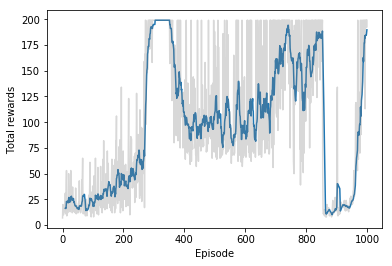

In [19]:
eps, arr = np.array(rewards_list).T
smoothed_arr = running_mean(arr, 10)
plt.plot(eps[-len(smoothed_arr):], smoothed_arr)
plt.plot(eps, arr, color='grey', alpha=0.3)
plt.xlabel('Episode')
plt.ylabel('Total rewards')

Text(0,0.5,'D losses')

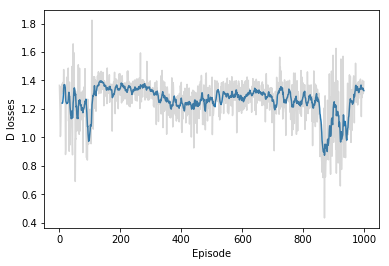

In [20]:
eps, arr = np.array(d_loss_list).T
smoothed_arr = running_mean(arr, 10)
plt.plot(eps[-len(smoothed_arr):], smoothed_arr)
plt.plot(eps, arr, color='grey', alpha=0.3)
plt.xlabel('Episode')
plt.ylabel('D losses')

Text(0,0.5,'G losses')

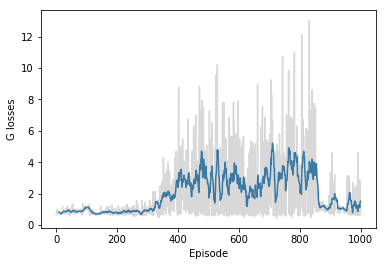

In [21]:
eps, arr = np.array(g_loss_list).T
smoothed_arr = running_mean(arr, 10)
plt.plot(eps[-len(smoothed_arr):], smoothed_arr)
plt.plot(eps, arr, color='grey', alpha=0.3)
plt.xlabel('Episode')
plt.ylabel('G losses')

Text(0,0.5,'Q losses')

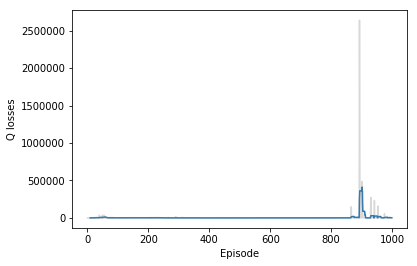

In [22]:
eps, arr = np.array(q_loss_list).T
smoothed_arr = running_mean(arr, 10)
plt.plot(eps[-len(smoothed_arr):], smoothed_arr)
plt.plot(eps, arr, color='grey', alpha=0.3)
plt.xlabel('Episode')
plt.ylabel('Q losses')

## Testing

Let's checkout how our trained agent plays the game.

In [23]:
test_episodes = 10
test_max_steps = 10000
env.reset()
with tf.Session() as sess:
    #saver.restore(sess, tf.train.latest_checkpoint('checkpoints'))
    # Save the trained model 
    saver.restore(sess, 'checkpoints/DQAN-cartpole.ckpt')
    
    # iterations
    for ep in range(test_episodes):
        
        # number of env/rob steps
        t = 0
        while t < test_max_steps:
            env.render()
            
            # Get action from DQAN
            feed_dict = {model.states: state.reshape((1, *state.shape))}
            actions_logits = sess.run(model.actions_logits, feed_dict)
            action = np.argmax(actions_logits)
            
            # Take action, get new state and reward
            next_state, reward, done, _ = env.step(action)
            
            # The task is done or not;
            if done:
                t = test_max_steps
                env.reset()
                
                # Take one random step to get the pole and cart moving
                state, reward, done, _ = env.step(env.action_space.sample())
            else:
                state = next_state
                t += 1
                
# Closing the env
env.close()

INFO:tensorflow:Restoring parameters from checkpoints/DQAN-cartpole.ckpt


## Extending this to Deep Convolutional QAN

So, Cart-Pole is a pretty simple game. However, the same model can be used to train an agent to play something much more complicated like Pong or Space Invaders. Instead of a state like we're using here though, you'd want to use convolutional layers to get the state from the screen images.

![Deep Q-Learning Atari](assets/atari-network.png)

I'll leave it as a challenge for you to use deep Q-learning to train an agent to play Atari games. Here's the original paper which will get you started: http://www.davidqiu.com:8888/research/nature14236.pdf.